In [1]:
import numpy as np
np.__version__

'1.19.5'

In [2]:
import pandas as pd
pd.__version__

'1.1.5'

In [3]:
import matplotlib
matplotlib.__version__

'3.3.4'

In [4]:
import matplotlib.pyplot as plt

In [5]:
# Adjust plot size
#options(repr.plot.width=16, repr.plot.height=6)

# For some reason, if this is in the same cell as the import command, it doesn't work.
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [6]:
import scipy
scipy.__version__

'1.5.4'

In [7]:
from scipy import stats

In [8]:
import seaborn as sns

In [9]:
from datetime import datetime

In [10]:
#from pandarallel import pandarallel

In [11]:
#pandarallel.initialize(progress_bar=True)

In [12]:
default_max_columns=pd.get_option('display.max_columns')

In [13]:
default_max_rows=pd.get_option('display.max_rows')

In [14]:
default_precision=pd.get_option('display.precision')

In [15]:
pd.set_option('display.precision', 2)

In [16]:
default_threshold=np.get_printoptions()['threshold']

In [17]:
np.set_printoptions(threshold=10000000)

# Read meta data

In [18]:
meta = pd.read_csv('20210428-EV/metadata.csv')

In [19]:
meta.head()

,Rand 2 Batch_order,D-plex Sequencing ID,Lexogen Sequencing ID,Diagnosis
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"


In [20]:
meta.rename(columns={"Rand 2 Batch_order": "subject"},inplace=True)
meta.rename(columns={"D-plex Sequencing ID": "dplex"},inplace=True)
meta.rename(columns={"Lexogen Sequencing ID": "lexogen"},inplace=True)
meta.rename(columns={"Diagnosis": "diag"},inplace=True)
#meta.set_index('subject',inplace=True)

In [21]:
meta

,subject,dplex,lexogen,diag
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,"
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,"
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,"
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,"


In [22]:
meta[['disease','idh','x1p19q']] = meta['diag'].str.split(",", 2, expand=True)
#meta.drop('diag',axis='columns',inplace=True)

In [23]:
meta

,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,",GBM,IDH-mutant,
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,


# Read raw matrix CORE

In [24]:
#df = pd.read_csv('20210428-EV/dplexonlyreport.csv',index_col=0,header=None)
df = pd.read_csv('20210428-EV/20210513b-report.csv.gz',index_col=0,header=None,low_memory=False)

In [25]:
df.shape

(39, 528)

In [26]:
df.head(12)

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
---,---,---,---,---,---,---,---,---,---,---,...,---,---,---,---,---,---,---,---,---,---
Subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
Trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242


In [27]:
df.drop("---",inplace=True)

In [28]:
df.shape

(38, 528)

In [29]:
df.rename({'  ':'sample'},axis='rows',inplace=True)
df.rename({'Subject':'subject'},axis='rows',inplace=True)
df.rename({'Trimmer':'trimmer'},axis='rows',inplace=True)

In [30]:
df

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
sample,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242
STAR Aligned to Transcriptome,111104,112499,112492,112689,112696,112689,92673,93752,93727,92285,...,337860,337076,336880,336843,362402,363298,363259,362012,361905,361853


In [31]:
df=df.T
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,Bowtie2 Aligned to Salmonella,Bowtie2 Aligned to Salmonella %,Bowtie2 Aligned to masked Salmonella,Bowtie2 Aligned to masked Salmonella %,Bowtie2 Aligned to Burkholderia,Bowtie2 Aligned to Burkholderia %,Bowtie2 Aligned to masked Burkholderia,Bowtie2 Aligned to masked Burkholderia %,Bowtie2 Aligned to mRNA_Prot,Bowtie2 Aligned to mRNA_Prot %
1,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,45946,3.61,14700,1.15,375543,29.55,277406,21.82,58736,4.62
2,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,60133,4.37,17811,1.29,413414,30.11,298416,21.73,71735,5.22
3,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,60133,4.37,17811,1.29,413414,30.11,298416,21.73,71735,5.22
4,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,61284,4.39,18218,1.30,420290,30.10,304330,21.80,75518,5.41
5,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,61285,4.39,18218,1.30,420299,30.10,304339,21.80,75522,5.41


In [32]:
#df=df.merge(meta,left_on='Subject',right_on='subject')
df=df.merge(meta,on='subject')
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,Bowtie2 Aligned to masked Burkholderia,Bowtie2 Aligned to masked Burkholderia %,Bowtie2 Aligned to mRNA_Prot,Bowtie2 Aligned to mRNA_Prot %,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,277406,21.82,58736,4.62,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,298416,21.73,71735,5.22,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,298416,21.73,71735,5.22,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,304330,21.80,75518,5.41,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,304339,21.80,75522,5.41,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [33]:
#element_counts = pd.read_csv('20210428-EV/rmsk_class_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/rmsk_family_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/rmsk_name_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/mirna_counts.csv.gz',index_col=0,low_memory=False)
element_counts = pd.read_csv('20210428-EV/gene_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/mrna_counts.csv.gz',index_col=0,low_memory=False)
# diamond_family_counts

element_counts.head()

,SFHH005aa.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005a.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,...,SFHH006y.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts
sequence,,,,,,,,,,,,,,,,,,,,,
A1BG,0,0,0,0,0,0,0,0,0,0,...,21,21,21,21,0,0,0,0,0,0
A1BG-AS1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A1CF,0,0,0,0,0,0,24,24,24,0,...,0,0,0,0,0,0,0,0,0,0
A2M,0,0,0,0,0,0,50,125,125,0,...,0,0,0,0,0,0,0,0,0,0
A2M-AS1,0,0,0,0,0,0,177,177,177,6,...,0,0,0,0,0,0,0,0,0,0


# Keep less than 5000 columns

In [34]:
len(element_counts)

34074

In [35]:
#element_counts=element_counts[0:5000]
#element_counts=element_counts[5000:10000]
#element_counts=element_counts[10000:15000]
#element_counts=element_counts[15000:20000]
#element_counts=element_counts[20000:25000]
#element_counts=element_counts[25000:30000]
element_counts=element_counts[30000:35000]

In [36]:
len(element_counts)

4074

In [37]:
element_counts=element_counts.T
element_counts=element_counts.reset_index()
element_counts[['sample','trimmer','other']]=element_counts['index'].str.split(".",2,expand=True)
element_counts.drop(["index","other"],inplace=True,axis='columns')
element_counts.head()

sequence,SPC25,SPCS1,SPCS2,SPCS3,SPDEF,SPDL1,SPDYA,SPDYC,SPDYE1,SPDYE10P,...,ZXDA,ZXDB,ZXDC,ZYG11A,ZYG11B,ZYX,ZZEF1,ZZZ3,sample,trimmer
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,78,0,SFHH005aa,bbduk1
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,78,0,SFHH005aa,bbduk2
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,78,0,SFHH005aa,bbduk3
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,72,0,SFHH005aa,cutadapt1
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,72,0,SFHH005aa,cutadapt2


In [38]:
df=df.merge(element_counts,on=['sample','trimmer'])
df.shape

(528, 4118)

In [39]:
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,ZWILCH,ZWINT,ZXDA,ZXDB,ZXDC,ZYG11A,ZYG11B,ZYX,ZZEF1,ZZZ3
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0,0,0,0,0,0,0,0,78,0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0,0,0,0,0,0,0,0,78,0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0,0,0,0,0,0,0,0,78,0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0,0,0,0,0,0,0,0,72,0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0,0,0,0,0,0,0,0,72,0


In [40]:
df.columns  #.tolist()

Index(['sample', 'subject', 'Lab kit', 'trimmer', 'Raw Read Count',
       'Raw Read Length', 'Trimmed Read Count', 'Trimmed Ave Read Length',
       'STAR Aligned to Transcriptome', 'STAR Aligned to Transcriptome %',
       ...
       'ZWILCH', 'ZWINT', 'ZXDA', 'ZXDB', 'ZXDC', 'ZYG11A', 'ZYG11B', 'ZYX',
       'ZZEF1', 'ZZZ3'],
      dtype='object', length=4118)

In [41]:
#genes=df.columns[92:142]
#genes=df.columns[100:554]
#a=df.columns.tolist().index('STAR Gene Counts')+1
#b=df.columns.tolist().index('STAR miRNA Counts')
#genes=df.columns[a:b]
elements=element_counts.columns[:-2]
elements

Index(['SPC25', 'SPCS1', 'SPCS2', 'SPCS3', 'SPDEF', 'SPDL1', 'SPDYA', 'SPDYC',
       'SPDYE1', 'SPDYE10P',
       ...
       'ZWILCH', 'ZWINT', 'ZXDA', 'ZXDB', 'ZXDC', 'ZYG11A', 'ZYG11B', 'ZYX',
       'ZZEF1', 'ZZZ3'],
      dtype='object', name='sequence', length=4074)

In [42]:
df['Raw Read Count'] = pd.to_numeric(df['Raw Read Count'], errors='coerce')

In [43]:
df['Trimmed Read Count'] = pd.to_numeric(df['Trimmed Read Count'], errors='coerce')

In [44]:
pd.set_option('display.max_rows',None)

In [45]:
#df[['subject','sample','Raw Read Count']].drop_duplicates().sort_values(by='Raw Read Count')

In [46]:
#df[['subject','sample','trimmer','Trimmed Read Count']].drop_duplicates().sort_values(by='Trimmed Read Count')

In [47]:
pd.set_option('display.max_rows',default_max_rows)

# Prepping to ttest all items against all other items

In [48]:
df['diag'].unique()

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'V01 control (S1),,', 'GBM, IDH1R132H WT,', 'blank 2 (C1),,',
       'blank1 (C1),,'], dtype=object)

In [49]:
u=df['diag'].unique()
diags=u[0:3]
diags=np.append(diags,u[4])

In [50]:
diags

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'GBM, IDH1R132H WT,'], dtype=object)

In [51]:
type(diags)

numpy.ndarray

In [52]:
diags=diags.tolist()

In [53]:
diags

['GBM, IDH-mutant,',
 'Diffuse Astrocytoma, IDH-mutant,',
 'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
 'GBM, IDH1R132H WT,']

In [54]:
# Why was this here?

#import warnings
#warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning) 

pca plots

In [55]:
def ttests_boxplots_and_heatmaps(localdf,columns,box_p=0.05,heat_p=0.15):
    select_p_values=[]
    for col in columns:

        if ( col not in localdf.columns ):
            continue

        for labkit in localdf['Lab kit'].unique():
            #"D-plex","Lexogen":
            for trimmer in 'bbduk2','cutadapt2':
                #localdf['Trimmer'].unique():
                #"bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
                for diag in diags:
                    others=diags.copy()
                    others.remove(diag)
                    for other in others:
                        t, p = stats.ttest_ind(
                            localdf[((localdf["Lab kit"]==labkit) &
                                     (localdf["trimmer"]==trimmer) & 
                                (localdf["diag"]==diag))][col],
                            localdf[((localdf["Lab kit"]==labkit) &
                                     (localdf["trimmer"]==trimmer) & 
                                (localdf["diag"]==other))][col])
                        if p < heat_p:
                            select_p_values.append([abs(t),p,col,labkit,trimmer])

    pdf = pd.DataFrame(select_p_values, columns=['t','p','col','labkit','trimmer'])                        
    pdf=pdf.drop_duplicates().sort_values('p')

    for index, row in pdf.iterrows():
        if row['p'] < box_p:
            print(" p : "+str(row['p'])+"  ( t : "+str(row['t'])+" ) :  "+
                  row['labkit']+"  :  "+row['trimmer']+"  :  "+row['col'])
            print("Control and blanks")
            print(localdf[
                (localdf['diag']=='V01 control (S1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
            print(localdf[
                (localdf['diag']=='blank 2 (C1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
            print(localdf[
                (localdf['diag']=='blank1 (C1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
                        
            localdf[((localdf["Lab kit"]==row['labkit']) &
                     (localdf["trimmer"]==row['trimmer']))].boxplot(
                column=row['col'],by=['diag'])
            plt.title(row['col'] + " Normalized by Trimmed Read Count")
            plt.xticks(rotation=75,ha='right')
            plt.show()

    selected=['subject','sample','Lab kit','trimmer','diag','idh']
    selected=np.append(selected,pdf['col'])
    selected=np.unique(selected)

    #['Lab kit' 'NR_029609.1' 'trimmer' 'diag' 'idh' 'sample' 'subject']
    if len(selected) > 7:
        for trimmer in 'bbduk2','cutadapt2':
            for labkit in dfn['Lab kit'].unique():
                tmp=localdf[selected].copy()
                tmp=tmp[(tmp['trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
                tmp=tmp.drop('trimmer',axis='columns')
                tmp=tmp.drop('Lab kit',axis='columns')
                tmp.set_index(['subject','sample','diag','idh'],inplace=True)
                
                #tmp-=tmp.min() # This may almost always be 0 now.
                tmp/=tmp.max() # given that there should be no NAs now, coule let clustermap do this
                # ...
                #standard_scale int or None, optional
                #Either 0 (rows) or 1 (columns).
                #Whether or not to standardize that dimension, meaning for each row or column,
                #subtract the minimum and divide each by its maximum.
                # how would that deal with 0s or empty cells

                tmp=tmp.fillna(0) # Somehow, some scaled values become NaN so keep this
                
                tmp.reset_index(inplace=True)

                #tmp1=tmp.sort_values(['diag']).T
                tmp=tmp.sort_values(['idh','diag'])
                #print(tmp.head())
                tmp.drop(['subject'],inplace=True,axis='columns')
                tmp.set_index(['sample','idh'],inplace=True)
                
                diagnoses=tmp.pop('diag')
                #lut = dict(zip(diagnoses.unique(), "rgbcmykb"))
                #col_colors = diagnoses.map(lut)
                #print(col_colors)
                #print(tmp.columns)
                
                tmp=tmp.T

                #print('pal')
                network_pal = sns.cubehelix_palette(len(diagnoses.unique()),
                                    light=.9, dark=.1, reverse=True,
                                    start=1, rot=-2)
                #print(network_pal)
                network_pal
                #print('lut')
                network_lut = dict(zip(diagnoses.unique(), network_pal))
                #print(network_lut)
                #print('labels')
                # Convert the palette to vectors that will be drawn on the side of the matrix
                network_labels = diagnoses
                #print(network_labels)
                network_colors = pd.Series(network_labels, index=tmp.columns).map(network_lut)                
                #print('colors')
                #print(network_colors)
                
                # from http://dawnmy.github.io/2016/10/24/Plot-heatmaap-with-side-color-indicating-the-class-of-variables/
                # Create a custom palette to identify the networks
                #network_pal = sns.cubehelix_palette(len(used_networks),
                #                    light=.9, dark=.1, reverse=True,
                #                    start=1, rot=-2)
                #network_lut = dict(zip(map(str, used_networks), network_pal))

                # Convert the palette to vectors that will be drawn on the side of the matrix
                #network_labels = df.columns.get_level_values("network")
                #network_colors = pd.Series(network_labels, index=df.columns).map(network_lut)                
   
                # Create a custom colormap for the heatmap values
                #cmap = sns.diverging_palette(h_neg=210, h_pos=350, s=90, l=30, as_cmap=True)

                # Draw the full plot
                #g = sns.clustermap(df.corr(),

                #                 # Turn off the clustering
                #                 row_cluster=False, col_cluster=False,

                #                  # Add colored class labels
                #                  row_colors=network_colors, col_colors=network_colors,

                #                  # Make the plot look better when many rows/cols
                #                  linewidths=0, xticklabels=False, yticklabels=False)

                # Draw the legend bar for the classes                 
                #for label in network_labels.unique():
                #    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                #                            label=label, linewidth=0)
                #g.ax_col_dendrogram.legend(loc="center", ncol=5)

                
                g=sns.clustermap(tmp,col_cluster=False,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
                g.fig.suptitle("Clustermap 1 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

                # Draw the legend bar for the classes                 
                for label in network_labels.unique():
                    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                            label=label, linewidth=0)
                g.ax_col_dendrogram.legend(loc="center", ncol=4)
                
                # Adjust the postion of the main colorbar for the heatmap
                #g.cax.set_position([.97, .2, .03, .45])
                g.cax.set_position([0, .15, .005, .65])
                plt.show()

                g=sns.clustermap(tmp,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
                g.fig.suptitle("Clustermap 2 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

                # Draw the legend bar for the classes                 
                for label in network_labels.unique():
                    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                            label=label, linewidth=0)
                g.ax_col_dendrogram.legend(loc="center", ncol=4)
                                
                # Adjust the postion of the main colorbar for the heatmap
                # [dist from left,dist from bottom?,width?,height?]
                g.cax.set_position([0, .15, .005, .65])
                plt.show()  
    else:
        print("Not enough data to produce cluster maps")

# Normalize by Trimmed Read Count

In [56]:
dfn=df.copy()

In [57]:
dfn.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,ZWILCH,ZWINT,ZXDA,ZXDB,ZXDC,ZYG11A,ZYG11B,ZYX,ZZEF1,ZZZ3
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0,0,0,0,0,0,0,0,78,0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0,0,0,0,0,0,0,0,78,0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0,0,0,0,0,0,0,0,78,0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0,0,0,0,0,0,0,0,72,0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0,0,0,0,0,0,0,0,72,0


In [58]:
datetime.now().strftime("%H:%M:%S")

'10:47:59'

In [59]:
dfn[elements]=(1e9*dfn[elements].values)/dfn[['Trimmed Read Count']].values

In [60]:
datetime.now().strftime("%H:%M:%S")

'10:48:17'

In [61]:
dfn.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,ZWILCH,ZWINT,ZXDA,ZXDB,ZXDC,ZYG11A,ZYG11B,ZYX,ZZEF1,ZZZ3
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,61379.43,0.0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,56811.02,0.0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,56810.03,0.0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,51579.96,0.0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,51579.88,0.0


In [62]:
datetime.now().strftime("%H:%M:%S")

'10:48:17'

In [63]:
for c in ['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1',
    'EGFR','EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','NOTCH1',
    'RB1','RB1CC1','RB1-DT','TERT','TP53']:
        if( c not in dfn.columns ):
            print("Missing "+c) 

Missing CDKN2A
Missing CDKN2A-DT
Missing CDKN2AIP
Missing CDKN2AIPNL
Missing CDKN2B
Missing CDKN2B-AS1
Missing EGFR
Missing EGFR-AS1
Missing IDH1
Missing IDH1-AS1
Missing IDH2
Missing IDH2-DT
Missing NF1
Missing NOTCH1
Missing RB1
Missing RB1CC1
Missing RB1-DT


In [64]:
datetime.now().strftime("%H:%M:%S")

'10:48:17'

# Select Genes (if using Genes)

In [65]:
ttests_boxplots_and_heatmaps(dfn,['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1','EGFR',
                                  'EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','NOTCH1','RB1','RB1CC1',
                                  'RB1-DT','TERT','TP53'],box_p=0.1,heat_p=0.2)

Not enough data to produce cluster maps


In [66]:
datetime.now().strftime("%H:%M:%S")

'10:48:18'

# Elements

 p : 0.00029357455816208063  ( t : 4.4736605082045395 ) :  Lexogen  :  bbduk2  :  ZNF142
Control and blanks
79     248924.19
343    839066.17
Name: ZNF142, dtype: float64
211    948646.29
Name: ZNF142, dtype: float64
475    893633.22
Name: ZNF142, dtype: float64


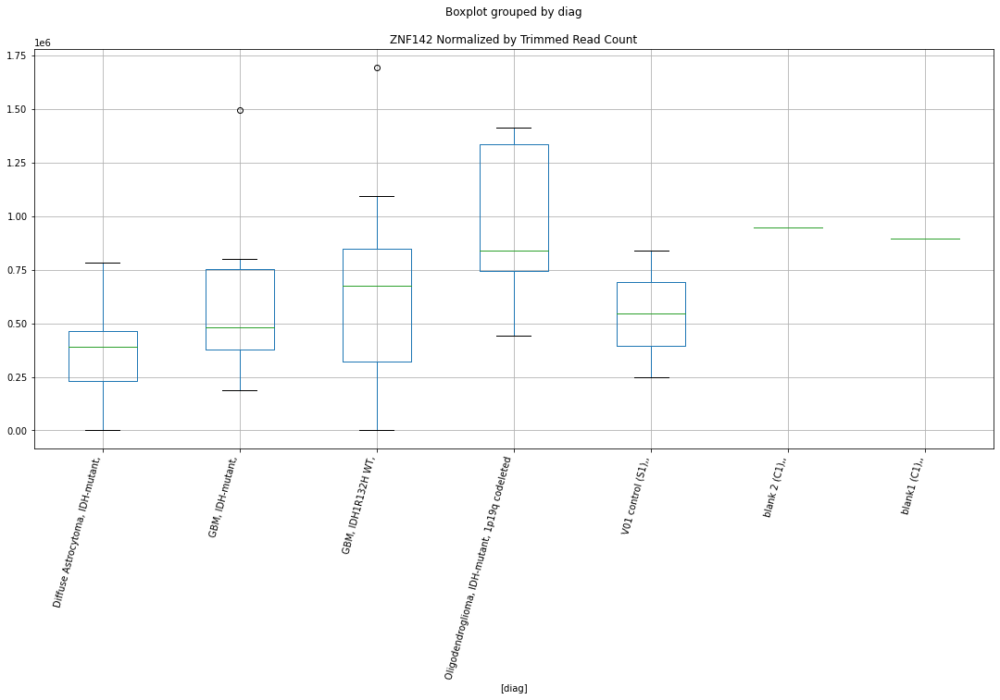

 p : 0.0003072477104855675  ( t : 4.453042674356471 ) :  Lexogen  :  cutadapt2  :  ZNF142
Control and blanks
82     247088.90
346    837108.53
Name: ZNF142, dtype: float64
214    952004.85
Name: ZNF142, dtype: float64
478    892139.04
Name: ZNF142, dtype: float64


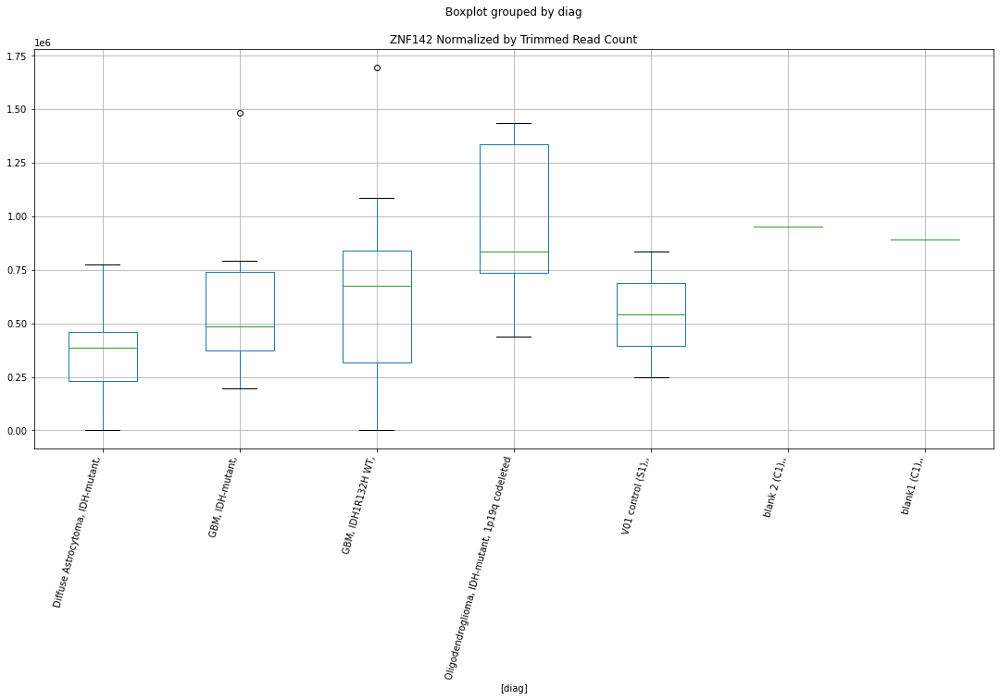

 p : 0.0007313215644939645  ( t : 4.062133913601702 ) :  D-plex  :  cutadapt2  :  TMEM97
Control and blanks
76     1515.23
340       0.00
Name: TMEM97, dtype: float64
208    352.72
Name: TMEM97, dtype: float64
472    577.96
Name: TMEM97, dtype: float64


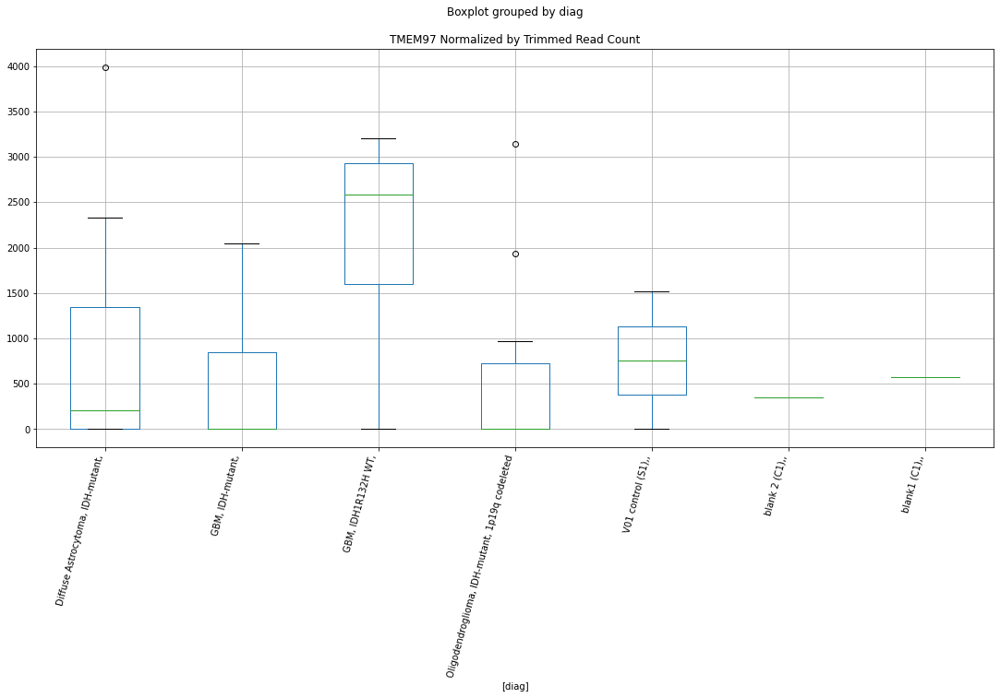

 p : 0.0011827515944232644  ( t : 3.8463283250805347 ) :  D-plex  :  bbduk2  :  TRIP6
Control and blanks
73     0.0
337    0.0
Name: TRIP6, dtype: float64
205    2149.09
Name: TRIP6, dtype: float64
469    1183.05
Name: TRIP6, dtype: float64


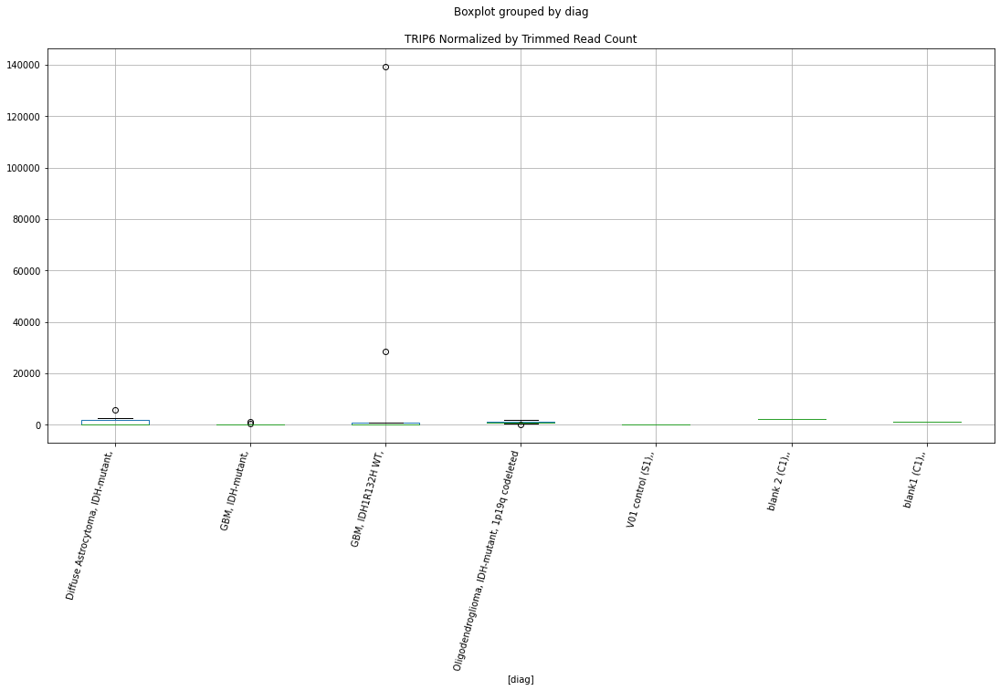

 p : 0.0014572782737351003  ( t : 3.752660985664604 ) :  D-plex  :  cutadapt2  :  ZNF507
Control and blanks
76         0.00
340    17614.64
Name: ZNF507, dtype: float64
208    2116.32
Name: ZNF507, dtype: float64
472    0.0
Name: ZNF507, dtype: float64


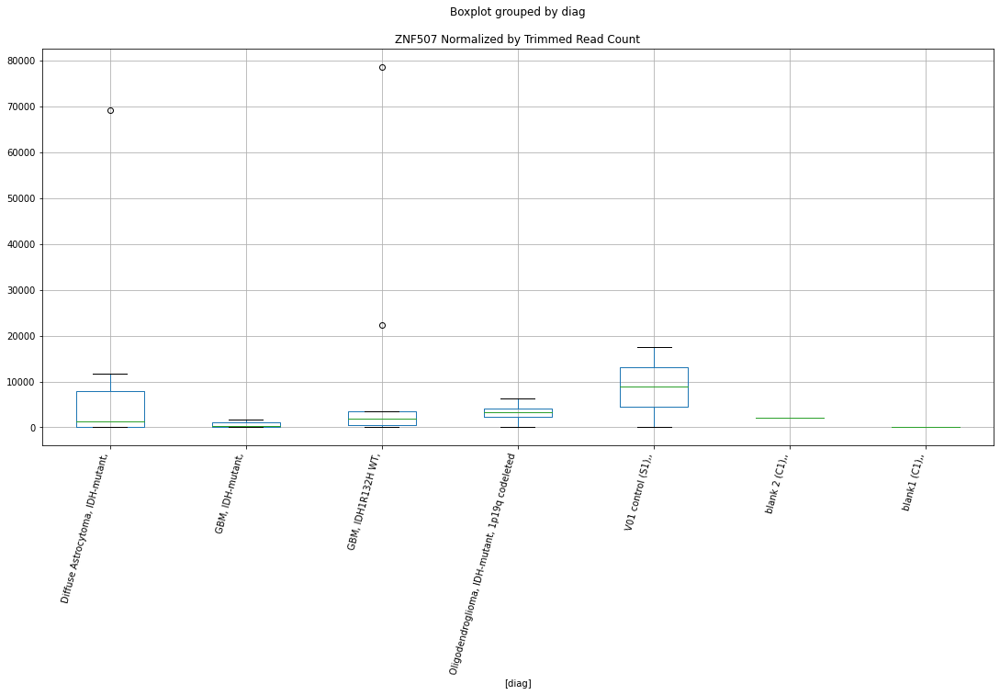

 p : 0.0015326762262049772  ( t : 3.730018063107694 ) :  D-plex  :  cutadapt2  :  ZNF800
Control and blanks
76     152280.46
340     11449.52
Name: ZNF800, dtype: float64
208    56964.35
Name: ZNF800, dtype: float64
472    43924.64
Name: ZNF800, dtype: float64


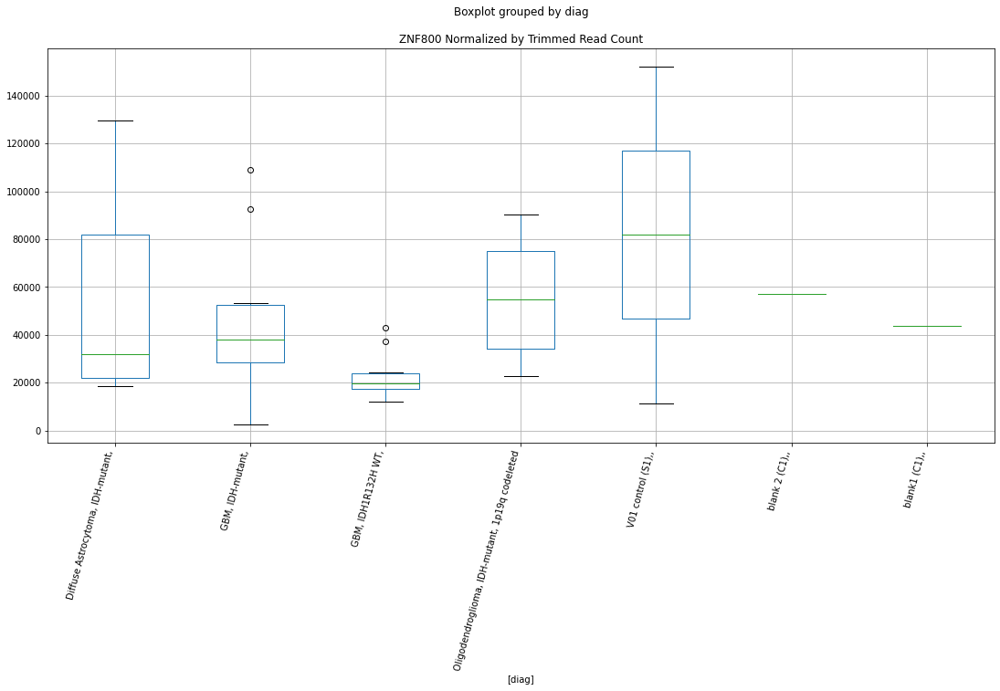

 p : 0.0030525726352265622  ( t : 3.420091498546384 ) :  D-plex  :  bbduk2  :  TLE6
Control and blanks
73     0.0
337    0.0
Name: TLE6, dtype: float64
205    7521.82
Name: TLE6, dtype: float64
469    5323.75
Name: TLE6, dtype: float64


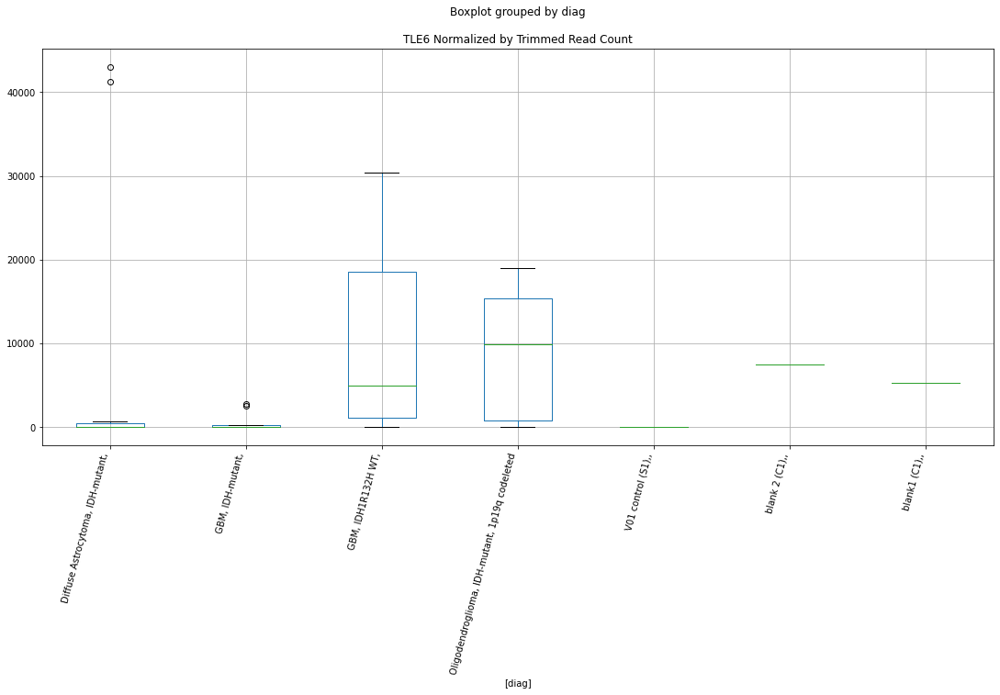

 p : 0.0038366048180519256  ( t : 3.3167670928105535 ) :  D-plex  :  bbduk2  :  TESK2
Control and blanks
73      97399.06
337    320456.62
Name: TESK2, dtype: float64
205    171569.13
Name: TESK2, dtype: float64
469    63884.95
Name: TESK2, dtype: float64


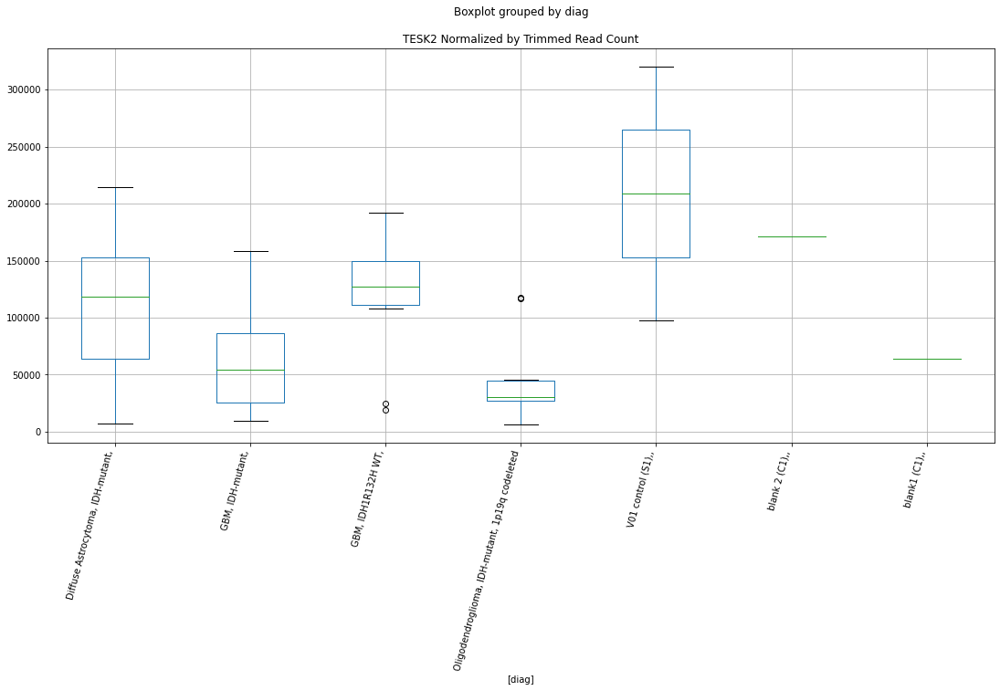

 p : 0.003993853049170482  ( t : 3.2985745977764824 ) :  D-plex  :  bbduk2  :  ZNF800
Control and blanks
73     136822.49
337     11572.04
Name: ZNF800, dtype: float64
205    43340.01
Name: ZNF800, dtype: float64
469    39632.33
Name: ZNF800, dtype: float64


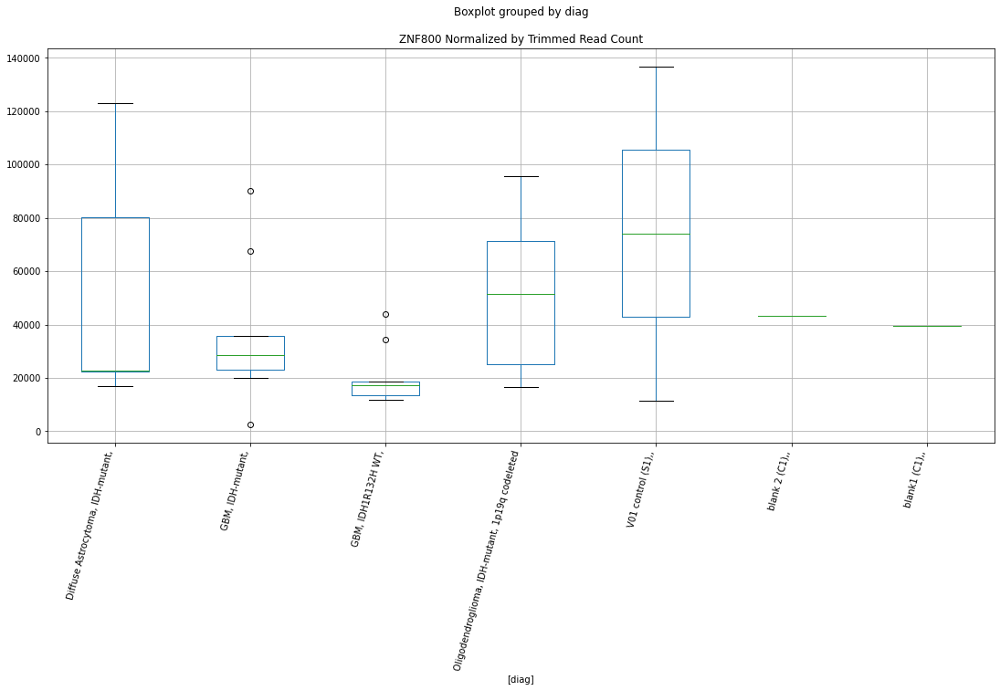

 p : 0.004085053591730965  ( t : 3.288343395551014 ) :  D-plex  :  cutadapt2  :  TMEM97
Control and blanks
76     1515.23
340       0.00
Name: TMEM97, dtype: float64
208    352.72
Name: TMEM97, dtype: float64
472    577.96
Name: TMEM97, dtype: float64


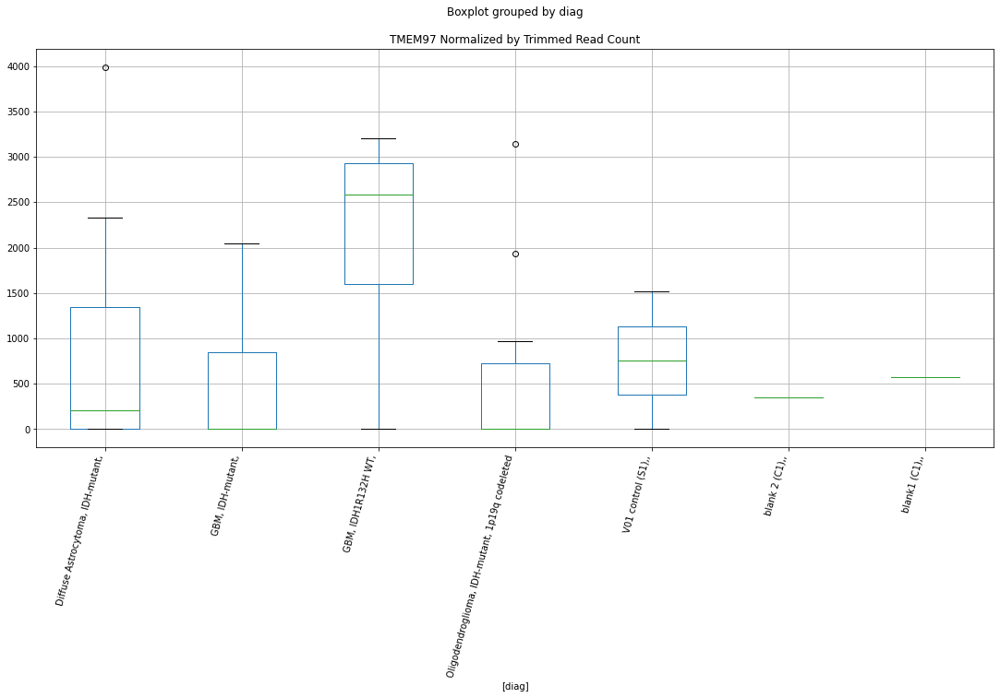

 p : 0.0041257199004476495  ( t : 3.283853475770231 ) :  D-plex  :  cutadapt2  :  TESK2
Control and blanks
76      95459.39
340    320586.50
Name: TESK2, dtype: float64
208    171422.13
Name: TESK2, dtype: float64
472    61263.32
Name: TESK2, dtype: float64


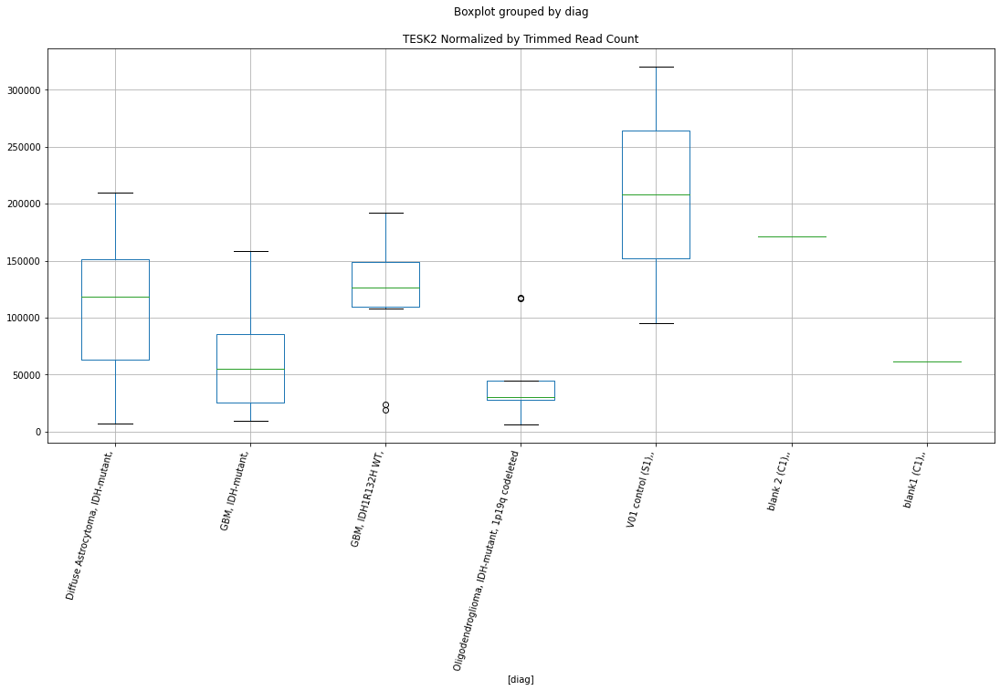

 p : 0.004273995287944557  ( t : 3.267842931391011 ) :  D-plex  :  cutadapt2  :  TSPYL5
Control and blanks
76     757.61
340      0.00
Name: TSPYL5, dtype: float64
208    352.72
Name: TSPYL5, dtype: float64
472    0.0
Name: TSPYL5, dtype: float64


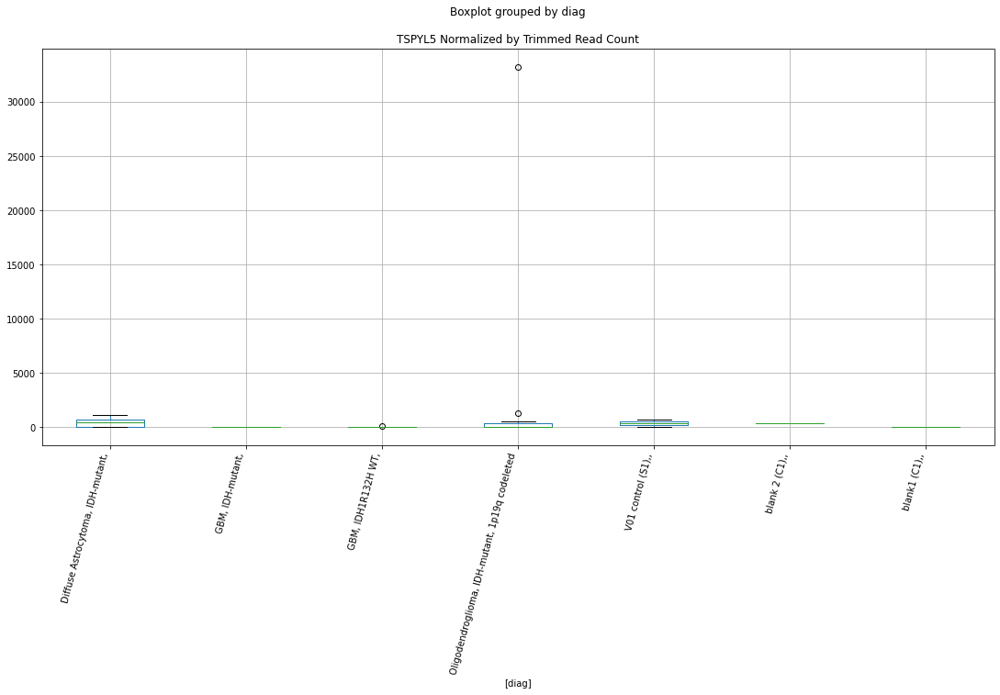

 p : 0.004475942241248392  ( t : 3.2468928684118556 ) :  D-plex  :  cutadapt2  :  TRHDE-AS1
Control and blanks
76     3030.46
340    1761.46
Name: TRHDE-AS1, dtype: float64
208    8112.57
Name: TRHDE-AS1, dtype: float64
472    1155.91
Name: TRHDE-AS1, dtype: float64


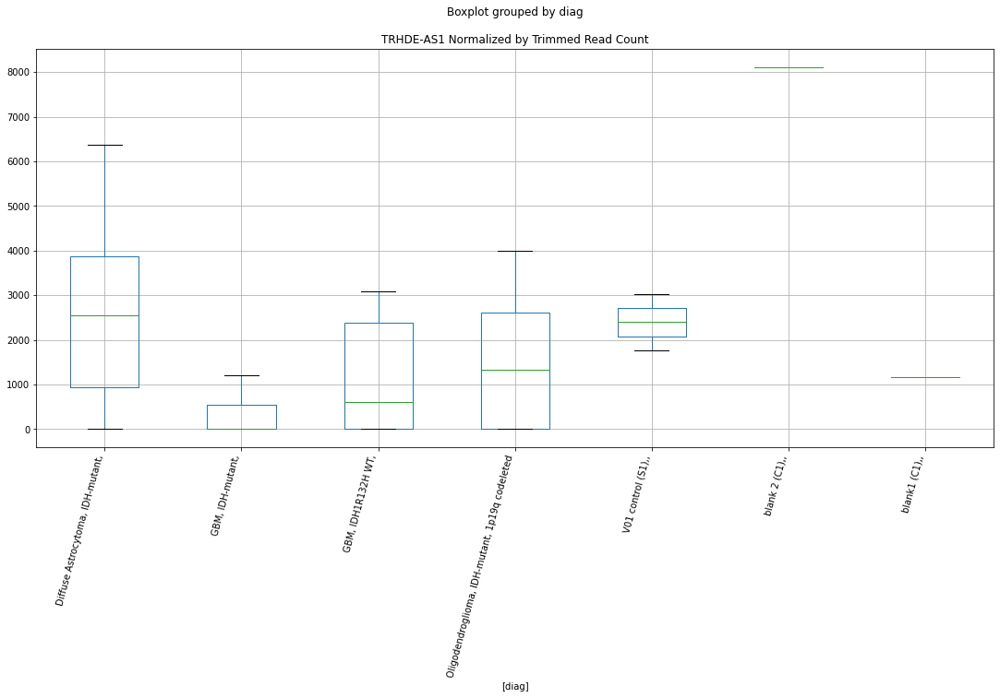

 p : 0.004537392040081109  ( t : 3.2407018931986022 ) :  D-plex  :  cutadapt2  :  TNFSF14
Control and blanks
76     9091.37
340       0.00
Name: TNFSF14, dtype: float64
208    16754.22
Name: TNFSF14, dtype: float64
472    16182.76
Name: TNFSF14, dtype: float64


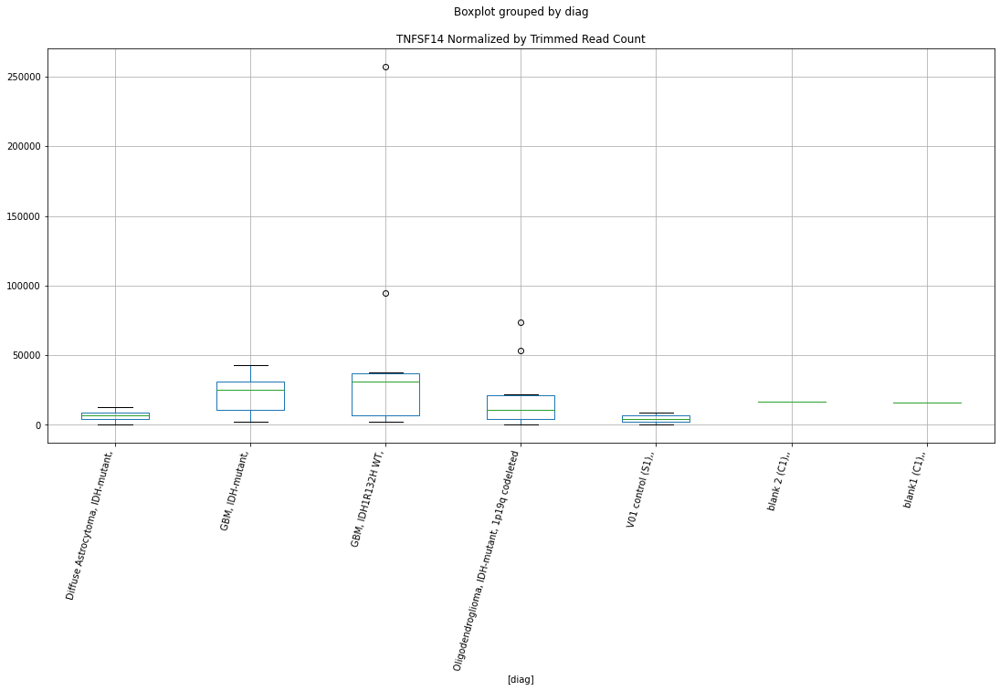

 p : 0.004891379073402271  ( t : 3.2065647298536213 ) :  Lexogen  :  cutadapt2  :  WHAMM
Control and blanks
82         0.00
346    40403.43
Name: WHAMM, dtype: float64
214    0.0
Name: WHAMM, dtype: float64
478    0.0
Name: WHAMM, dtype: float64


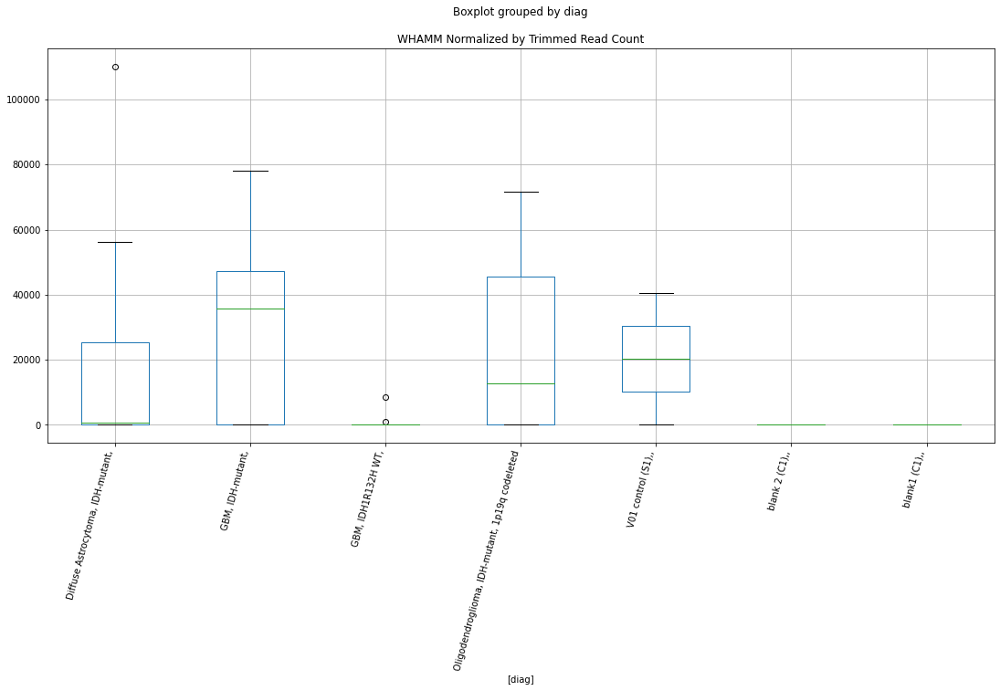

 p : 0.004958264612241042  ( t : 3.2003874911605426 ) :  Lexogen  :  bbduk2  :  TMEM45A
Control and blanks
79     0.0
343    0.0
Name: TMEM45A, dtype: float64
211    0.0
Name: TMEM45A, dtype: float64
475    0.0
Name: TMEM45A, dtype: float64


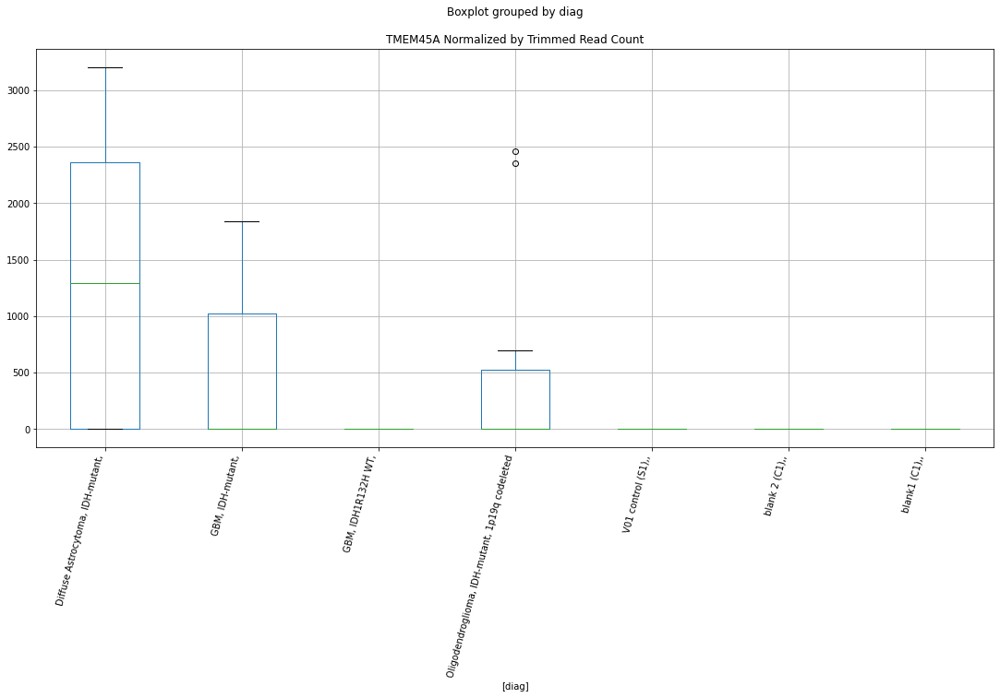

 p : 0.005017548992171758  ( t : 3.1949801106177524 ) :  Lexogen  :  bbduk2  :  WHAMM
Control and blanks
79         0.00
343    40764.35
Name: WHAMM, dtype: float64
211    0.0
Name: WHAMM, dtype: float64
475    0.0
Name: WHAMM, dtype: float64


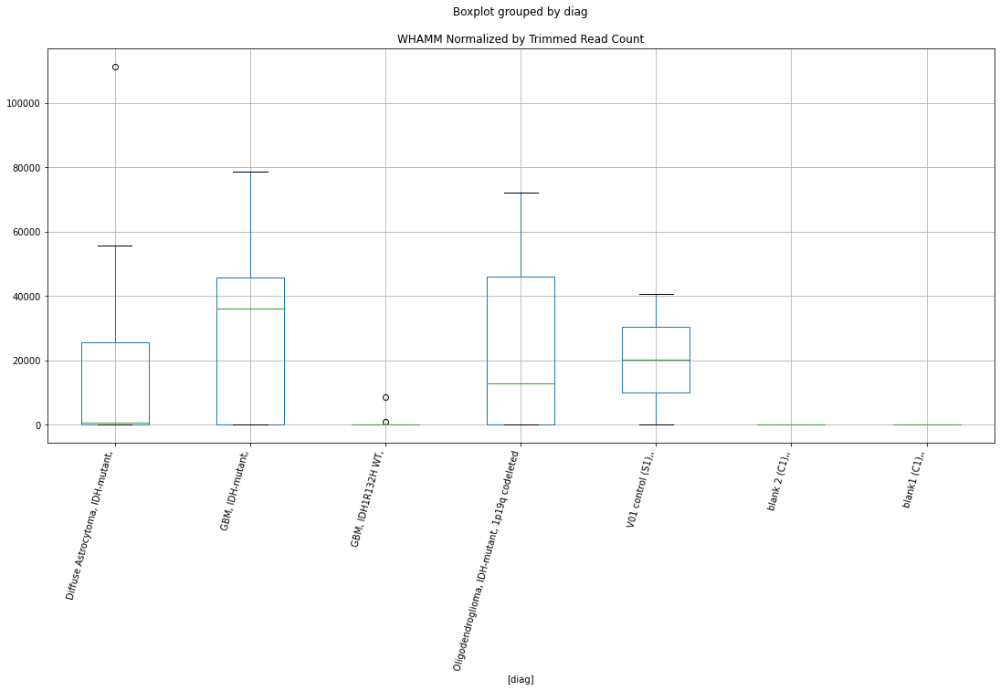

 p : 0.005152996590899288  ( t : 3.1828569047501167 ) :  D-plex  :  cutadapt2  :  TSPYL5
Control and blanks
76     757.61
340      0.00
Name: TSPYL5, dtype: float64
208    352.72
Name: TSPYL5, dtype: float64
472    0.0
Name: TSPYL5, dtype: float64


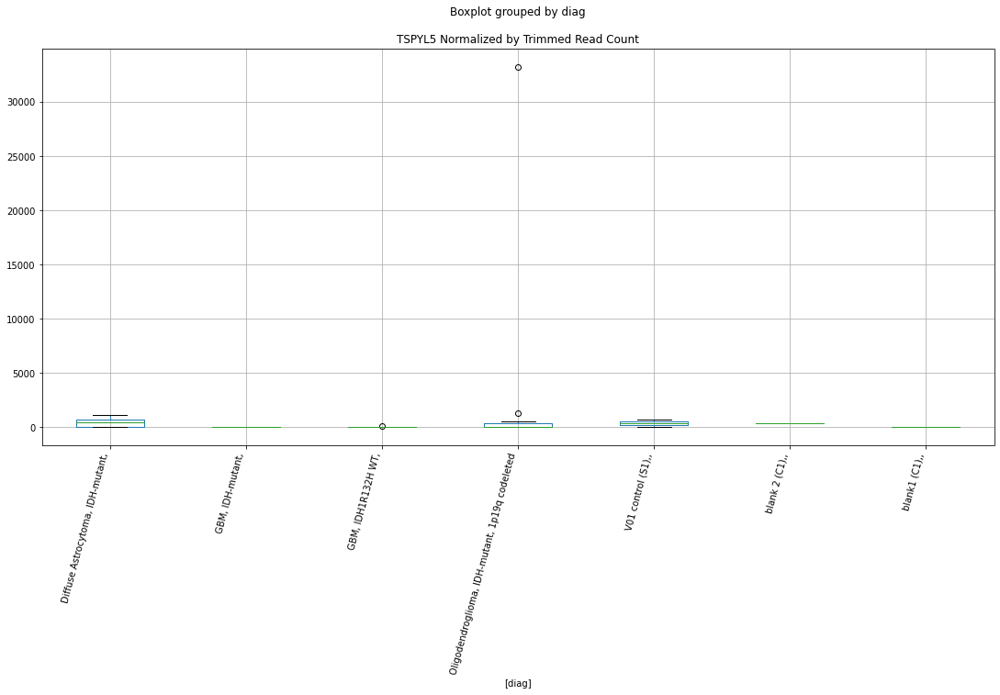

 p : 0.005419787524949166  ( t : 3.159863789539093 ) :  D-plex  :  cutadapt2  :  TRIP6
Control and blanks
76     0.0
340    0.0
Name: TRIP6, dtype: float64
208    2116.32
Name: TRIP6, dtype: float64
472    1155.91
Name: TRIP6, dtype: float64


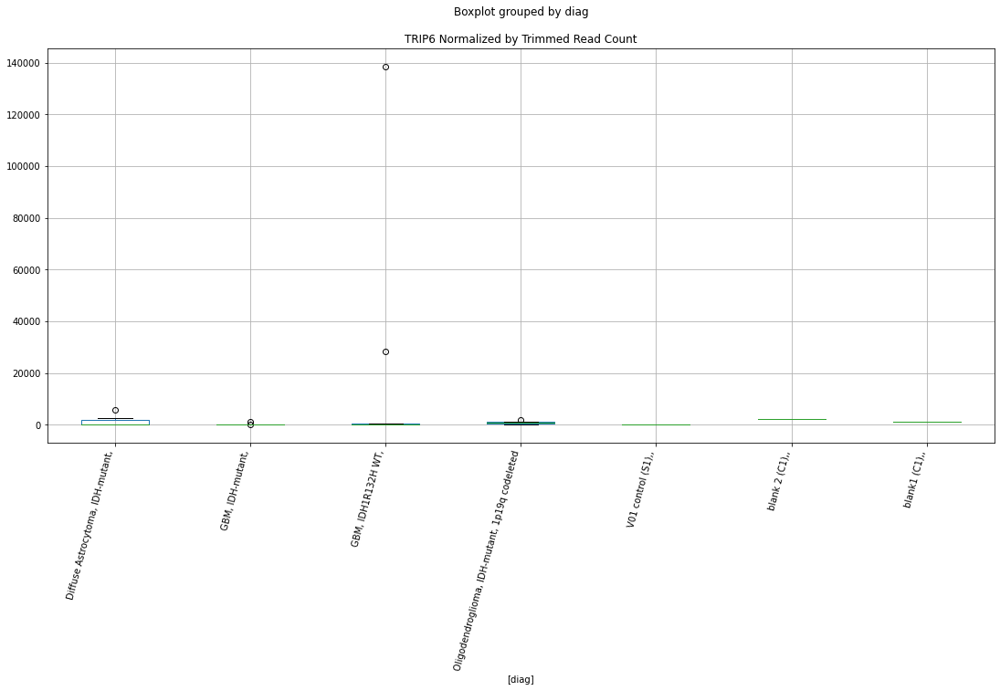

 p : 0.006256467076384987  ( t : 3.094326833378509 ) :  D-plex  :  cutadapt2  :  TLE6
Control and blanks
76     0.0
340    0.0
Name: TLE6, dtype: float64
208    7407.13
Name: TLE6, dtype: float64
472    5201.6
Name: TLE6, dtype: float64


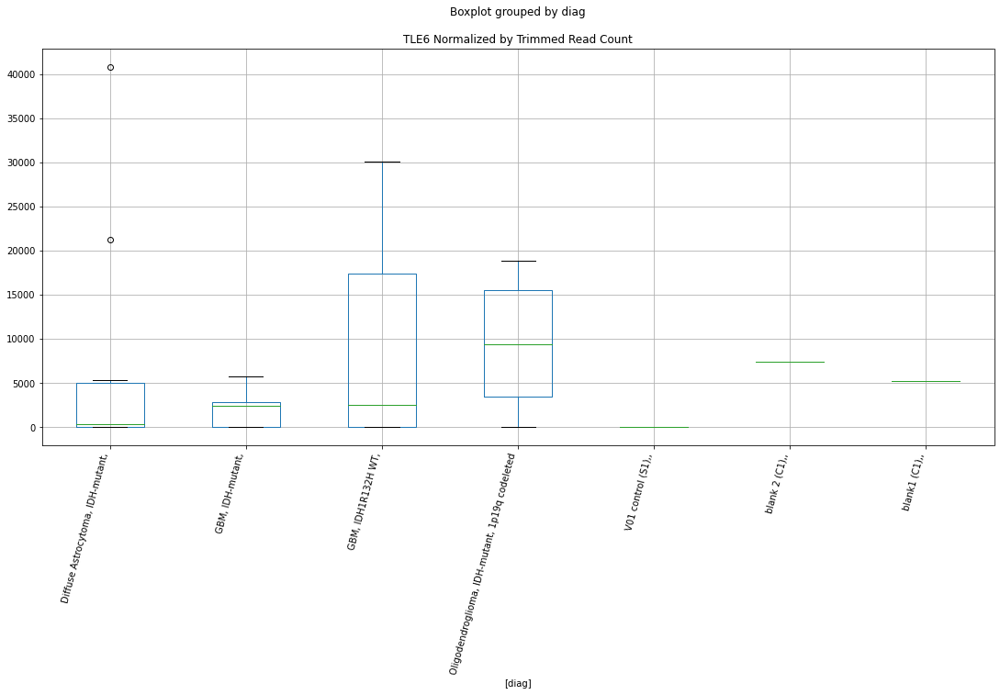

 p : 0.006346833817966892  ( t : 3.087767718799981 ) :  D-plex  :  cutadapt2  :  TNIP3
Control and blanks
76     0.0
340    0.0
Name: TNIP3, dtype: float64
208    21163.23
Name: TNIP3, dtype: float64
472    13870.94
Name: TNIP3, dtype: float64


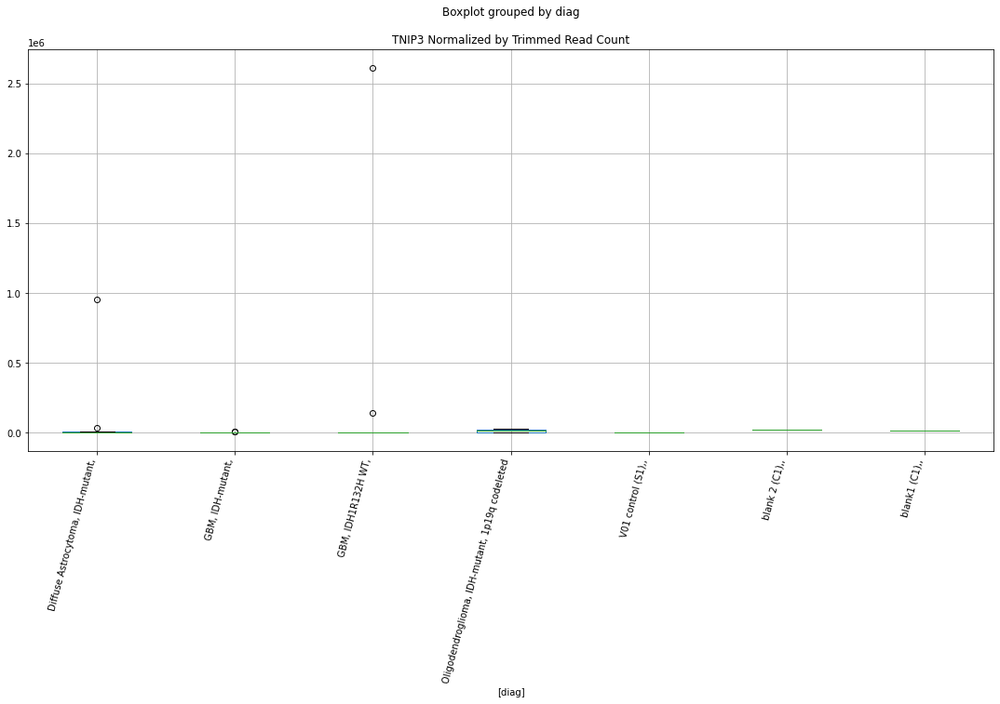

 p : 0.007158907967539978  ( t : 3.03260126810264 ) :  D-plex  :  bbduk2  :  TNIP3
Control and blanks
73     0.0
337    0.0
Name: TNIP3, dtype: float64
205    21490.91
Name: TNIP3, dtype: float64
469    14196.66
Name: TNIP3, dtype: float64


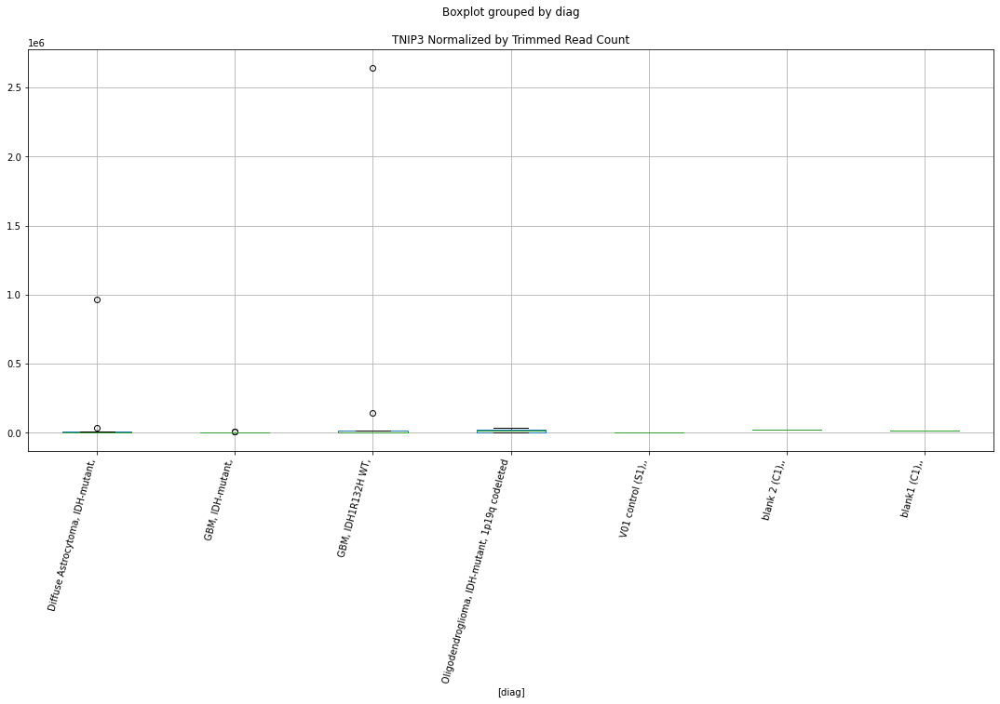

 p : 0.007612233806683337  ( t : 3.0043989958751887 ) :  Lexogen  :  bbduk2  :  ZNF771
Control and blanks
79     0.0
343    0.0
Name: ZNF771, dtype: float64
211    0.0
Name: ZNF771, dtype: float64
475    12933.85
Name: ZNF771, dtype: float64


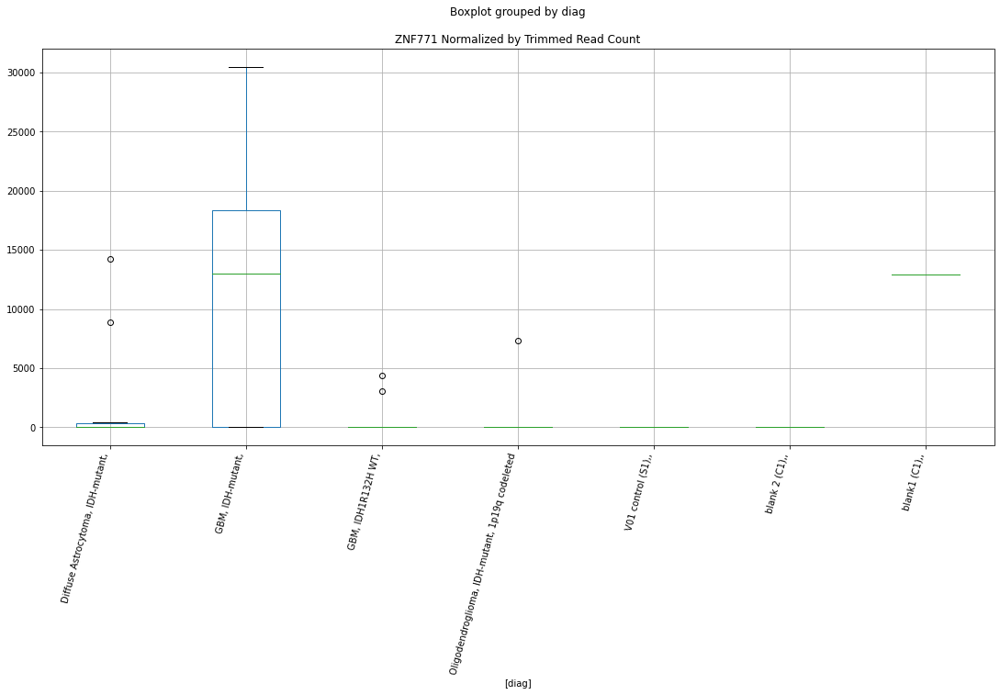

 p : 0.007653356804447795  ( t : 3.0019219267244566 ) :  Lexogen  :  cutadapt2  :  ZNF771
Control and blanks
82     0.0
346    0.0
Name: ZNF771, dtype: float64
214    0.0
Name: ZNF771, dtype: float64
478    12822.87
Name: ZNF771, dtype: float64


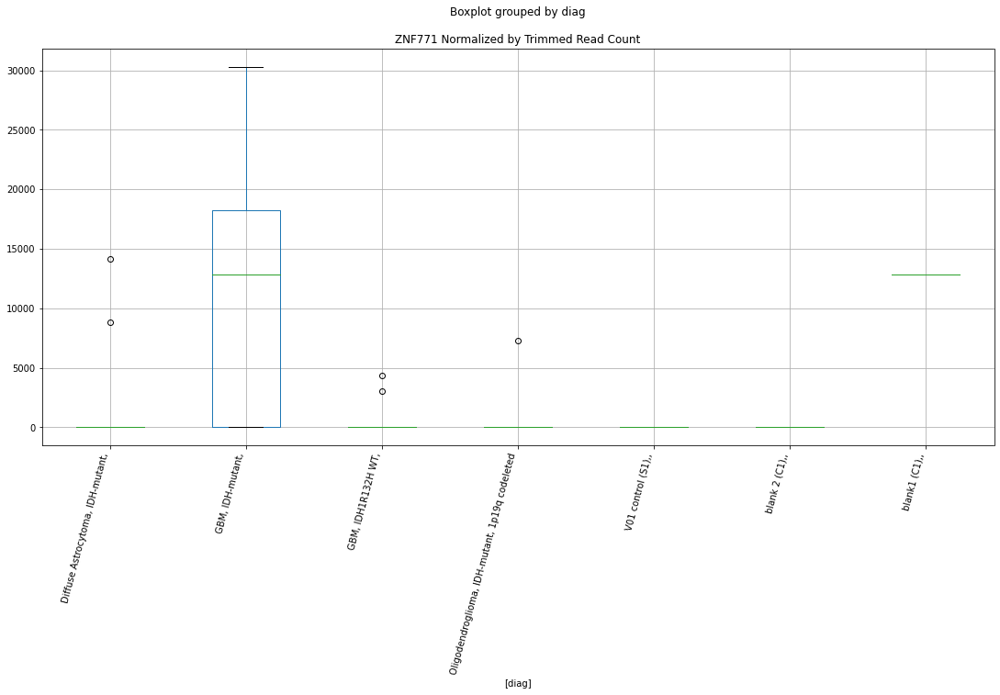

 p : 0.007698477248115684  ( t : 2.9992188929494086 ) :  D-plex  :  cutadapt2  :  UBE2QL1
Control and blanks
76     0.0
340    0.0
Name: UBE2QL1, dtype: float64
208    881.8
Name: UBE2QL1, dtype: float64
472    2311.82
Name: UBE2QL1, dtype: float64


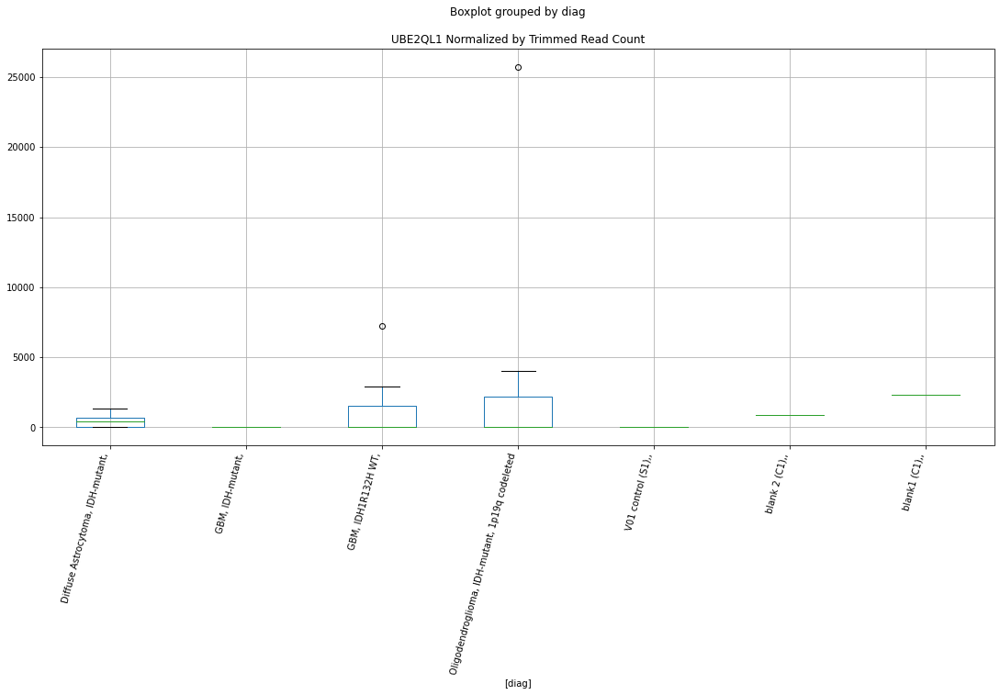

 p : 0.008141508808798182  ( t : 2.9734659099774707 ) :  Lexogen  :  bbduk2  :  ZNF771
Control and blanks
79     0.0
343    0.0
Name: ZNF771, dtype: float64
211    0.0
Name: ZNF771, dtype: float64
475    12933.85
Name: ZNF771, dtype: float64


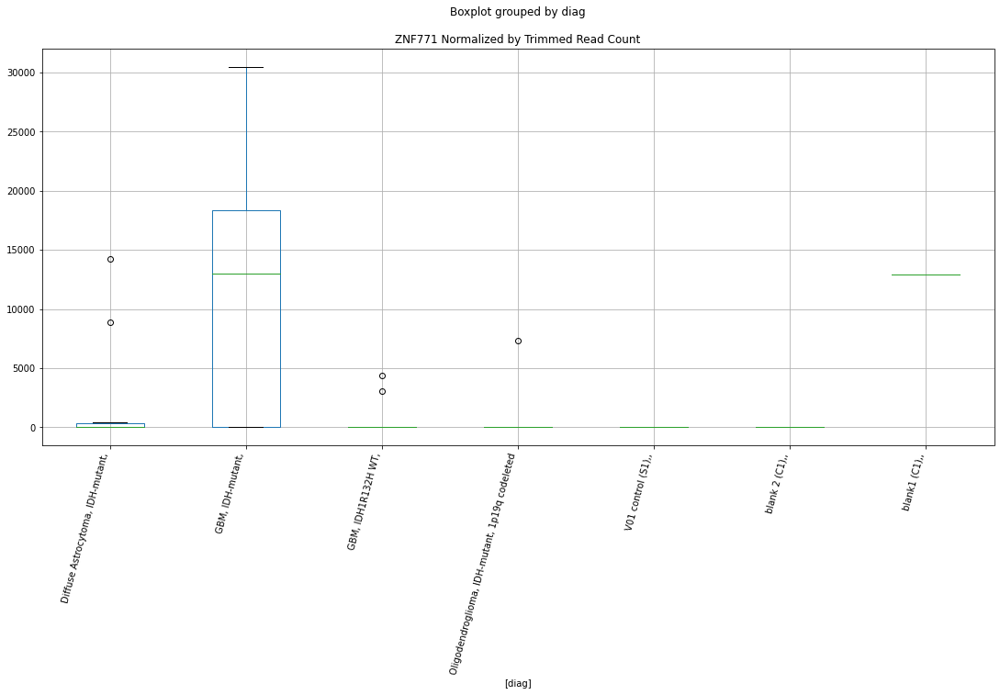

 p : 0.008181085932439398  ( t : 2.9712318896139562 ) :  Lexogen  :  cutadapt2  :  ZNF771
Control and blanks
82     0.0
346    0.0
Name: ZNF771, dtype: float64
214    0.0
Name: ZNF771, dtype: float64
478    12822.87
Name: ZNF771, dtype: float64


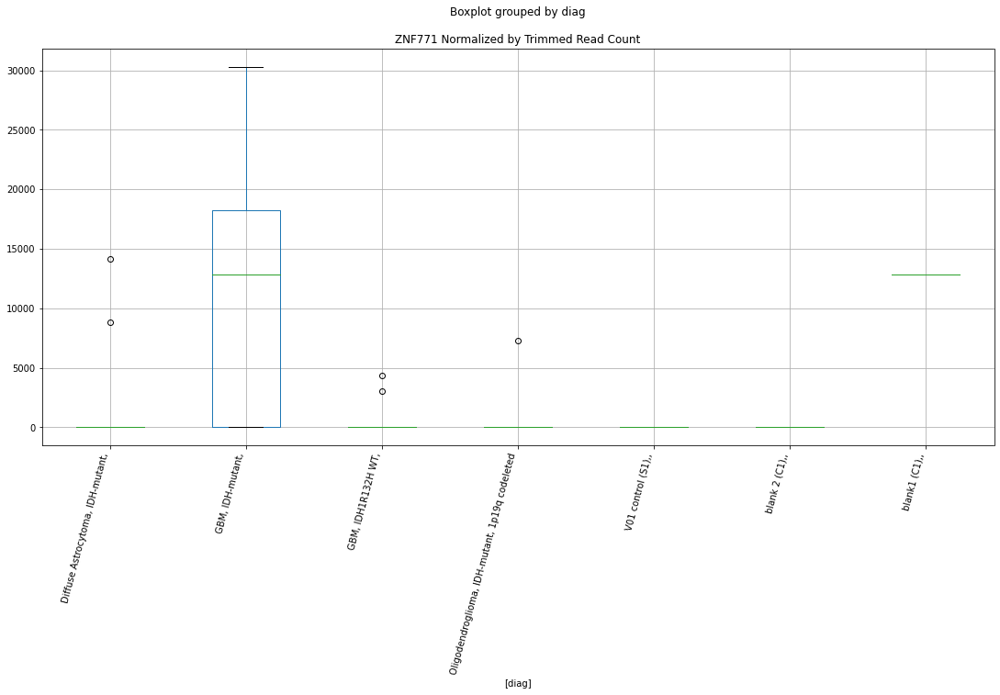

 p : 0.008321321201581017  ( t : 2.96339945219886 ) :  D-plex  :  bbduk2  :  UCKL1-AS1
Control and blanks
73       0.00
337    890.16
Name: UCKL1-AS1, dtype: float64
205    0.0
Name: UCKL1-AS1, dtype: float64
469    1183.05
Name: UCKL1-AS1, dtype: float64


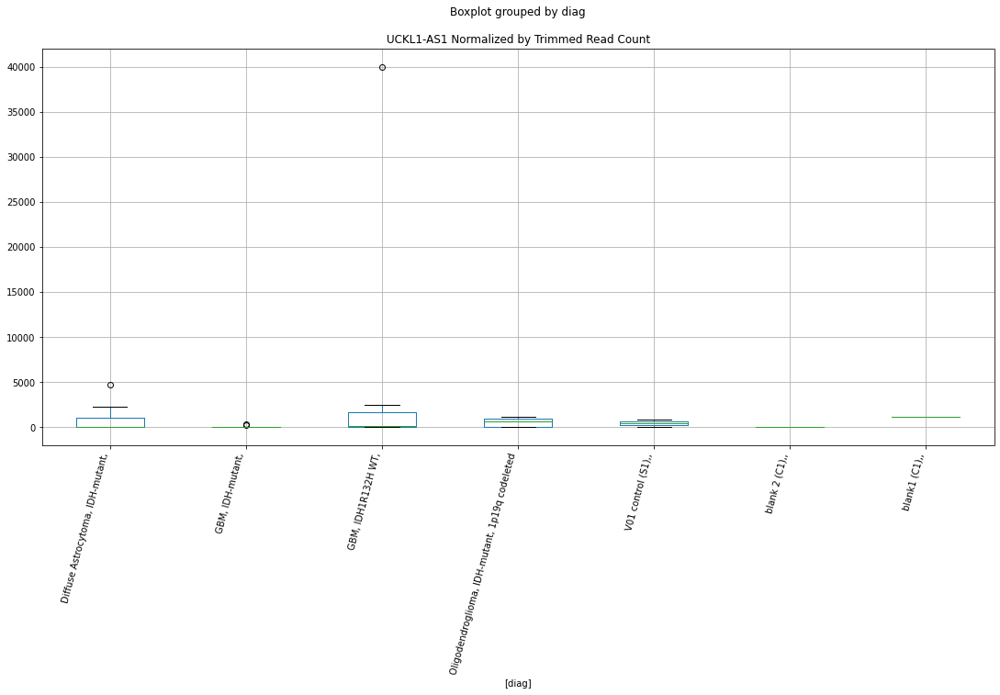

 p : 0.008451047467393223  ( t : 2.9562670386627237 ) :  D-plex  :  cutadapt2  :  UCKL1-AS1
Control and blanks
76     0.0
340    0.0
Name: UCKL1-AS1, dtype: float64
208    0.0
Name: UCKL1-AS1, dtype: float64
472    2311.82
Name: UCKL1-AS1, dtype: float64


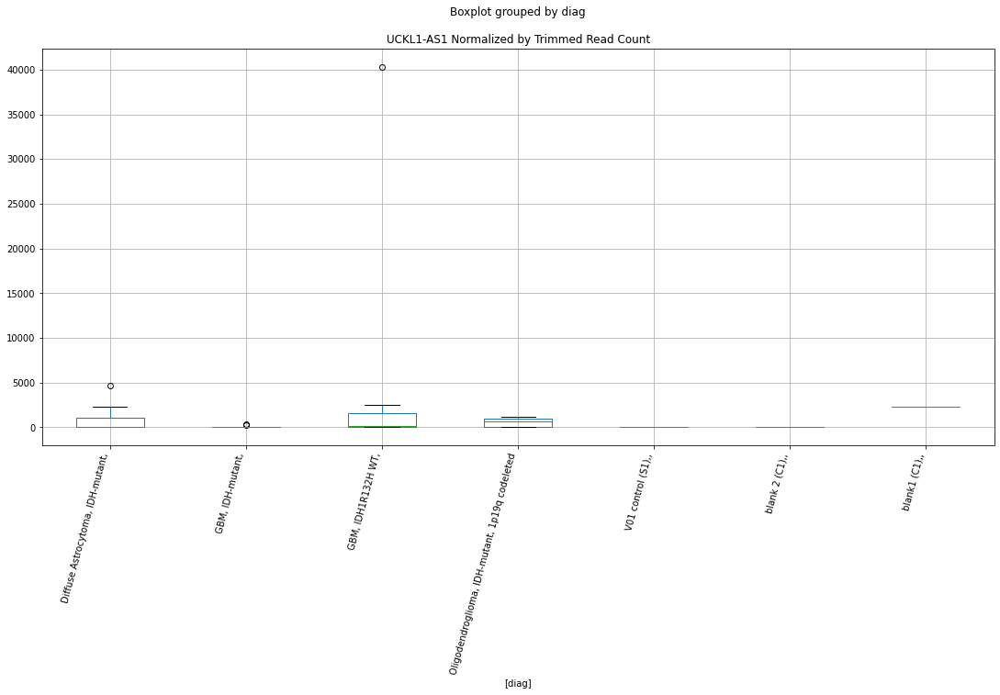

 p : 0.00936637723560713  ( t : 2.908763155244695 ) :  D-plex  :  cutadapt2  :  TXK
Control and blanks
76     0.0
340    0.0
Name: TXK, dtype: float64
208    365594.73
Name: TXK, dtype: float64
472    0.0
Name: TXK, dtype: float64


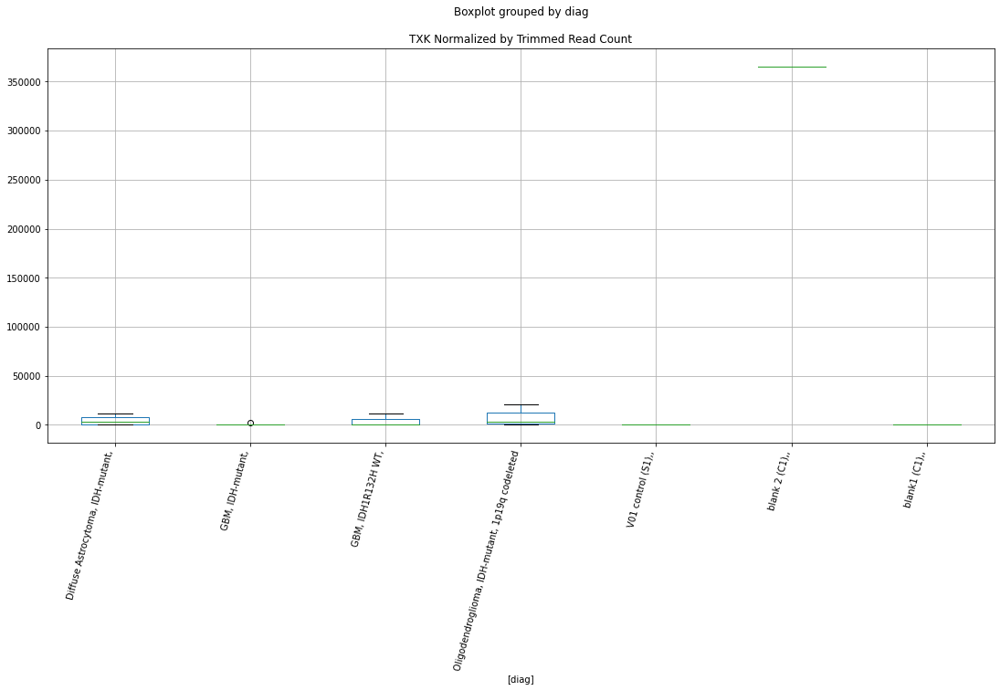

 p : 0.009475283293434642  ( t : 2.9034129797405765 ) :  Lexogen  :  bbduk2  :  UBE2D1
Control and blanks
79     0.0
343    0.0
Name: UBE2D1, dtype: float64
211    0.0
Name: UBE2D1, dtype: float64
475    0.0
Name: UBE2D1, dtype: float64


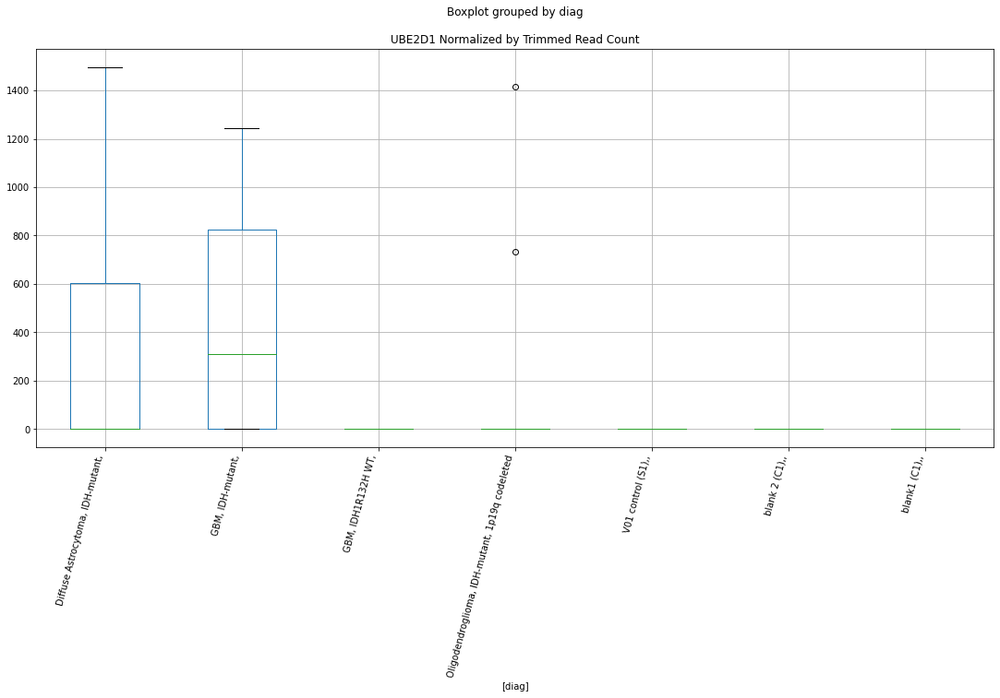

 p : 0.010003083824341263  ( t : 2.8782974791321934 ) :  Lexogen  :  bbduk2  :  TRIR
Control and blanks
79     0.0
343    0.0
Name: TRIR, dtype: float64
211    0.0
Name: TRIR, dtype: float64
475    0.0
Name: TRIR, dtype: float64


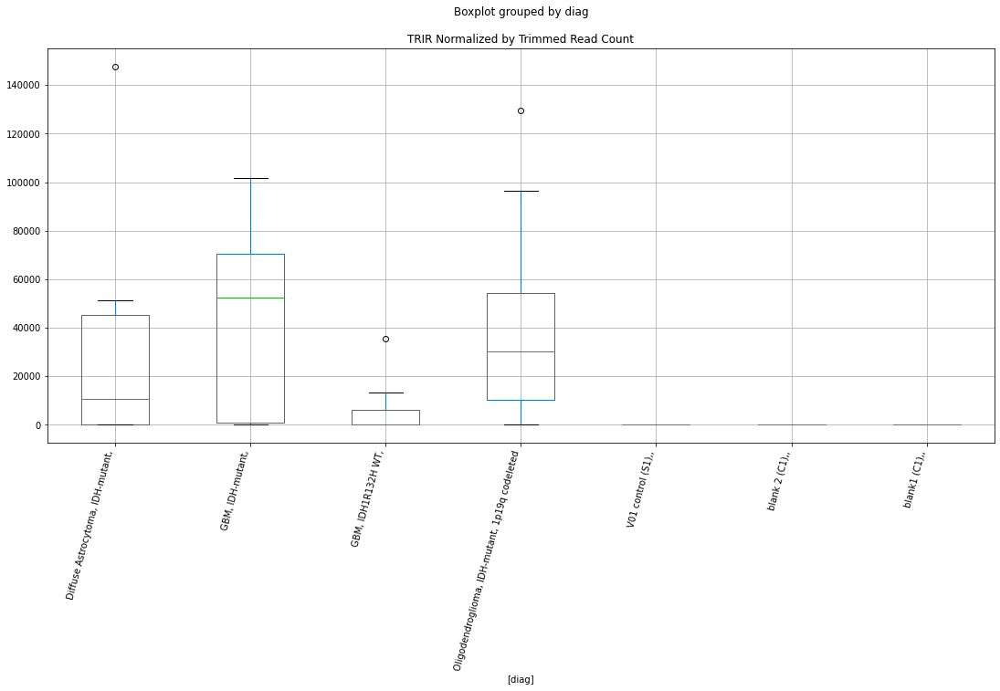

 p : 0.010188206519930921  ( t : 2.8697905193298054 ) :  D-plex  :  cutadapt2  :  ZDBF2
Control and blanks
76          0.00
340    126825.43
Name: ZDBF2, dtype: float64
208    5819.89
Name: ZDBF2, dtype: float64
472    8669.34
Name: ZDBF2, dtype: float64


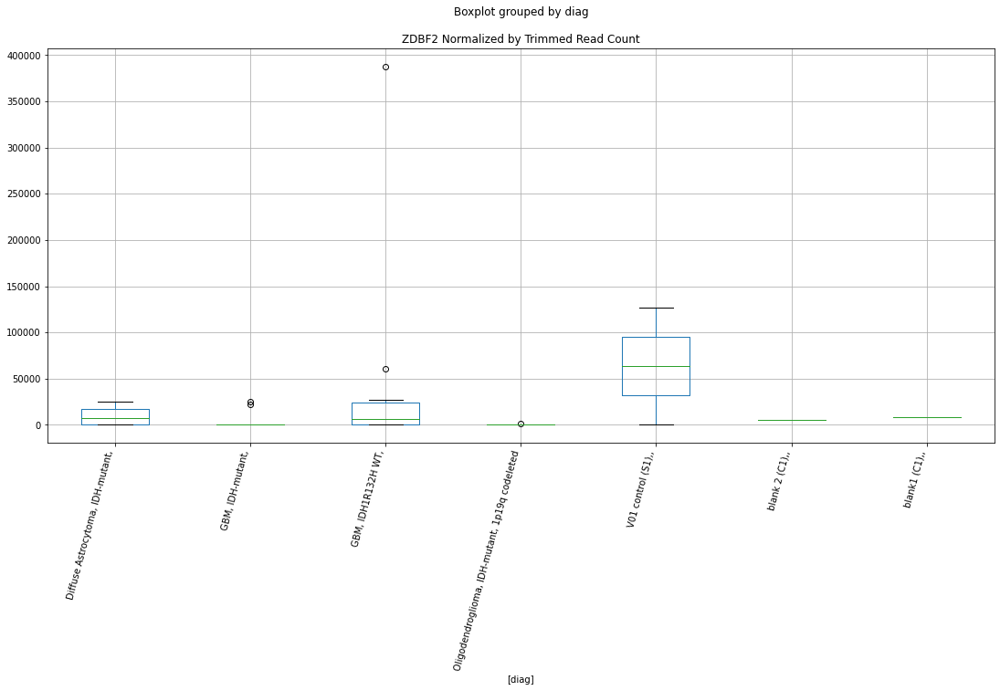

 p : 0.010299898512145723  ( t : 2.86472975179434 ) :  D-plex  :  bbduk2  :  VCP
Control and blanks
73     2319.03
337       0.00
Name: VCP, dtype: float64
205    3760.91
Name: VCP, dtype: float64
469    4732.22
Name: VCP, dtype: float64


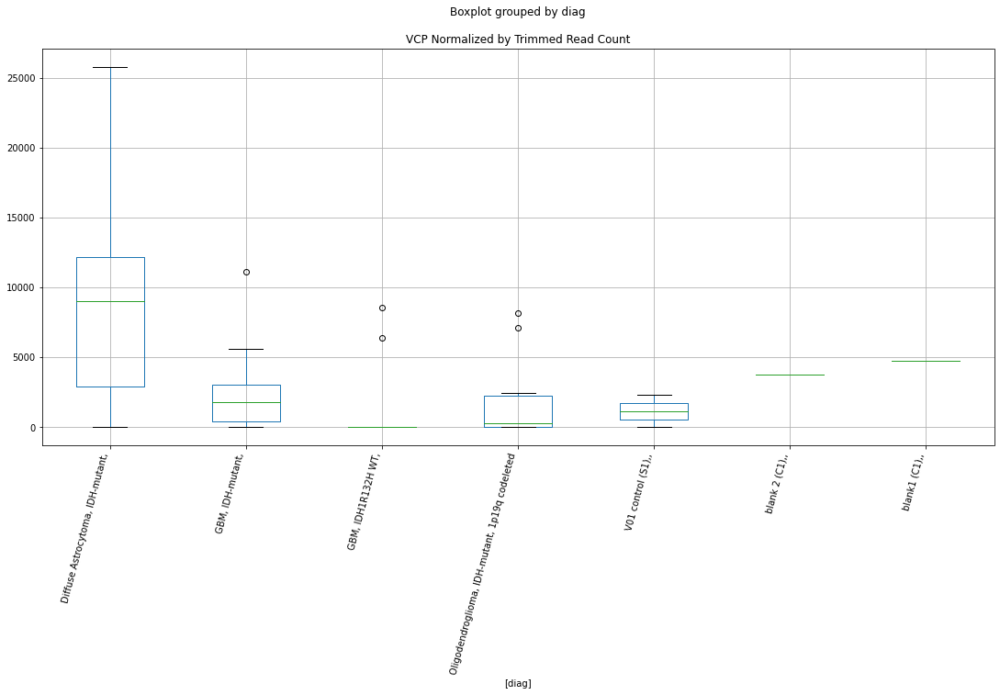

 p : 0.010388611539659087  ( t : 2.8607477266637713 ) :  D-plex  :  bbduk2  :  ZNF487
Control and blanks
73     0.0
337    0.0
Name: ZNF487, dtype: float64
205    4656.36
Name: ZNF487, dtype: float64
469    15379.71
Name: ZNF487, dtype: float64


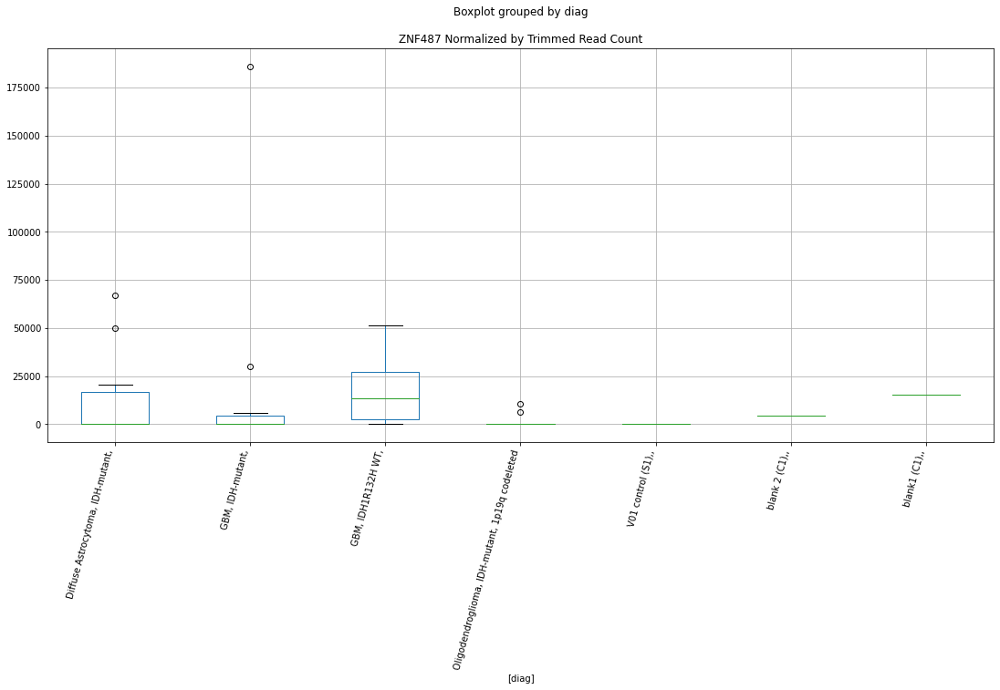

 p : 0.010457934490551702  ( t : 2.8576588067568056 ) :  D-plex  :  bbduk2  :  UNC5C
Control and blanks
73     136049.48
337         0.00
Name: UNC5C, dtype: float64
205    21132.73
Name: UNC5C, dtype: float64
469    17154.29
Name: UNC5C, dtype: float64


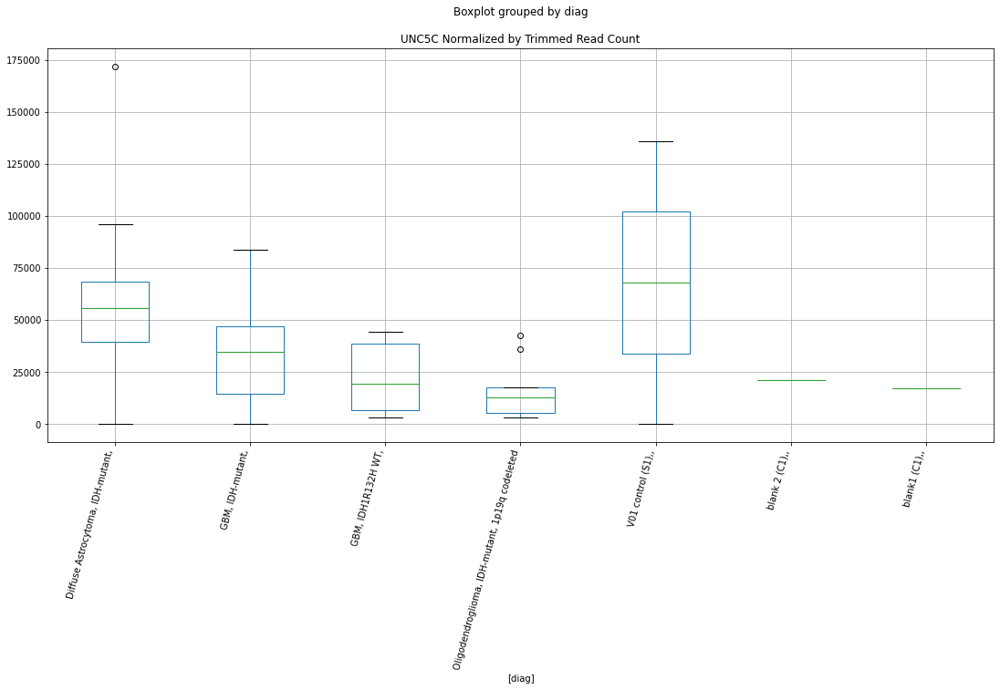

 p : 0.01047609420488602  ( t : 2.8568529011378394 ) :  Lexogen  :  bbduk2  :  ZBTB38
Control and blanks
79        0.0
343    2972.4
Name: ZBTB38, dtype: float64
211    0.0
Name: ZBTB38, dtype: float64
475    3353.22
Name: ZBTB38, dtype: float64


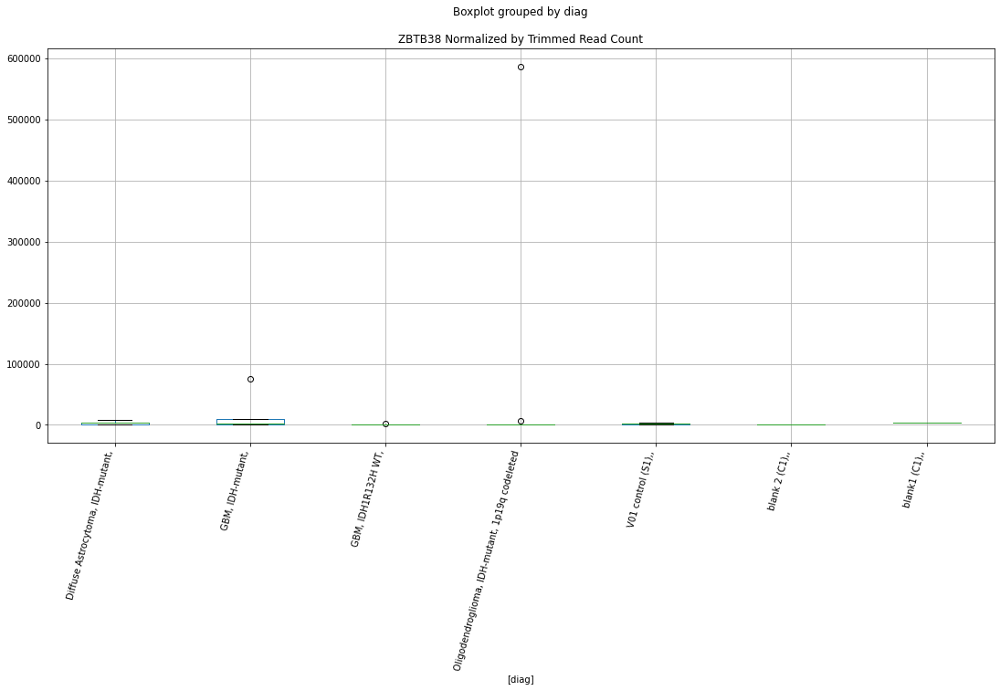

 p : 0.010511204666750741  ( t : 2.8552985532496695 ) :  D-plex  :  cutadapt2  :  WDR24
Control and blanks
76     0.0
340    0.0
Name: WDR24, dtype: float64
208    2116.32
Name: WDR24, dtype: float64
472    1155.91
Name: WDR24, dtype: float64


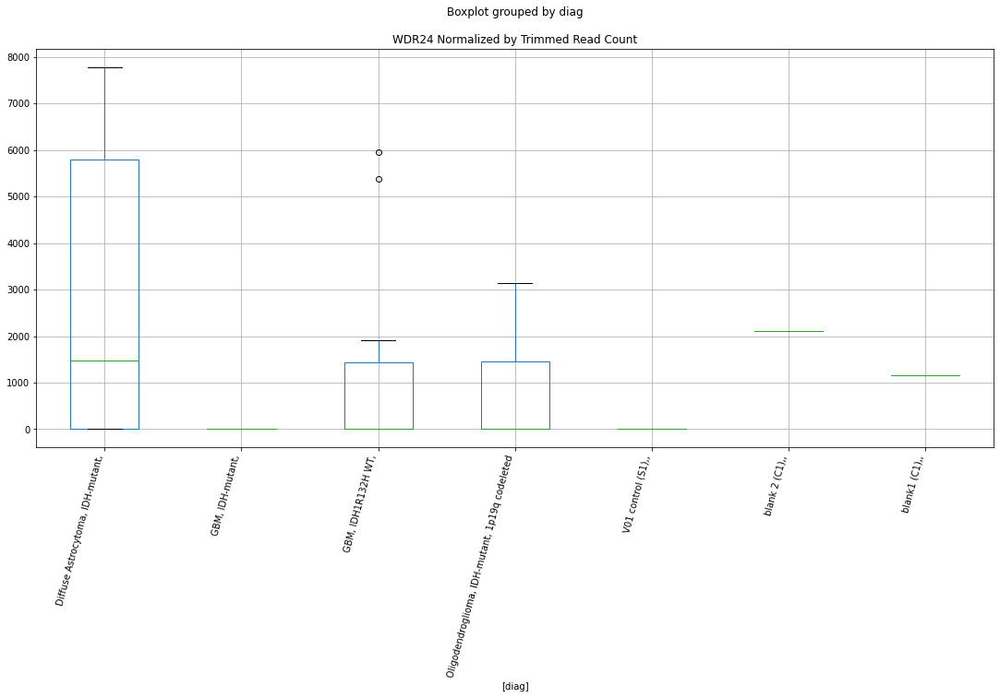

 p : 0.010587253408541213  ( t : 2.8519489432763447 ) :  D-plex  :  bbduk2  :  WDR24
Control and blanks
73     0.0
337    0.0
Name: WDR24, dtype: float64
205    2149.09
Name: WDR24, dtype: float64
469    1183.05
Name: WDR24, dtype: float64


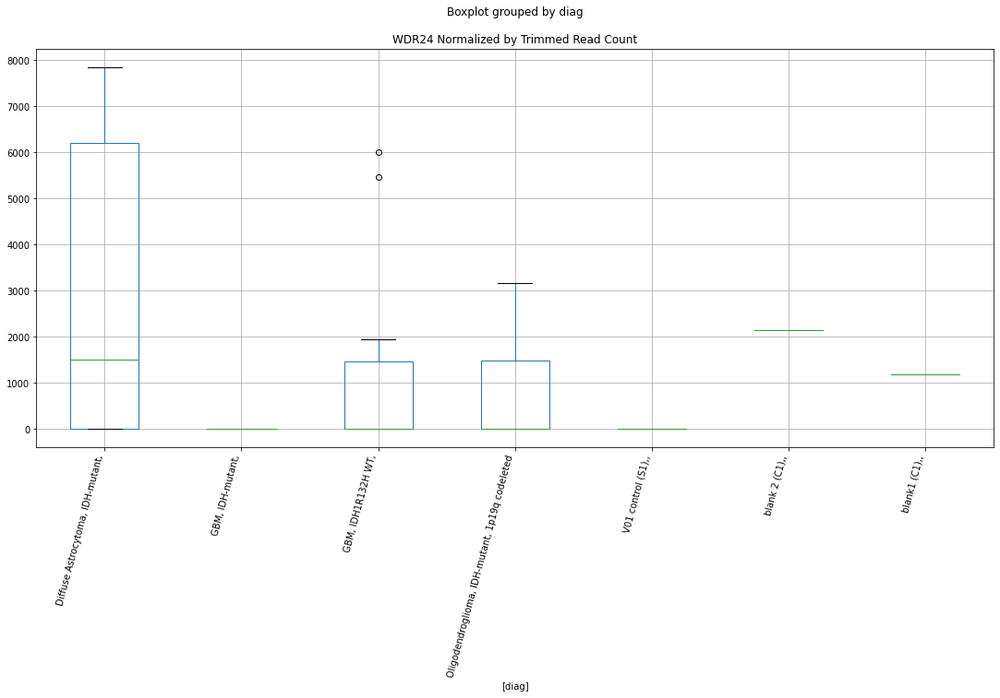

 p : 0.010592207912806679  ( t : 2.851731524513309 ) :  Lexogen  :  cutadapt2  :  TRIR
Control and blanks
82     0.0
346    0.0
Name: TRIR, dtype: float64
214    0.0
Name: TRIR, dtype: float64
478    0.0
Name: TRIR, dtype: float64


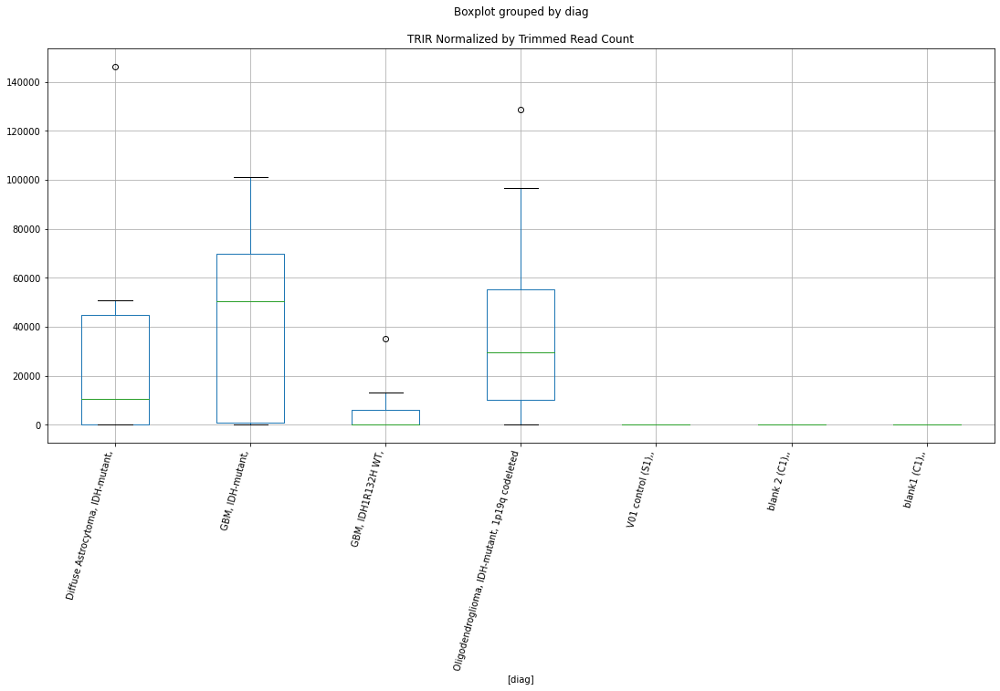

 p : 0.010810607026723573  ( t : 2.8422435654444316 ) :  D-plex  :  cutadapt2  :  UNC5C
Control and blanks
76     136370.56
340         0.00
Name: UNC5C, dtype: float64
208    20810.51
Name: UNC5C, dtype: float64
472    16760.72
Name: UNC5C, dtype: float64


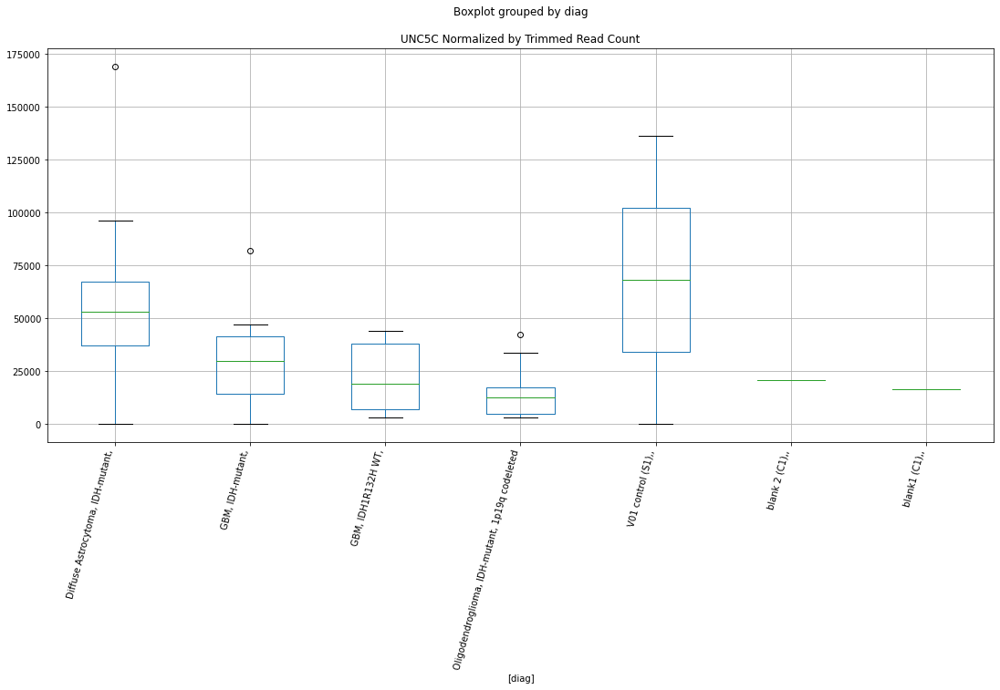

 p : 0.010861495328525601  ( t : 2.840059346165091 ) :  D-plex  :  cutadapt2  :  VCP
Control and blanks
76     2272.84
340       0.00
Name: VCP, dtype: float64
208    3703.56
Name: VCP, dtype: float64
472    5779.56
Name: VCP, dtype: float64


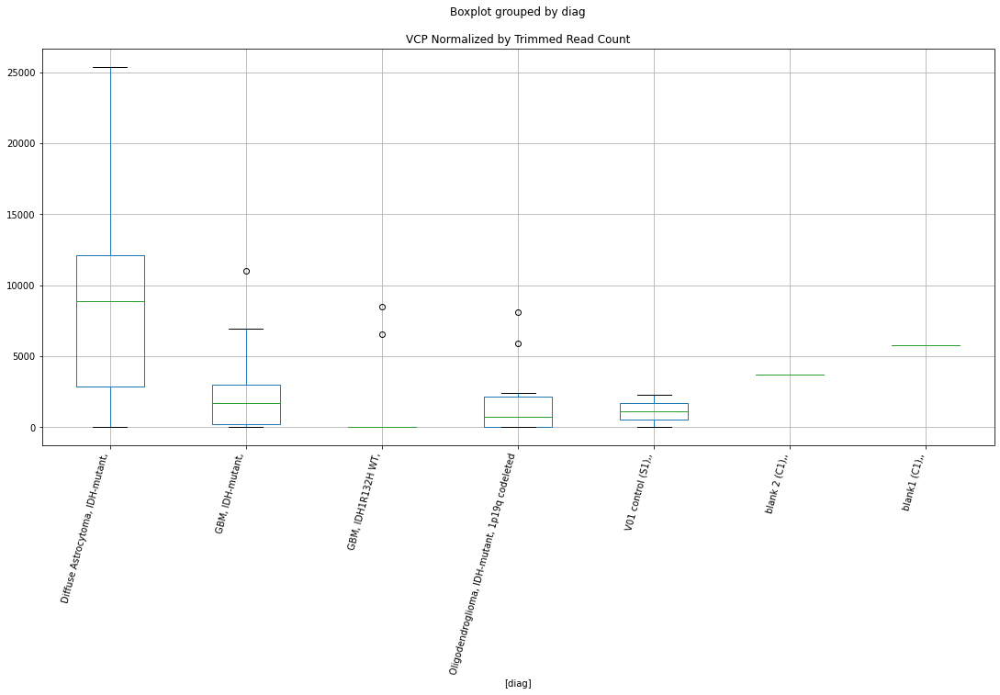

 p : 0.011186362306882174  ( t : 2.8263434022738316 ) :  D-plex  :  bbduk2  :  TPST1
Control and blanks
73         0.00
337    74773.21
Name: TPST1, dtype: float64
205    1970.0
Name: TPST1, dtype: float64
469    8872.91
Name: TPST1, dtype: float64


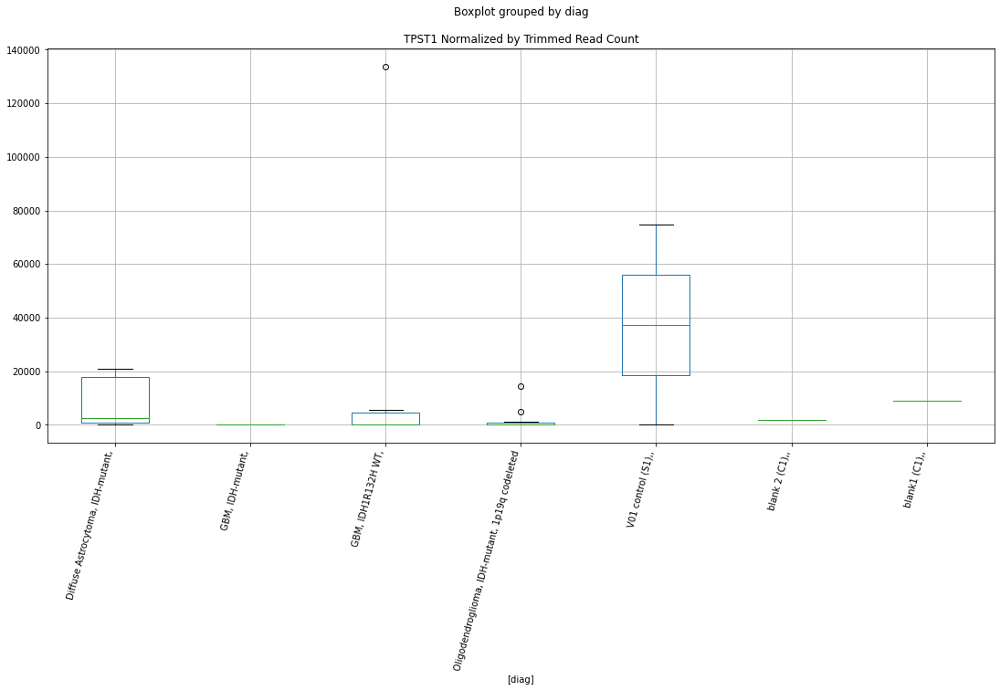

 p : 0.011493269166908428  ( t : 2.8137333762241994 ) :  Lexogen  :  bbduk2  :  TGM4
Control and blanks
79     0.0
343    0.0
Name: TGM4, dtype: float64
211    0.0
Name: TGM4, dtype: float64
475    479.03
Name: TGM4, dtype: float64


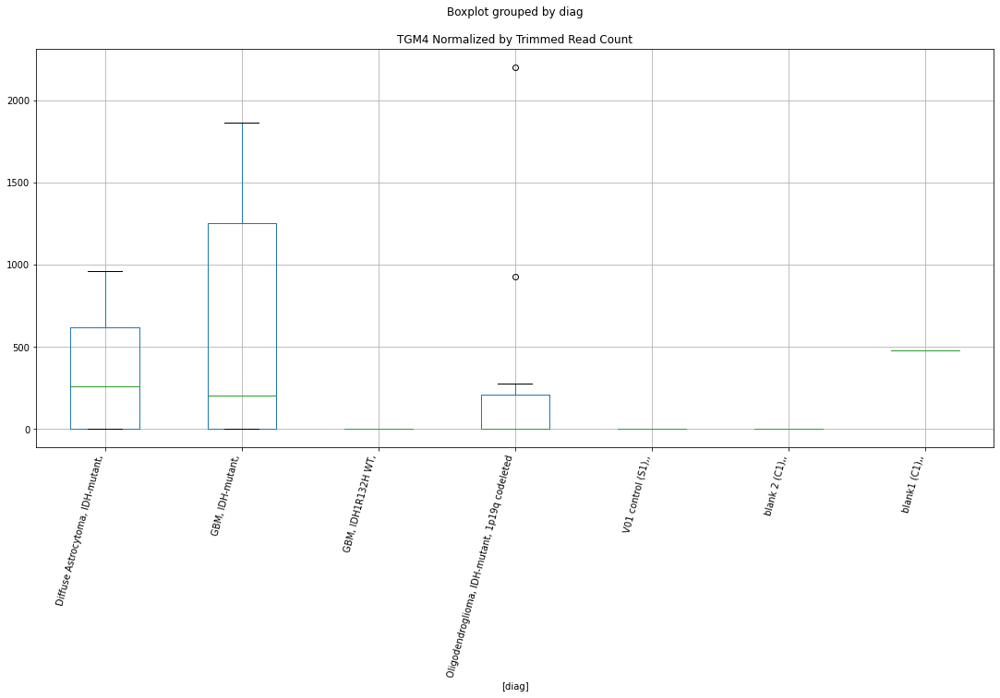

 p : 0.011577941934137767  ( t : 2.8103113735825183 ) :  D-plex  :  cutadapt2  :  ZNF487
Control and blanks
76     0.0
340    0.0
Name: ZNF487, dtype: float64
208    4585.37
Name: ZNF487, dtype: float64
472    15026.85
Name: ZNF487, dtype: float64


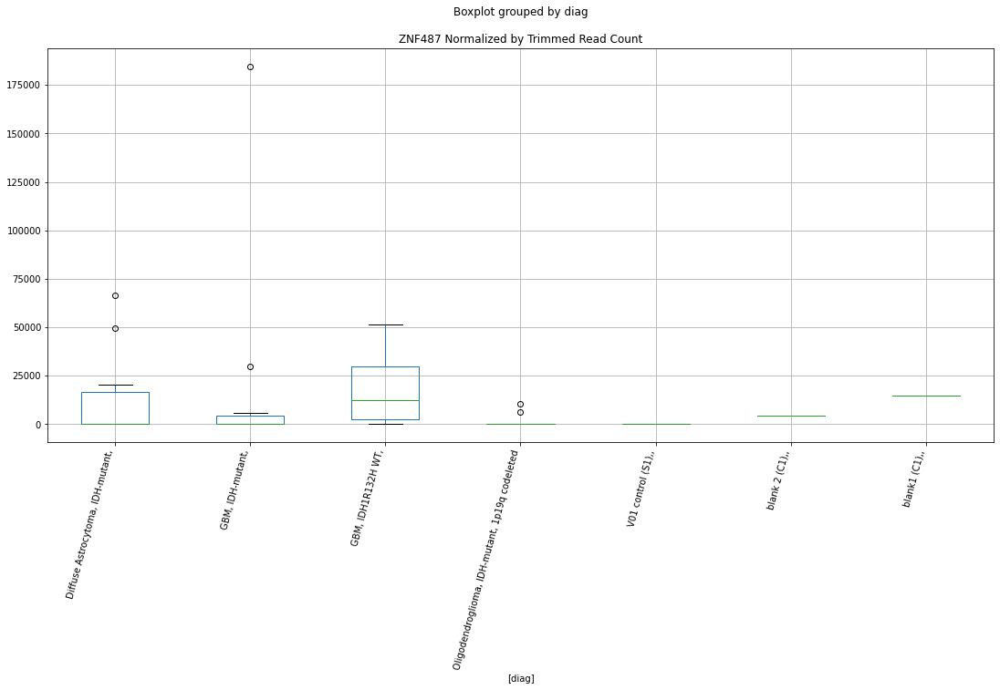

 p : 0.011978023511745416  ( t : 2.7944608647508975 ) :  D-plex  :  bbduk2  :  TESK2
Control and blanks
73      97399.06
337    320456.62
Name: TESK2, dtype: float64
205    171569.13
Name: TESK2, dtype: float64
469    63884.95
Name: TESK2, dtype: float64


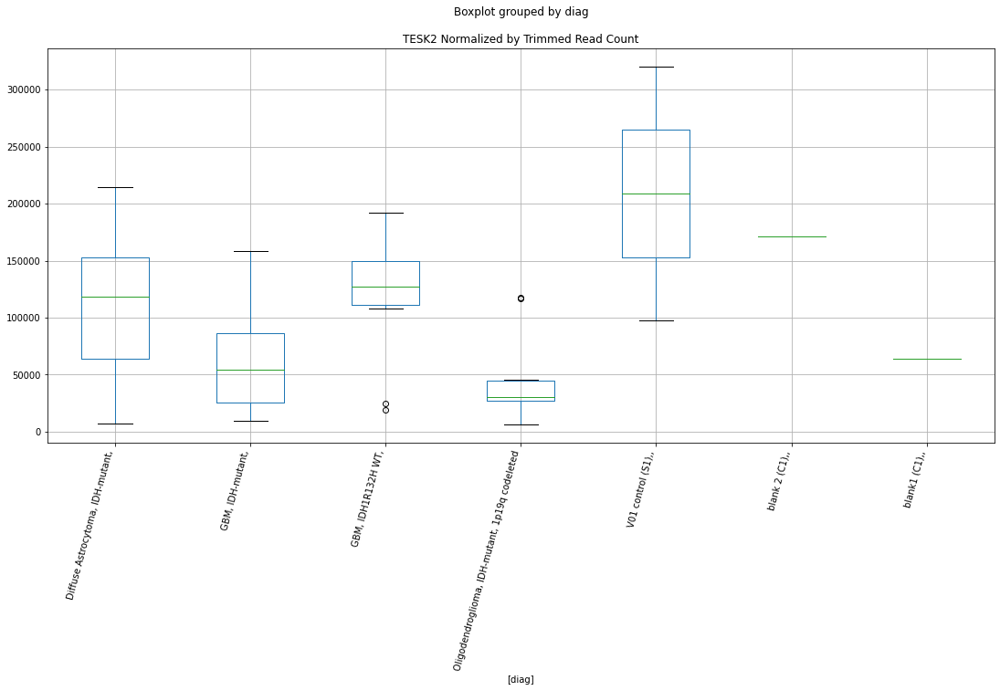

 p : 0.012056113898650914  ( t : 2.7914264880464223 ) :  D-plex  :  cutadapt2  :  TLX2
Control and blanks
76     0.0
340    0.0
Name: TLX2, dtype: float64
208    352.72
Name: TLX2, dtype: float64
472    2311.82
Name: TLX2, dtype: float64


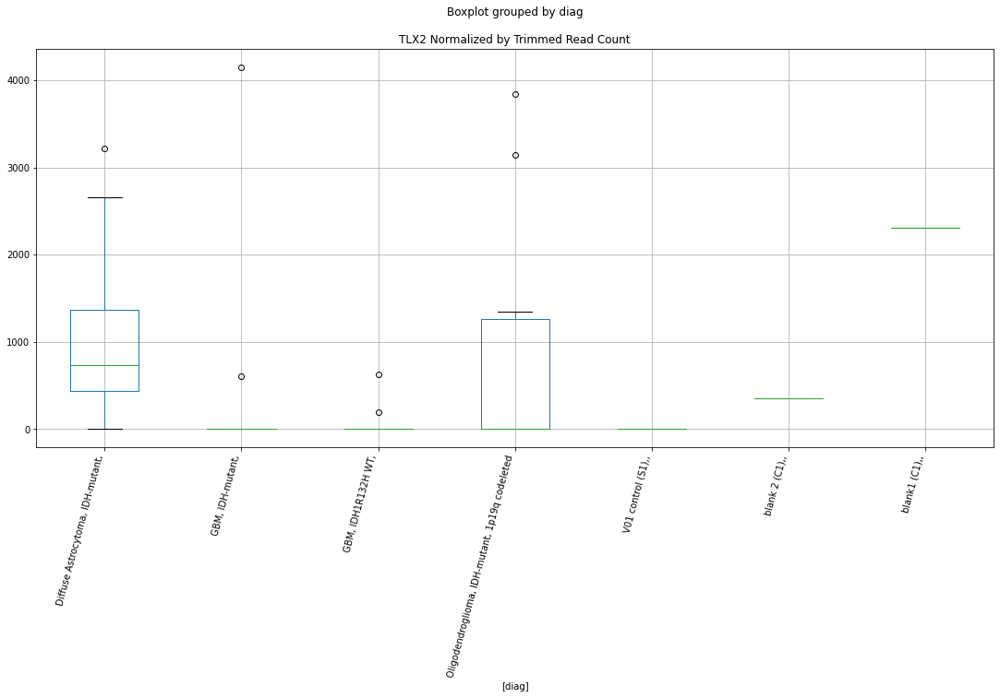

 p : 0.01240640245799448  ( t : 2.778043359985338 ) :  D-plex  :  bbduk2  :  ZRANB2-AS1
Control and blanks
73     773.01
337      0.00
Name: ZRANB2-AS1, dtype: float64
205    1253.64
Name: ZRANB2-AS1, dtype: float64
469    0.0
Name: ZRANB2-AS1, dtype: float64


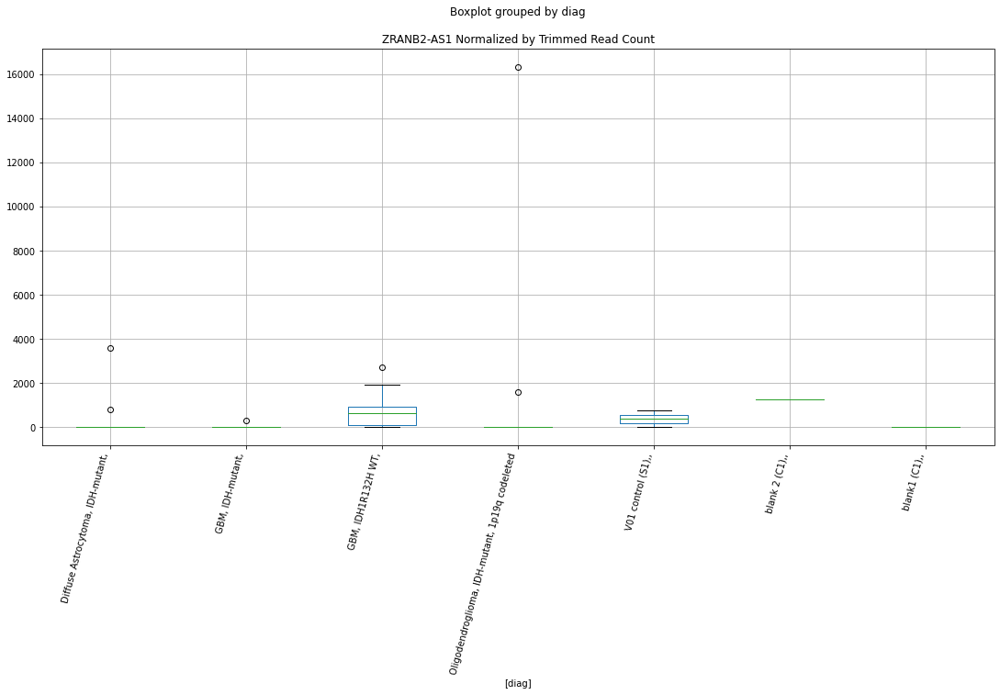

 p : 0.01242443998225415  ( t : 2.777364076295466 ) :  Lexogen  :  cutadapt2  :  WDR19
Control and blanks
82     149105.37
346     44401.68
Name: WDR19, dtype: float64
214    28478.78
Name: WDR19, dtype: float64
478    10685.72
Name: WDR19, dtype: float64


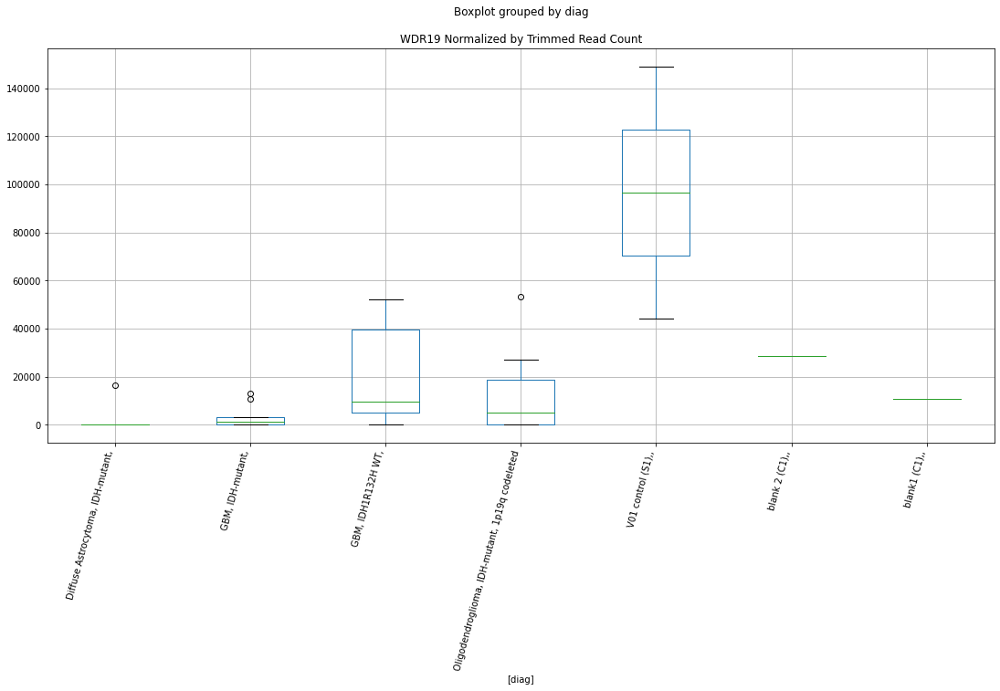

 p : 0.012425490143820923  ( t : 2.7773245569190372 ) :  D-plex  :  cutadapt2  :  TESK2
Control and blanks
76      95459.39
340    320586.50
Name: TESK2, dtype: float64
208    171422.13
Name: TESK2, dtype: float64
472    61263.32
Name: TESK2, dtype: float64


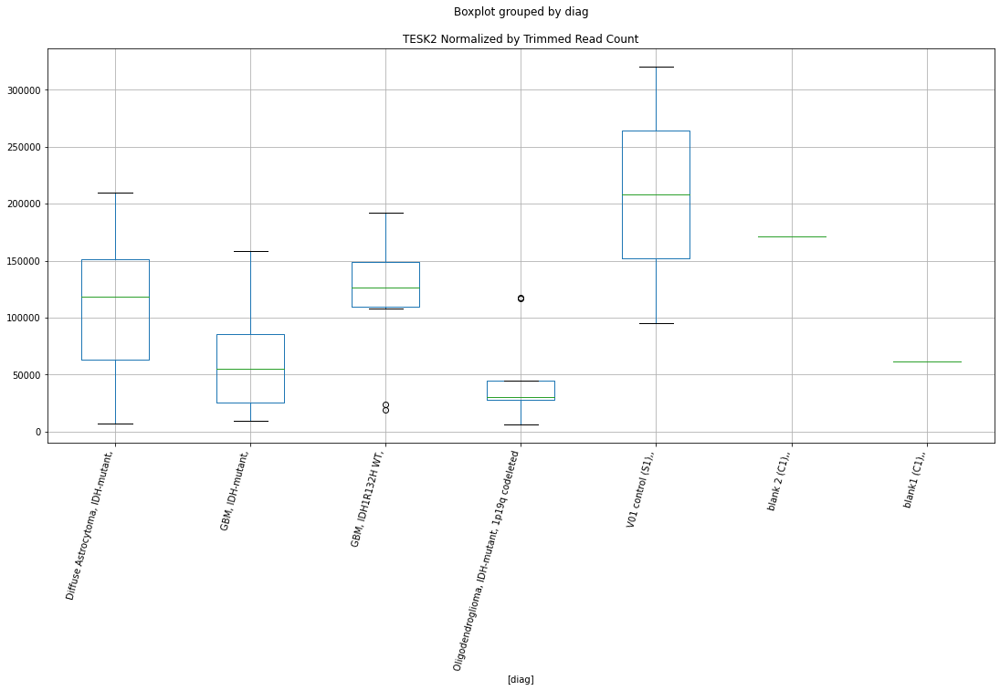

 p : 0.012435030282827757  ( t : 2.776965691899438 ) :  D-plex  :  cutadapt2  :  VPS11
Control and blanks
76     0.0
340    0.0
Name: VPS11, dtype: float64
208    0.0
Name: VPS11, dtype: float64
472    0.0
Name: VPS11, dtype: float64


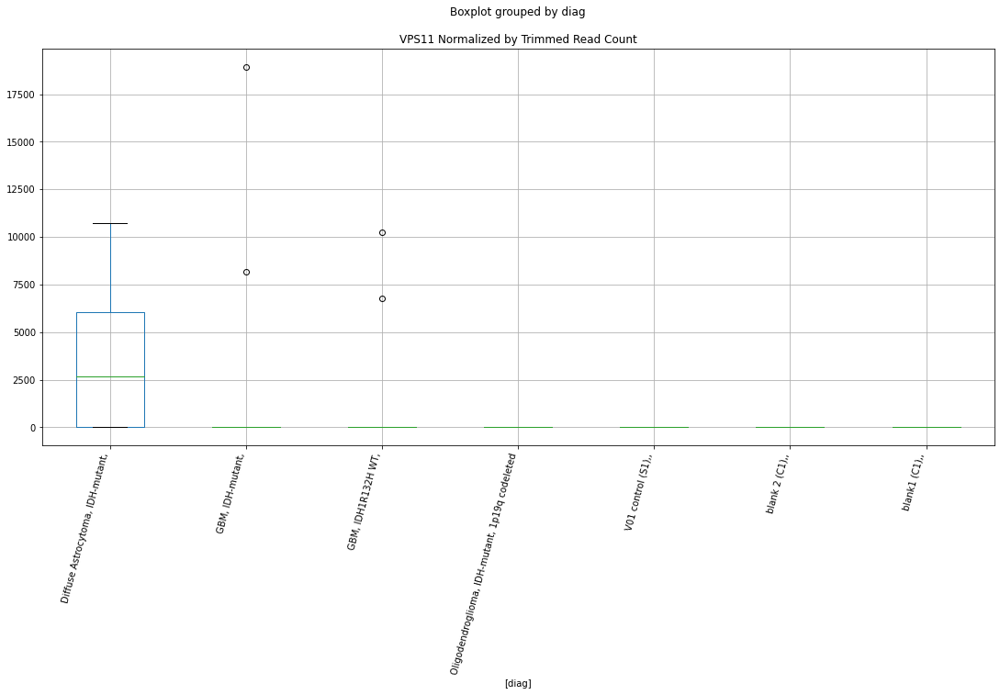

 p : 0.012868913489975257  ( t : 2.760917570992254 ) :  D-plex  :  cutadapt2  :  TBC1D8B
Control and blanks
76     0.0
340    0.0
Name: TBC1D8B, dtype: float64
208    705.44
Name: TBC1D8B, dtype: float64
472    5779.56
Name: TBC1D8B, dtype: float64


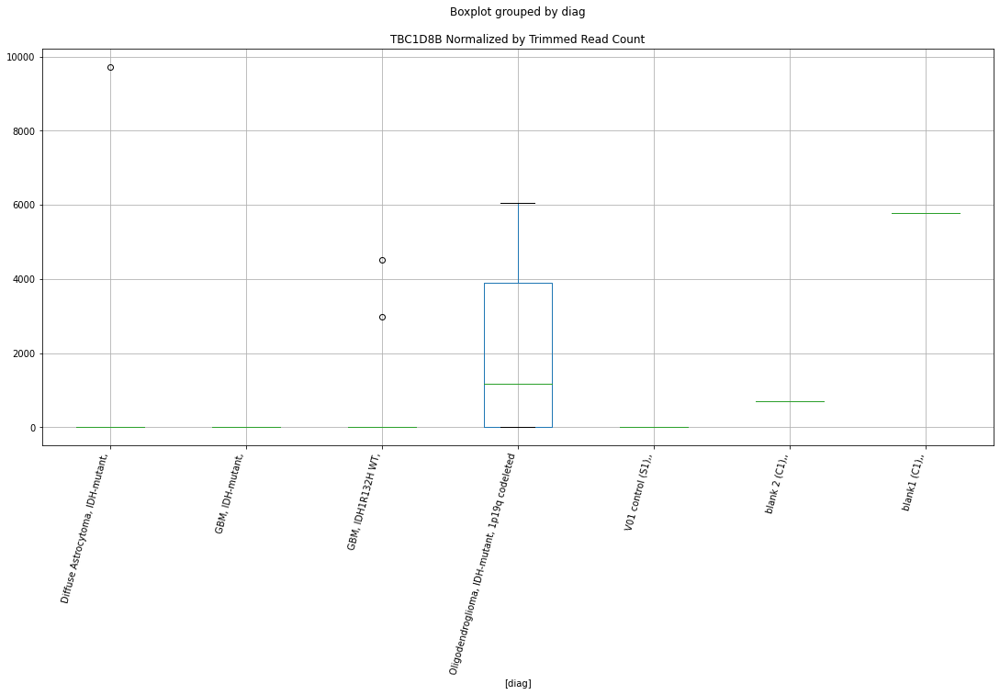

 p : 0.012937463232838082  ( t : 2.7584296857120507 ) :  D-plex  :  cutadapt2  :  TXK
Control and blanks
76     0.0
340    0.0
Name: TXK, dtype: float64
208    365594.73
Name: TXK, dtype: float64
472    0.0
Name: TXK, dtype: float64


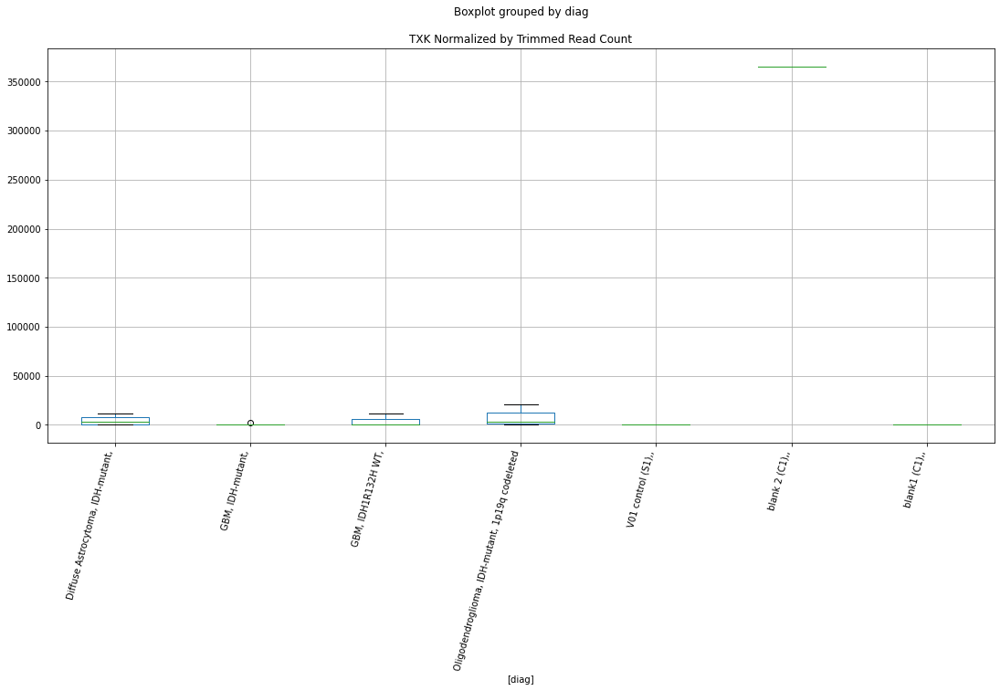

 p : 0.013496985291618226  ( t : 2.738582670692574 ) :  Lexogen  :  cutadapt2  :  ZC3H18
Control and blanks
82     0.0
346    0.0
Name: ZC3H18, dtype: float64
214    0.0
Name: ZC3H18, dtype: float64
478    0.0
Name: ZC3H18, dtype: float64


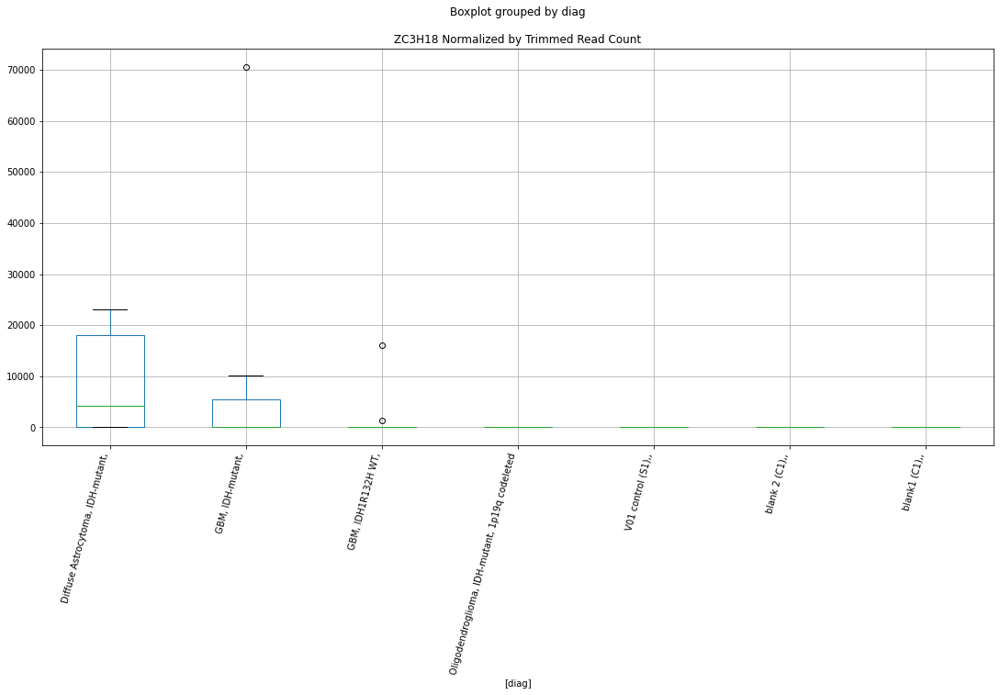

 p : 0.013517075169376934  ( t : 2.7378848031688148 ) :  D-plex  :  bbduk2  :  ZBTB47
Control and blanks
73        0.00
337    1780.31
Name: ZBTB47, dtype: float64
205    1074.55
Name: ZBTB47, dtype: float64
469    1183.05
Name: ZBTB47, dtype: float64


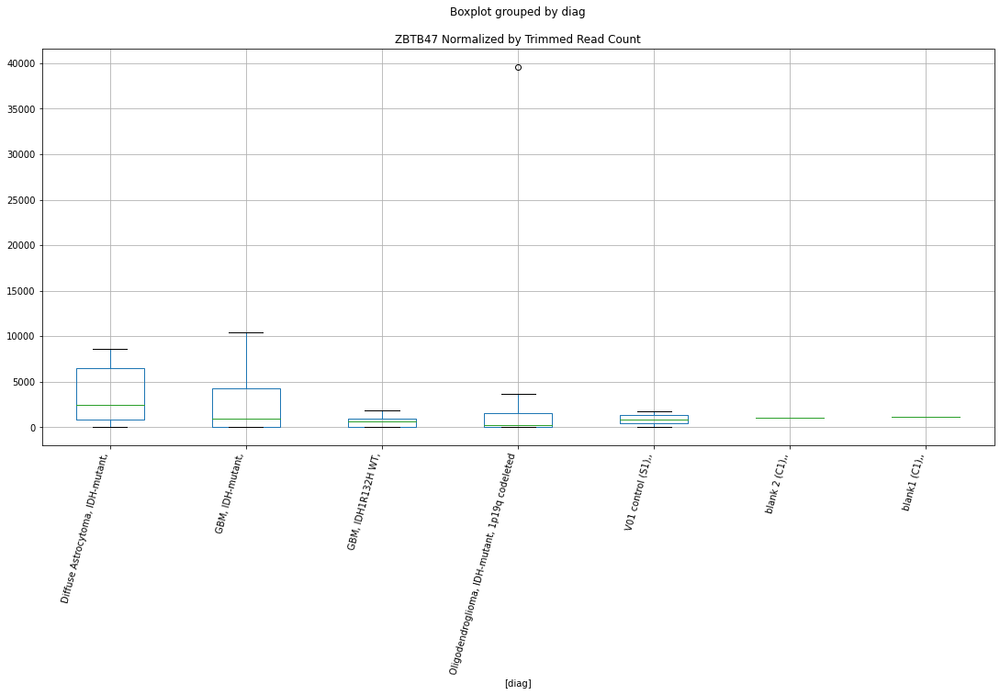

 p : 0.013661151014164012  ( t : 2.732908901042767 ) :  D-plex  :  cutadapt2  :  TRIM42
Control and blanks
76     0.0
340    0.0
Name: TRIM42, dtype: float64
208    1939.96
Name: TRIM42, dtype: float64
472    319031.62
Name: TRIM42, dtype: float64


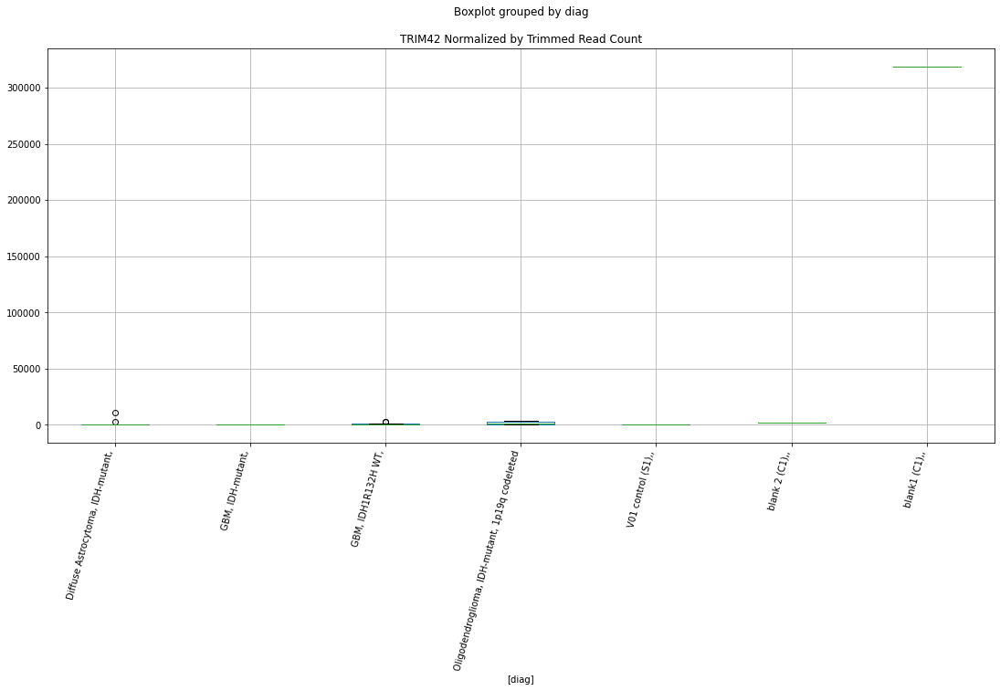

 p : 0.013847936240975784  ( t : 2.7265321954201687 ) :  D-plex  :  cutadapt2  :  VCP
Control and blanks
76     2272.84
340       0.00
Name: VCP, dtype: float64
208    3703.56
Name: VCP, dtype: float64
472    5779.56
Name: VCP, dtype: float64


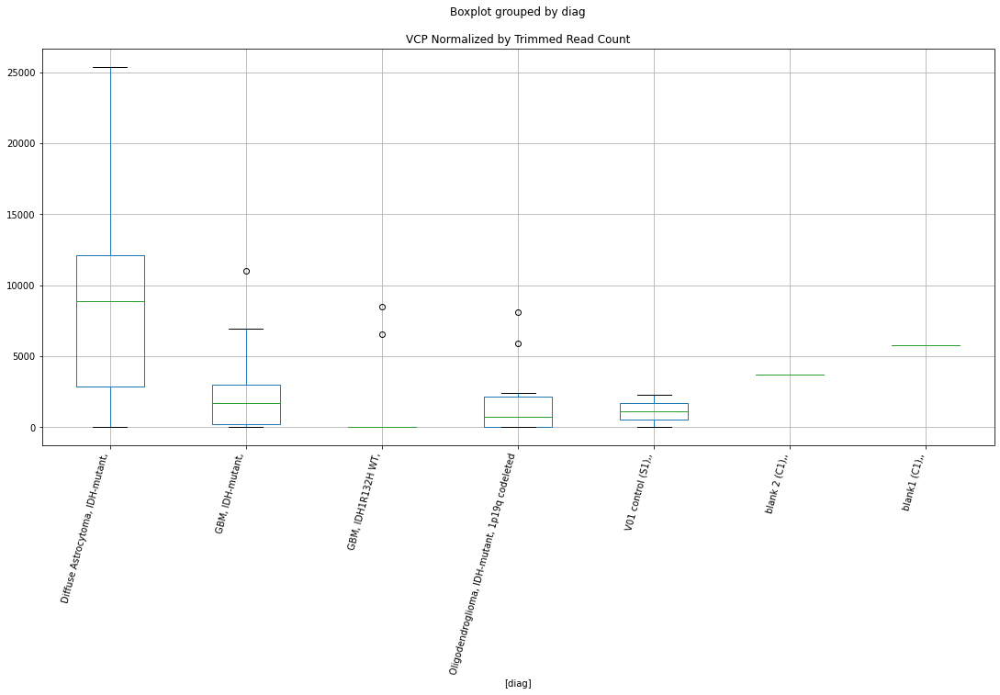

 p : 0.013849323503782917  ( t : 2.7264851439079765 ) :  D-plex  :  bbduk2  :  TRIM42
Control and blanks
73     0.0
337    0.0
Name: TRIM42, dtype: float64
205    1970.0
Name: TRIM42, dtype: float64
469    326523.08
Name: TRIM42, dtype: float64


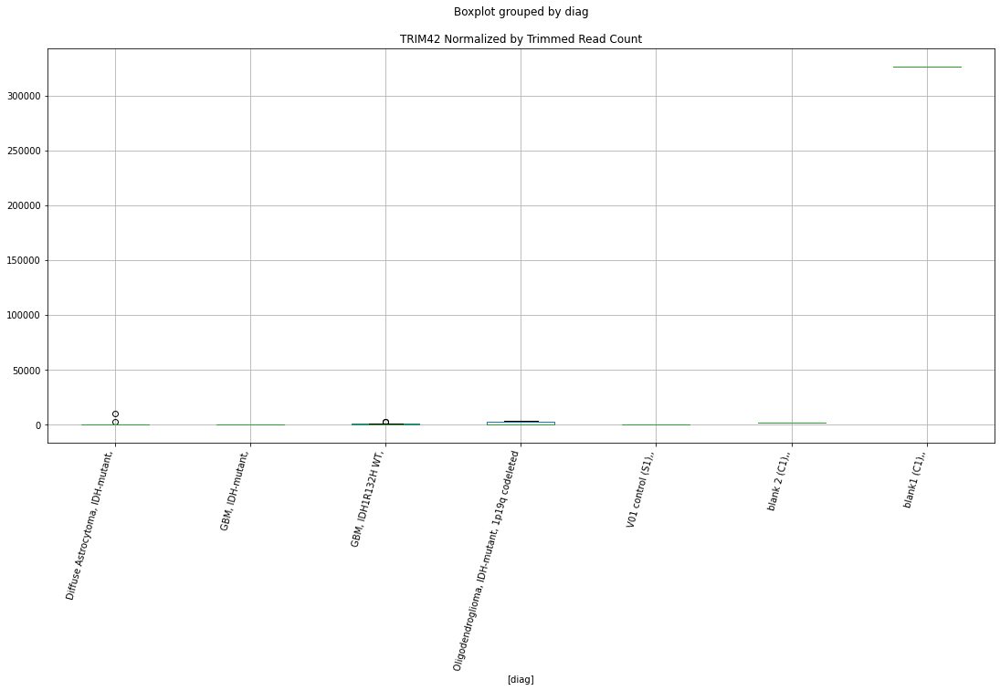

 p : 0.014030398472005231  ( t : 2.720382034048211 ) :  Lexogen  :  bbduk2  :  ZC3H18
Control and blanks
79     0.0
343    0.0
Name: ZC3H18, dtype: float64
211    0.0
Name: ZC3H18, dtype: float64
475    0.0
Name: ZC3H18, dtype: float64


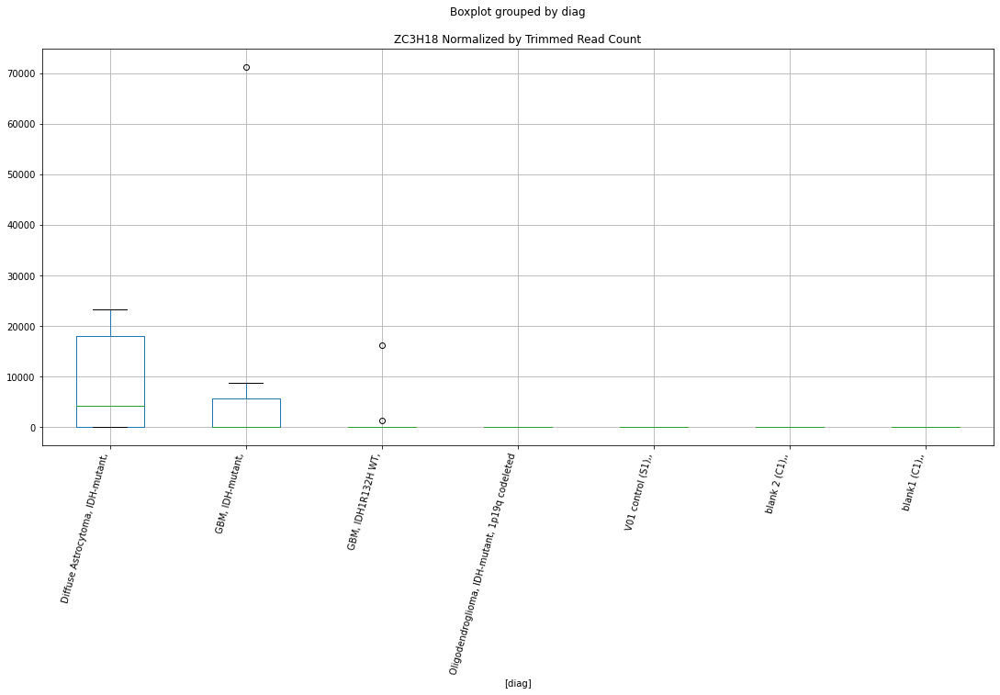

 p : 0.014314046917547205  ( t : 2.710971474159041 ) :  D-plex  :  bbduk2  :  TLX2
Control and blanks
73     0.0
337    0.0
Name: TLX2, dtype: float64
205    358.18
Name: TLX2, dtype: float64
469    1774.58
Name: TLX2, dtype: float64


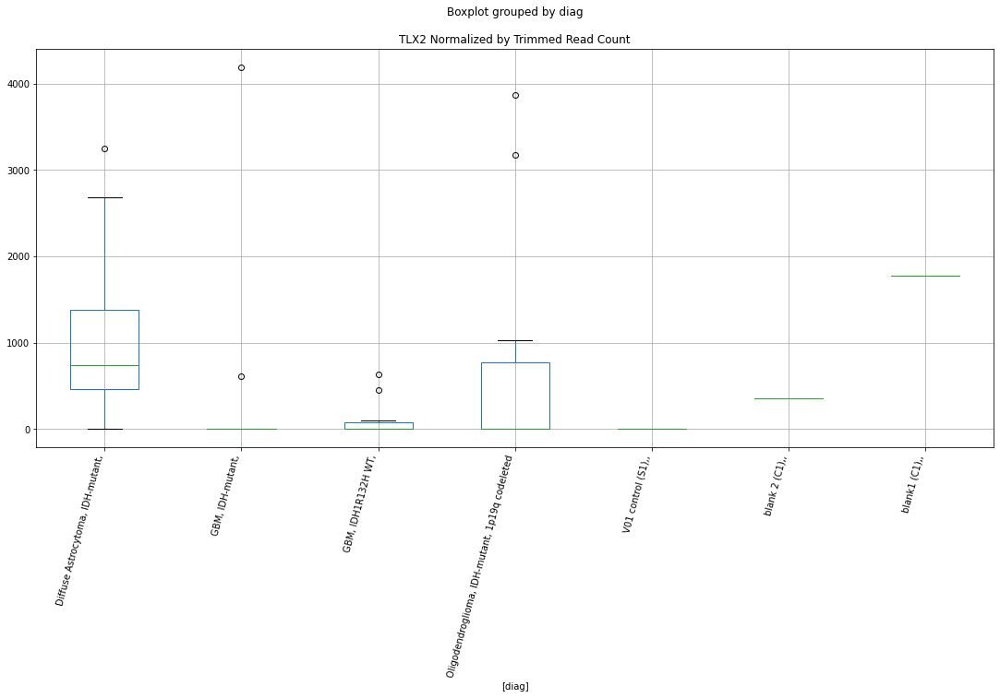

 p : 0.014531169304453466  ( t : 2.7038877136283133 ) :  Lexogen  :  bbduk2  :  TMPRSS9
Control and blanks
79       0.00
343    212.31
Name: TMPRSS9, dtype: float64
211    0.0
Name: TMPRSS9, dtype: float64
475    0.0
Name: TMPRSS9, dtype: float64


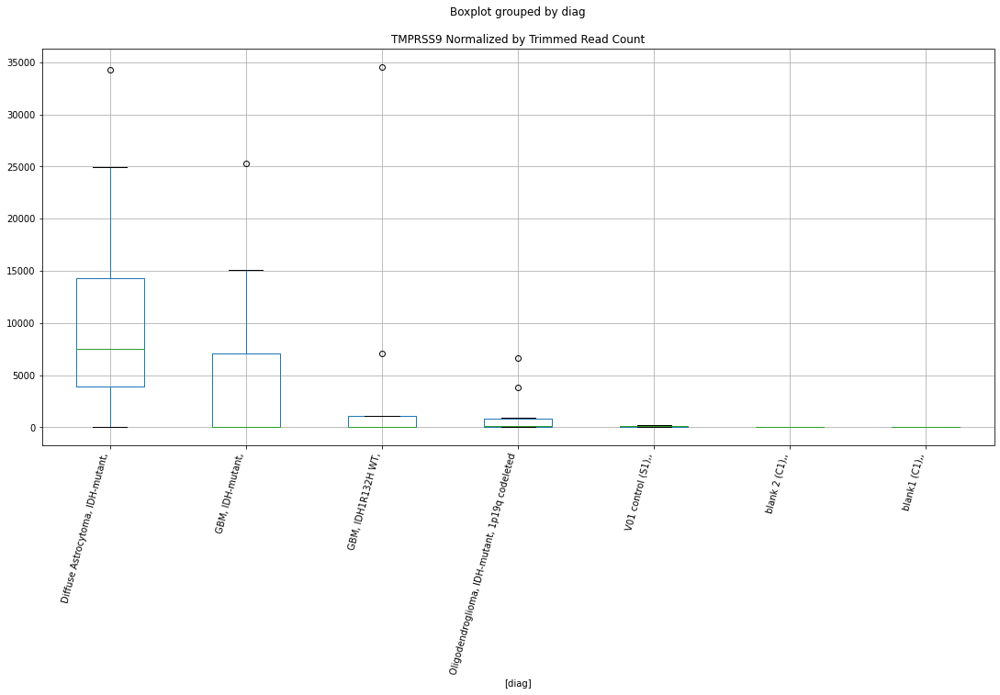

 p : 0.014543233762653264  ( t : 2.7034970748301275 ) :  D-plex  :  bbduk2  :  VCP
Control and blanks
73     2319.03
337       0.00
Name: VCP, dtype: float64
205    3760.91
Name: VCP, dtype: float64
469    4732.22
Name: VCP, dtype: float64


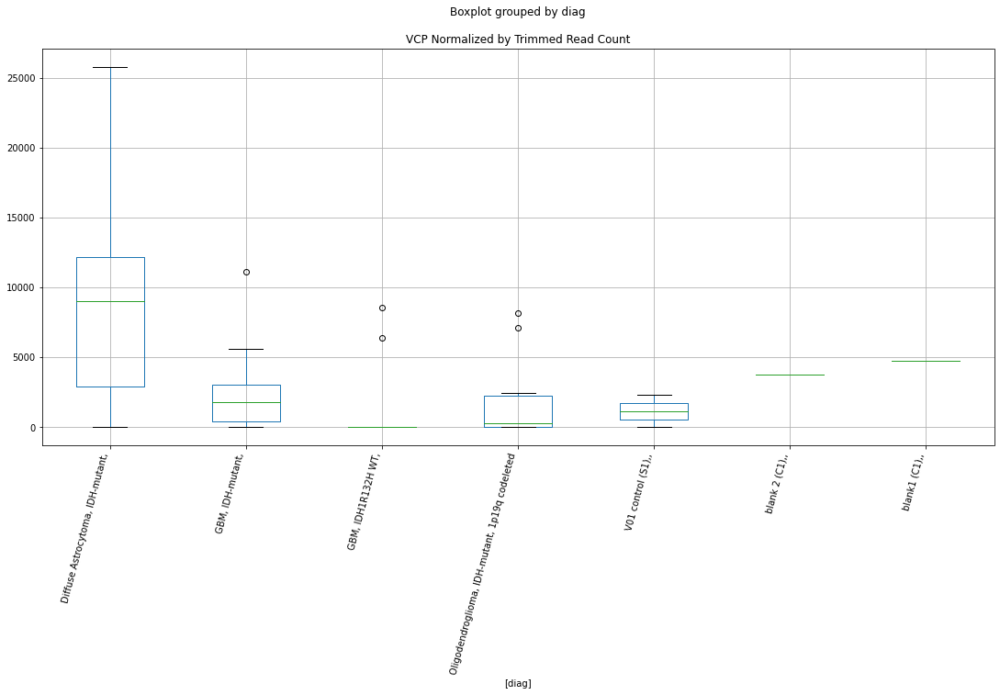

 p : 0.01473711542860094  ( t : 2.697261421308856 ) :  Lexogen  :  bbduk2  :  WDR19
Control and blanks
79     150212.87
343     44798.32
Name: WDR19, dtype: float64
211    24597.57
Name: WDR19, dtype: float64
475    10778.21
Name: WDR19, dtype: float64


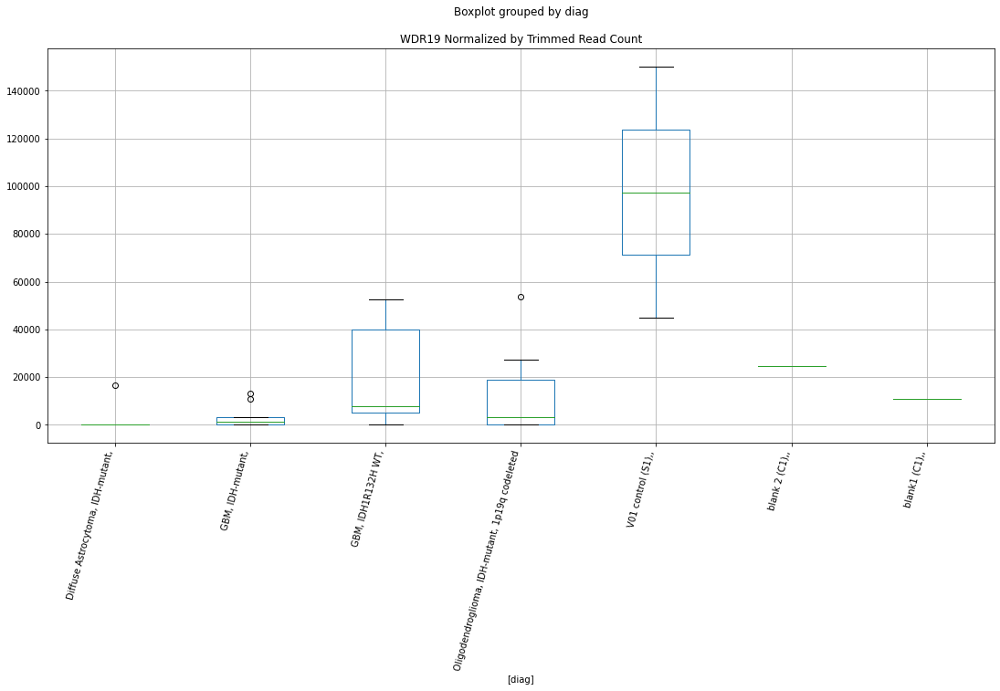

 p : 0.01528226423279571  ( t : 2.680139081334792 ) :  D-plex  :  cutadapt2  :  TMEM51-AS1
Control and blanks
76     757.61
340      0.00
Name: TMEM51-AS1, dtype: float64
208    529.08
Name: TMEM51-AS1, dtype: float64
472    1155.91
Name: TMEM51-AS1, dtype: float64


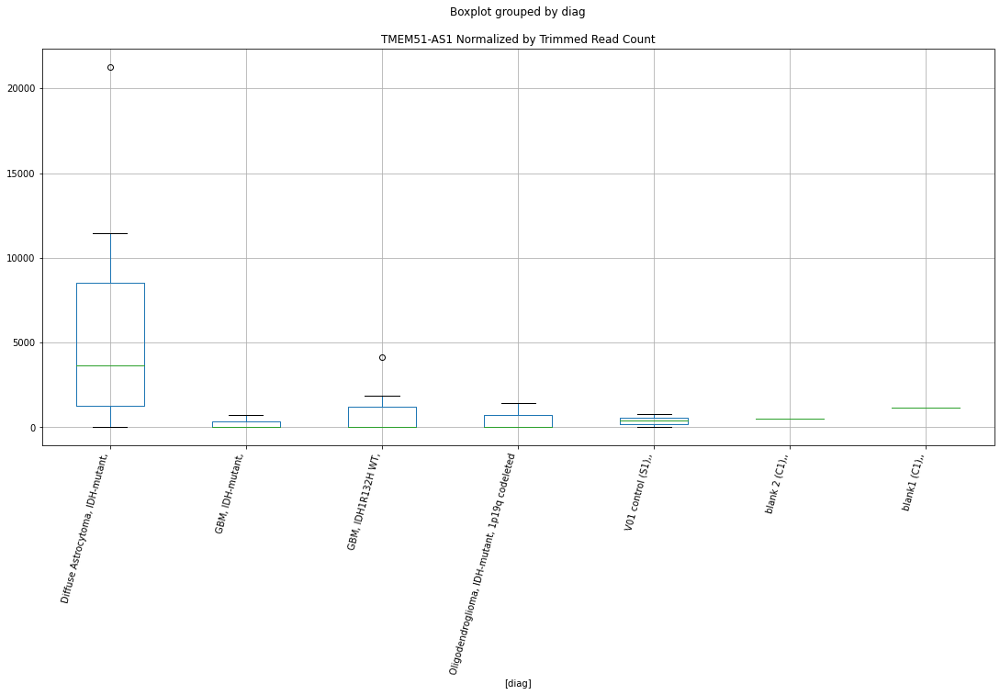

 p : 0.015289217937910023  ( t : 2.679924463057045 ) :  Lexogen  :  bbduk2  :  WWC2
Control and blanks
79        0.00
343    1273.89
Name: WWC2, dtype: float64
211    0.0
Name: WWC2, dtype: float64
475    958.06
Name: WWC2, dtype: float64


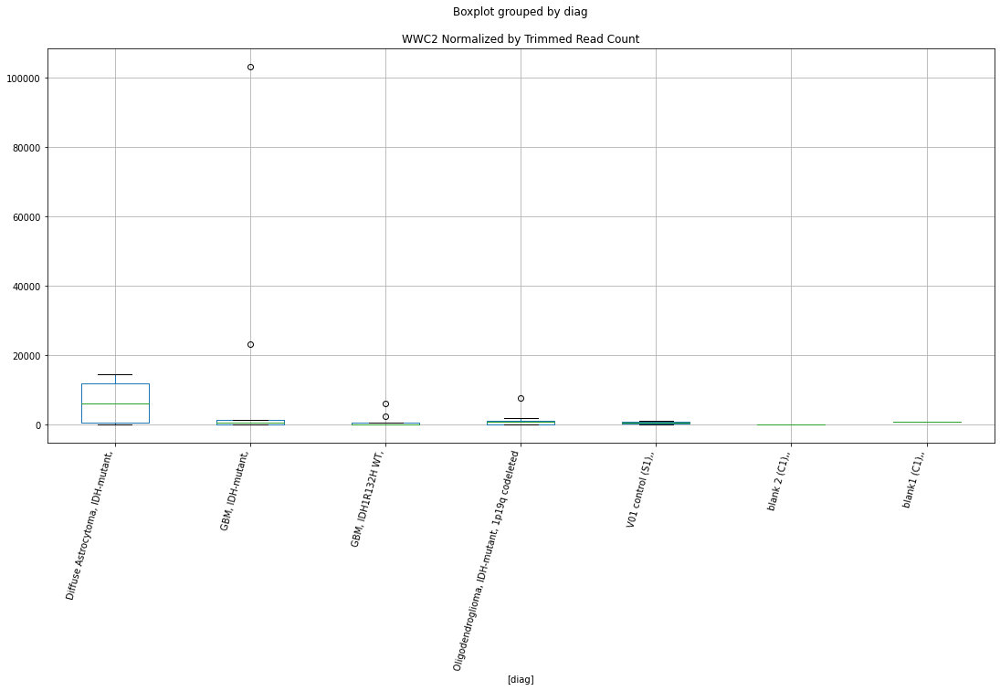

 p : 0.01534437150555697  ( t : 2.678225500943605 ) :  D-plex  :  cutadapt2  :  ZSWIM9
Control and blanks
76     0.0
340    0.0
Name: ZSWIM9, dtype: float64
208    176.36
Name: ZSWIM9, dtype: float64
472    2889.78
Name: ZSWIM9, dtype: float64


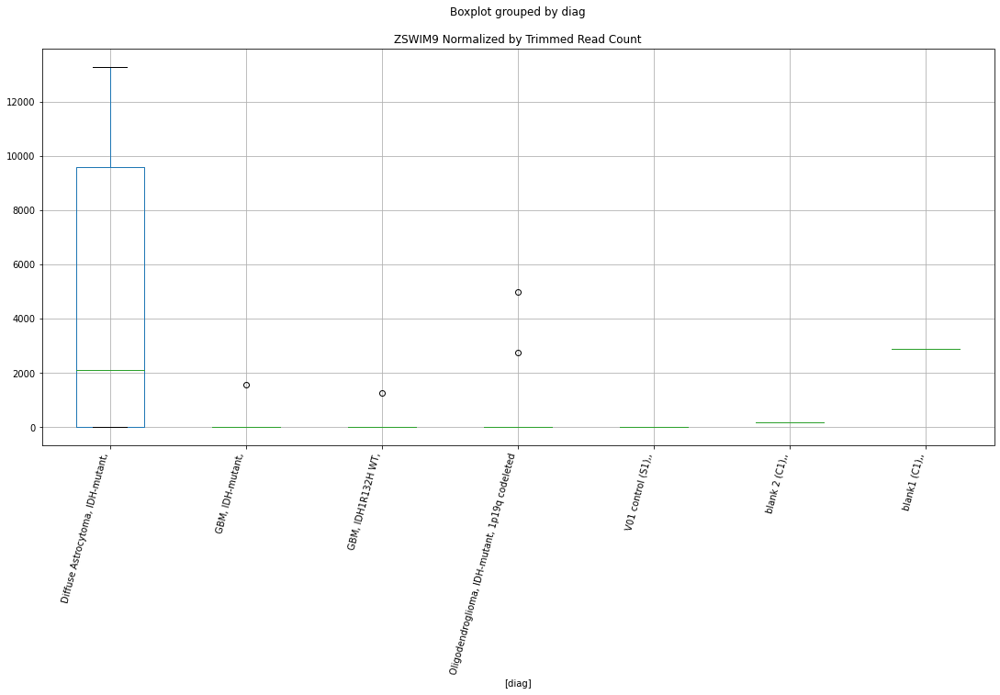

 p : 0.01554556335372646  ( t : 2.6720769329692806 ) :  D-plex  :  bbduk2  :  TMEM51-AS1
Control and blanks
73     773.01
337      0.00
Name: TMEM51-AS1, dtype: float64
205    895.45
Name: TMEM51-AS1, dtype: float64
469    1183.05
Name: TMEM51-AS1, dtype: float64


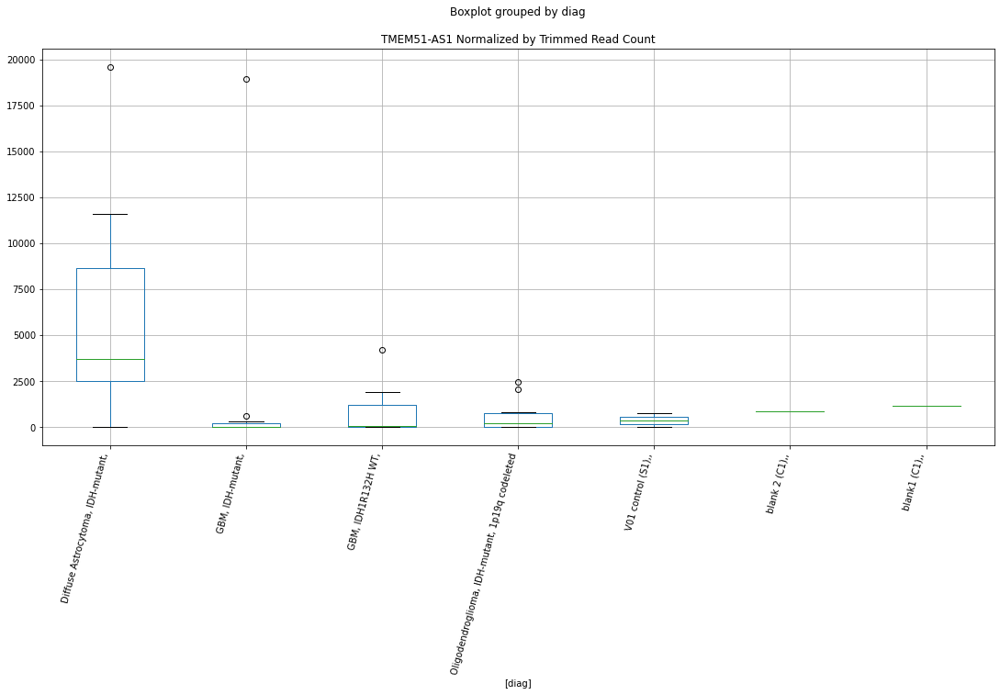

 p : 0.015801966917841668  ( t : 2.6643500934196256 ) :  Lexogen  :  bbduk2  :  TIGD5
Control and blanks
79     0.0
343    0.0
Name: TIGD5, dtype: float64
211    0.0
Name: TIGD5, dtype: float64
475    17245.13
Name: TIGD5, dtype: float64


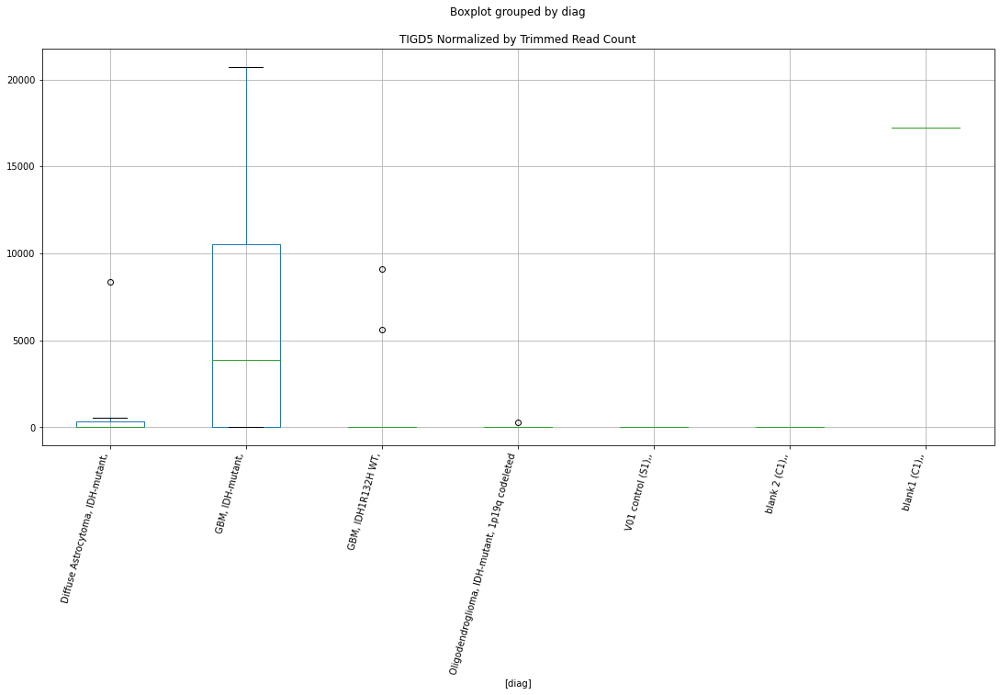

 p : 0.015880532984272343  ( t : 2.6620063777269736 ) :  Lexogen  :  cutadapt2  :  TIGD5
Control and blanks
82     0.0
346    0.0
Name: TIGD5, dtype: float64
214    0.0
Name: TIGD5, dtype: float64
478    17097.15
Name: TIGD5, dtype: float64


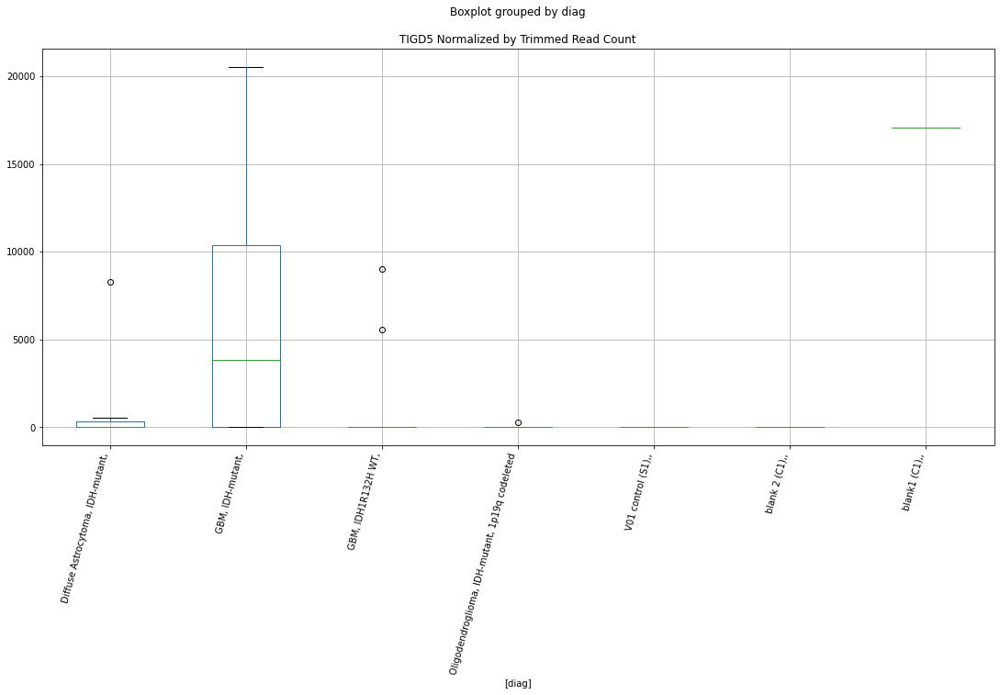

 p : 0.01603375552128234  ( t : 2.6574671868414894 ) :  D-plex  :  cutadapt2  :  ZSWIM9
Control and blanks
76     0.0
340    0.0
Name: ZSWIM9, dtype: float64
208    176.36
Name: ZSWIM9, dtype: float64
472    2889.78
Name: ZSWIM9, dtype: float64


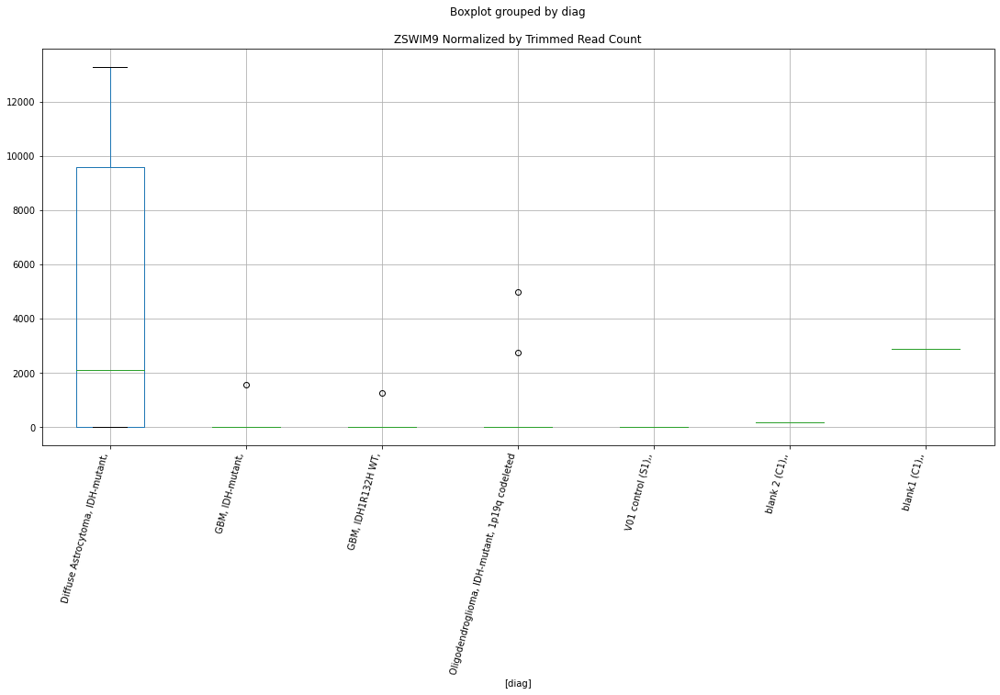

 p : 0.016100643326347874  ( t : 2.65549859106944 ) :  Lexogen  :  bbduk2  :  ST20
Control and blanks
79       0.00
343    849.26
Name: ST20, dtype: float64
211    4372.9
Name: ST20, dtype: float64
475    0.0
Name: ST20, dtype: float64


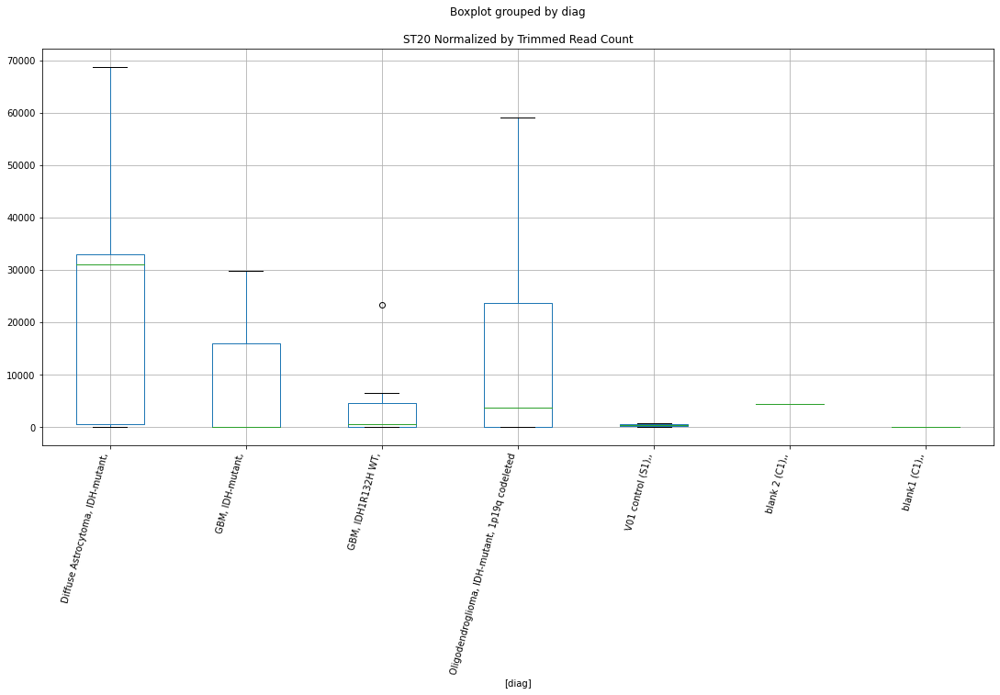

 p : 0.01612201611454547  ( t : 2.654871203896358 ) :  Lexogen  :  cutadapt2  :  ST20
Control and blanks
82       0.00
346    841.74
Name: ST20, dtype: float64
214    4339.62
Name: ST20, dtype: float64
478    0.0
Name: ST20, dtype: float64


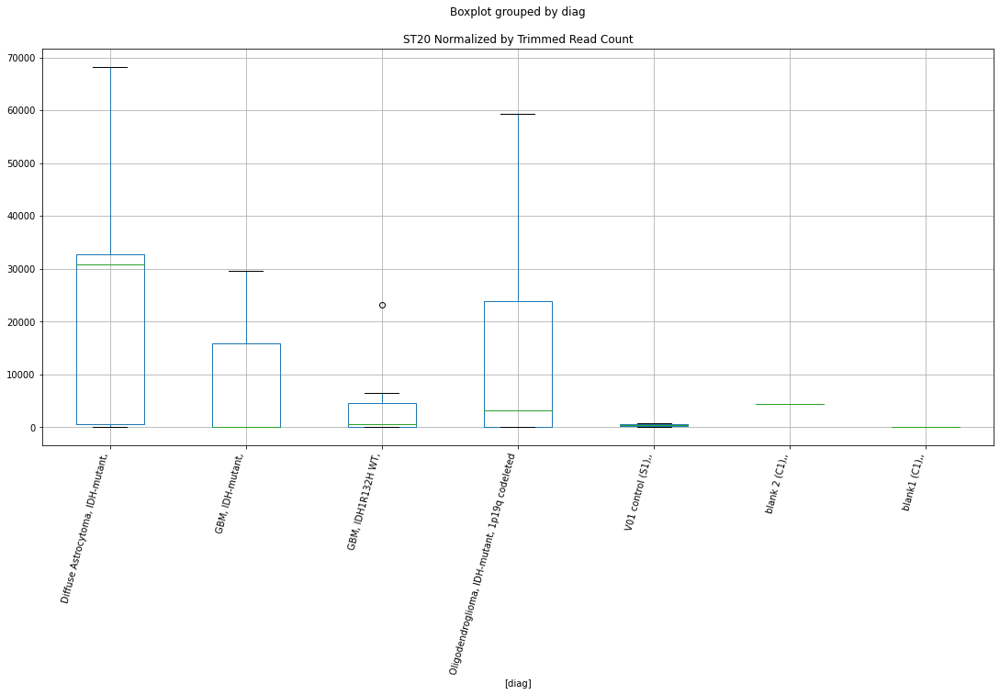

 p : 0.016124402151420747  ( t : 2.654801212176548 ) :  D-plex  :  bbduk2  :  SPPL3
Control and blanks
73     0.0
337    0.0
Name: SPPL3, dtype: float64
205    1432.73
Name: SPPL3, dtype: float64
469    1183.05
Name: SPPL3, dtype: float64


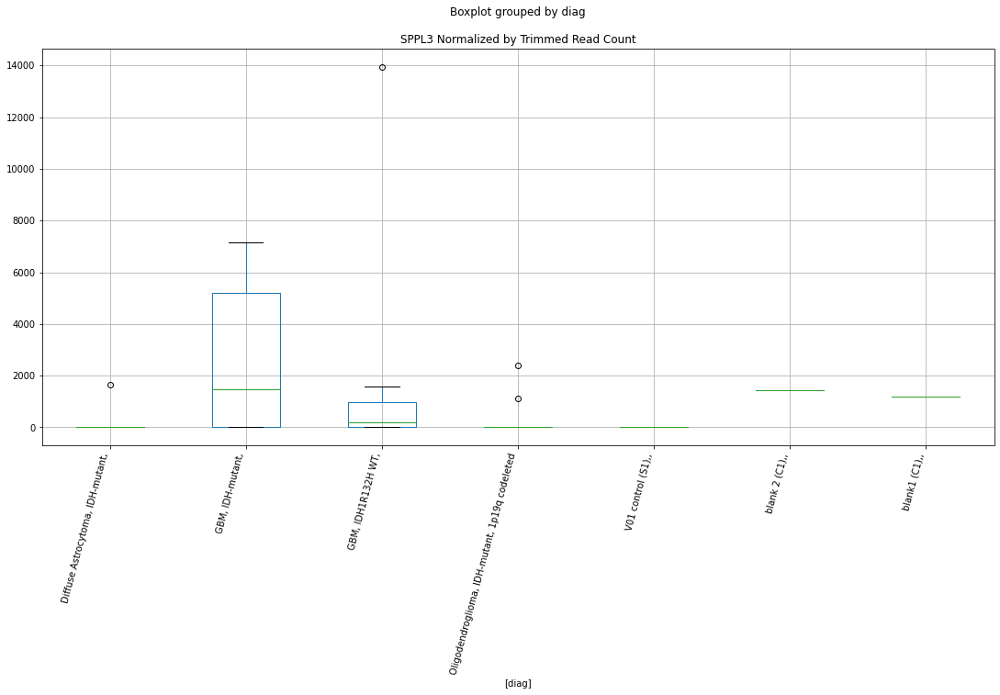

 p : 0.01615444454493797  ( t : 2.653920795208365 ) :  D-plex  :  bbduk2  :  ZSWIM9
Control and blanks
73     0.0
337    0.0
Name: ZSWIM9, dtype: float64
205    179.09
Name: ZSWIM9, dtype: float64
469    2957.64
Name: ZSWIM9, dtype: float64


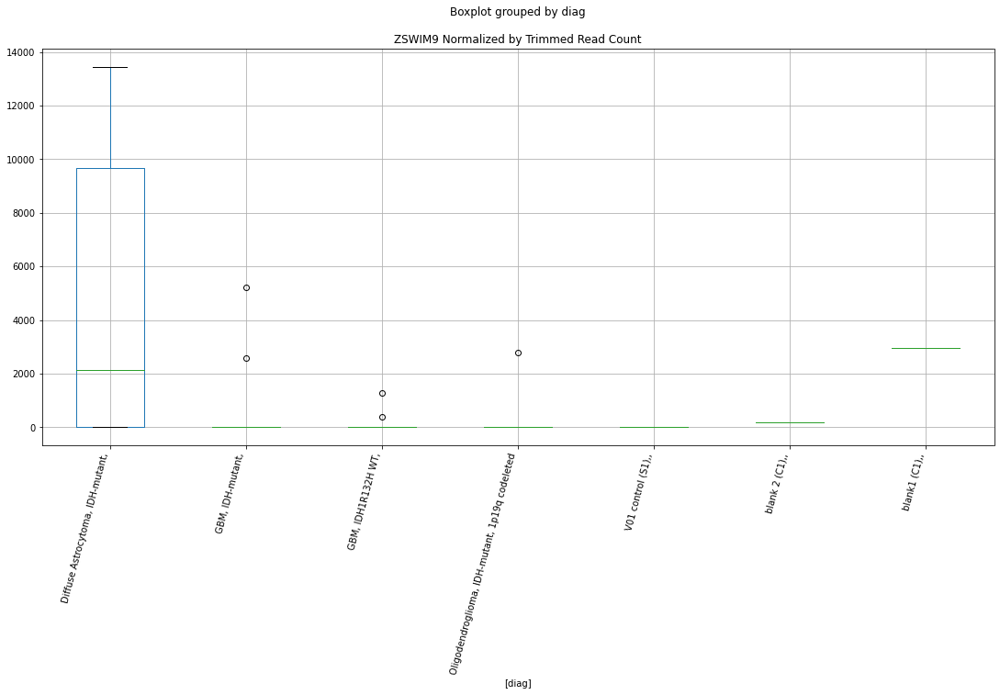

 p : 0.016373720009432415  ( t : 2.647541571151704 ) :  Lexogen  :  cutadapt2  :  TMPRSS9
Control and blanks
82       0.00
346    210.43
Name: TMPRSS9, dtype: float64
214    0.0
Name: TMPRSS9, dtype: float64
478    0.0
Name: TMPRSS9, dtype: float64


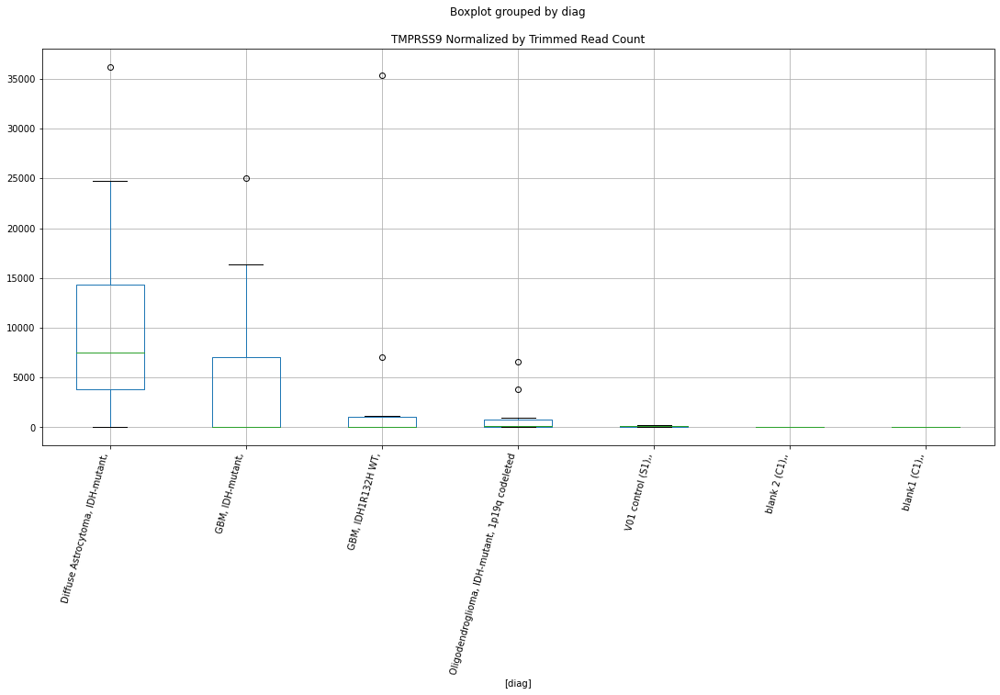

 p : 0.01652175824493642  ( t : 2.643280629430836 ) :  Lexogen  :  bbduk2  :  WDR59
Control and blanks
79     0.0
343    0.0
Name: WDR59, dtype: float64
211    0.0
Name: WDR59, dtype: float64
475    0.0
Name: WDR59, dtype: float64


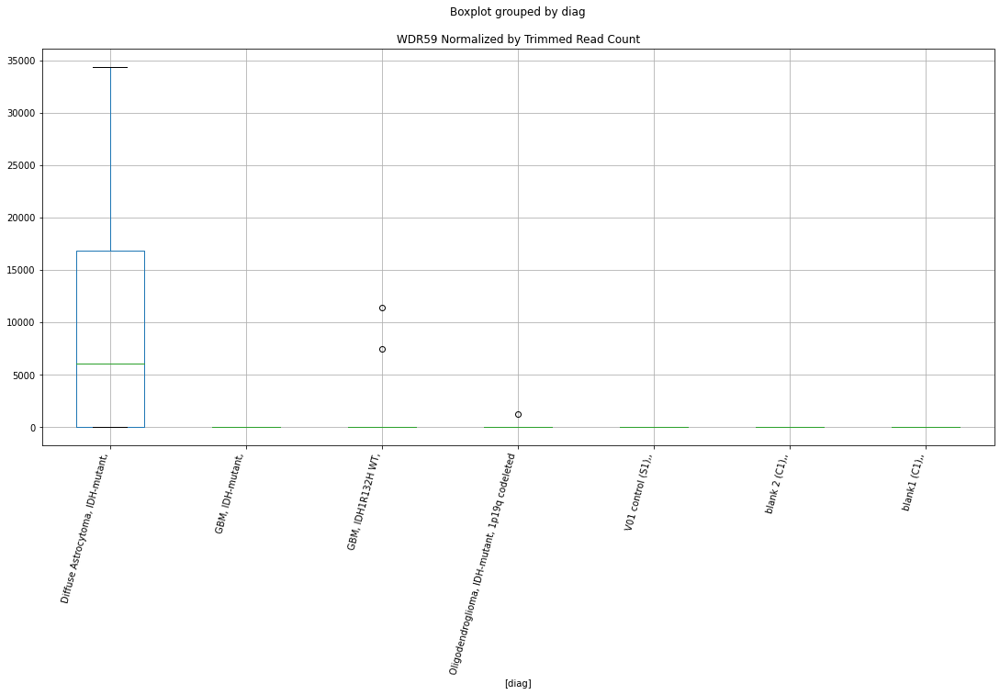

 p : 0.016539929086243615  ( t : 2.642760129439767 ) :  D-plex  :  bbduk2  :  TNKS2
Control and blanks
73     0.0
337    0.0
Name: TNKS2, dtype: float64
205    2686.36
Name: TNKS2, dtype: float64
469    0.0
Name: TNKS2, dtype: float64


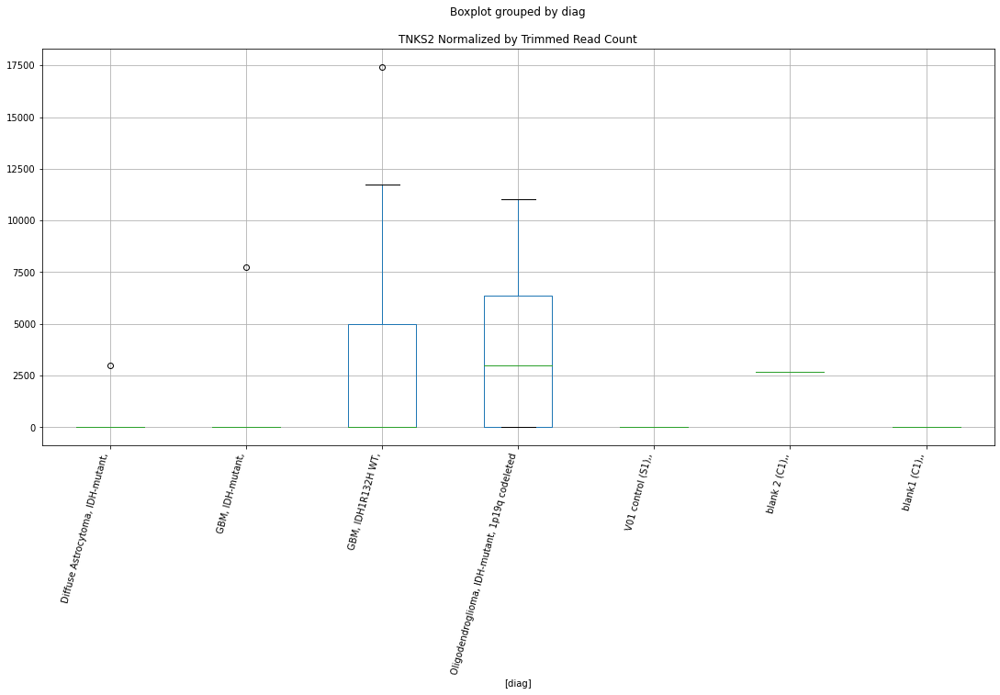

 p : 0.01655156732930149  ( t : 2.6424270402012304 ) :  Lexogen  :  cutadapt2  :  WDR59
Control and blanks
82     0.0
346    0.0
Name: WDR59, dtype: float64
214    0.0
Name: WDR59, dtype: float64
478    0.0
Name: WDR59, dtype: float64


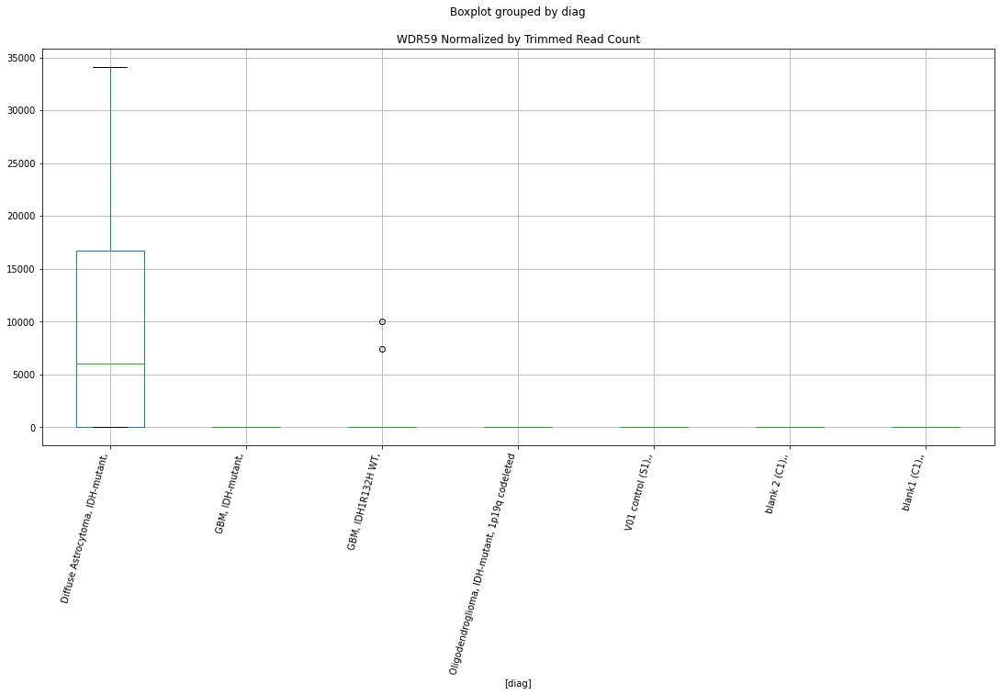

 p : 0.01659291308130642  ( t : 2.641245514844854 ) :  D-plex  :  cutadapt2  :  USP10
Control and blanks
76     0.0
340    0.0
Name: USP10, dtype: float64
208    4761.73
Name: USP10, dtype: float64
472    28897.79
Name: USP10, dtype: float64


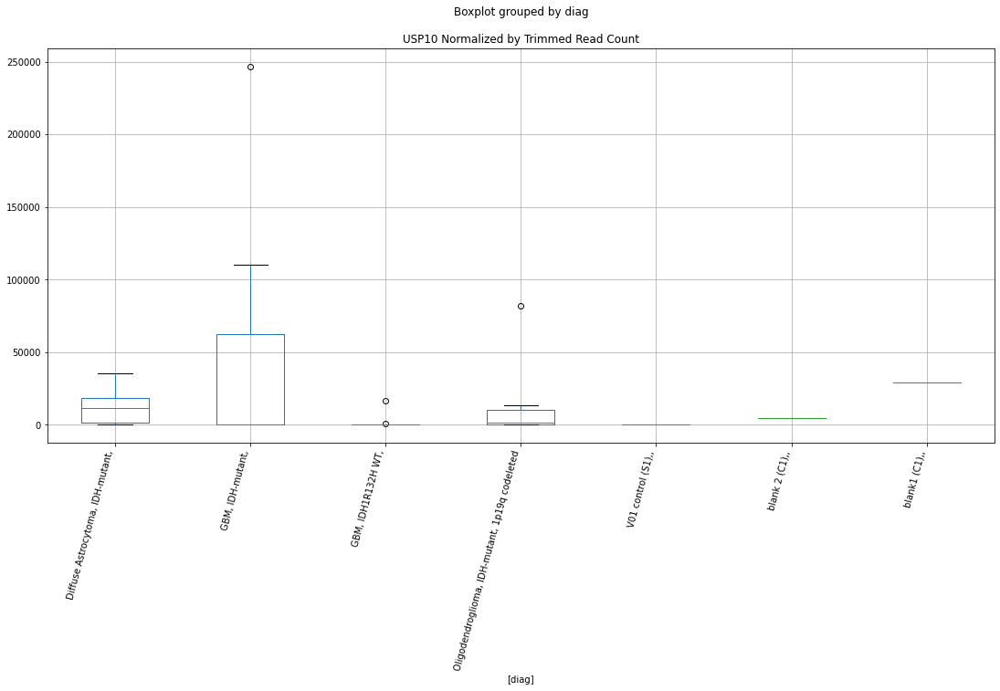

 p : 0.016647040394379635  ( t : 2.639702962033415 ) :  D-plex  :  bbduk2  :  TTC37
Control and blanks
73     0.0
337    0.0
Name: TTC37, dtype: float64
205    1432.73
Name: TTC37, dtype: float64
469    591.53
Name: TTC37, dtype: float64


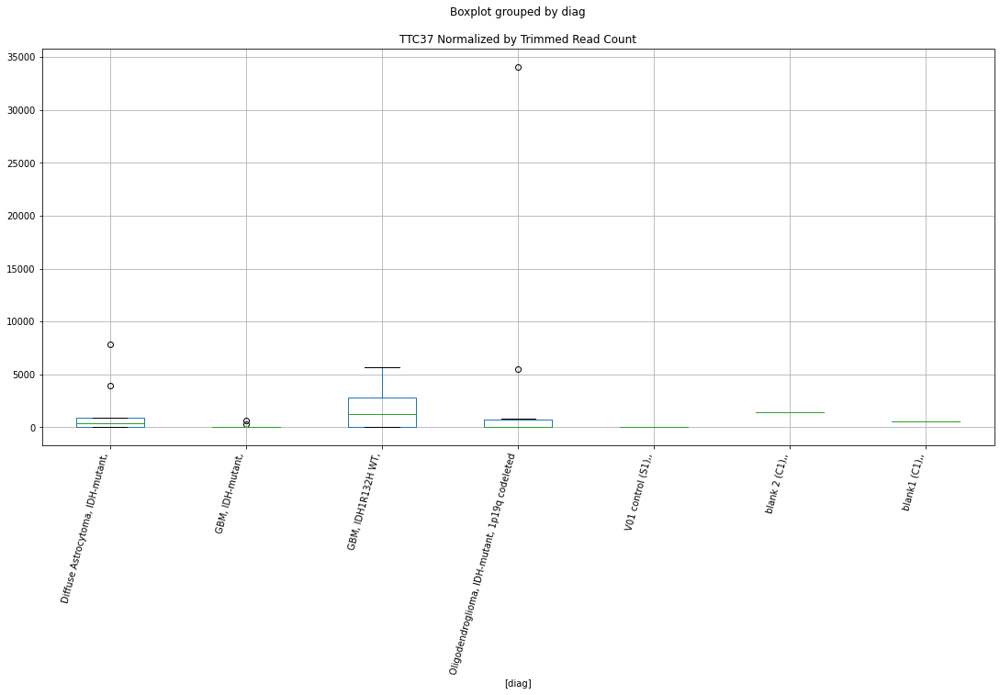

 p : 0.016827716070512786  ( t : 2.6345882843679154 ) :  D-plex  :  cutadapt2  :  TFAP2A-AS2
Control and blanks
76     36365.48
340      880.73
Name: TFAP2A-AS2, dtype: float64
208    39328.33
Name: TFAP2A-AS2, dtype: float64
472    13292.98
Name: TFAP2A-AS2, dtype: float64


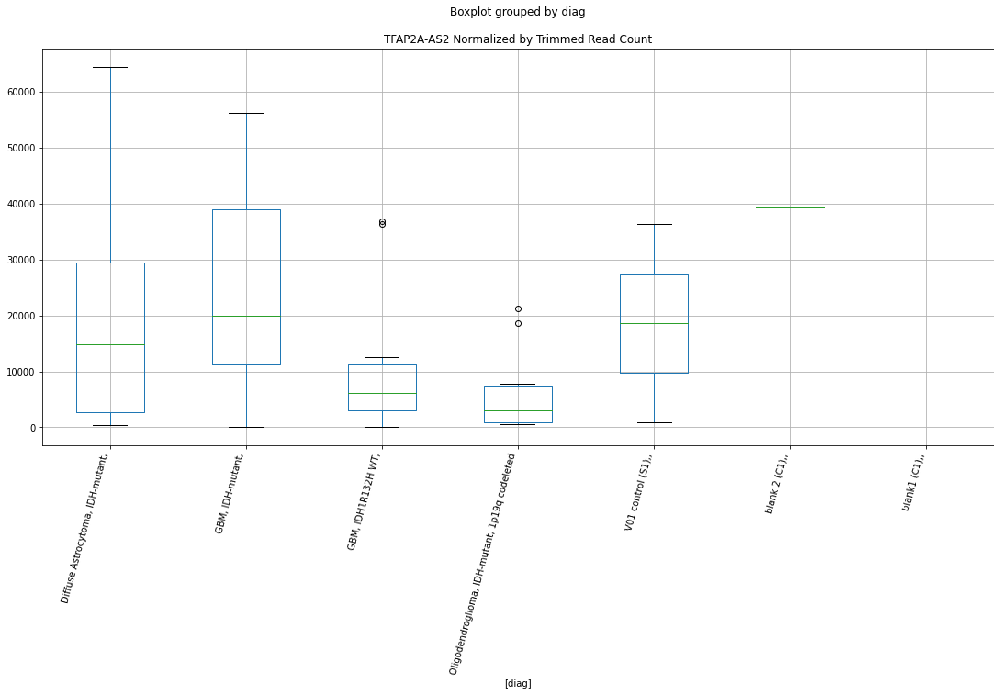

 p : 0.016880484606343497  ( t : 2.6331043353436896 ) :  Lexogen  :  cutadapt2  :  SPRED2
Control and blanks
82     0.0
346    0.0
Name: SPRED2, dtype: float64
214    1084.91
Name: SPRED2, dtype: float64
478    0.0
Name: SPRED2, dtype: float64


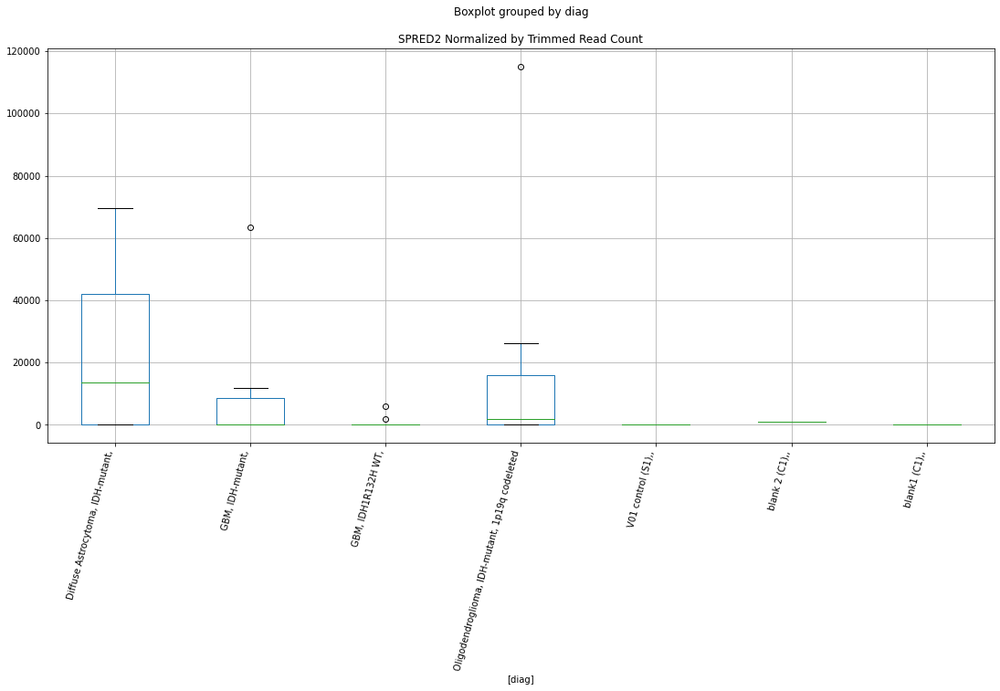

 p : 0.017026713657565574  ( t : 2.6290150390186438 ) :  D-plex  :  cutadapt2  :  ZHX2
Control and blanks
76     0.0
340    0.0
Name: ZHX2, dtype: float64
208    4232.65
Name: ZHX2, dtype: float64
472    0.0
Name: ZHX2, dtype: float64


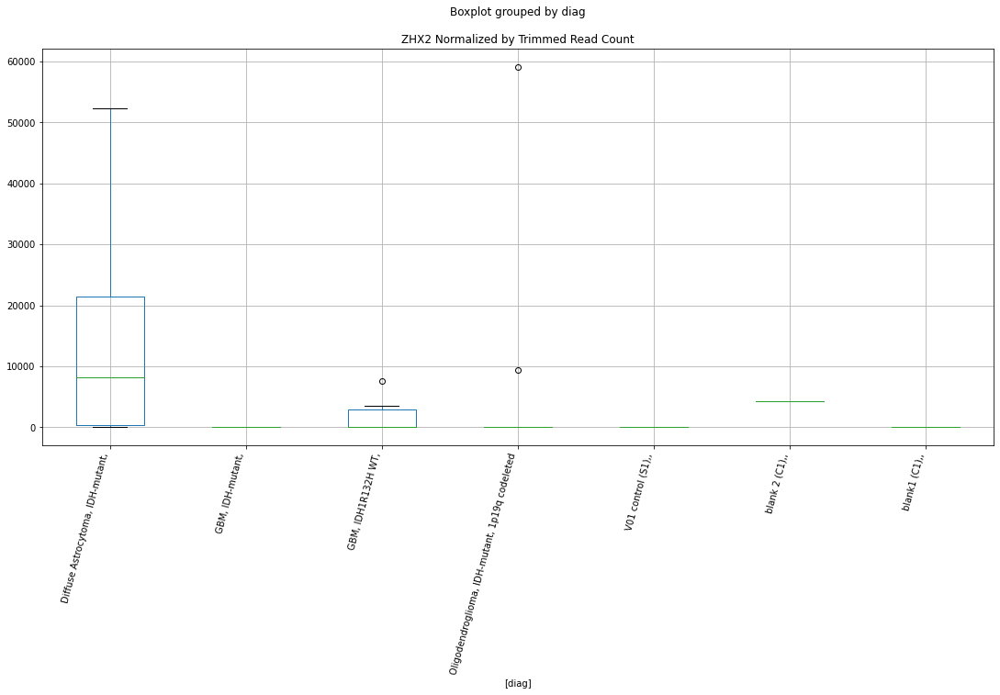

 p : 0.01705799486879929  ( t : 2.6281445972204343 ) :  D-plex  :  bbduk2  :  ZHX2
Control and blanks
73     0.0
337    0.0
Name: ZHX2, dtype: float64
205    4298.18
Name: ZHX2, dtype: float64
469    0.0
Name: ZHX2, dtype: float64


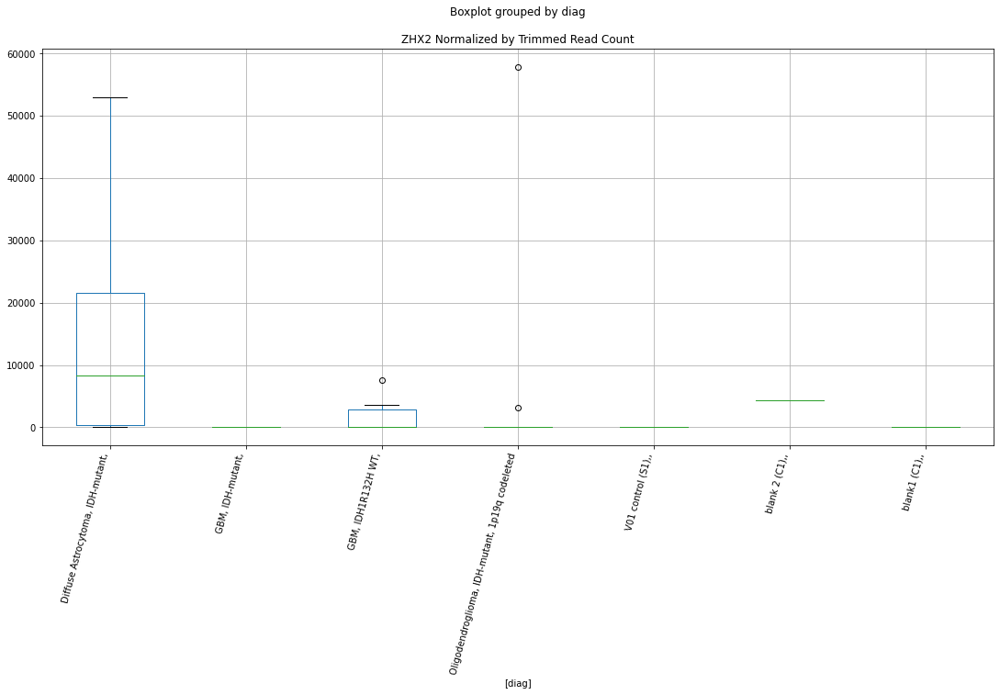

 p : 0.01720338969089244  ( t : 2.6241186067873823 ) :  Lexogen  :  bbduk2  :  WHAMM
Control and blanks
79         0.00
343    40764.35
Name: WHAMM, dtype: float64
211    0.0
Name: WHAMM, dtype: float64
475    0.0
Name: WHAMM, dtype: float64


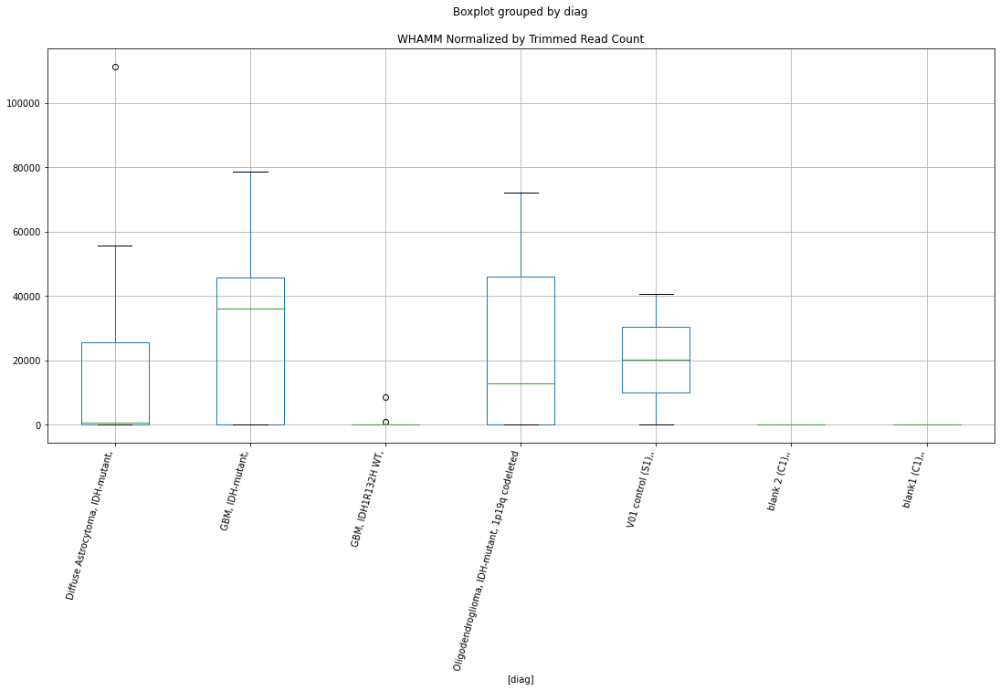

 p : 0.01746395974477219  ( t : 2.616983653923872 ) :  Lexogen  :  cutadapt2  :  WHAMM
Control and blanks
82         0.00
346    40403.43
Name: WHAMM, dtype: float64
214    0.0
Name: WHAMM, dtype: float64
478    0.0
Name: WHAMM, dtype: float64


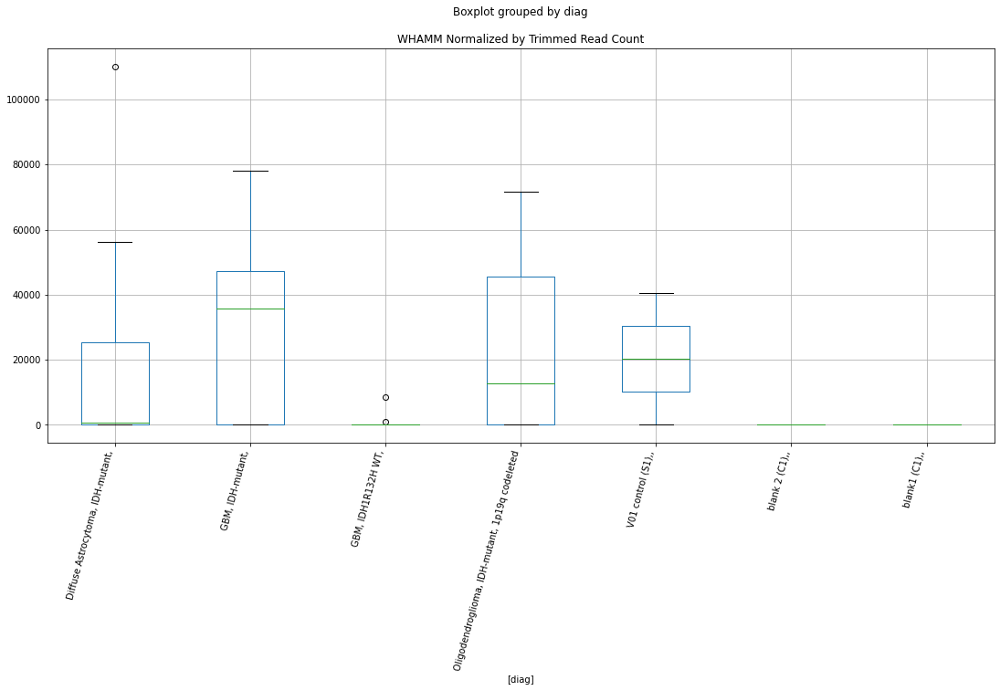

 p : 0.017580841280614153  ( t : 2.6138159994064245 ) :  D-plex  :  bbduk2  :  TLE6
Control and blanks
73     0.0
337    0.0
Name: TLE6, dtype: float64
205    7521.82
Name: TLE6, dtype: float64
469    5323.75
Name: TLE6, dtype: float64


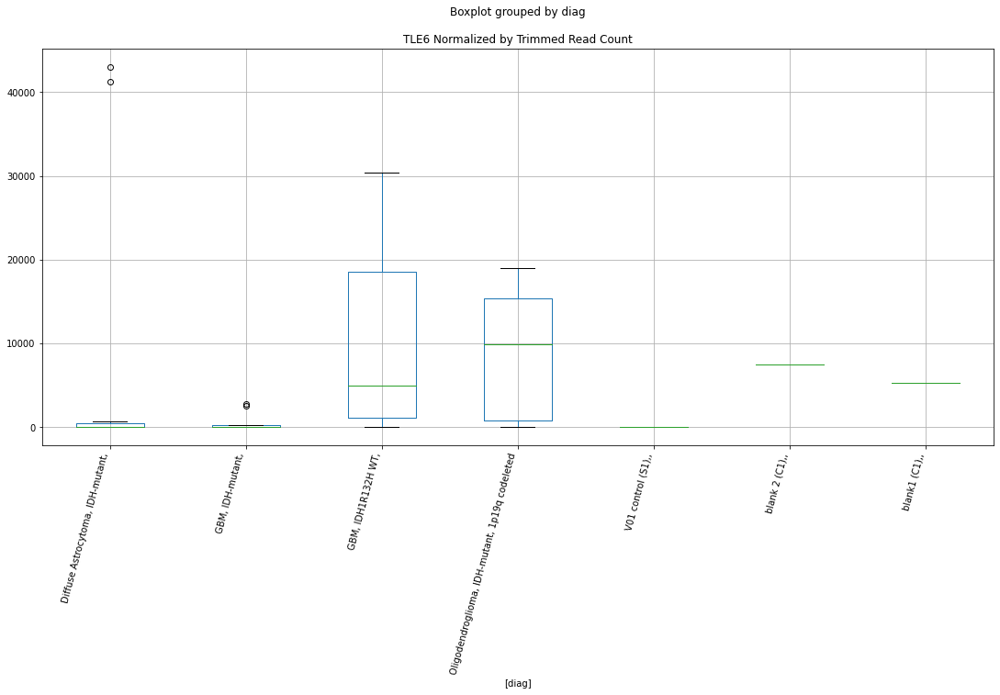

 p : 0.01774820117356992  ( t : 2.609314963882756 ) :  Lexogen  :  bbduk2  :  WDR59
Control and blanks
79     0.0
343    0.0
Name: WDR59, dtype: float64
211    0.0
Name: WDR59, dtype: float64
475    0.0
Name: WDR59, dtype: float64


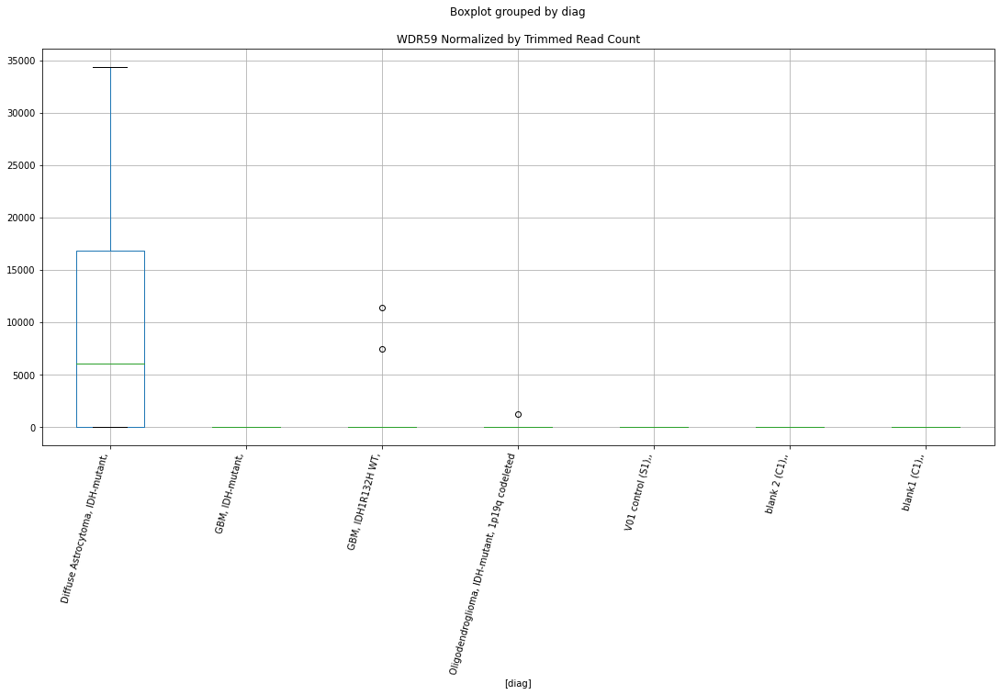

 p : 0.017773902320726755  ( t : 2.608627321080704 ) :  D-plex  :  cutadapt2  :  TTPAL
Control and blanks
76     218192.89
340      6165.12
Name: TTPAL, dtype: float64
208    101583.49
Name: TTPAL, dtype: float64
472    118480.95
Name: TTPAL, dtype: float64


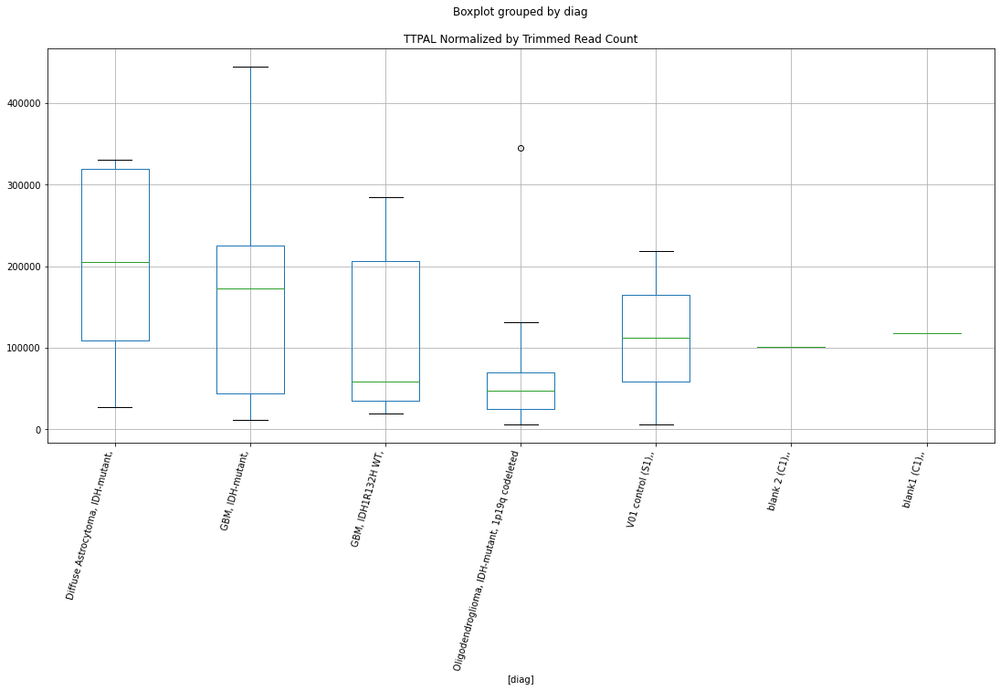

 p : 0.017846356417089343  ( t : 2.6066938579008663 ) :  Lexogen  :  cutadapt2  :  TPM1-AS
Control and blanks
82     0.0
346    0.0
Name: TPM1-AS, dtype: float64
214    0.0
Name: TPM1-AS, dtype: float64
478    0.0
Name: TPM1-AS, dtype: float64


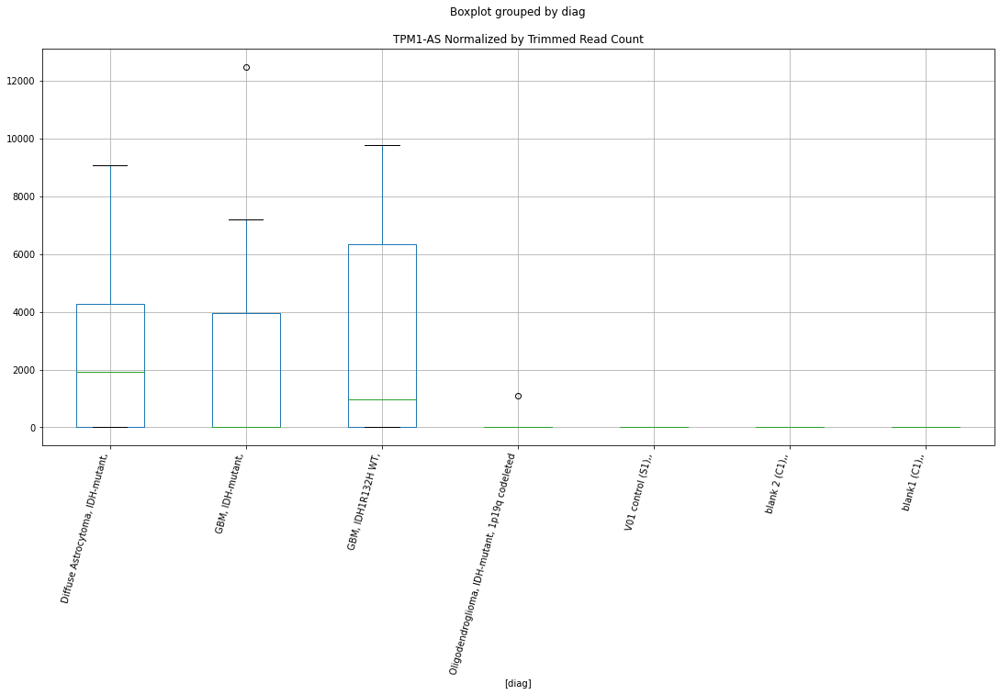

 p : 0.01791331188275775  ( t : 2.6049137420389896 ) :  D-plex  :  bbduk2  :  TGS1
Control and blanks
73     0.0
337    0.0
Name: TGS1, dtype: float64
205    4298.18
Name: TGS1, dtype: float64
469    0.0
Name: TGS1, dtype: float64


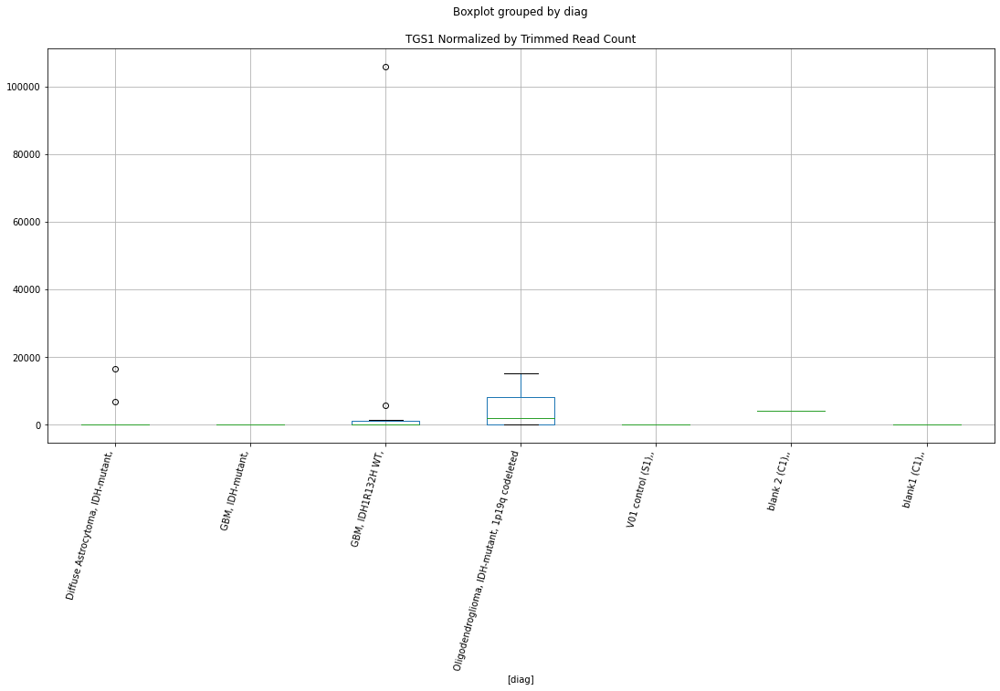

 p : 0.01806101896601011  ( t : 2.601008949719074 ) :  D-plex  :  cutadapt2  :  TMEFF2
Control and blanks
76     757.61
340      0.00
Name: TMEFF2, dtype: float64
208    1410.88
Name: TMEFF2, dtype: float64
472    1155.91
Name: TMEFF2, dtype: float64


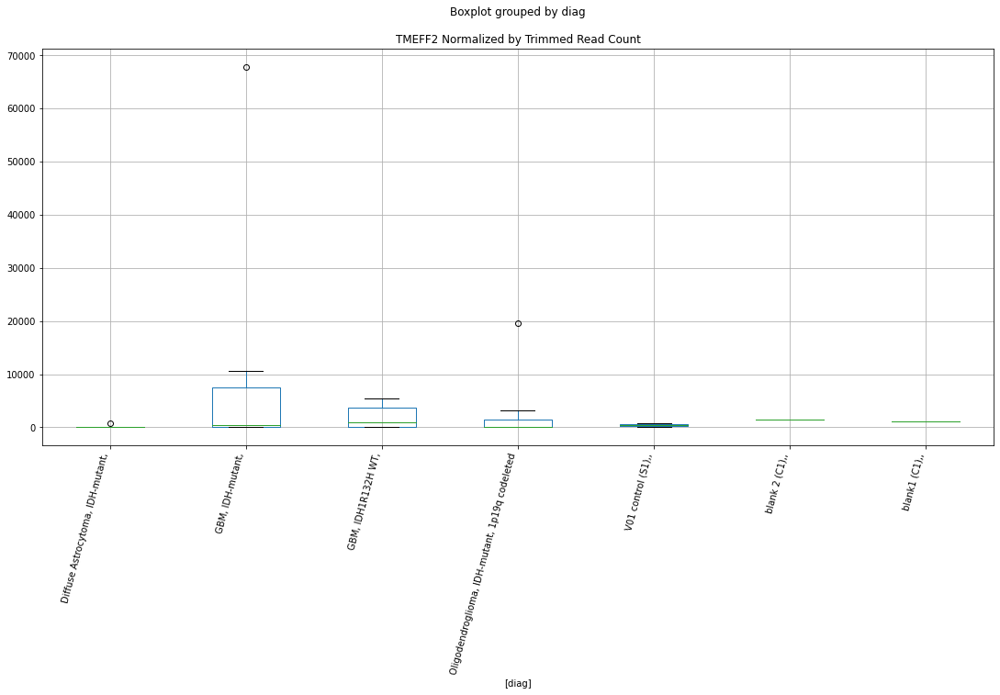

 p : 0.018071229261017764  ( t : 2.6007401510418147 ) :  D-plex  :  cutadapt2  :  TRANK1
Control and blanks
76     61366.75
340        0.00
Name: TRANK1, dtype: float64
208    27159.47
Name: TRANK1, dtype: float64
472    32365.53
Name: TRANK1, dtype: float64


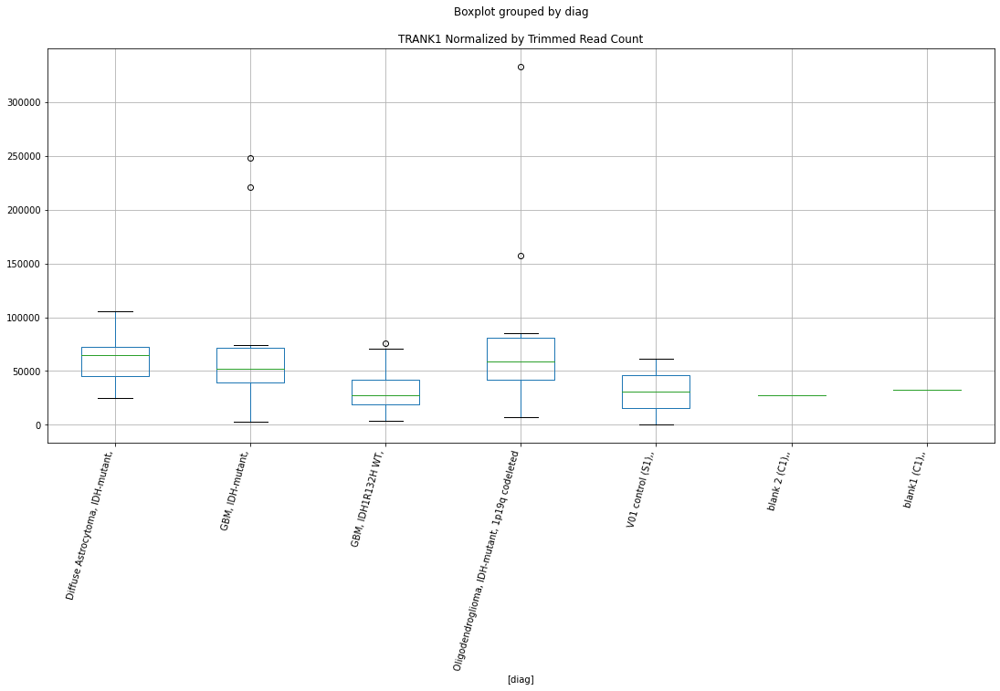

 p : 0.01807845326676512  ( t : 2.600550057184145 ) :  Lexogen  :  cutadapt2  :  TMTC1
Control and blanks
82     0.0
346    0.0
Name: TMTC1, dtype: float64
214    0.0
Name: TMTC1, dtype: float64
478    0.0
Name: TMTC1, dtype: float64


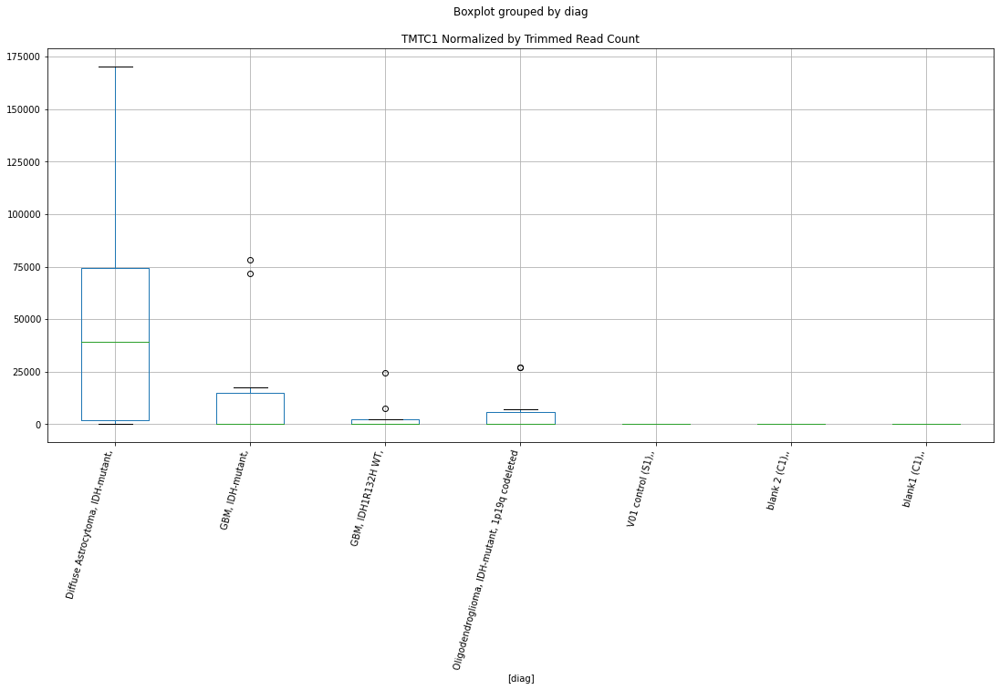

 p : 0.0181748749661662  ( t : 2.598019677174301 ) :  D-plex  :  bbduk2  :  TMEFF2
Control and blanks
73     773.01
337      0.00
Name: TMEFF2, dtype: float64
205    1432.73
Name: TMEFF2, dtype: float64
469    1183.05
Name: TMEFF2, dtype: float64


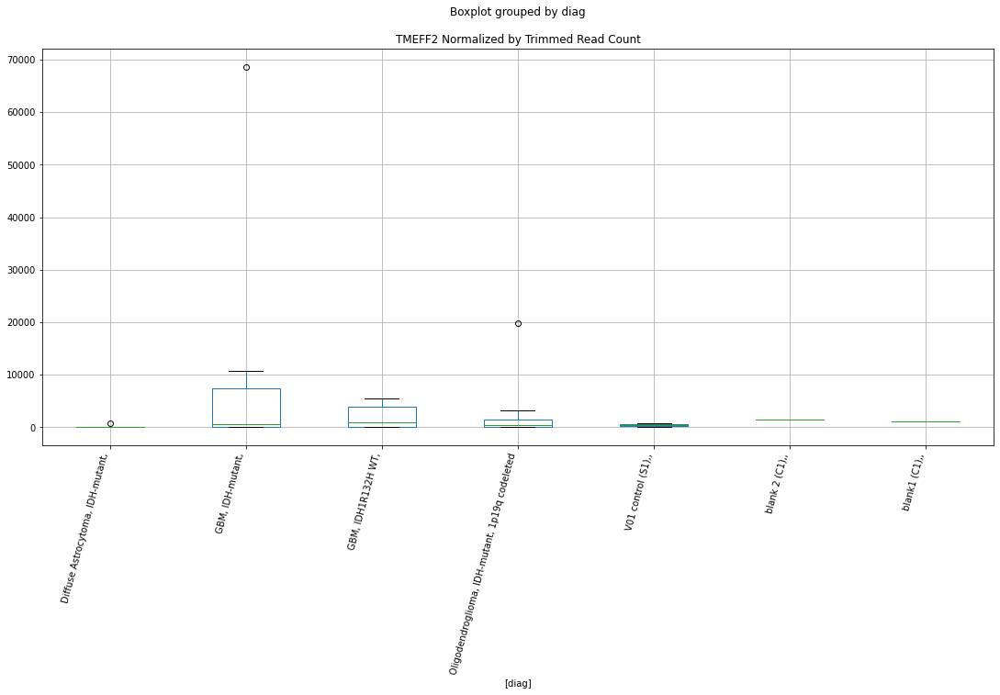

 p : 0.018213142818987258  ( t : 2.597018949248792 ) :  Lexogen  :  bbduk2  :  TMTC1
Control and blanks
79     0.0
343    0.0
Name: TMTC1, dtype: float64
211    0.0
Name: TMTC1, dtype: float64
475    0.0
Name: TMTC1, dtype: float64


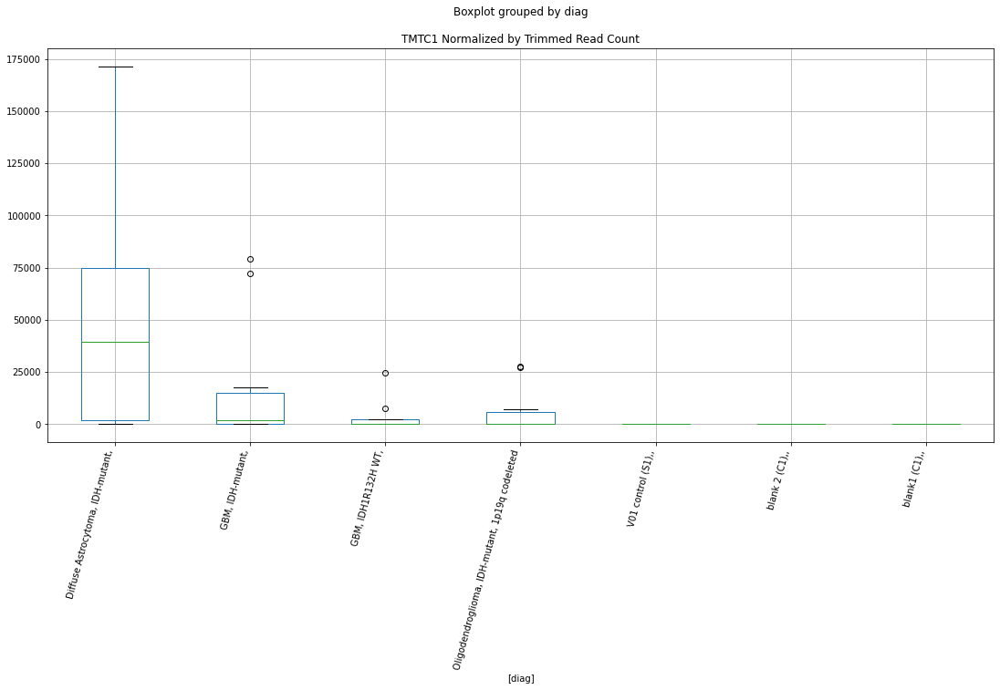

 p : 0.01822354402784985  ( t : 2.596747296050224 ) :  D-plex  :  cutadapt2  :  SYAP1
Control and blanks
76     0.0
340    0.0
Name: SYAP1, dtype: float64
208    2116.32
Name: SYAP1, dtype: float64
472    2311.82
Name: SYAP1, dtype: float64


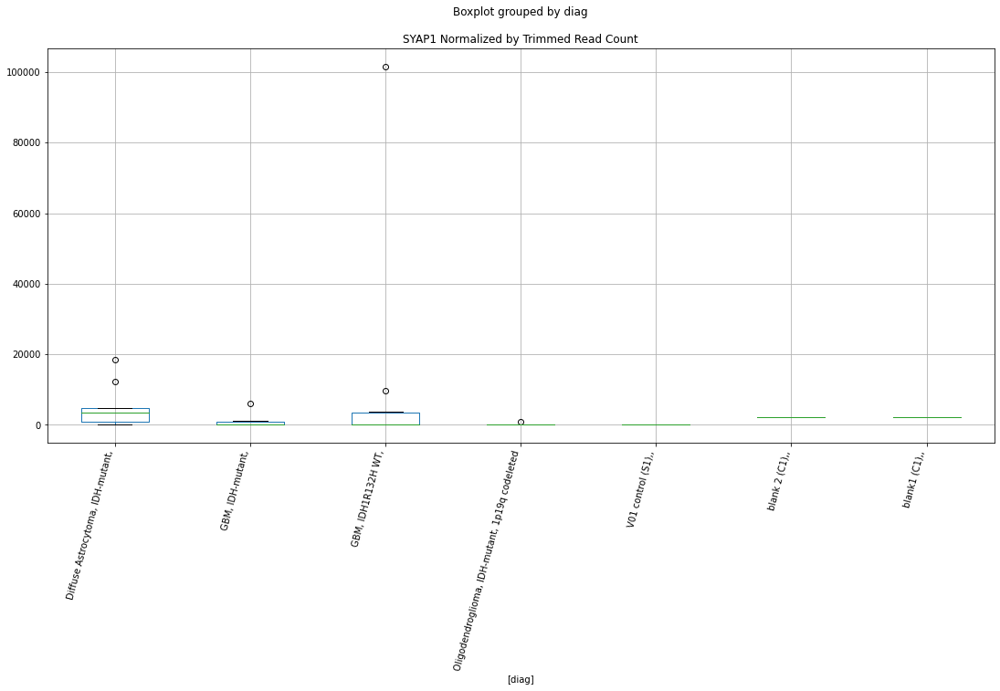

 p : 0.018348503831135614  ( t : 2.593495112543643 ) :  Lexogen  :  bbduk2  :  TPM1-AS
Control and blanks
79     0.0
343    0.0
Name: TPM1-AS, dtype: float64
211    0.0
Name: TPM1-AS, dtype: float64
475    0.0
Name: TPM1-AS, dtype: float64


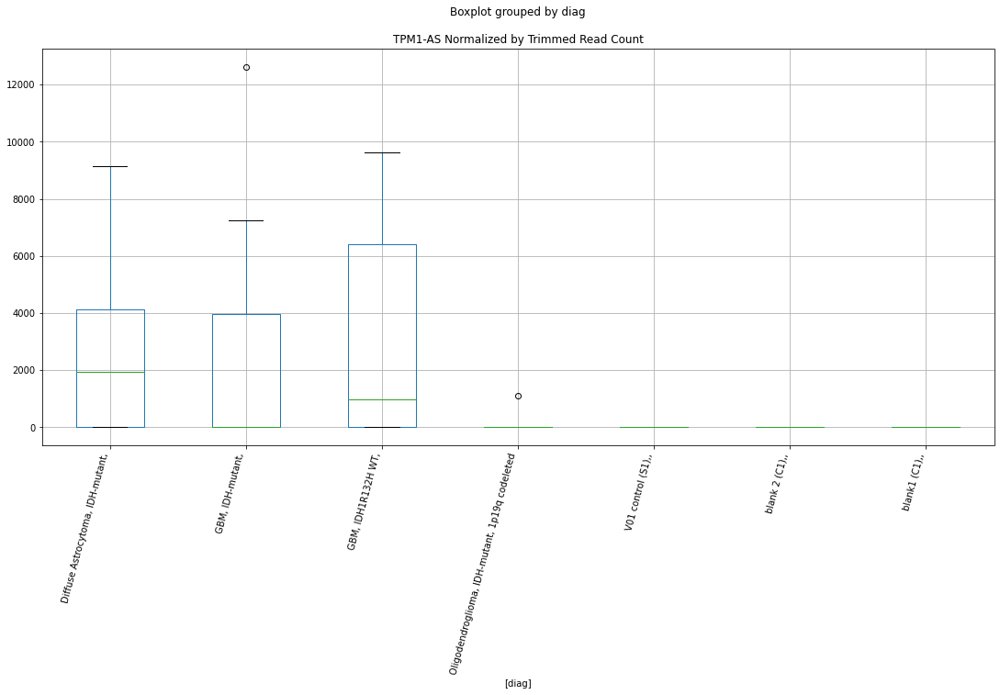

 p : 0.018428321674341903  ( t : 2.59142876482254 ) :  D-plex  :  bbduk2  :  TTPAL
Control and blanks
73     222626.42
337      6231.10
Name: TTPAL, dtype: float64
205    103514.57
Name: TTPAL, dtype: float64
469    122446.15
Name: TTPAL, dtype: float64


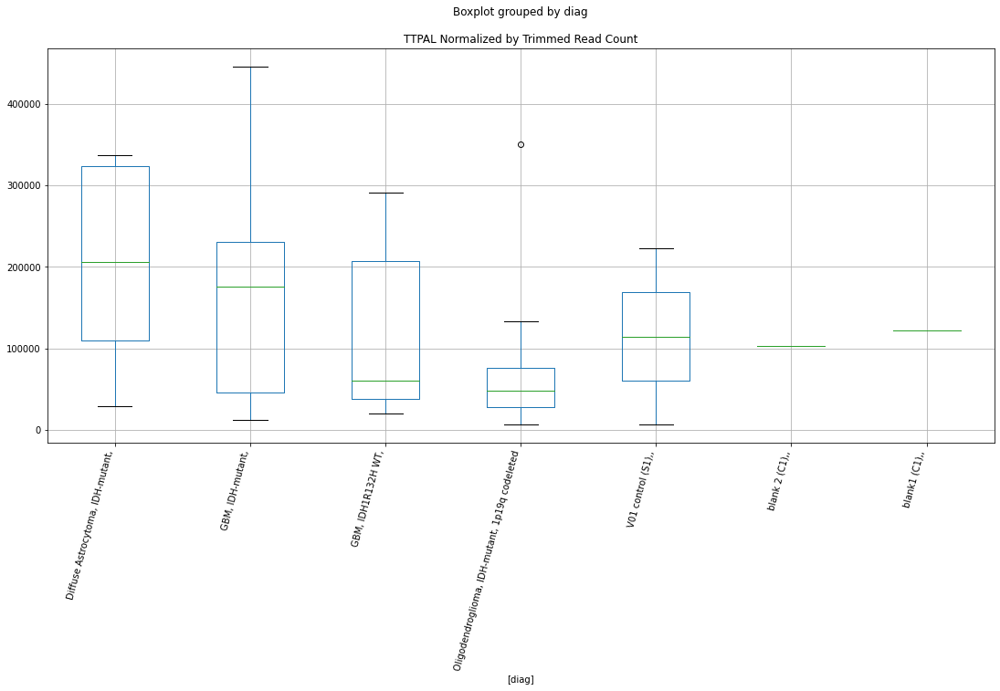

 p : 0.01862024061947672  ( t : 2.586494845073087 ) :  Lexogen  :  bbduk2  :  SPRED2
Control and blanks
79     0.0
343    0.0
Name: SPRED2, dtype: float64
211    1093.23
Name: SPRED2, dtype: float64
475    958.06
Name: SPRED2, dtype: float64


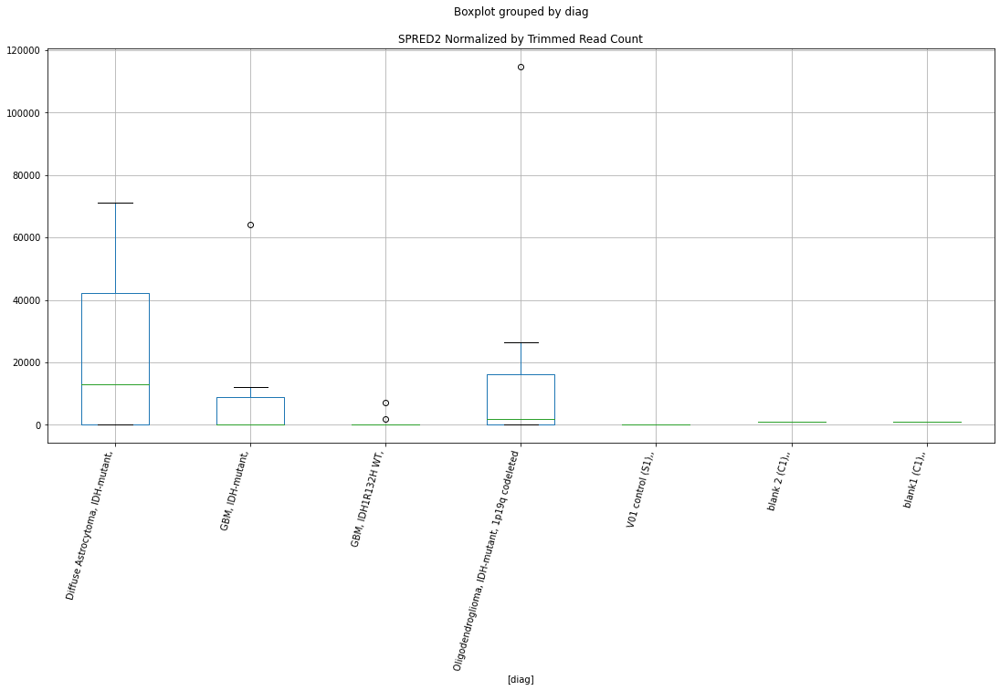

 p : 0.018642905989039244  ( t : 2.5859153427669916 ) :  D-plex  :  cutadapt2  :  USP48
Control and blanks
76     0.0
340    0.0
Name: USP48, dtype: float64
208    176.36
Name: USP48, dtype: float64
472    0.0
Name: USP48, dtype: float64


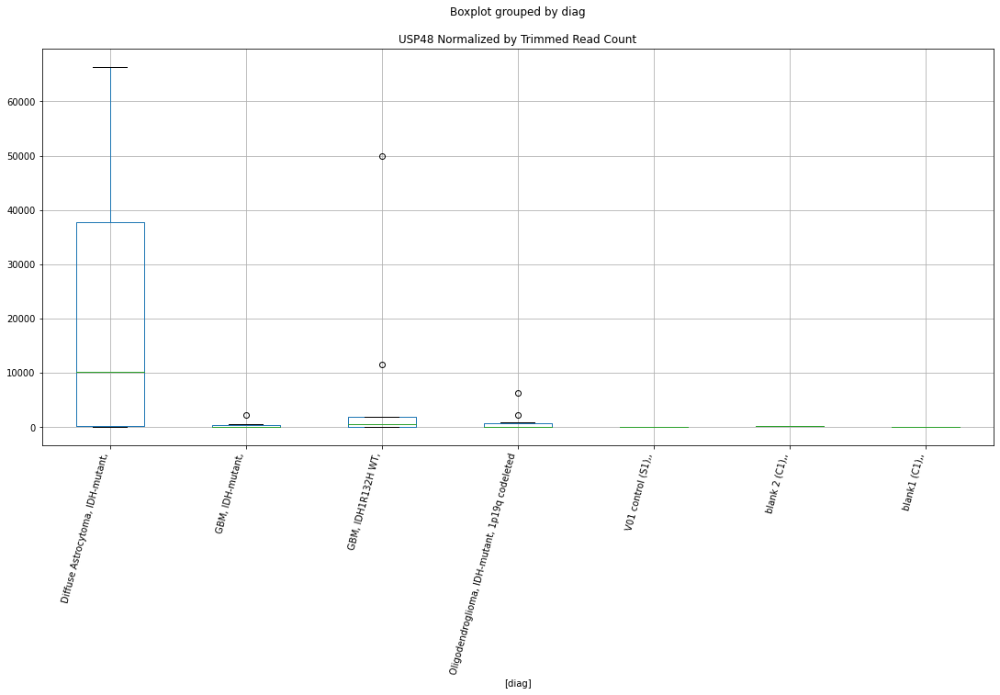

 p : 0.018890962663212583  ( t : 2.5796163834319437 ) :  D-plex  :  bbduk2  :  ZNF2
Control and blanks
73     0.0
337    0.0
Name: ZNF2, dtype: float64
205    1790.91
Name: ZNF2, dtype: float64
469    5915.27
Name: ZNF2, dtype: float64


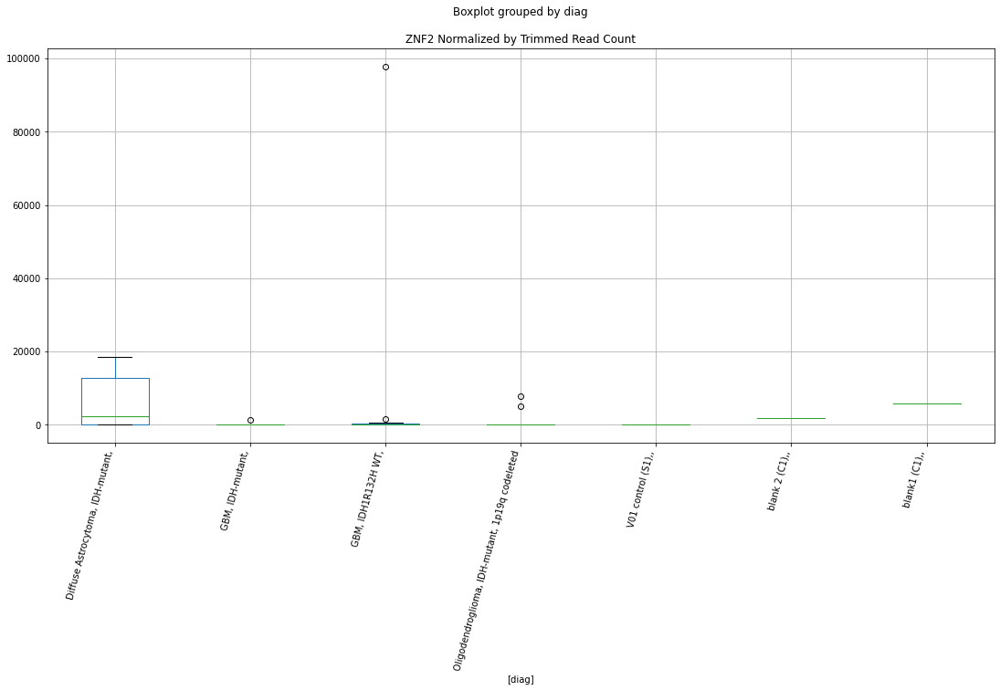

 p : 0.018916105460882845  ( t : 2.5789823087710415 ) :  D-plex  :  cutadapt2  :  TMEM51-AS1
Control and blanks
76     757.61
340      0.00
Name: TMEM51-AS1, dtype: float64
208    529.08
Name: TMEM51-AS1, dtype: float64
472    1155.91
Name: TMEM51-AS1, dtype: float64


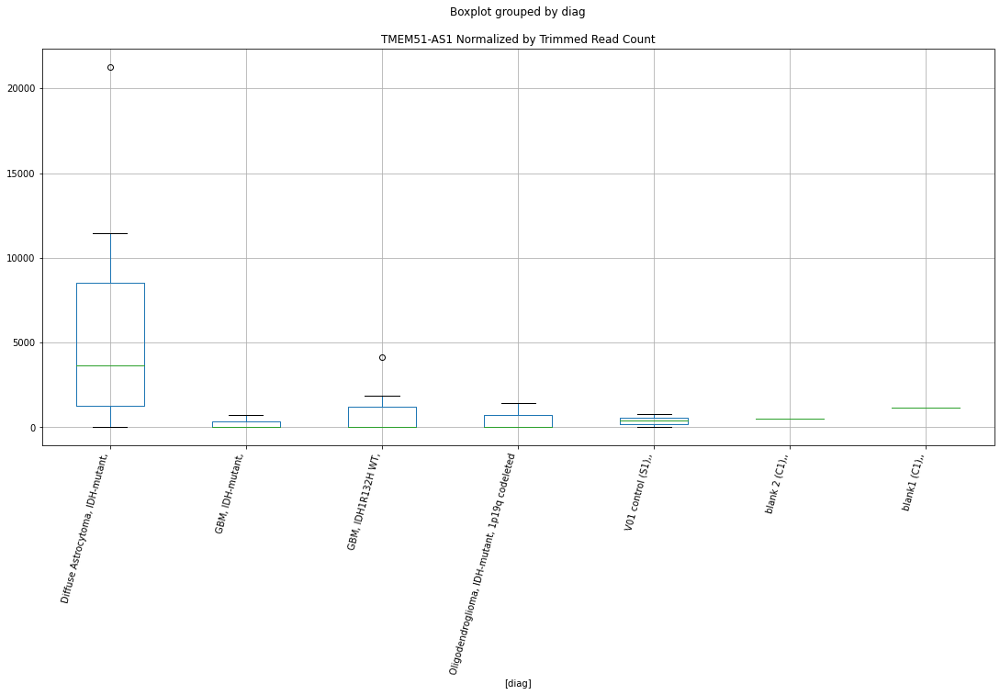

 p : 0.01897421735300948  ( t : 2.5775198393722825 ) :  D-plex  :  bbduk2  :  TFAP2A-AS2
Control and blanks
73     37104.40
337      890.16
Name: TFAP2A-AS2, dtype: float64
205    39758.19
Name: TFAP2A-AS2, dtype: float64
469    14196.66
Name: TFAP2A-AS2, dtype: float64


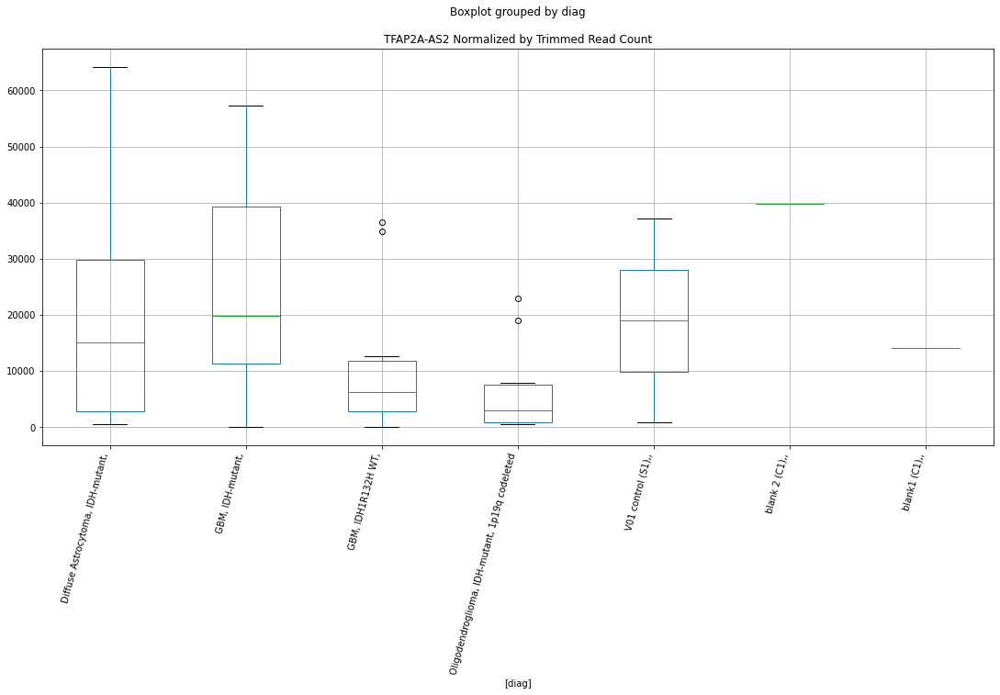

 p : 0.01900092729792353  ( t : 2.576849068346253 ) :  D-plex  :  cutadapt2  :  TLCD1
Control and blanks
76     4545.69
340       0.00
Name: TLCD1, dtype: float64
208    91707.31
Name: TLCD1, dtype: float64
472    4623.65
Name: TLCD1, dtype: float64


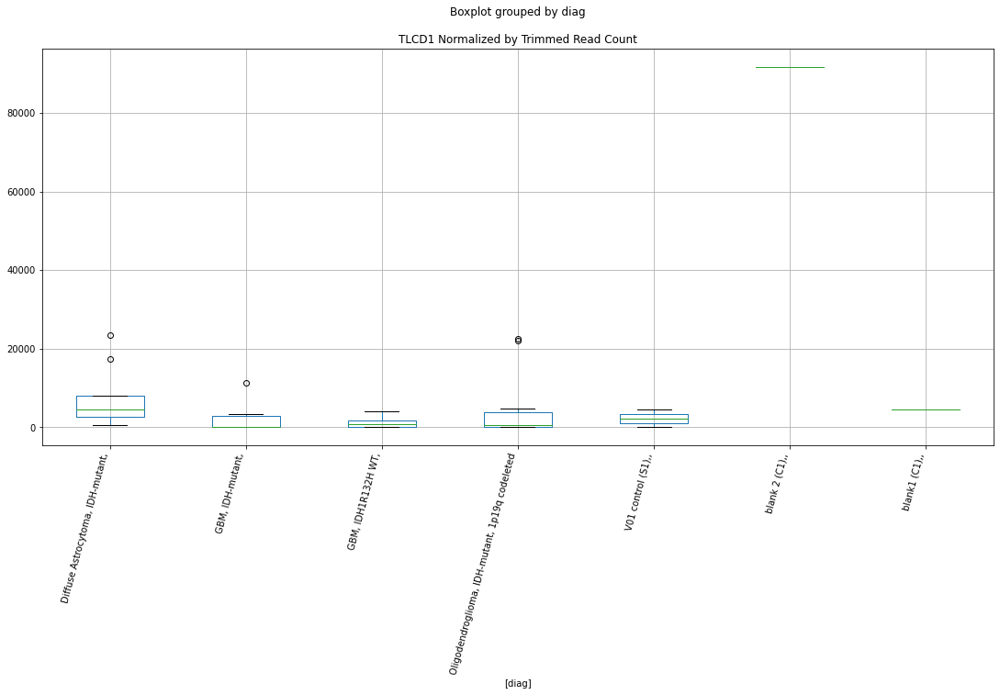

 p : 0.019162221726304912  ( t : 2.572817342922542 ) :  D-plex  :  cutadapt2  :  TSNARE1
Control and blanks
76      30304.57
340    276549.89
Name: TSNARE1, dtype: float64
208    262071.28
Name: TSNARE1, dtype: float64
472    129462.11
Name: TSNARE1, dtype: float64


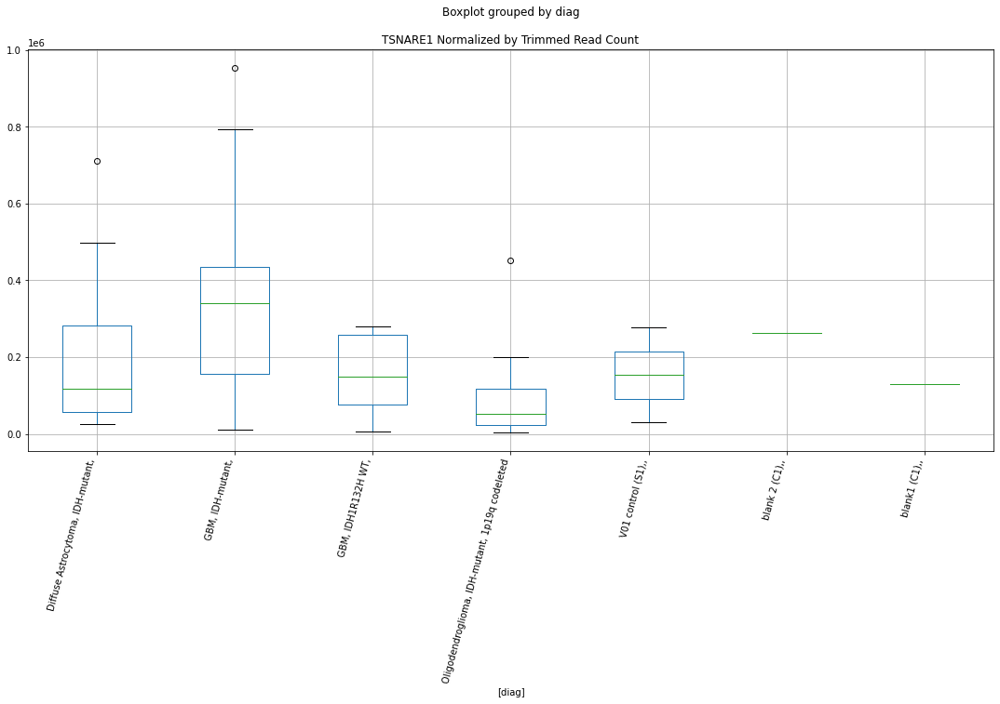

 p : 0.01919080970754077  ( t : 2.5721061117067467 ) :  D-plex  :  bbduk2  :  SYAP1
Control and blanks
73     0.0
337    0.0
Name: SYAP1, dtype: float64
205    2149.09
Name: SYAP1, dtype: float64
469    2366.11
Name: SYAP1, dtype: float64


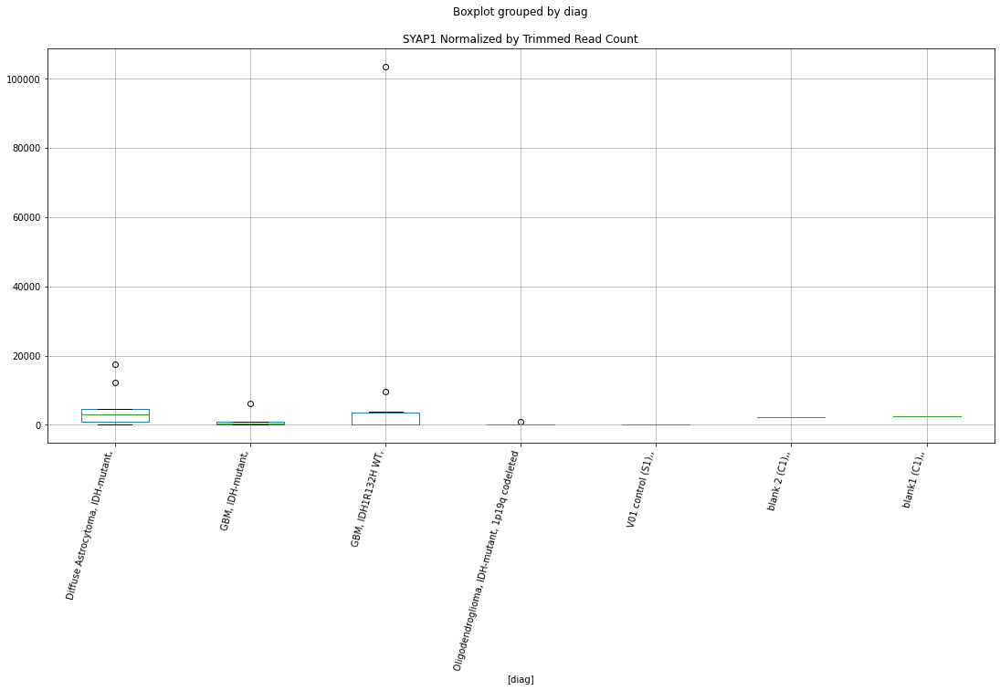

 p : 0.019194766669071273  ( t : 2.5720077468078264 ) :  Lexogen  :  bbduk2  :  ZNF740
Control and blanks
79         0.00
343    96815.33
Name: ZNF740, dtype: float64
211    0.0
Name: ZNF740, dtype: float64
475    0.0
Name: ZNF740, dtype: float64


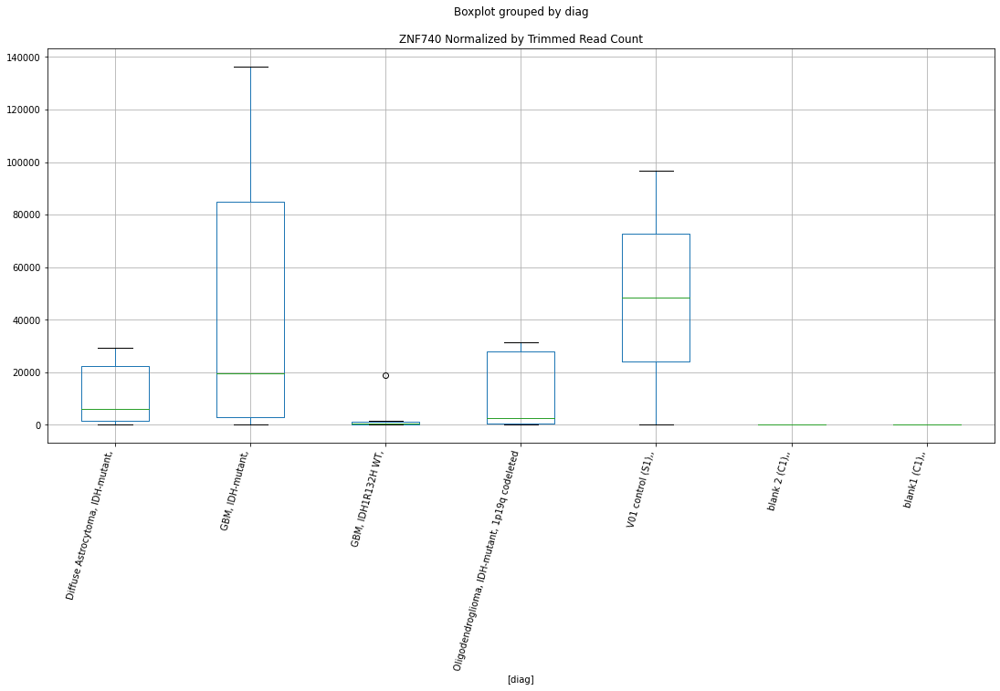

 p : 0.019405320480744986  ( t : 2.5668011584472556 ) :  D-plex  :  cutadapt2  :  TMCO6
Control and blanks
76      78791.88
340    186715.21
Name: TMCO6, dtype: float64
208    44619.14
Name: TMCO6, dtype: float64
472    64153.1
Name: TMCO6, dtype: float64


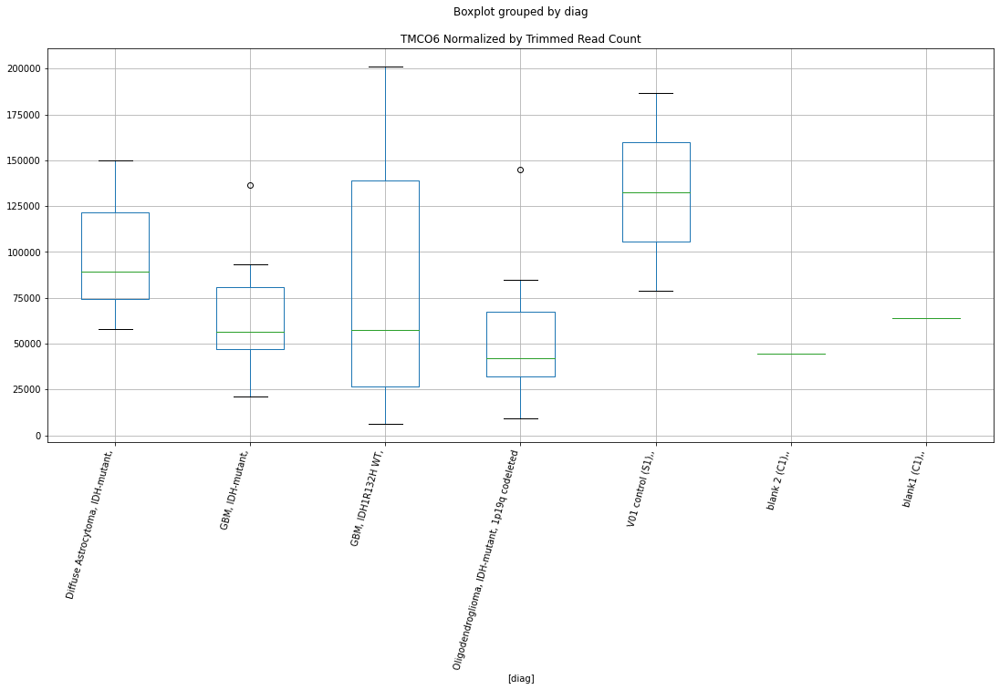

 p : 0.019440411281238443  ( t : 2.5659386354629072 ) :  D-plex  :  bbduk2  :  ZSWIM9
Control and blanks
73     0.0
337    0.0
Name: ZSWIM9, dtype: float64
205    179.09
Name: ZSWIM9, dtype: float64
469    2957.64
Name: ZSWIM9, dtype: float64


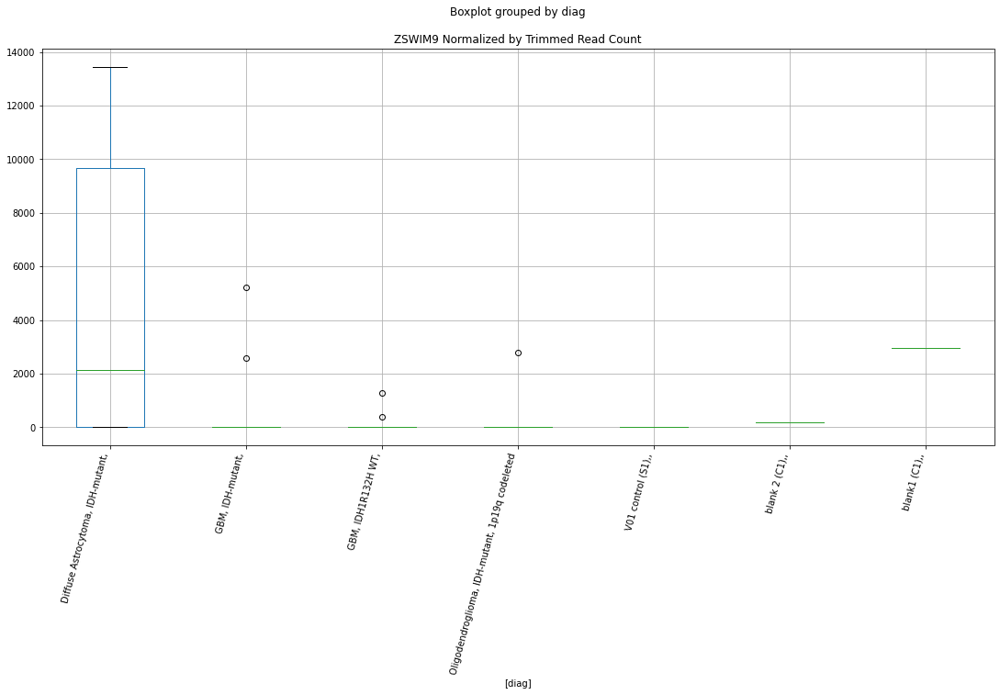

 p : 0.019660220409835925  ( t : 2.5605690821166767 ) :  D-plex  :  cutadapt2  :  ZRANB2-AS1
Control and blanks
76     757.61
340      0.00
Name: ZRANB2-AS1, dtype: float64
208    1234.52
Name: ZRANB2-AS1, dtype: float64
472    0.0
Name: ZRANB2-AS1, dtype: float64


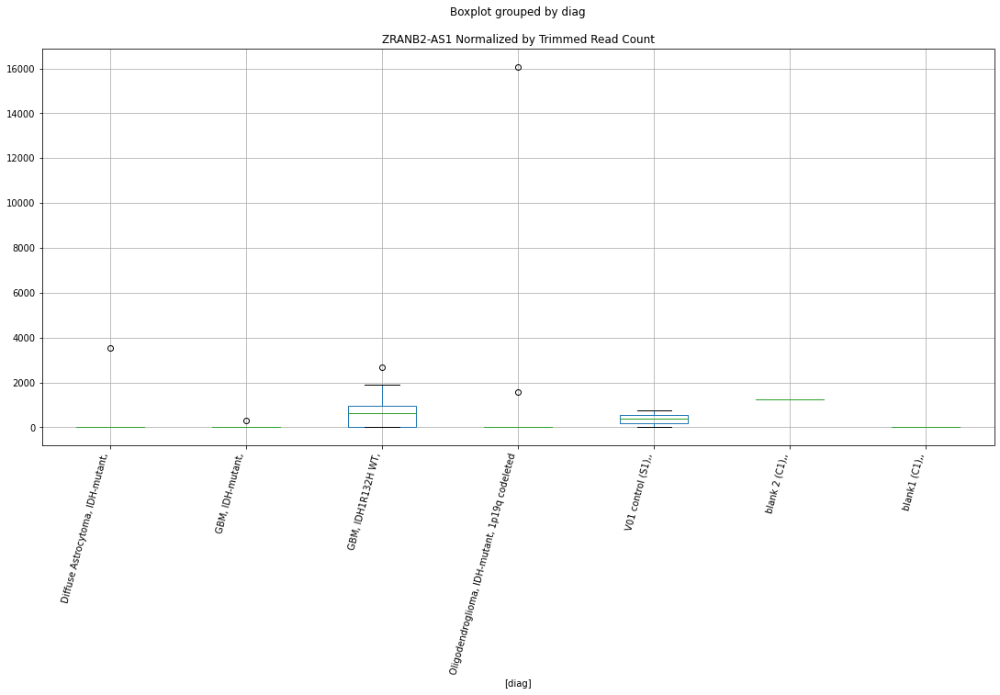

 p : 0.0196610650108399  ( t : 2.5605485597955546 ) :  D-plex  :  bbduk2  :  TSNARE1
Control and blanks
73      27828.30
337    217198.37
Name: TSNARE1, dtype: float64
205    186970.95
Name: TSNARE1, dtype: float64
469    112390.19
Name: TSNARE1, dtype: float64


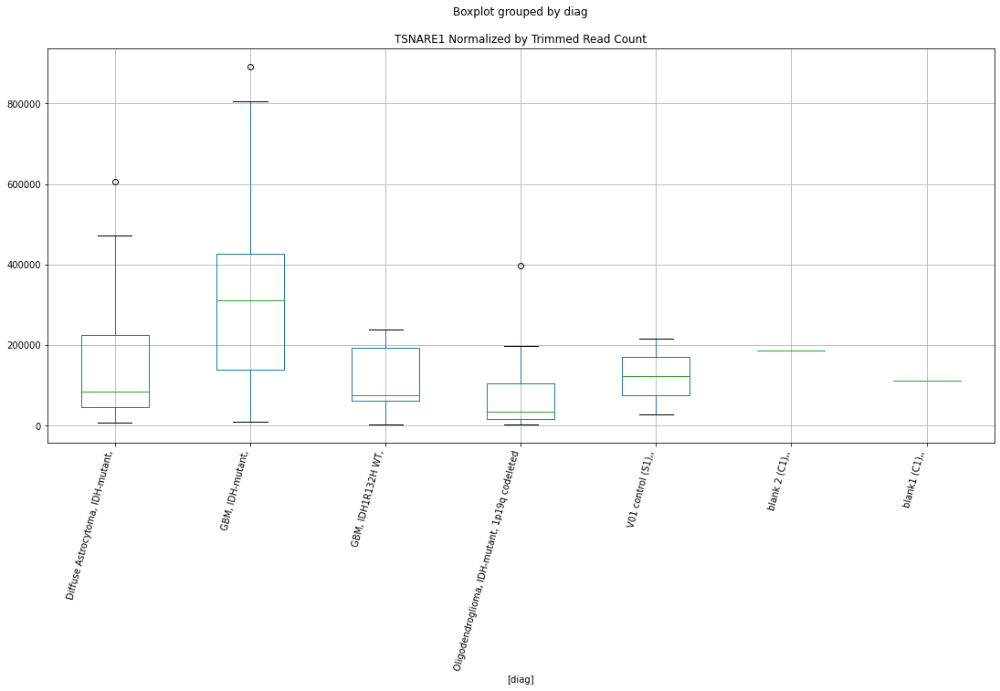

 p : 0.01975053420359688  ( t : 2.558379327066486 ) :  D-plex  :  bbduk2  :  TMCO6
Control and blanks
73      79619.87
337    189603.50
Name: TMCO6, dtype: float64
205    45310.01
Name: TMCO6, dtype: float64
469    65068.0
Name: TMCO6, dtype: float64


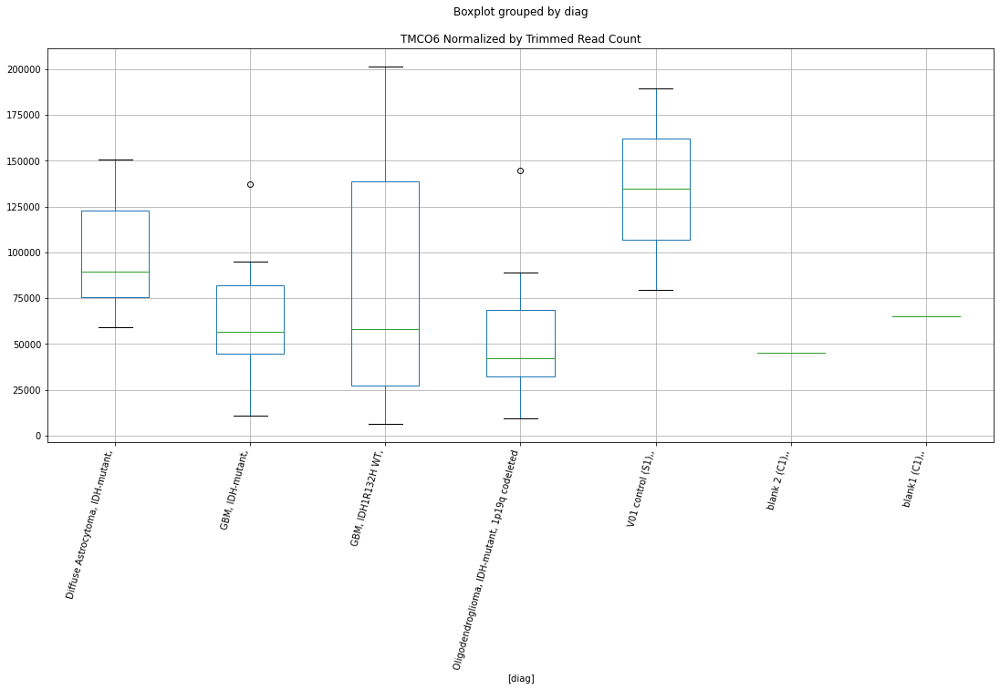

 p : 0.01977763338361527  ( t : 2.5577241263490027 ) :  Lexogen  :  cutadapt2  :  ZNF740
Control and blanks
82         0.00
346    95958.14
Name: ZNF740, dtype: float64
214    0.0
Name: ZNF740, dtype: float64
478    0.0
Name: ZNF740, dtype: float64


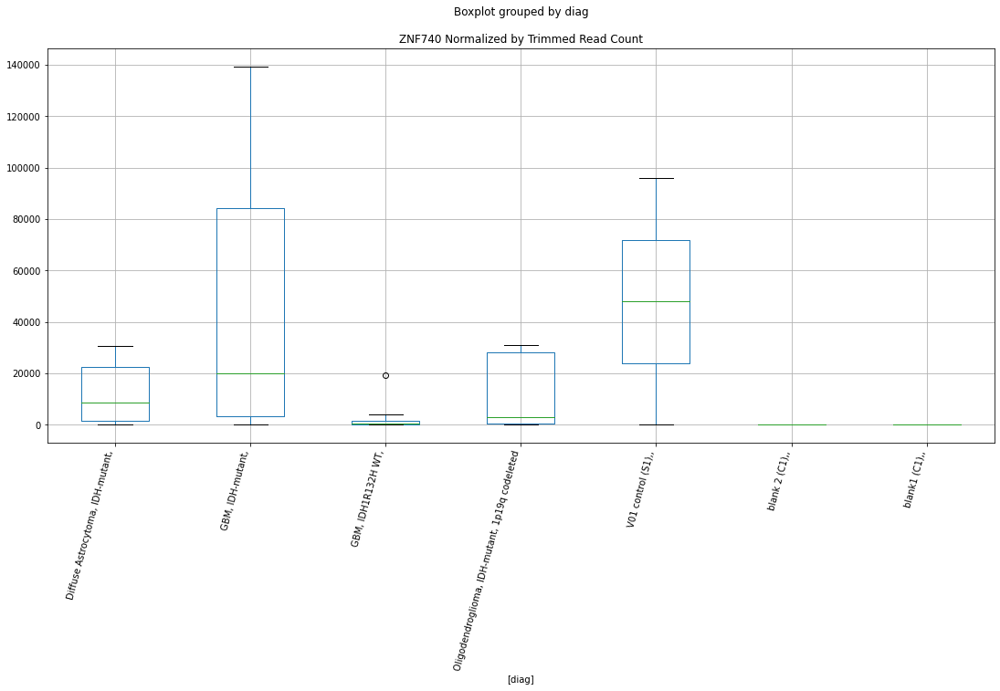

 p : 0.019783493047634736  ( t : 2.5575825638070775 ) :  D-plex  :  bbduk2  :  TFB1M
Control and blanks
73     773.01
337      0.00
Name: TFB1M, dtype: float64
205    76830.02
Name: TFB1M, dtype: float64
469    4140.69
Name: TFB1M, dtype: float64


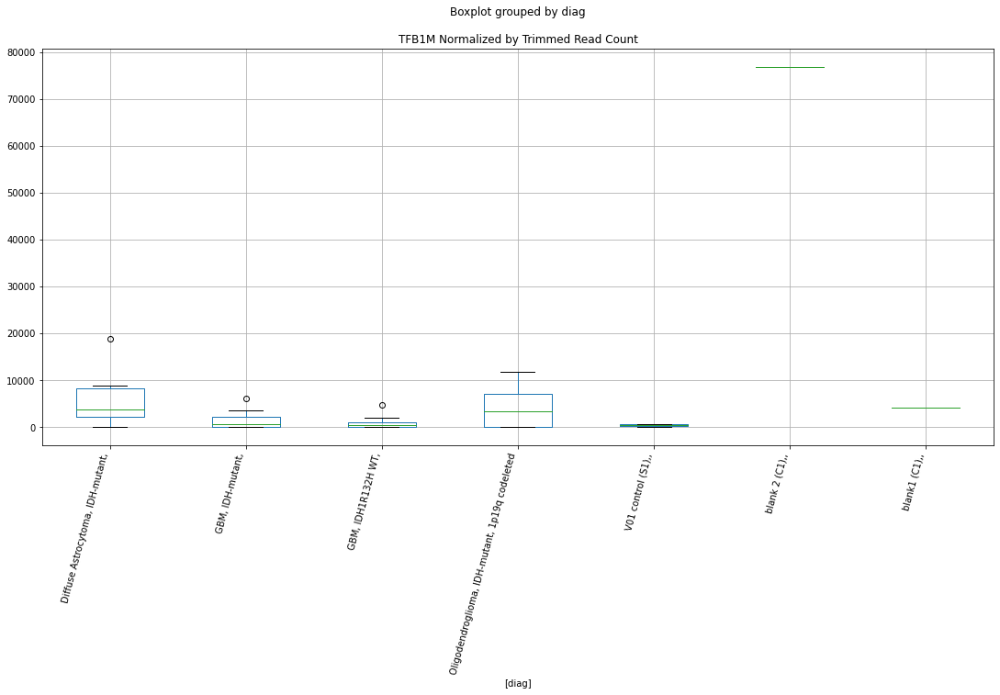

 p : 0.019888928684549157  ( t : 2.5550421200494844 ) :  Lexogen  :  cutadapt2  :  WDR19
Control and blanks
82     149105.37
346     44401.68
Name: WDR19, dtype: float64
214    28478.78
Name: WDR19, dtype: float64
478    10685.72
Name: WDR19, dtype: float64


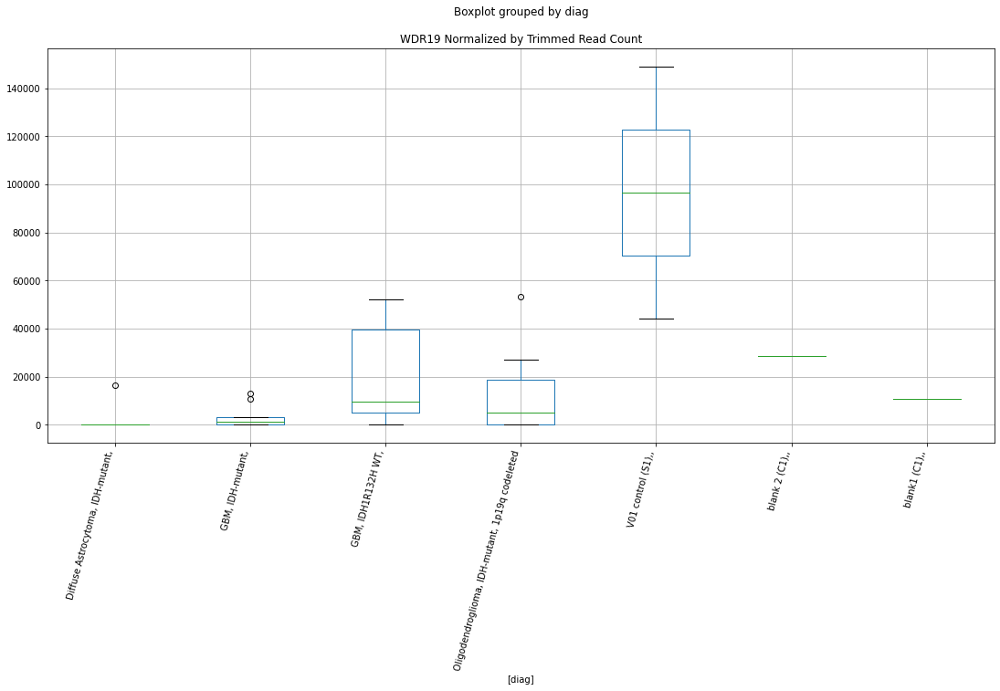

 p : 0.019971202713022666  ( t : 2.553068584074375 ) :  D-plex  :  bbduk2  :  ZNF214
Control and blanks
73     0.0
337    0.0
Name: ZNF214, dtype: float64
205    5910.0
Name: ZNF214, dtype: float64
469    0.0
Name: ZNF214, dtype: float64


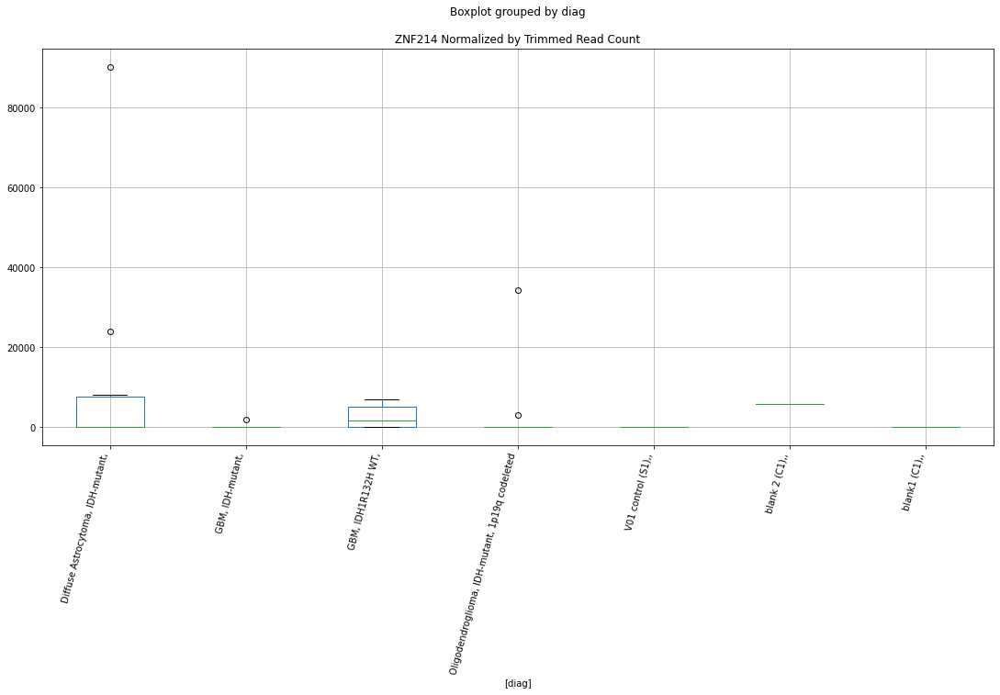

 p : 0.02007114891977621  ( t : 2.5506814593978775 ) :  Lexogen  :  cutadapt2  :  TLR9
Control and blanks
82     0.0
346    0.0
Name: TLR9, dtype: float64
214    0.0
Name: TLR9, dtype: float64
478    0.0
Name: TLR9, dtype: float64


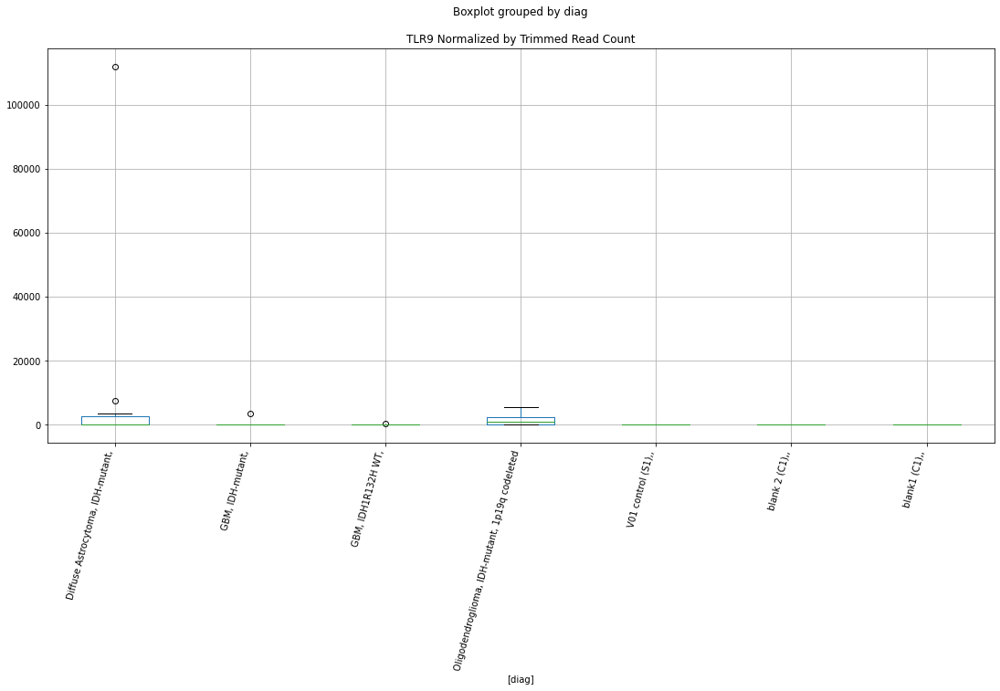

 p : 0.020111537111764655  ( t : 2.5497200122082475 ) :  Lexogen  :  bbduk2  :  XRCC1
Control and blanks
79     0.0
343    0.0
Name: XRCC1, dtype: float64
211    273.31
Name: XRCC1, dtype: float64
475    0.0
Name: XRCC1, dtype: float64


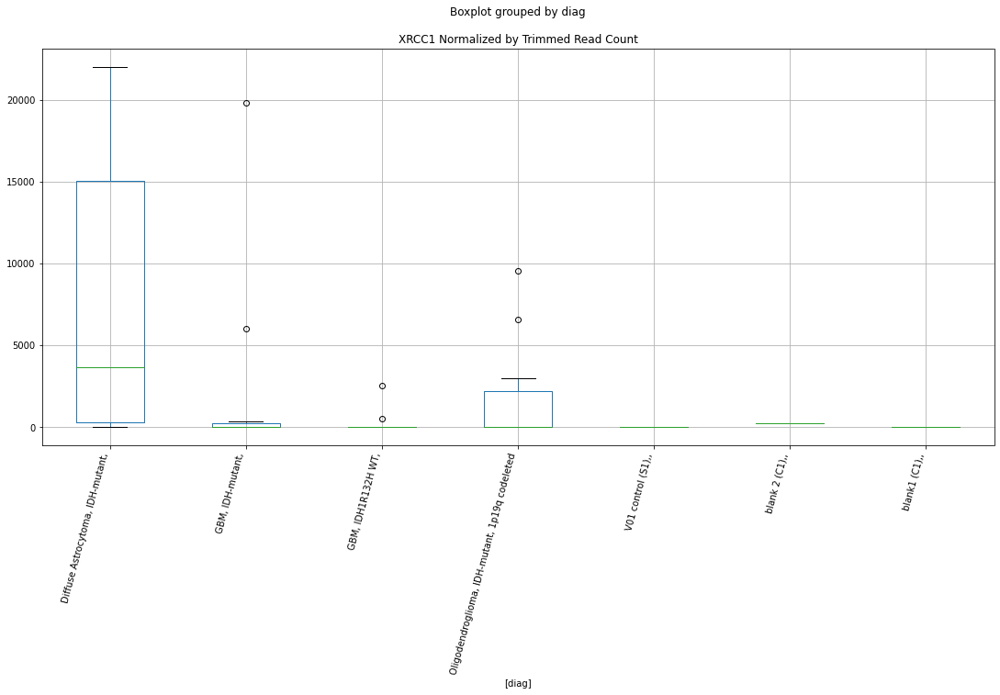

 p : 0.020203860124172763  ( t : 2.5475290880991563 ) :  Lexogen  :  bbduk2  :  SRRM2
Control and blanks
79          0.00
343    208068.03
Name: SRRM2, dtype: float64
211    0.0
Name: SRRM2, dtype: float64
475    0.0
Name: SRRM2, dtype: float64


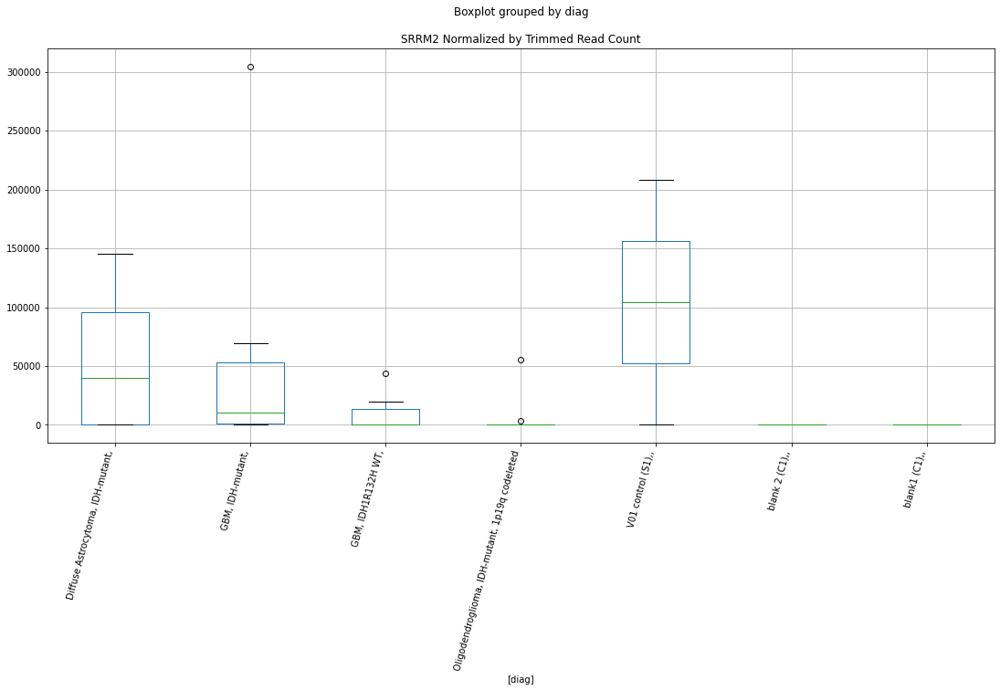

 p : 0.020316486662182325  ( t : 2.544869122042233 ) :  D-plex  :  cutadapt2  :  TUBA3FP
Control and blanks
76     757.61
340      0.00
Name: TUBA3FP, dtype: float64
208    352.72
Name: TUBA3FP, dtype: float64
472    577.96
Name: TUBA3FP, dtype: float64


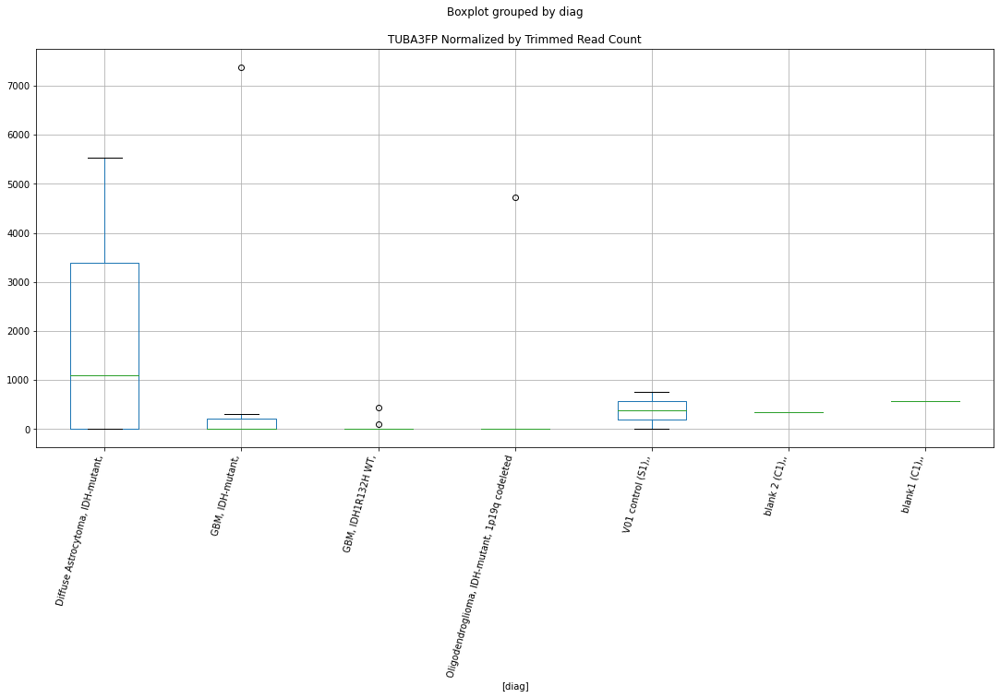

 p : 0.020346332633246096  ( t : 2.5441665692790543 ) :  D-plex  :  bbduk2  :  TLCD1
Control and blanks
73     4638.05
337       0.00
Name: TLCD1, dtype: float64
205    92410.93
Name: TLCD1, dtype: float64
469    4732.22
Name: TLCD1, dtype: float64


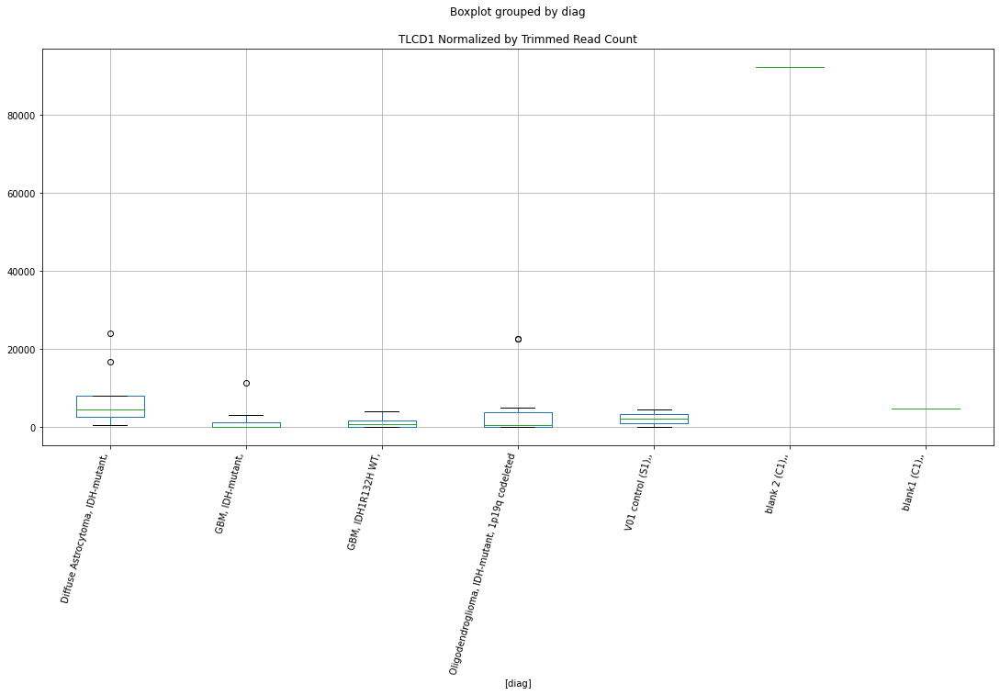

 p : 0.02049287728096461  ( t : 2.5407310860362875 ) :  Lexogen  :  bbduk2  :  TLR9
Control and blanks
79       0.00
343    212.31
Name: TLR9, dtype: float64
211    0.0
Name: TLR9, dtype: float64
475    0.0
Name: TLR9, dtype: float64


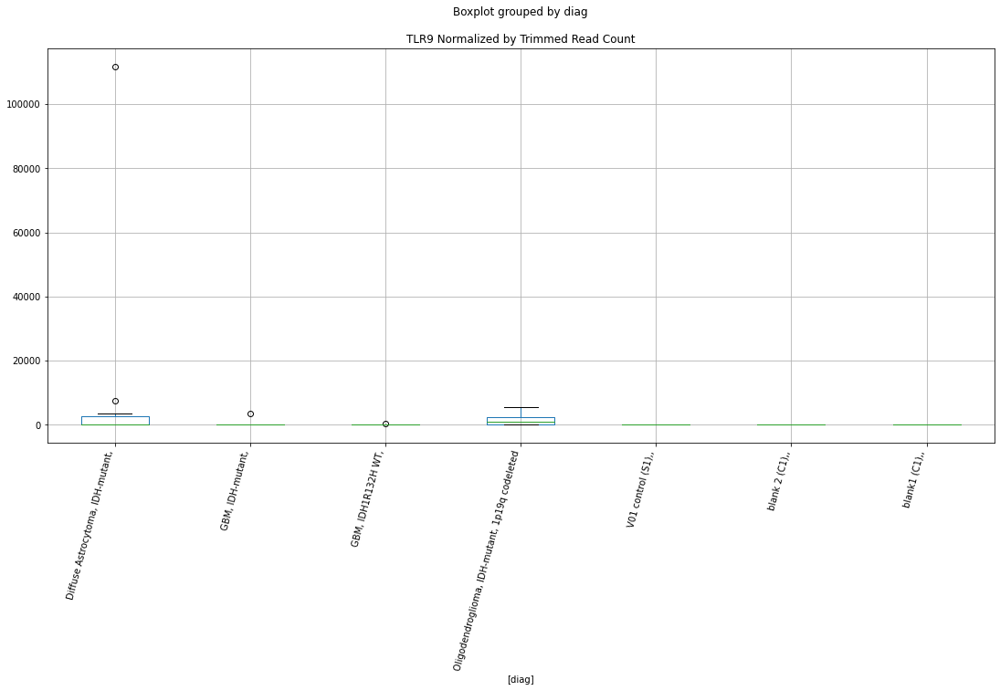

 p : 0.02055302040377444  ( t : 2.5393278516791997 ) :  D-plex  :  cutadapt2  :  ZBTB14
Control and blanks
76      1515.23
340    26421.96
Name: ZBTB14, dtype: float64
208    6701.69
Name: ZBTB14, dtype: float64
472    12137.07
Name: ZBTB14, dtype: float64


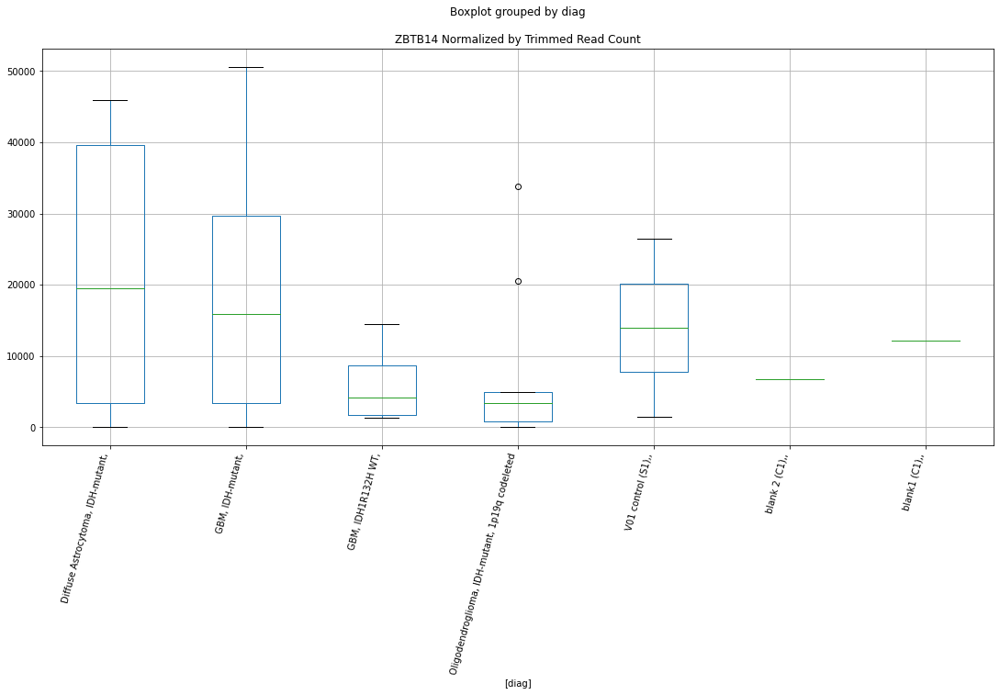

 p : 0.020588587475247305  ( t : 2.53849984041248 ) :  D-plex  :  bbduk2  :  ZBTB14
Control and blanks
73      1546.02
337    35606.29
Name: ZBTB14, dtype: float64
205    6805.46
Name: ZBTB14, dtype: float64
469    5915.27
Name: ZBTB14, dtype: float64


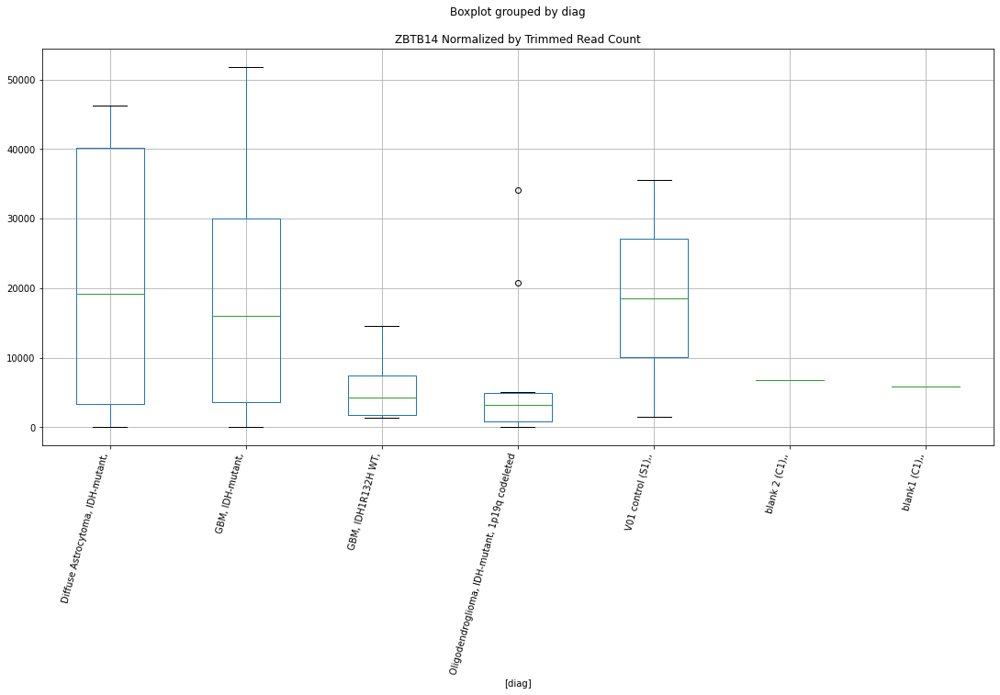

 p : 0.020673842884795464  ( t : 2.5365205609314745 ) :  Lexogen  :  cutadapt2  :  XRCC1
Control and blanks
82     0.0
346    0.0
Name: XRCC1, dtype: float64
214    271.23
Name: XRCC1, dtype: float64
478    0.0
Name: XRCC1, dtype: float64


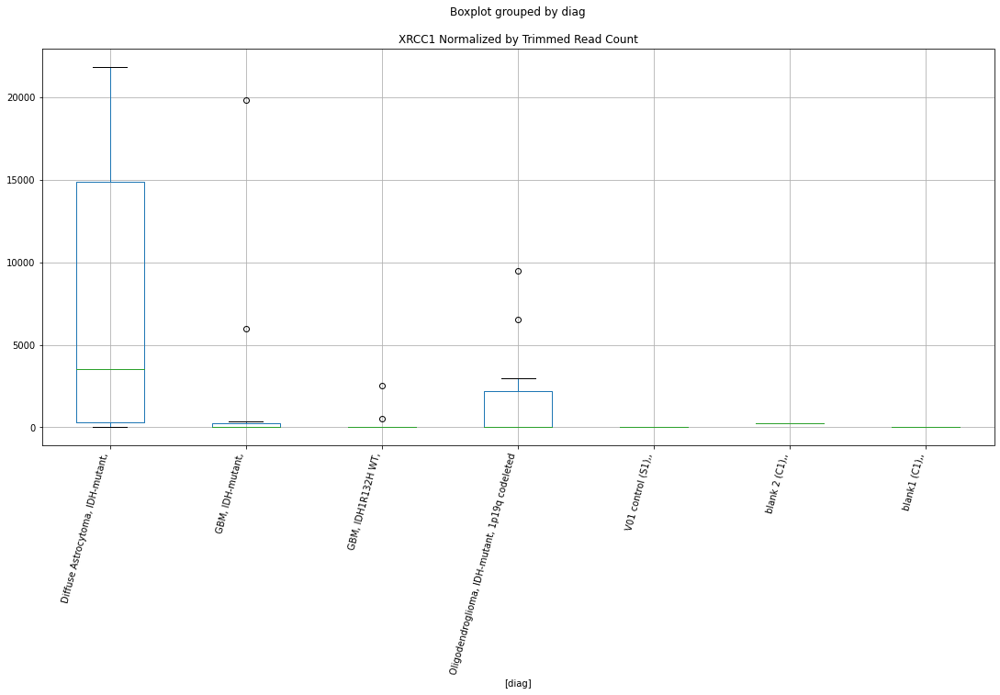

 p : 0.02087489536192917  ( t : 2.531883316909877 ) :  D-plex  :  bbduk2  :  TMEM51-AS1
Control and blanks
73     773.01
337      0.00
Name: TMEM51-AS1, dtype: float64
205    895.45
Name: TMEM51-AS1, dtype: float64
469    1183.05
Name: TMEM51-AS1, dtype: float64


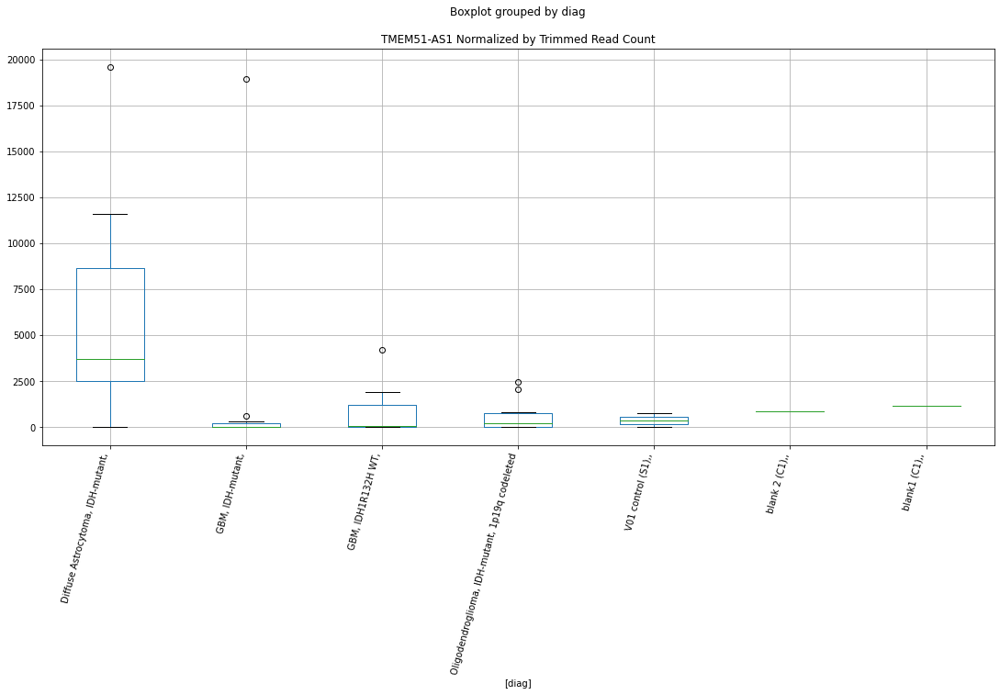

 p : 0.020912274416965727  ( t : 2.531025828287516 ) :  D-plex  :  cutadapt2  :  TFB1M
Control and blanks
76     5303.3
340       0.0
Name: TFB1M, dtype: float64
208    75658.53
Name: TFB1M, dtype: float64
472    4045.69
Name: TFB1M, dtype: float64


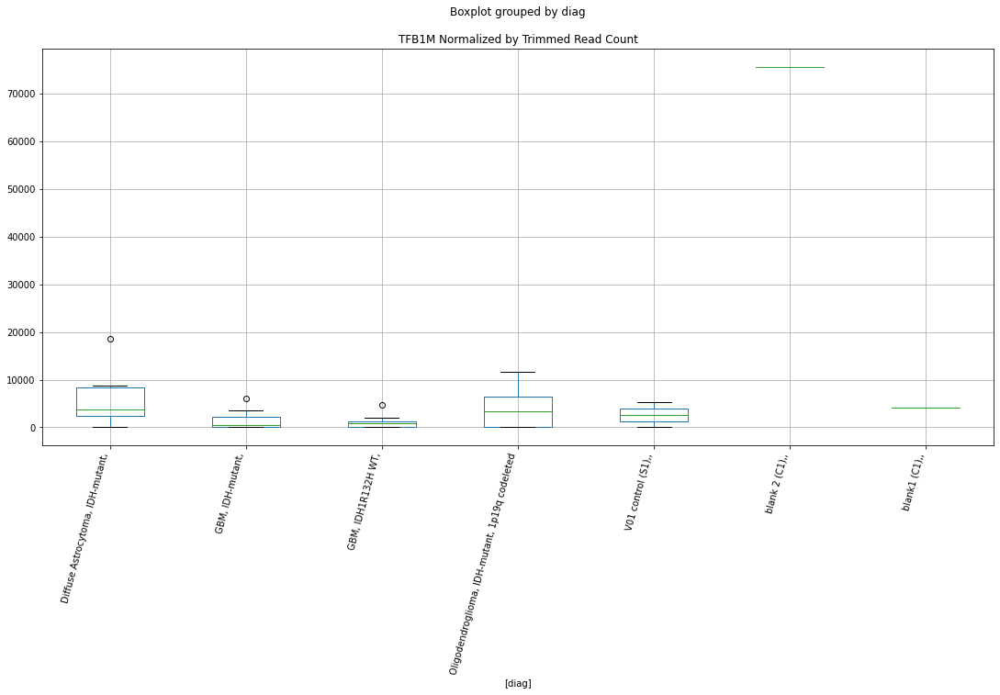

 p : 0.021023421669330782  ( t : 2.528484596150185 ) :  Lexogen  :  cutadapt2  :  TALAM1
Control and blanks
82     0.0
346    0.0
Name: TALAM1, dtype: float64
214    6509.43
Name: TALAM1, dtype: float64
478    27070.5
Name: TALAM1, dtype: float64


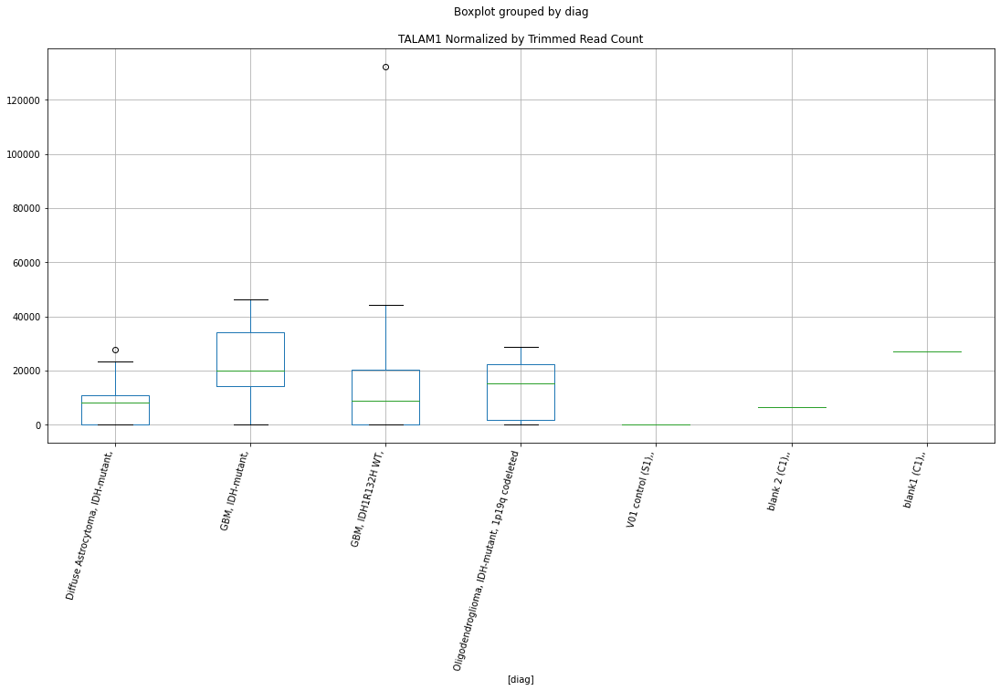

 p : 0.021047689061458156  ( t : 2.5279314426853032 ) :  D-plex  :  bbduk2  :  SPRED2
Control and blanks
73     0.0
337    0.0
Name: SPRED2, dtype: float64
205    7521.82
Name: SPRED2, dtype: float64
469    27801.78
Name: SPRED2, dtype: float64


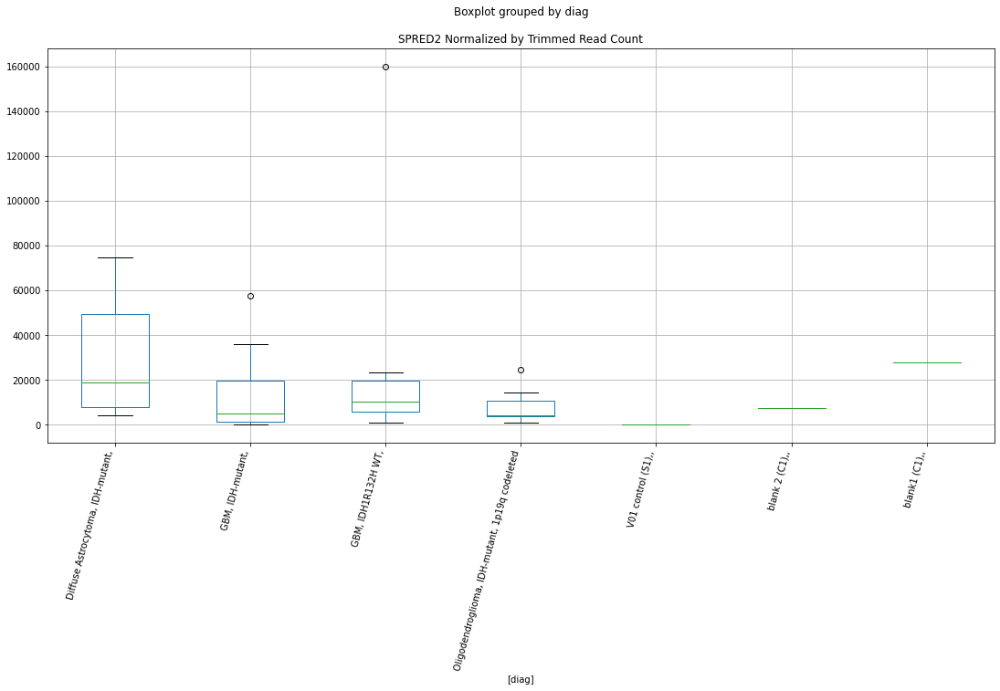

 p : 0.02111634884597394  ( t : 2.526369660396901 ) :  D-plex  :  cutadapt2  :  TBC1D17
Control and blanks
76     0.0
340    0.0
Name: TBC1D17, dtype: float64
208    0.0
Name: TBC1D17, dtype: float64
472    0.0
Name: TBC1D17, dtype: float64


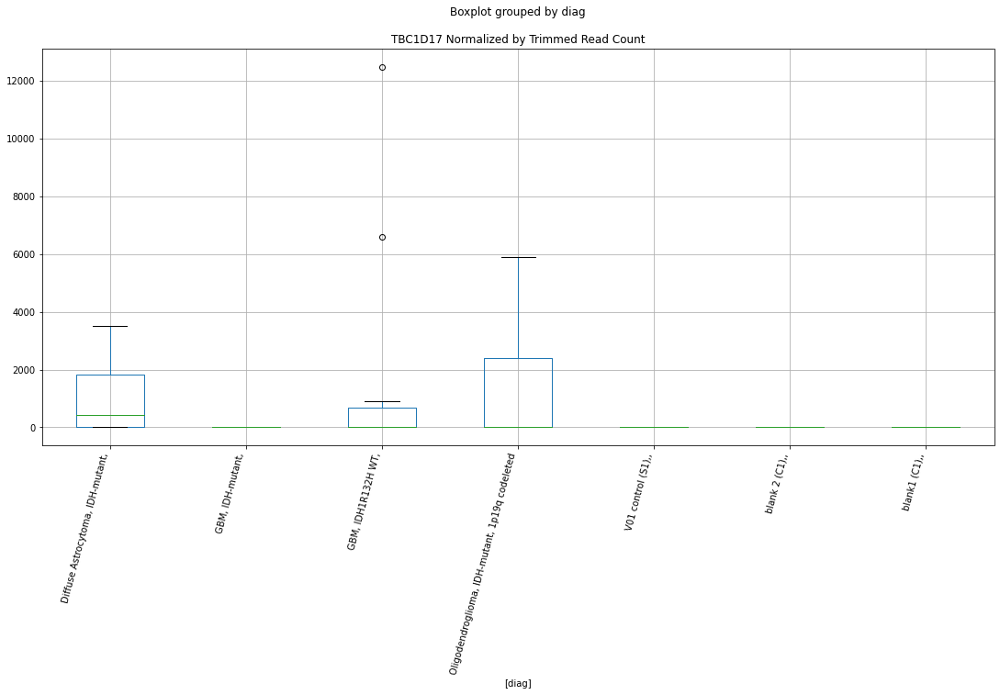

 p : 0.021148263923239447  ( t : 2.5256453299343304 ) :  D-plex  :  cutadapt2  :  WDR82
Control and blanks
76     0.0
340    0.0
Name: WDR82, dtype: float64
208    1587.24
Name: WDR82, dtype: float64
472    0.0
Name: WDR82, dtype: float64


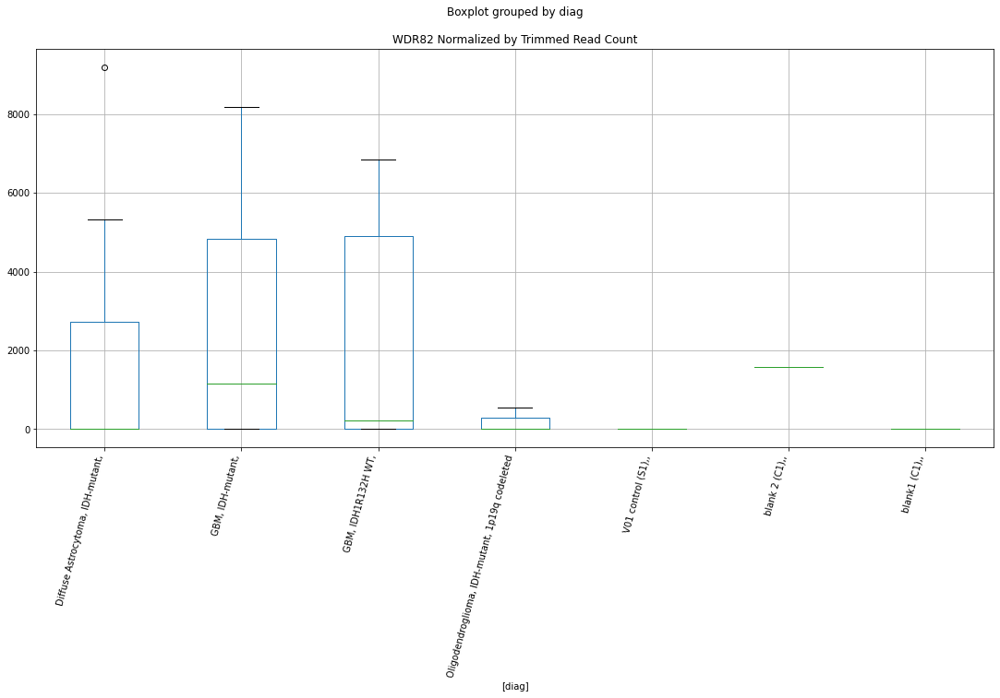

 p : 0.021254319025073326  ( t : 2.523245740571756 ) :  Lexogen  :  bbduk2  :  TALAM1
Control and blanks
79     0.0
343    0.0
Name: TALAM1, dtype: float64
211    6559.35
Name: TALAM1, dtype: float64
475    27304.79
Name: TALAM1, dtype: float64


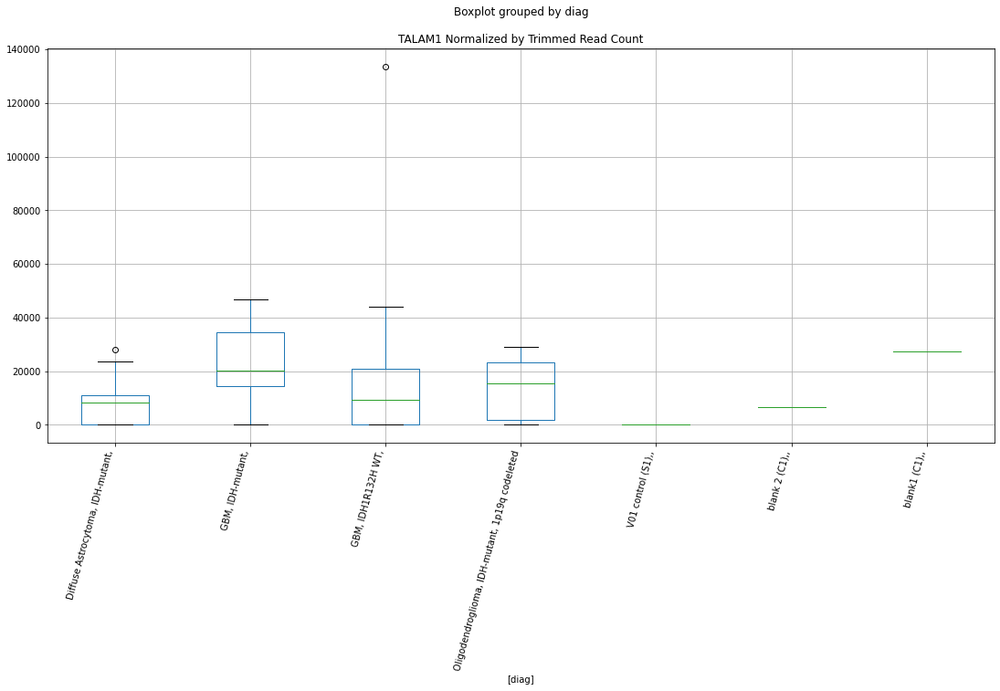

 p : 0.021535576069372075  ( t : 2.5169363631103576 ) :  Lexogen  :  cutadapt2  :  SRRM2
Control and blanks
82          0.00
346    206225.83
Name: SRRM2, dtype: float64
214    0.0
Name: SRRM2, dtype: float64
478    0.0
Name: SRRM2, dtype: float64


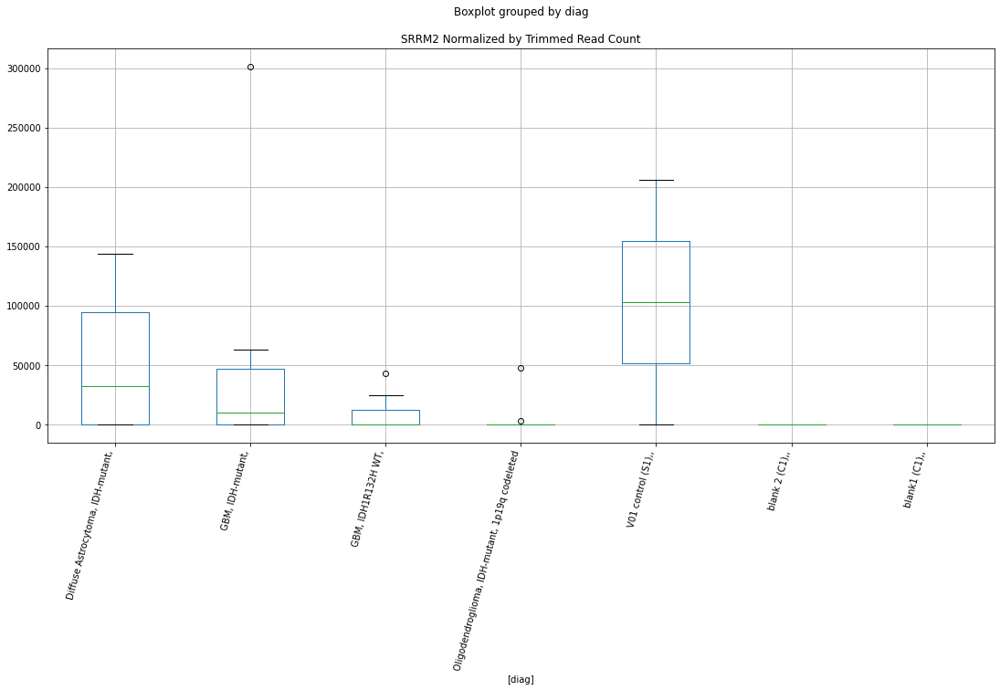

 p : 0.021800117760470545  ( t : 2.5110725133831364 ) :  Lexogen  :  cutadapt2  :  SPEG
Control and blanks
82        0.00
346    2735.65
Name: SPEG, dtype: float64
214    0.0
Name: SPEG, dtype: float64
478    0.0
Name: SPEG, dtype: float64


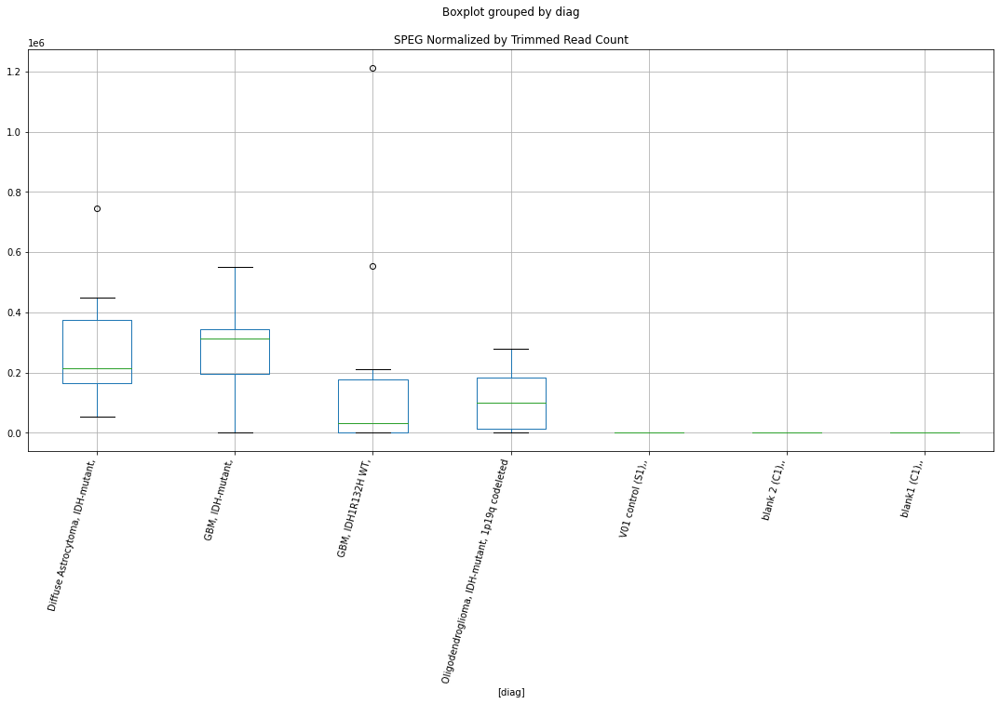

 p : 0.021814579376131835  ( t : 2.510753894350461 ) :  D-plex  :  cutadapt2  :  WDR62
Control and blanks
76      18182.74
340    140917.14
Name: WDR62, dtype: float64
208    15343.34
Name: WDR62, dtype: float64
472    30053.7
Name: WDR62, dtype: float64


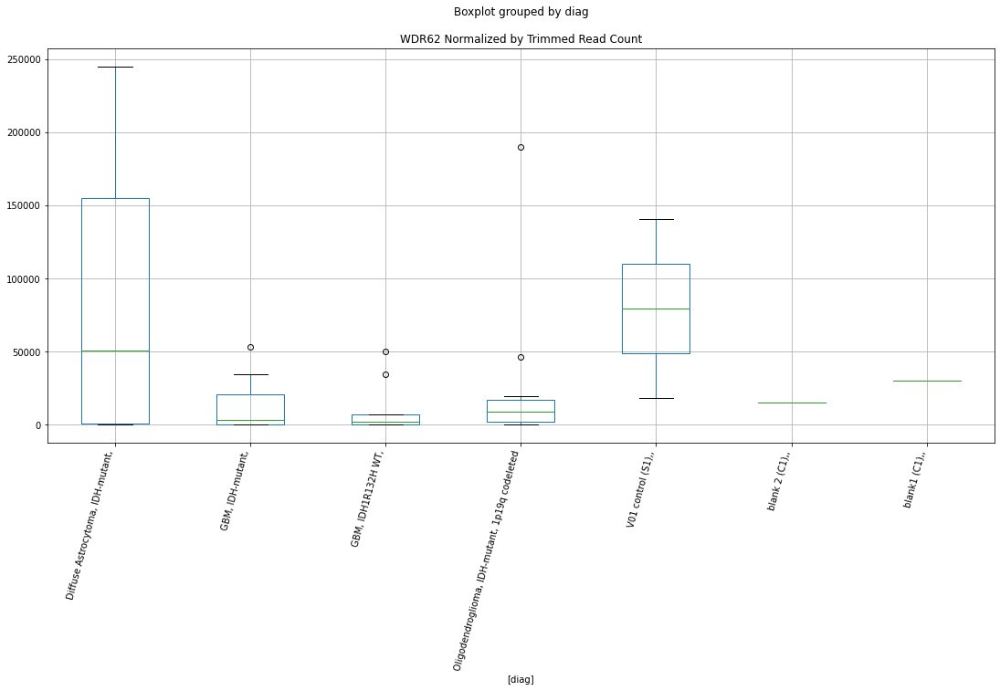

 p : 0.02199403538104097  ( t : 2.5068165964615665 ) :  D-plex  :  bbduk2  :  WDR62
Control and blanks
73      18552.2
337    135303.9
Name: WDR62, dtype: float64
205    15580.91
Name: WDR62, dtype: float64
469    30759.42
Name: WDR62, dtype: float64


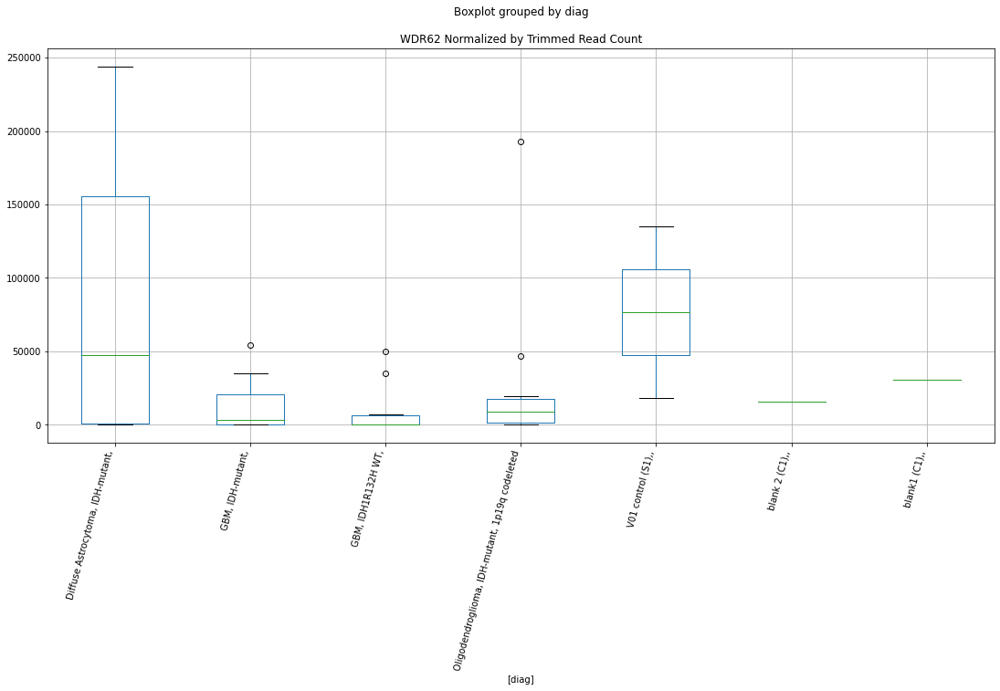

 p : 0.02200301907302005  ( t : 2.506620289688768 ) :  Lexogen  :  bbduk2  :  ZNF385B
Control and blanks
79       0.00
343    636.94
Name: ZNF385B, dtype: float64
211    0.0
Name: ZNF385B, dtype: float64
475    0.0
Name: ZNF385B, dtype: float64


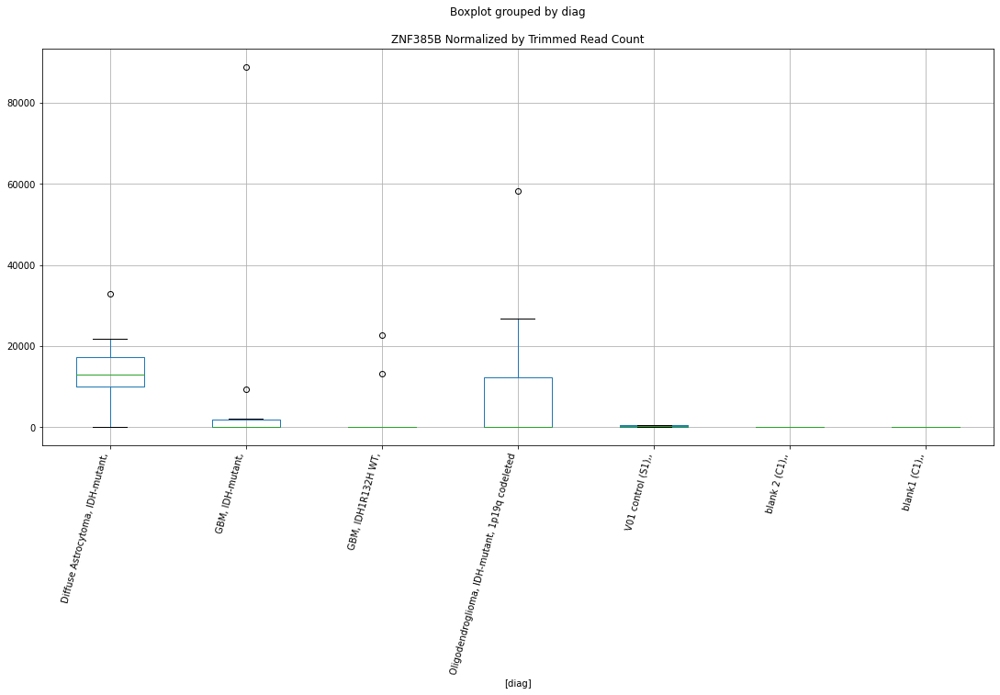

 p : 0.022017055409518423  ( t : 2.506313726478726 ) :  D-plex  :  cutadapt2  :  TTC37
Control and blanks
76     0.0
340    0.0
Name: TTC37, dtype: float64
208    1410.88
Name: TTC37, dtype: float64
472    577.96
Name: TTC37, dtype: float64


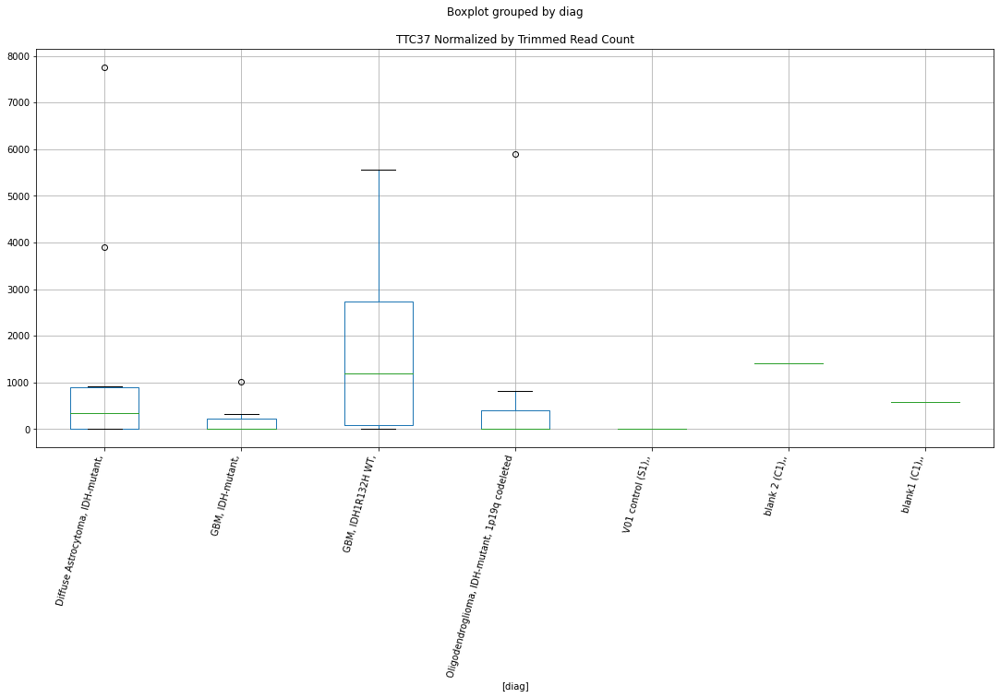

 p : 0.022106938584680005  ( t : 2.504354972887631 ) :  D-plex  :  bbduk2  :  TF
Control and blanks
73         0.00
337    45398.02
Name: TF, dtype: float64
205    6447.27
Name: TF, dtype: float64
469    1774.58
Name: TF, dtype: float64


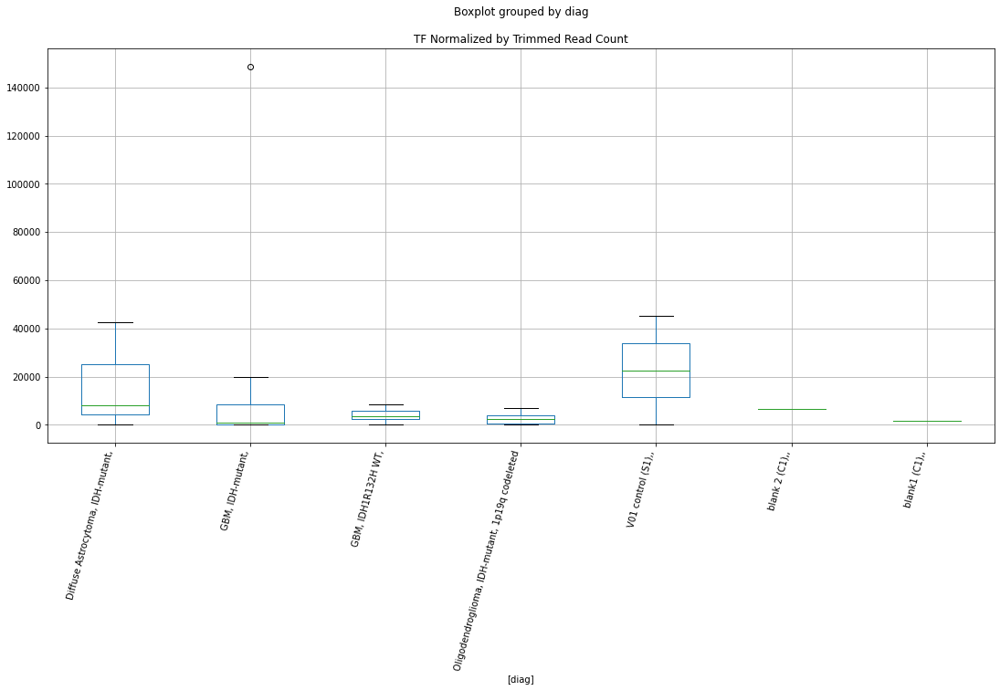

 p : 0.022137946489108495  ( t : 2.5036809832719964 ) :  D-plex  :  cutadapt2  :  TRIOBP
Control and blanks
76       0.00
340    880.73
Name: TRIOBP, dtype: float64
208    881.8
Name: TRIOBP, dtype: float64
472    577.96
Name: TRIOBP, dtype: float64


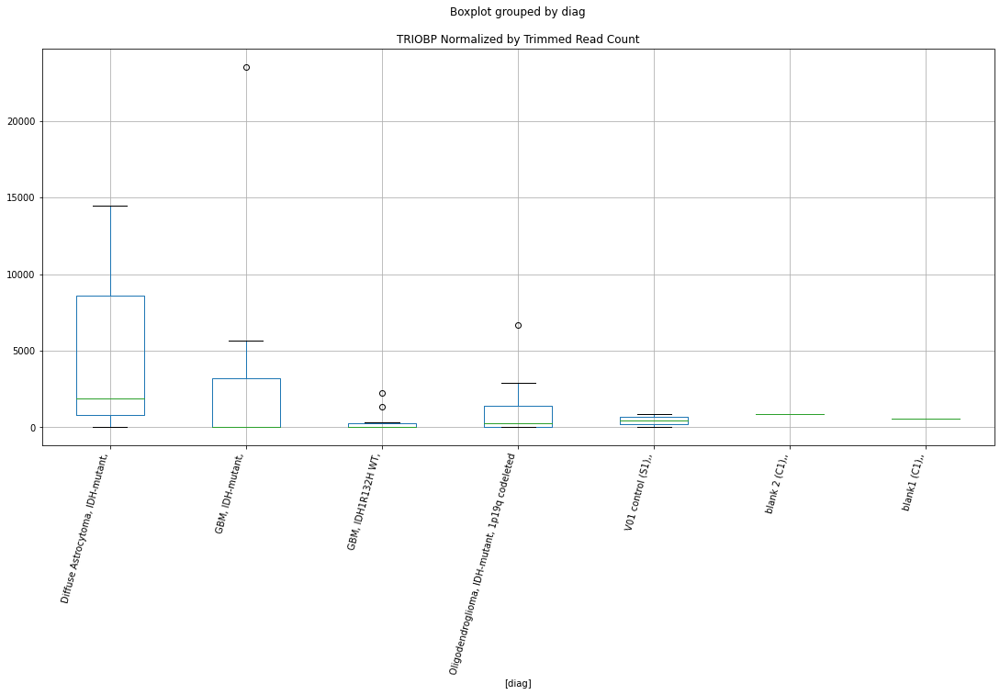

 p : 0.02218921471259887  ( t : 2.5025685636216495 ) :  D-plex  :  bbduk2  :  ZDBF2
Control and blanks
73          0.00
337    128182.65
Name: ZDBF2, dtype: float64
205    5910.0
Name: ZDBF2, dtype: float64
469    8872.91
Name: ZDBF2, dtype: float64


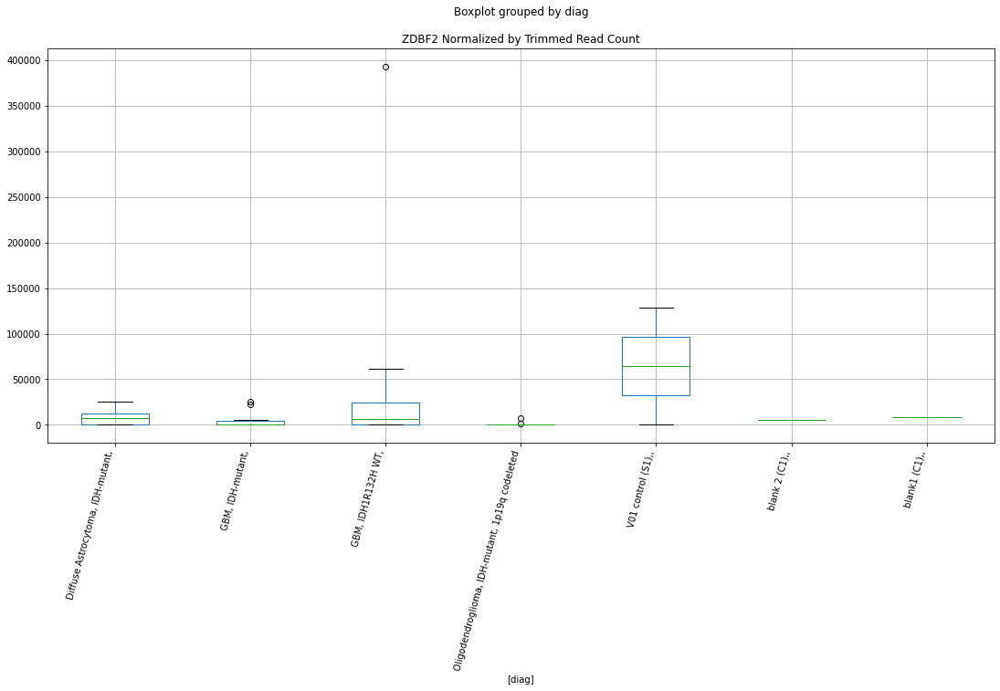

 p : 0.022237641432597904  ( t : 2.5015200215924125 ) :  D-plex  :  bbduk2  :  UBE3D
Control and blanks
73     773.01
337      0.00
Name: UBE3D, dtype: float64
205    2328.18
Name: UBE3D, dtype: float64
469    0.0
Name: UBE3D, dtype: float64


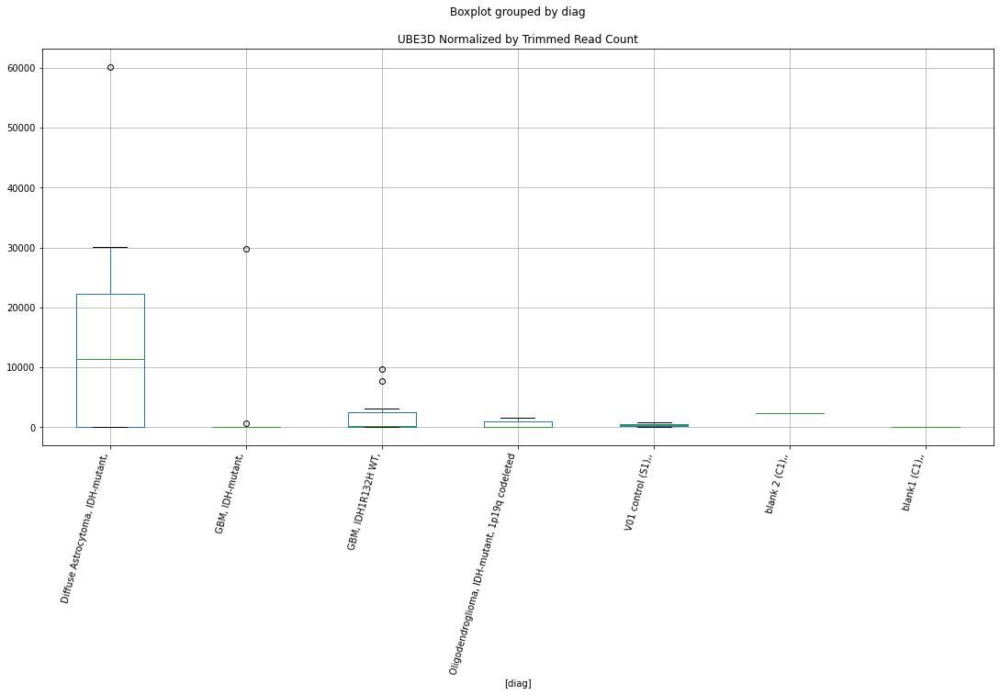

 p : 0.022286308148988673  ( t : 2.5004684488815 ) :  Lexogen  :  bbduk2  :  SPEG
Control and blanks
79        0.00
343    2760.09
Name: SPEG, dtype: float64
211    0.0
Name: SPEG, dtype: float64
475    0.0
Name: SPEG, dtype: float64


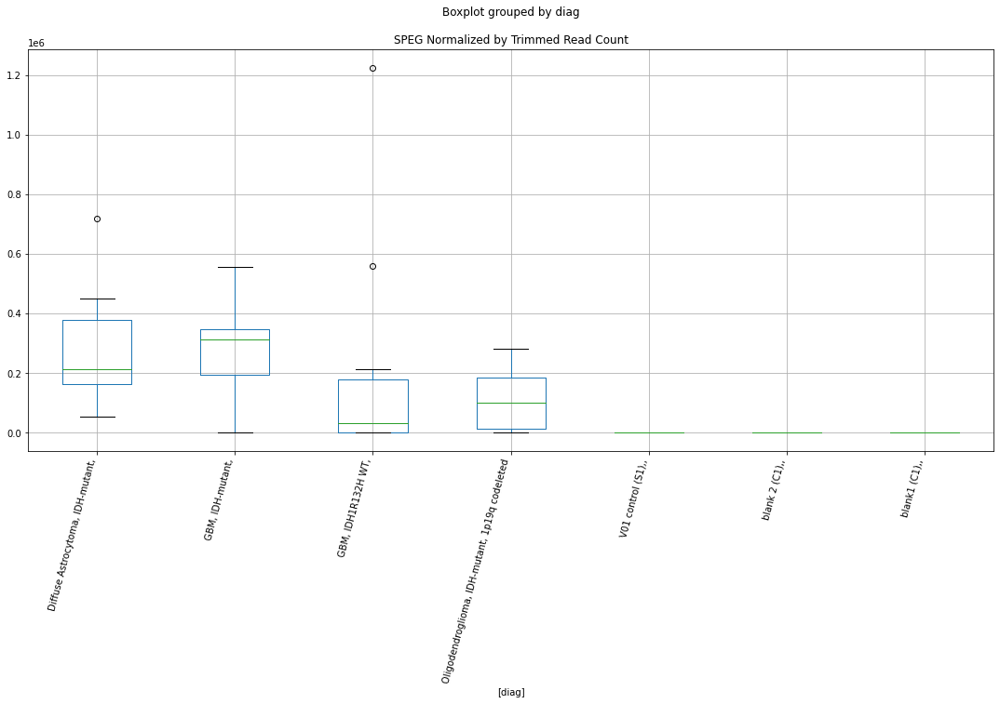

 p : 0.022300812460193428  ( t : 2.5001554635670584 ) :  D-plex  :  cutadapt2  :  USP48
Control and blanks
76     0.0
340    0.0
Name: USP48, dtype: float64
208    176.36
Name: USP48, dtype: float64
472    0.0
Name: USP48, dtype: float64


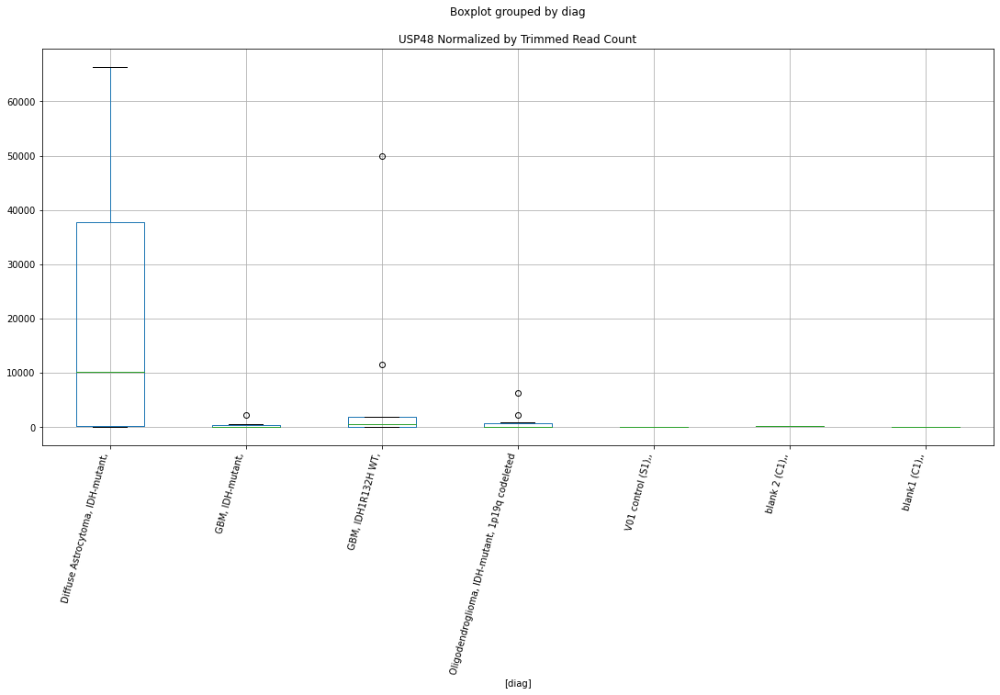

 p : 0.022399234286918385  ( t : 2.4980366939591008 ) :  Lexogen  :  bbduk2  :  TGM1
Control and blanks
79     0.0
343    0.0
Name: TGM1, dtype: float64
211    0.0
Name: TGM1, dtype: float64
475    0.0
Name: TGM1, dtype: float64


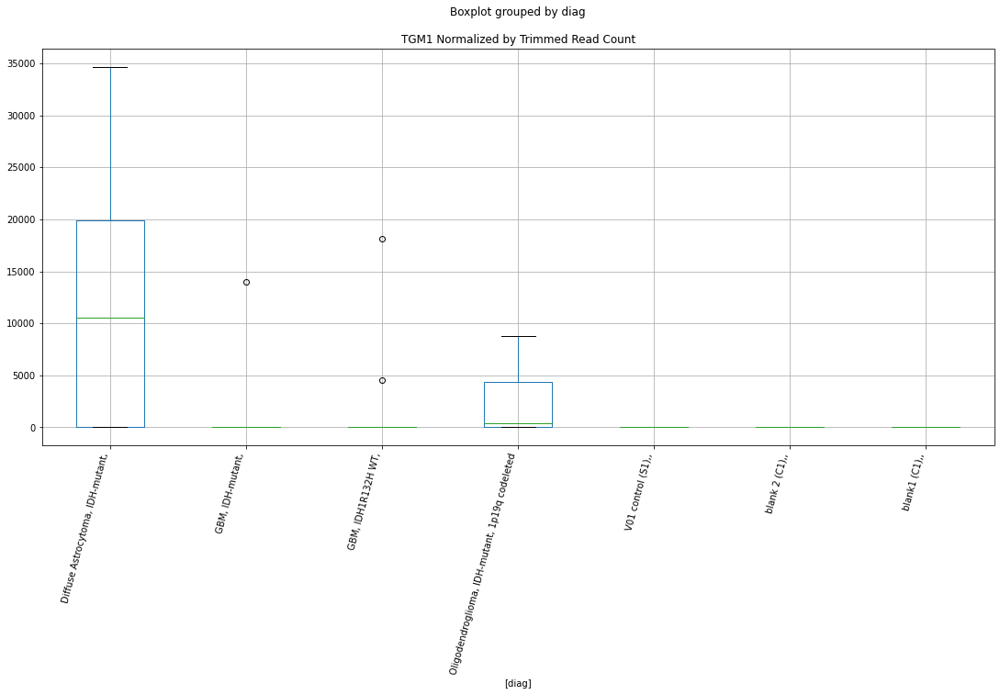

 p : 0.022445424598020017  ( t : 2.4970453576819875 ) :  Lexogen  :  cutadapt2  :  WWC2
Control and blanks
82     0.0
346    0.0
Name: WWC2, dtype: float64
214    0.0
Name: WWC2, dtype: float64
478    474.92
Name: WWC2, dtype: float64


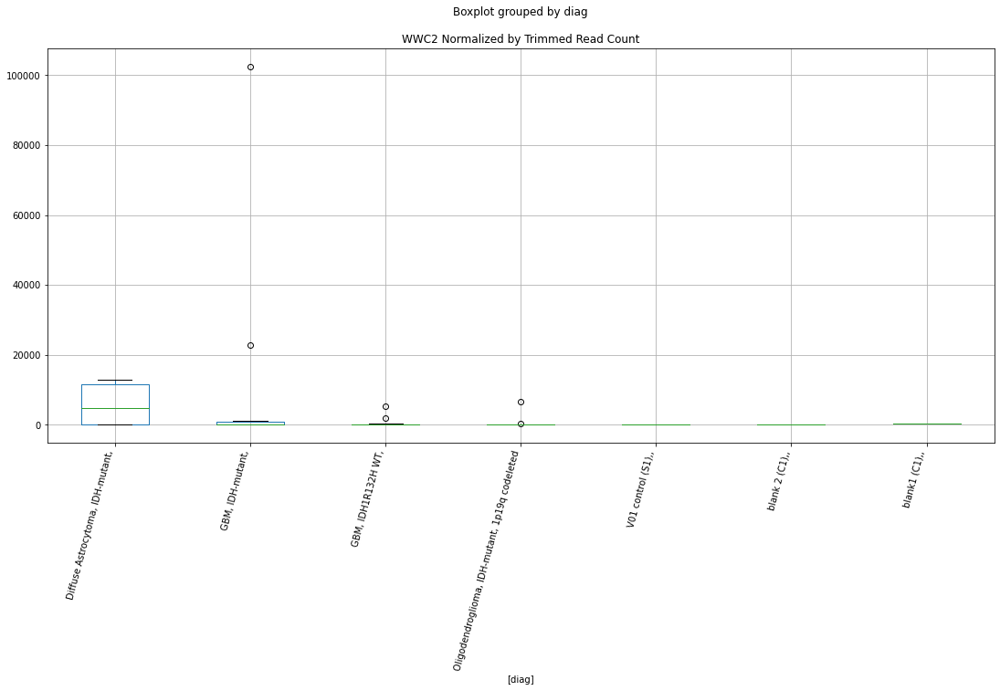

 p : 0.0225934433431237  ( t : 2.4938814770742277 ) :  D-plex  :  cutadapt2  :  TF
Control and blanks
76         0.00
340    44917.34
Name: TF, dtype: float64
208    6348.97
Name: TF, dtype: float64
472    1733.87
Name: TF, dtype: float64


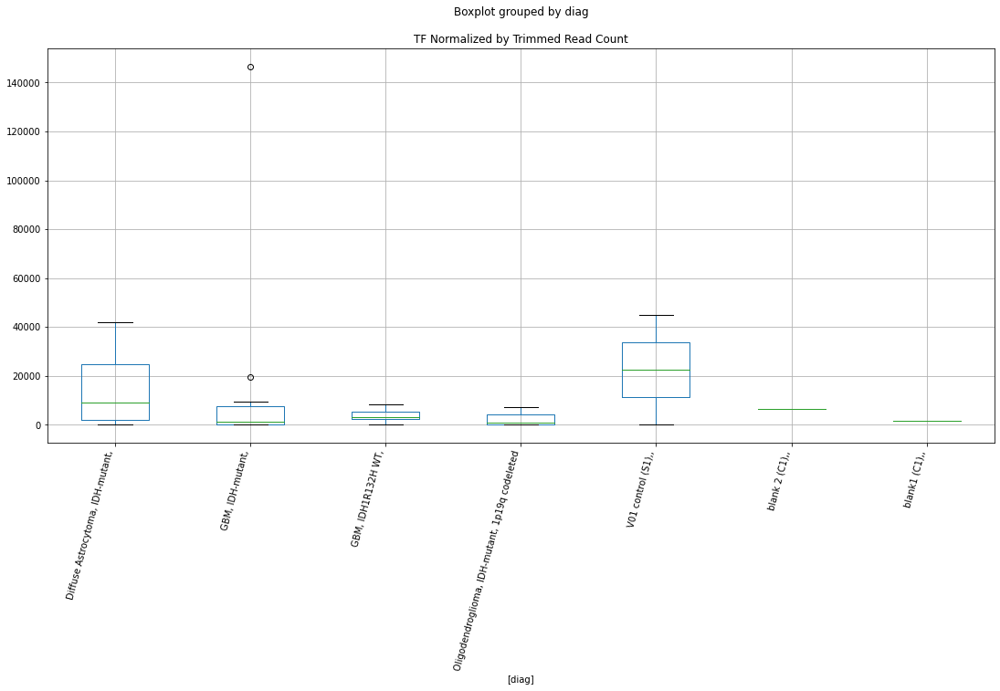

 p : 0.02259892899776337  ( t : 2.493764597541021 ) :  Lexogen  :  bbduk2  :  TRIR
Control and blanks
79     0.0
343    0.0
Name: TRIR, dtype: float64
211    0.0
Name: TRIR, dtype: float64
475    0.0
Name: TRIR, dtype: float64


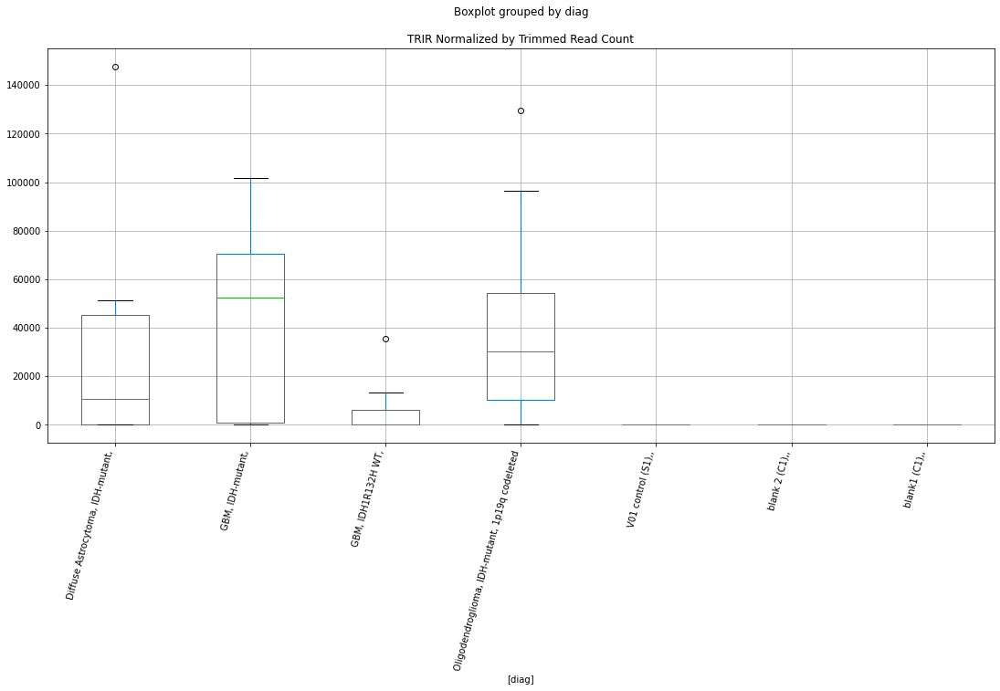

 p : 0.022610381602427895  ( t : 2.493520669912268 ) :  D-plex  :  cutadapt2  :  ZNF2
Control and blanks
76     0.0
340    0.0
Name: ZNF2, dtype: float64
208    1763.6
Name: ZNF2, dtype: float64
472    5779.56
Name: ZNF2, dtype: float64


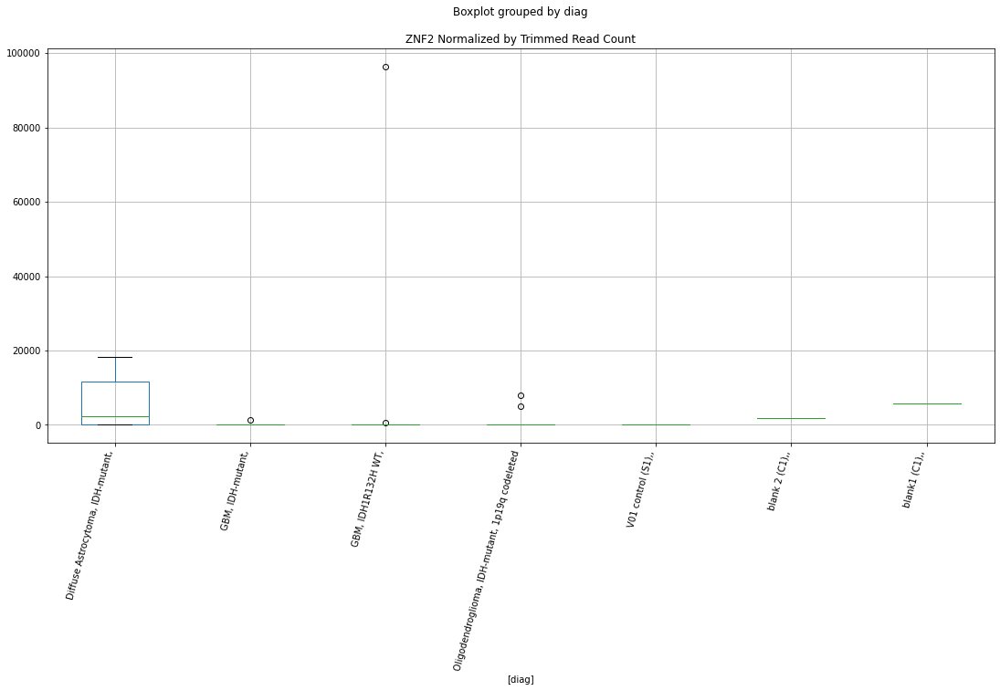

 p : 0.022618294602876763  ( t : 2.4933521998533106 ) :  D-plex  :  bbduk2  :  TMEM132E
Control and blanks
73     0.0
337    0.0
Name: TMEM132E, dtype: float64
205    716.36
Name: TMEM132E, dtype: float64
469    1183.05
Name: TMEM132E, dtype: float64


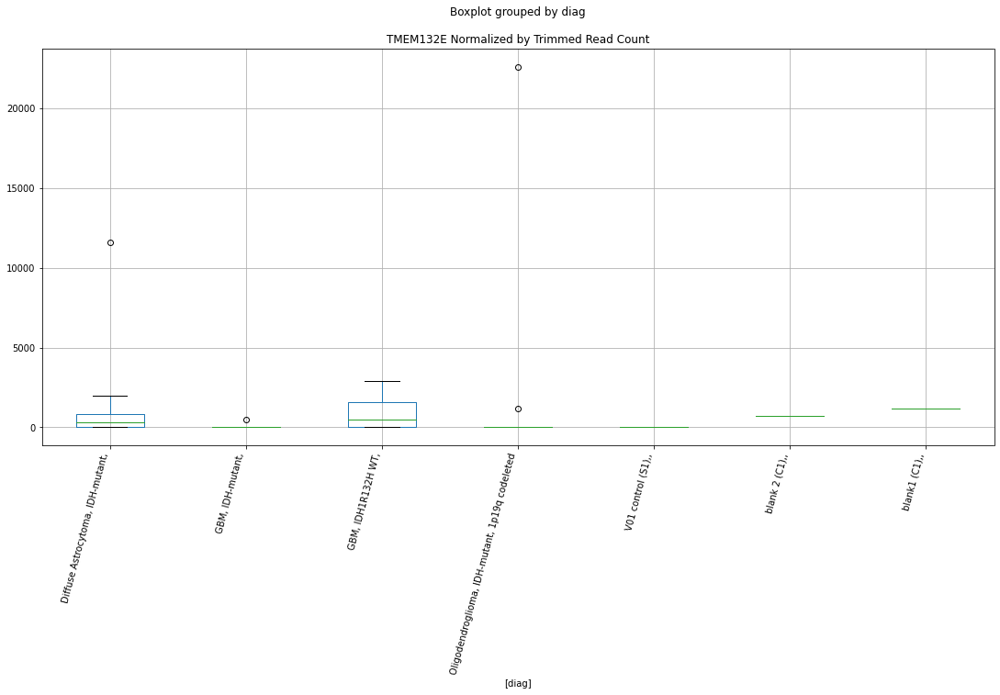

 p : 0.022684659436972867  ( t : 2.4919414544840484 ) :  Lexogen  :  cutadapt2  :  TRIR
Control and blanks
82     0.0
346    0.0
Name: TRIR, dtype: float64
214    0.0
Name: TRIR, dtype: float64
478    0.0
Name: TRIR, dtype: float64


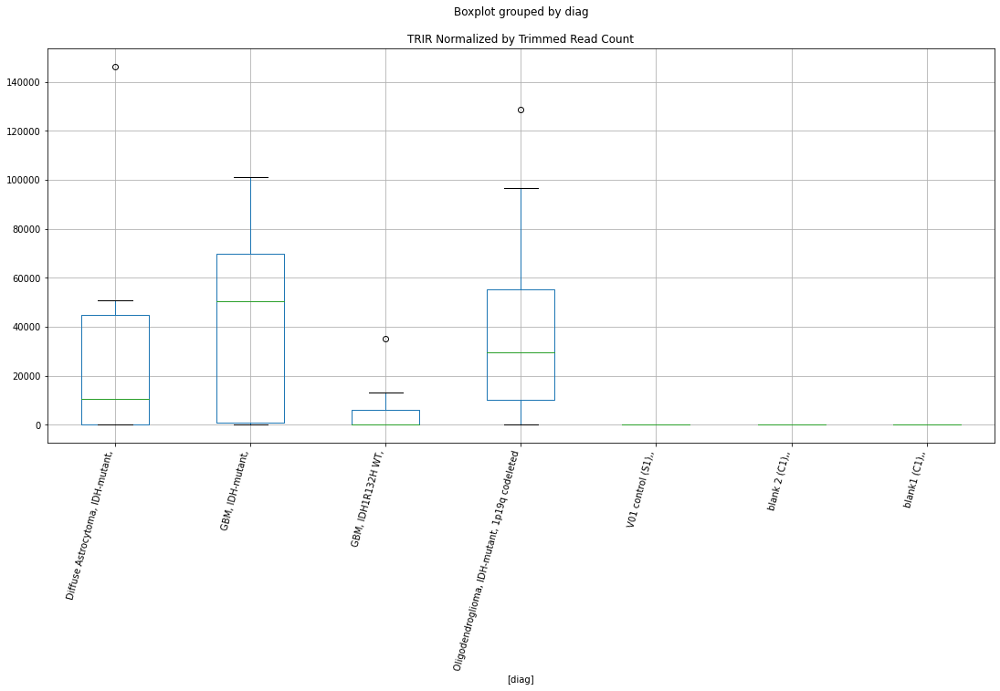

 p : 0.022915050758170425  ( t : 2.4870739135205424 ) :  D-plex  :  bbduk2  :  ZNF879
Control and blanks
73     0.0
337    0.0
Name: ZNF879, dtype: float64
205    1432.73
Name: ZNF879, dtype: float64
469    0.0
Name: ZNF879, dtype: float64


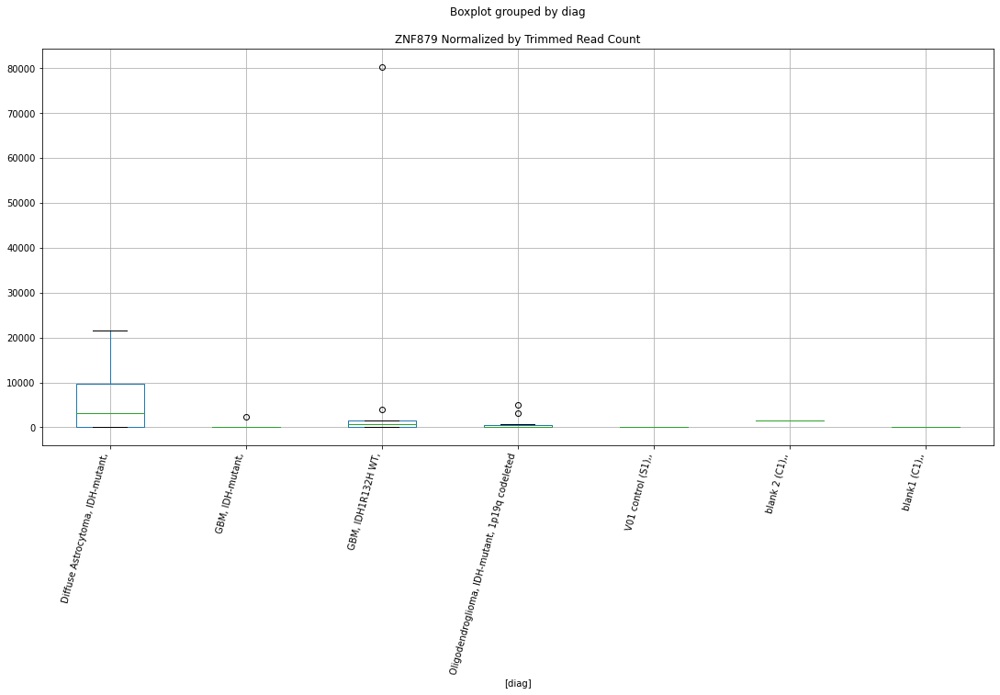

 p : 0.02293717184778888  ( t : 2.4866089824326787 ) :  Lexogen  :  bbduk2  :  TGM4
Control and blanks
79     0.0
343    0.0
Name: TGM4, dtype: float64
211    0.0
Name: TGM4, dtype: float64
475    479.03
Name: TGM4, dtype: float64


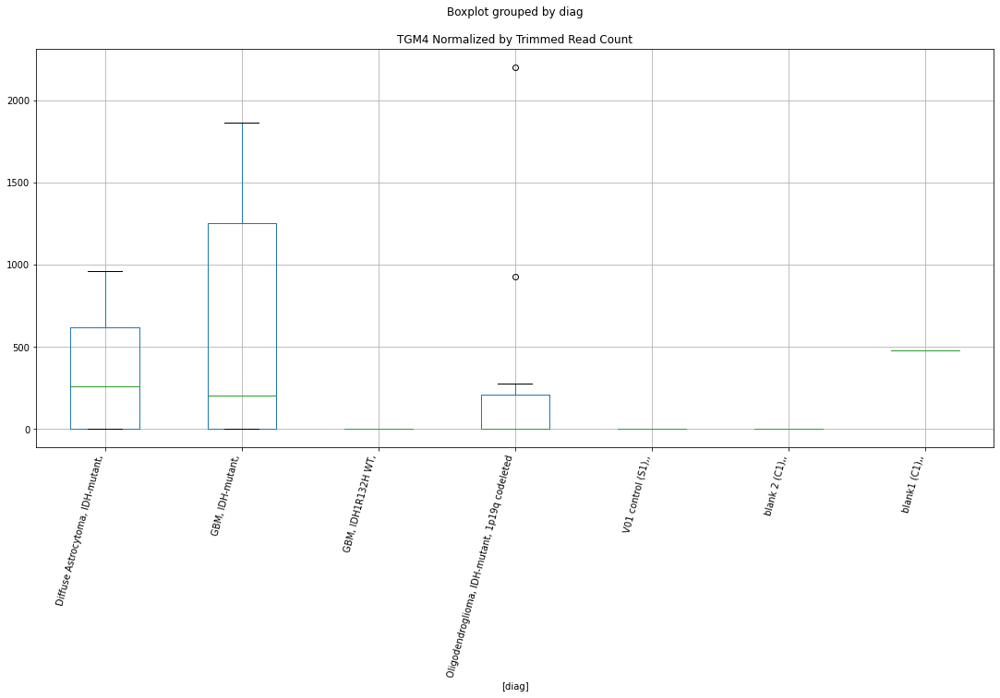

 p : 0.022981896869299183  ( t : 2.4856702601427094 ) :  D-plex  :  bbduk2  :  STK10
Control and blanks
73     63386.69
337    46288.18
Name: STK10, dtype: float64
205    3581.82
Name: STK10, dtype: float64
469    3549.16
Name: STK10, dtype: float64


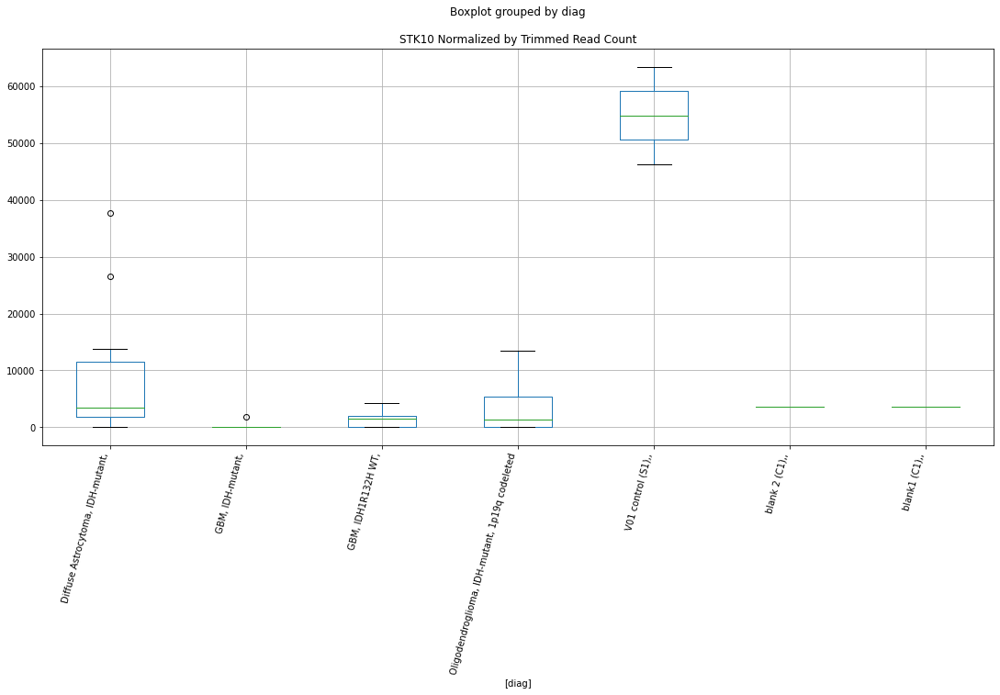

 p : 0.023421932641137795  ( t : 2.4765250426297705 ) :  Lexogen  :  bbduk2  :  WDR19
Control and blanks
79     150212.87
343     44798.32
Name: WDR19, dtype: float64
211    24597.57
Name: WDR19, dtype: float64
475    10778.21
Name: WDR19, dtype: float64


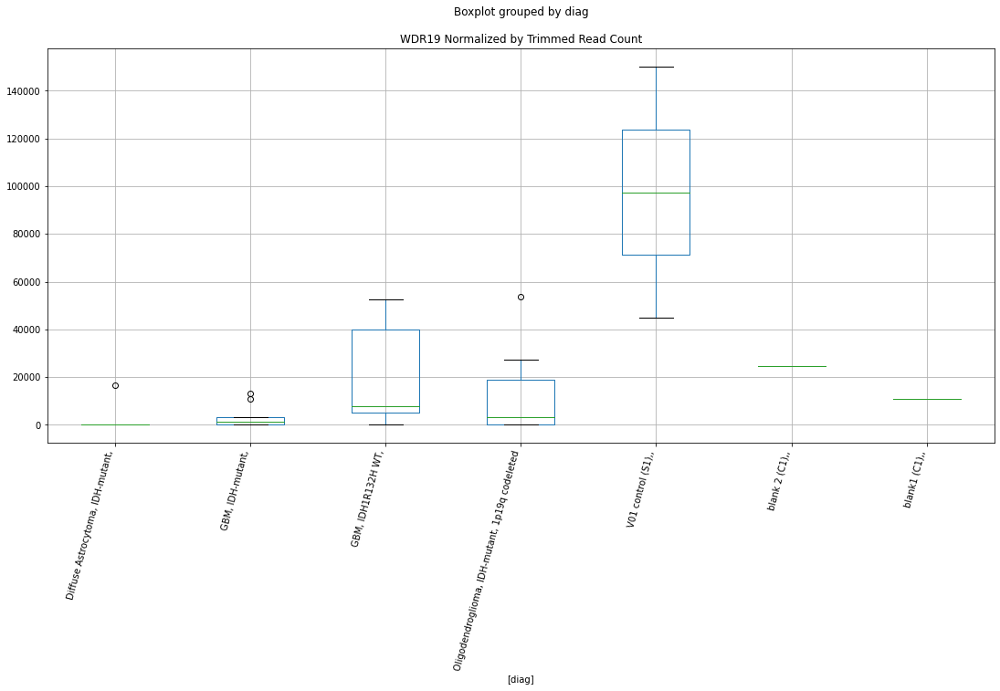

 p : 0.023488895099825827  ( t : 2.475147561572349 ) :  Lexogen  :  cutadapt2  :  TGM1
Control and blanks
82     0.0
346    0.0
Name: TGM1, dtype: float64
214    0.0
Name: TGM1, dtype: float64
478    0.0
Name: TGM1, dtype: float64


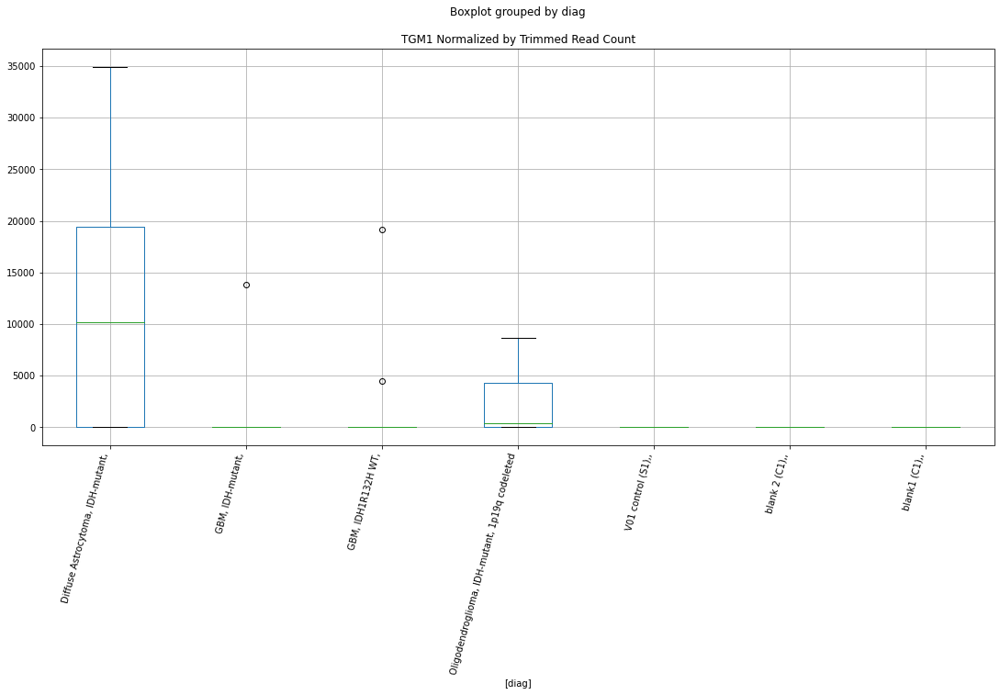

 p : 0.023492364029895102  ( t : 2.4750763030753036 ) :  D-plex  :  cutadapt2  :  ZNF385A
Control and blanks
76     0.0
340    0.0
Name: ZNF385A, dtype: float64
208    19752.34
Name: ZNF385A, dtype: float64
472    36989.17
Name: ZNF385A, dtype: float64


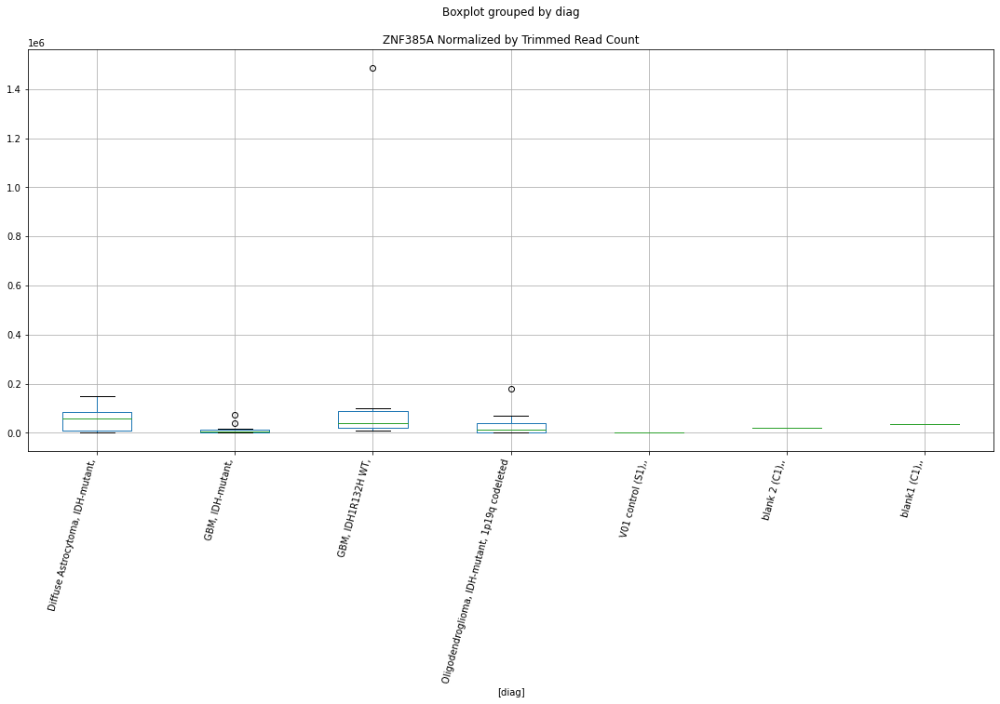

 p : 0.02360426113294339  ( t : 2.4727830134041655 ) :  Lexogen  :  cutadapt2  :  WWC2
Control and blanks
82     0.0
346    0.0
Name: WWC2, dtype: float64
214    0.0
Name: WWC2, dtype: float64
478    474.92
Name: WWC2, dtype: float64


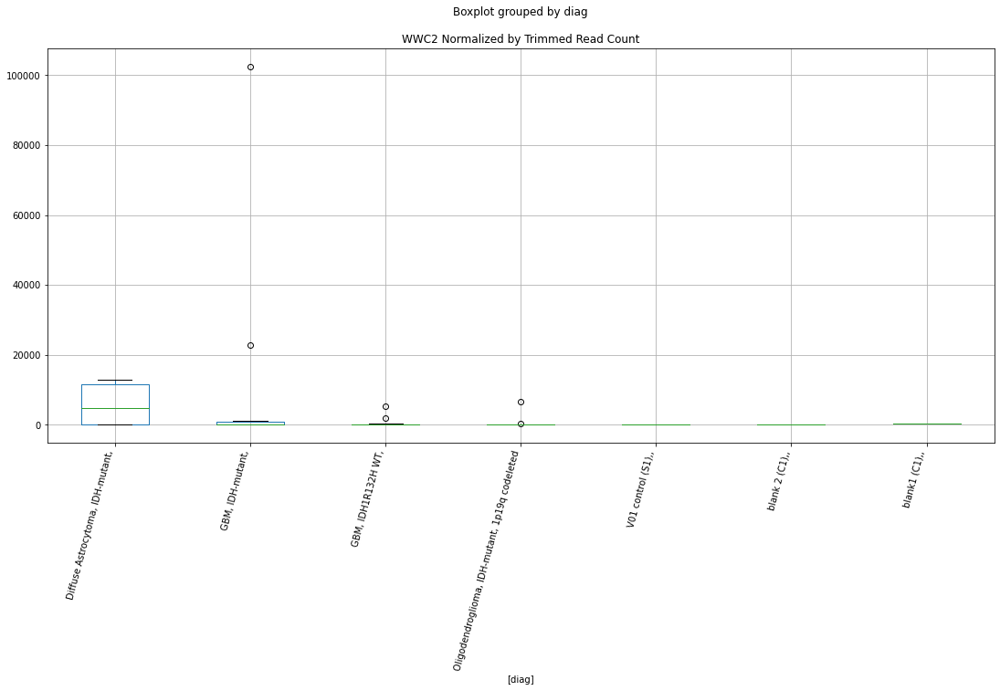

 p : 0.02365656741044667  ( t : 2.4717145201581094 ) :  Lexogen  :  bbduk2  :  UNC13C
Control and blanks
79     0.0
343    0.0
Name: UNC13C, dtype: float64
211    0.0
Name: UNC13C, dtype: float64
475    10299.18
Name: UNC13C, dtype: float64


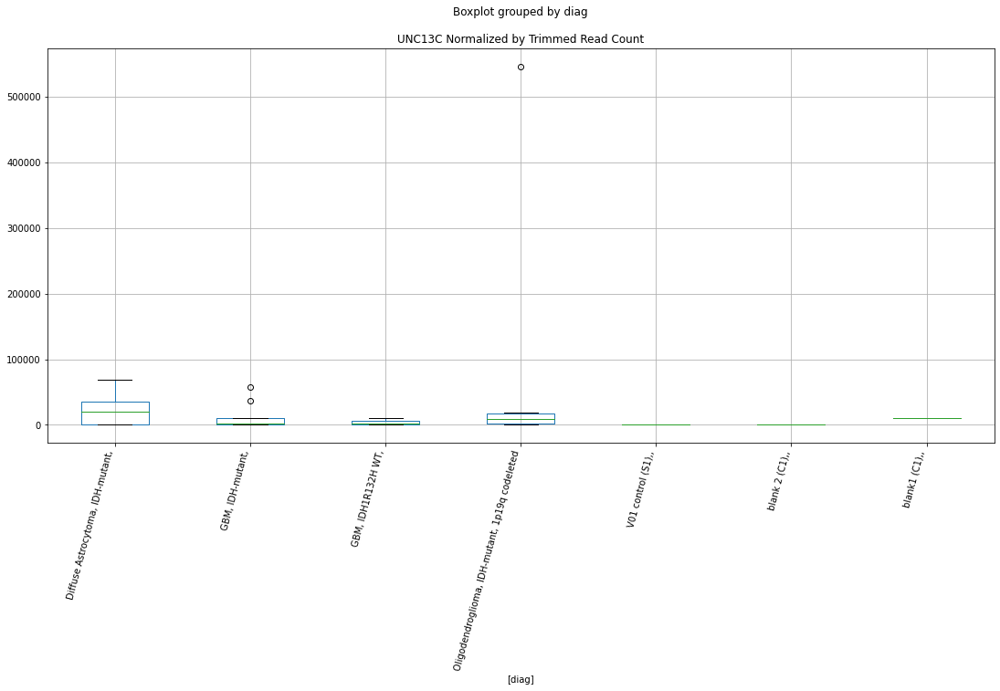

 p : 0.023734400045193036  ( t : 2.47012868910757 ) :  Lexogen  :  bbduk2  :  TLN2
Control and blanks
79     30042.57
343    31422.52
Name: TLN2, dtype: float64
211    12025.48
Name: TLN2, dtype: float64
475    11017.72
Name: TLN2, dtype: float64


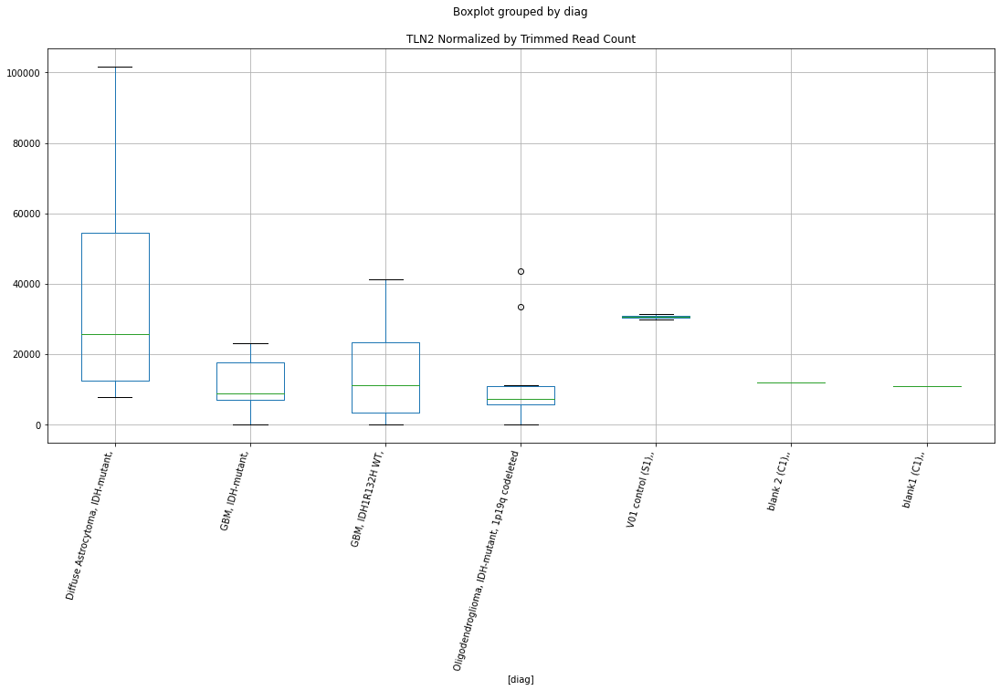

 p : 0.023774380364821903  ( t : 2.4693159946207417 ) :  D-plex  :  bbduk2  :  ZNF385A
Control and blanks
73     0.0
337    0.0
Name: ZNF385A, dtype: float64
205    20058.19
Name: ZNF385A, dtype: float64
469    37857.75
Name: ZNF385A, dtype: float64


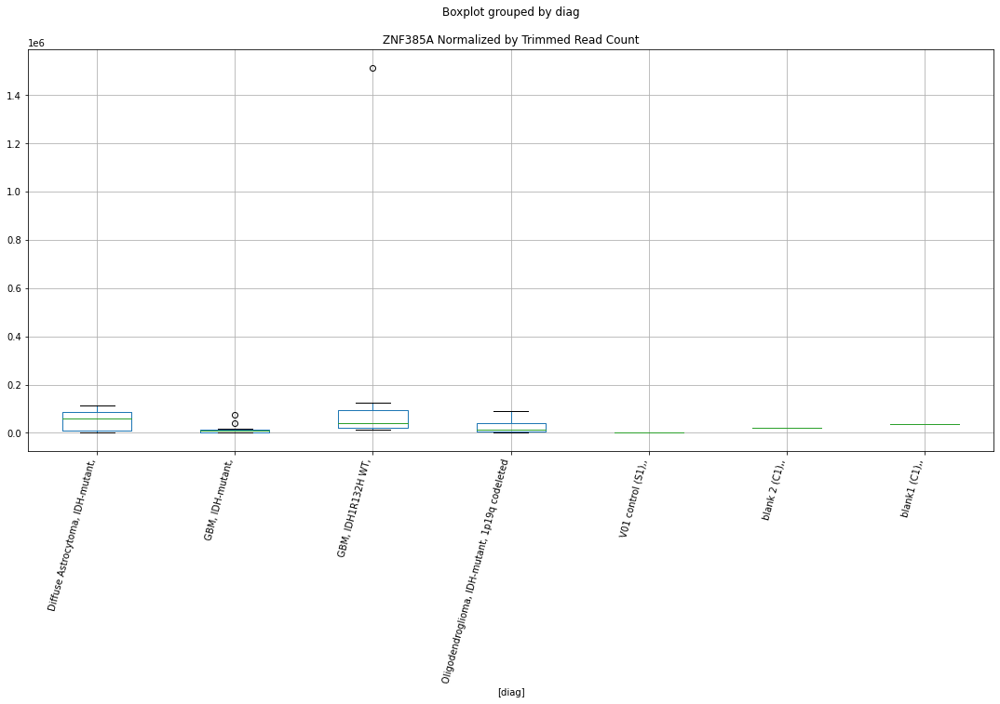

 p : 0.024156296182304297  ( t : 2.4616167577366967 ) :  D-plex  :  bbduk2  :  TRIM59-IFT80
Control and blanks
73      6957.08
337    42727.55
Name: TRIM59-IFT80, dtype: float64
205    41011.83
Name: TRIM59-IFT80, dtype: float64
469    41998.44
Name: TRIM59-IFT80, dtype: float64


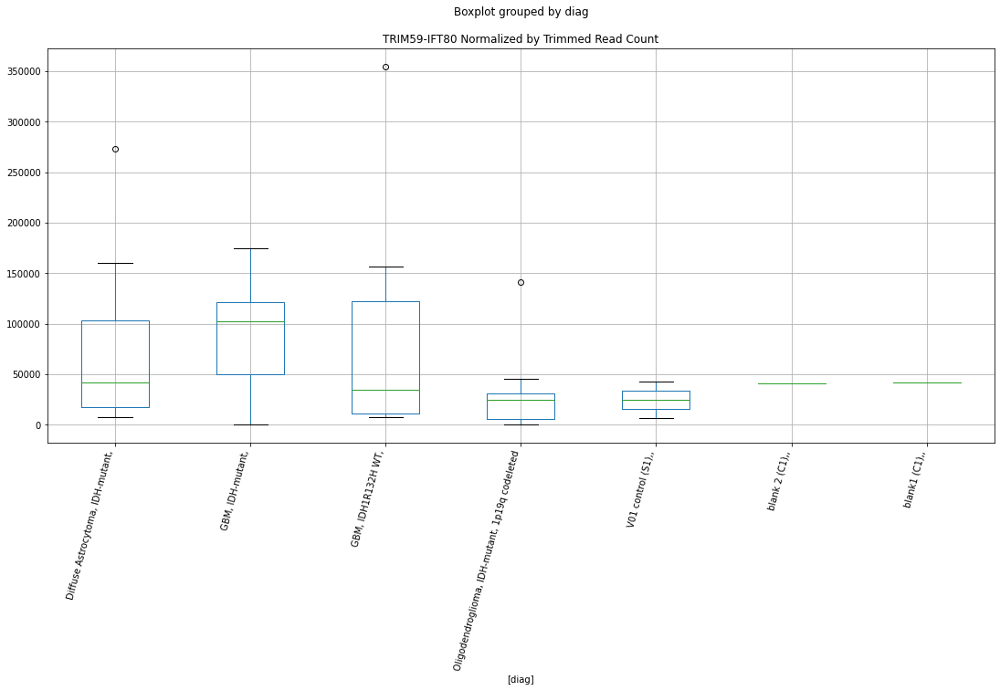

 p : 0.024212038742117244  ( t : 2.460502594248061 ) :  D-plex  :  cutadapt2  :  ZDHHC18
Control and blanks
76       0.00
340    880.73
Name: ZDHHC18, dtype: float64
208    705.44
Name: ZDHHC18, dtype: float64
472    0.0
Name: ZDHHC18, dtype: float64


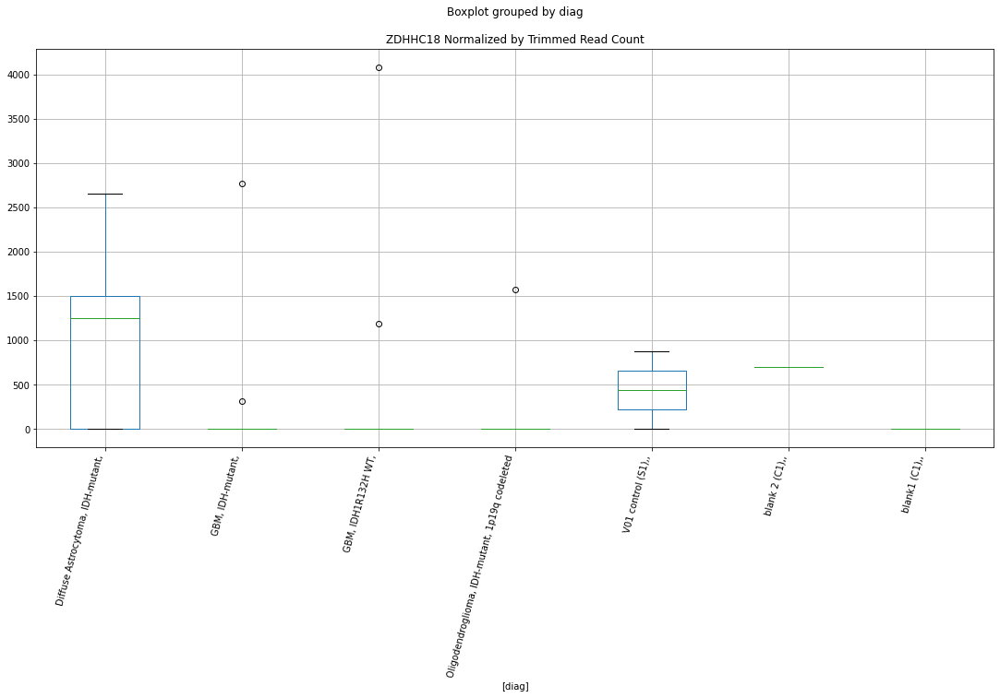

 p : 0.024233564968881884  ( t : 2.460072980226722 ) :  Lexogen  :  cutadapt2  :  VCL
Control and blanks
82         0.0
346    23147.8
Name: VCL, dtype: float64
214    7051.89
Name: VCL, dtype: float64
478    64114.33
Name: VCL, dtype: float64


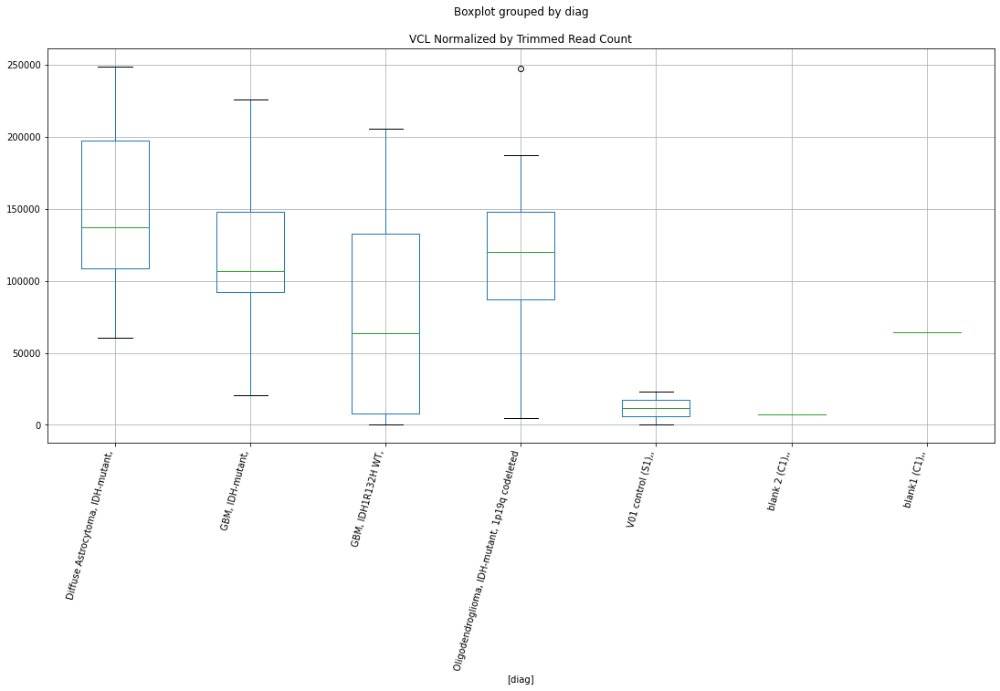

 p : 0.02429488698735275  ( t : 2.4588510961520806 ) :  Lexogen  :  bbduk2  :  ZNF865
Control and blanks
79     0.0
343    0.0
Name: ZNF865, dtype: float64
211    0.0
Name: ZNF865, dtype: float64
475    0.0
Name: ZNF865, dtype: float64


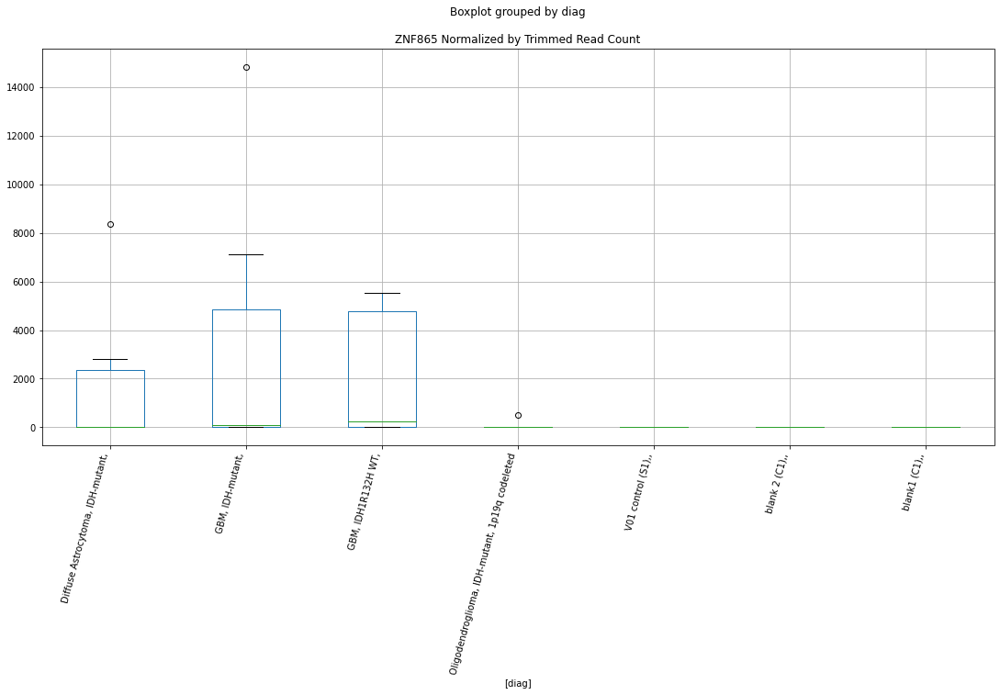

 p : 0.02431982335903227  ( t : 2.4583550499838345 ) :  Lexogen  :  bbduk2  :  TRPS1
Control and blanks
79         0.00
343    15286.63
Name: TRPS1, dtype: float64
211    19678.06
Name: TRPS1, dtype: float64
475    4311.28
Name: TRPS1, dtype: float64


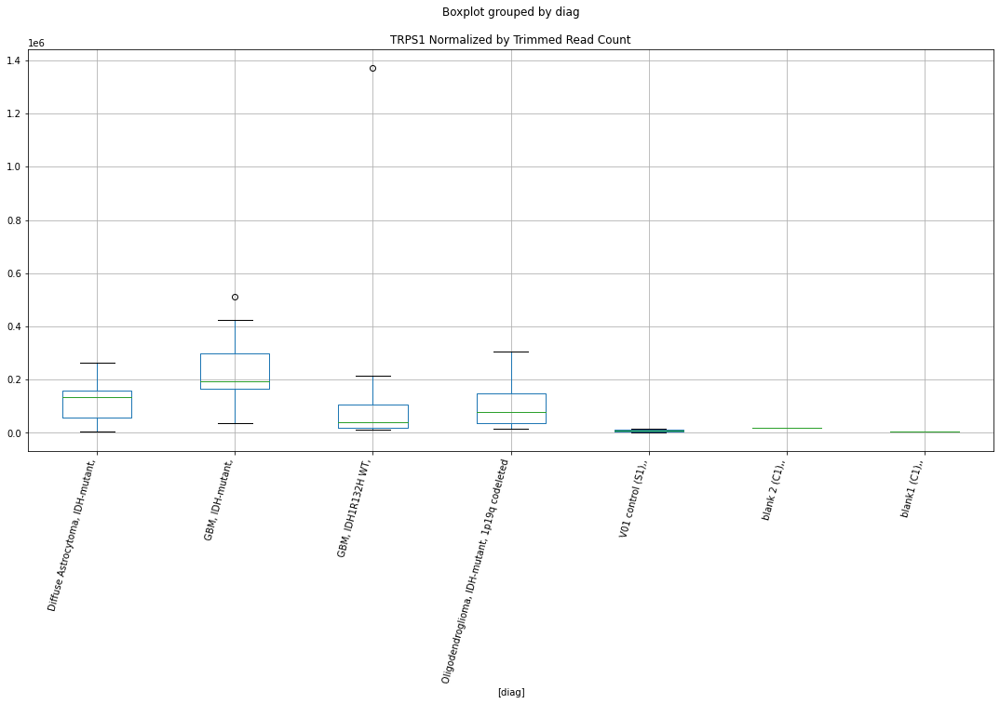

 p : 0.024341090404161776  ( t : 2.4579323731634104 ) :  D-plex  :  cutadapt2  :  TESC
Control and blanks
76     0.0
340    0.0
Name: TESC, dtype: float64
208    0.0
Name: TESC, dtype: float64
472    3467.74
Name: TESC, dtype: float64


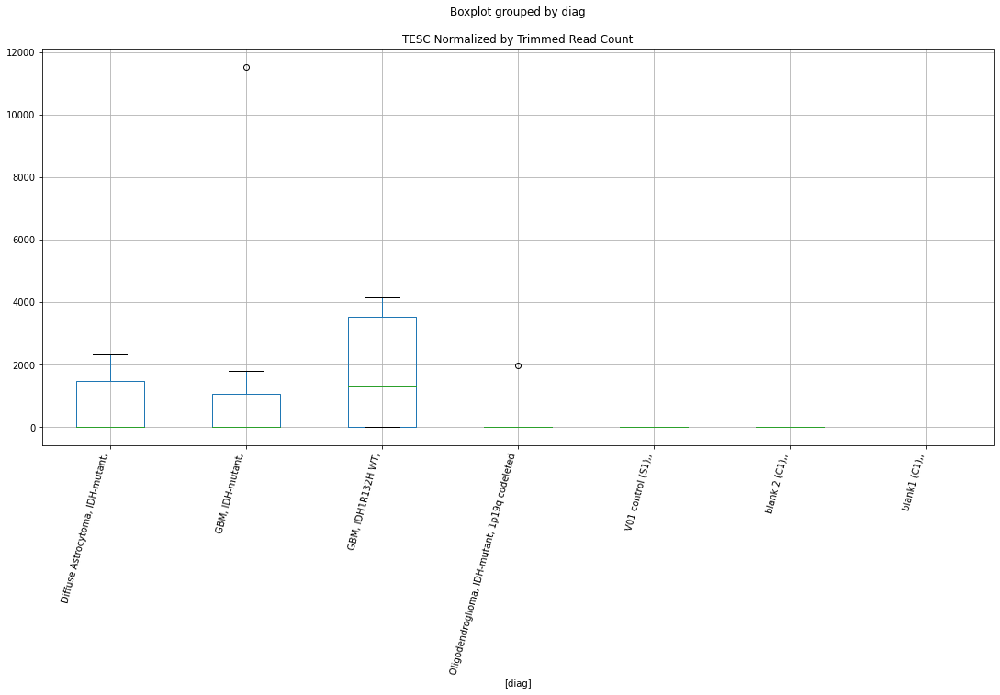

 p : 0.024369595869655244  ( t : 2.4573663784447906 ) :  Lexogen  :  bbduk2  :  TBC1D2B
Control and blanks
79     0.0
343    0.0
Name: TBC1D2B, dtype: float64
211    0.0
Name: TBC1D2B, dtype: float64
475    0.0
Name: TBC1D2B, dtype: float64


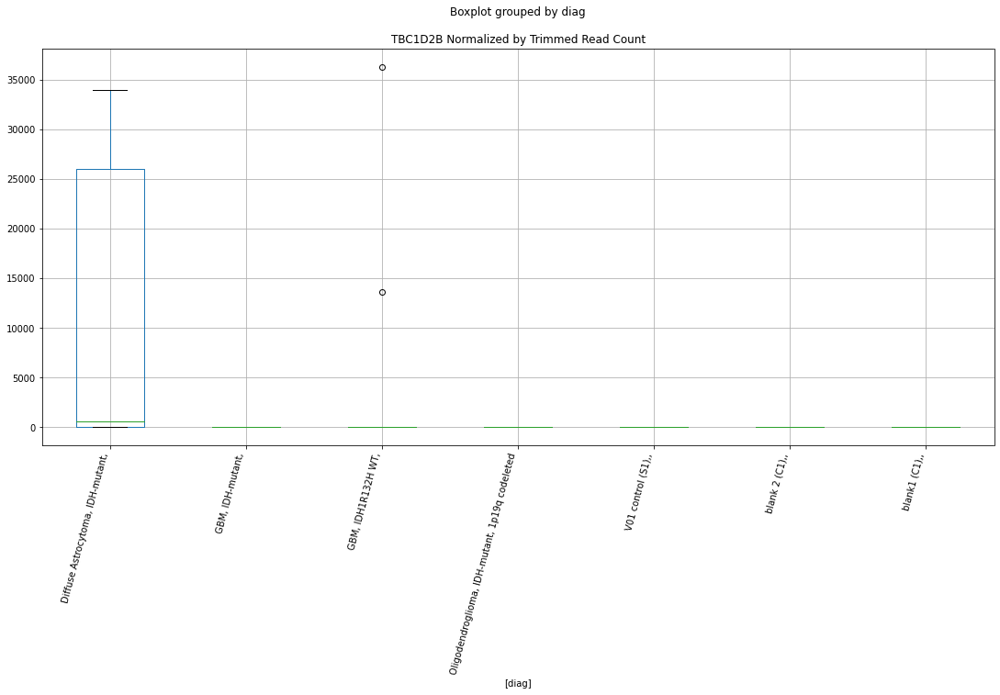

 p : 0.02437057367480563  ( t : 2.4573469745158527 ) :  Lexogen  :  bbduk2  :  WWC2
Control and blanks
79        0.00
343    1273.89
Name: WWC2, dtype: float64
211    0.0
Name: WWC2, dtype: float64
475    958.06
Name: WWC2, dtype: float64


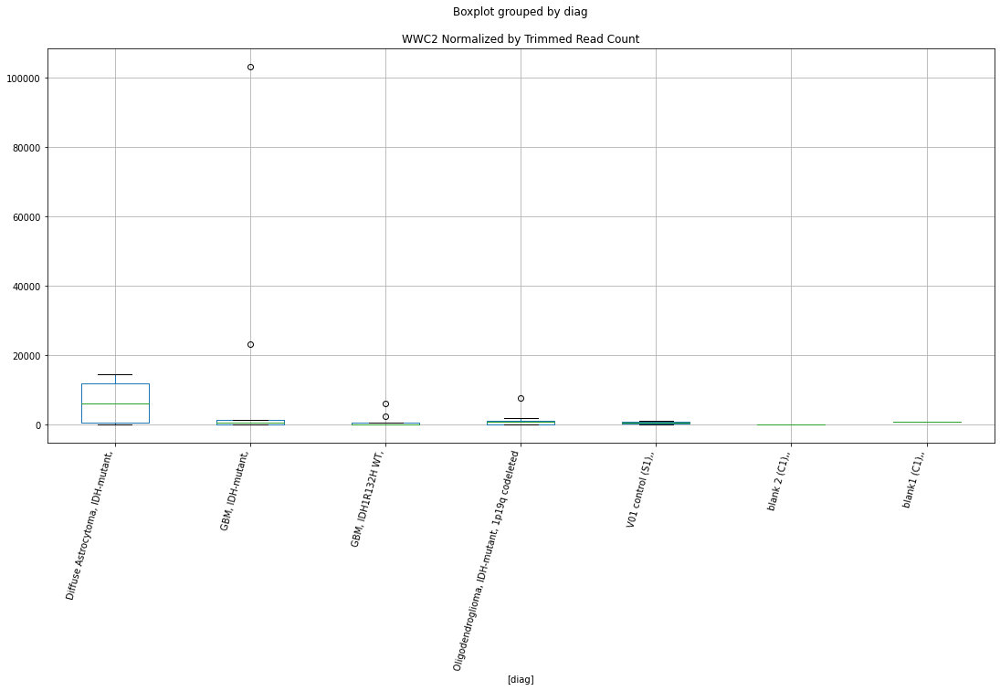

 p : 0.024375211482698063  ( t : 2.4572549500905647 ) :  Lexogen  :  cutadapt2  :  TBC1D2B
Control and blanks
82     0.0
346    0.0
Name: TBC1D2B, dtype: float64
214    0.0
Name: TBC1D2B, dtype: float64
478    0.0
Name: TBC1D2B, dtype: float64


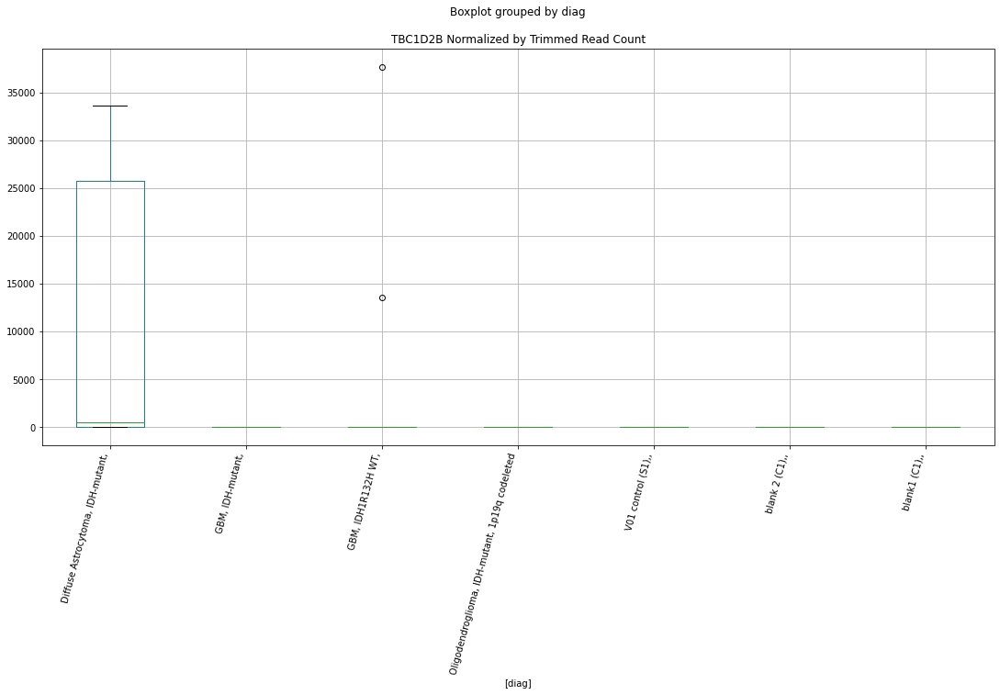

 p : 0.024480239774977063  ( t : 2.455175346297906 ) :  D-plex  :  cutadapt2  :  THSD4
Control and blanks
76        0.00
340    8807.32
Name: THSD4, dtype: float64
208    3174.48
Name: THSD4, dtype: float64
472    26585.97
Name: THSD4, dtype: float64


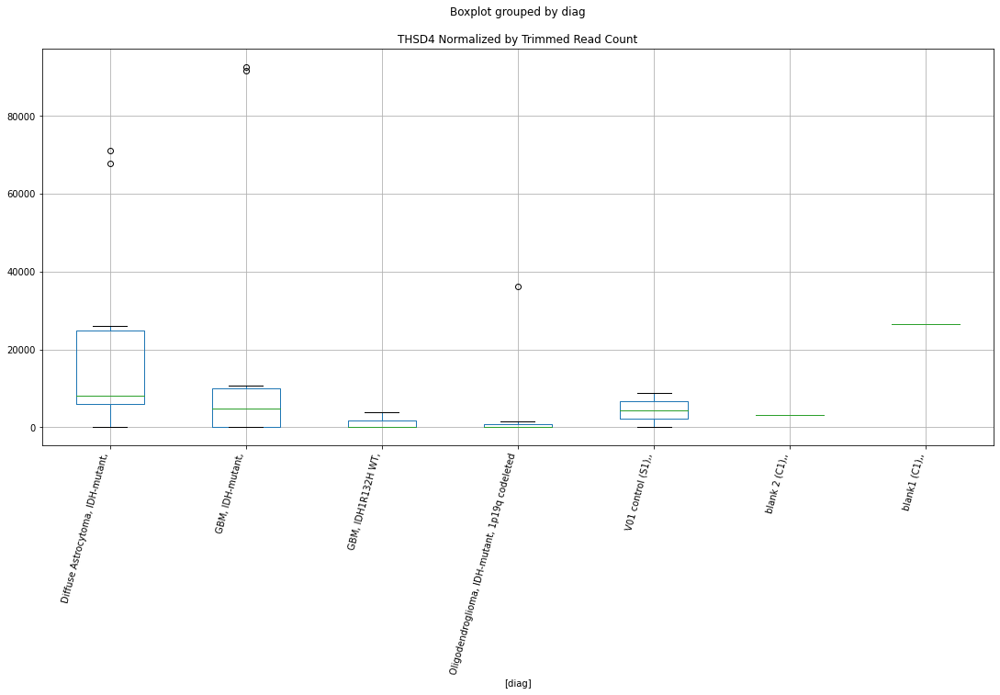

 p : 0.024863961106217337  ( t : 2.447648064966642 ) :  Lexogen  :  bbduk2  :  VCL
Control and blanks
79         0.00
343    23354.57
Name: VCL, dtype: float64
211    7105.96
Name: VCL, dtype: float64
475    64669.25
Name: VCL, dtype: float64


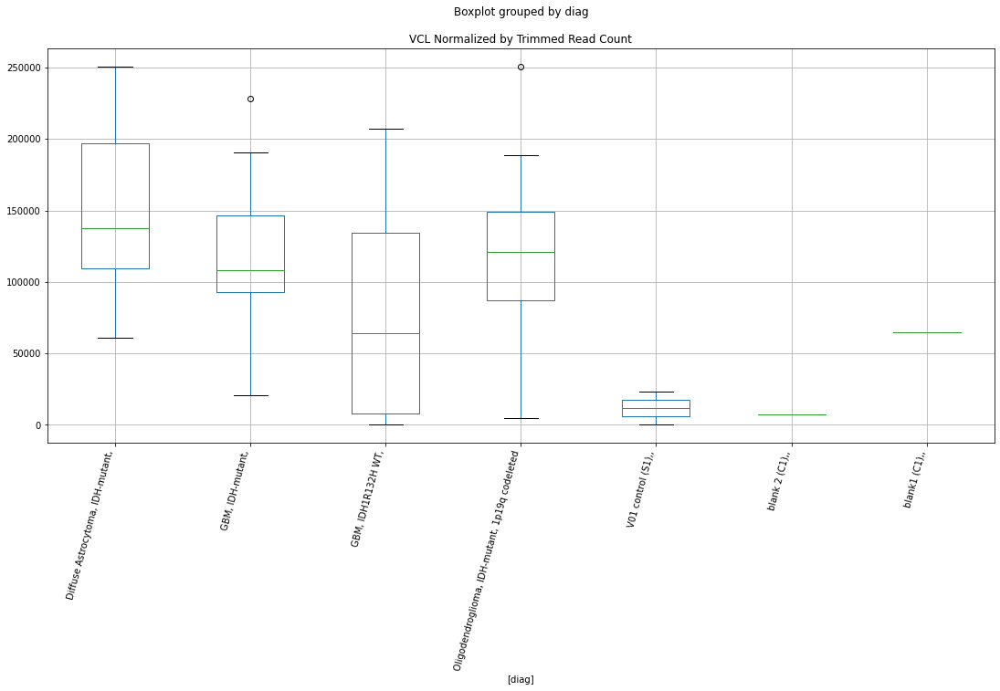

 p : 0.02487561530233621  ( t : 2.4474211606285476 ) :  D-plex  :  cutadapt2  :  TNFAIP8
Control and blanks
76     0.0
340    0.0
Name: TNFAIP8, dtype: float64
208    3527.2
Name: TNFAIP8, dtype: float64
472    1733.87
Name: TNFAIP8, dtype: float64


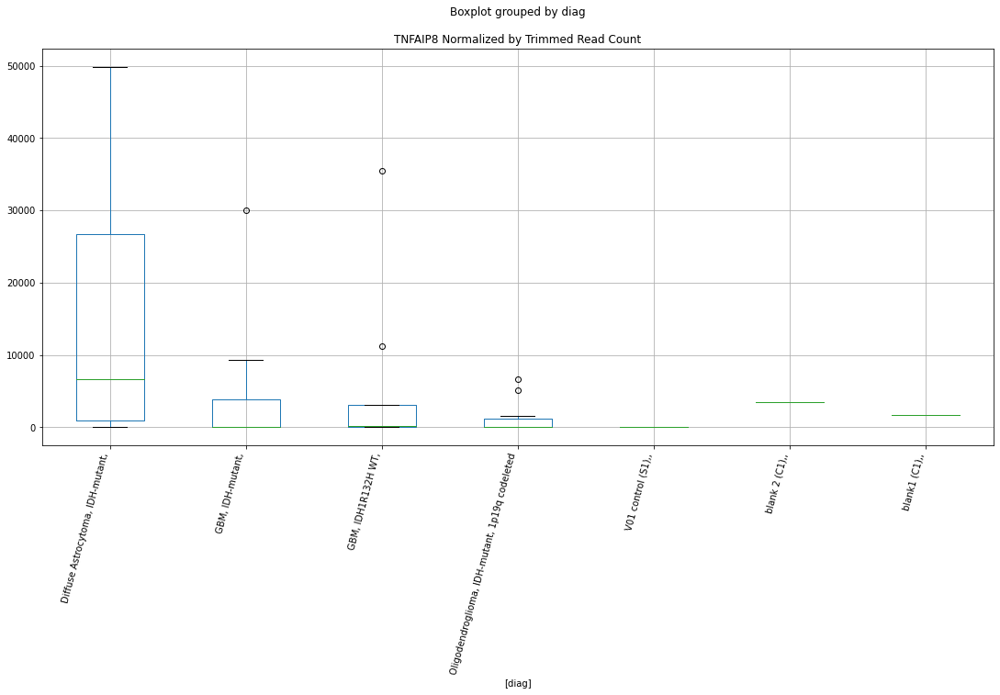

 p : 0.024894295193485055  ( t : 2.4470576757783493 ) :  D-plex  :  bbduk2  :  ZNF507
Control and blanks
73         0.00
337    17803.15
Name: ZNF507, dtype: float64
205    2149.09
Name: ZNF507, dtype: float64
469    1183.05
Name: ZNF507, dtype: float64


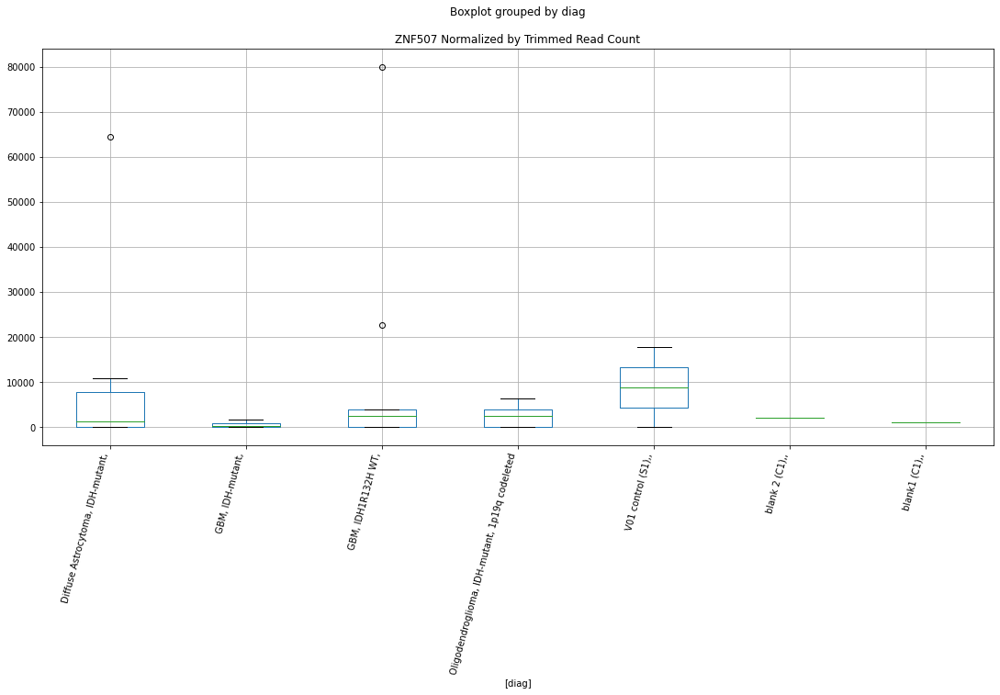

 p : 0.024915721122022588  ( t : 2.446641071906983 ) :  D-plex  :  bbduk2  :  TNPO2
Control and blanks
73     0.0
337    0.0
Name: TNPO2, dtype: float64
205    3223.64
Name: TNPO2, dtype: float64
469    1774.58
Name: TNPO2, dtype: float64


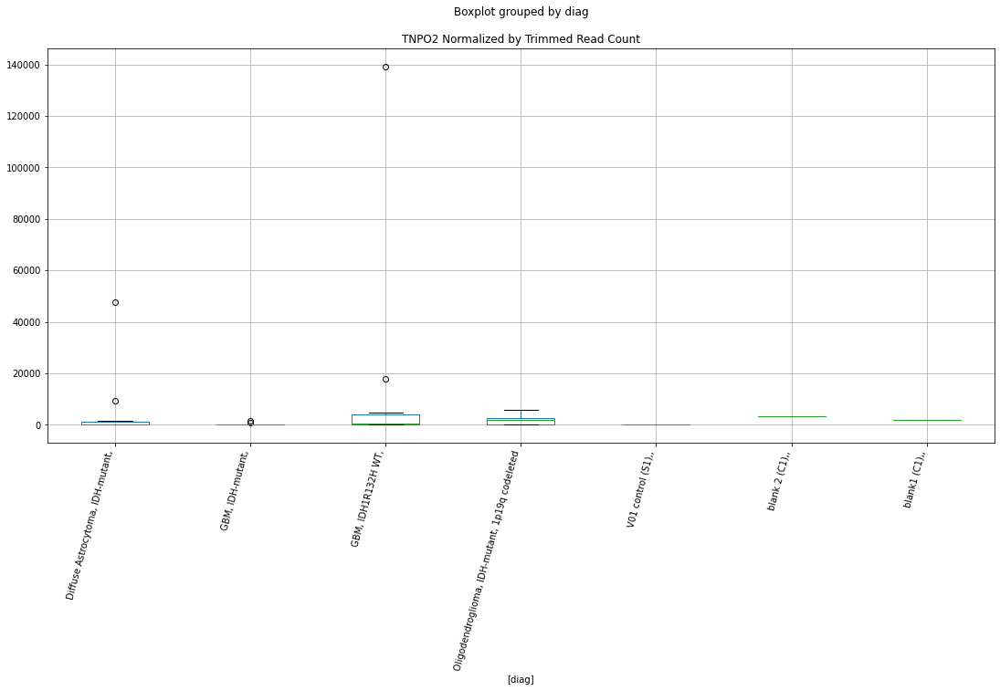

 p : 0.024932486883498466  ( t : 2.44631531433594 ) :  D-plex  :  bbduk2  :  USP10
Control and blanks
73     0.0
337    0.0
Name: USP10, dtype: float64
205    4656.36
Name: USP10, dtype: float64
469    37266.22
Name: USP10, dtype: float64


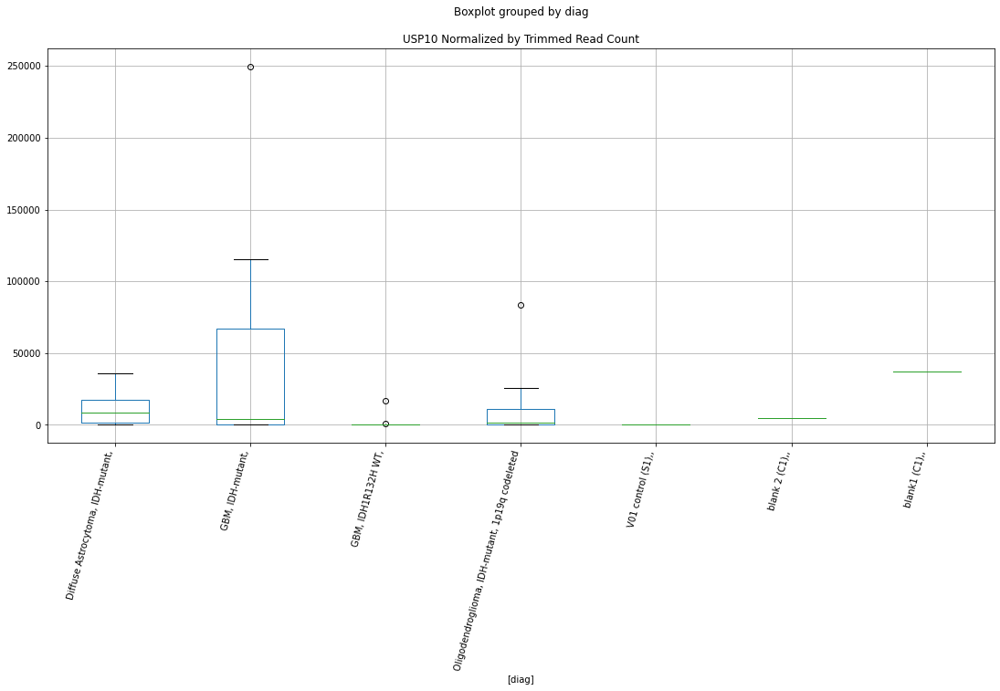

 p : 0.024975170332154076  ( t : 2.4454869049255064 ) :  D-plex  :  bbduk2  :  TRIOBP
Control and blanks
73       0.00
337    890.16
Name: TRIOBP, dtype: float64
205    1432.73
Name: TRIOBP, dtype: float64
469    591.53
Name: TRIOBP, dtype: float64


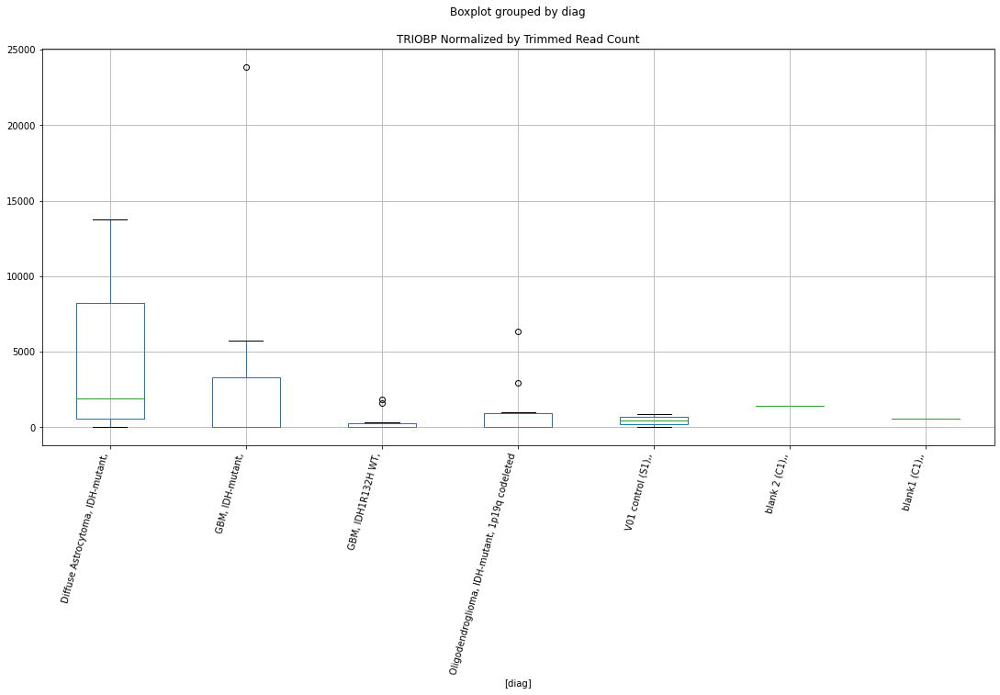

 p : 0.02512836910853617  ( t : 2.442524492360564 ) :  D-plex  :  cutadapt2  :  TRIM59-IFT80
Control and blanks
76      9091.37
340    42275.14
Name: TRIM59-IFT80, dtype: float64
208    40033.77
Name: TRIM59-IFT80, dtype: float64
472    41612.82
Name: TRIM59-IFT80, dtype: float64


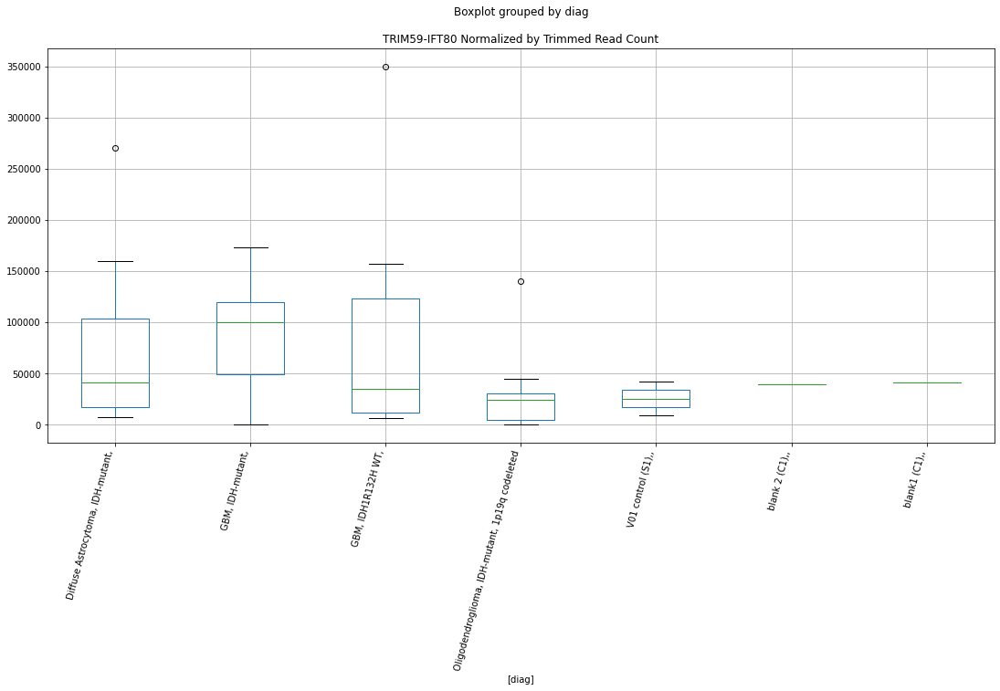

 p : 0.025315939945986004  ( t : 2.438920413590256 ) :  Lexogen  :  bbduk2  :  TPM1-AS
Control and blanks
79     0.0
343    0.0
Name: TPM1-AS, dtype: float64
211    0.0
Name: TPM1-AS, dtype: float64
475    0.0
Name: TPM1-AS, dtype: float64


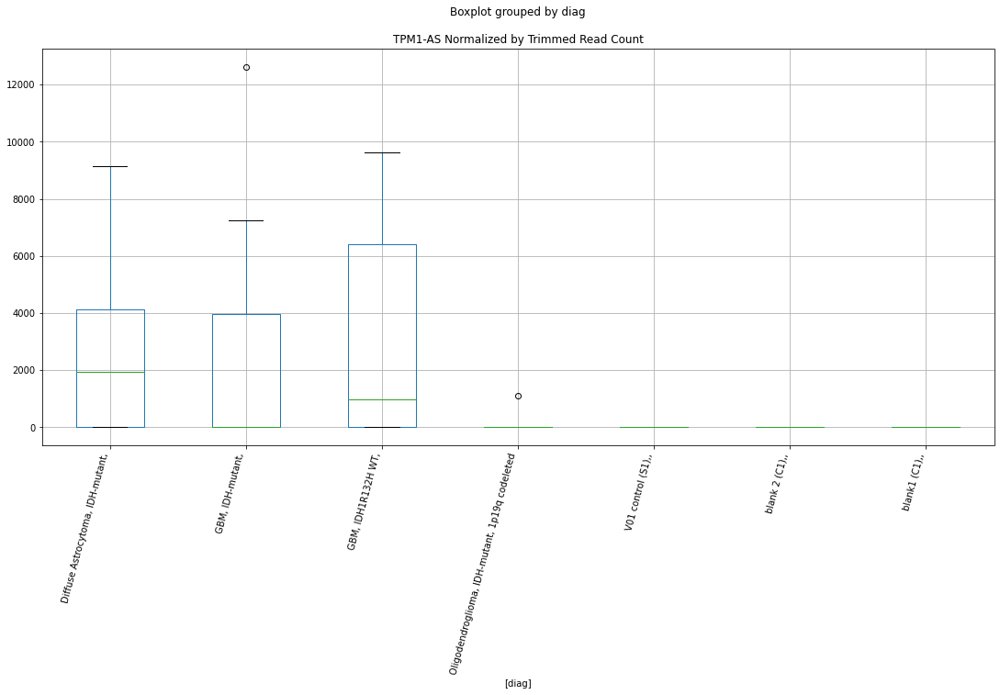

 p : 0.02534426336668322  ( t : 2.4383783714422513 ) :  Lexogen  :  cutadapt2  :  TMCO6
Control and blanks
82     0.0
346    0.0
Name: TMCO6, dtype: float64
214    0.0
Name: TMCO6, dtype: float64
478    0.0
Name: TMCO6, dtype: float64


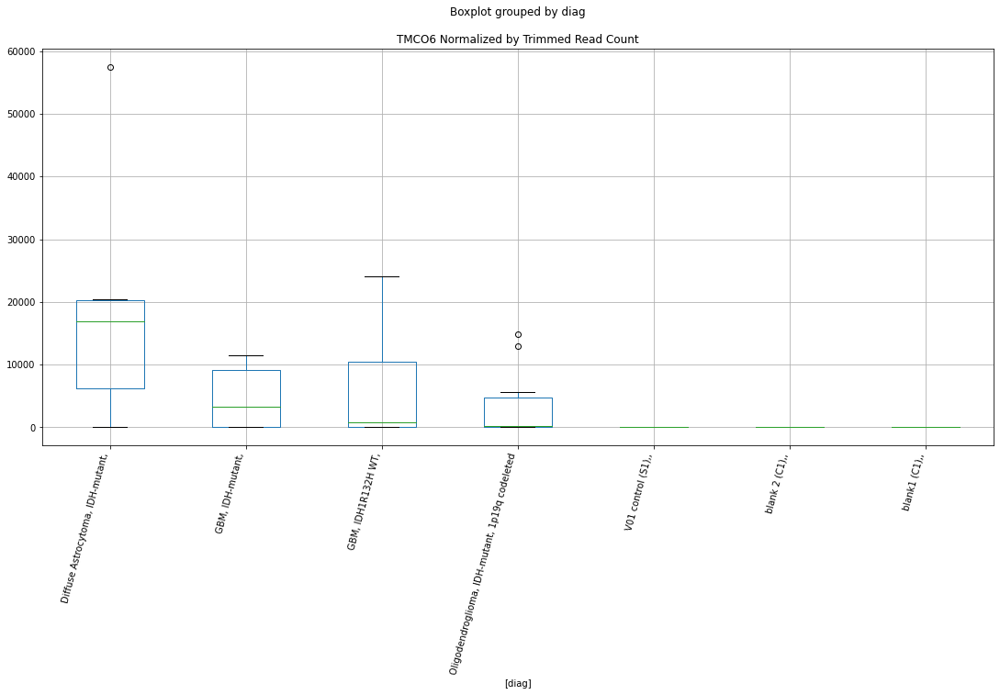

 p : 0.025402241083036275  ( t : 2.4372705869401727 ) :  D-plex  :  cutadapt2  :  TGIF1
Control and blanks
76     0.0
340    0.0
Name: TGIF1, dtype: float64
208    1234.52
Name: TGIF1, dtype: float64
472    4623.65
Name: TGIF1, dtype: float64


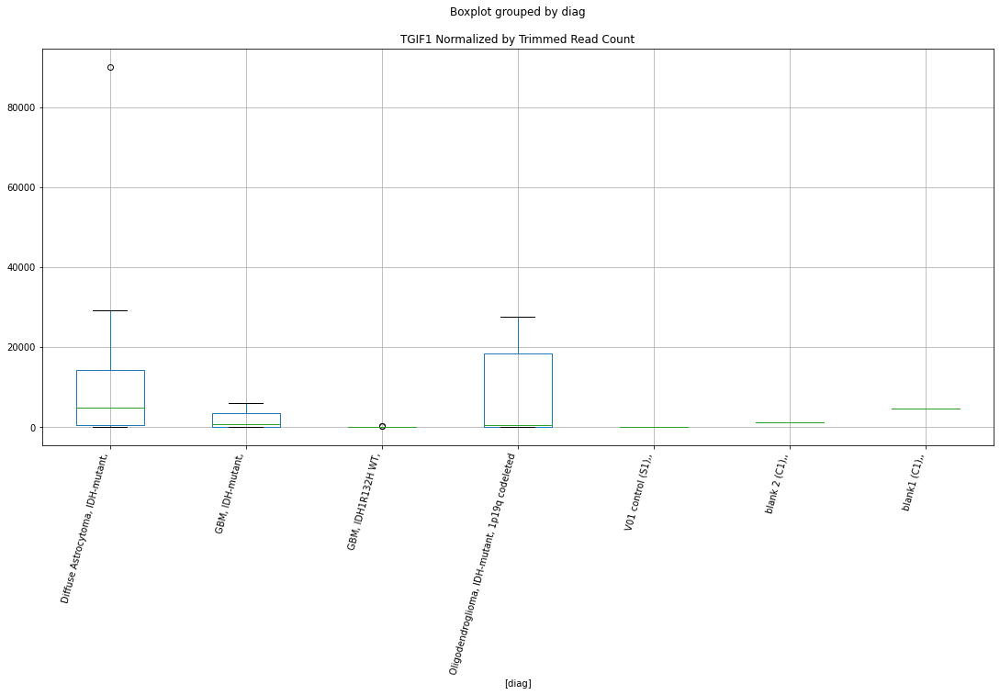

 p : 0.025432082626792956  ( t : 2.4367013263893824 ) :  Lexogen  :  bbduk2  :  SRRM2
Control and blanks
79          0.00
343    208068.03
Name: SRRM2, dtype: float64
211    0.0
Name: SRRM2, dtype: float64
475    0.0
Name: SRRM2, dtype: float64


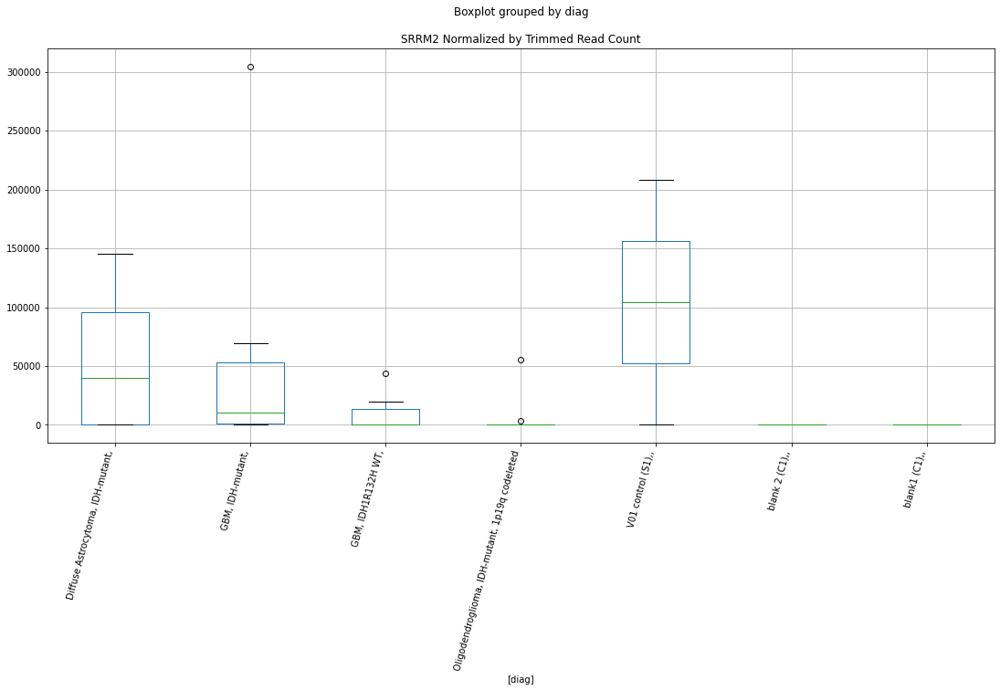

 p : 0.025615557103281138  ( t : 2.433215050535865 ) :  Lexogen  :  bbduk2  :  ZFHX4
Control and blanks
79     0.0
343    0.0
Name: ZFHX4, dtype: float64
211    0.0
Name: ZFHX4, dtype: float64
475    0.0
Name: ZFHX4, dtype: float64


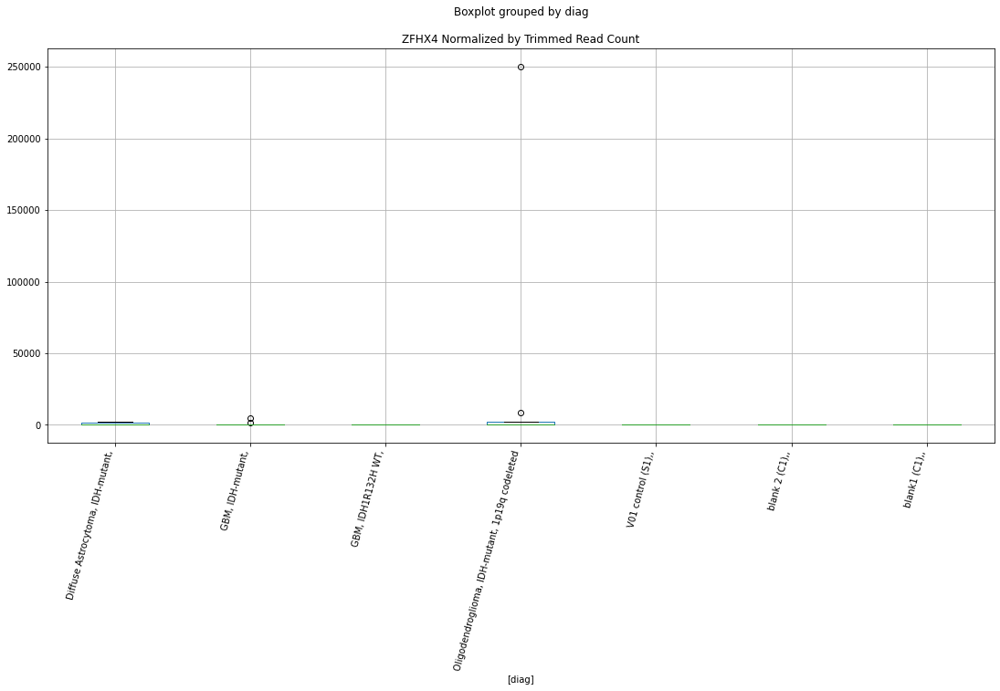

 p : 0.0256319228399338  ( t : 2.432905216612477 ) :  Lexogen  :  cutadapt2  :  ZFHX4
Control and blanks
82     0.0
346    0.0
Name: ZFHX4, dtype: float64
214    0.0
Name: ZFHX4, dtype: float64
478    0.0
Name: ZFHX4, dtype: float64


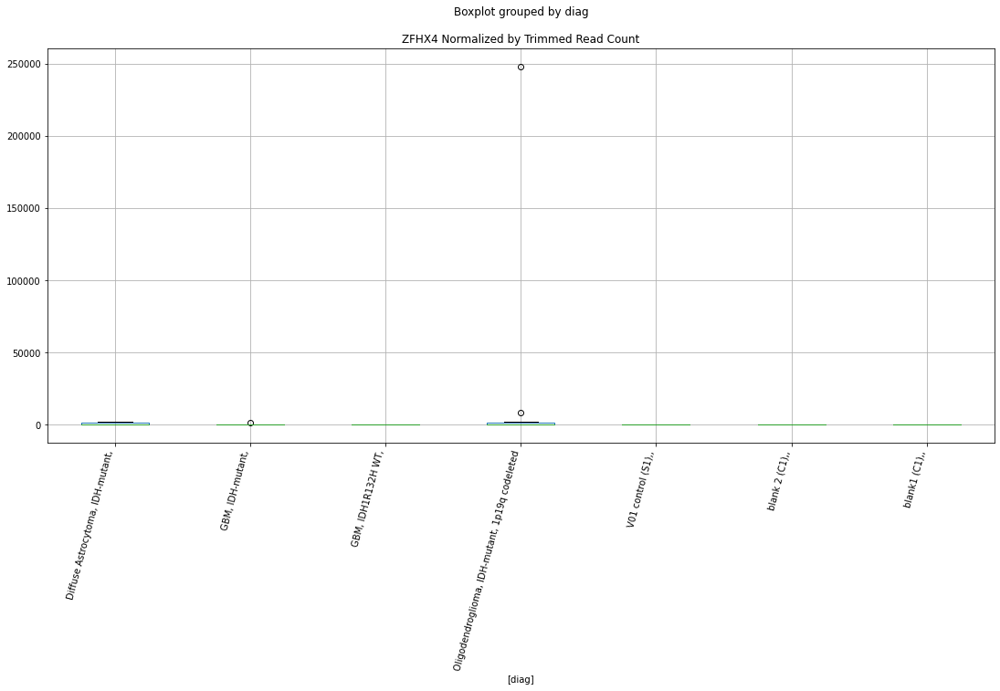

 p : 0.025637358677529243  ( t : 2.432802347097464 ) :  Lexogen  :  cutadapt2  :  ZSCAN30
Control and blanks
82     0.0
346    0.0
Name: ZSCAN30, dtype: float64
214    0.0
Name: ZSCAN30, dtype: float64
478    0.0
Name: ZSCAN30, dtype: float64


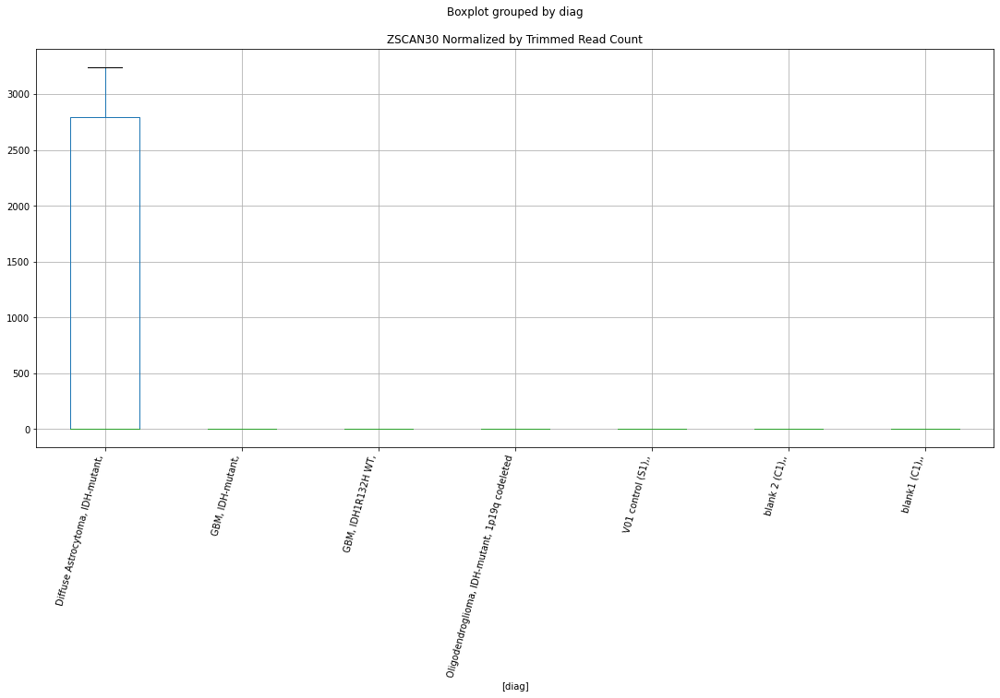

 p : 0.025656314703285298  ( t : 2.4324437771687064 ) :  Lexogen  :  bbduk2  :  TMEM47
Control and blanks
79     0.0
343    0.0
Name: TMEM47, dtype: float64
211    0.0
Name: TMEM47, dtype: float64
475    0.0
Name: TMEM47, dtype: float64


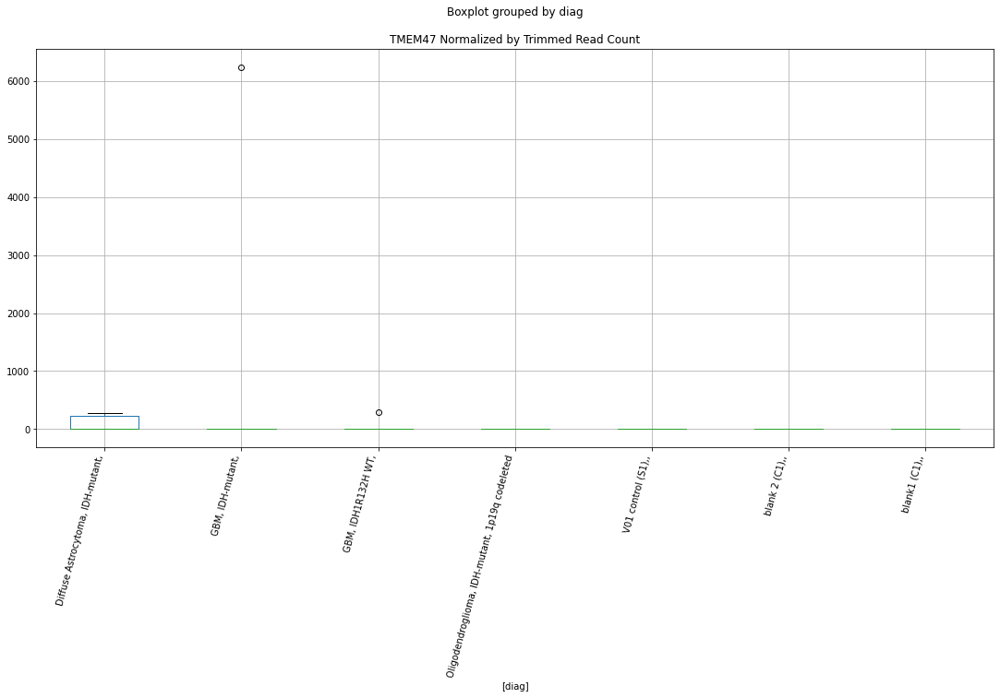

 p : 0.025678374400014414  ( t : 2.4320268111274594 ) :  D-plex  :  bbduk2  :  VPS11
Control and blanks
73     0.0
337    0.0
Name: VPS11, dtype: float64
205    0.0
Name: VPS11, dtype: float64
469    0.0
Name: VPS11, dtype: float64


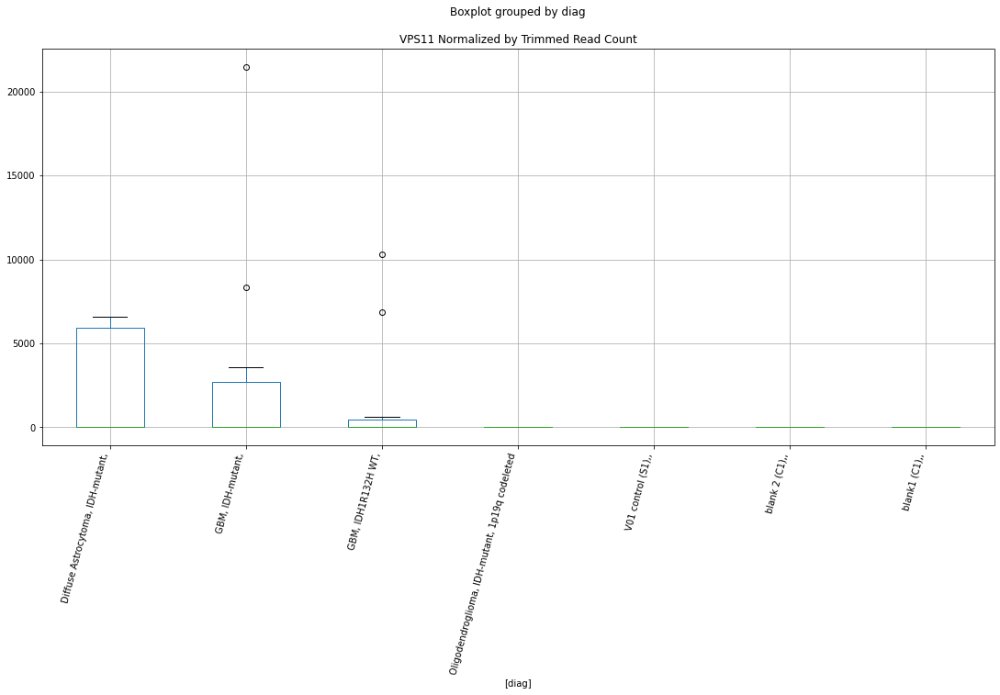

 p : 0.025838671508650705  ( t : 2.4290069672444847 ) :  Lexogen  :  cutadapt2  :  TPM1-AS
Control and blanks
82     0.0
346    0.0
Name: TPM1-AS, dtype: float64
214    0.0
Name: TPM1-AS, dtype: float64
478    0.0
Name: TPM1-AS, dtype: float64


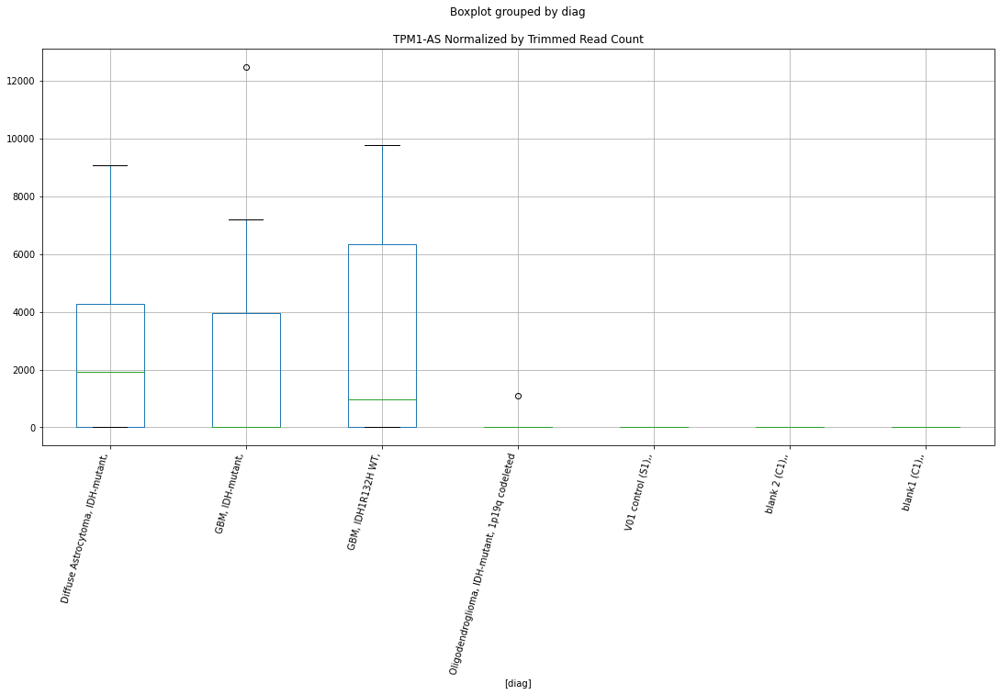

 p : 0.025840933715132103  ( t : 2.428964475229996 ) :  D-plex  :  bbduk2  :  SRGAP2
Control and blanks
73     0.0
337    0.0
Name: SRGAP2, dtype: float64
205    13969.09
Name: SRGAP2, dtype: float64
469    26027.2
Name: SRGAP2, dtype: float64


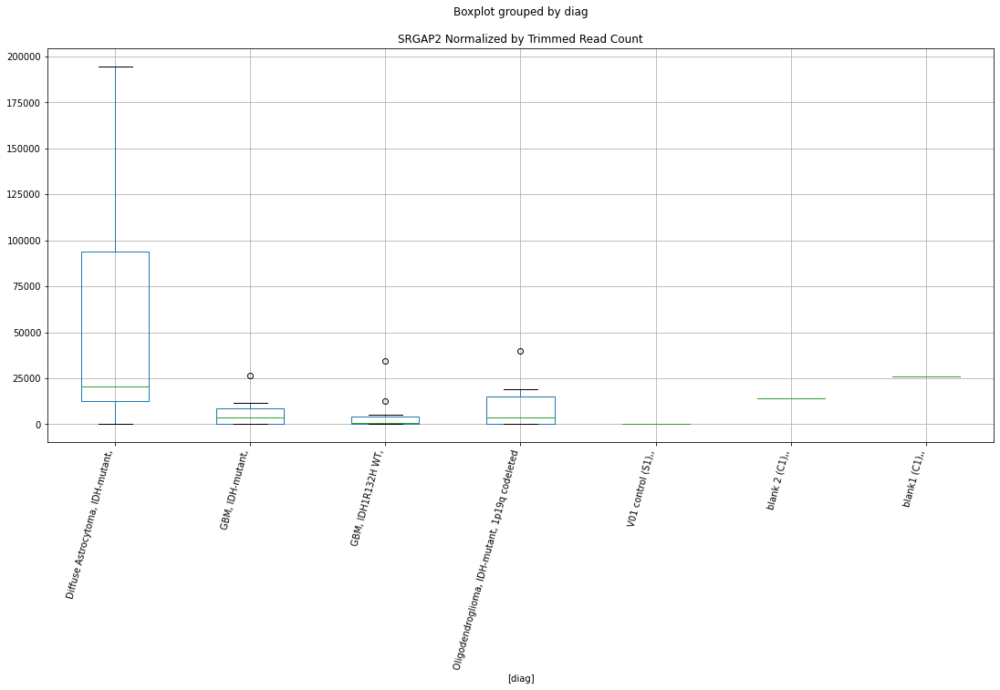

 p : 0.02589772874314416  ( t : 2.4278988102513184 ) :  D-plex  :  cutadapt2  :  TSPEAR
Control and blanks
76     0.0
340    0.0
Name: TSPEAR, dtype: float64
208    0.0
Name: TSPEAR, dtype: float64
472    0.0
Name: TSPEAR, dtype: float64


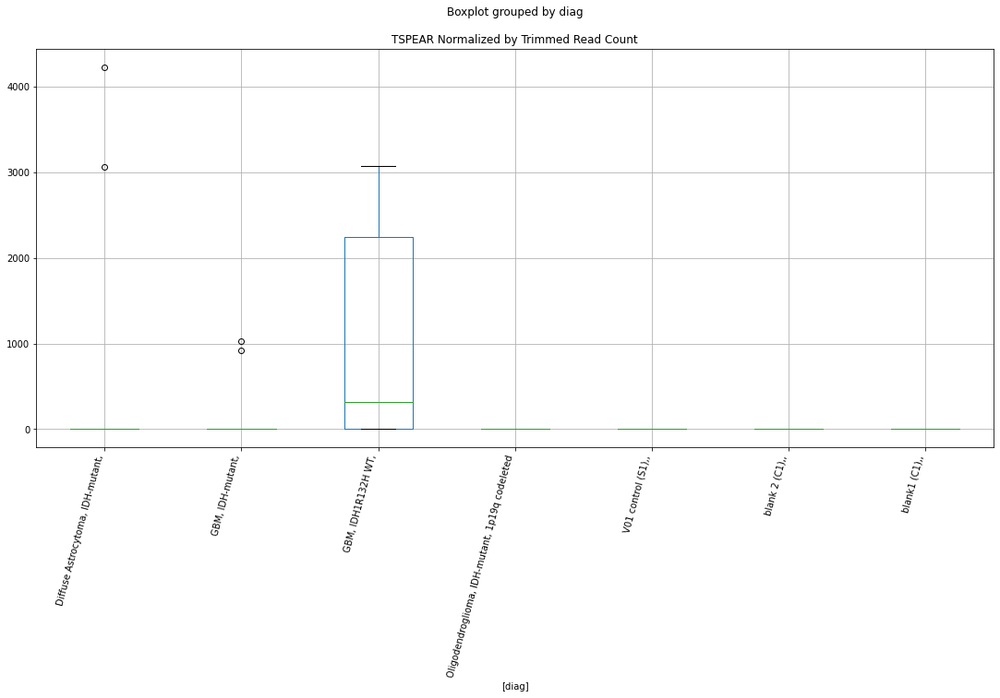

 p : 0.02594269012773842  ( t : 2.4270567361400732 ) :  D-plex  :  cutadapt2  :  WDR62
Control and blanks
76      18182.74
340    140917.14
Name: WDR62, dtype: float64
208    15343.34
Name: WDR62, dtype: float64
472    30053.7
Name: WDR62, dtype: float64


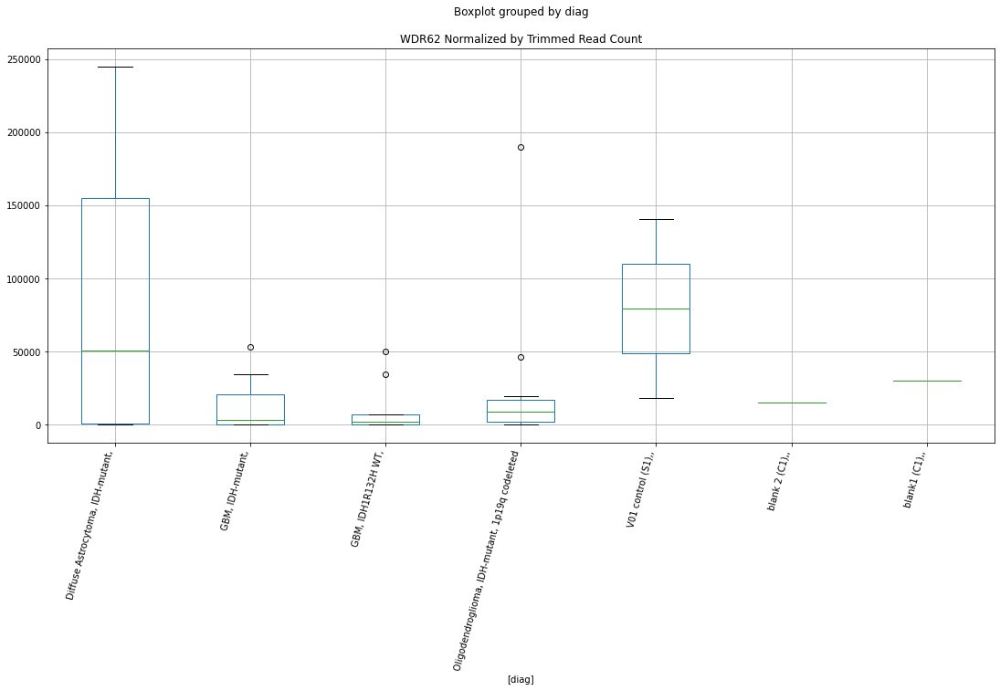

 p : 0.025988417687389197  ( t : 2.4262017140419547 ) :  D-plex  :  bbduk2  :  TSPEAR
Control and blanks
73     0.0
337    0.0
Name: TSPEAR, dtype: float64
205    0.0
Name: TSPEAR, dtype: float64
469    0.0
Name: TSPEAR, dtype: float64


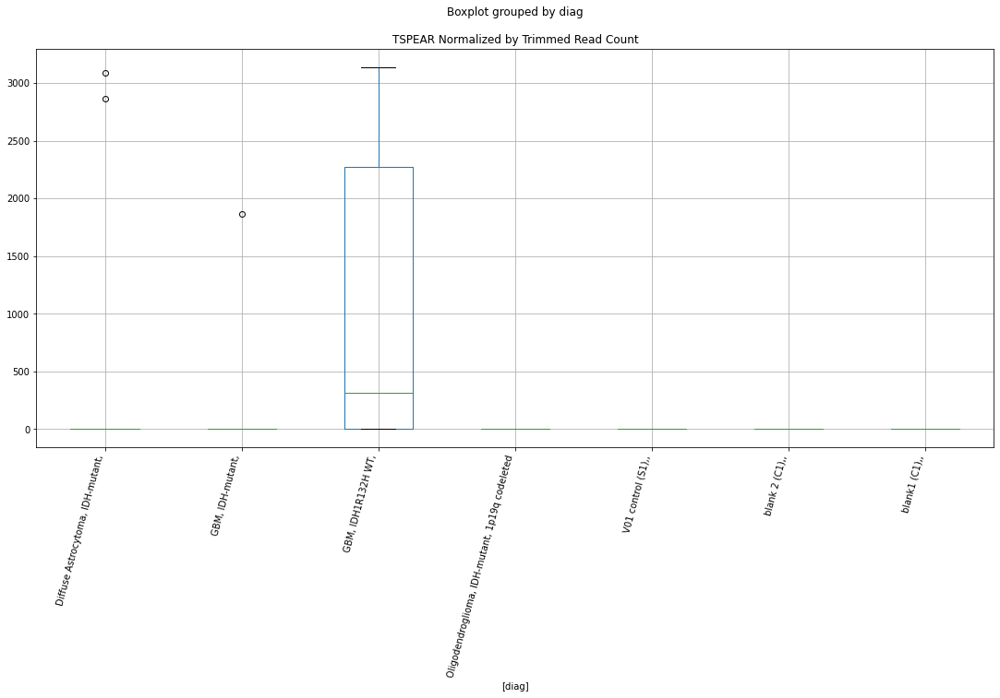

 p : 0.026119597243853276  ( t : 2.423756694498445 ) :  D-plex  :  bbduk2  :  USP48
Control and blanks
73     0.0
337    0.0
Name: USP48, dtype: float64
205    358.18
Name: USP48, dtype: float64
469    0.0
Name: USP48, dtype: float64


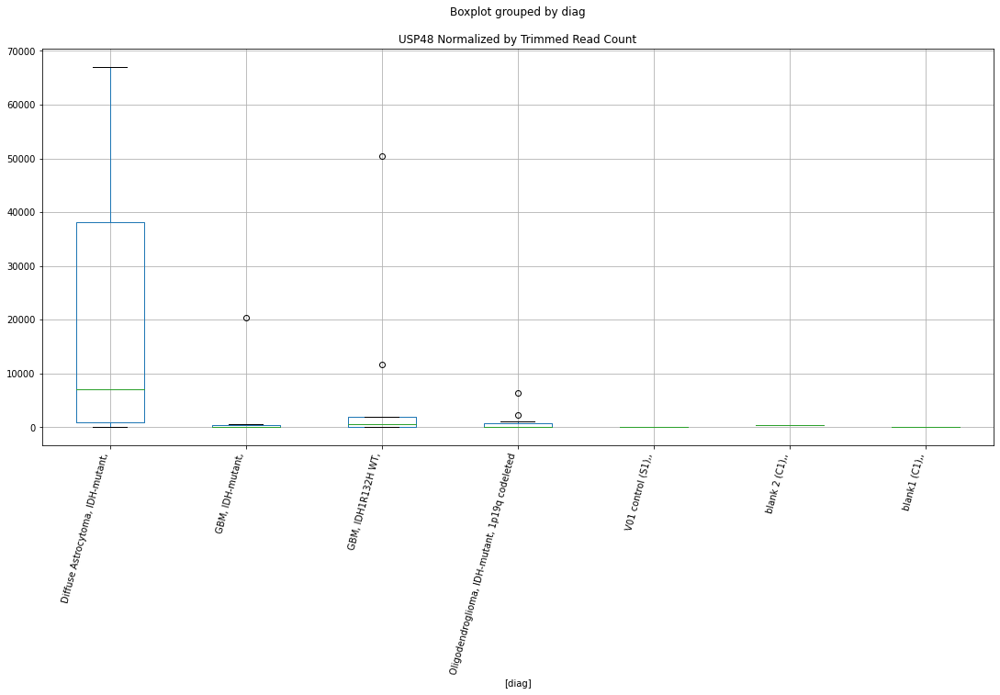

 p : 0.026148335849724074  ( t : 2.423222580115513 ) :  D-plex  :  cutadapt2  :  VPS37C
Control and blanks
76     0.0
340    0.0
Name: VPS37C, dtype: float64
208    1058.16
Name: VPS37C, dtype: float64
472    12137.07
Name: VPS37C, dtype: float64


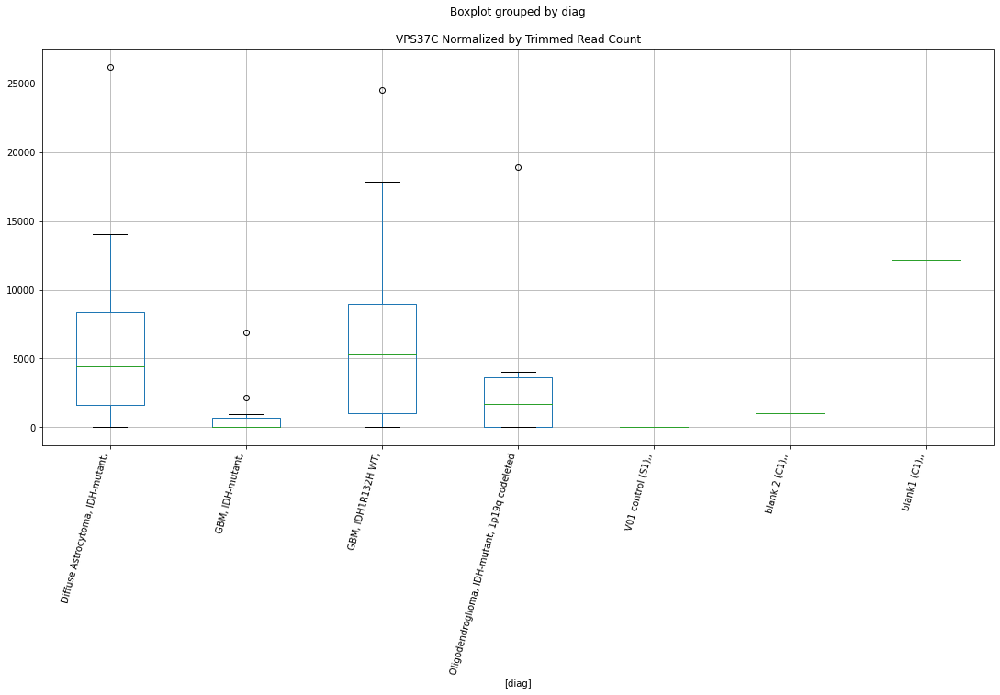

 p : 0.02623466084318127  ( t : 2.421621508284612 ) :  D-plex  :  bbduk2  :  TSNARE1
Control and blanks
73      27828.30
337    217198.37
Name: TSNARE1, dtype: float64
205    186970.95
Name: TSNARE1, dtype: float64
469    112390.19
Name: TSNARE1, dtype: float64


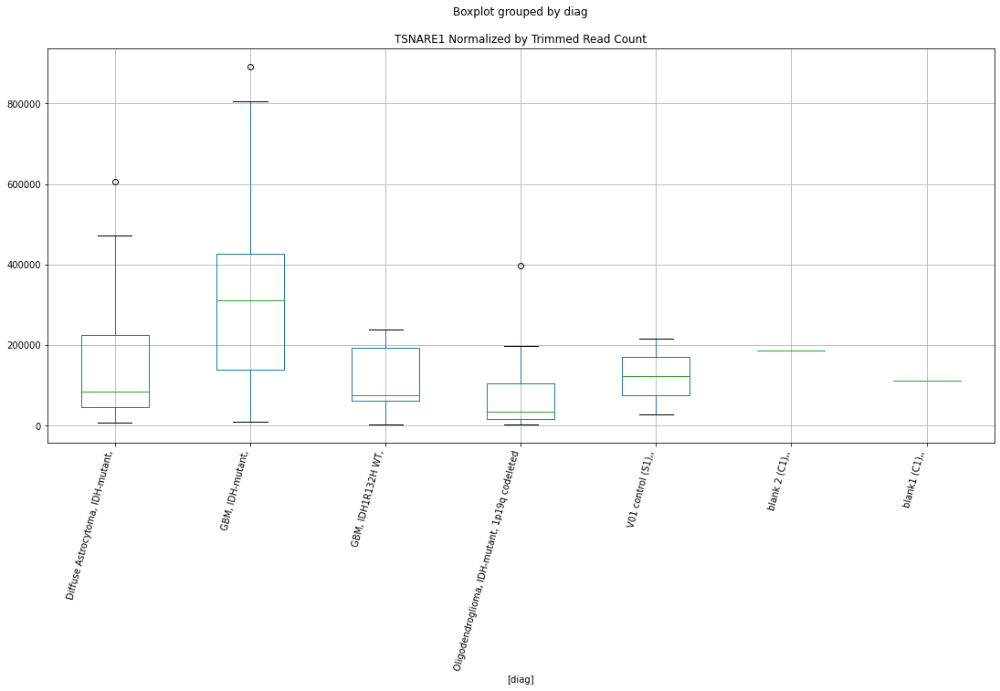

 p : 0.026238556038107028  ( t : 2.421549380424818 ) :  Lexogen  :  cutadapt2  :  TMTC1
Control and blanks
82     0.0
346    0.0
Name: TMTC1, dtype: float64
214    0.0
Name: TMTC1, dtype: float64
478    0.0
Name: TMTC1, dtype: float64


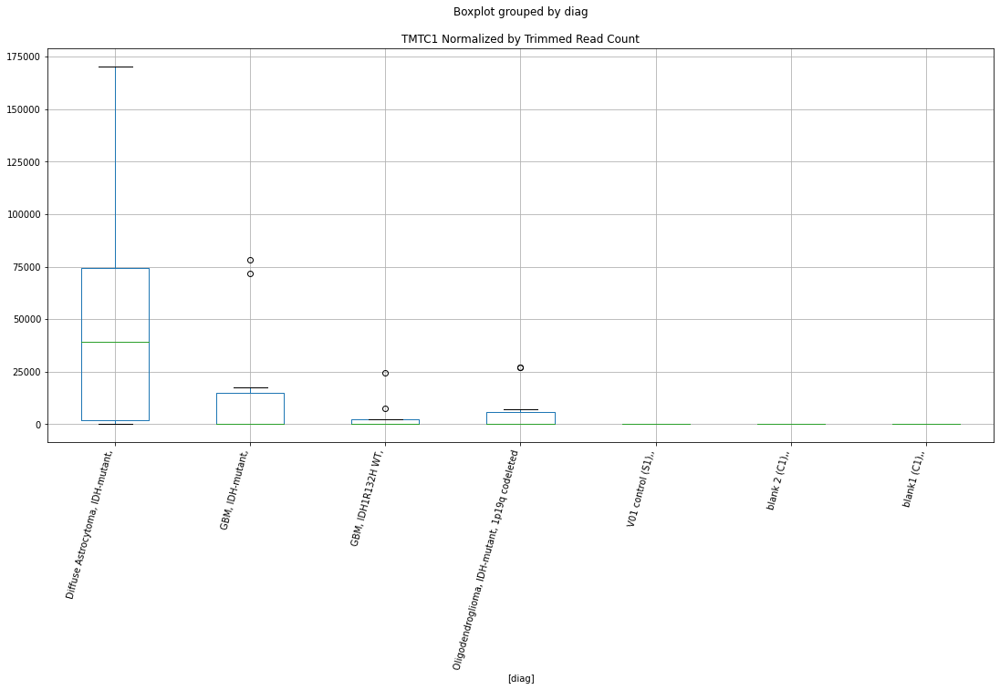

 p : 0.02625366598607837  ( t : 2.4212696823215354 ) :  Lexogen  :  cutadapt2  :  TOR3A
Control and blanks
82     0.0
346    0.0
Name: TOR3A, dtype: float64
214    0.0
Name: TOR3A, dtype: float64
478    0.0
Name: TOR3A, dtype: float64


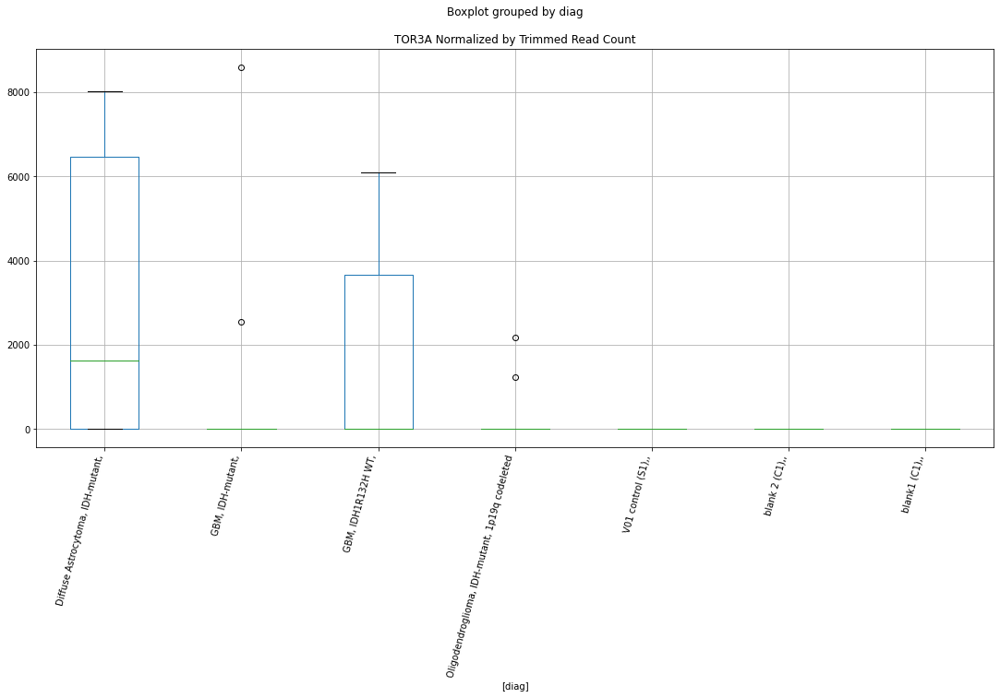

 p : 0.02625609890374177  ( t : 2.421224661021844 ) :  Lexogen  :  bbduk2  :  TOR3A
Control and blanks
79     0.0
343    0.0
Name: TOR3A, dtype: float64
211    0.0
Name: TOR3A, dtype: float64
475    0.0
Name: TOR3A, dtype: float64


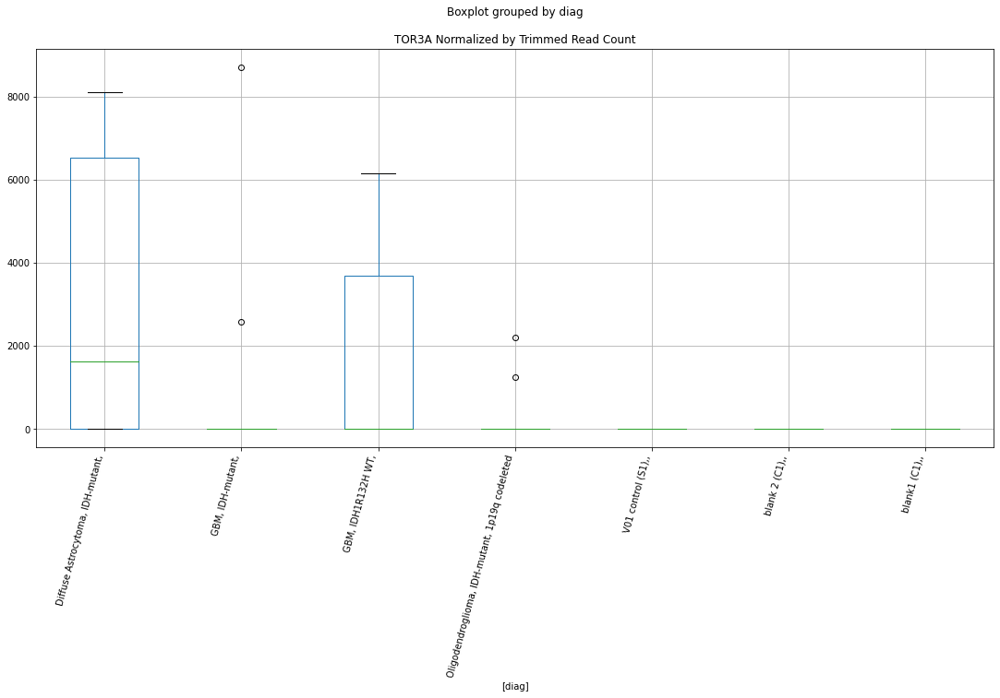

 p : 0.026339858053268956  ( t : 2.4196770704682184 ) :  D-plex  :  bbduk2  :  TMEM196
Control and blanks
73     0.0
337    0.0
Name: TMEM196, dtype: float64
205    2328.18
Name: TMEM196, dtype: float64
469    11239.02
Name: TMEM196, dtype: float64


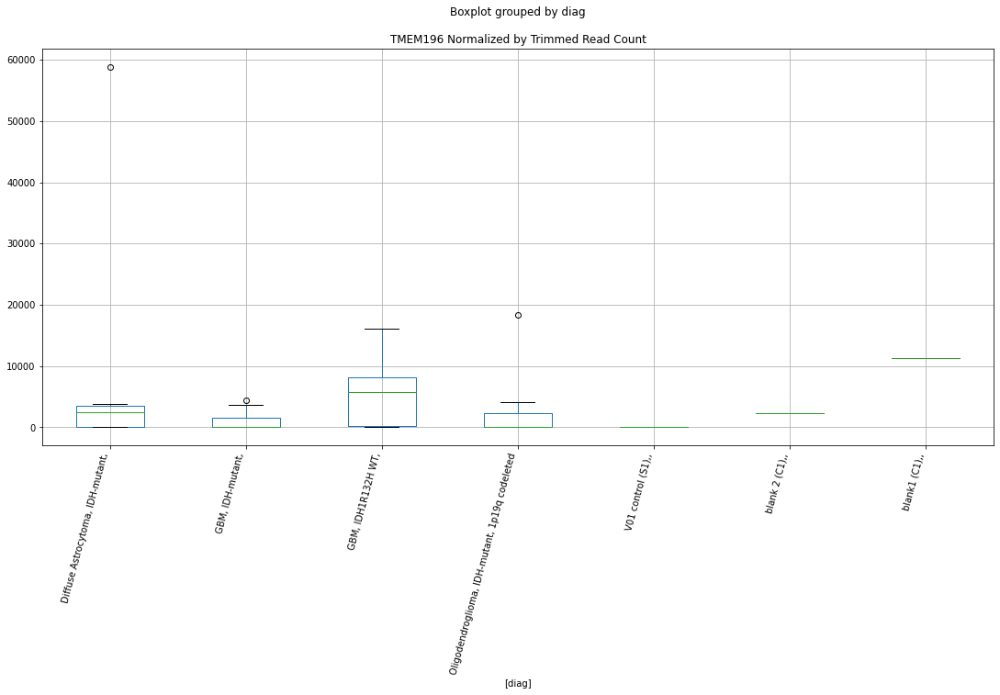

 p : 0.02641080418938387  ( t : 2.418369822867378 ) :  D-plex  :  bbduk2  :  WIPF1
Control and blanks
73     371044.03
337    608867.57
Name: WIPF1, dtype: float64
205    500738.3
Name: WIPF1, dtype: float64
469    6.19e+06
Name: WIPF1, dtype: float64


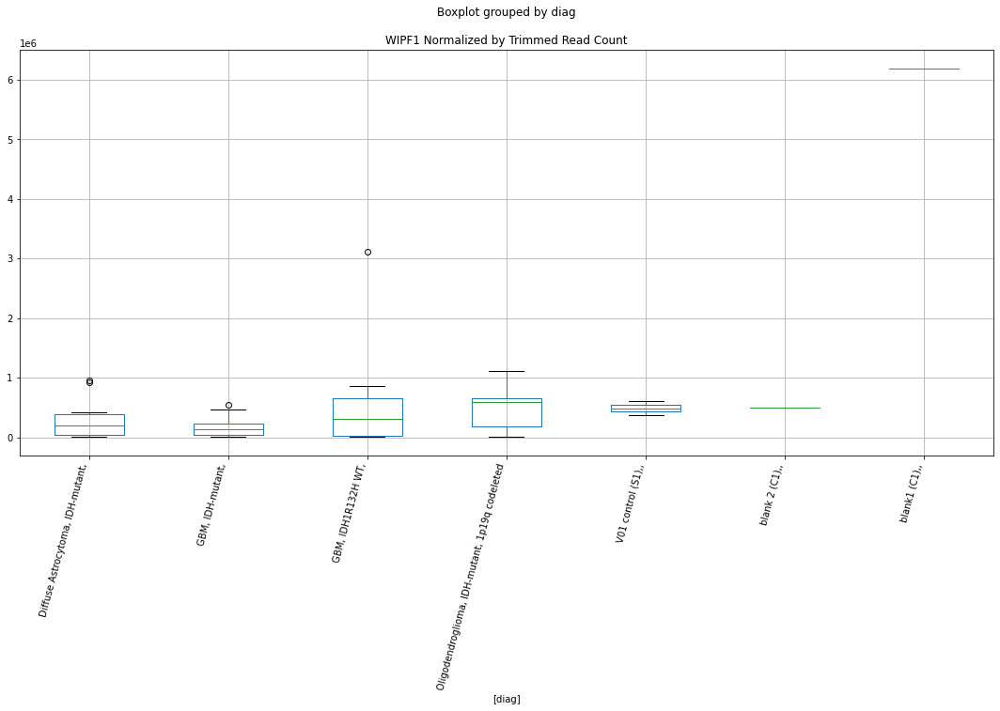

 p : 0.026420804941158015  ( t : 2.418185814357889 ) :  Lexogen  :  bbduk2  :  TMTC1
Control and blanks
79     0.0
343    0.0
Name: TMTC1, dtype: float64
211    0.0
Name: TMTC1, dtype: float64
475    0.0
Name: TMTC1, dtype: float64


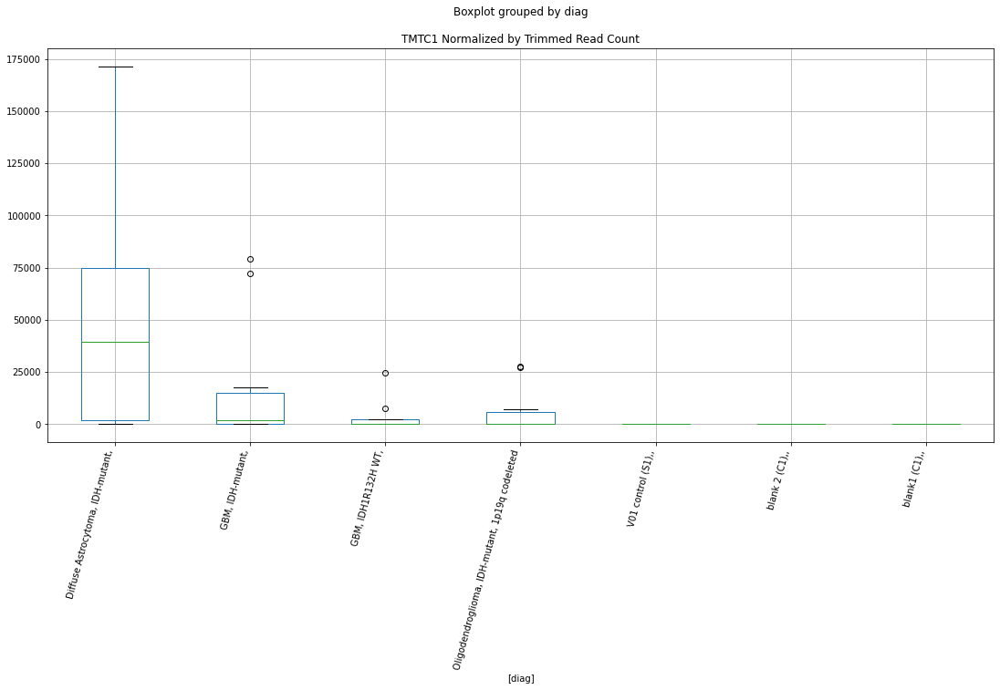

 p : 0.026602426821696237  ( t : 2.414855366071418 ) :  D-plex  :  cutadapt2  :  WIPF1
Control and blanks
76     363654.82
340    605062.98
Name: WIPF1, dtype: float64
208    496277.65
Name: WIPF1, dtype: float64
472    6.09e+06
Name: WIPF1, dtype: float64


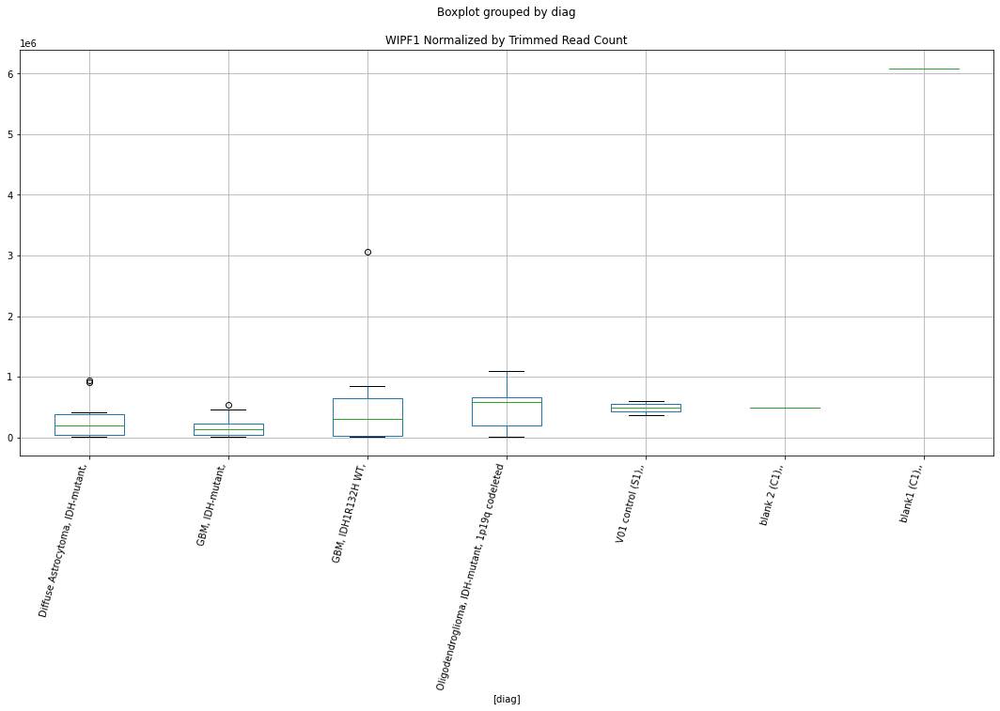

 p : 0.026662310991339932  ( t : 2.413761919816255 ) :  D-plex  :  bbduk2  :  ZNF708
Control and blanks
73     0.0
337    0.0
Name: ZNF708, dtype: float64
205    6447.27
Name: ZNF708, dtype: float64
469    7098.33
Name: ZNF708, dtype: float64


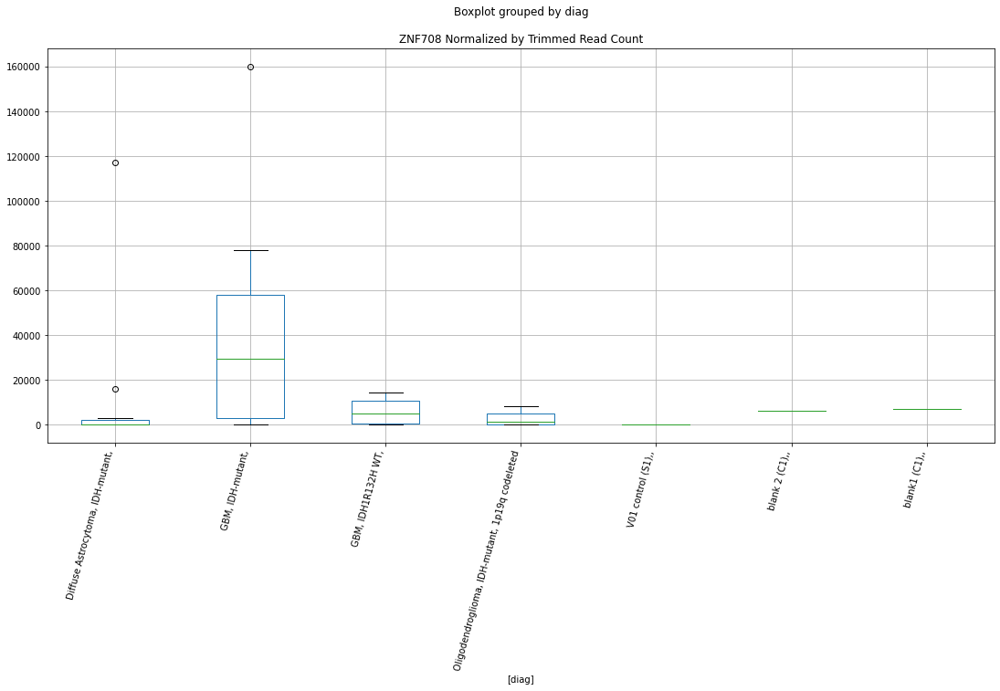

 p : 0.026679615030166807  ( t : 2.4134463873742167 ) :  Lexogen  :  cutadapt2  :  TRPS1
Control and blanks
82     0.0
346    0.0
Name: TRPS1, dtype: float64
214    14646.23
Name: TRPS1, dtype: float64
478    2137.14
Name: TRPS1, dtype: float64


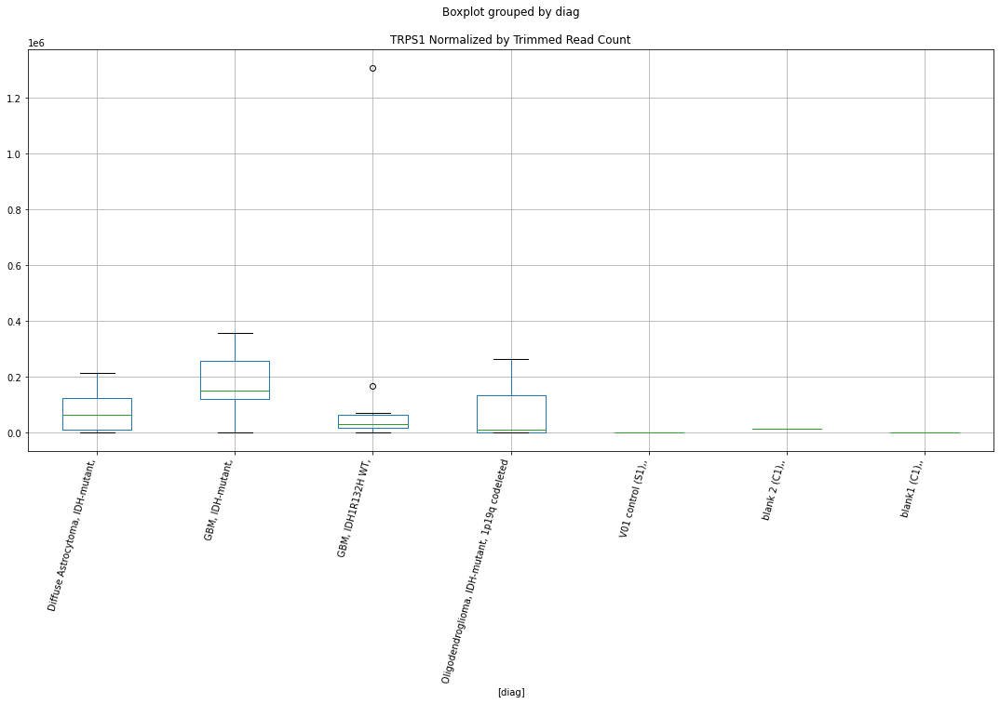

 p : 0.026775563850368434  ( t : 2.411700266070288 ) :  D-plex  :  cutadapt2  :  SRGAP2
Control and blanks
76     0.0
340    0.0
Name: SRGAP2, dtype: float64
208    13756.1
Name: SRGAP2, dtype: float64
472    25430.06
Name: SRGAP2, dtype: float64


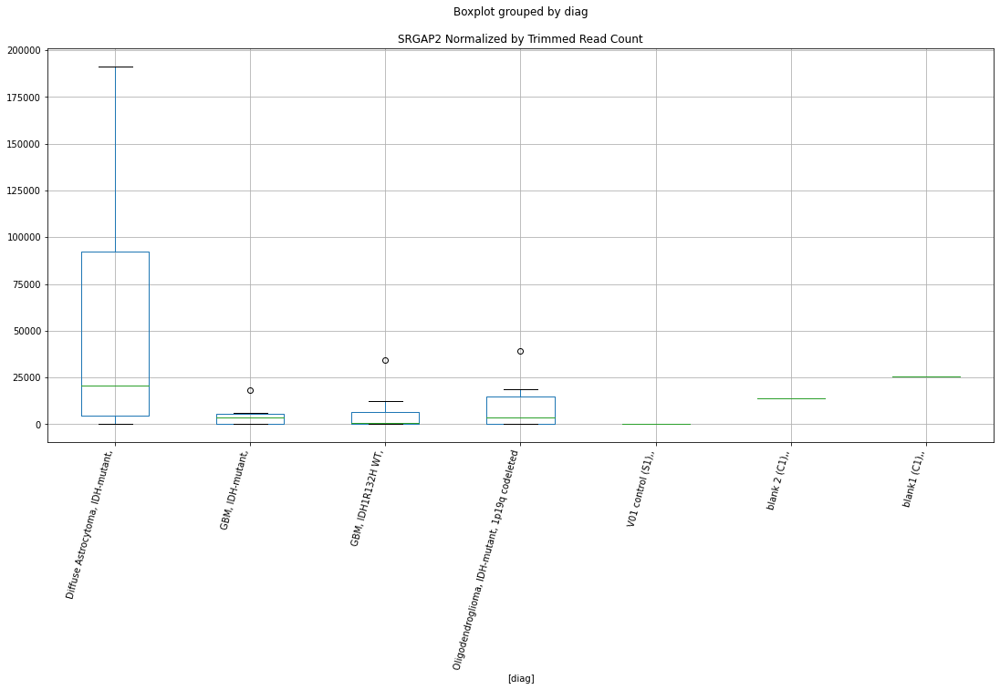

 p : 0.026802338591590695  ( t : 2.4112140520089964 ) :  D-plex  :  bbduk2  :  SRGAP2
Control and blanks
73     0.0
337    0.0
Name: SRGAP2, dtype: float64
205    13969.09
Name: SRGAP2, dtype: float64
469    26027.2
Name: SRGAP2, dtype: float64


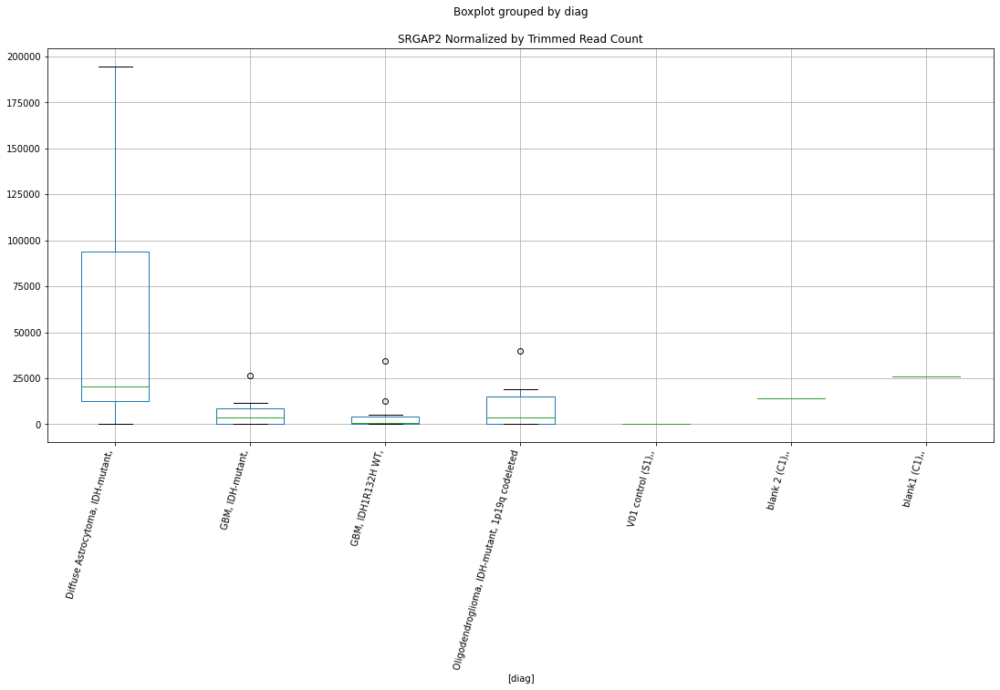

 p : 0.026813438411957335  ( t : 2.411012618866353 ) :  Lexogen  :  cutadapt2  :  ZNF280A
Control and blanks
82        0.00
346    1683.48
Name: ZNF280A, dtype: float64
214    13561.32
Name: ZNF280A, dtype: float64
478    15197.47
Name: ZNF280A, dtype: float64


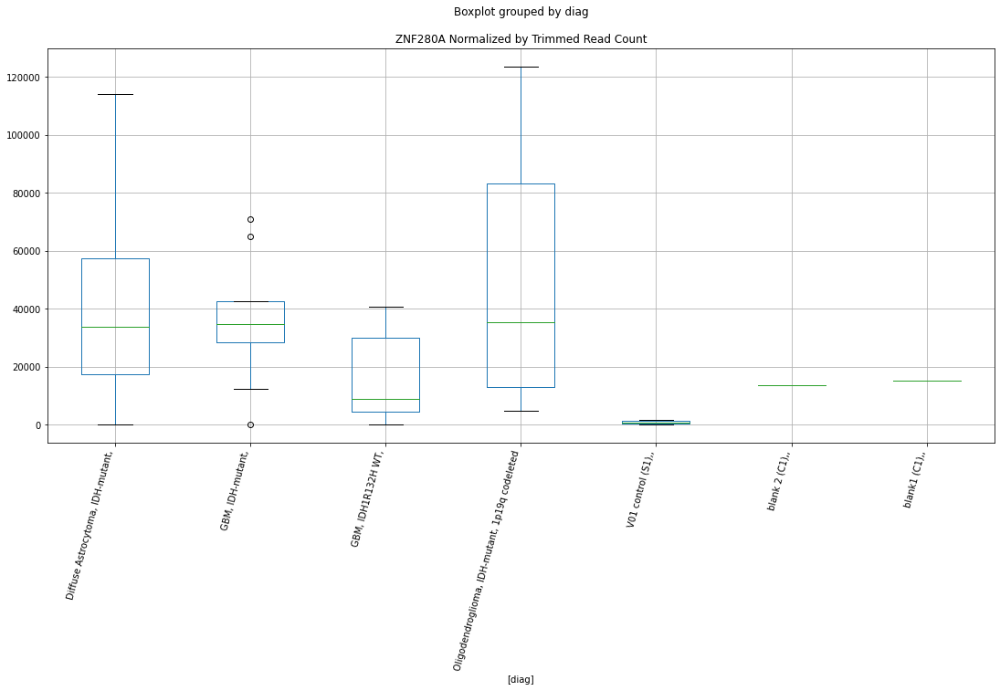

 p : 0.027078898246337288  ( t : 2.406218309230157 ) :  D-plex  :  cutadapt2  :  SYNPO
Control and blanks
76     0.0
340    0.0
Name: SYNPO, dtype: float64
208    4761.73
Name: SYNPO, dtype: float64
472    3467.74
Name: SYNPO, dtype: float64


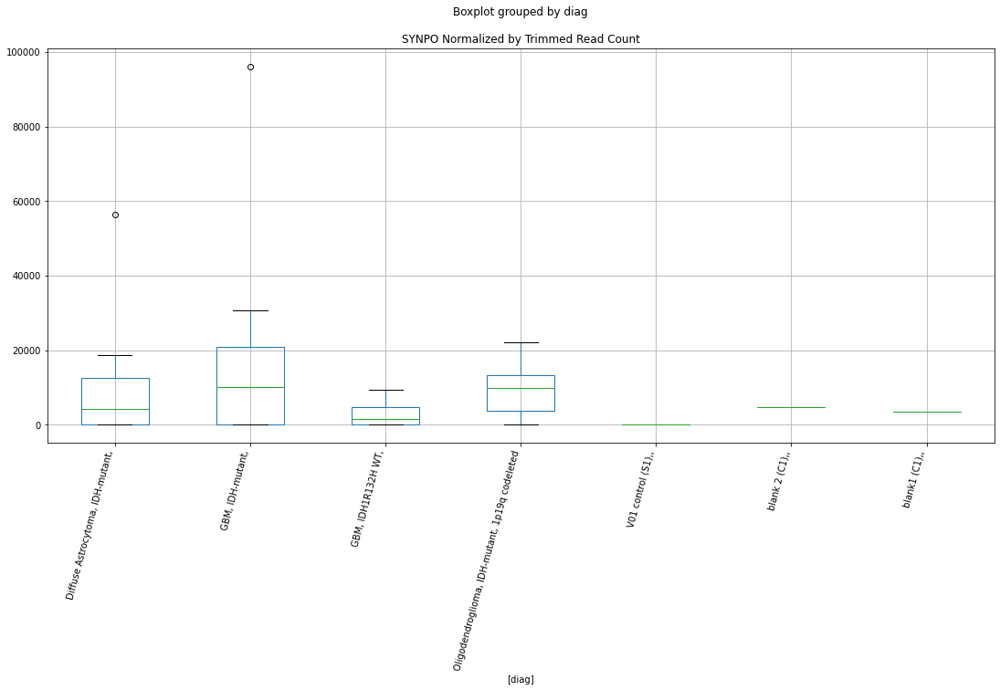

 p : 0.027091639883223346  ( t : 2.4059892978330164 ) :  D-plex  :  bbduk2  :  TNFAIP8
Control and blanks
73        0.00
337    8901.57
Name: TNFAIP8, dtype: float64
205    3581.82
Name: TNFAIP8, dtype: float64
469    1774.58
Name: TNFAIP8, dtype: float64


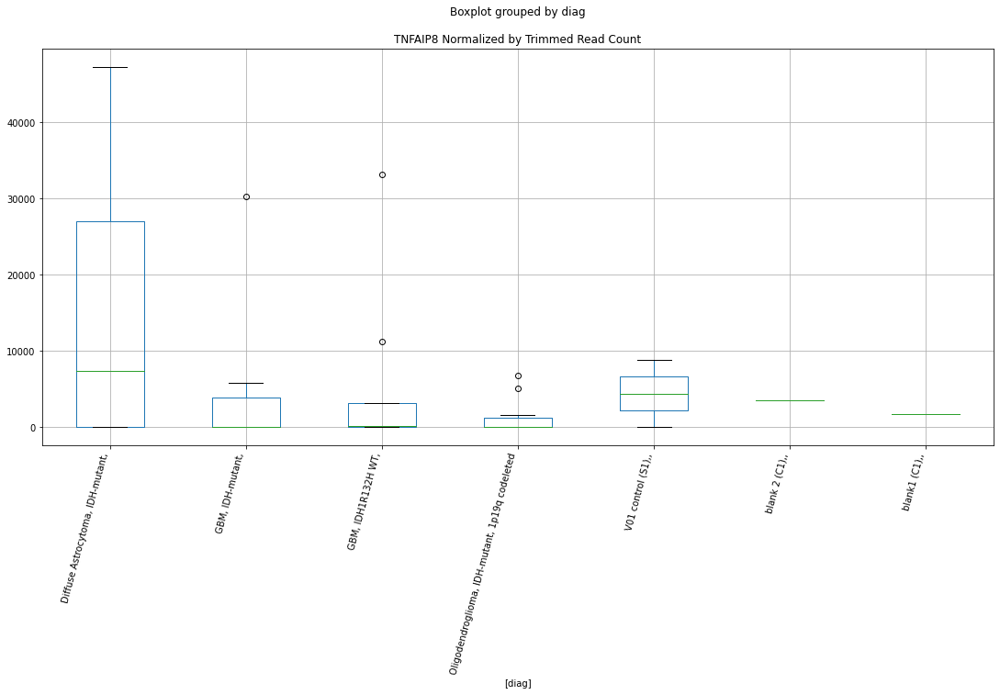

 p : 0.027130248883753406  ( t : 2.4052959749375753 ) :  D-plex  :  bbduk2  :  TEX41
Control and blanks
73     0.0
337    0.0
Name: TEX41, dtype: float64
205    1253.64
Name: TEX41, dtype: float64
469    591.53
Name: TEX41, dtype: float64


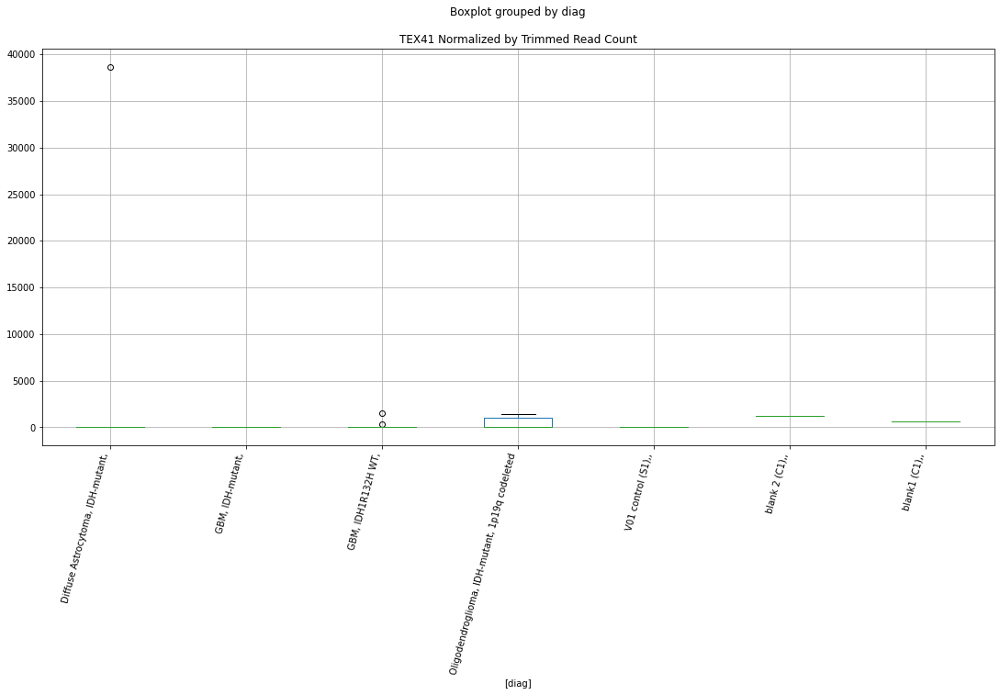

 p : 0.02713679452686391  ( t : 2.4051785227659352 ) :  D-plex  :  cutadapt2  :  VSIG10
Control and blanks
76     0.0
340    0.0
Name: VSIG10, dtype: float64
208    2116.32
Name: VSIG10, dtype: float64
472    6935.47
Name: VSIG10, dtype: float64


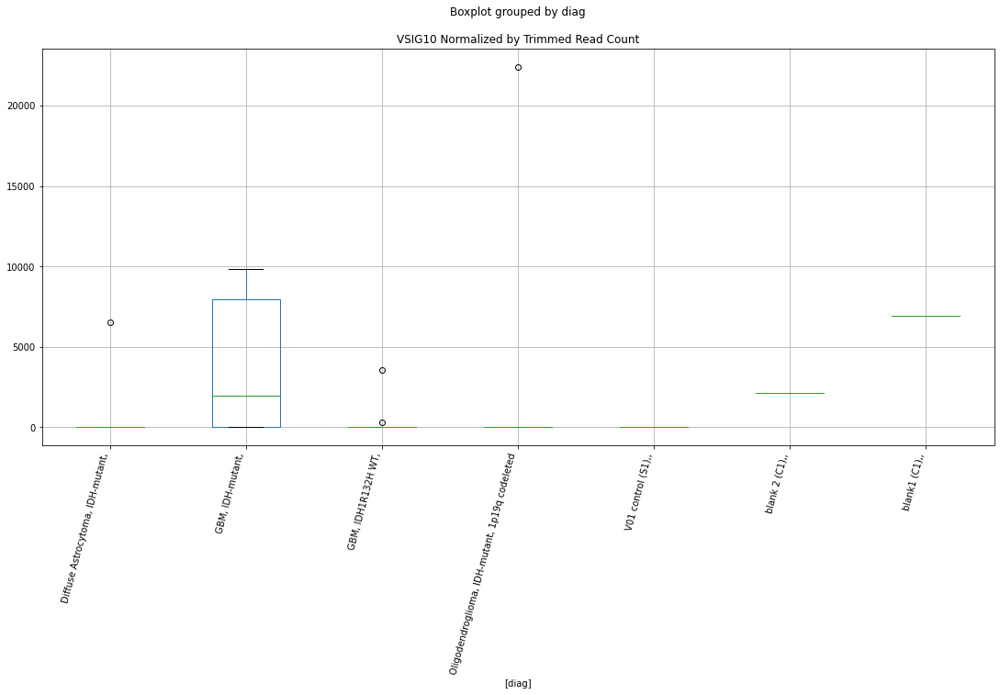

 p : 0.027164345845270166  ( t : 2.4046844442503468 ) :  Lexogen  :  cutadapt2  :  ZNF541
Control and blanks
82     0.0
346    0.0
Name: ZNF541, dtype: float64
214    0.0
Name: ZNF541, dtype: float64
478    0.0
Name: ZNF541, dtype: float64


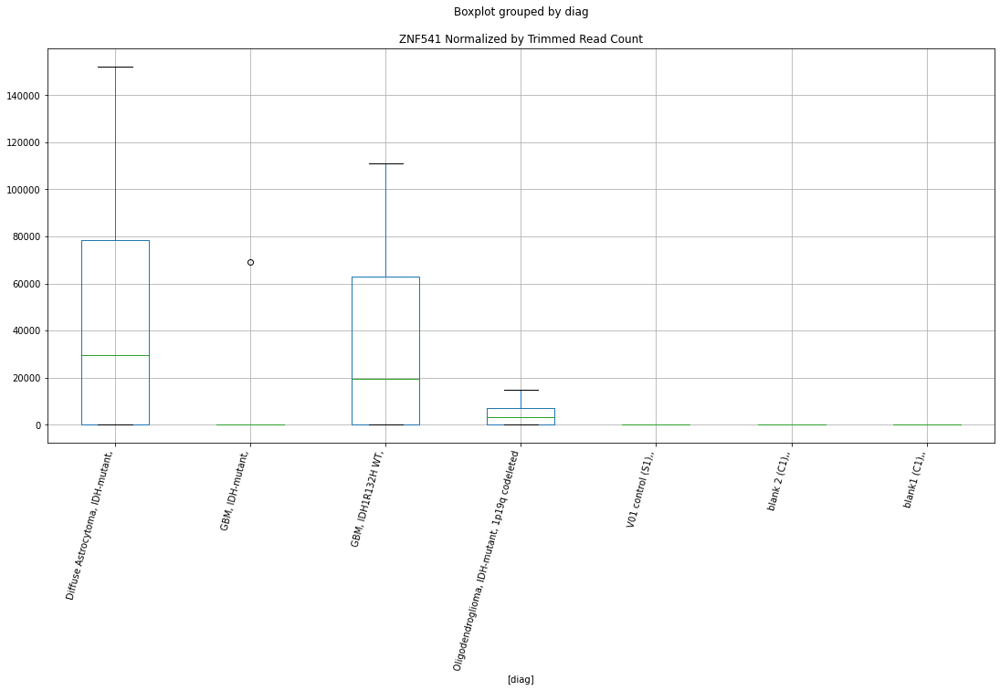

 p : 0.027201975188861888  ( t : 2.4040103930056778 ) :  D-plex  :  bbduk2  :  TRANK1
Control and blanks
73     64932.71
337        0.00
Name: TRANK1, dtype: float64
205    28654.55
Name: TRANK1, dtype: float64
469    27801.78
Name: TRANK1, dtype: float64


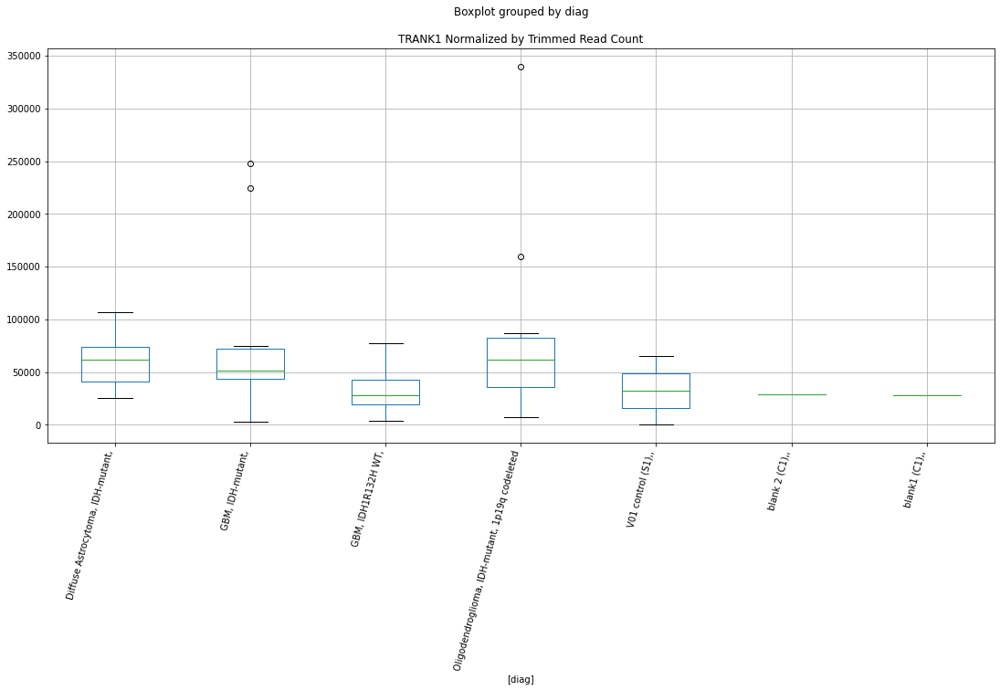

 p : 0.027296332995081007  ( t : 2.4023239973915014 ) :  D-plex  :  bbduk2  :  TUBA3FP
Control and blanks
73     773.01
337      0.00
Name: TUBA3FP, dtype: float64
205    358.18
Name: TUBA3FP, dtype: float64
469    591.53
Name: TUBA3FP, dtype: float64


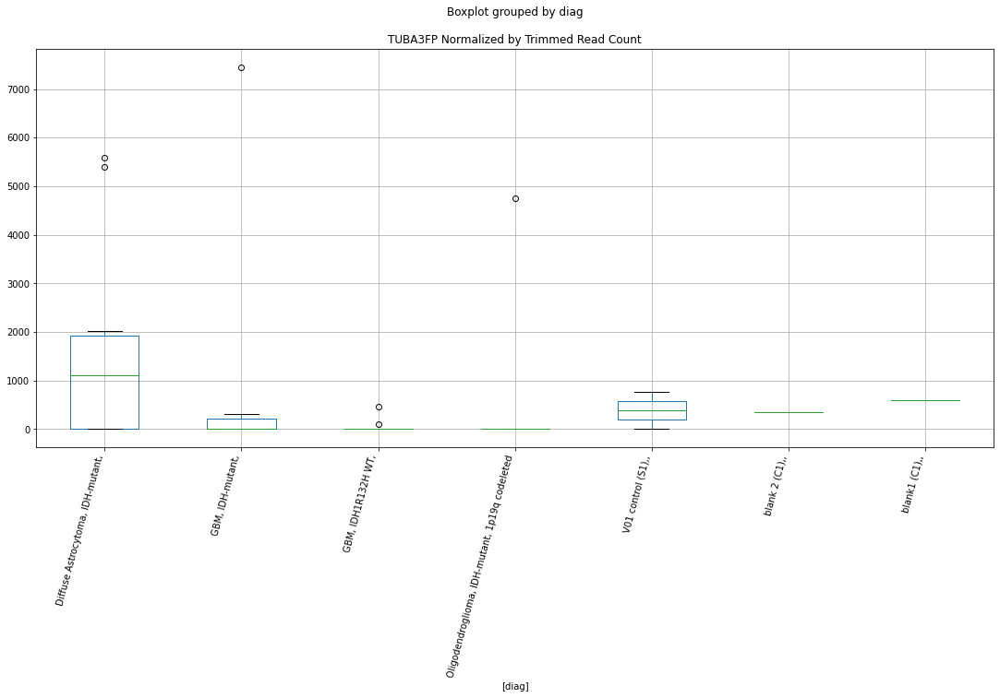

 p : 0.027309669877688635  ( t : 2.4020860758817766 ) :  D-plex  :  cutadapt2  :  ZNF708
Control and blanks
76     0.0
340    0.0
Name: ZNF708, dtype: float64
208    6348.97
Name: ZNF708, dtype: float64
472    6935.47
Name: ZNF708, dtype: float64


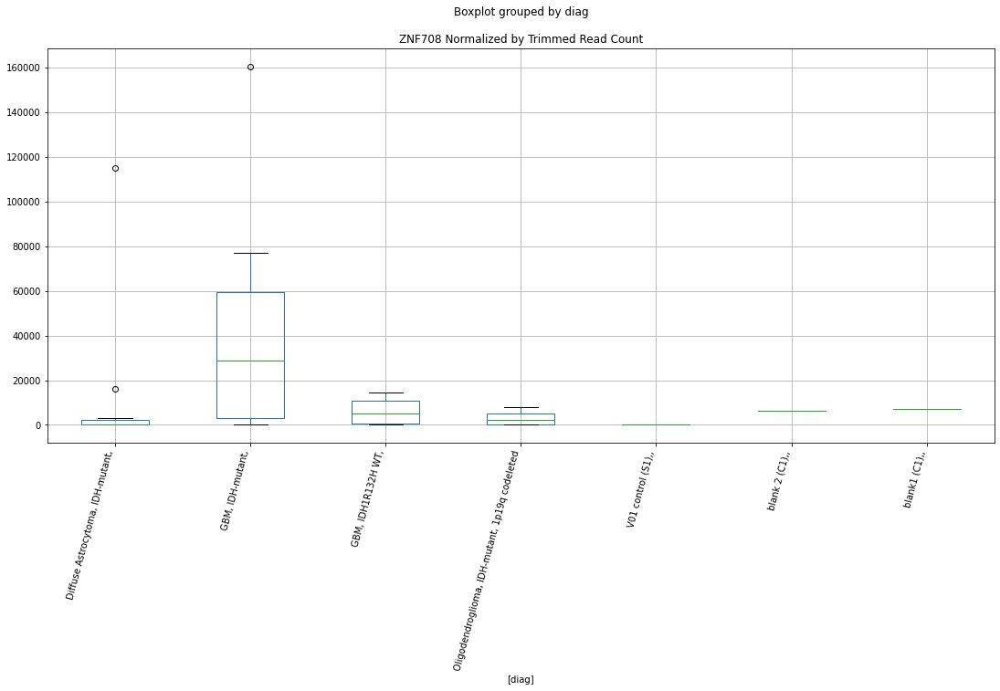

 p : 0.027341298417779013  ( t : 2.401522276947233 ) :  D-plex  :  bbduk2  :  SPPL3
Control and blanks
73     0.0
337    0.0
Name: SPPL3, dtype: float64
205    1432.73
Name: SPPL3, dtype: float64
469    1183.05
Name: SPPL3, dtype: float64


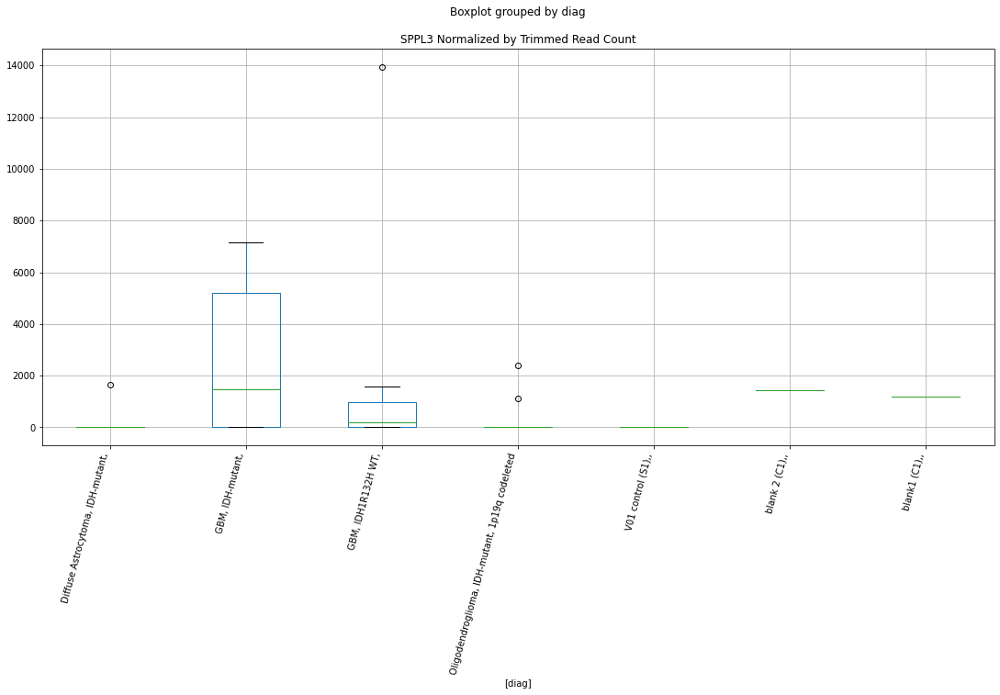

 p : 0.02735247864925388  ( t : 2.4013231280756724 ) :  D-plex  :  bbduk2  :  TUBB1
Control and blanks
73      4638.05
337    76553.52
Name: TUBB1, dtype: float64
205    39758.19
Name: TUBB1, dtype: float64
469    44364.55
Name: TUBB1, dtype: float64


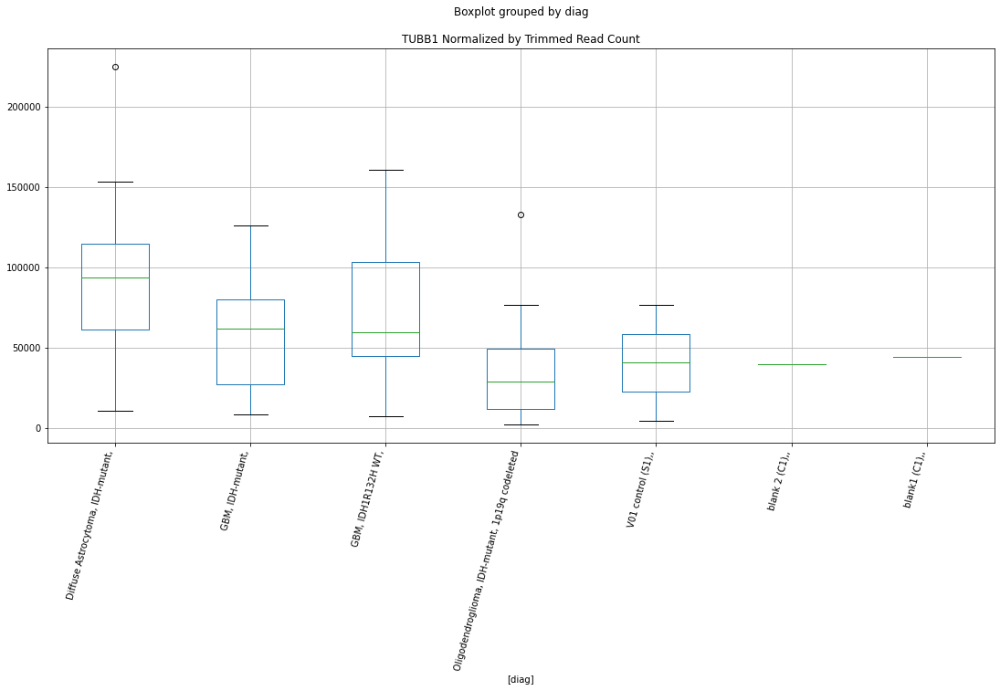

 p : 0.02738461246023008  ( t : 2.400751165216057 ) :  Lexogen  :  bbduk2  :  ZNF541
Control and blanks
79     0.0
343    0.0
Name: ZNF541, dtype: float64
211    0.0
Name: ZNF541, dtype: float64
475    0.0
Name: ZNF541, dtype: float64


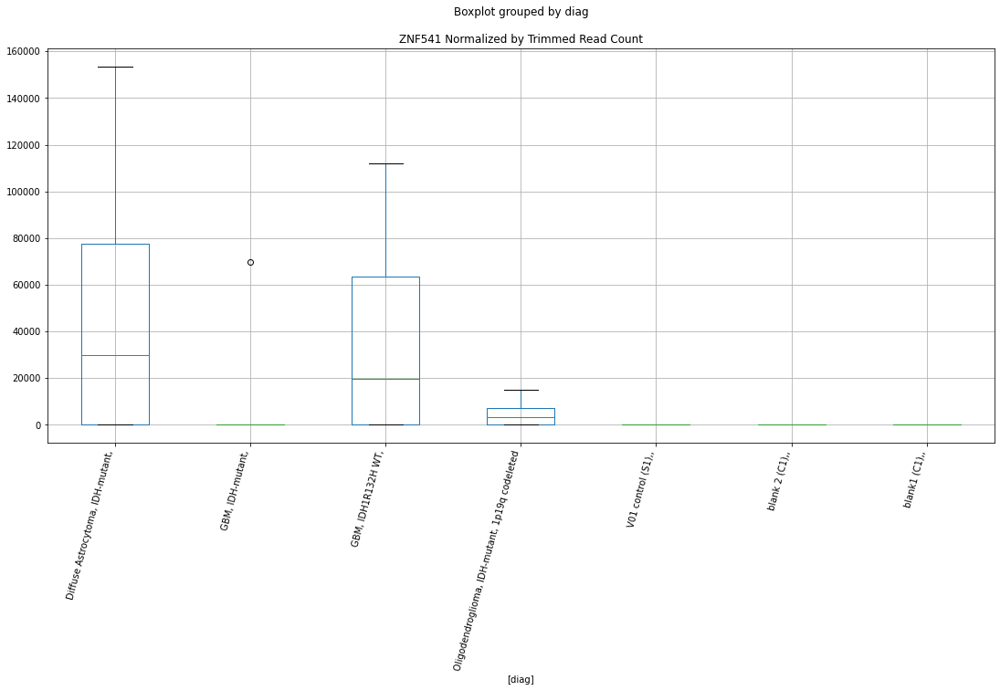

 p : 0.027411508425797194  ( t : 2.400272915199172 ) :  D-plex  :  bbduk2  :  TBC1D8
Control and blanks
73     0.0
337    0.0
Name: TBC1D8, dtype: float64
205    4298.18
Name: TBC1D8, dtype: float64
469    16562.76
Name: TBC1D8, dtype: float64


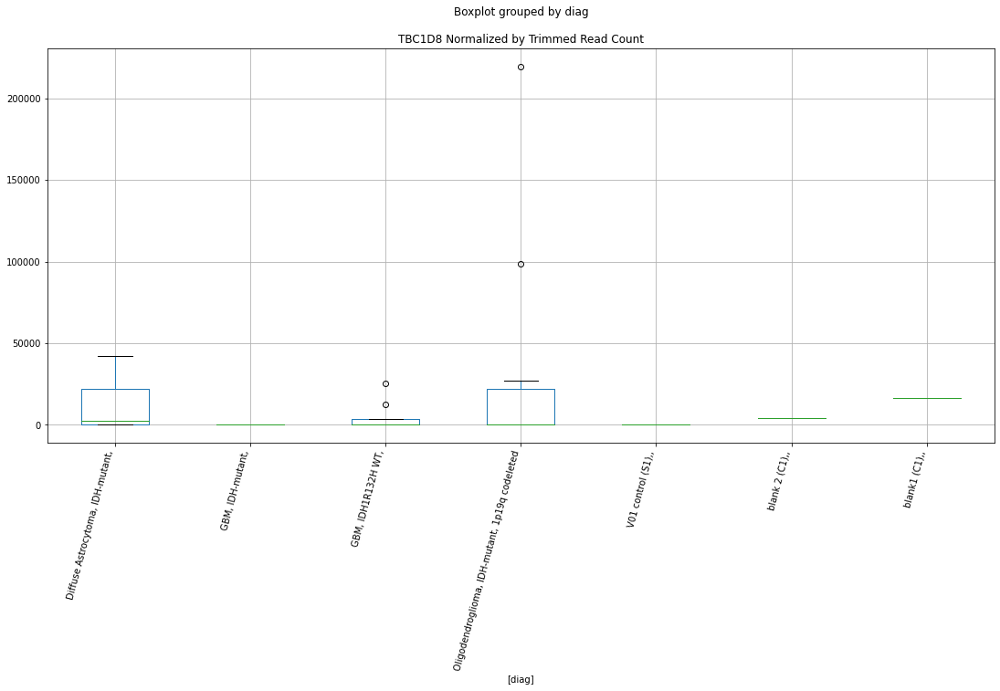

 p : 0.027713873434095294  ( t : 2.3949264007387026 ) :  D-plex  :  bbduk2  :  THAP4
Control and blanks
73     0.0
337    0.0
Name: THAP4, dtype: float64
205    358.18
Name: THAP4, dtype: float64
469    0.0
Name: THAP4, dtype: float64


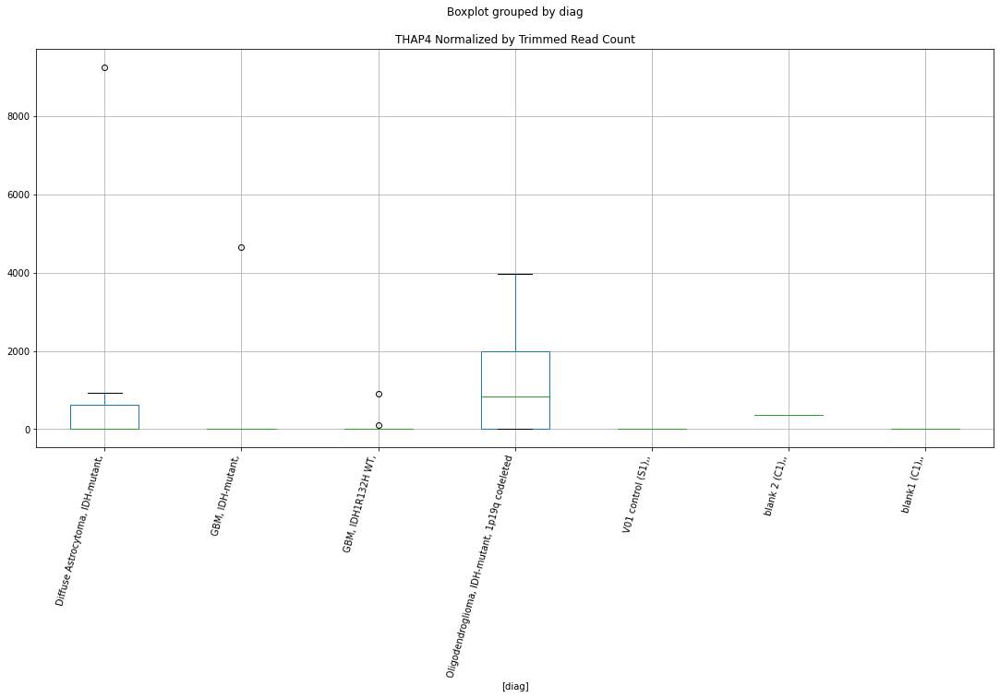

 p : 0.0277150171813278  ( t : 2.3949062803563033 ) :  D-plex  :  bbduk2  :  WDR62
Control and blanks
73      18552.2
337    135303.9
Name: WDR62, dtype: float64
205    15580.91
Name: WDR62, dtype: float64
469    30759.42
Name: WDR62, dtype: float64


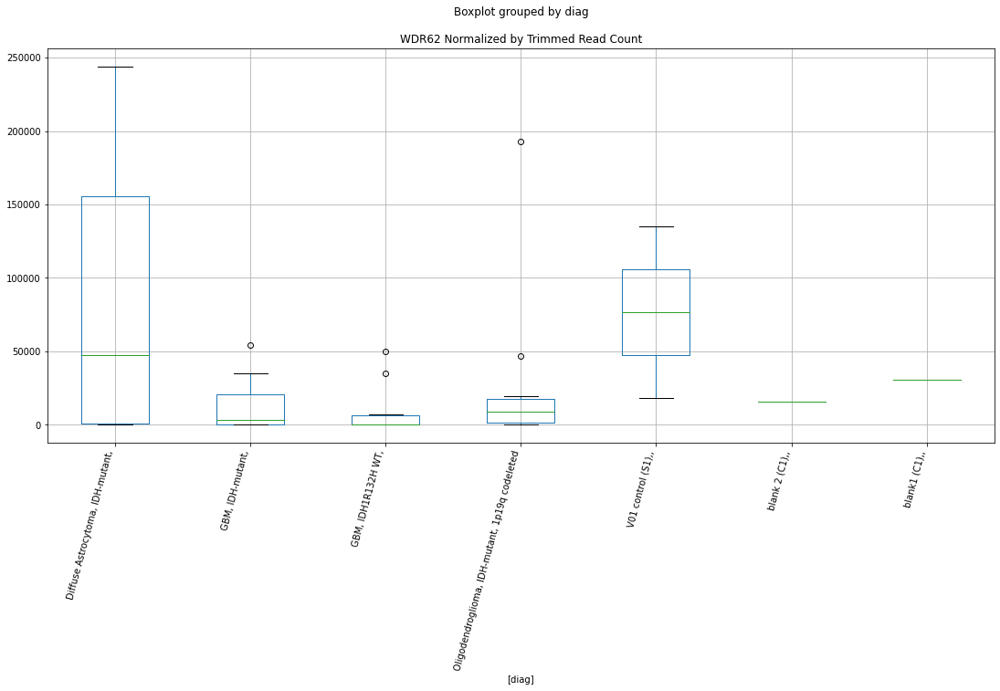

 p : 0.027752781065424593  ( t : 2.394242387392523 ) :  D-plex  :  bbduk2  :  WDR82
Control and blanks
73     0.0
337    0.0
Name: WDR82, dtype: float64
205    1611.82
Name: WDR82, dtype: float64
469    1183.05
Name: WDR82, dtype: float64


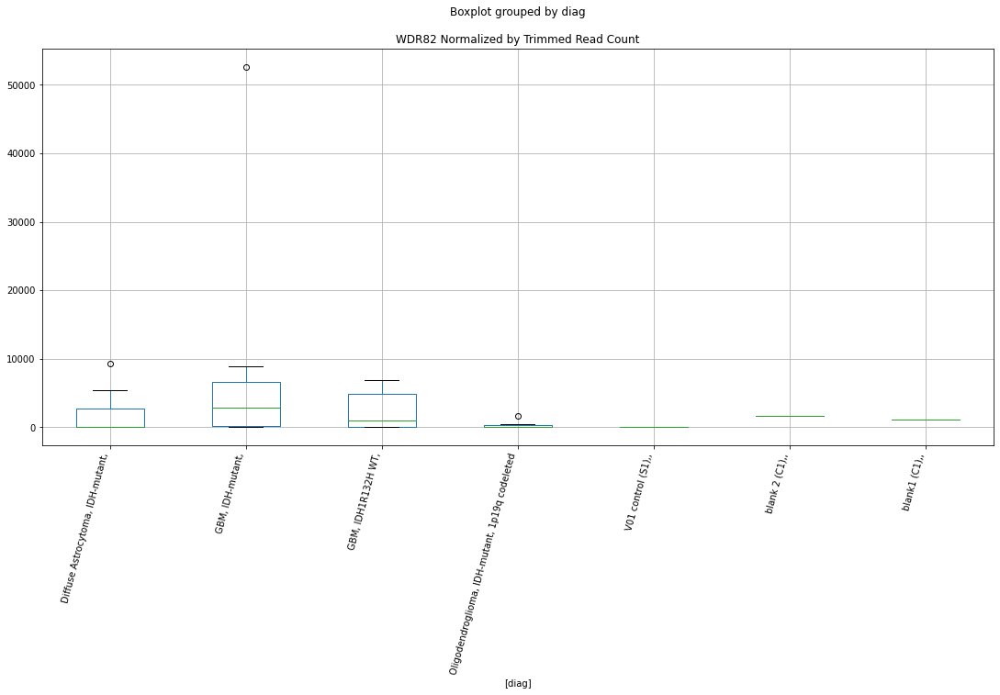

 p : 0.027821978818677016  ( t : 2.3930280717286108 ) :  Lexogen  :  bbduk2  :  VSTM1
Control and blanks
79         0.00
343    15711.26
Name: VSTM1, dtype: float64
211    0.0
Name: VSTM1, dtype: float64
475    8862.08
Name: VSTM1, dtype: float64


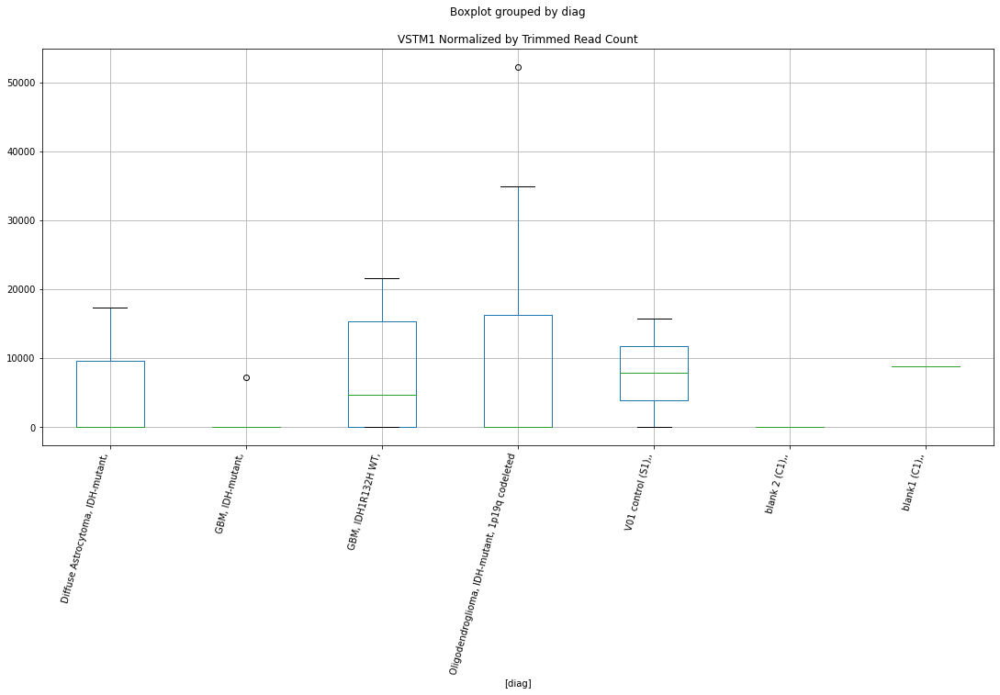

 p : 0.027883534557067387  ( t : 2.3919502316113284 ) :  D-plex  :  bbduk2  :  ZNF620
Control and blanks
73     0.0
337    0.0
Name: ZNF620, dtype: float64
205    5730.91
Name: ZNF620, dtype: float64
469    0.0
Name: ZNF620, dtype: float64


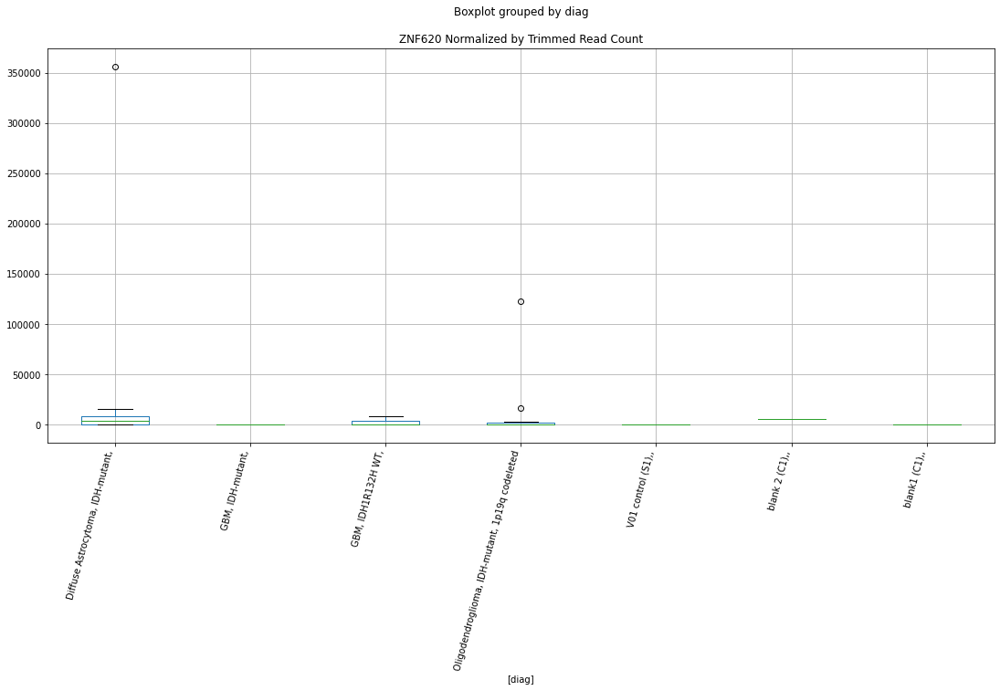

 p : 0.027886171788001304  ( t : 2.3919041034224278 ) :  Lexogen  :  bbduk2  :  ST3GAL2
Control and blanks
79     0.0
343    0.0
Name: ST3GAL2, dtype: float64
211    3552.98
Name: ST3GAL2, dtype: float64
475    479.03
Name: ST3GAL2, dtype: float64


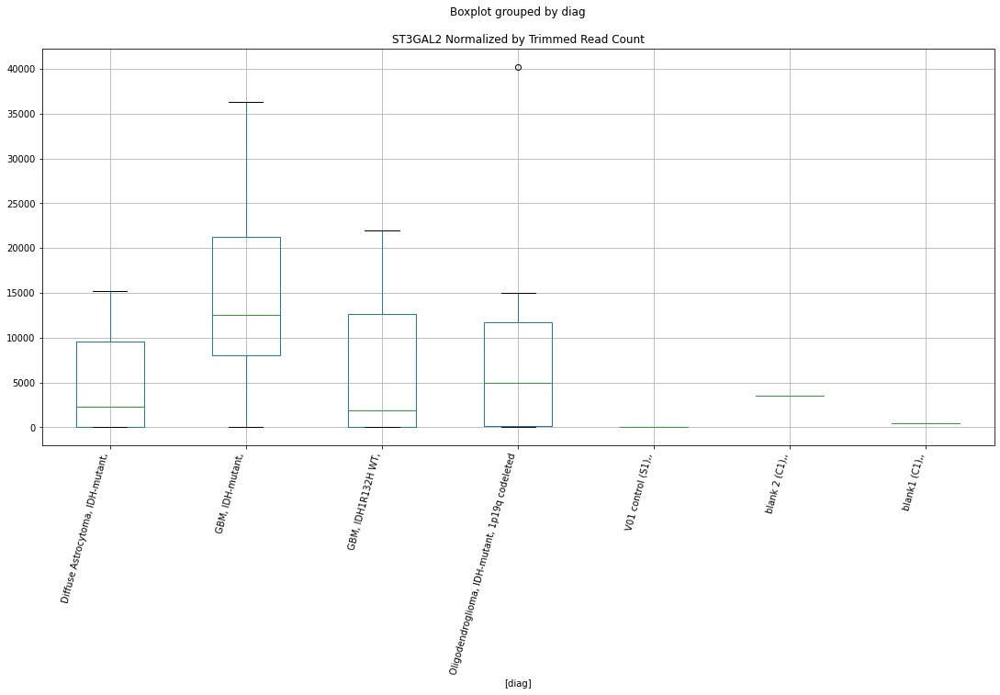

 p : 0.02789342935825612  ( t : 2.391777181249745 ) :  Lexogen  :  bbduk2  :  TMC5
Control and blanks
79     0.0
343    0.0
Name: TMC5, dtype: float64
211    0.0
Name: TMC5, dtype: float64
475    0.0
Name: TMC5, dtype: float64


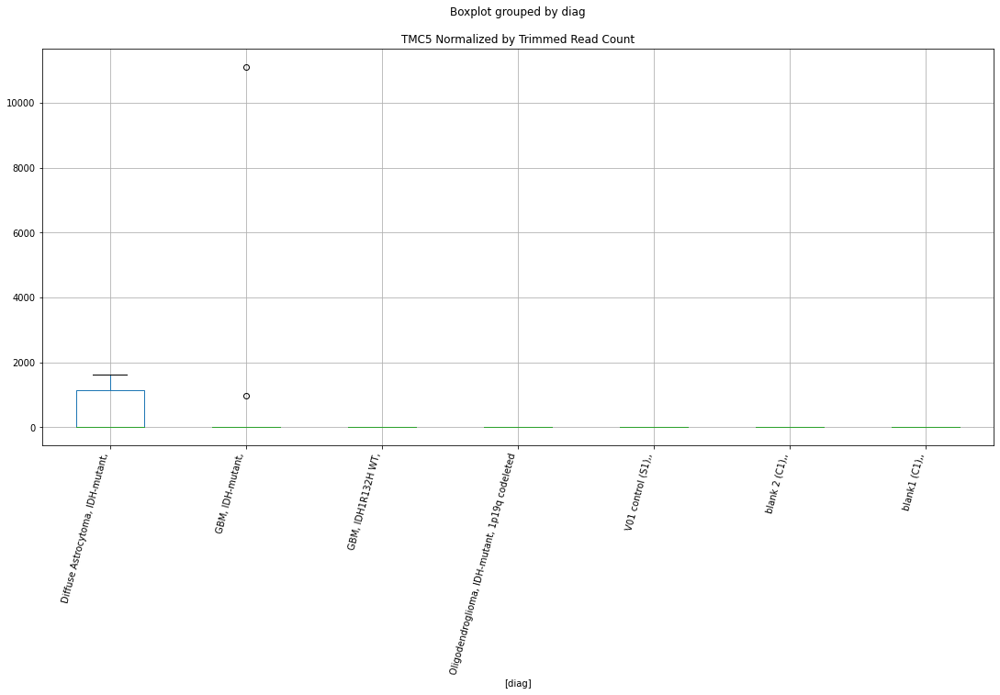

 p : 0.027904204864940305  ( t : 2.3915887934484963 ) :  D-plex  :  cutadapt2  :  YWHAB
Control and blanks
76     0.0
340    0.0
Name: YWHAB, dtype: float64
208    5819.89
Name: YWHAB, dtype: float64
472    13870.94
Name: YWHAB, dtype: float64


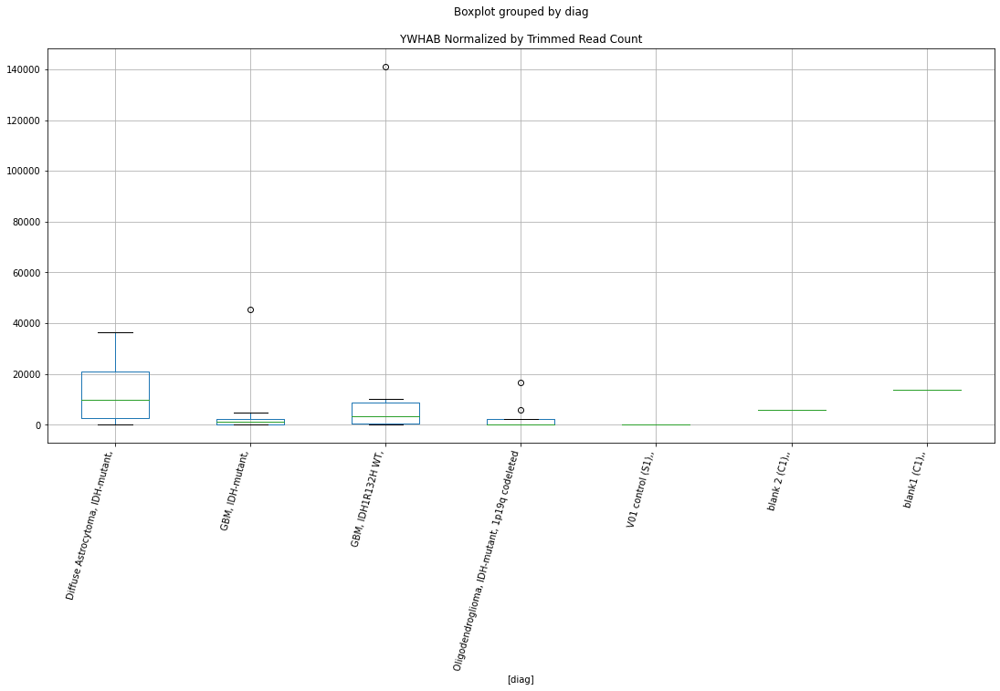

 p : 0.027975889135317428  ( t : 2.3903372673885213 ) :  D-plex  :  cutadapt2  :  ZBTB47
Control and blanks
76        0.00
340    1761.46
Name: ZBTB47, dtype: float64
208    1058.16
Name: ZBTB47, dtype: float64
472    1155.91
Name: ZBTB47, dtype: float64


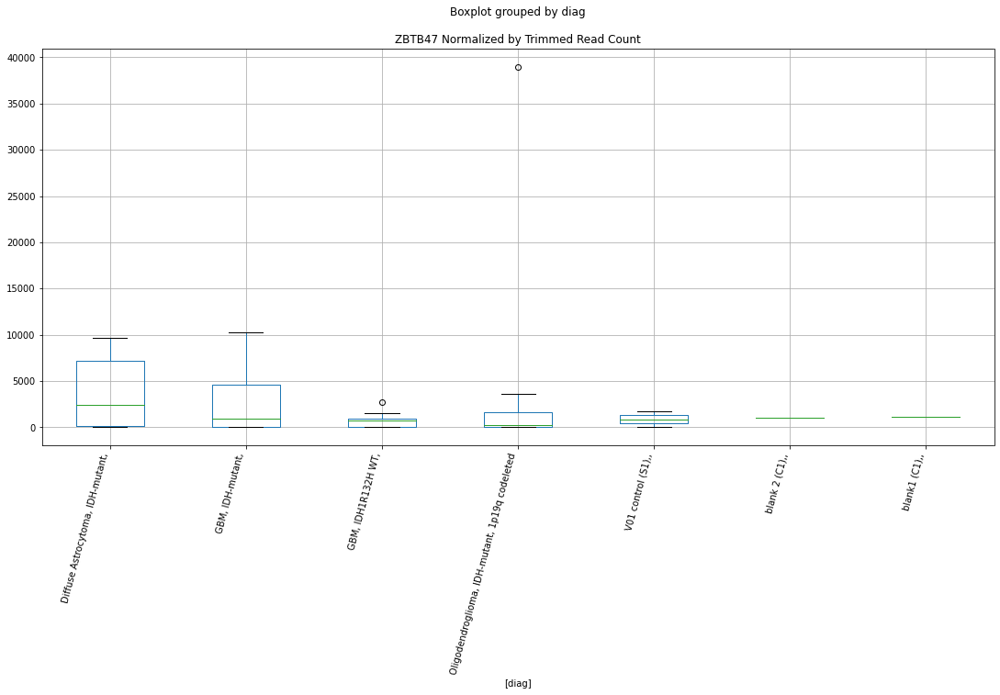

 p : 0.028040088981319537  ( t : 2.389218951598232 ) :  D-plex  :  cutadapt2  :  SPI1
Control and blanks
76     466690.35
340    165577.64
Name: SPI1, dtype: float64
208    625020.61
Name: SPI1, dtype: float64
472    7.47e+06
Name: SPI1, dtype: float64


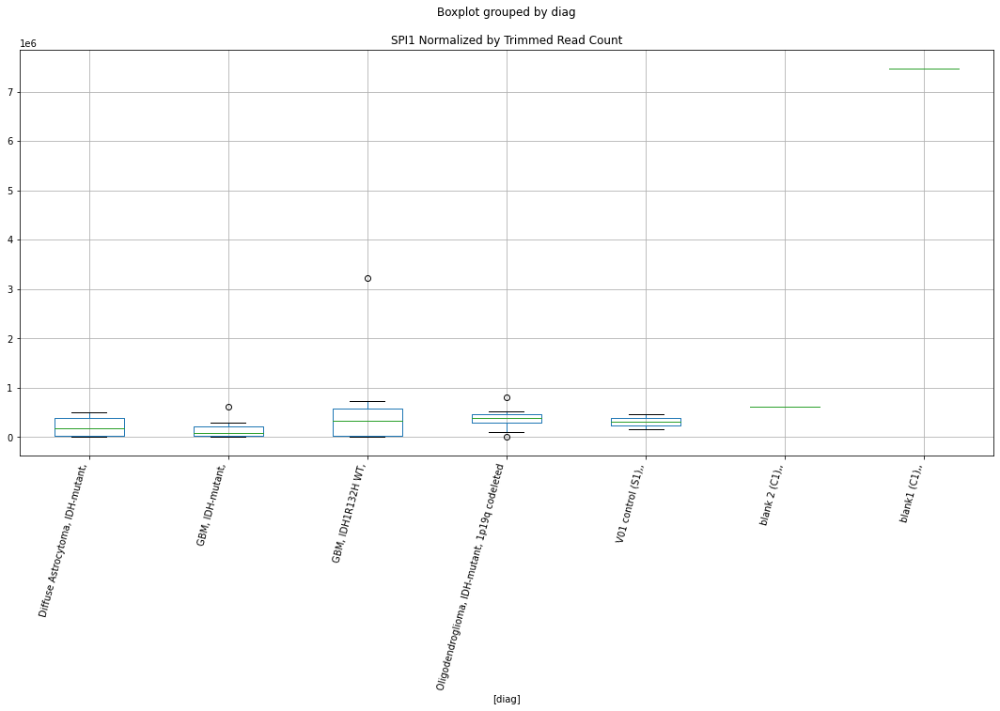

 p : 0.028068081928345257  ( t : 2.388732083040588 ) :  D-plex  :  cutadapt2  :  TUBB1
Control and blanks
76      3788.07
340    76623.70
Name: TUBB1, dtype: float64
208    39151.97
Name: TUBB1, dtype: float64
472    43924.64
Name: TUBB1, dtype: float64


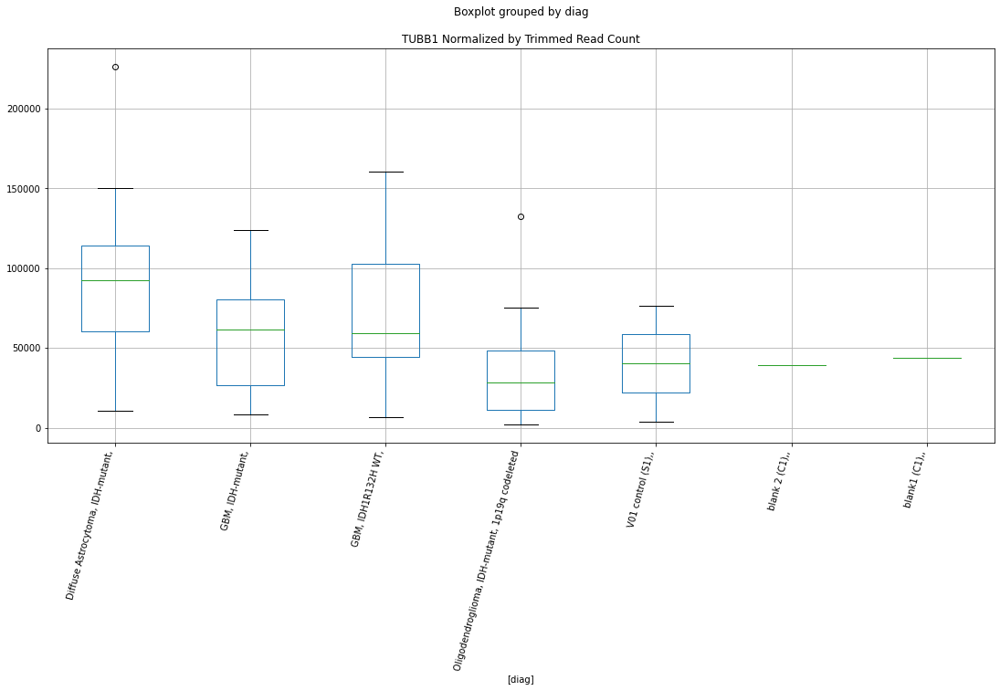

 p : 0.028119209152674  ( t : 2.3878440202062774 ) :  D-plex  :  cutadapt2  :  UBE3D
Control and blanks
76     757.61
340      0.00
Name: UBE3D, dtype: float64
208    2116.32
Name: UBE3D, dtype: float64
472    0.0
Name: UBE3D, dtype: float64


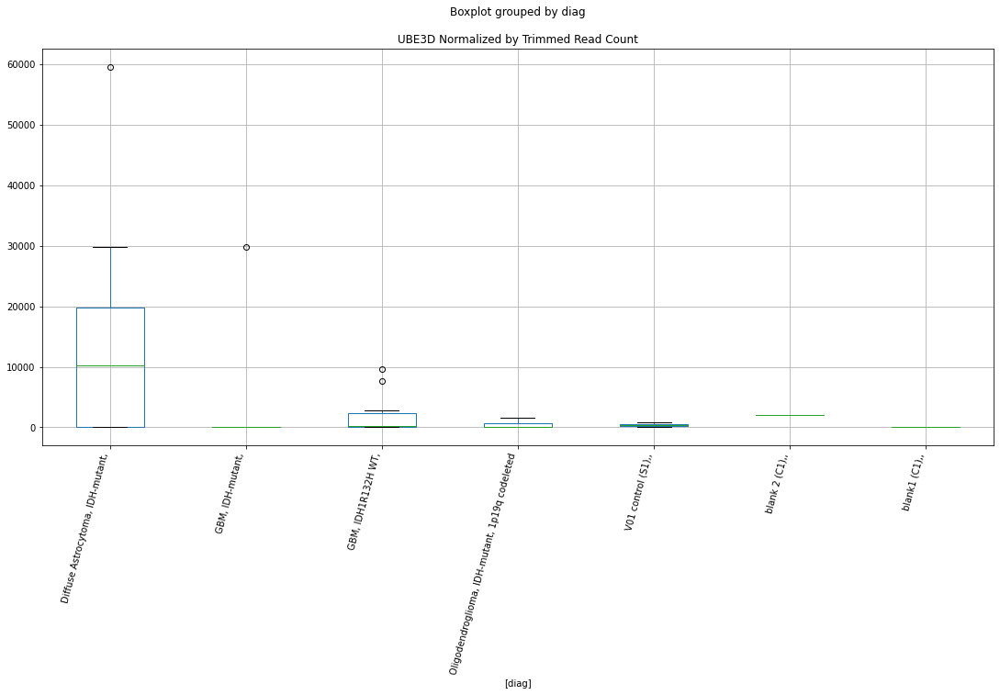

 p : 0.028211355824326205  ( t : 2.386247265359953 ) :  D-plex  :  cutadapt2  :  ZACN
Control and blanks
76         0.0
340    22018.3
Name: ZACN, dtype: float64
208    176.36
Name: ZACN, dtype: float64
472    577.96
Name: ZACN, dtype: float64


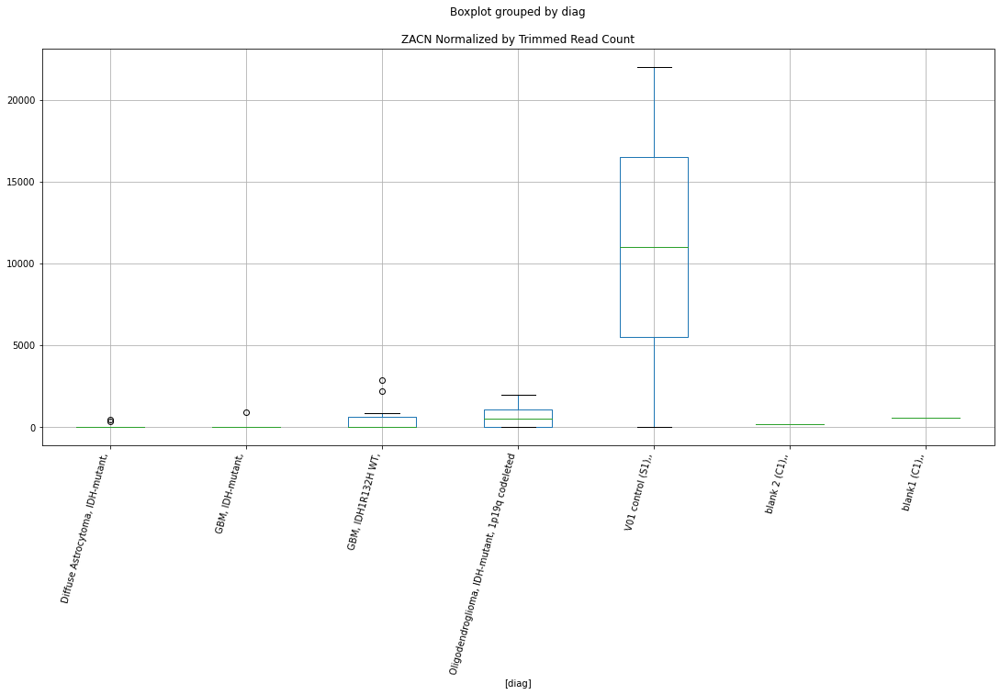

 p : 0.028218560883595964  ( t : 2.386122618604255 ) :  Lexogen  :  bbduk2  :  ZNF280A
Control and blanks
79       0.00
343    849.26
Name: ZNF280A, dtype: float64
211    13118.7
Name: ZNF280A, dtype: float64
475    14370.94
Name: ZNF280A, dtype: float64


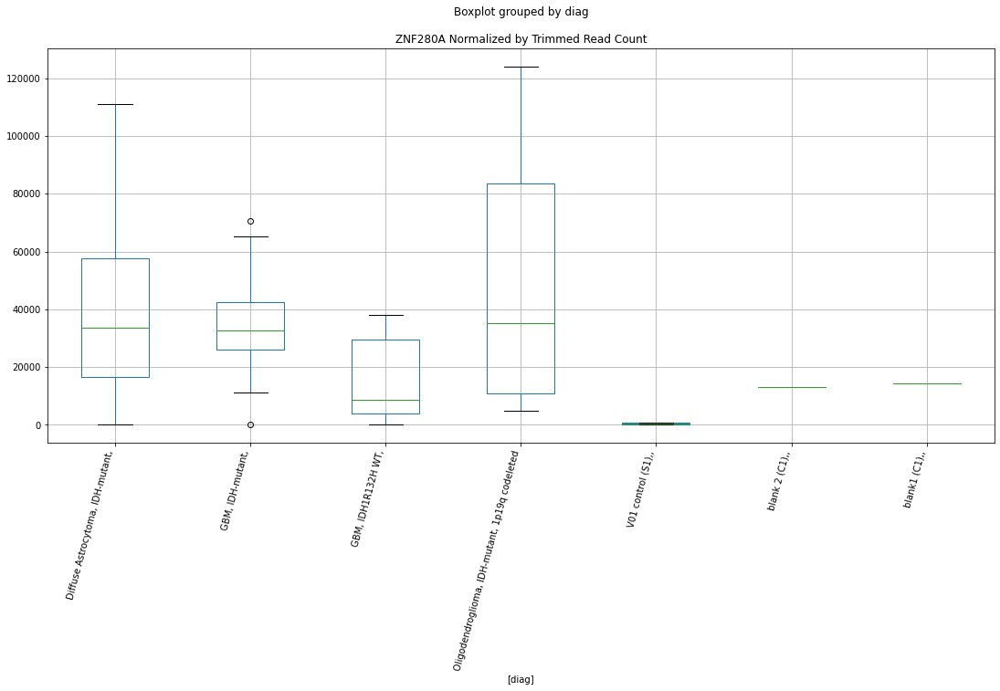

 p : 0.028244357460689342  ( t : 2.385676584176775 ) :  D-plex  :  cutadapt2  :  USP31
Control and blanks
76     0.0
340    0.0
Name: USP31, dtype: float64
208    1939.96
Name: USP31, dtype: float64
472    0.0
Name: USP31, dtype: float64


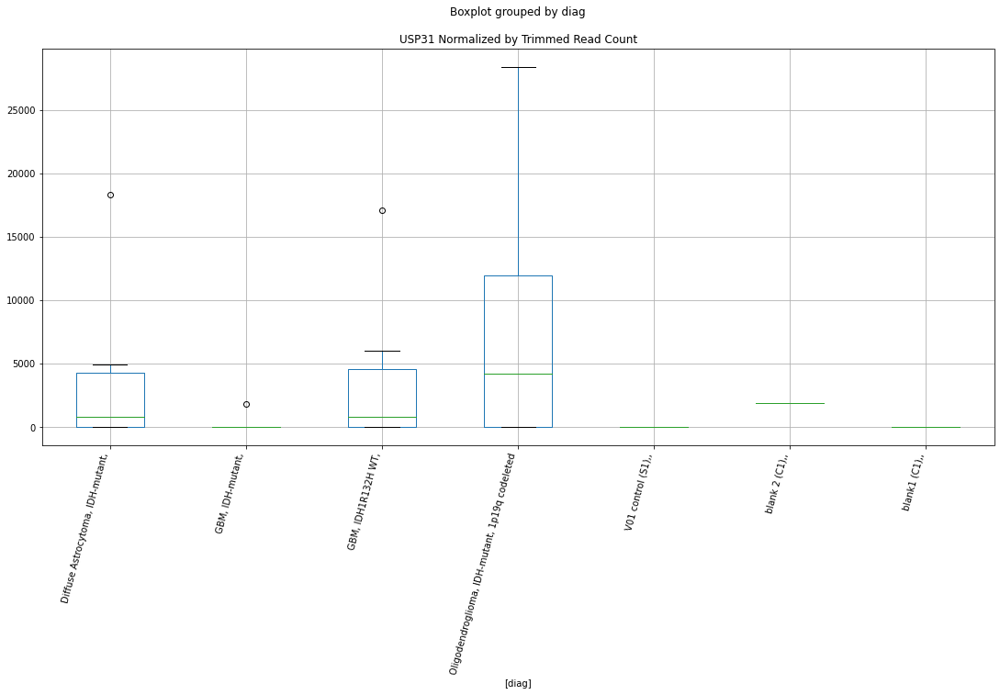

 p : 0.028298959445352278  ( t : 2.3847337448663337 ) :  D-plex  :  bbduk2  :  VCP
Control and blanks
73     2319.03
337       0.00
Name: VCP, dtype: float64
205    3760.91
Name: VCP, dtype: float64
469    4732.22
Name: VCP, dtype: float64


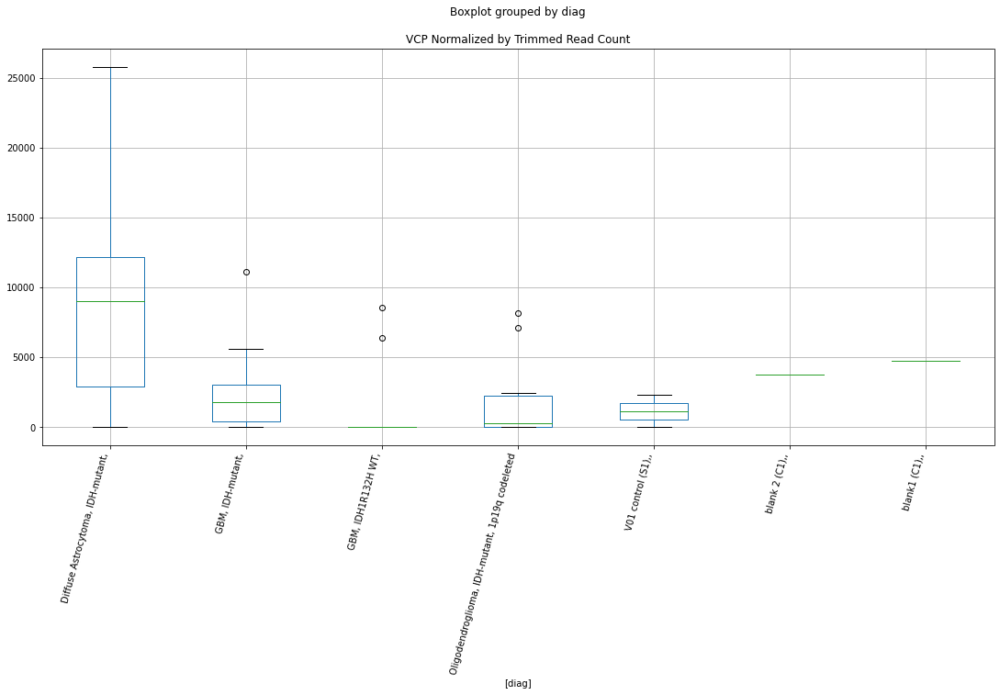

 p : 0.028327660671387197  ( t : 2.3842388276980038 ) :  D-plex  :  bbduk2  :  SPI1
Control and blanks
73     476173.18
337    167349.57
Name: SPI1, dtype: float64
205    634698.33
Name: SPI1, dtype: float64
469    7.62e+06
Name: SPI1, dtype: float64


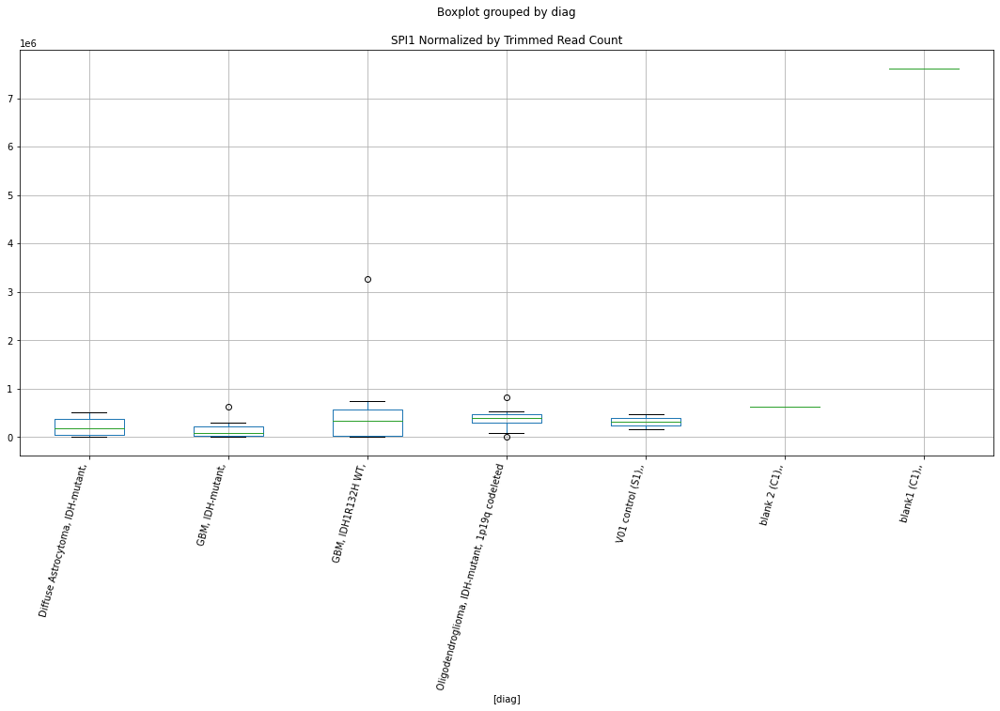

 p : 0.028384838302723144  ( t : 2.383254264192014 ) :  D-plex  :  bbduk2  :  ZACN
Control and blanks
73         0.00
337    22253.93
Name: ZACN, dtype: float64
205    179.09
Name: ZACN, dtype: float64
469    591.53
Name: ZACN, dtype: float64


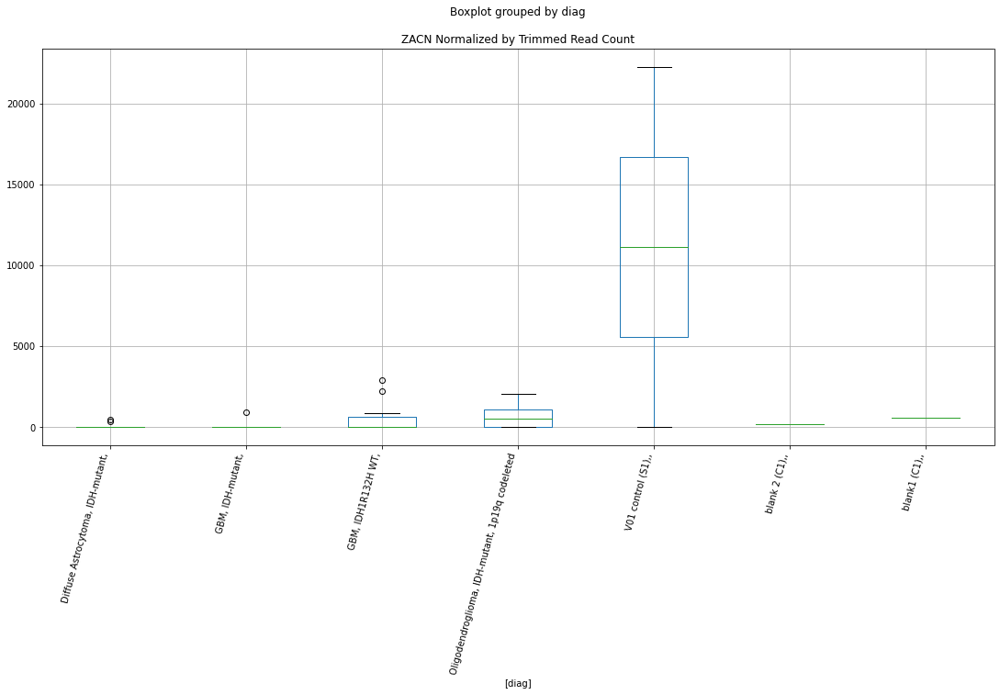

 p : 0.02846595482477123  ( t : 2.3818606602948487 ) :  D-plex  :  cutadapt2  :  XRN1
Control and blanks
76        0.00
340    8807.32
Name: XRN1, dtype: float64
208    29099.44
Name: XRN1, dtype: float64
472    38723.04
Name: XRN1, dtype: float64


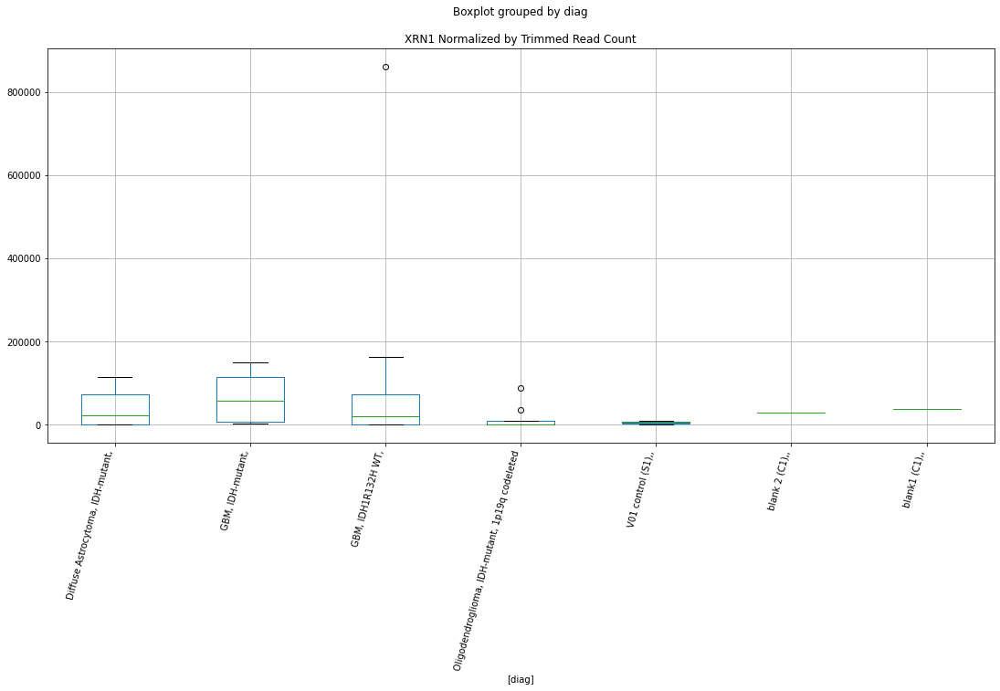

 p : 0.028508604268727724  ( t : 2.3811294178306834 ) :  D-plex  :  bbduk2  :  USP31
Control and blanks
73     0.0
337    0.0
Name: USP31, dtype: float64
205    1970.0
Name: USP31, dtype: float64
469    2957.64
Name: USP31, dtype: float64


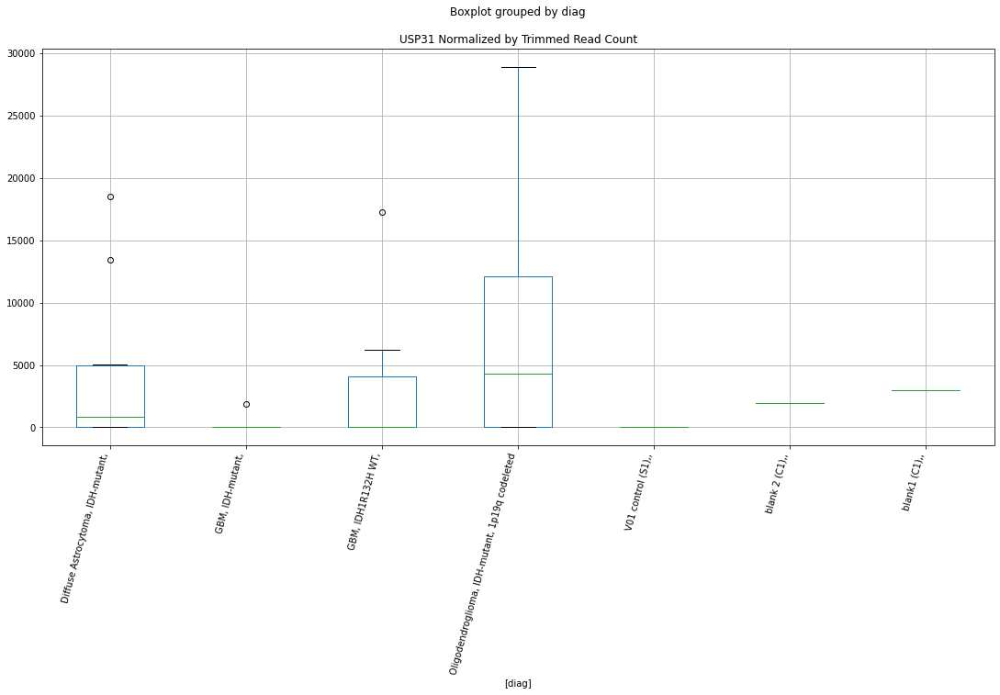

 p : 0.028509847643879847  ( t : 2.3811081149717244 ) :  Lexogen  :  bbduk2  :  ST20-AS1
Control and blanks
79       0.00
343    424.63
Name: ST20-AS1, dtype: float64
211    2186.45
Name: ST20-AS1, dtype: float64
475    0.0
Name: ST20-AS1, dtype: float64


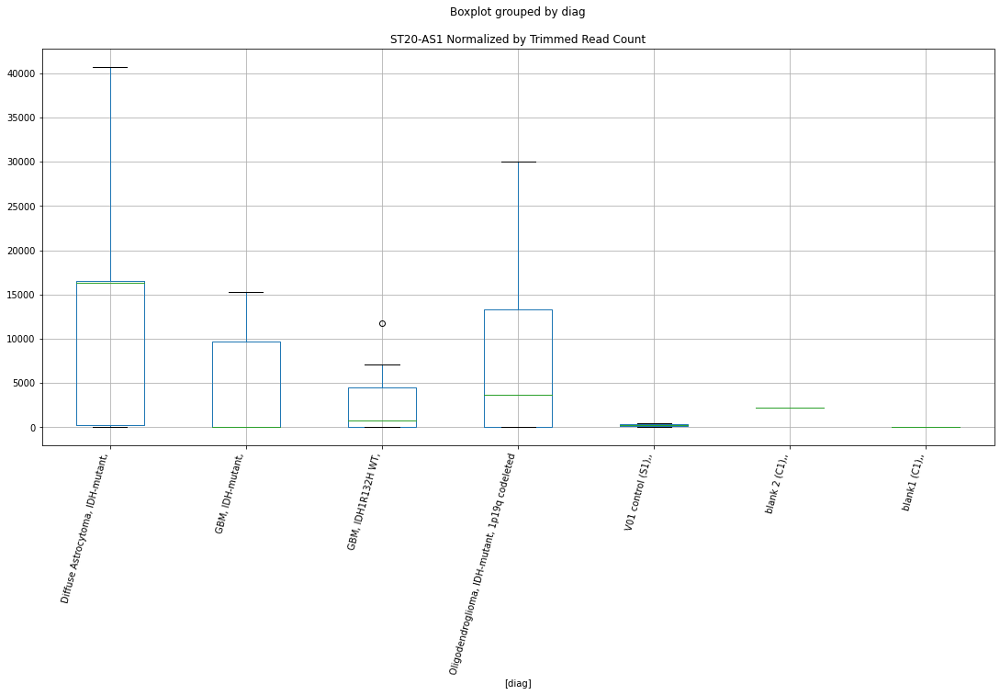

 p : 0.028539993318272866  ( t : 2.380591891668975 ) :  Lexogen  :  cutadapt2  :  ST20-AS1
Control and blanks
82       0.00
346    420.87
Name: ST20-AS1, dtype: float64
214    2169.81
Name: ST20-AS1, dtype: float64
478    0.0
Name: ST20-AS1, dtype: float64


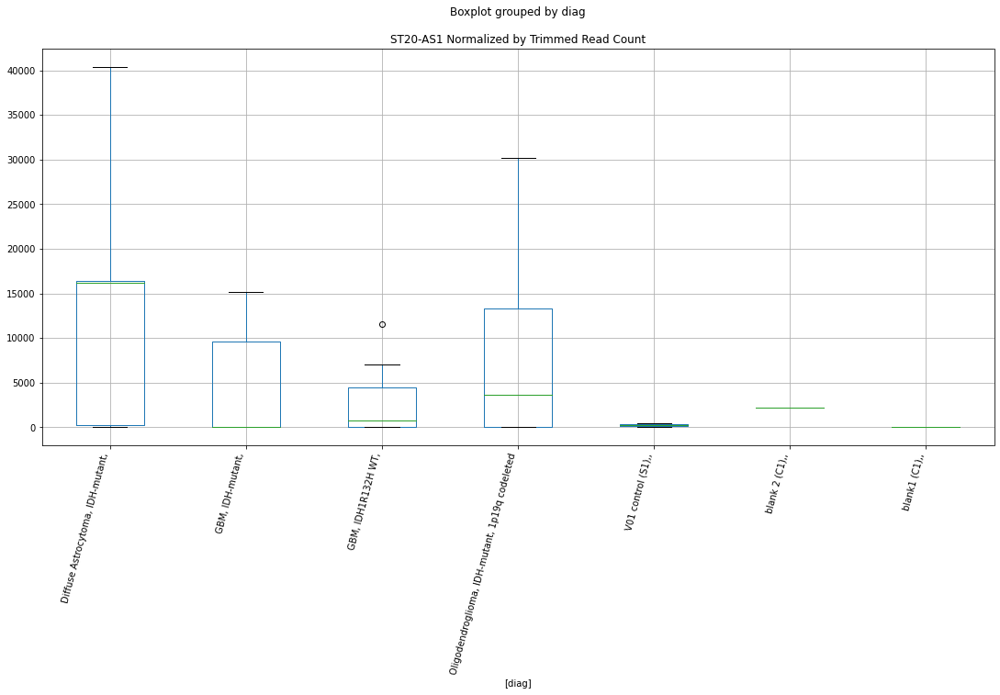

 p : 0.028630914343535017  ( t : 2.379038010655642 ) :  D-plex  :  cutadapt2  :  XRCC6
Control and blanks
76     3030.46
340       0.00
Name: XRCC6, dtype: float64
208    65782.36
Name: XRCC6, dtype: float64
472    2889.78
Name: XRCC6, dtype: float64


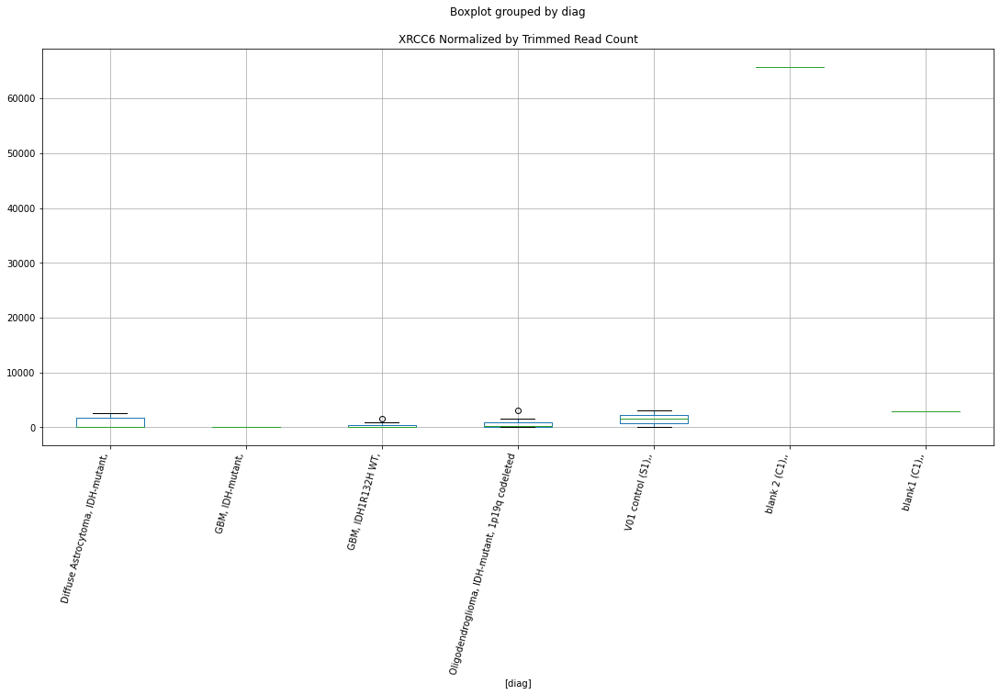

 p : 0.02874459522292705  ( t : 2.377101620565666 ) :  Lexogen  :  cutadapt2  :  ZNF165
Control and blanks
82     0.0
346    0.0
Name: ZNF165, dtype: float64
214    0.0
Name: ZNF165, dtype: float64
478    0.0
Name: ZNF165, dtype: float64


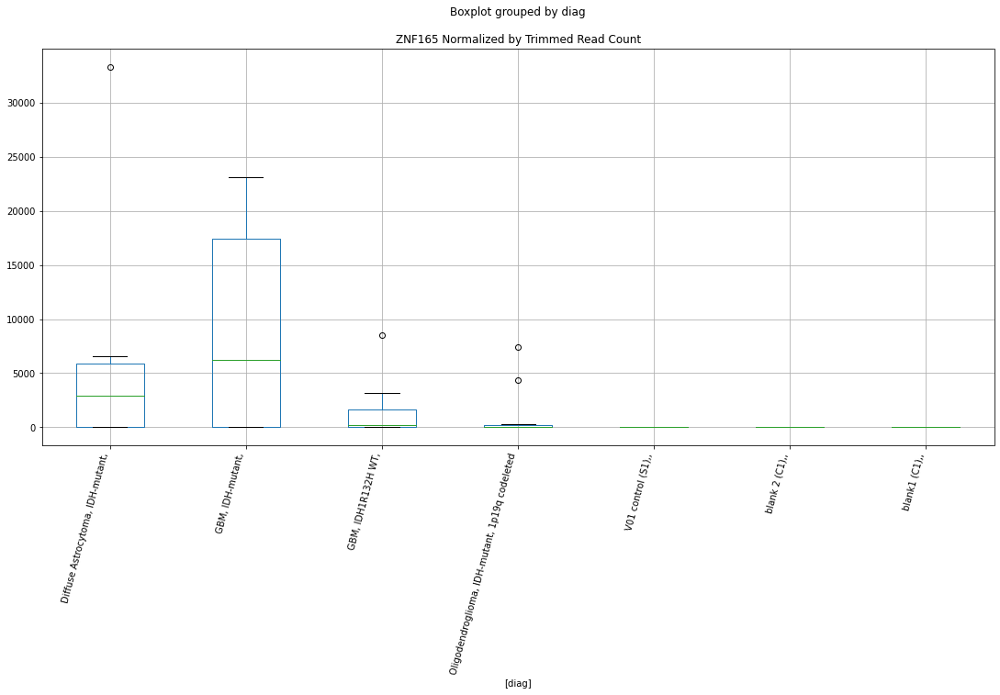

 p : 0.02875497849607873  ( t : 2.3769251128632645 ) :  D-plex  :  cutadapt2  :  TBC1D8
Control and blanks
76     0.0
340    0.0
Name: TBC1D8, dtype: float64
208    2116.32
Name: TBC1D8, dtype: float64
472    11559.12
Name: TBC1D8, dtype: float64


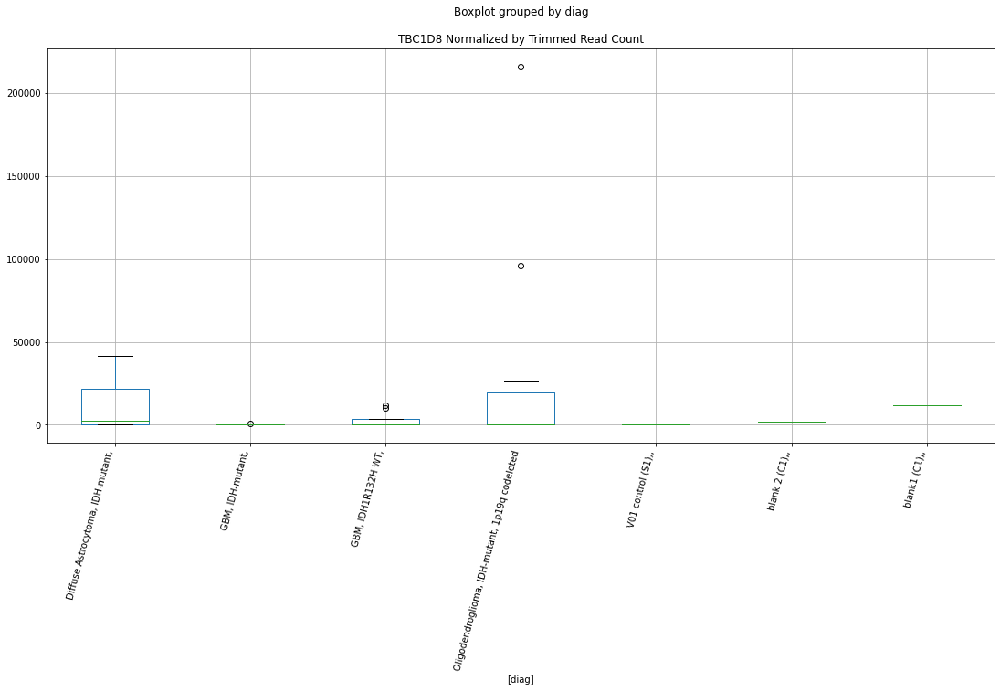

 p : 0.028843669869612846  ( t : 2.375419846653809 ) :  D-plex  :  bbduk2  :  TCHH
Control and blanks
73     15460.17
337    22253.93
Name: TCHH, dtype: float64
205    2507.27
Name: TCHH, dtype: float64
469    5323.75
Name: TCHH, dtype: float64


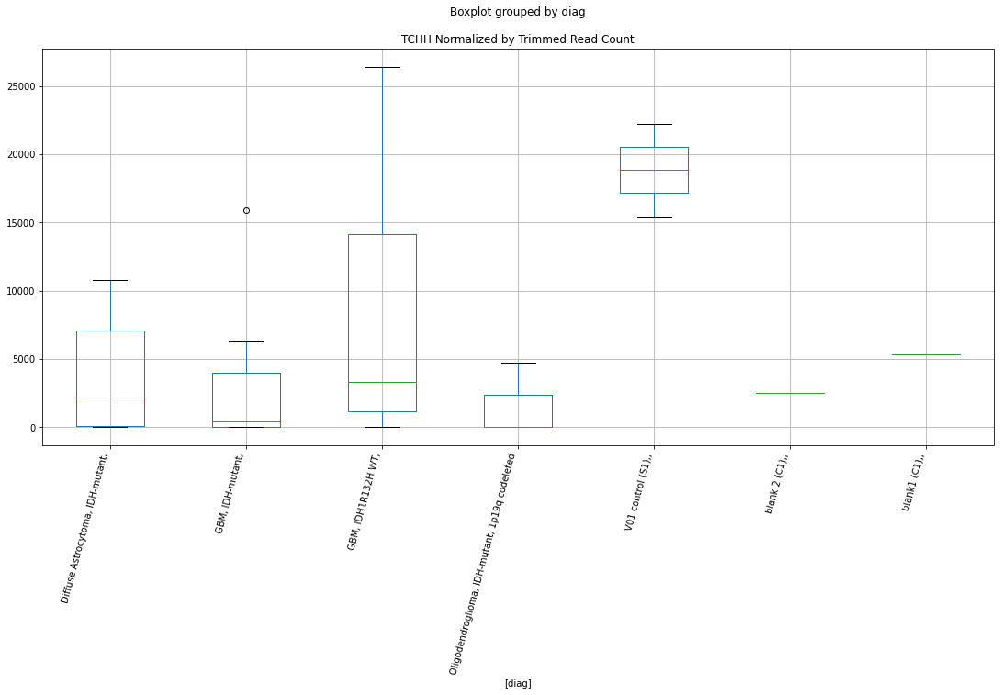

 p : 0.028860484898502643  ( t : 2.375134949863325 ) :  D-plex  :  cutadapt2  :  WNK1
Control and blanks
76      18182.74
340    401613.85
Name: WNK1, dtype: float64
208    249902.43
Name: WNK1, dtype: float64
472    207486.15
Name: WNK1, dtype: float64


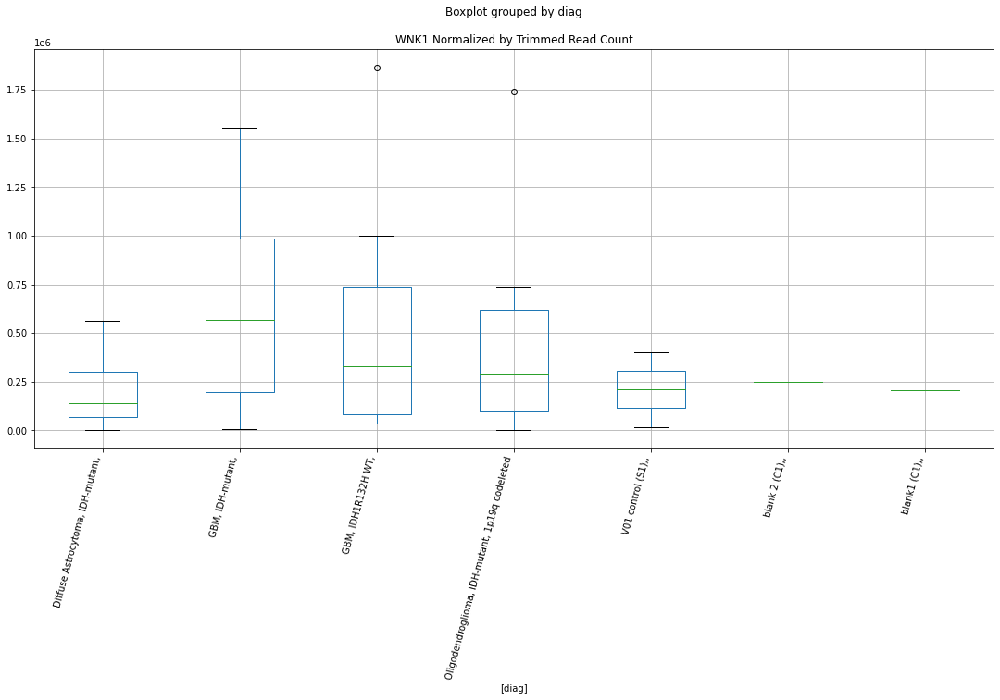

 p : 0.028862294789149593  ( t : 2.375104294146151 ) :  D-plex  :  cutadapt2  :  SPRED2
Control and blanks
76     0.0
340    0.0
Name: SPRED2, dtype: float64
208    6701.69
Name: SPRED2, dtype: float64
472    29475.75
Name: SPRED2, dtype: float64


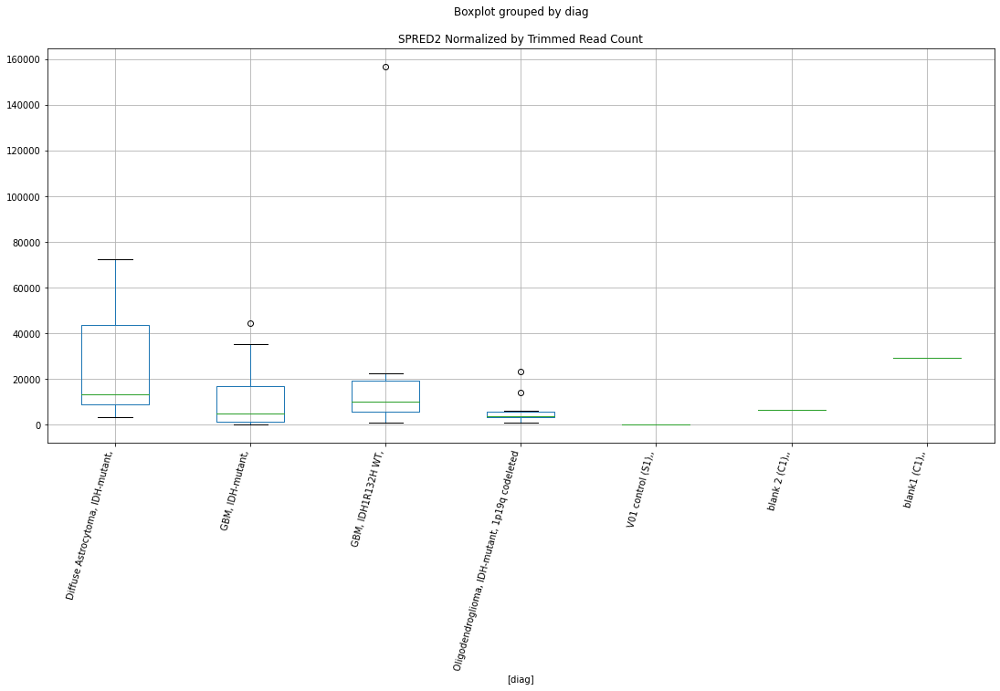

 p : 0.02890861067726919  ( t : 2.3743204106978713 ) :  D-plex  :  cutadapt2  :  UBE2U
Control and blanks
76     265922.59
340         0.00
Name: UBE2U, dtype: float64
208    4761.73
Name: UBE2U, dtype: float64
472    14448.9
Name: UBE2U, dtype: float64


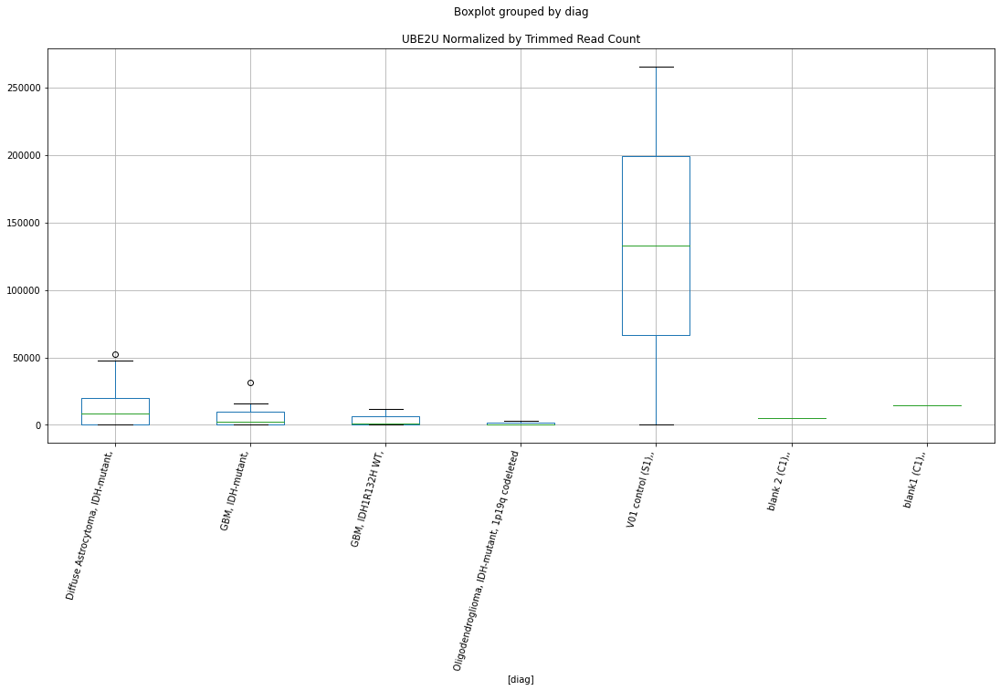

 p : 0.02892364233157892  ( t : 2.374066256020509 ) :  D-plex  :  cutadapt2  :  TRAPPC9
Control and blanks
76     784130.71
340    221944.50
Name: TRAPPC9, dtype: float64
208    672108.79
Name: TRAPPC9, dtype: float64
472    172808.8
Name: TRAPPC9, dtype: float64


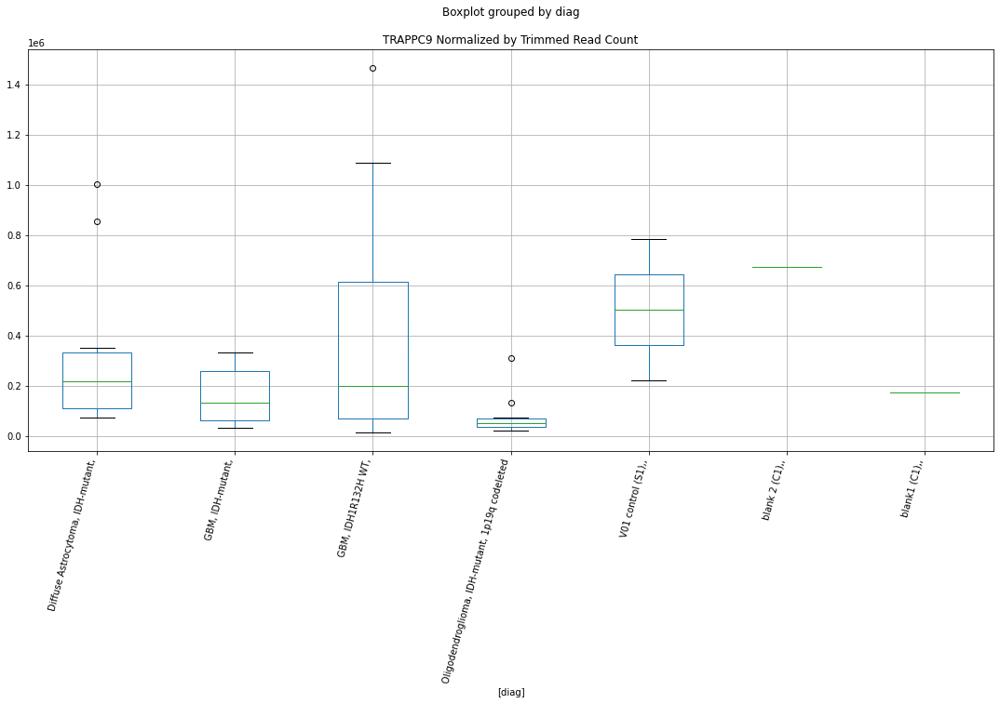

 p : 0.02894870713972278  ( t : 2.373642735091354 ) :  D-plex  :  bbduk2  :  SUPT3H
Control and blanks
73       0.00
337    890.16
Name: SUPT3H, dtype: float64
205    8596.37
Name: SUPT3H, dtype: float64
469    4732.22
Name: SUPT3H, dtype: float64


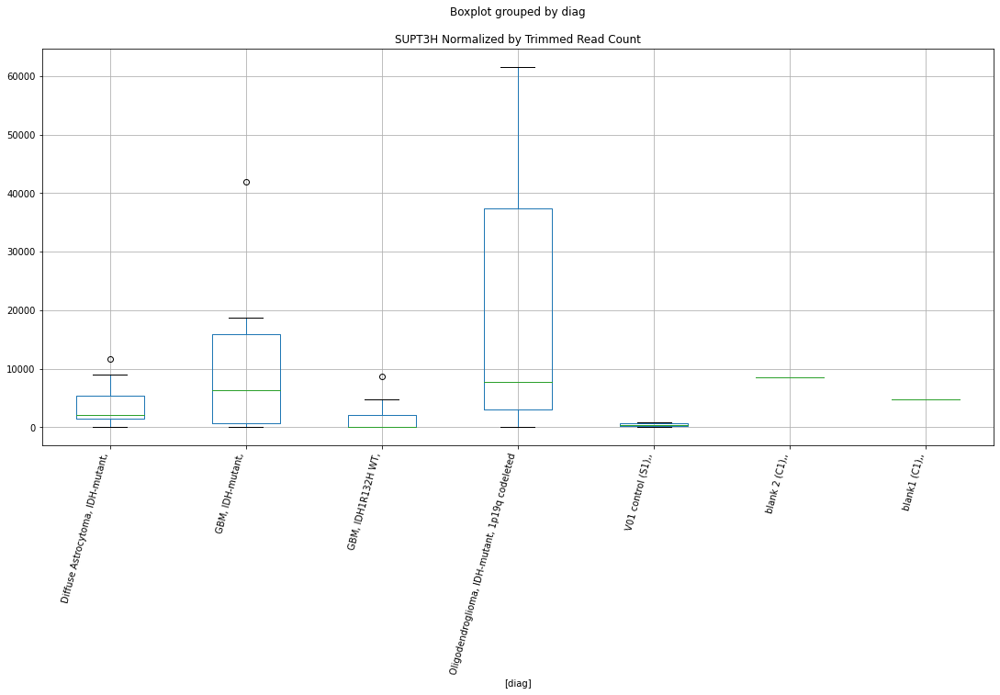

 p : 0.02907938124086307  ( t : 2.3714402563431154 ) :  Lexogen  :  cutadapt2  :  ST3GAL2
Control and blanks
82     0.0
346    0.0
Name: ST3GAL2, dtype: float64
214    3525.94
Name: ST3GAL2, dtype: float64
478    237.46
Name: ST3GAL2, dtype: float64


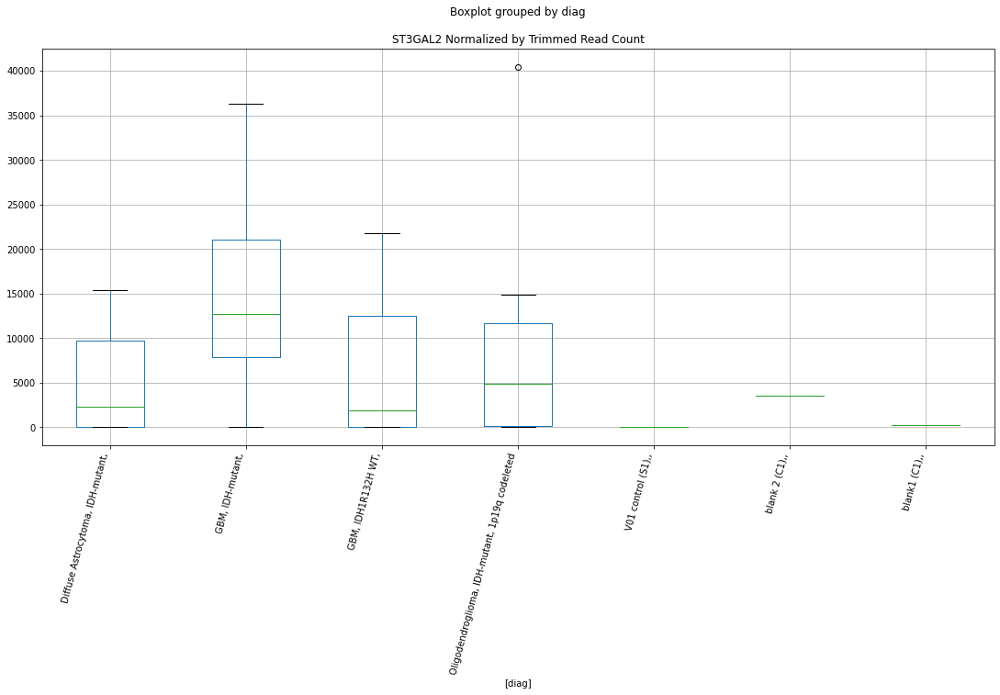

 p : 0.029275127192409173  ( t : 2.3681582206428495 ) :  D-plex  :  cutadapt2  :  TMEM196
Control and blanks
76     0.0
340    0.0
Name: TMEM196, dtype: float64
208    2292.68
Name: TMEM196, dtype: float64
472    10981.16
Name: TMEM196, dtype: float64


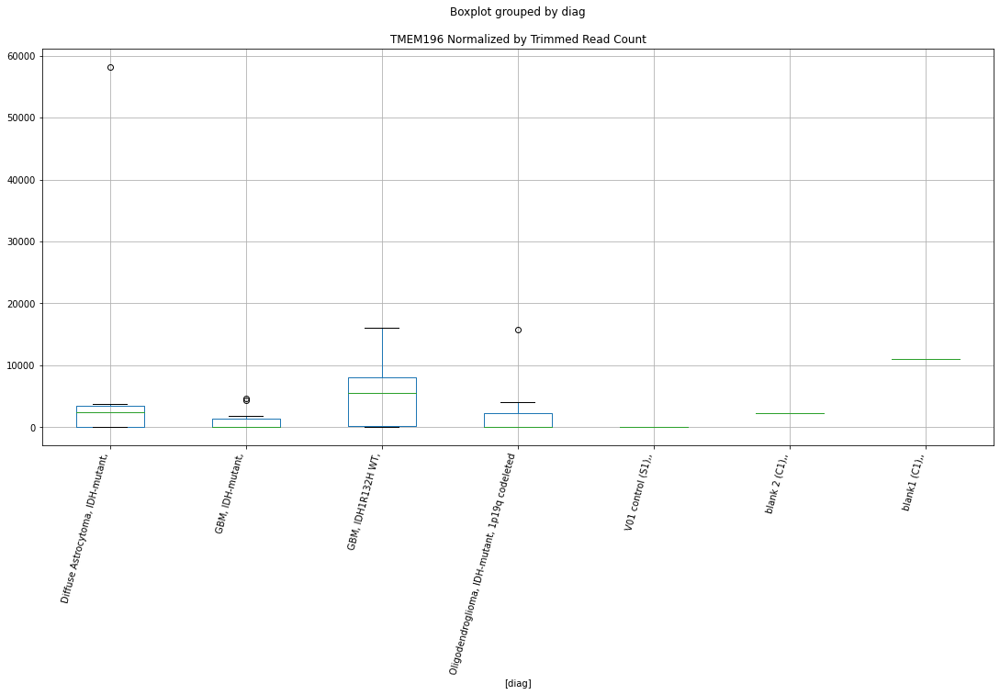

 p : 0.029276774539558795  ( t : 2.368130686832733 ) :  Lexogen  :  cutadapt2  :  ZNF771
Control and blanks
82     0.0
346    0.0
Name: ZNF771, dtype: float64
214    0.0
Name: ZNF771, dtype: float64
478    12822.87
Name: ZNF771, dtype: float64


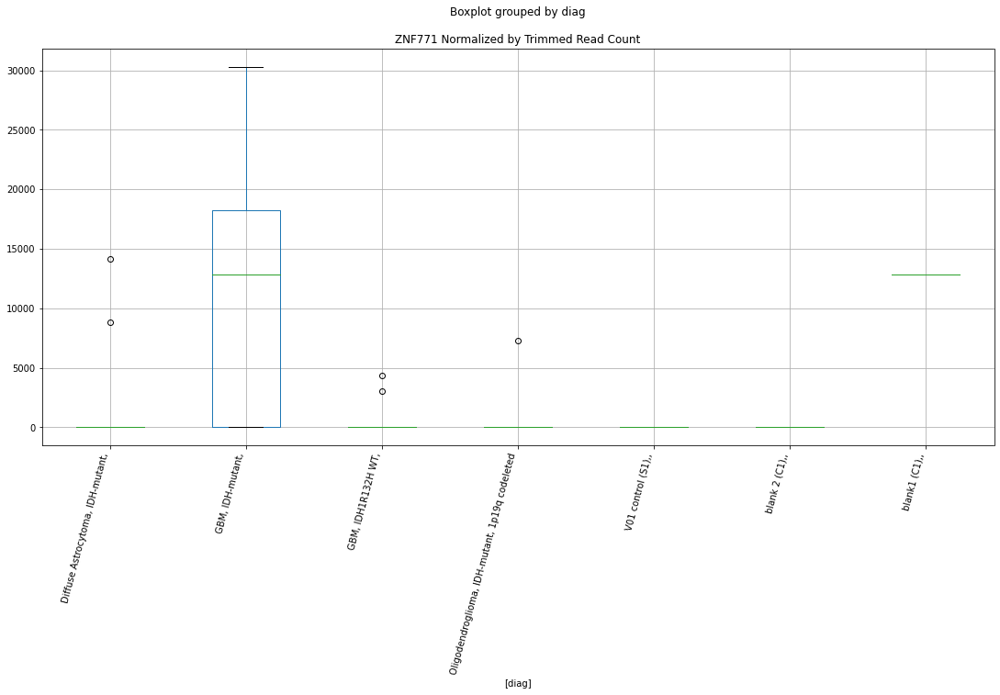

 p : 0.029410174426790288  ( t : 2.3659058186080464 ) :  Lexogen  :  cutadapt2  :  ZNF865
Control and blanks
82     0.0
346    0.0
Name: ZNF865, dtype: float64
214    0.0
Name: ZNF865, dtype: float64
478    0.0
Name: ZNF865, dtype: float64


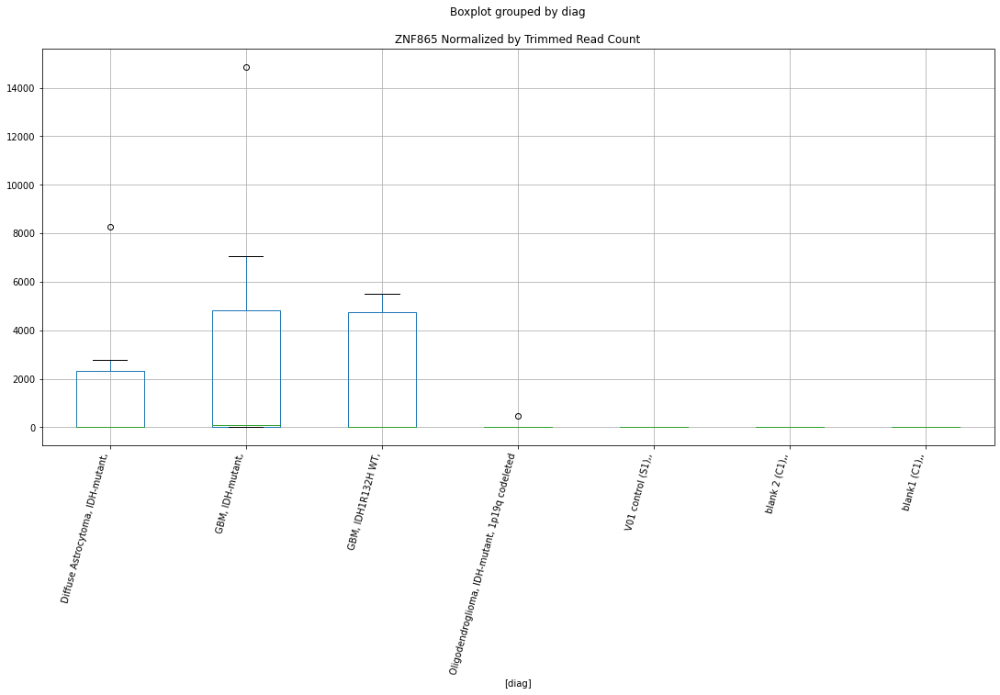

 p : 0.029450935893445142  ( t : 2.365227868049675 ) :  D-plex  :  bbduk2  :  UNC5C
Control and blanks
73     136049.48
337         0.00
Name: UNC5C, dtype: float64
205    21132.73
Name: UNC5C, dtype: float64
469    17154.29
Name: UNC5C, dtype: float64


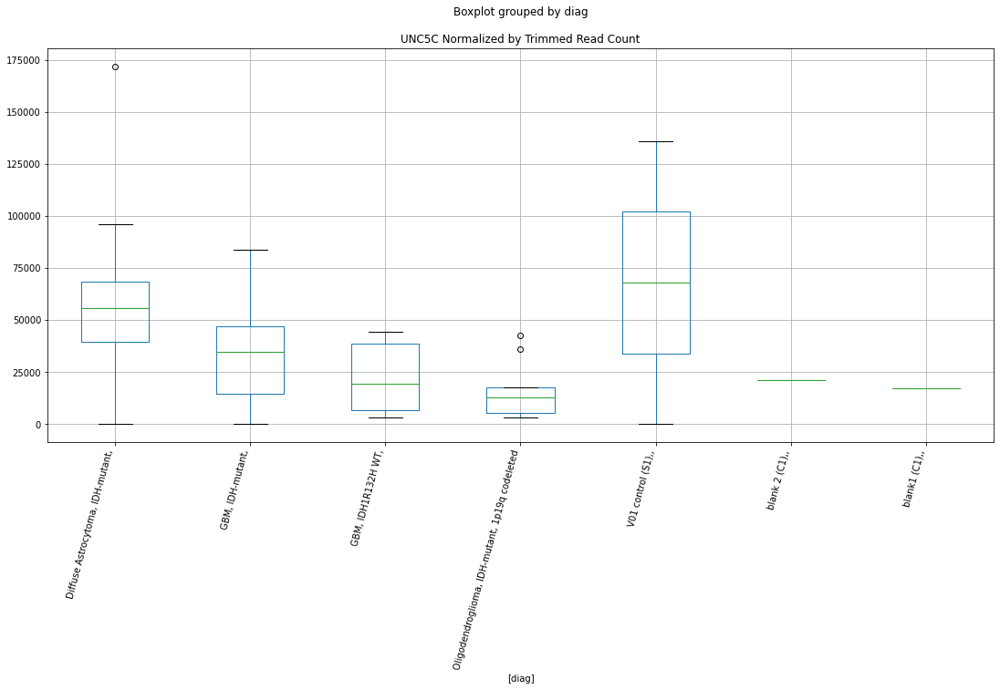

 p : 0.029517888534488293  ( t : 2.3641161984453287 ) :  D-plex  :  bbduk2  :  SVBP
Control and blanks
73     1546.02
337    1780.31
Name: SVBP, dtype: float64
205    0.0
Name: SVBP, dtype: float64
469    1183.05
Name: SVBP, dtype: float64


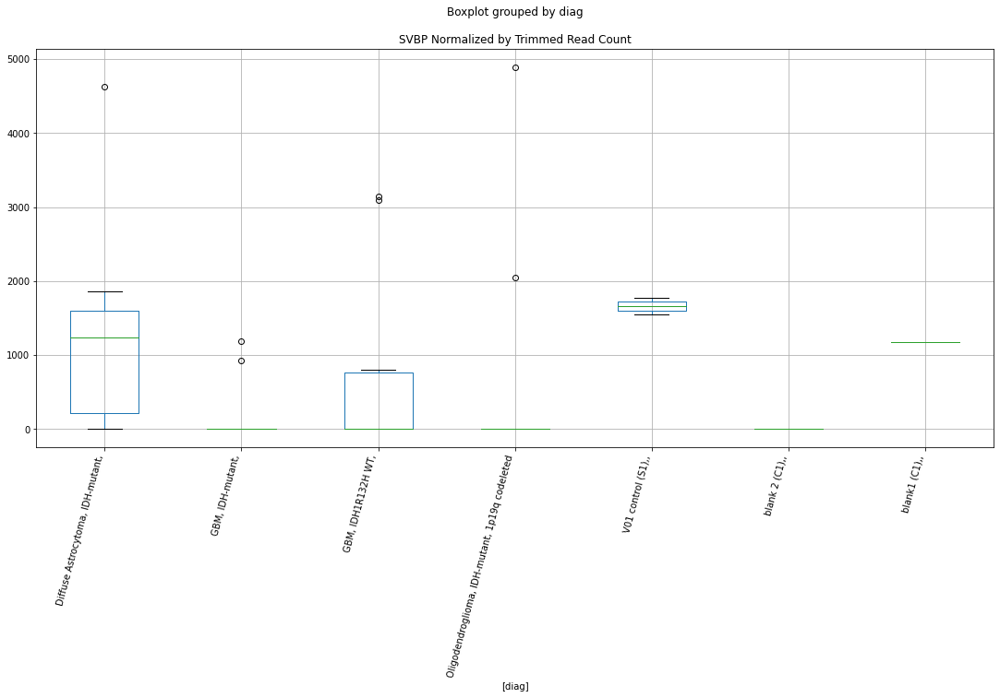

 p : 0.029575325268073396  ( t : 2.3631644009935266 ) :  Lexogen  :  cutadapt2  :  TP53INP2
Control and blanks
82     0.0
346    0.0
Name: TP53INP2, dtype: float64
214    0.0
Name: TP53INP2, dtype: float64
478    0.0
Name: TP53INP2, dtype: float64


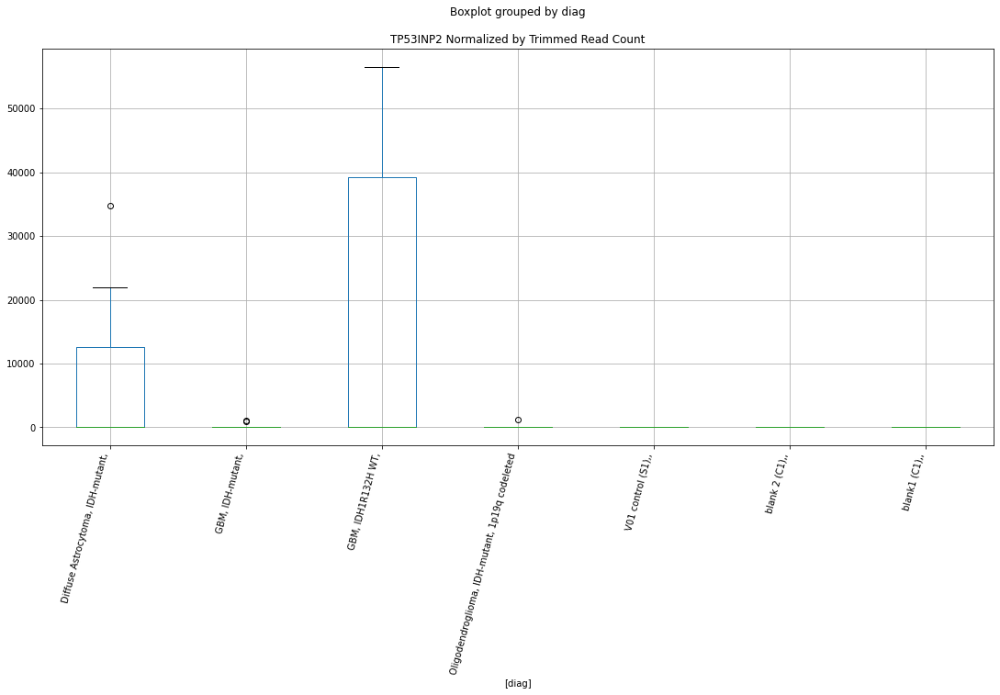

 p : 0.029577823500877266  ( t : 2.36312304131376 ) :  Lexogen  :  bbduk2  :  USP42
Control and blanks
79     0.0
343    0.0
Name: USP42, dtype: float64
211    0.0
Name: USP42, dtype: float64
475    0.0
Name: USP42, dtype: float64


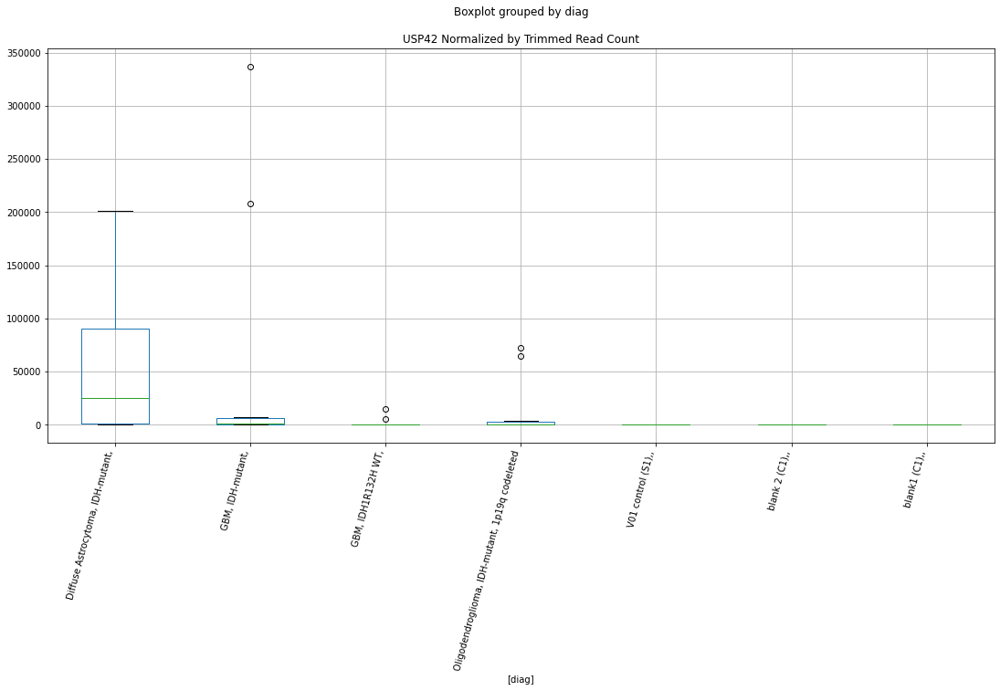

 p : 0.029589730556156876  ( t : 2.362925957908712 ) :  Lexogen  :  bbduk2  :  TGM1
Control and blanks
79     0.0
343    0.0
Name: TGM1, dtype: float64
211    0.0
Name: TGM1, dtype: float64
475    0.0
Name: TGM1, dtype: float64


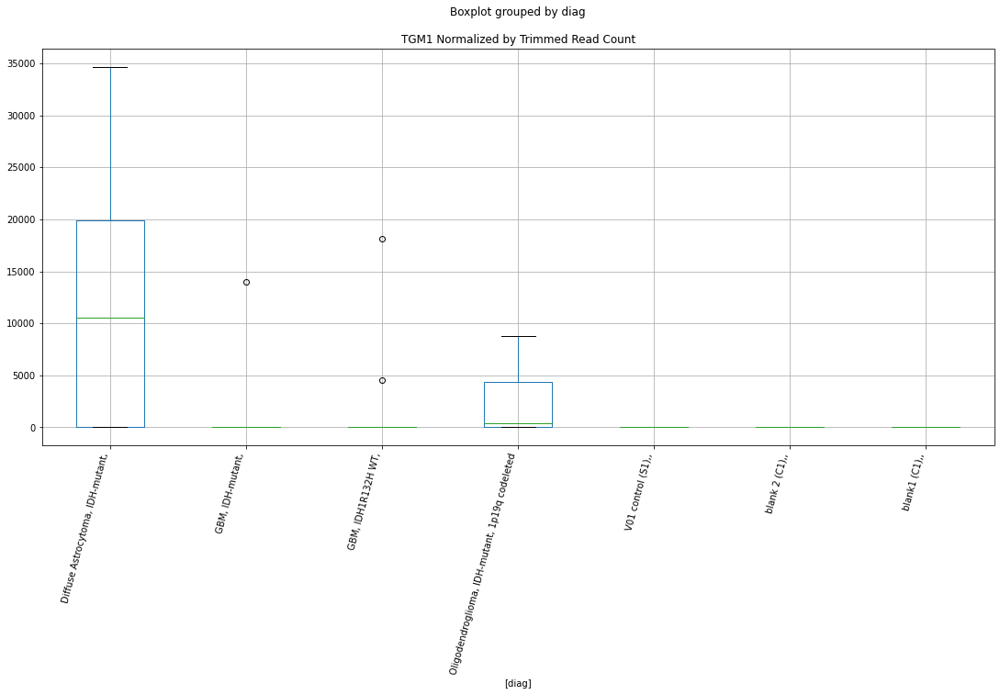

 p : 0.029606034990076836  ( t : 2.3626562097857486 ) :  D-plex  :  bbduk2  :  TTC4
Control and blanks
73     0.0
337    0.0
Name: TTC4, dtype: float64
205    0.0
Name: TTC4, dtype: float64
469    0.0
Name: TTC4, dtype: float64


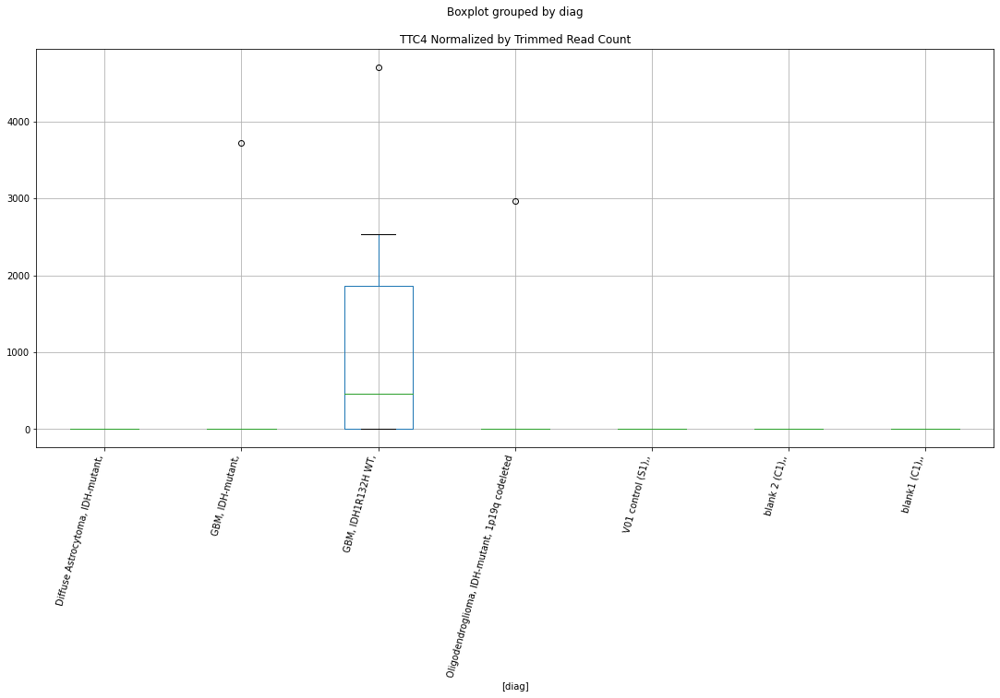

 p : 0.029677274806402497  ( t : 2.361479207171742 ) :  Lexogen  :  bbduk2  :  TP53INP2
Control and blanks
79     0.0
343    0.0
Name: TP53INP2, dtype: float64
211    0.0
Name: TP53INP2, dtype: float64
475    0.0
Name: TP53INP2, dtype: float64


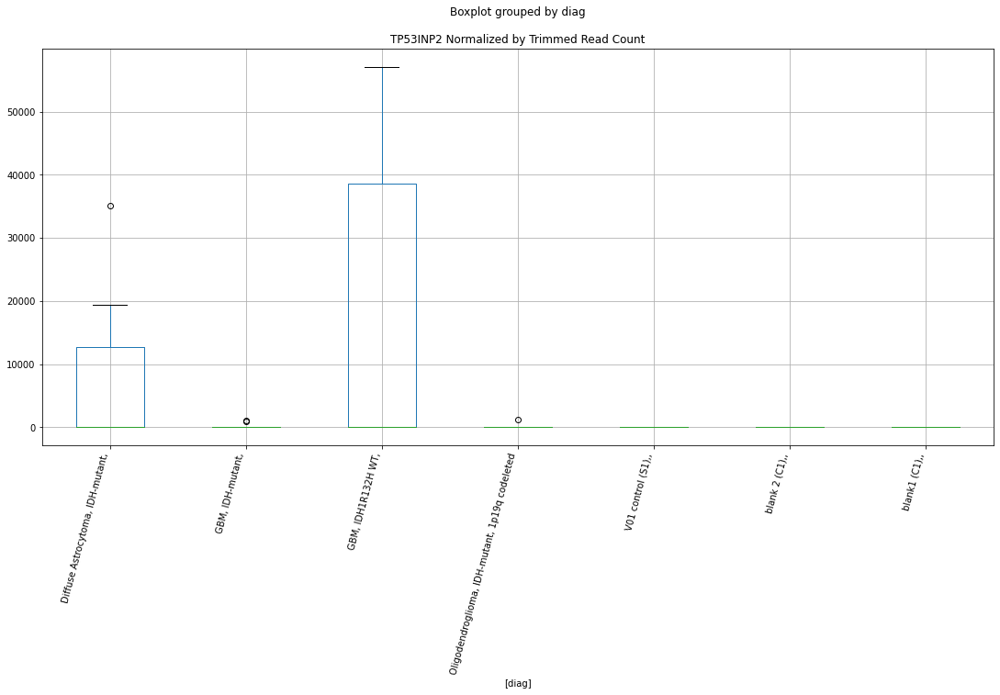

 p : 0.029710684429662283  ( t : 2.360928130373684 ) :  Lexogen  :  bbduk2  :  ZNF771
Control and blanks
79     0.0
343    0.0
Name: ZNF771, dtype: float64
211    0.0
Name: ZNF771, dtype: float64
475    12933.85
Name: ZNF771, dtype: float64


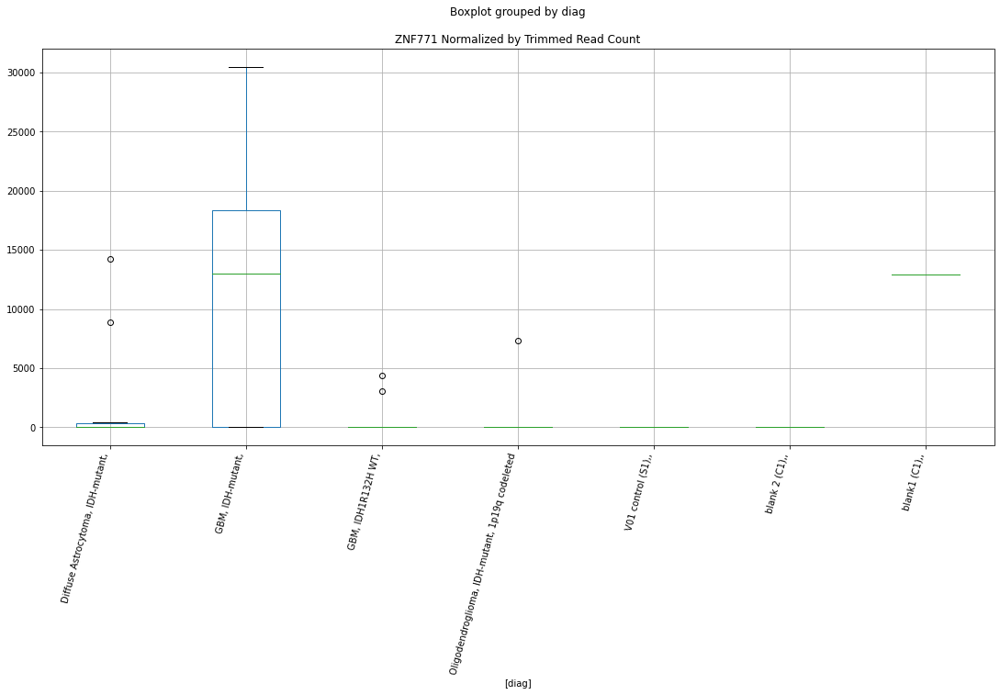

 p : 0.029715251045638474  ( t : 2.360852850957704 ) :  Lexogen  :  bbduk2  :  ZBED9
Control and blanks
79     0.0
343    0.0
Name: ZBED9, dtype: float64
211    0.0
Name: ZBED9, dtype: float64
475    0.0
Name: ZBED9, dtype: float64


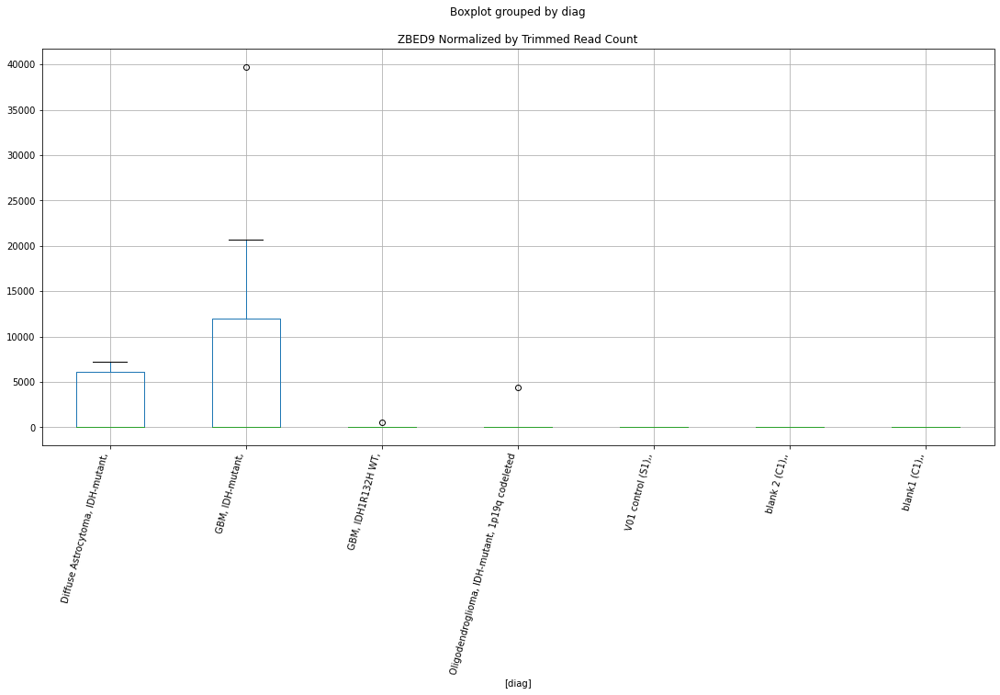

 p : 0.029829375900764846  ( t : 2.3589750270566188 ) :  D-plex  :  cutadapt2  :  TMEM97
Control and blanks
76     1515.23
340       0.00
Name: TMEM97, dtype: float64
208    352.72
Name: TMEM97, dtype: float64
472    577.96
Name: TMEM97, dtype: float64


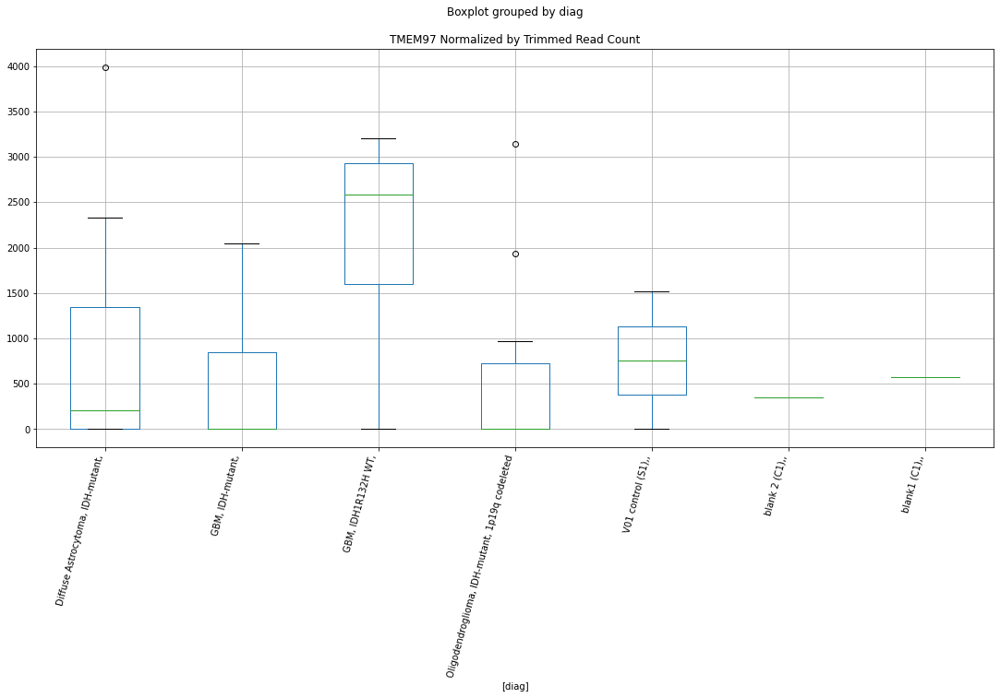

 p : 0.0299657873384224  ( t : 2.356739260914566 ) :  D-plex  :  bbduk2  :  TESK2
Control and blanks
73      97399.06
337    320456.62
Name: TESK2, dtype: float64
205    171569.13
Name: TESK2, dtype: float64
469    63884.95
Name: TESK2, dtype: float64


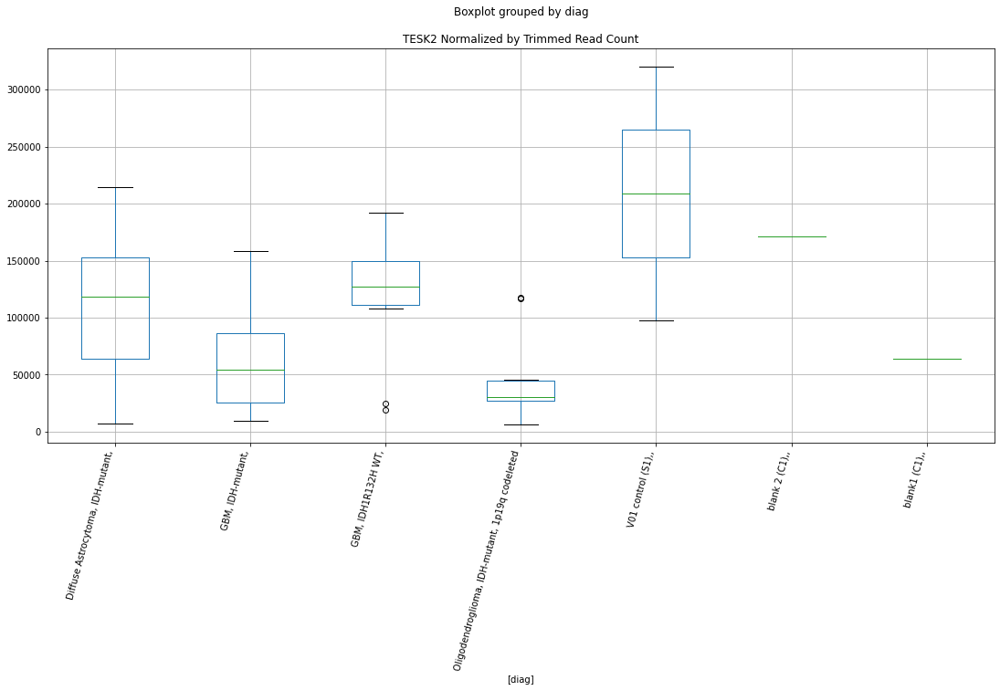

 p : 0.030132995516068264  ( t : 2.3540116395686503 ) :  Lexogen  :  bbduk2  :  ZNF165
Control and blanks
79     0.0
343    0.0
Name: ZNF165, dtype: float64
211    0.0
Name: ZNF165, dtype: float64
475    0.0
Name: ZNF165, dtype: float64


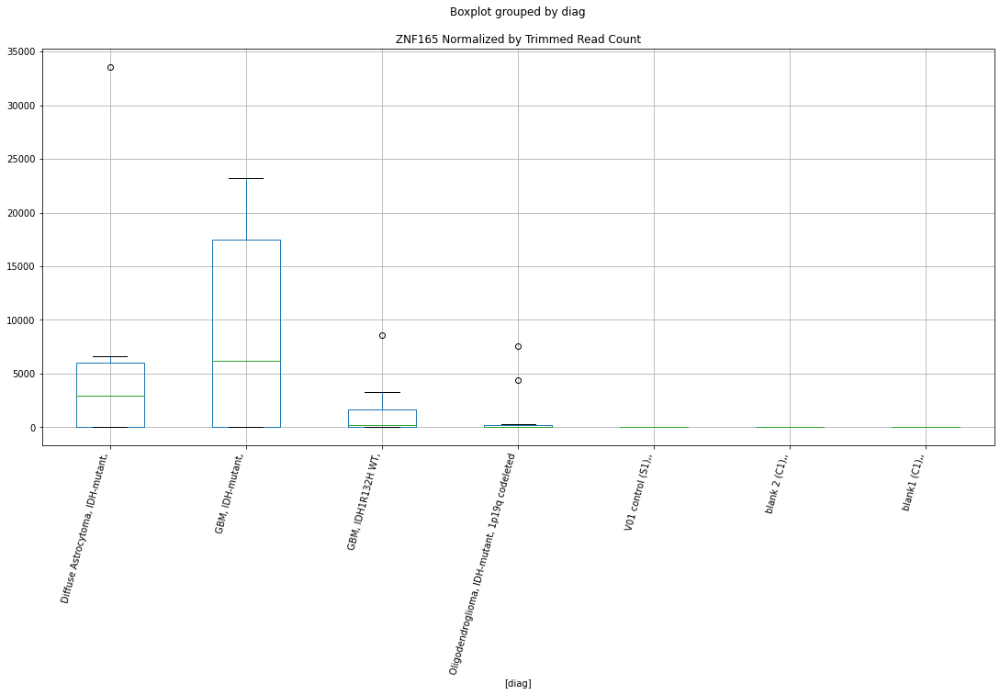

 p : 0.030193766303325806  ( t : 2.3530237945649874 ) :  Lexogen  :  cutadapt2  :  TP53INP2
Control and blanks
82     0.0
346    0.0
Name: TP53INP2, dtype: float64
214    0.0
Name: TP53INP2, dtype: float64
478    0.0
Name: TP53INP2, dtype: float64


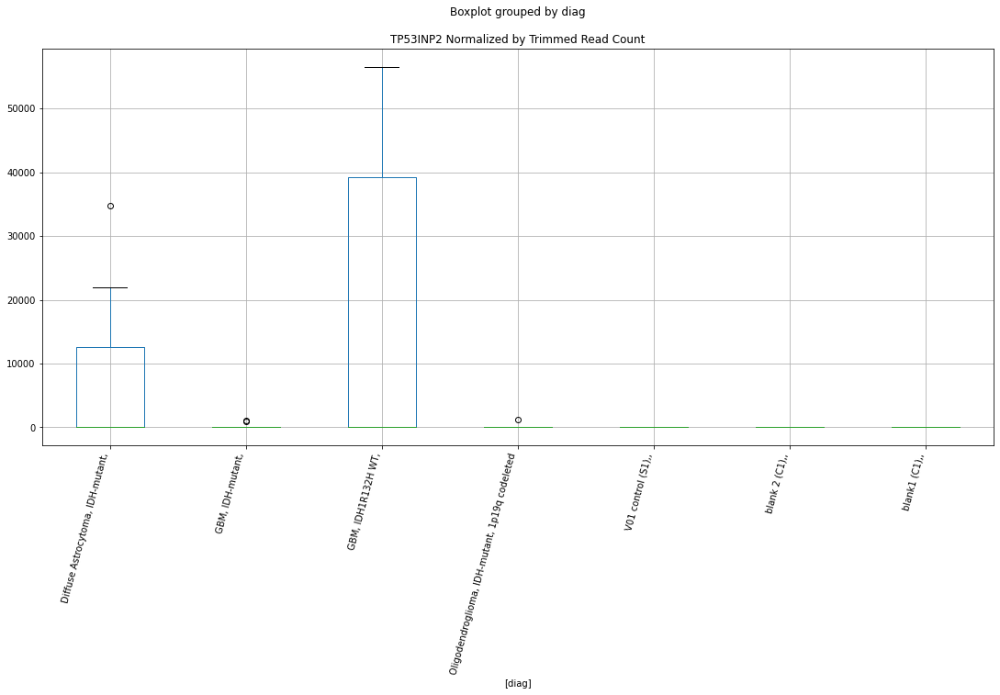

 p : 0.030214668328667572  ( t : 2.35268445466628 ) :  D-plex  :  cutadapt2  :  SVBP
Control and blanks
76     1515.23
340    1761.46
Name: SVBP, dtype: float64
208    0.0
Name: SVBP, dtype: float64
472    1155.91
Name: SVBP, dtype: float64


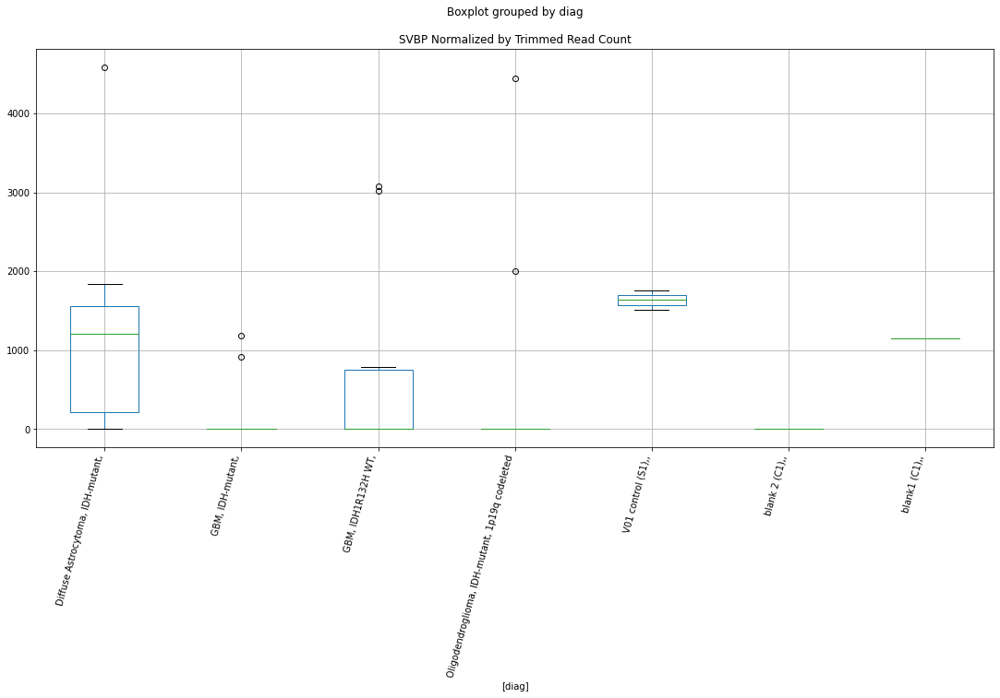

 p : 0.03028190333916181  ( t : 2.351594389504329 ) :  Lexogen  :  bbduk2  :  ZNF45
Control and blanks
79     28611.98
343    16985.15
Name: ZNF45, dtype: float64
211    16398.38
Name: ZNF45, dtype: float64
475    0.0
Name: ZNF45, dtype: float64


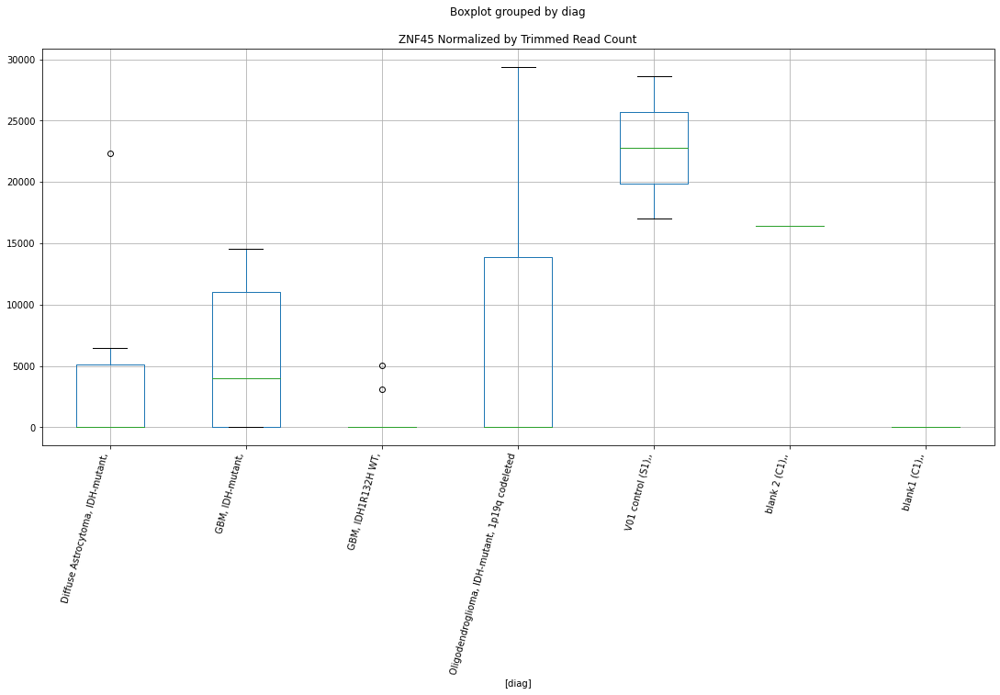

 p : 0.030310352743750418  ( t : 2.3511338246206983 ) :  Lexogen  :  bbduk2  :  TP53INP2
Control and blanks
79     0.0
343    0.0
Name: TP53INP2, dtype: float64
211    0.0
Name: TP53INP2, dtype: float64
475    0.0
Name: TP53INP2, dtype: float64


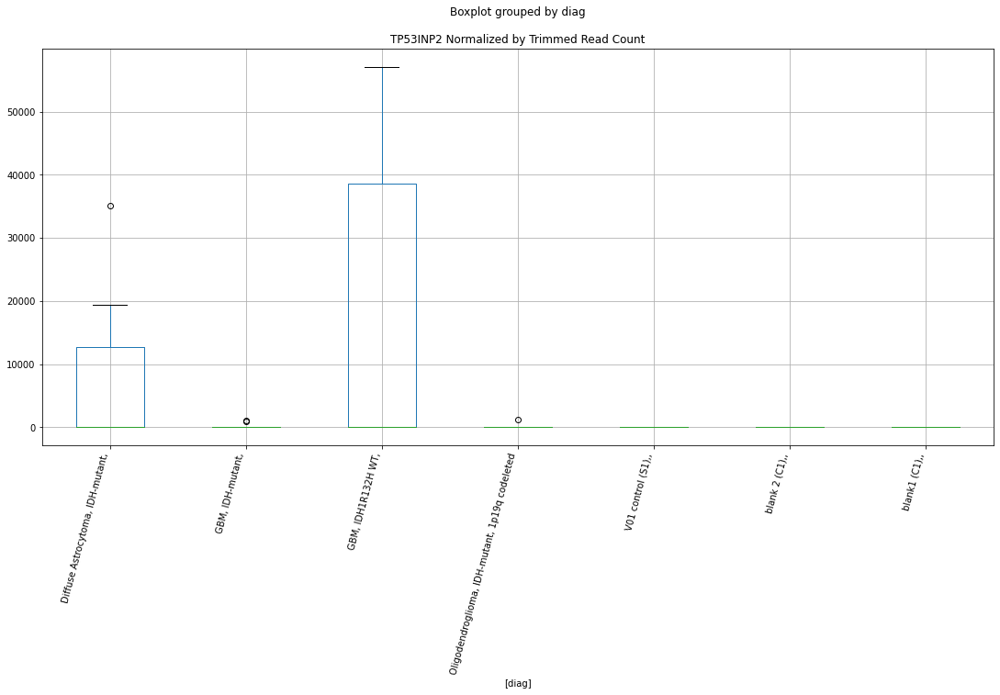

 p : 0.030342050048042774  ( t : 2.3506211536682176 ) :  Lexogen  :  cutadapt2  :  USP42
Control and blanks
82     0.0
346    0.0
Name: USP42, dtype: float64
214    0.0
Name: USP42, dtype: float64
478    0.0
Name: USP42, dtype: float64


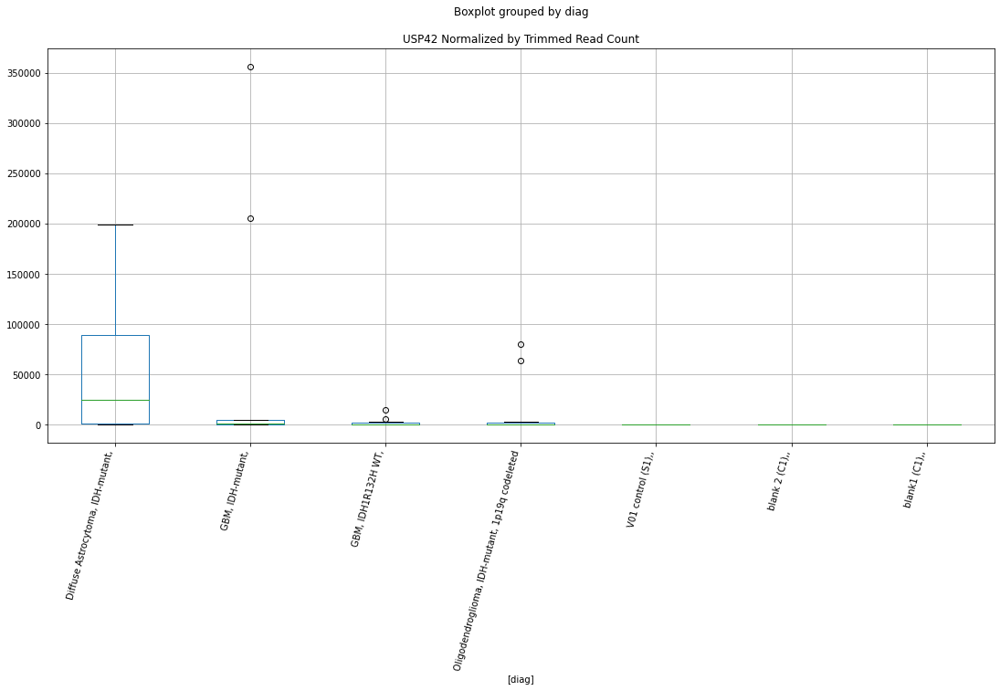

 p : 0.030379855235421003  ( t : 2.3500103457937223 ) :  D-plex  :  bbduk2  :  UNC93A
Control and blanks
73     773.01
337    890.16
Name: UNC93A, dtype: float64
205    4298.18
Name: UNC93A, dtype: float64
469    7098.33
Name: UNC93A, dtype: float64


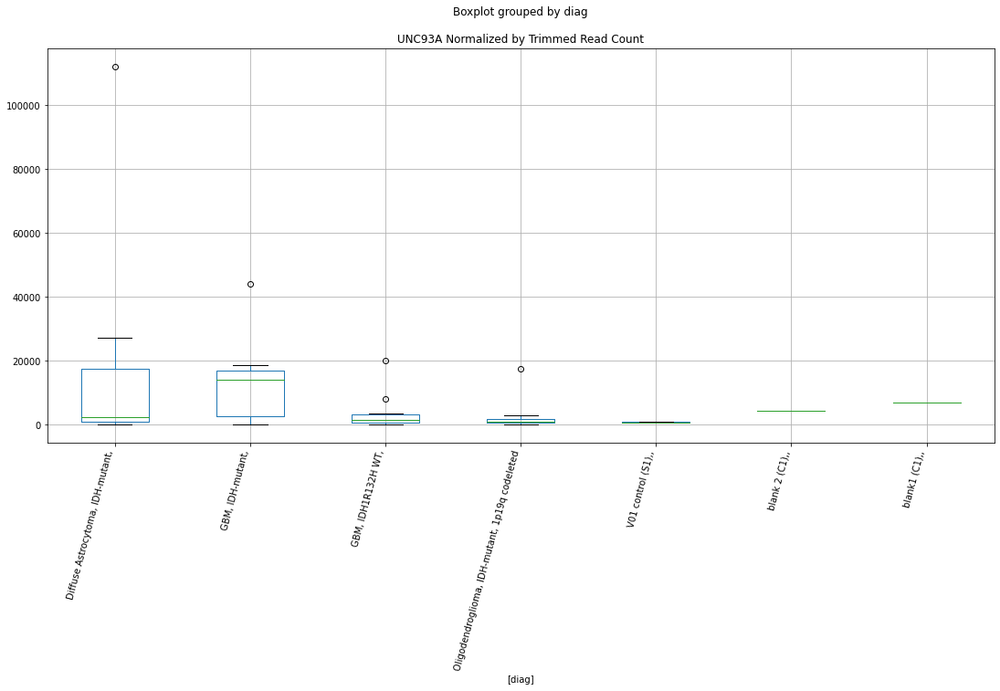

 p : 0.030422281496485095  ( t : 2.349325718783862 ) :  D-plex  :  cutadapt2  :  UNC93A
Control and blanks
76     757.61
340    880.73
Name: UNC93A, dtype: float64
208    4056.29
Name: UNC93A, dtype: float64
472    6935.47
Name: UNC93A, dtype: float64


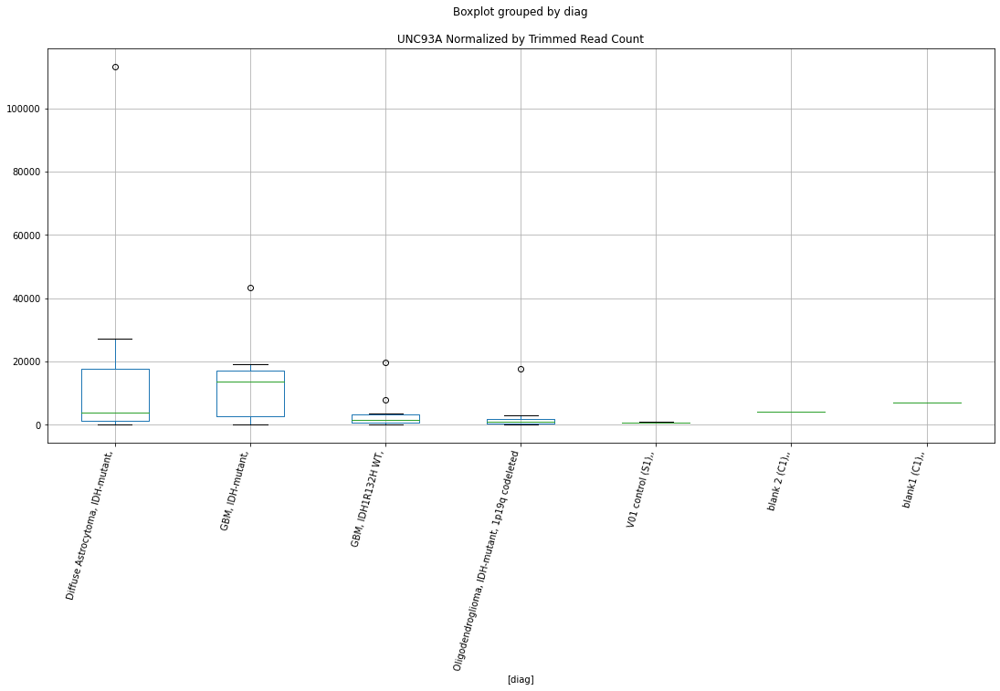

 p : 0.030497833038719682  ( t : 2.3481087515678607 ) :  D-plex  :  cutadapt2  :  ZNF45
Control and blanks
76     0.0
340    0.0
Name: ZNF45, dtype: float64
208    3527.2
Name: ZNF45, dtype: float64
472    23118.23
Name: ZNF45, dtype: float64


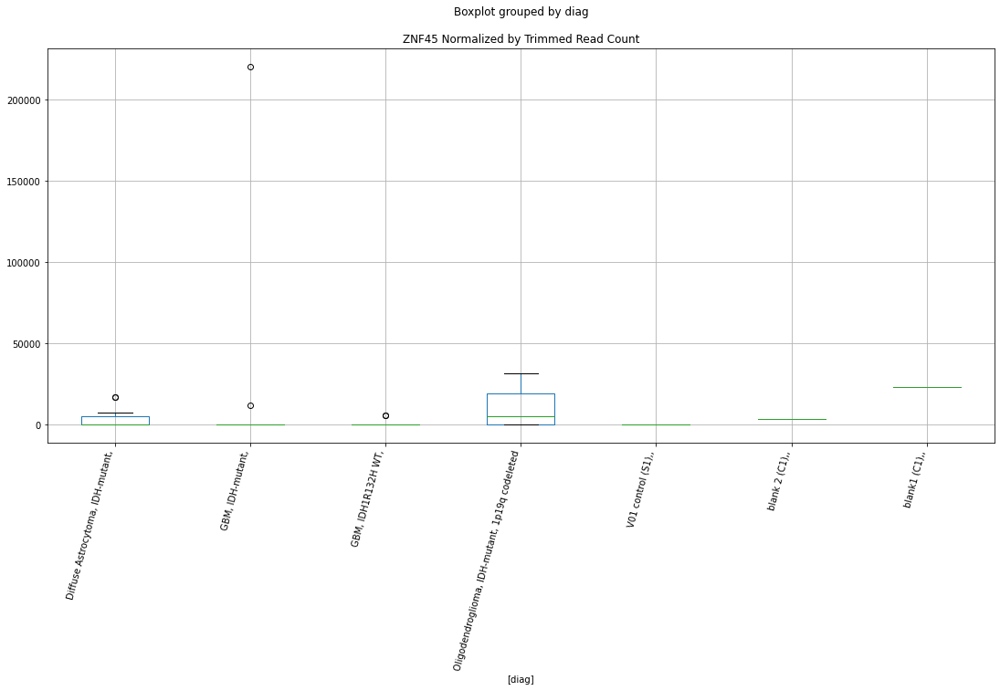

 p : 0.030501895138280218  ( t : 2.3480433997260497 ) :  D-plex  :  bbduk2  :  TBC1D17
Control and blanks
73     0.0
337    0.0
Name: TBC1D17, dtype: float64
205    0.0
Name: TBC1D17, dtype: float64
469    0.0
Name: TBC1D17, dtype: float64


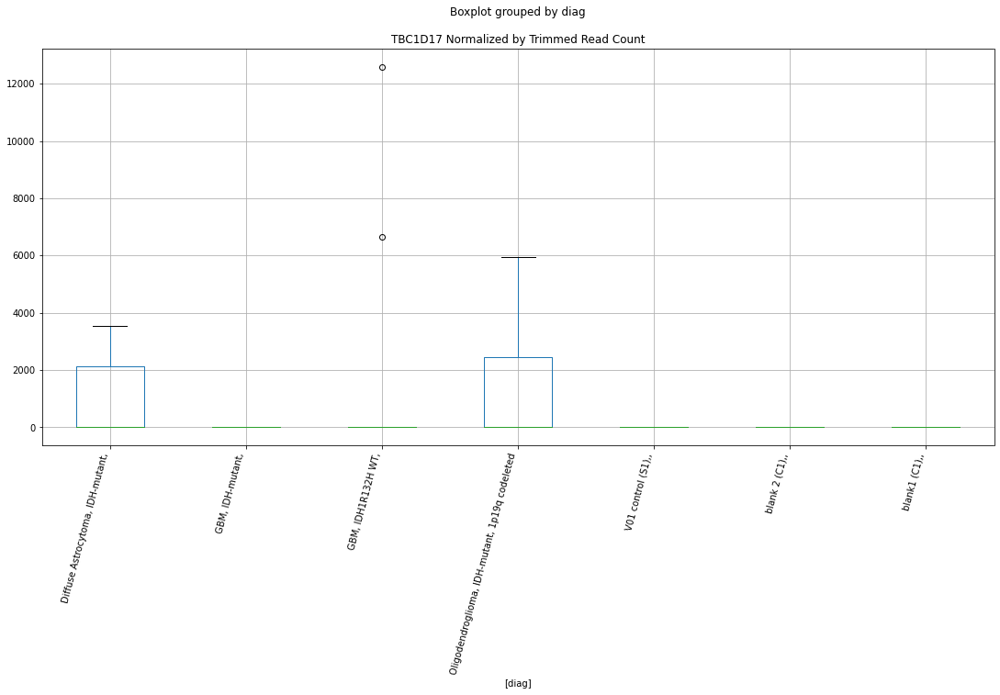

 p : 0.03051596902756824  ( t : 2.347817038931081 ) :  D-plex  :  cutadapt2  :  VCP
Control and blanks
76     2272.84
340       0.00
Name: VCP, dtype: float64
208    3703.56
Name: VCP, dtype: float64
472    5779.56
Name: VCP, dtype: float64


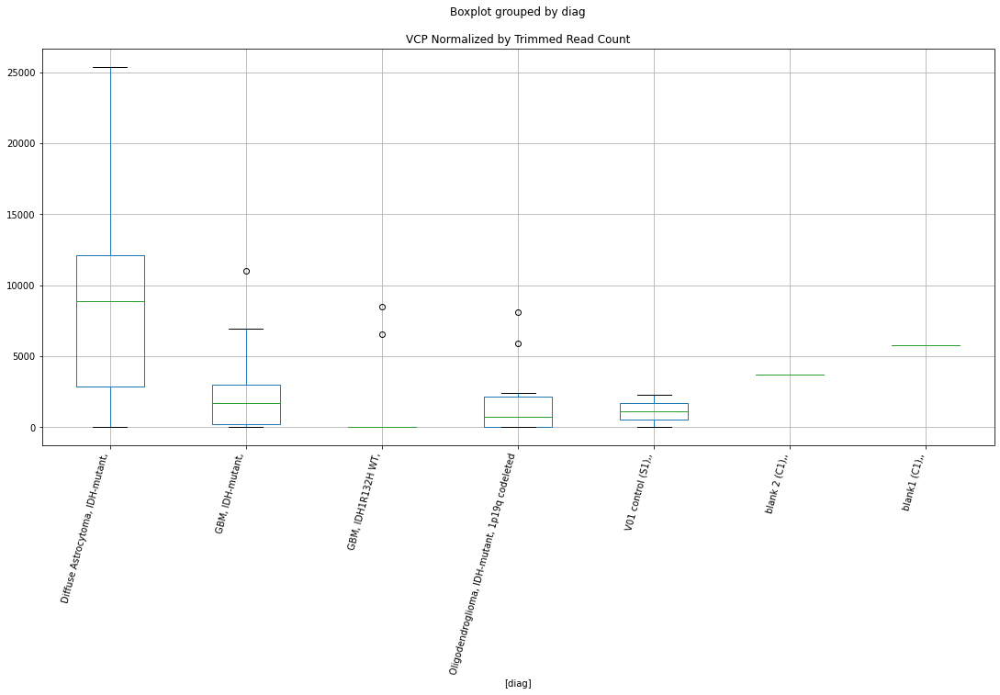

 p : 0.03057374524414164  ( t : 2.34688879850869 ) :  Lexogen  :  cutadapt2  :  TSC22D4
Control and blanks
82     0.0
346    0.0
Name: TSC22D4, dtype: float64
214    0.0
Name: TSC22D4, dtype: float64
478    0.0
Name: TSC22D4, dtype: float64


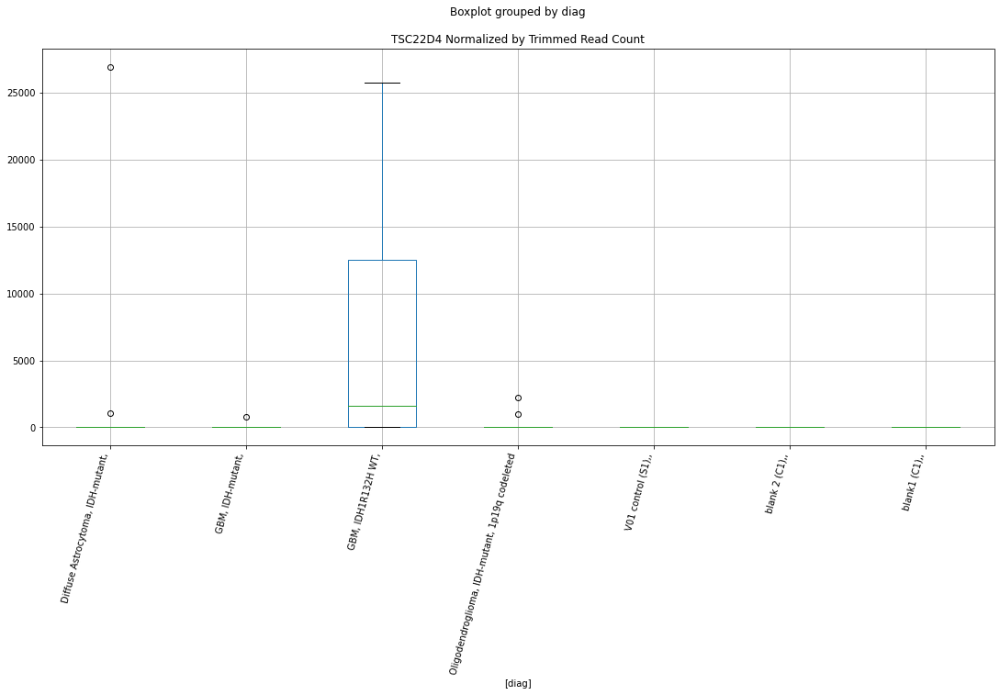

 p : 0.03061517134470018  ( t : 2.3462242458754177 ) :  Lexogen  :  bbduk2  :  TSC22D4
Control and blanks
79     0.0
343    0.0
Name: TSC22D4, dtype: float64
211    0.0
Name: TSC22D4, dtype: float64
475    0.0
Name: TSC22D4, dtype: float64


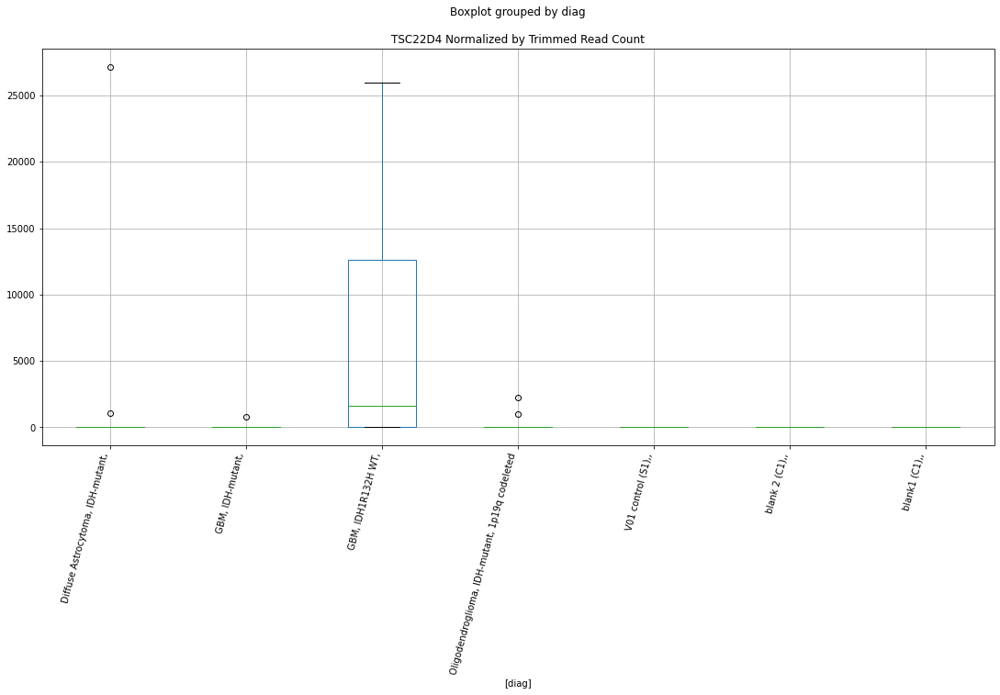

 p : 0.030840458293176897  ( t : 2.342624806341212 ) :  D-plex  :  bbduk2  :  ZBTB40
Control and blanks
73         0.00
337    44507.86
Name: ZBTB40, dtype: float64
205    2149.09
Name: ZBTB40, dtype: float64
469    591.53
Name: ZBTB40, dtype: float64


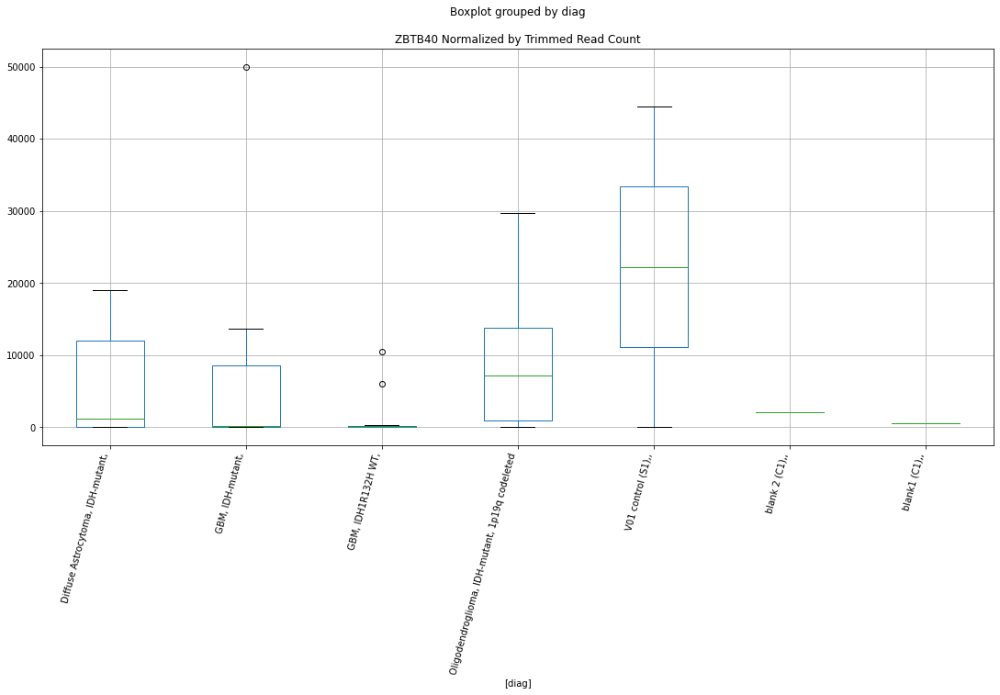

 p : 0.030869706200773197  ( t : 2.3421593045330145 ) :  Lexogen  :  cutadapt2  :  TUBA8
Control and blanks
82       0.00
346    420.87
Name: TUBA8, dtype: float64
214    0.0
Name: TUBA8, dtype: float64
478    0.0
Name: TUBA8, dtype: float64


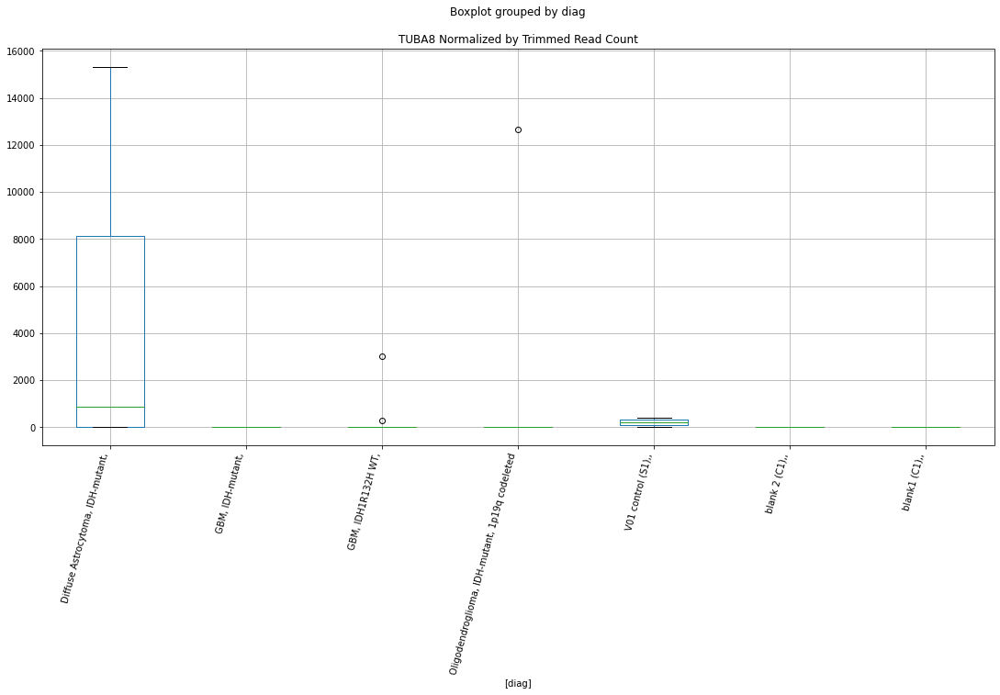

 p : 0.03089754010384545  ( t : 2.341716688610092 ) :  D-plex  :  bbduk2  :  WNK1
Control and blanks
73      18552.20
337    405911.71
Name: WNK1, dtype: float64
205    253592.79
Name: WNK1, dtype: float64
469    212358.31
Name: WNK1, dtype: float64


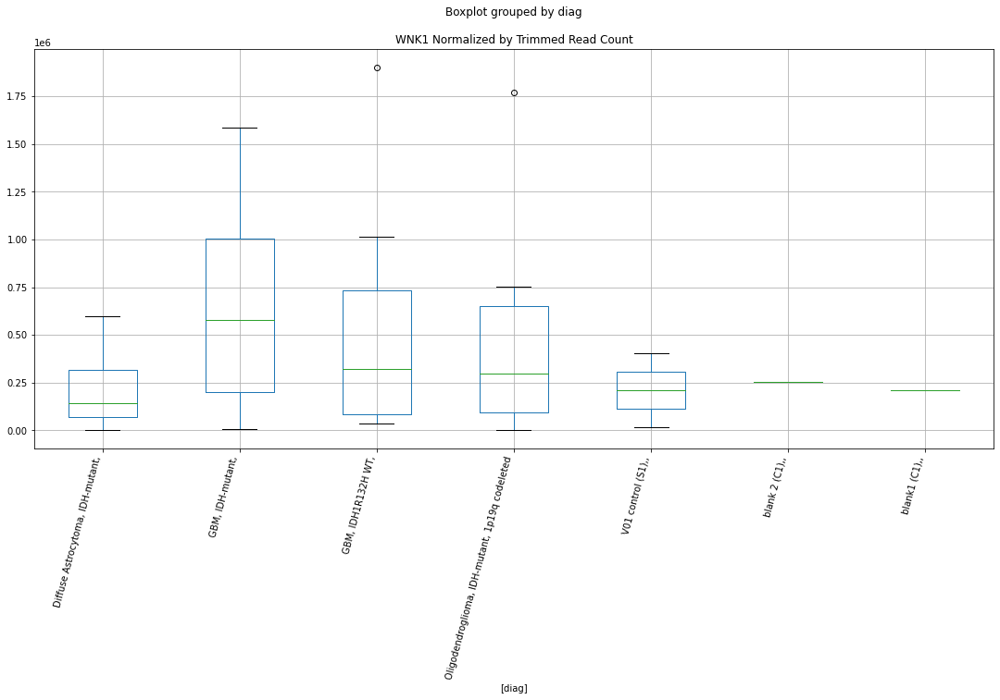

 p : 0.030967547134417465  ( t : 2.3406050717764213 ) :  D-plex  :  bbduk2  :  VPS35
Control and blanks
73     0.0
337    0.0
Name: VPS35, dtype: float64
205    1432.73
Name: VPS35, dtype: float64
469    1774.58
Name: VPS35, dtype: float64


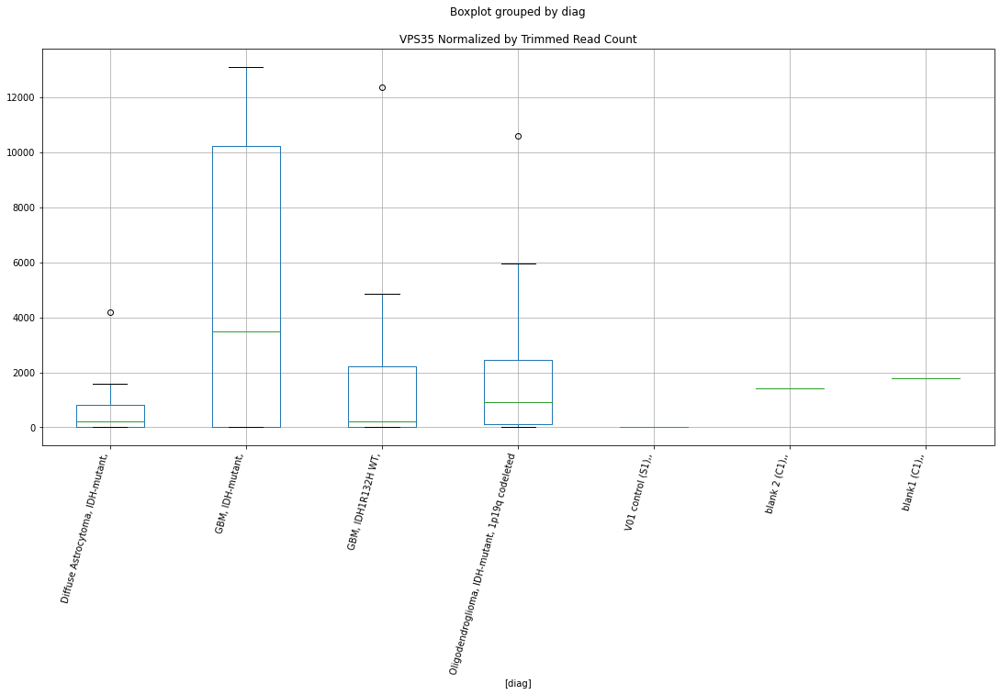

 p : 0.031033899027022485  ( t : 2.339553649673221 ) :  D-plex  :  cutadapt2  :  WWC3
Control and blanks
76     0.0
340    0.0
Name: WWC3, dtype: float64
208    1939.96
Name: WWC3, dtype: float64
472    2889.78
Name: WWC3, dtype: float64


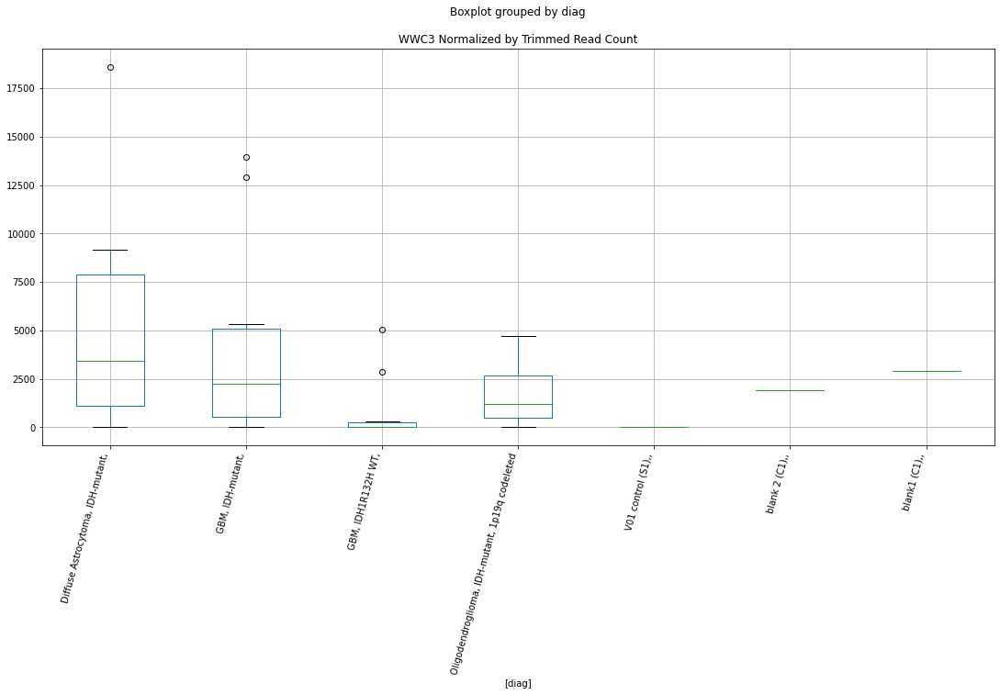

 p : 0.031090618389101175  ( t : 2.338656522783567 ) :  D-plex  :  bbduk2  :  VPS37C
Control and blanks
73     0.0
337    0.0
Name: VPS37C, dtype: float64
205    1074.55
Name: VPS37C, dtype: float64
469    12422.07
Name: VPS37C, dtype: float64


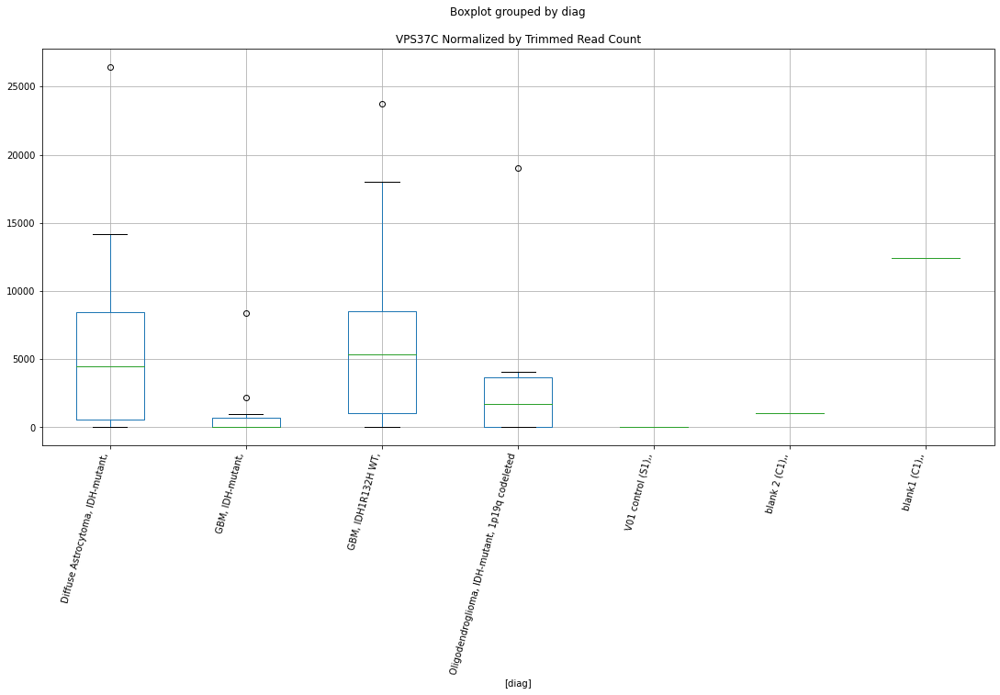

 p : 0.031133595948064554  ( t : 2.3379777625256732 ) :  Lexogen  :  cutadapt2  :  TLN2
Control and blanks
82     21300.77
346    18939.11
Name: TLN2, dtype: float64
214    4339.62
Name: TLN2, dtype: float64
478    949.84
Name: TLN2, dtype: float64


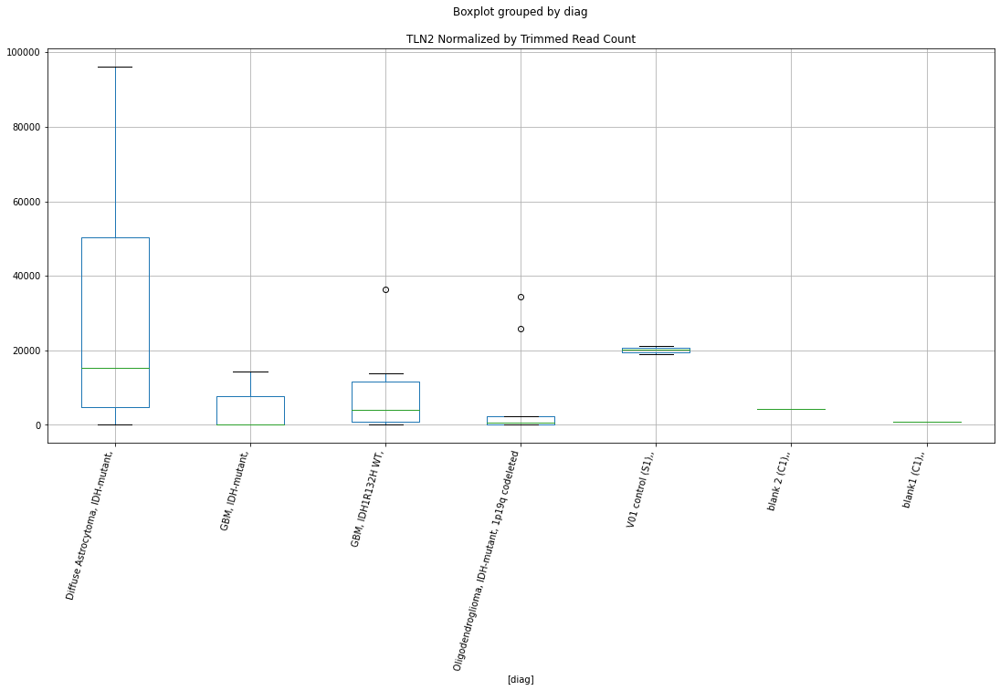

 p : 0.031151909811570063  ( t : 2.3376887898033907 ) :  D-plex  :  bbduk2  :  TGIF1
Control and blanks
73     0.0
337    0.0
Name: TGIF1, dtype: float64
205    1790.91
Name: TGIF1, dtype: float64
469    4732.22
Name: TGIF1, dtype: float64


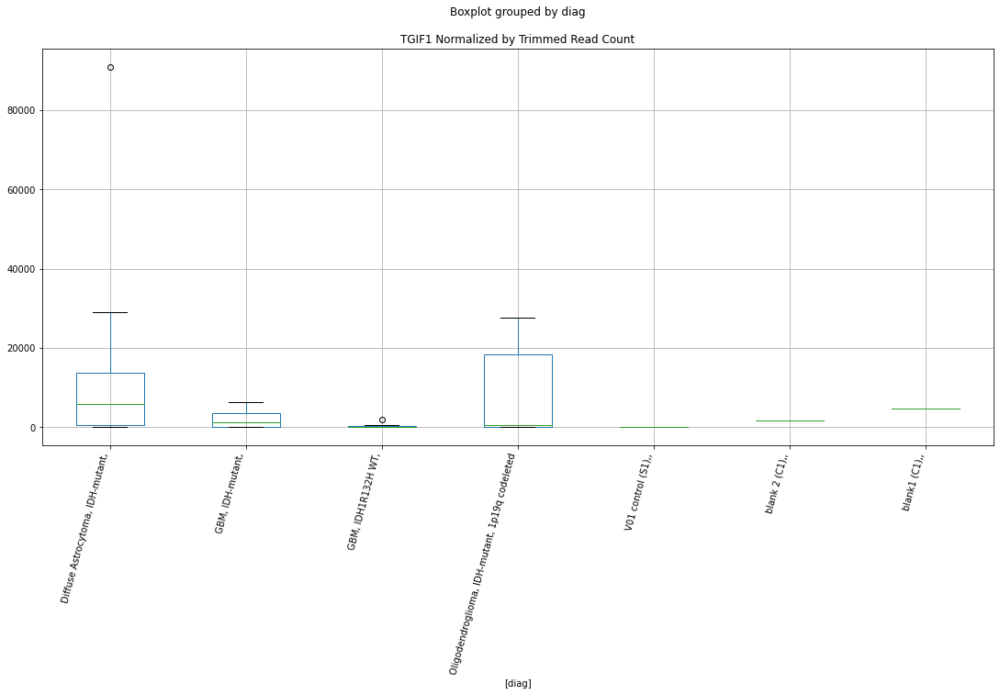

 p : 0.031156464208154308  ( t : 2.3376169509456943 ) :  D-plex  :  bbduk2  :  TRAPPC6A
Control and blanks
73     0.0
337    0.0
Name: TRAPPC6A, dtype: float64
205    895.45
Name: TRAPPC6A, dtype: float64
469    591.53
Name: TRAPPC6A, dtype: float64


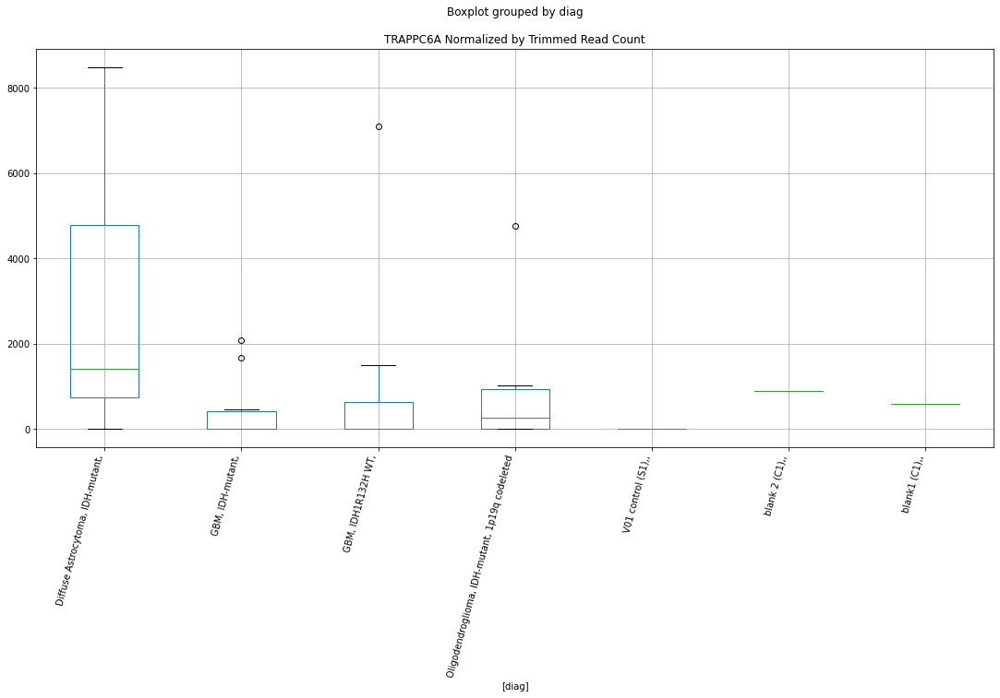

 p : 0.031184561690093707  ( t : 2.3371739706971373 ) :  D-plex  :  bbduk2  :  STK32C
Control and blanks
73     0.0
337    0.0
Name: STK32C, dtype: float64
205    15401.82
Name: STK32C, dtype: float64
469    8281.38
Name: STK32C, dtype: float64


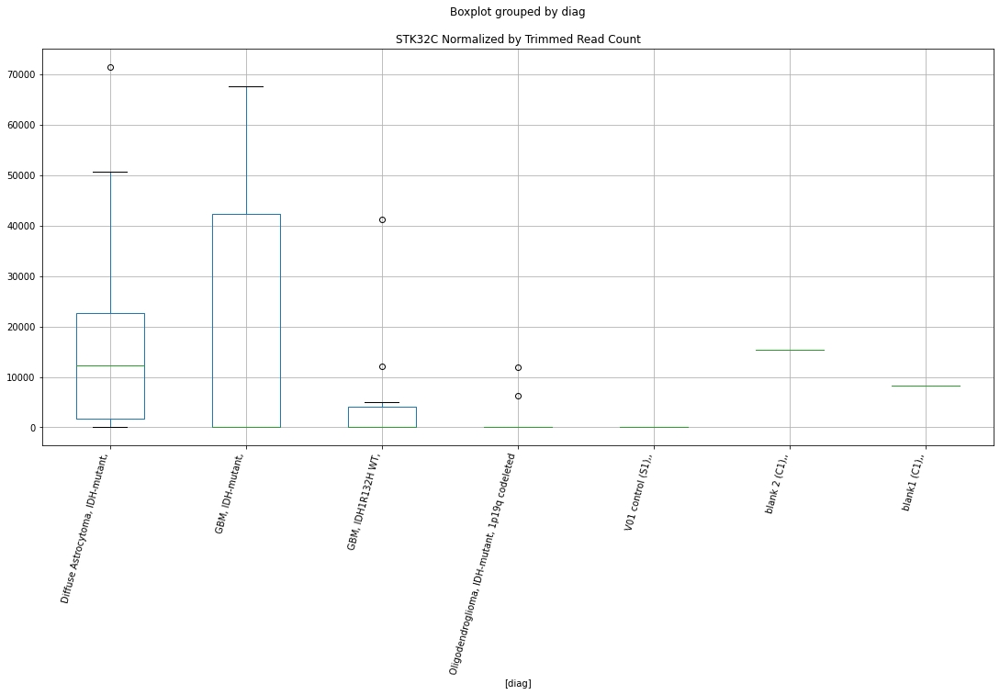

 p : 0.03120392235725503  ( t : 2.336868949608952 ) :  D-plex  :  bbduk2  :  UBR3
Control and blanks
73     0.0
337    0.0
Name: UBR3, dtype: float64
205    2328.18
Name: UBR3, dtype: float64
469    0.0
Name: UBR3, dtype: float64


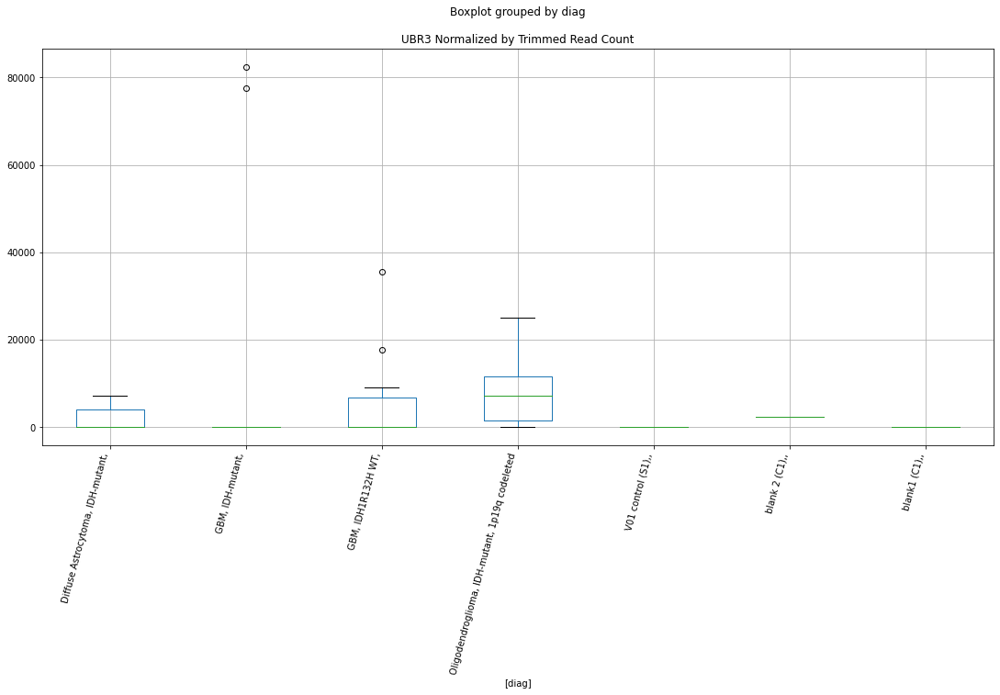

 p : 0.03125108912612964  ( t : 2.3361265884707905 ) :  D-plex  :  cutadapt2  :  TCHH
Control and blanks
76     15152.28
340    22018.30
Name: TCHH, dtype: float64
208    2469.04
Name: TCHH, dtype: float64
472    5201.6
Name: TCHH, dtype: float64


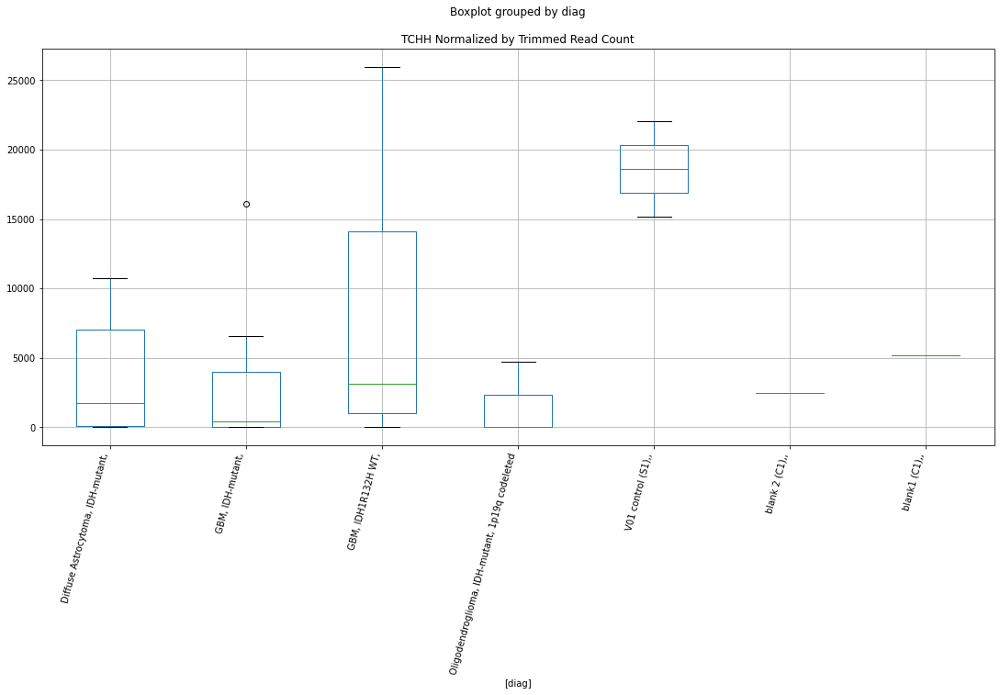

 p : 0.03134397874285307  ( t : 2.334667634037039 ) :  Lexogen  :  bbduk2  :  ZNF280A
Control and blanks
79       0.00
343    849.26
Name: ZNF280A, dtype: float64
211    13118.7
Name: ZNF280A, dtype: float64
475    14370.94
Name: ZNF280A, dtype: float64


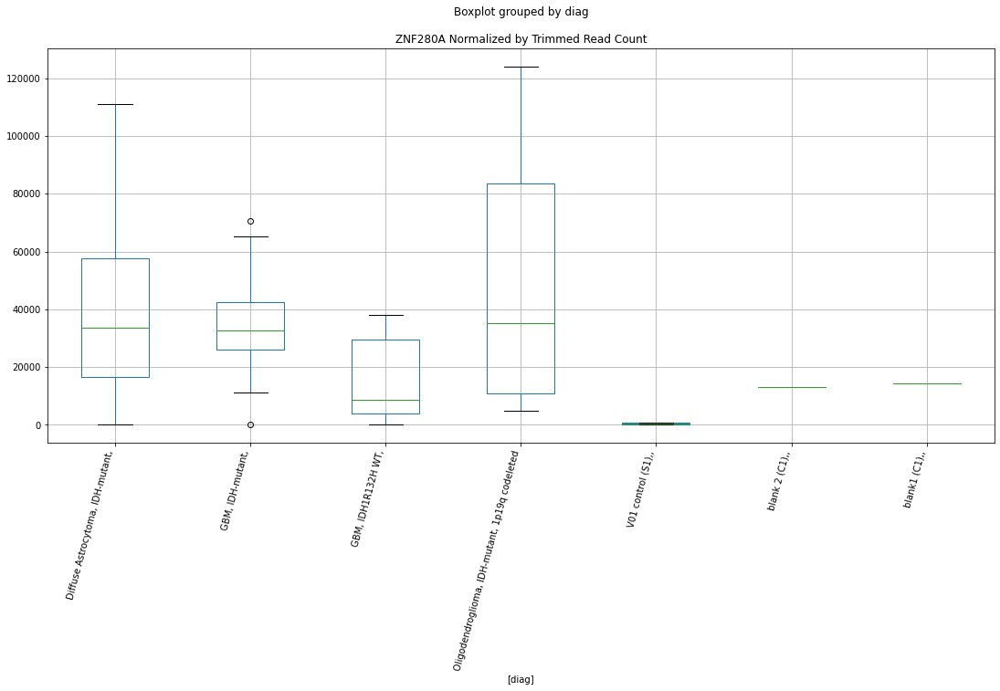

 p : 0.031373026895572365  ( t : 2.3342122195796646 ) :  Lexogen  :  cutadapt2  :  TRPS1
Control and blanks
82     0.0
346    0.0
Name: TRPS1, dtype: float64
214    14646.23
Name: TRPS1, dtype: float64
478    2137.14
Name: TRPS1, dtype: float64


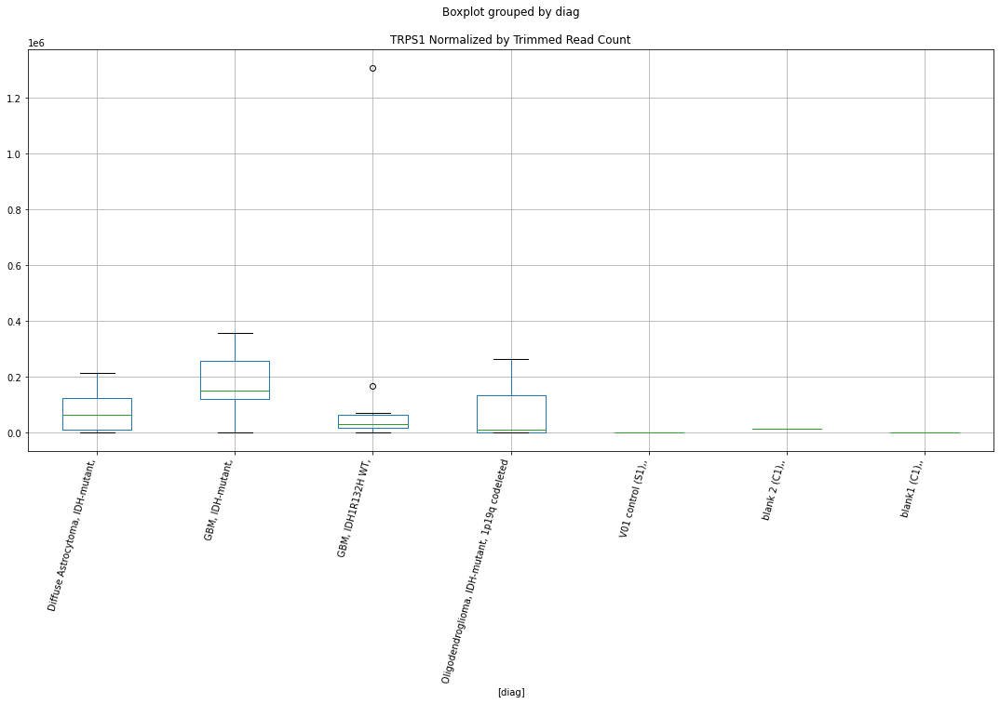

 p : 0.03139454562078264  ( t : 2.3338751035999397 ) :  D-plex  :  cutadapt2  :  ZNF879
Control and blanks
76     0.0
340    0.0
Name: ZNF879, dtype: float64
208    1410.88
Name: ZNF879, dtype: float64
472    0.0
Name: ZNF879, dtype: float64


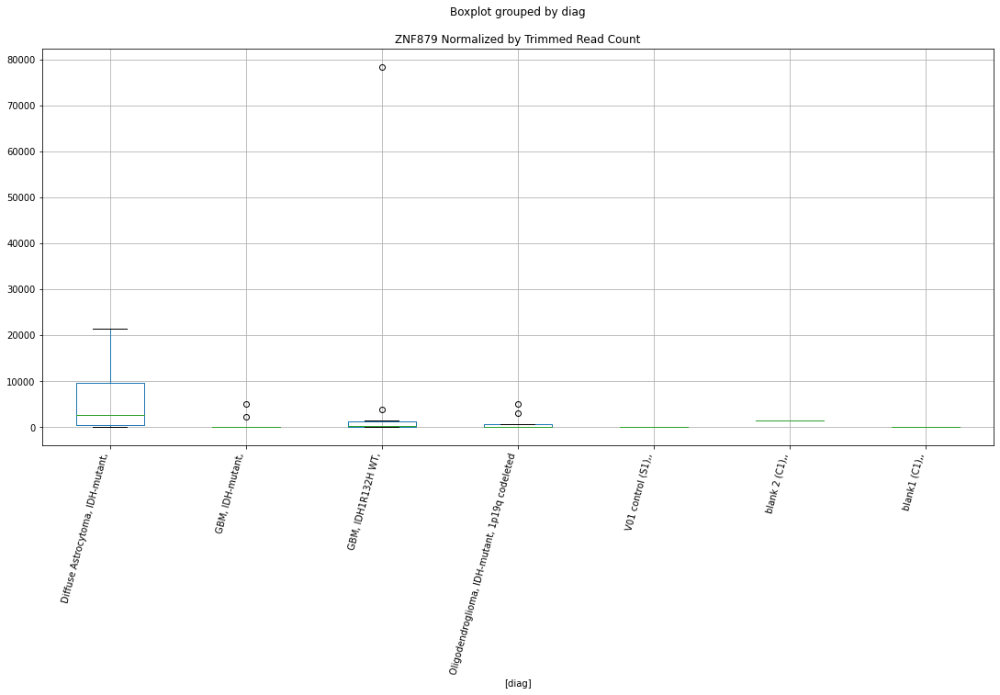

 p : 0.03151275392196545  ( t : 2.332027055493141 ) :  D-plex  :  bbduk2  :  YWHAB
Control and blanks
73     0.0
337    0.0
Name: YWHAB, dtype: float64
205    5910.0
Name: YWHAB, dtype: float64
469    14196.66
Name: YWHAB, dtype: float64


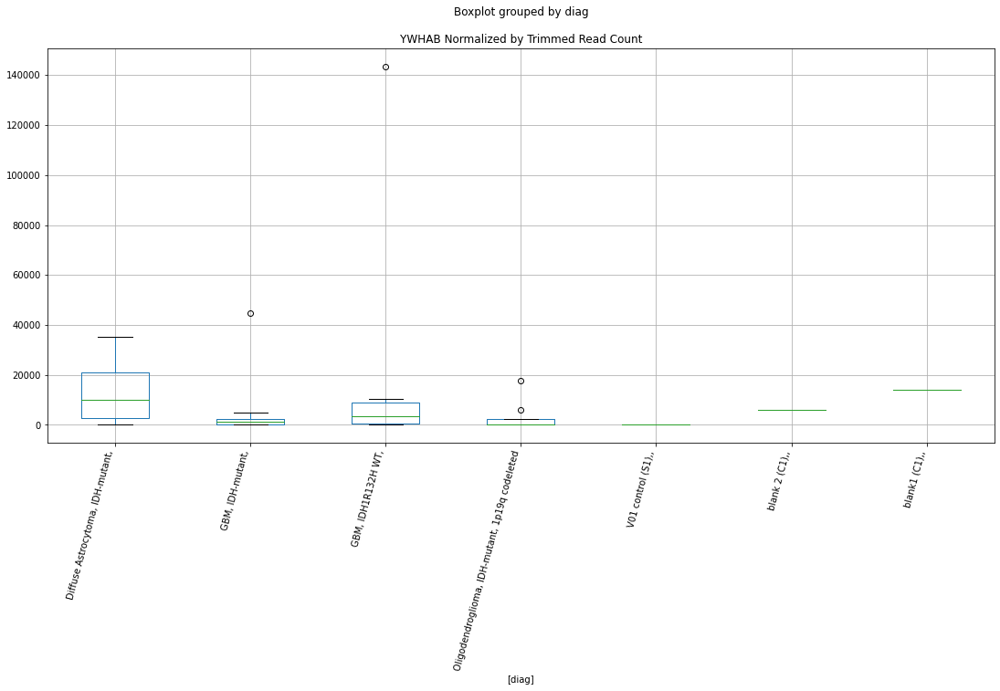

 p : 0.03154380083838137  ( t : 2.331542742146687 ) :  Lexogen  :  cutadapt2  :  ZNF517
Control and blanks
82         0.00
346    40403.43
Name: ZNF517, dtype: float64
214    0.0
Name: ZNF517, dtype: float64
478    0.0
Name: ZNF517, dtype: float64


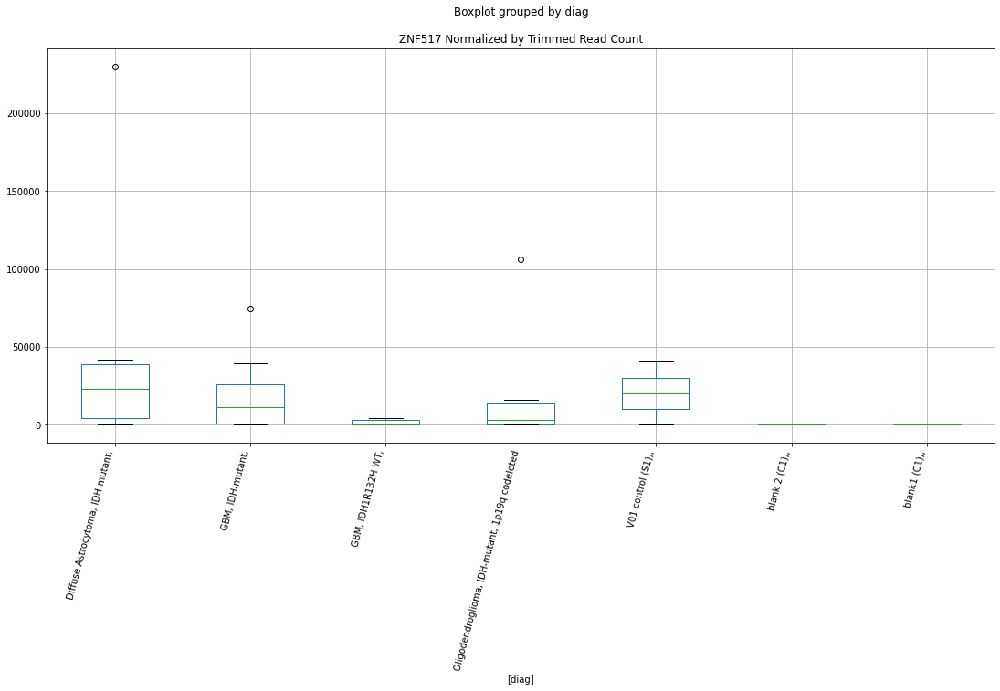

 p : 0.031611276582359564  ( t : 2.3304916872078665 ) :  Lexogen  :  bbduk2  :  WDR44
Control and blanks
79        0.00
343    5307.86
Name: WDR44, dtype: float64
211    24597.57
Name: WDR44, dtype: float64
475    0.0
Name: WDR44, dtype: float64


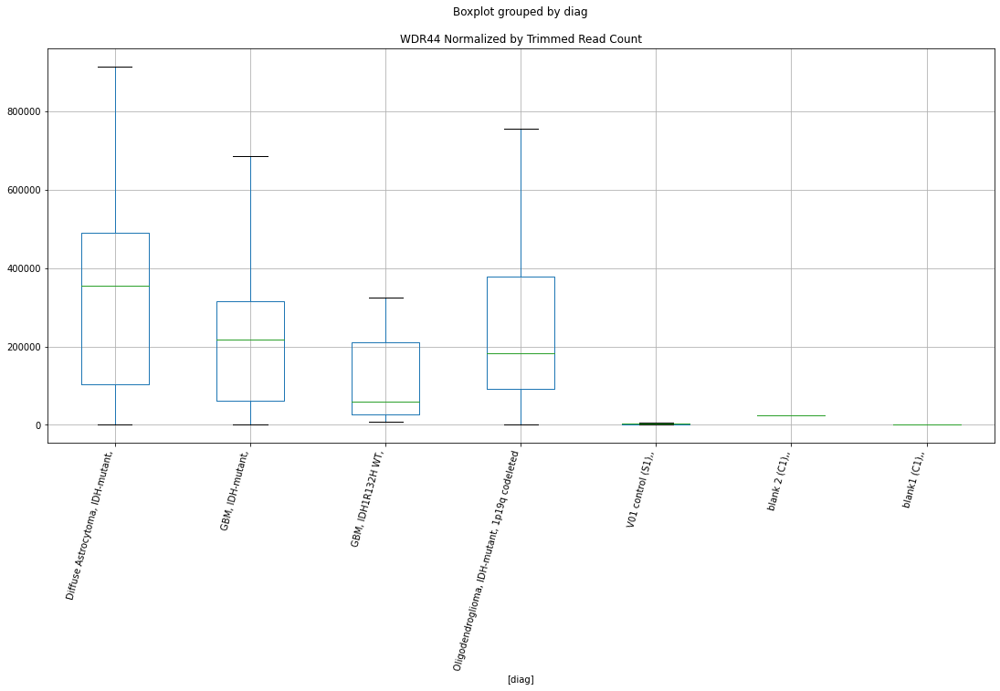

 p : 0.031628136036051004  ( t : 2.3302293968484897 ) :  D-plex  :  cutadapt2  :  WNT4
Control and blanks
76     0.0
340    0.0
Name: WNT4, dtype: float64
208    3703.56
Name: WNT4, dtype: float64
472    0.0
Name: WNT4, dtype: float64


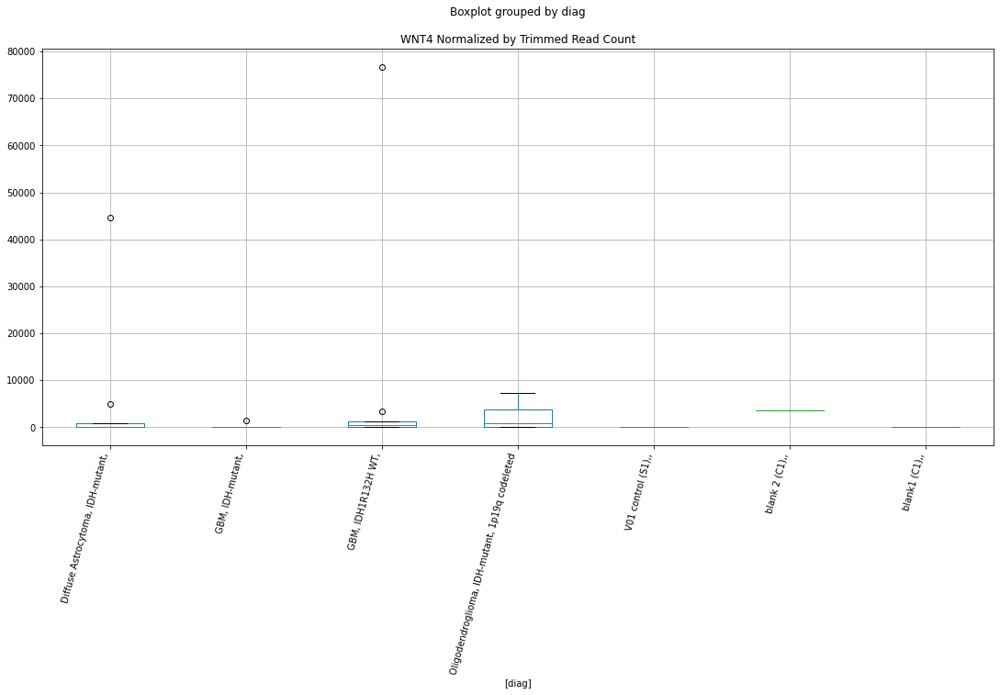

 p : 0.03166817927920082  ( t : 2.329606946052131 ) :  Lexogen  :  bbduk2  :  ZNF217
Control and blanks
79        0.00
343    1698.51
Name: ZNF217, dtype: float64
211    0.0
Name: ZNF217, dtype: float64
475    0.0
Name: ZNF217, dtype: float64


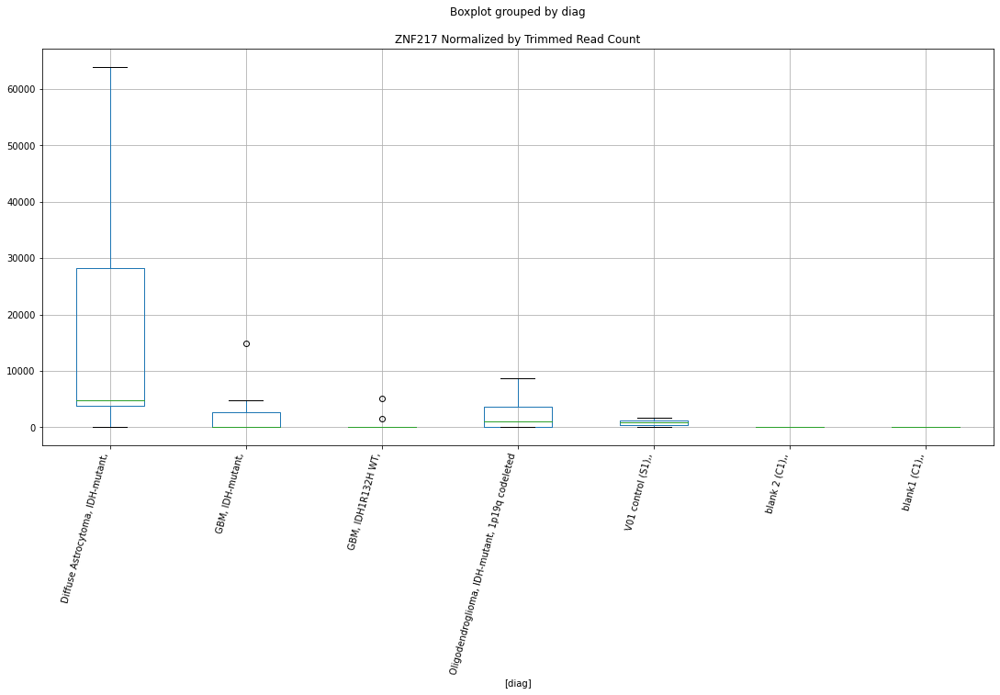

 p : 0.03167149124542212  ( t : 2.329555496072037 ) :  Lexogen  :  bbduk2  :  ZNF517
Control and blanks
79         0.00
343    40764.35
Name: ZNF517, dtype: float64
211    0.0
Name: ZNF517, dtype: float64
475    0.0
Name: ZNF517, dtype: float64


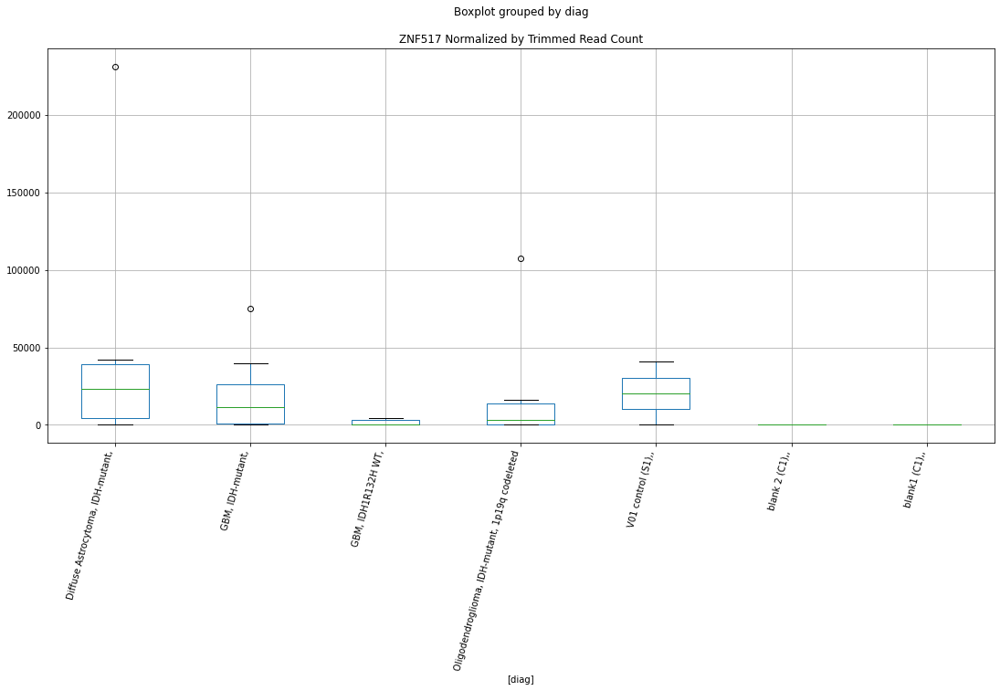

 p : 0.031686487653301926  ( t : 2.3293225958541046 ) :  Lexogen  :  bbduk2  :  ZNF541
Control and blanks
79     0.0
343    0.0
Name: ZNF541, dtype: float64
211    0.0
Name: ZNF541, dtype: float64
475    0.0
Name: ZNF541, dtype: float64


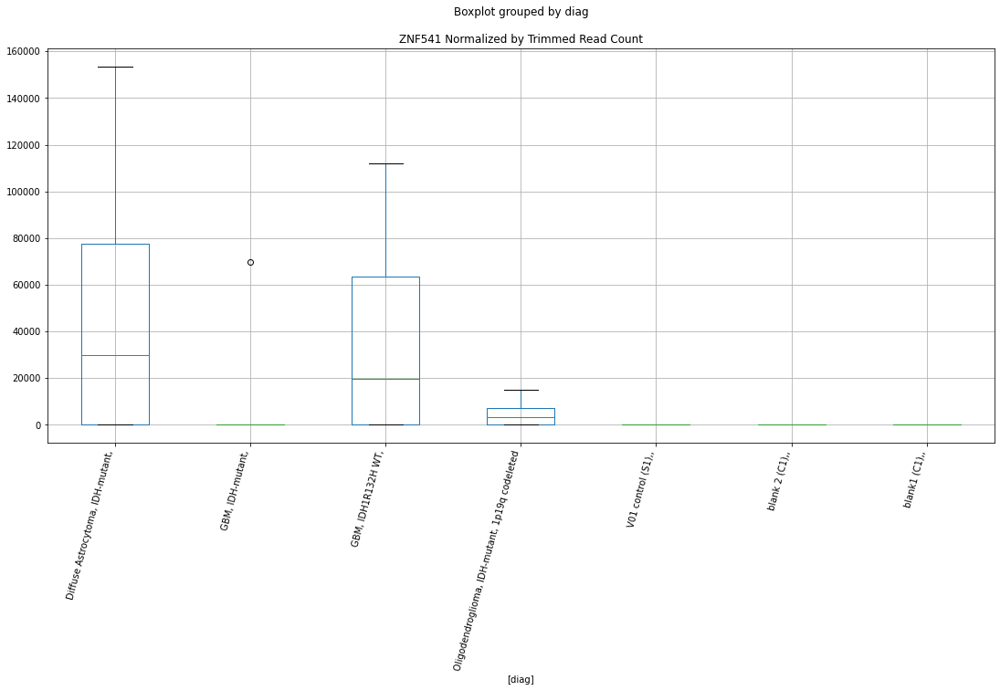

 p : 0.031702467896421505  ( t : 2.329074529011969 ) :  D-plex  :  cutadapt2  :  TESK2
Control and blanks
76      95459.39
340    320586.50
Name: TESK2, dtype: float64
208    171422.13
Name: TESK2, dtype: float64
472    61263.32
Name: TESK2, dtype: float64


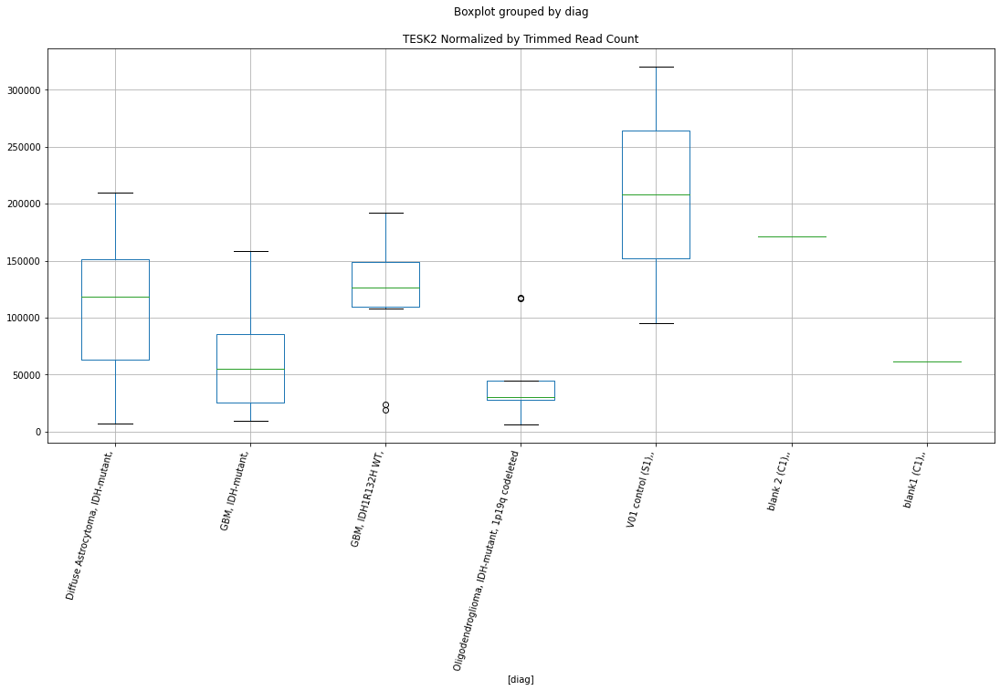

 p : 0.03170562409551724  ( t : 2.329025547986508 ) :  Lexogen  :  cutadapt2  :  ZNF541
Control and blanks
82     0.0
346    0.0
Name: ZNF541, dtype: float64
214    0.0
Name: ZNF541, dtype: float64
478    0.0
Name: ZNF541, dtype: float64


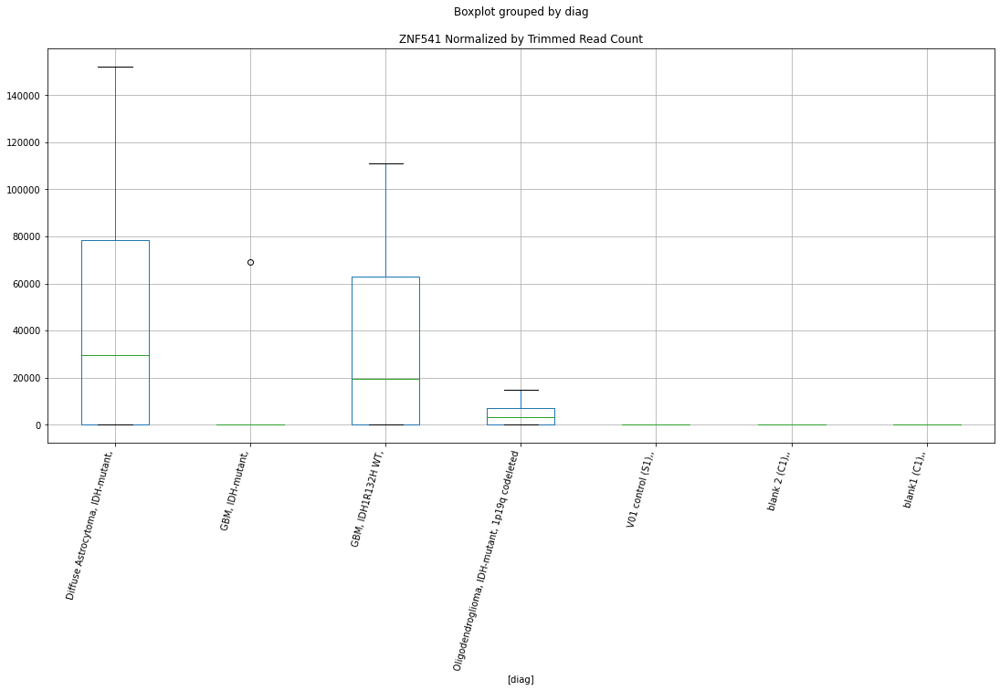

 p : 0.03173981215607334  ( t : 2.3284952740070604 ) :  Lexogen  :  cutadapt2  :  TGM1
Control and blanks
82     0.0
346    0.0
Name: TGM1, dtype: float64
214    0.0
Name: TGM1, dtype: float64
478    0.0
Name: TGM1, dtype: float64


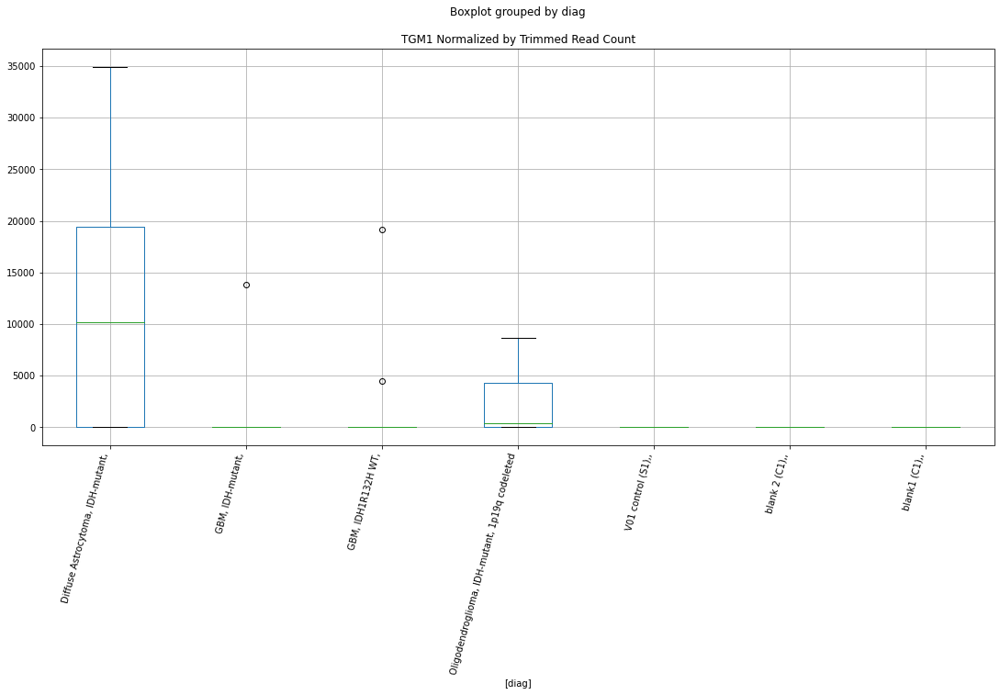

 p : 0.03177103812078212  ( t : 2.328011407289237 ) :  Lexogen  :  cutadapt2  :  WDR44
Control and blanks
82        0.00
346    5260.86
Name: WDR44, dtype: float64
214    24410.38
Name: WDR44, dtype: float64
478    0.0
Name: WDR44, dtype: float64


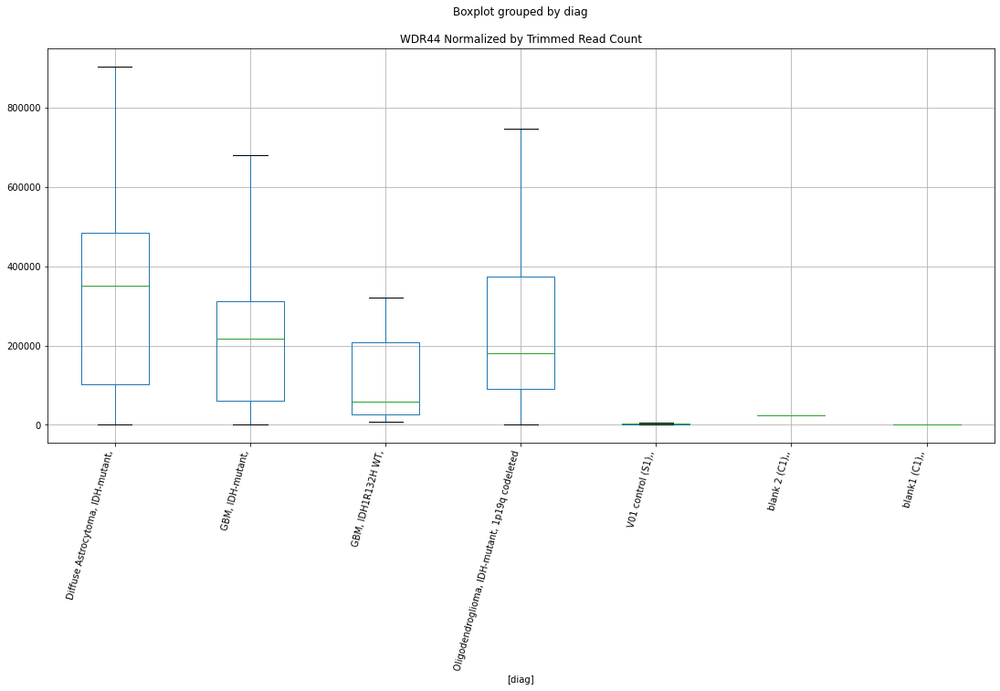

 p : 0.03183988477592934  ( t : 2.326946142997713 ) :  D-plex  :  bbduk2  :  TRAPPC9
Control and blanks
73     793106.62
337    229660.57
Name: TRAPPC9, dtype: float64
205    692007.44
Name: TRAPPC9, dtype: float64
469    165627.65
Name: TRAPPC9, dtype: float64


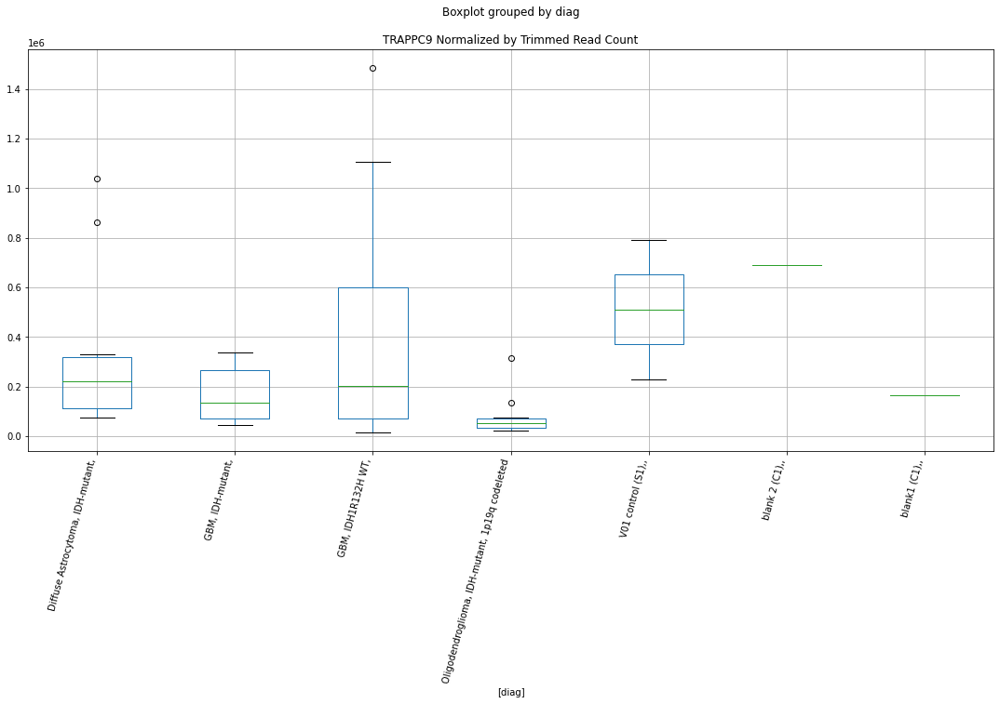

 p : 0.031879852956787705  ( t : 2.326328696993614 ) :  Lexogen  :  cutadapt2  :  ZNF280A
Control and blanks
82        0.00
346    1683.48
Name: ZNF280A, dtype: float64
214    13561.32
Name: ZNF280A, dtype: float64
478    15197.47
Name: ZNF280A, dtype: float64


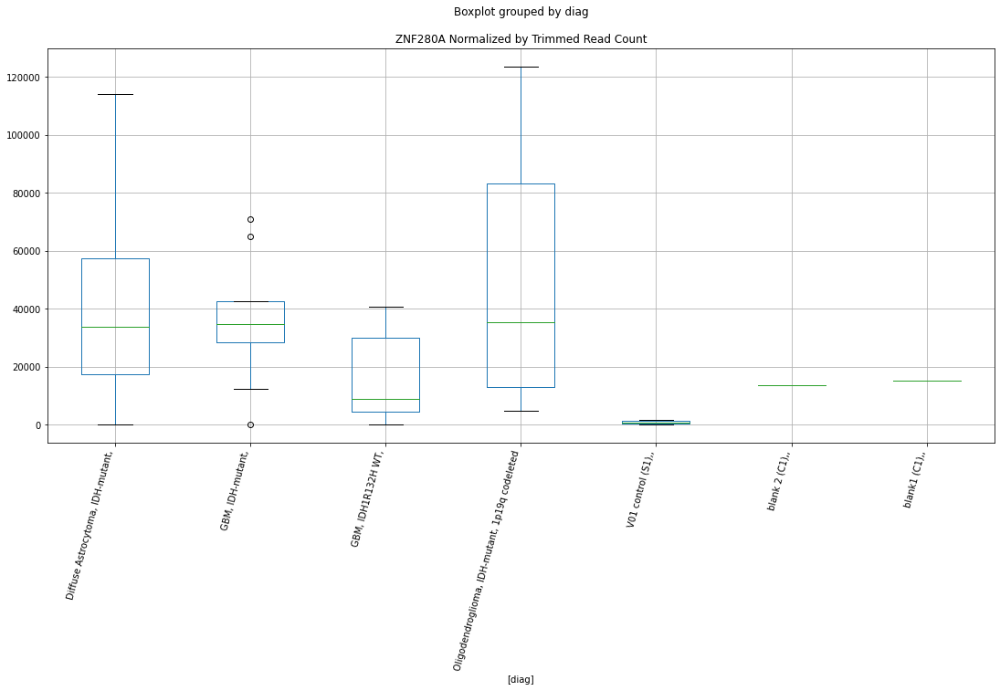

 p : 0.03188393341773337  ( t : 2.3262657007165153 ) :  D-plex  :  cutadapt2  :  TMEM51-AS1
Control and blanks
76     757.61
340      0.00
Name: TMEM51-AS1, dtype: float64
208    529.08
Name: TMEM51-AS1, dtype: float64
472    1155.91
Name: TMEM51-AS1, dtype: float64


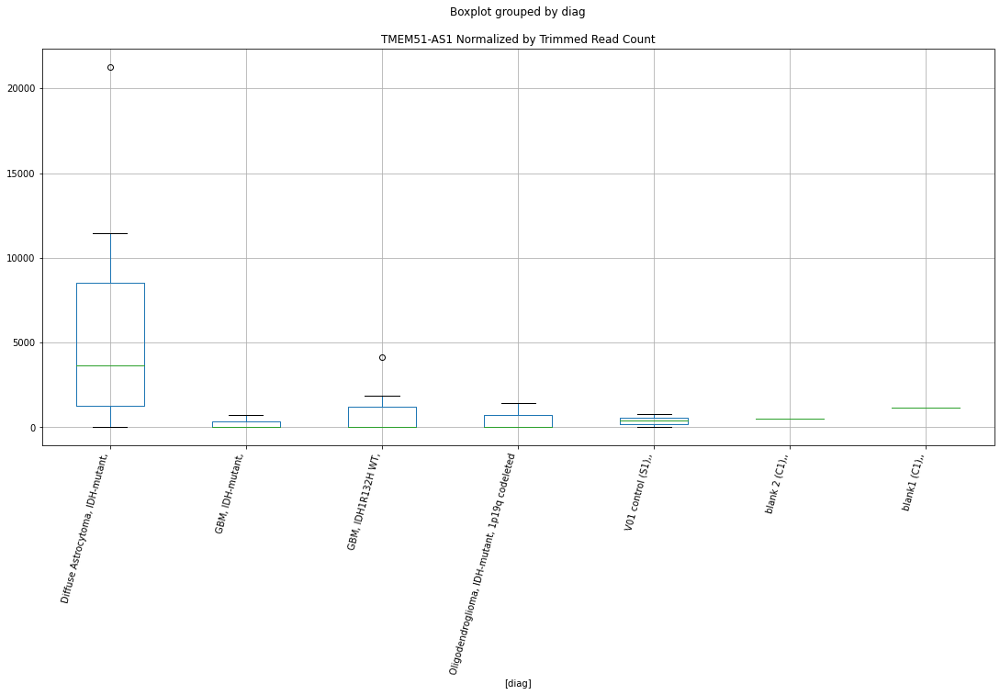

 p : 0.03203866545180259  ( t : 2.3238823781618185 ) :  D-plex  :  cutadapt2  :  SYTL3
Control and blanks
76     0.0
340    0.0
Name: SYTL3, dtype: float64
208    0.0
Name: SYTL3, dtype: float64
472    0.0
Name: SYTL3, dtype: float64


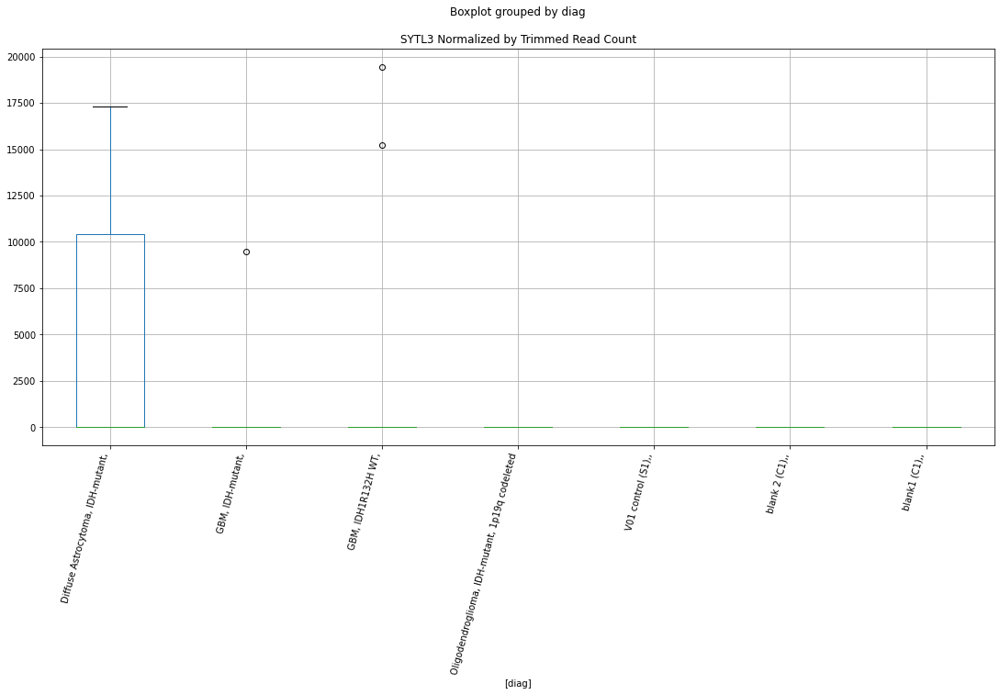

 p : 0.03205524155987043  ( t : 2.3236276925153105 ) :  Lexogen  :  bbduk2  :  VRTN
Control and blanks
79        0.0
343    2972.4
Name: VRTN, dtype: float64
211    0.0
Name: VRTN, dtype: float64
475    0.0
Name: VRTN, dtype: float64


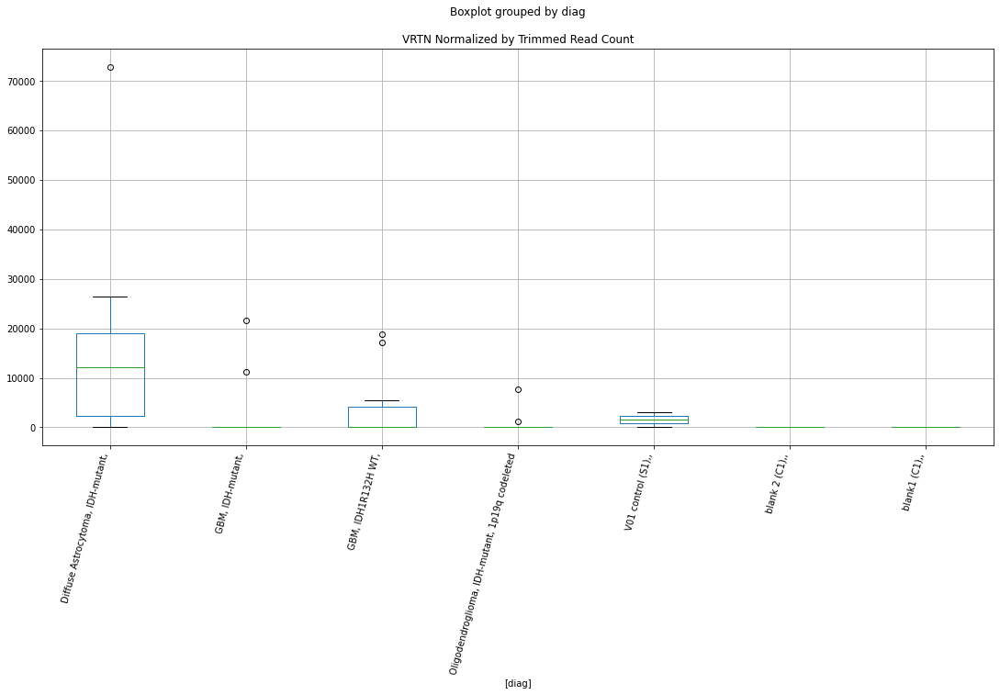

 p : 0.032110435503507236  ( t : 2.3227805394735834 ) :  Lexogen  :  cutadapt2  :  SRRM2
Control and blanks
82          0.00
346    206225.83
Name: SRRM2, dtype: float64
214    0.0
Name: SRRM2, dtype: float64
478    0.0
Name: SRRM2, dtype: float64


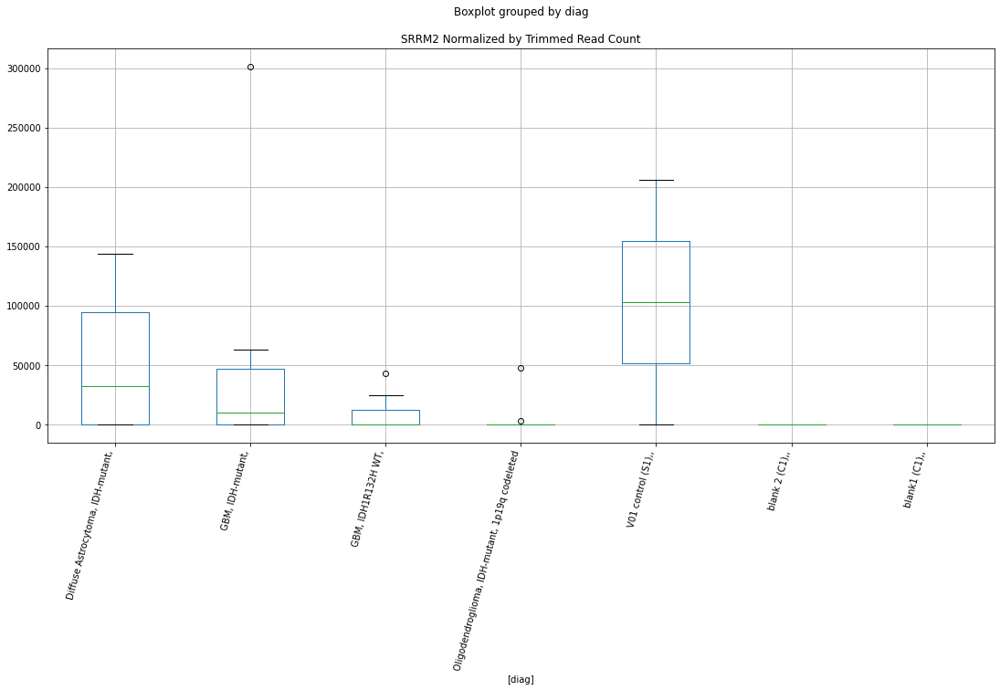

 p : 0.03214242304783842  ( t : 2.322290192509599 ) :  D-plex  :  bbduk2  :  UBALD1
Control and blanks
73     0.0
337    0.0
Name: UBALD1, dtype: float64
205    358.18
Name: UBALD1, dtype: float64
469    1183.05
Name: UBALD1, dtype: float64


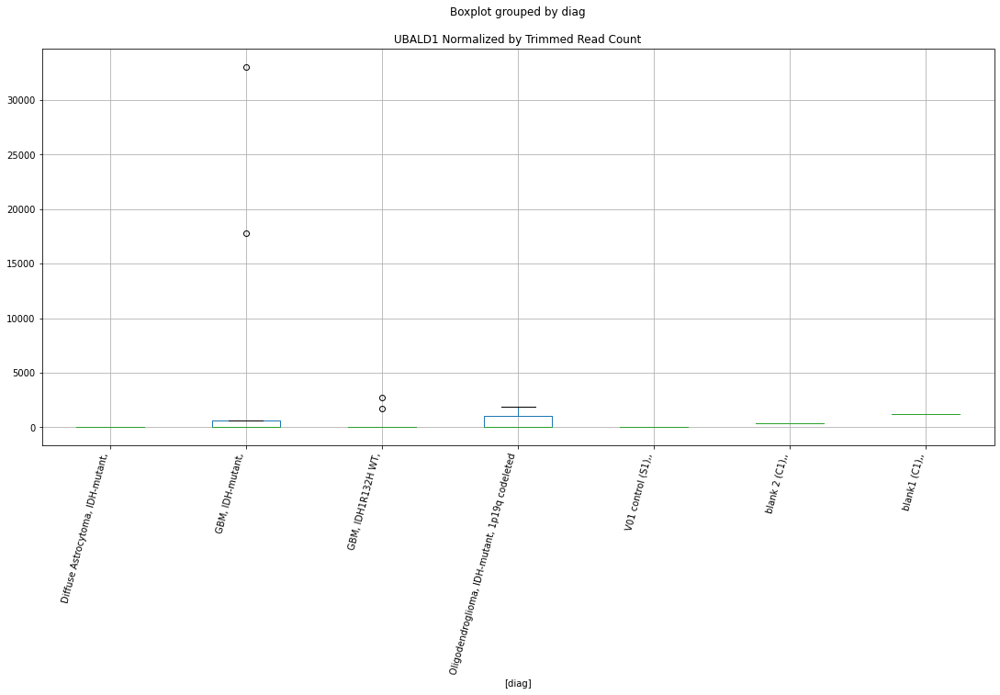

 p : 0.032160608307554246  ( t : 2.322011627109642 ) :  D-plex  :  cutadapt2  :  UBALD1
Control and blanks
76     0.0
340    0.0
Name: UBALD1, dtype: float64
208    352.72
Name: UBALD1, dtype: float64
472    1155.91
Name: UBALD1, dtype: float64


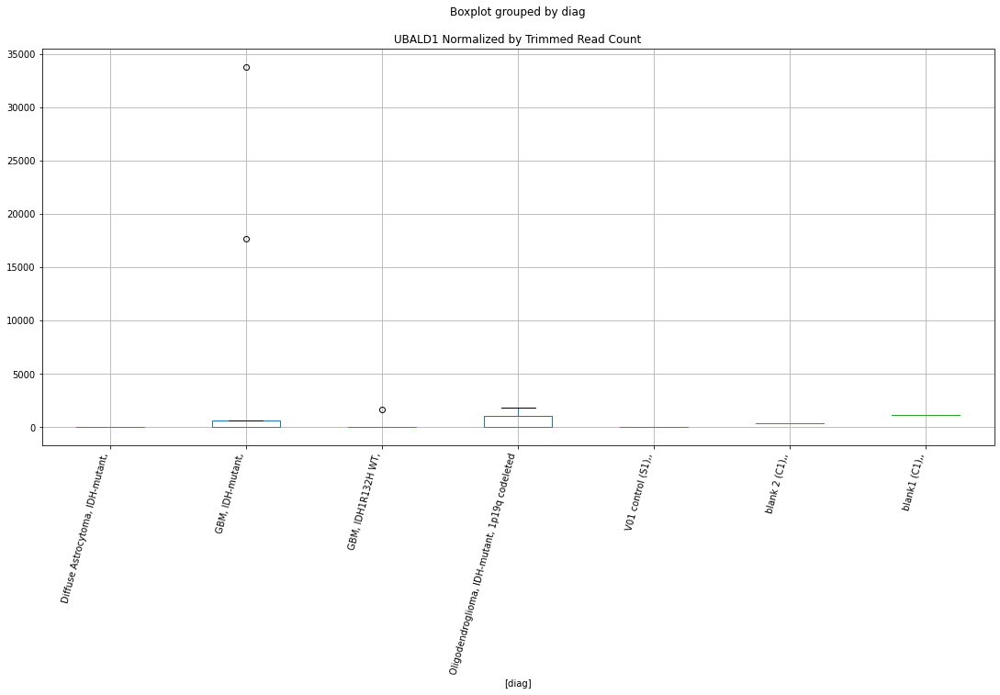

 p : 0.032204418715874907  ( t : 2.321341130999362 ) :  D-plex  :  bbduk2  :  SYTL3
Control and blanks
73     0.0
337    0.0
Name: SYTL3, dtype: float64
205    0.0
Name: SYTL3, dtype: float64
469    0.0
Name: SYTL3, dtype: float64


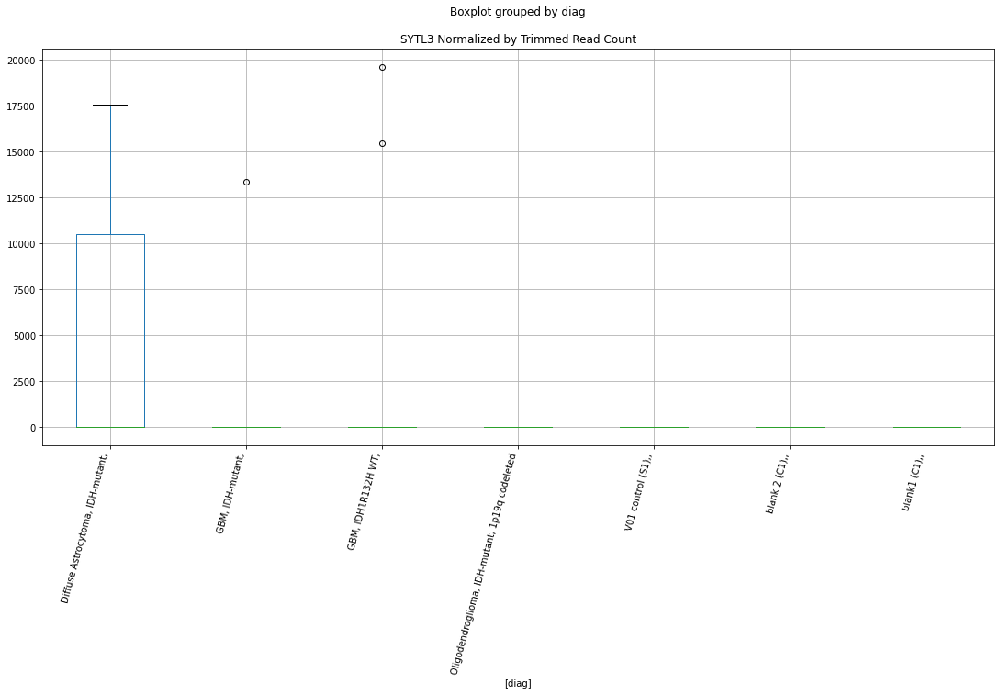

 p : 0.032236470592087535  ( t : 2.320851129719255 ) :  Lexogen  :  cutadapt2  :  VRTN
Control and blanks
82        0.00
346    2946.08
Name: VRTN, dtype: float64
214    0.0
Name: VRTN, dtype: float64
478    0.0
Name: VRTN, dtype: float64


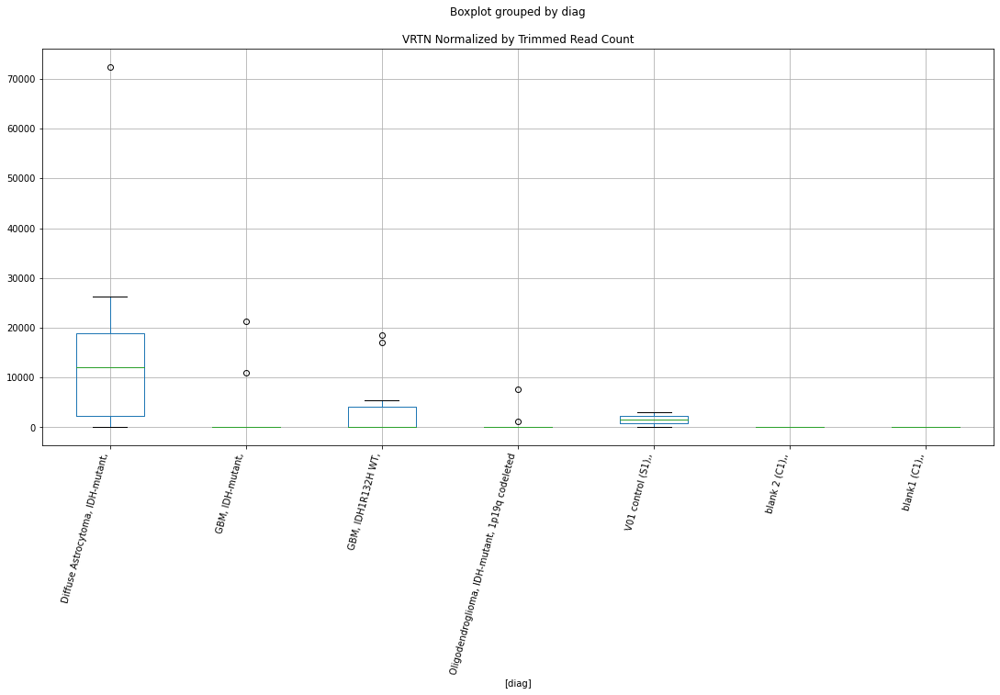

 p : 0.03238208006750161  ( t : 2.318630769154111 ) :  D-plex  :  bbduk2  :  VAPB
Control and blanks
73     2319.03
337    2670.47
Name: VAPB, dtype: float64
205    2686.36
Name: VAPB, dtype: float64
469    8872.91
Name: VAPB, dtype: float64


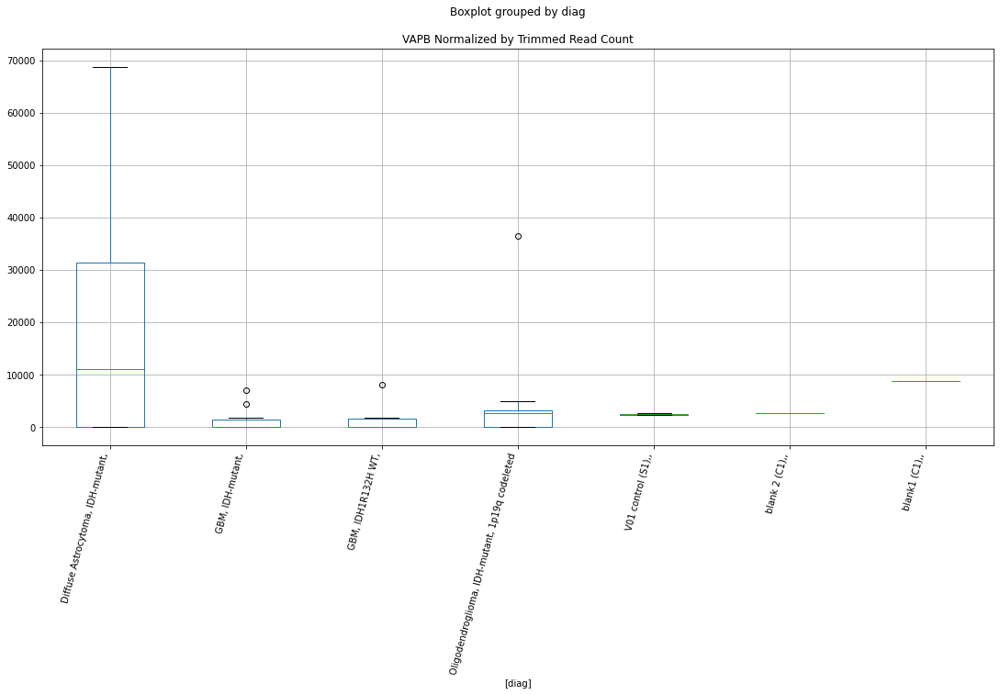

 p : 0.032498267602135866  ( t : 2.316865696844474 ) :  D-plex  :  bbduk2  :  VAPB
Control and blanks
73     2319.03
337    2670.47
Name: VAPB, dtype: float64
205    2686.36
Name: VAPB, dtype: float64
469    8872.91
Name: VAPB, dtype: float64


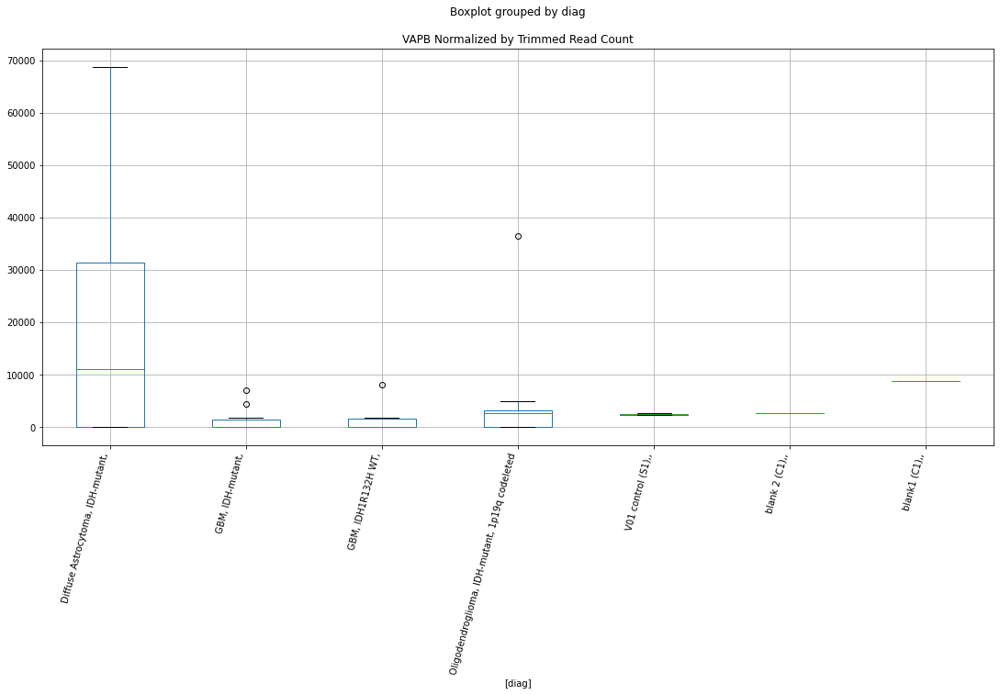

 p : 0.032745529359515906  ( t : 2.313128818798543 ) :  Lexogen  :  bbduk2  :  TUBA8
Control and blanks
79       0.00
343    424.63
Name: TUBA8, dtype: float64
211    0.0
Name: TUBA8, dtype: float64
475    0.0
Name: TUBA8, dtype: float64


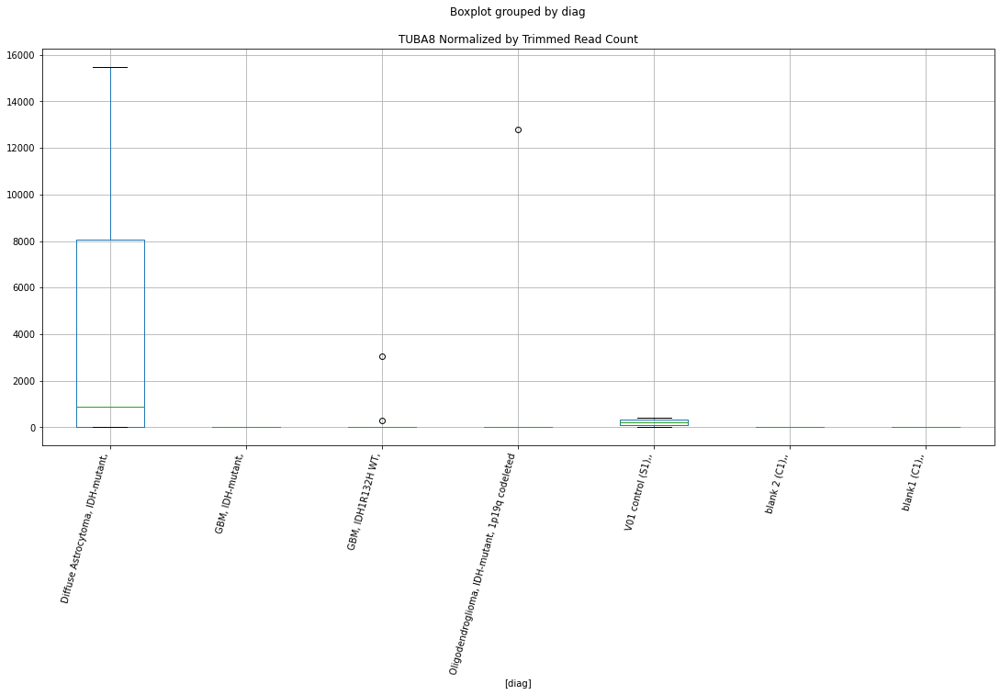

 p : 0.032758348801620214  ( t : 2.3129357929922705 ) :  Lexogen  :  cutadapt2  :  TPBG
Control and blanks
82     0.0
346    0.0
Name: TPBG, dtype: float64
214    0.0
Name: TPBG, dtype: float64
478    0.0
Name: TPBG, dtype: float64


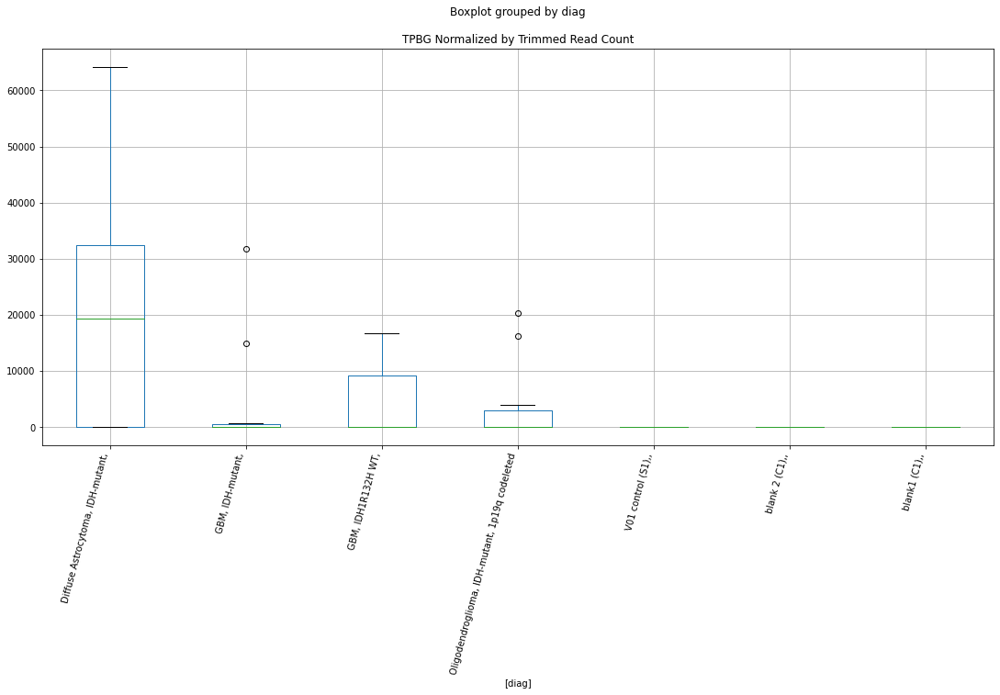

 p : 0.032784946093956456  ( t : 2.312535533901136 ) :  Lexogen  :  cutadapt2  :  TMCO6
Control and blanks
82     0.0
346    0.0
Name: TMCO6, dtype: float64
214    0.0
Name: TMCO6, dtype: float64
478    0.0
Name: TMCO6, dtype: float64


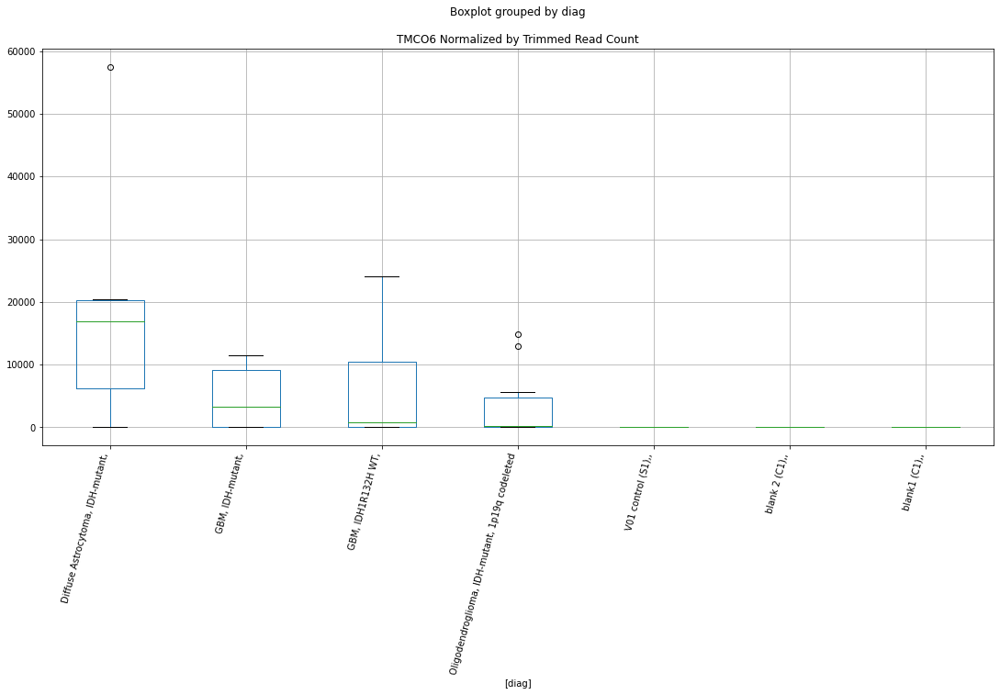

 p : 0.032794111691523  ( t : 2.3123976718724317 ) :  D-plex  :  cutadapt2  :  UNC5B
Control and blanks
76      5303.30
340    67816.37
Name: UNC5B, dtype: float64
208    2645.4
Name: UNC5B, dtype: float64
472    8669.34
Name: UNC5B, dtype: float64


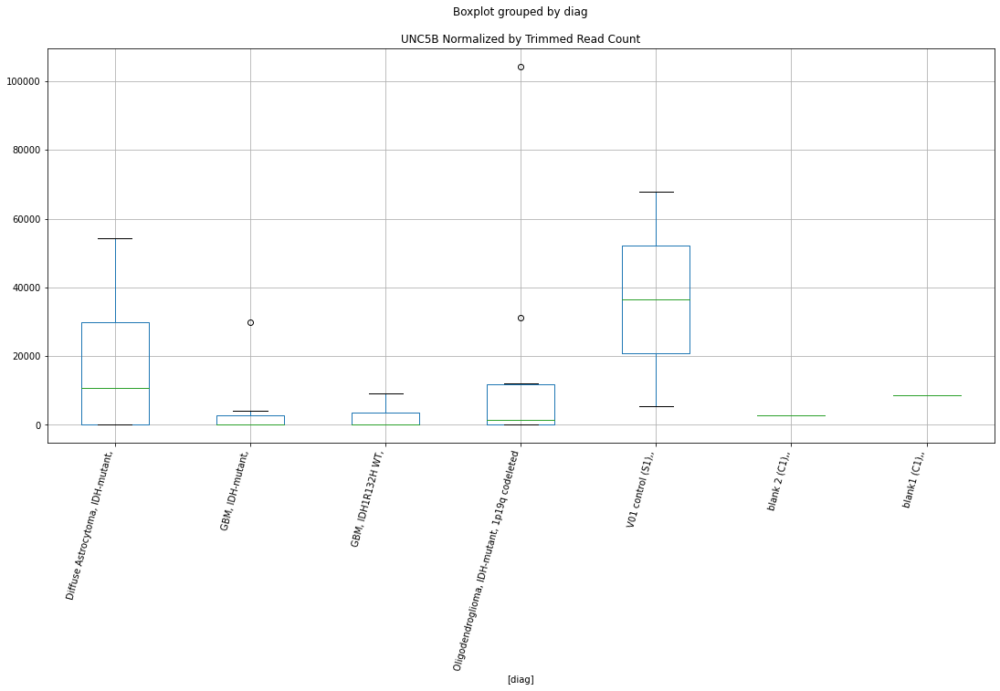

 p : 0.03285978536685676  ( t : 2.311410902623114 ) :  D-plex  :  bbduk2  :  XRN1
Control and blanks
73     13914.15
337     8901.57
Name: XRN1, dtype: float64
205    33131.83
Name: XRN1, dtype: float64
469    44364.55
Name: XRN1, dtype: float64


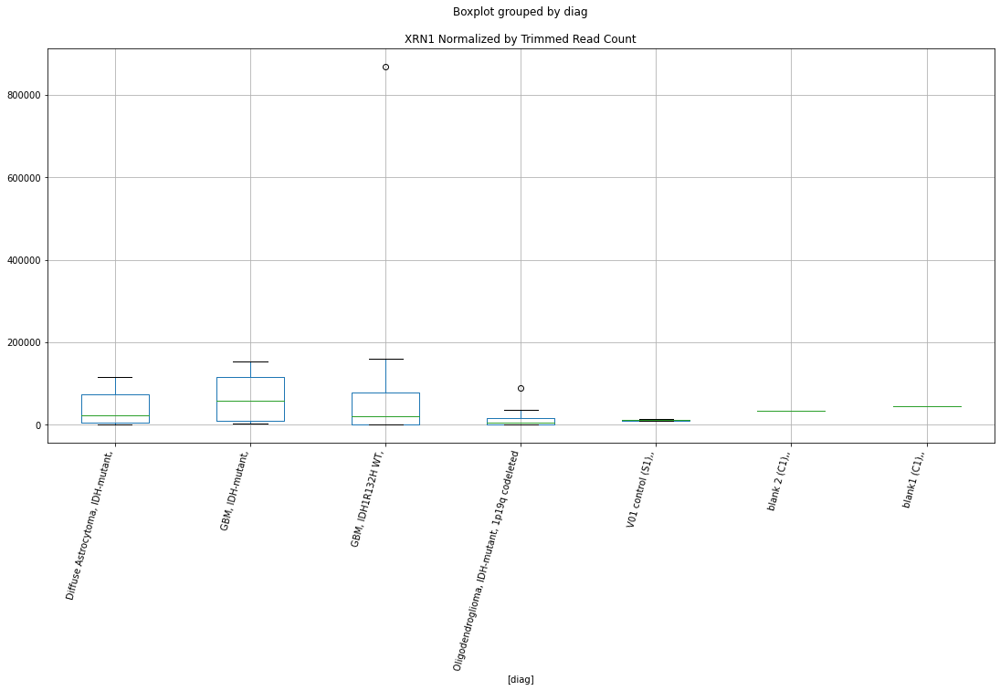

 p : 0.03287553776159058  ( t : 2.311174489717215 ) :  Lexogen  :  bbduk2  :  TPBG
Control and blanks
79     0.0
343    0.0
Name: TPBG, dtype: float64
211    0.0
Name: TPBG, dtype: float64
475    0.0
Name: TPBG, dtype: float64


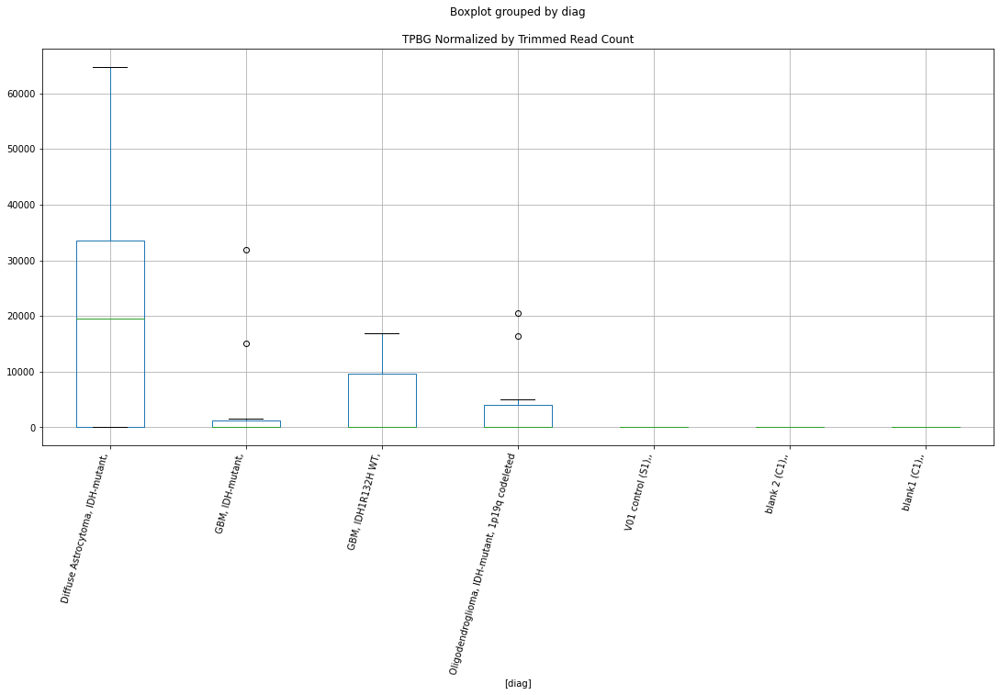

 p : 0.03289033220480346  ( t : 2.3109525495162595 ) :  Lexogen  :  bbduk2  :  XKR4
Control and blanks
79     0.0
343    0.0
Name: XKR4, dtype: float64
211    0.0
Name: XKR4, dtype: float64
475    0.0
Name: XKR4, dtype: float64


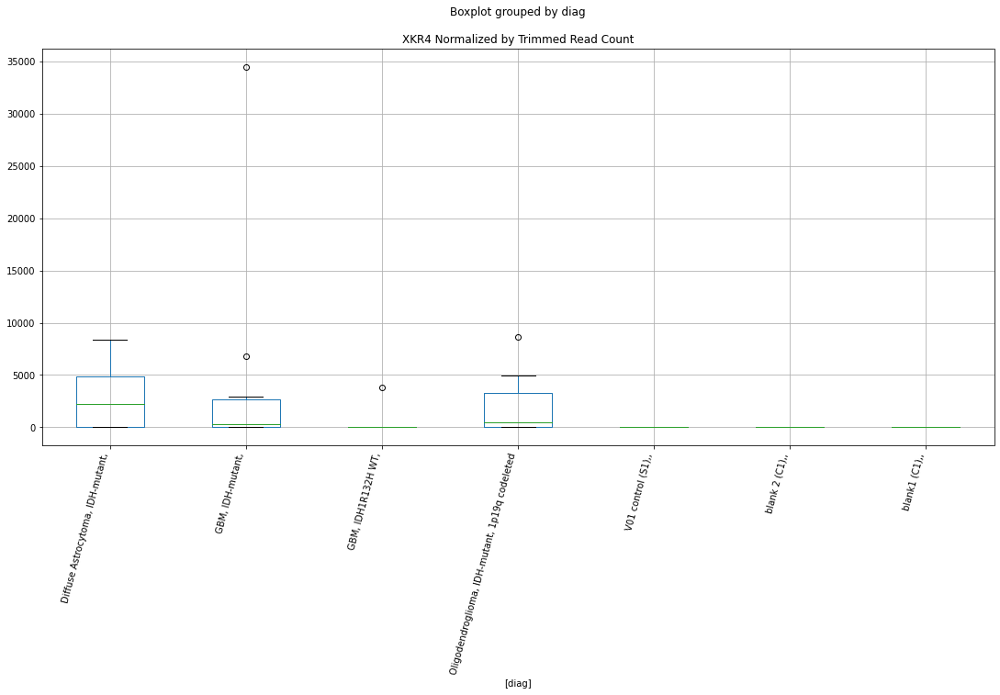

 p : 0.03293927331072576  ( t : 2.310219014577634 ) :  D-plex  :  cutadapt2  :  SPPL3
Control and blanks
76     0.0
340    0.0
Name: SPPL3, dtype: float64
208    1410.88
Name: SPPL3, dtype: float64
472    1155.91
Name: SPPL3, dtype: float64


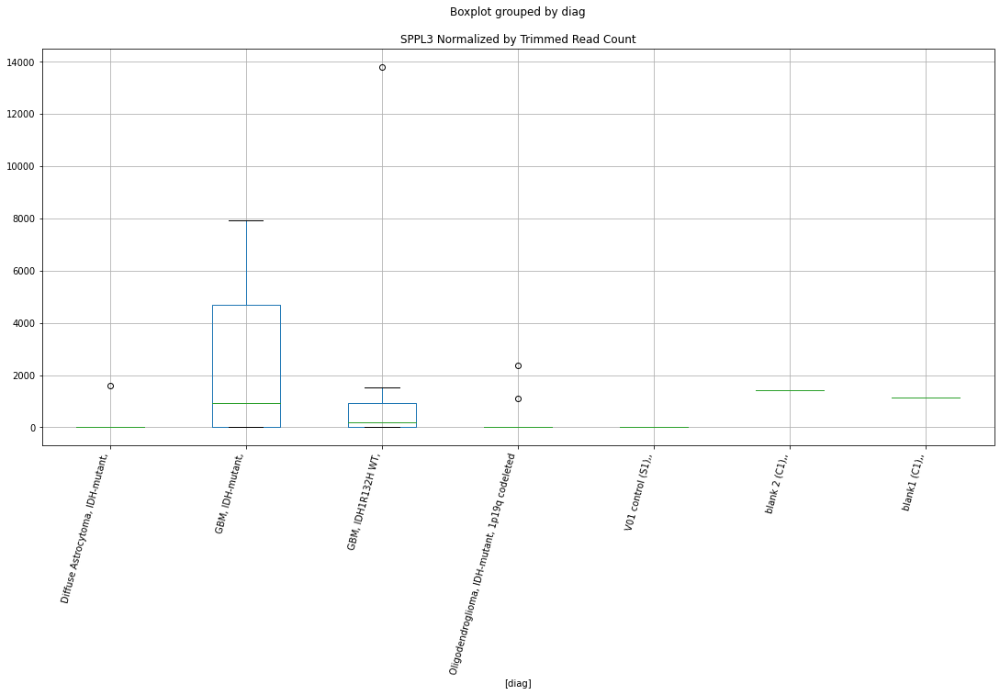

 p : 0.03296546035215073  ( t : 2.3098269354327496 ) :  D-plex  :  cutadapt2  :  WDR82
Control and blanks
76     0.0
340    0.0
Name: WDR82, dtype: float64
208    1587.24
Name: WDR82, dtype: float64
472    0.0
Name: WDR82, dtype: float64


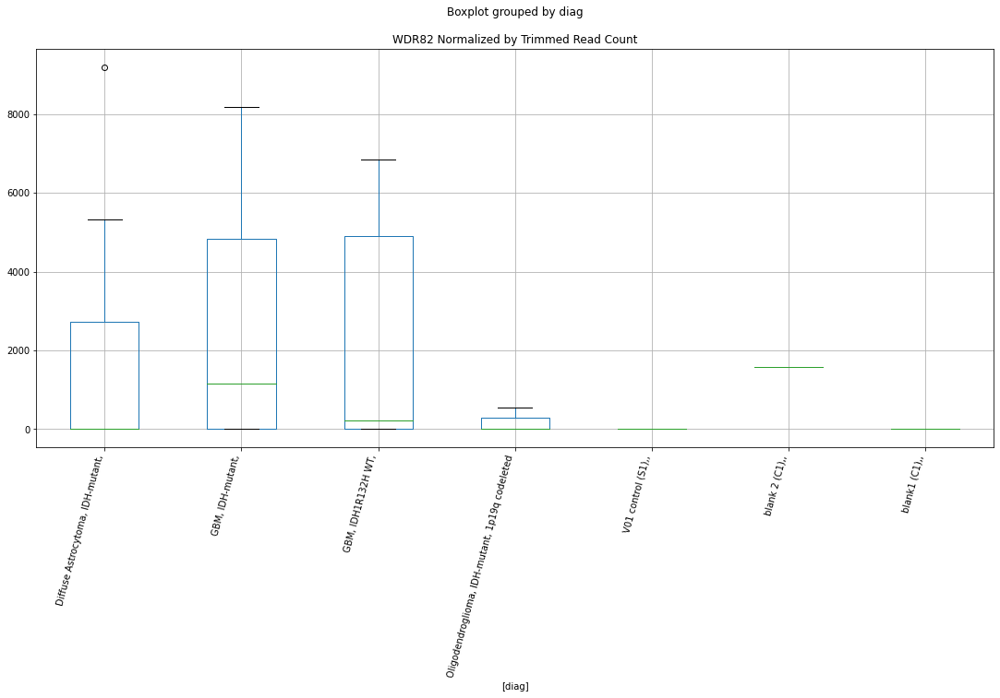

 p : 0.033053494350352326  ( t : 2.308510983149426 ) :  D-plex  :  bbduk2  :  THSD4
Control and blanks
73        0.00
337    8901.57
Name: THSD4, dtype: float64
205    3223.64
Name: THSD4, dtype: float64
469    27801.78
Name: THSD4, dtype: float64


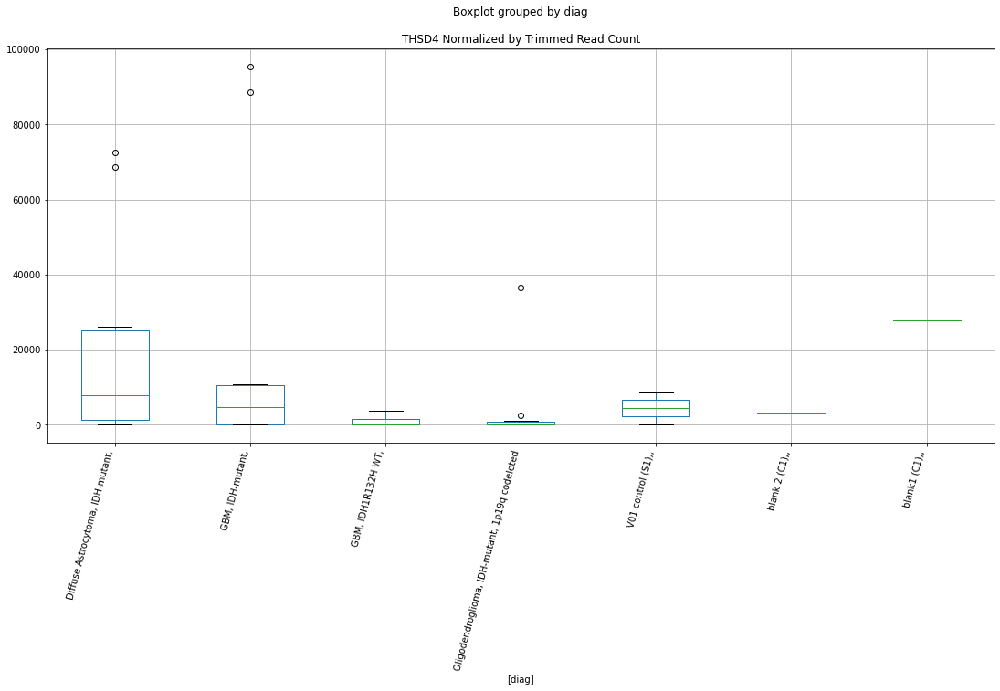

 p : 0.033066032589016275  ( t : 2.3083238233213272 ) :  D-plex  :  bbduk2  :  TSPAN10
Control and blanks
73     0.0
337    0.0
Name: TSPAN10, dtype: float64
205    0.0
Name: TSPAN10, dtype: float64
469    1774.58
Name: TSPAN10, dtype: float64


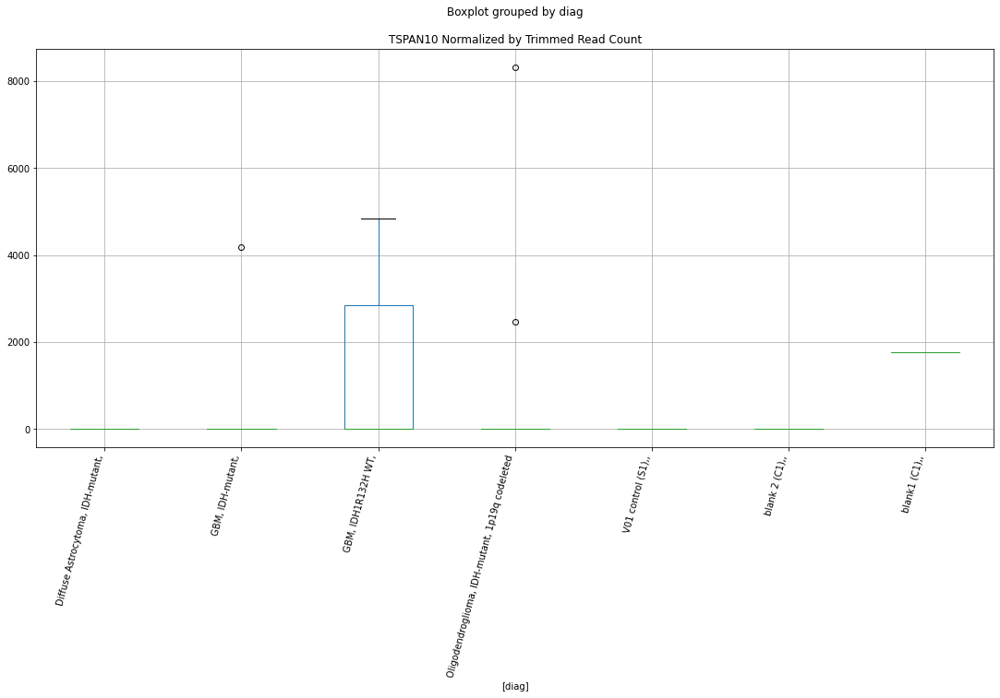

 p : 0.033140968169369706  ( t : 2.3072066214792617 ) :  Lexogen  :  bbduk2  :  TMEM45A
Control and blanks
79     0.0
343    0.0
Name: TMEM45A, dtype: float64
211    0.0
Name: TMEM45A, dtype: float64
475    0.0
Name: TMEM45A, dtype: float64


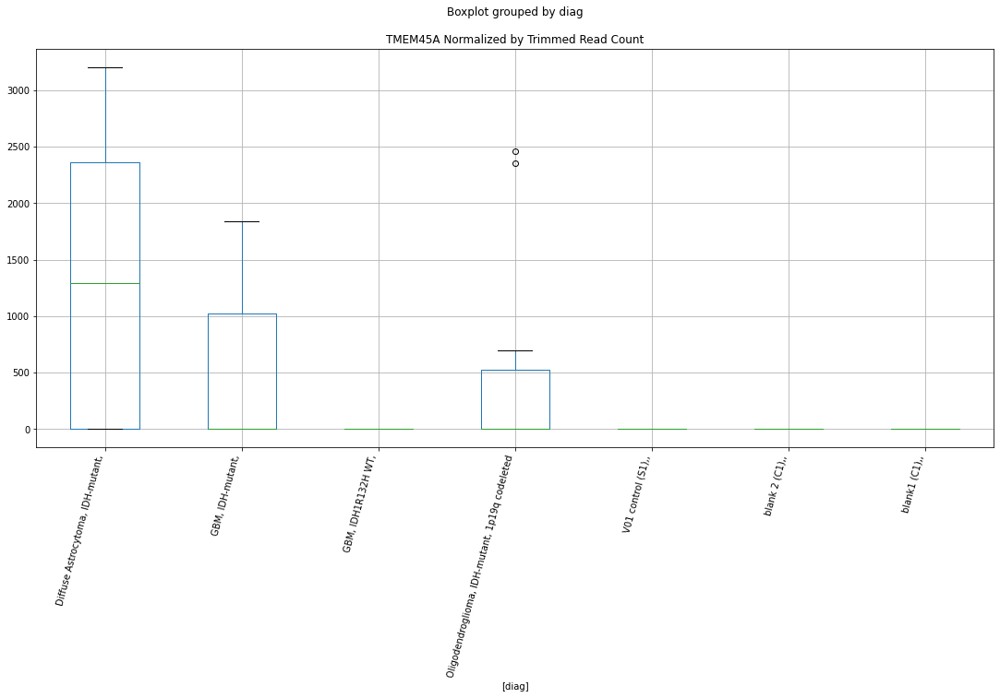

 p : 0.03319621507336367  ( t : 2.3063844545514156 ) :  D-plex  :  cutadapt2  :  SSBP4
Control and blanks
76     0.0
340    0.0
Name: SSBP4, dtype: float64
208    10581.61
Name: SSBP4, dtype: float64
472    3467.74
Name: SSBP4, dtype: float64


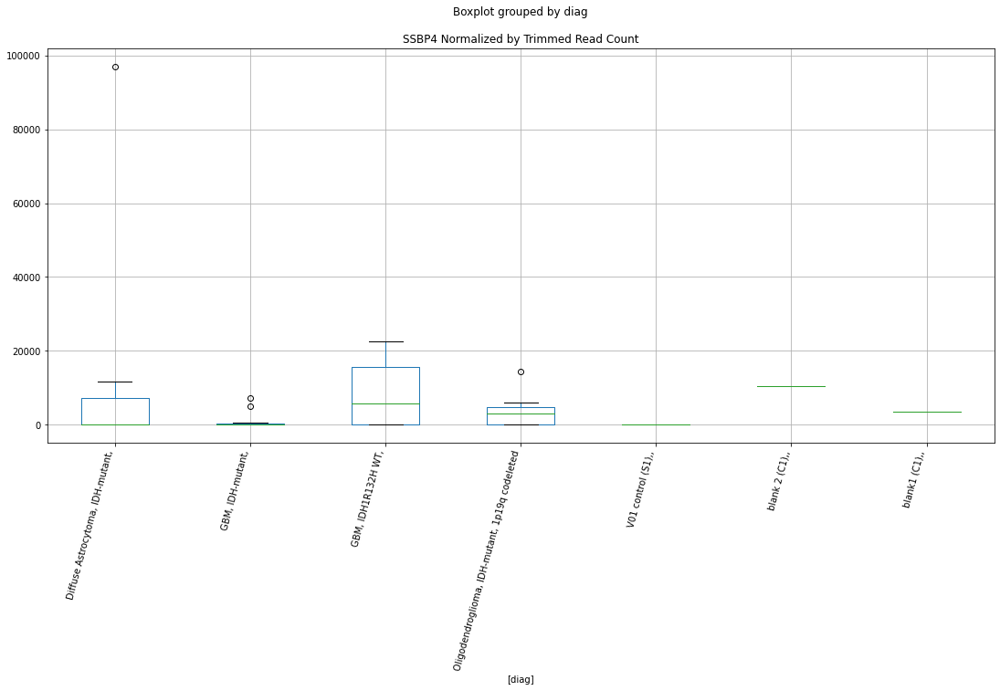

 p : 0.03323088108086997  ( t : 2.305869213856472 ) :  Lexogen  :  cutadapt2  :  TGM4
Control and blanks
82     0.0
346    0.0
Name: TGM4, dtype: float64
214    0.0
Name: TGM4, dtype: float64
478    474.92
Name: TGM4, dtype: float64


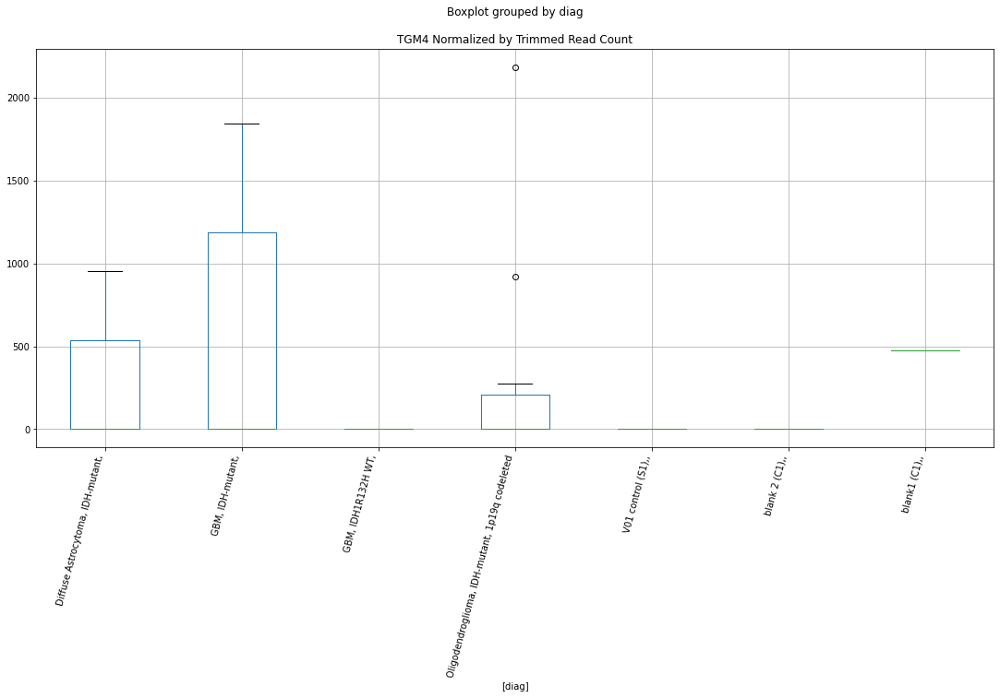

 p : 0.033307447050032135  ( t : 2.304732978587385 ) :  Lexogen  :  bbduk2  :  TSNAX
Control and blanks
79     0.0
343    0.0
Name: TSNAX, dtype: float64
211    0.0
Name: TSNAX, dtype: float64
475    0.0
Name: TSNAX, dtype: float64


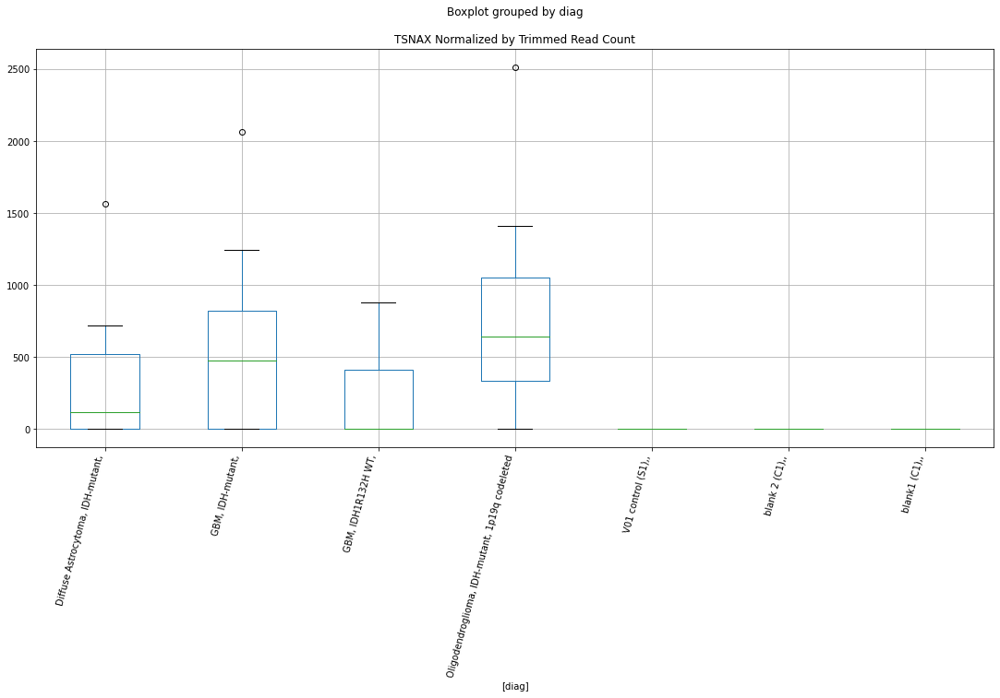

 p : 0.03331512524878719  ( t : 2.304619168179568 ) :  D-plex  :  cutadapt2  :  TSPAN10
Control and blanks
76     0.0
340    0.0
Name: TSPAN10, dtype: float64
208    0.0
Name: TSPAN10, dtype: float64
472    1733.87
Name: TSPAN10, dtype: float64


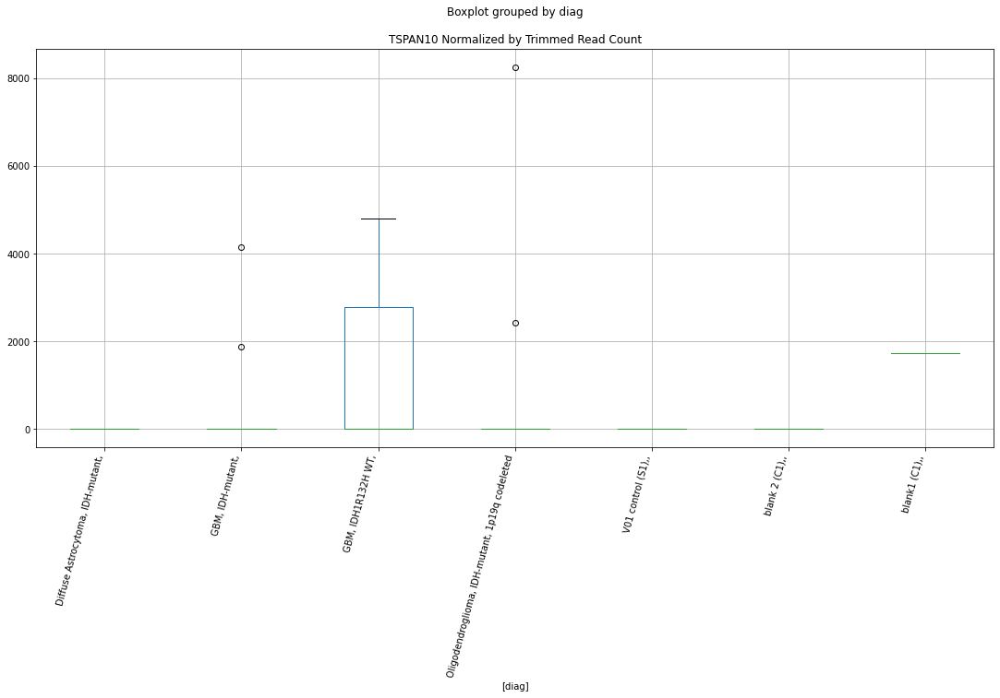

 p : 0.03336222367667649  ( t : 2.3039215816812257 ) :  D-plex  :  bbduk2  :  WWC3
Control and blanks
73     0.0
337    0.0
Name: WWC3, dtype: float64
205    1970.0
Name: WWC3, dtype: float64
469    2957.64
Name: WWC3, dtype: float64


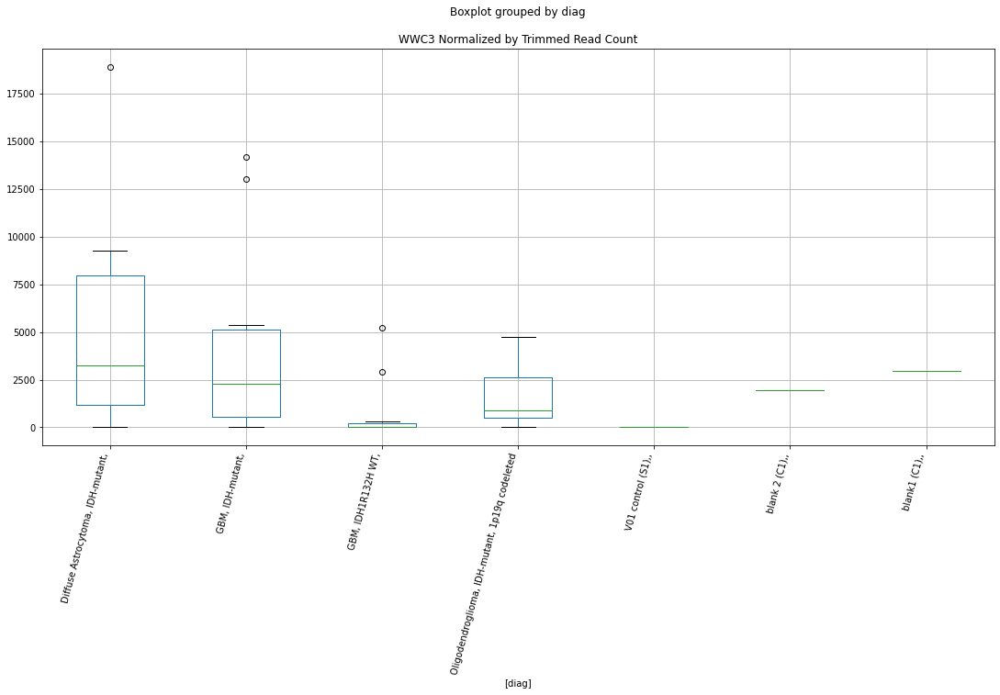

 p : 0.033411505535902594  ( t : 2.303192632979532 ) :  D-plex  :  cutadapt2  :  ZHX2
Control and blanks
76     0.0
340    0.0
Name: ZHX2, dtype: float64
208    4232.65
Name: ZHX2, dtype: float64
472    0.0
Name: ZHX2, dtype: float64


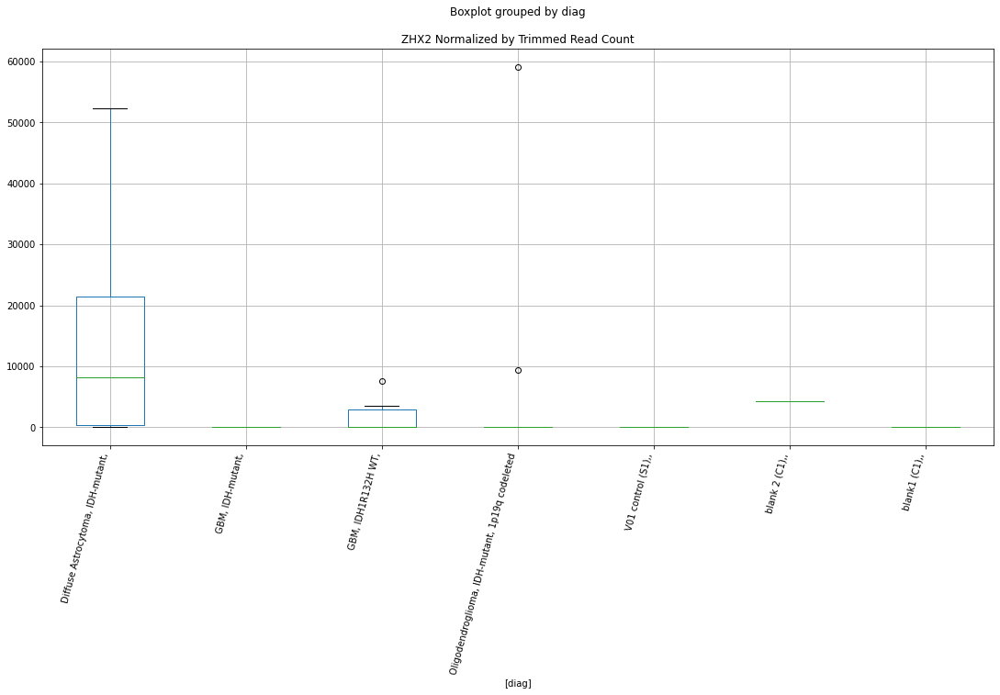

 p : 0.0334399431633536  ( t : 2.302772453637327 ) :  D-plex  :  bbduk2  :  ZNF45
Control and blanks
73     0.0
337    0.0
Name: ZNF45, dtype: float64
205    3581.82
Name: ZNF45, dtype: float64
469    23661.09
Name: ZNF45, dtype: float64


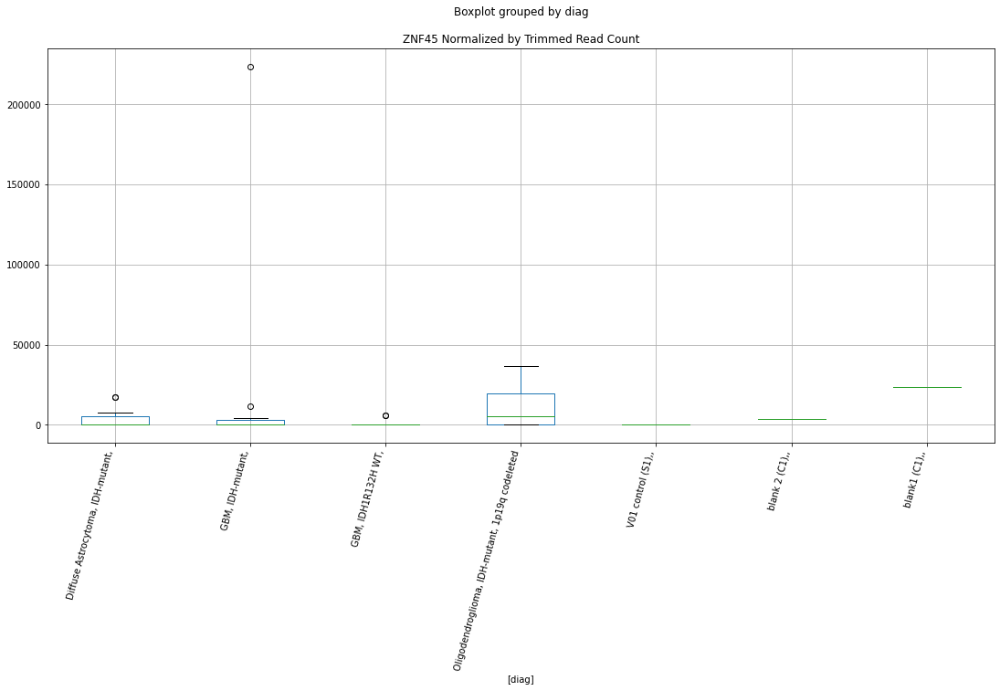

 p : 0.033494865465790016  ( t : 2.301961887849442 ) :  D-plex  :  bbduk2  :  ZHX2
Control and blanks
73     0.0
337    0.0
Name: ZHX2, dtype: float64
205    4298.18
Name: ZHX2, dtype: float64
469    0.0
Name: ZHX2, dtype: float64


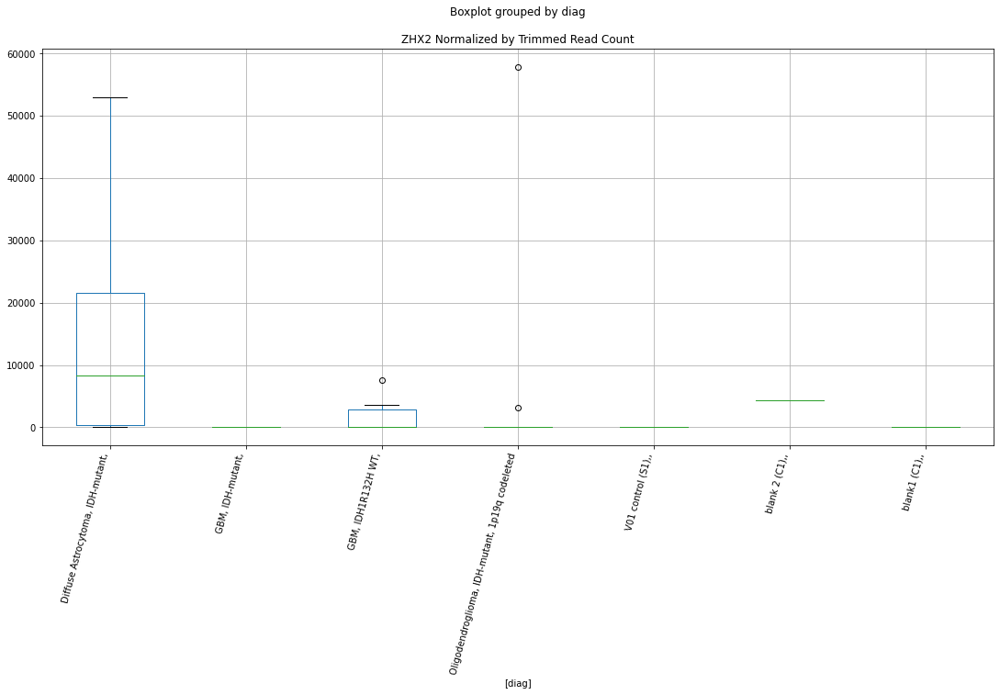

 p : 0.033497646871598376  ( t : 2.3019208715212183 ) :  D-plex  :  cutadapt2  :  UNC5C
Control and blanks
76     136370.56
340         0.00
Name: UNC5C, dtype: float64
208    20810.51
Name: UNC5C, dtype: float64
472    16760.72
Name: UNC5C, dtype: float64


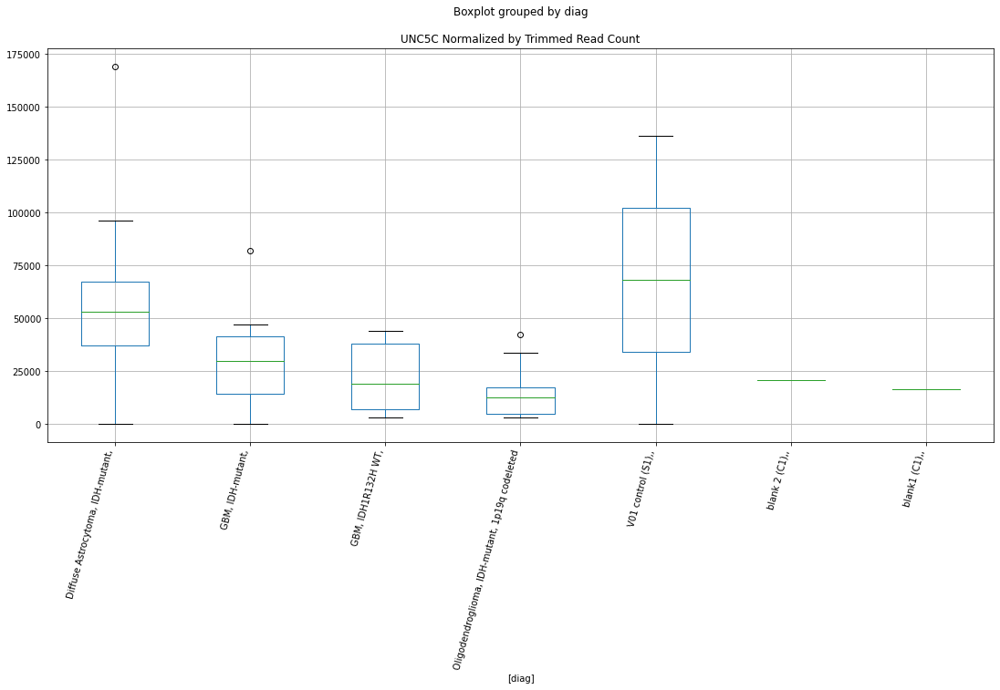

 p : 0.03353958967387485  ( t : 2.3013027396076873 ) :  D-plex  :  cutadapt2  :  SRGAP2
Control and blanks
76     0.0
340    0.0
Name: SRGAP2, dtype: float64
208    13756.1
Name: SRGAP2, dtype: float64
472    25430.06
Name: SRGAP2, dtype: float64


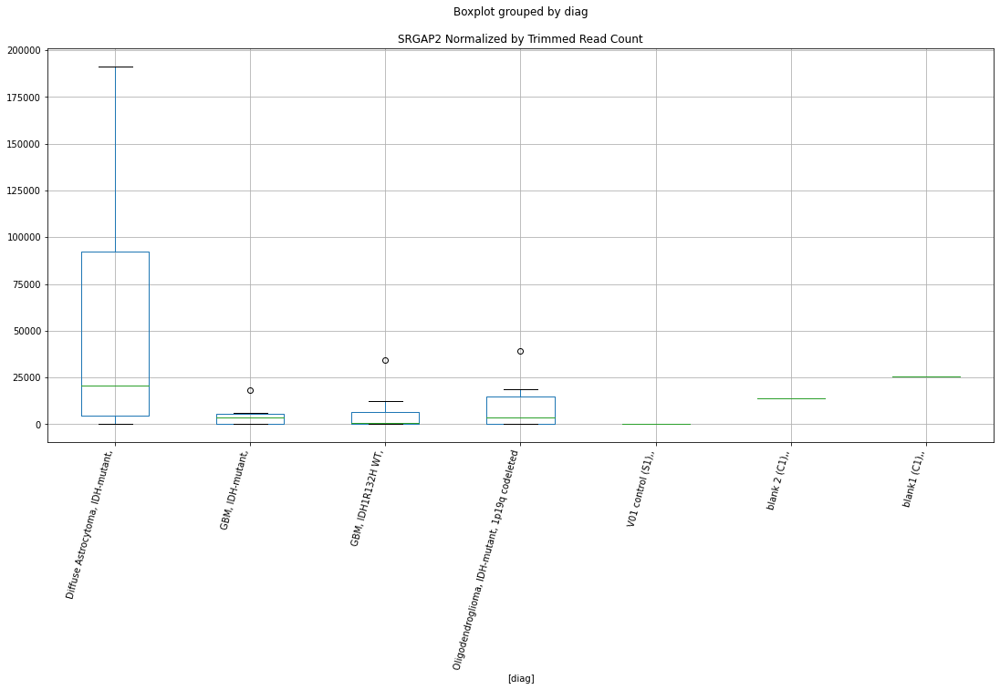

 p : 0.03364111102318504  ( t : 2.2998095308419972 ) :  D-plex  :  bbduk2  :  STK16
Control and blanks
73       3865.04
337    160228.31
Name: STK16, dtype: float64
205    253413.7
Name: STK16, dtype: float64
469    8872.91
Name: STK16, dtype: float64


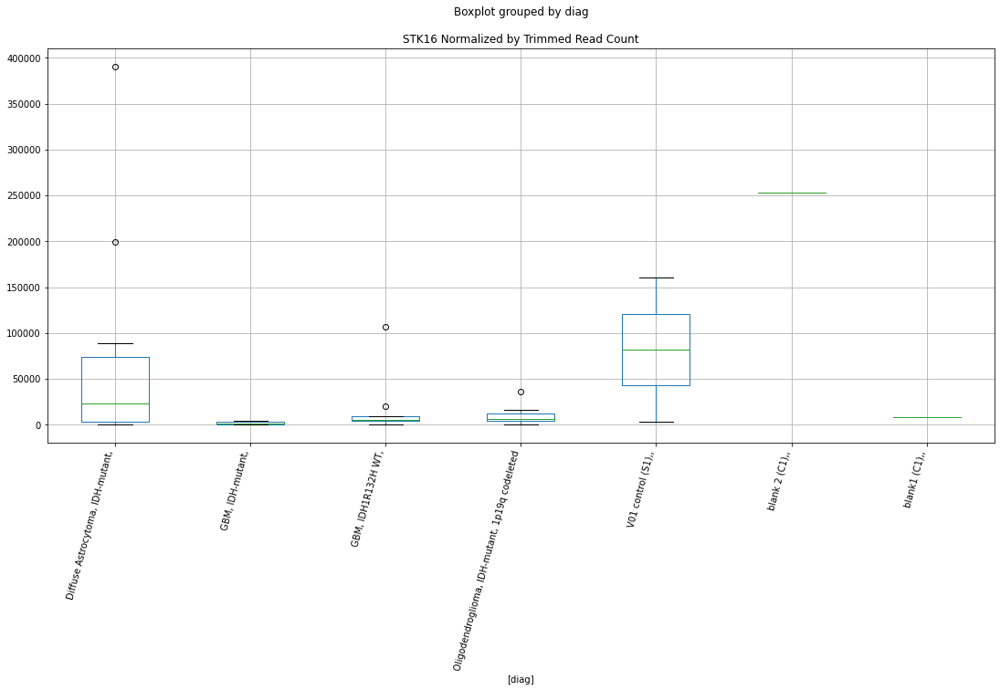

 p : 0.033645856497042215  ( t : 2.2997398351330816 ) :  Lexogen  :  cutadapt2  :  TPBG
Control and blanks
82     0.0
346    0.0
Name: TPBG, dtype: float64
214    0.0
Name: TPBG, dtype: float64
478    0.0
Name: TPBG, dtype: float64


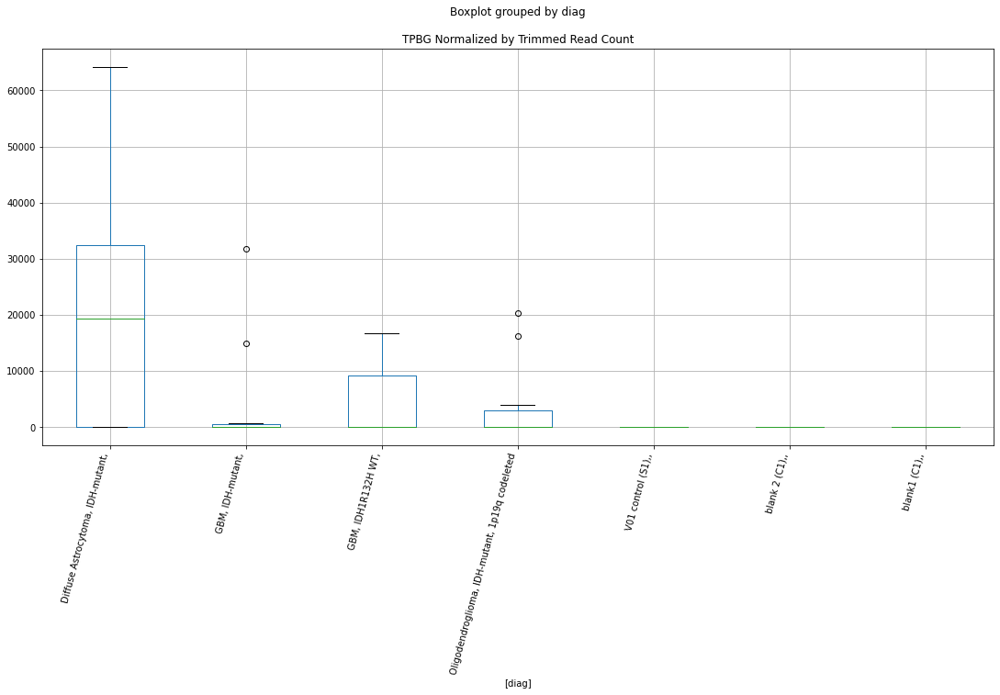

 p : 0.033712990865093294  ( t : 2.2987548229019503 ) :  D-plex  :  cutadapt2  :  ZNF800
Control and blanks
76     152280.46
340     11449.52
Name: ZNF800, dtype: float64
208    56964.35
Name: ZNF800, dtype: float64
472    43924.64
Name: ZNF800, dtype: float64


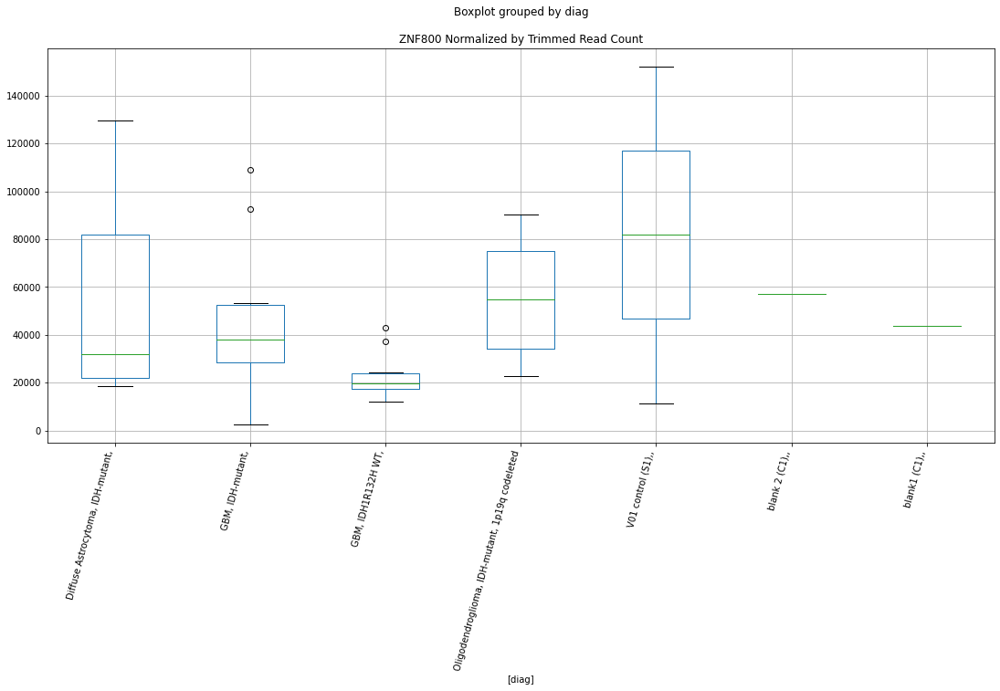

 p : 0.0337404993089096  ( t : 2.298351737227963 ) :  D-plex  :  bbduk2  :  TBC1D13
Control and blanks
73     0.0
337    0.0
Name: TBC1D13, dtype: float64
205    4298.18
Name: TBC1D13, dtype: float64
469    8872.91
Name: TBC1D13, dtype: float64


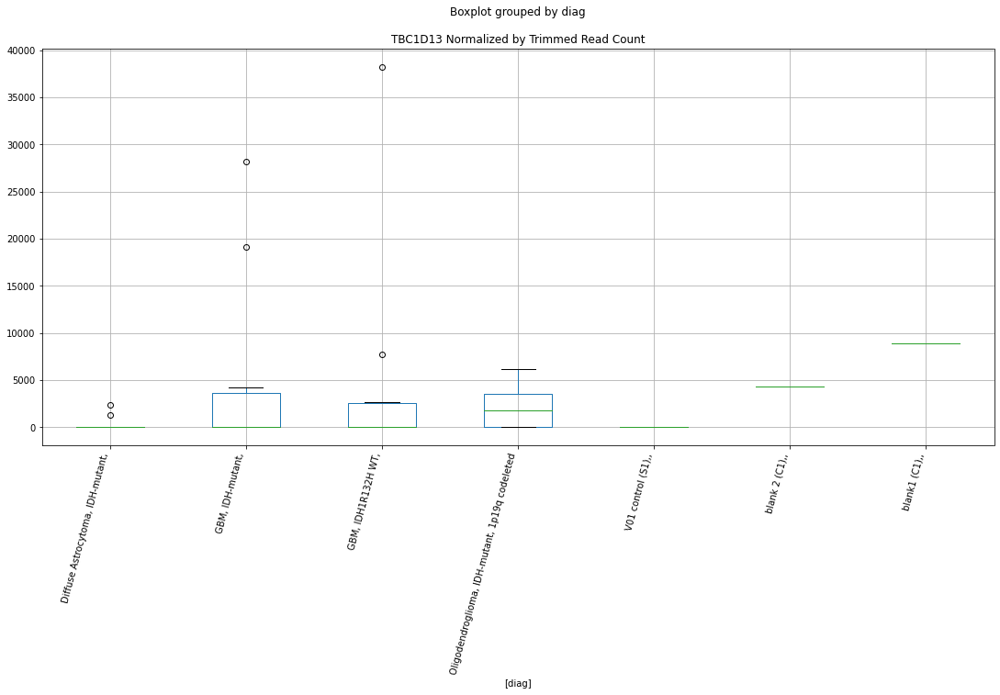

 p : 0.03385795524947209  ( t : 2.2966340563217535 ) :  D-plex  :  cutadapt2  :  TCF21
Control and blanks
76     1515.23
340       0.00
Name: TCF21, dtype: float64
208    529.08
Name: TCF21, dtype: float64
472    2311.82
Name: TCF21, dtype: float64


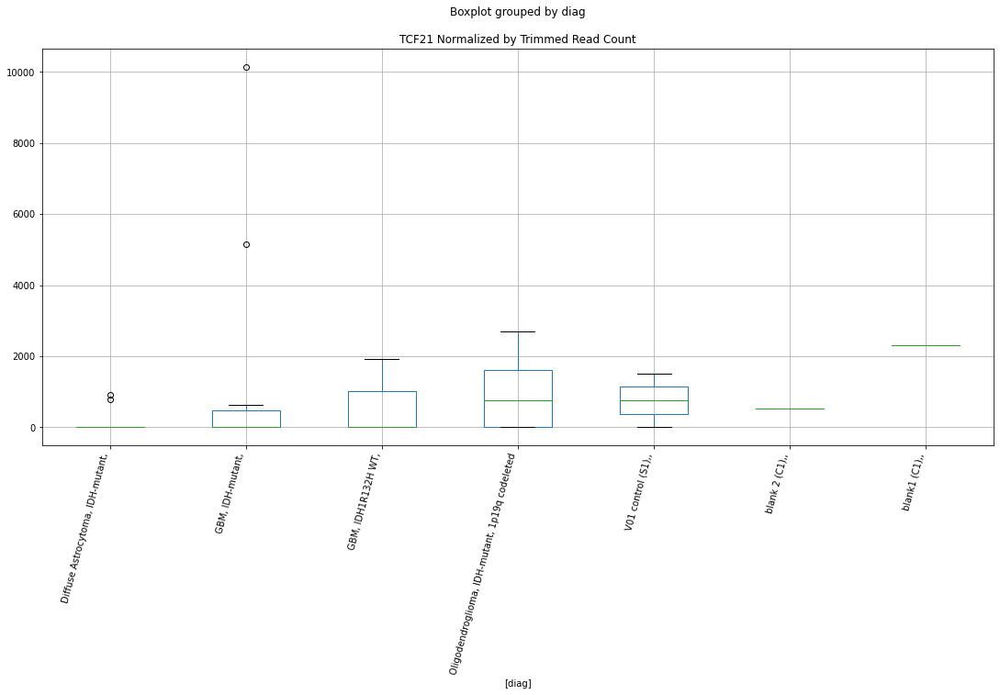

 p : 0.03388179767248904  ( t : 2.296286058114614 ) :  D-plex  :  cutadapt2  :  TCF7
Control and blanks
76     18940.36
340        0.00
Name: TCF7, dtype: float64
208    56435.27
Name: TCF7, dtype: float64
472    8091.38
Name: TCF7, dtype: float64


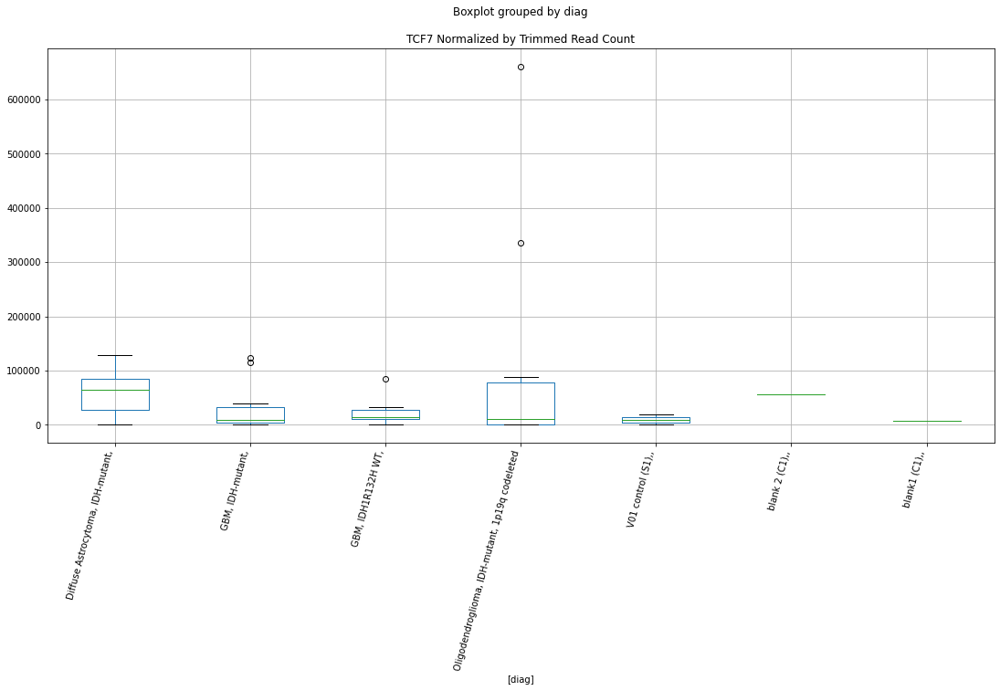

 p : 0.03391852694783891  ( t : 2.295750410401411 ) :  D-plex  :  bbduk2  :  ZBTB14
Control and blanks
73      1546.02
337    35606.29
Name: ZBTB14, dtype: float64
205    6805.46
Name: ZBTB14, dtype: float64
469    5915.27
Name: ZBTB14, dtype: float64


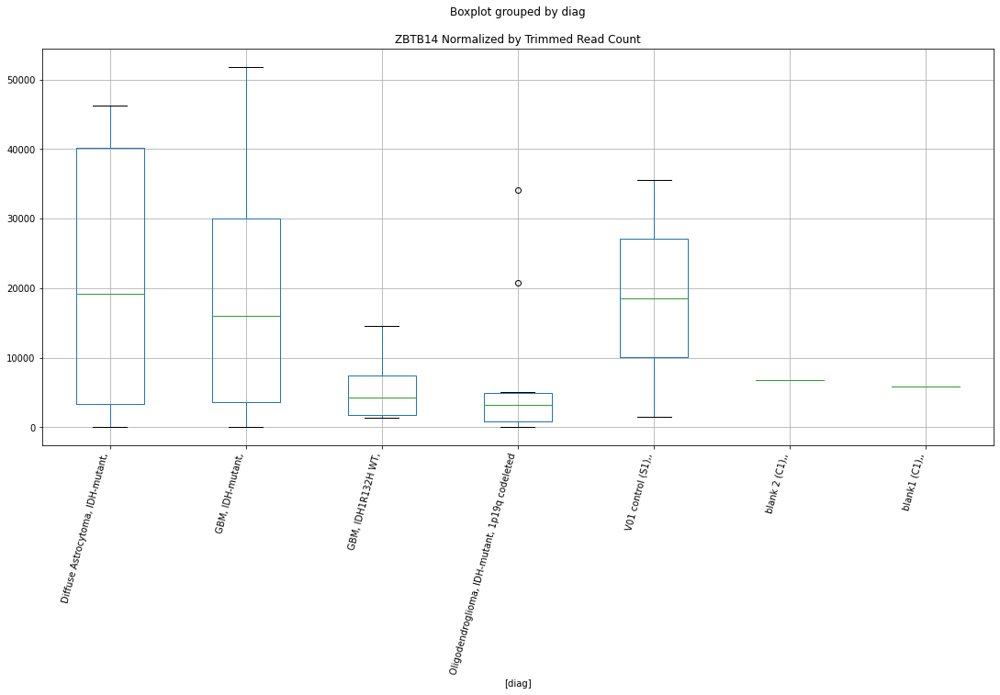

 p : 0.03398742247147645  ( t : 2.294747108863356 ) :  Lexogen  :  bbduk2  :  TFR2
Control and blanks
79         0.00
343    19108.29
Name: TFR2, dtype: float64
211    0.0
Name: TFR2, dtype: float64
475    0.0
Name: TFR2, dtype: float64


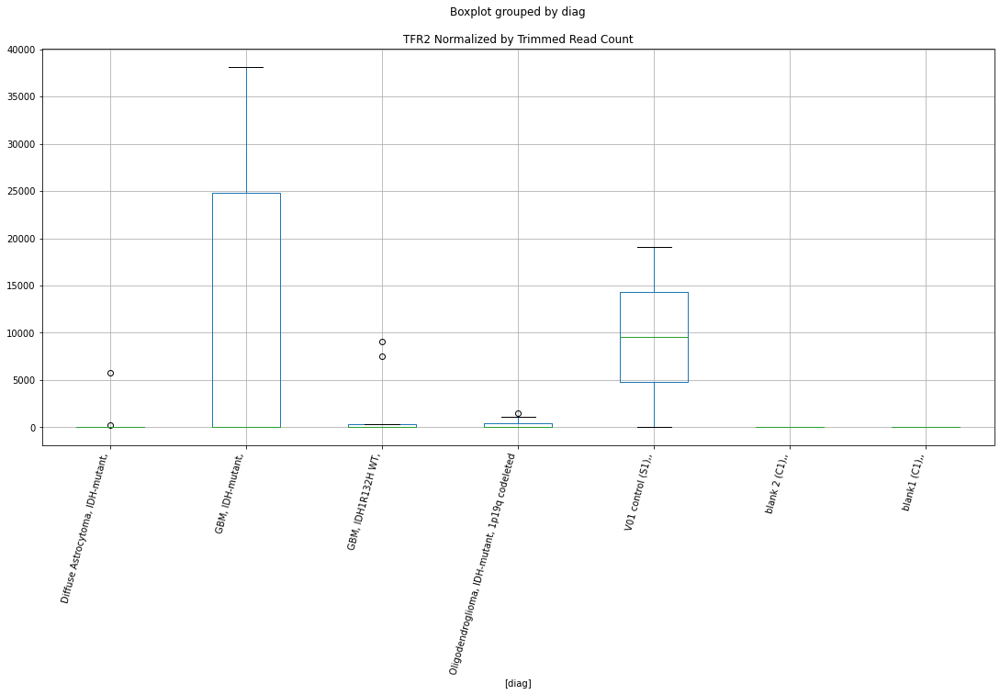

 p : 0.03403257701452712  ( t : 2.294090560846544 ) :  D-plex  :  cutadapt2  :  TCF20
Control and blanks
76     757.61
340      0.00
Name: TCF20, dtype: float64
208    17988.74
Name: TCF20, dtype: float64
472    35255.31
Name: TCF20, dtype: float64


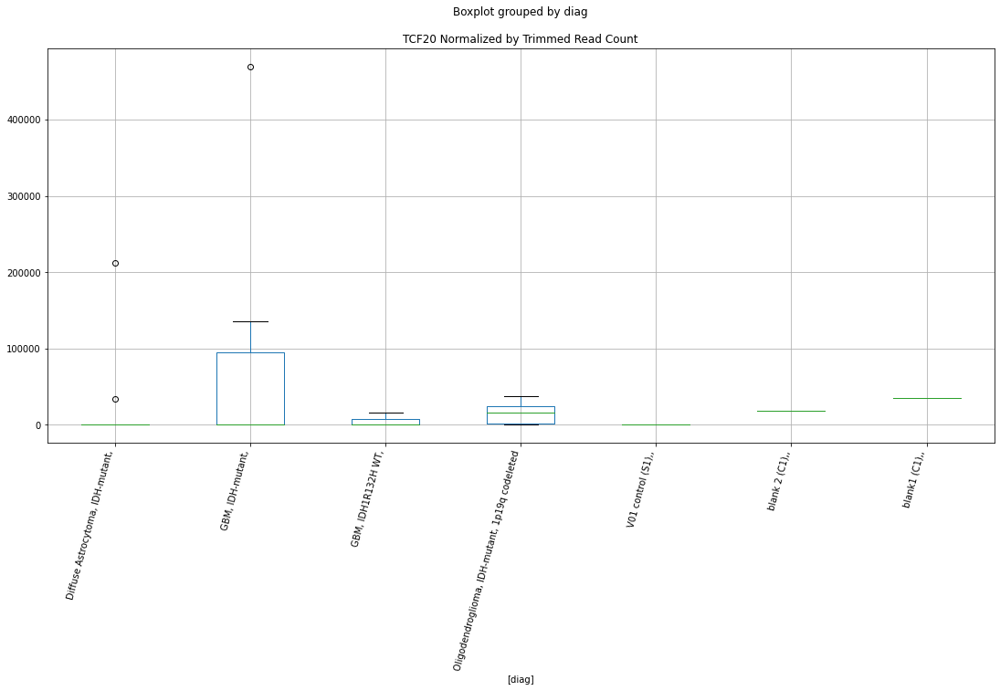

 p : 0.03409963984072964  ( t : 2.2931169540052236 ) :  D-plex  :  cutadapt2  :  ZNF582-AS1
Control and blanks
76     0.0
340    0.0
Name: ZNF582-AS1, dtype: float64
208    176.36
Name: ZNF582-AS1, dtype: float64
472    1155.91
Name: ZNF582-AS1, dtype: float64


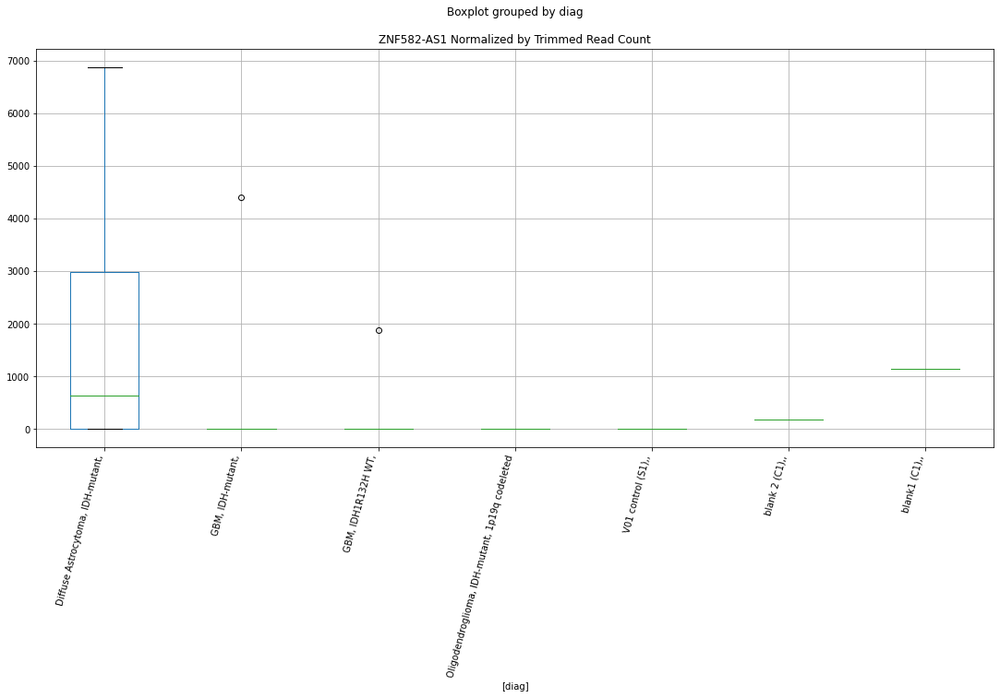

 p : 0.034201499004287476  ( t : 2.2916415680572215 ) :  Lexogen  :  cutadapt2  :  TFR2
Control and blanks
82         0.00
346    18939.11
Name: TFR2, dtype: float64
214    0.0
Name: TFR2, dtype: float64
478    0.0
Name: TFR2, dtype: float64


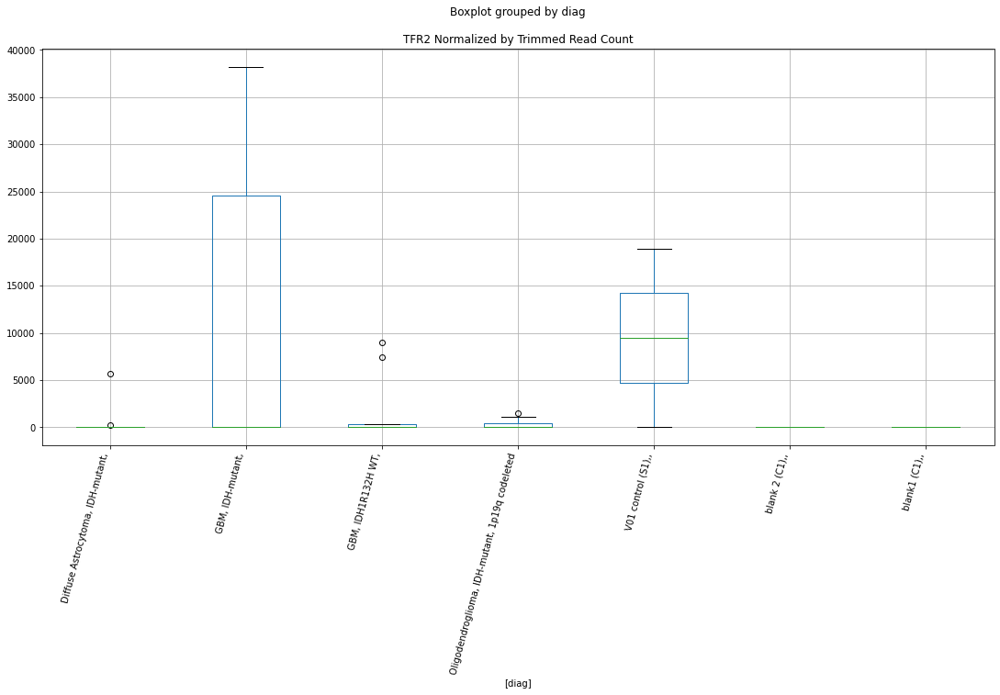

 p : 0.03431305517016463  ( t : 2.290030388258679 ) :  Lexogen  :  bbduk2  :  TPBG
Control and blanks
79     0.0
343    0.0
Name: TPBG, dtype: float64
211    0.0
Name: TPBG, dtype: float64
475    0.0
Name: TPBG, dtype: float64


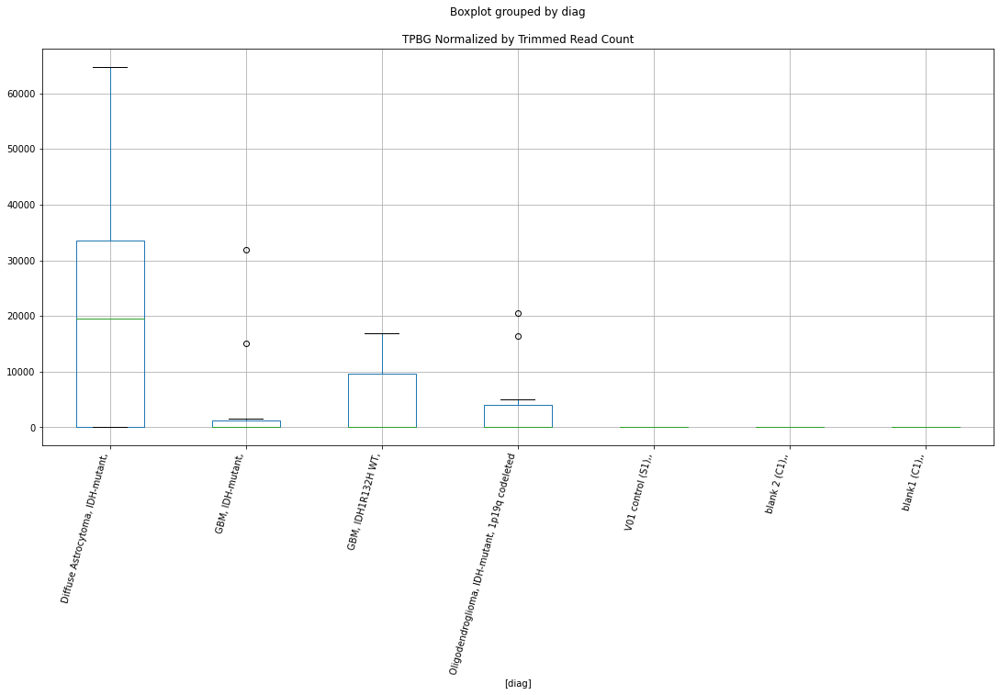

 p : 0.034356310532725746  ( t : 2.289406966230447 ) :  Lexogen  :  cutadapt2  :  TRIM32
Control and blanks
82     0.0
346    0.0
Name: TRIM32, dtype: float64
214    0.0
Name: TRIM32, dtype: float64
478    0.0
Name: TRIM32, dtype: float64


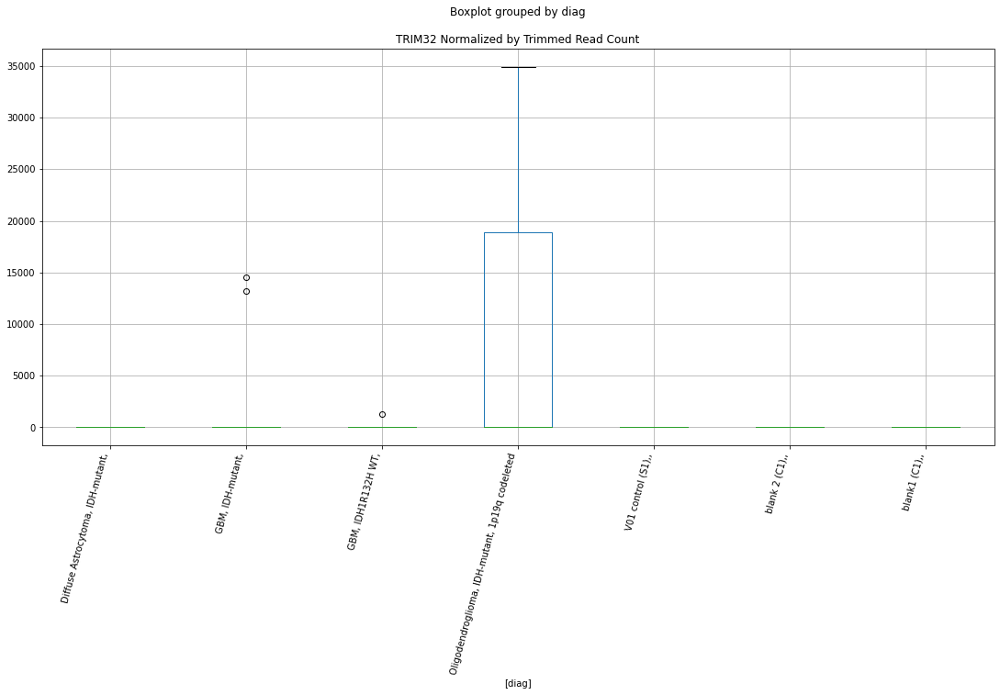

 p : 0.03440634283803723  ( t : 2.2886867769805104 ) :  D-plex  :  bbduk2  :  ZNF800
Control and blanks
73     136822.49
337     11572.04
Name: ZNF800, dtype: float64
205    43340.01
Name: ZNF800, dtype: float64
469    39632.33
Name: ZNF800, dtype: float64


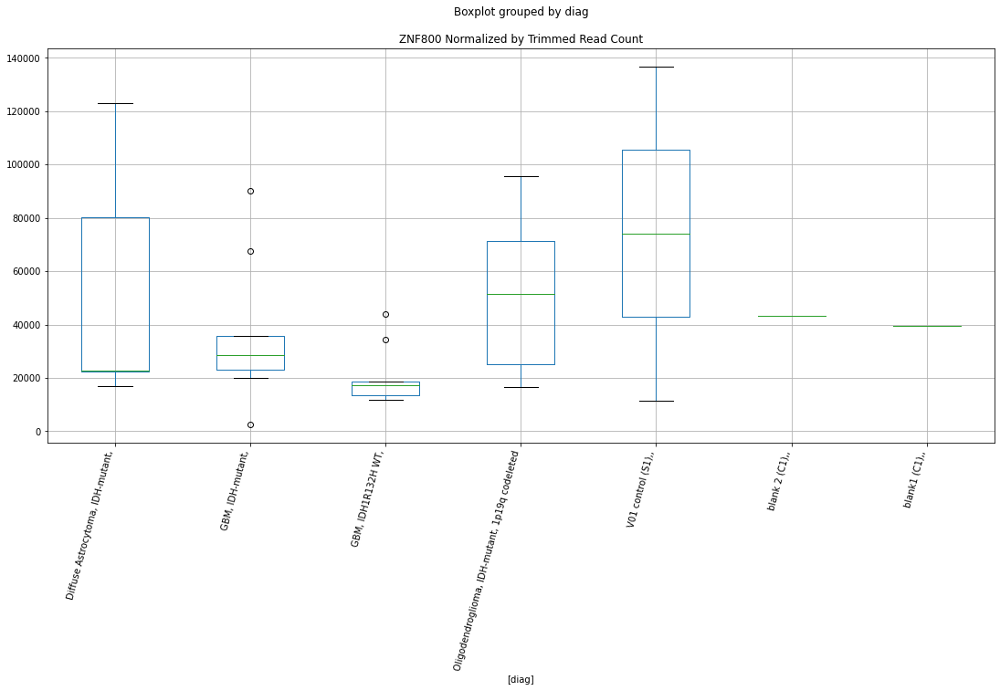

 p : 0.034470793249894716  ( t : 2.2877604746326123 ) :  Lexogen  :  bbduk2  :  SPEG
Control and blanks
79        0.00
343    2760.09
Name: SPEG, dtype: float64
211    0.0
Name: SPEG, dtype: float64
475    0.0
Name: SPEG, dtype: float64


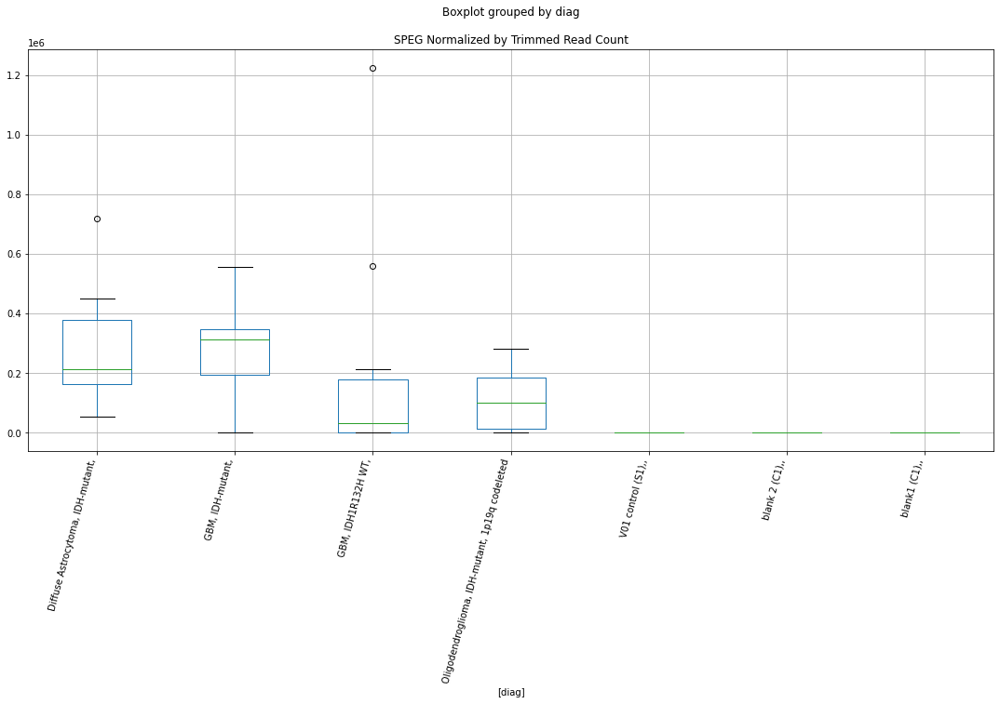

 p : 0.034493669467895706  ( t : 2.287432075810624 ) :  Lexogen  :  bbduk2  :  TRIM32
Control and blanks
79     0.0
343    0.0
Name: TRIM32, dtype: float64
211    0.0
Name: TRIM32, dtype: float64
475    0.0
Name: TRIM32, dtype: float64


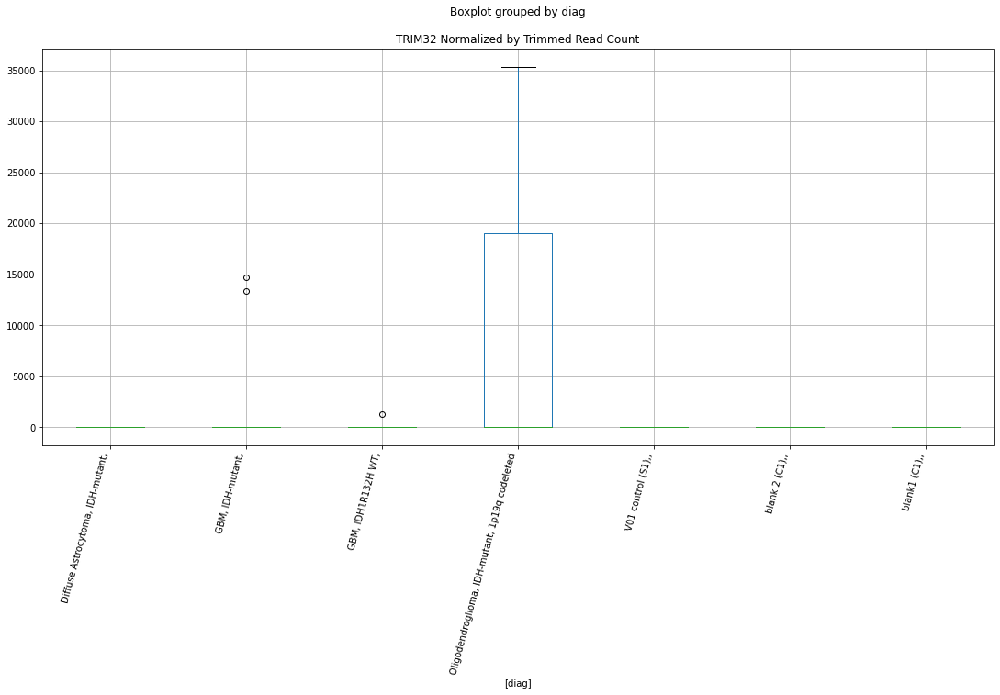

 p : 0.034499299095191935  ( t : 2.2873512907990383 ) :  Lexogen  :  cutadapt2  :  XKR4
Control and blanks
82     0.0
346    0.0
Name: XKR4, dtype: float64
214    0.0
Name: XKR4, dtype: float64
478    0.0
Name: XKR4, dtype: float64


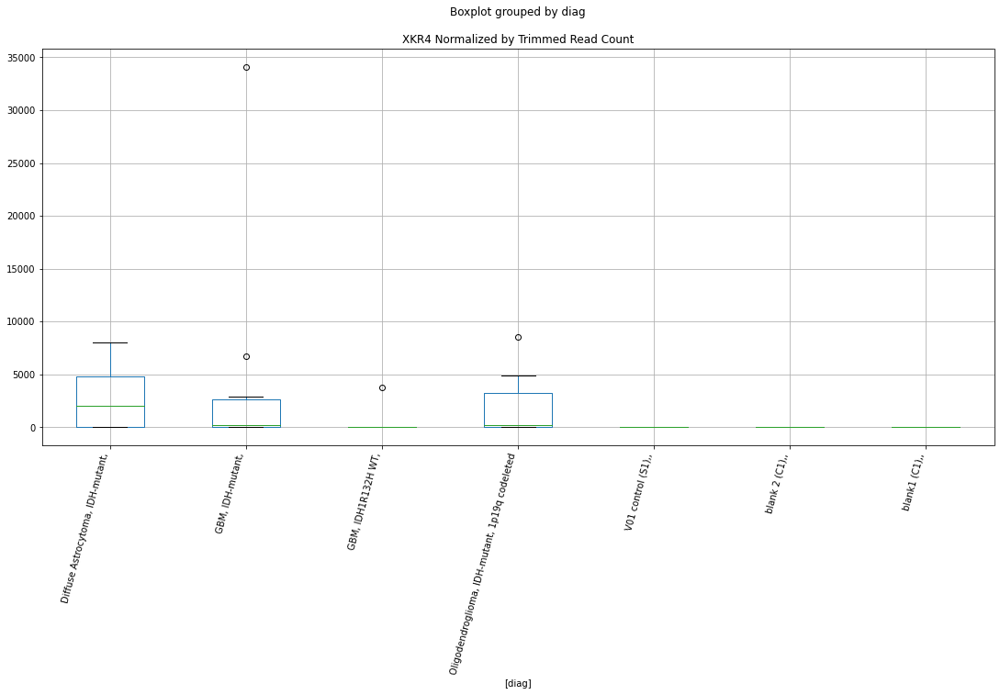

 p : 0.03451903650255807  ( t : 2.2870681558886092 ) :  D-plex  :  bbduk2  :  SYBU
Control and blanks
73     1546.02
337    1780.31
Name: SYBU, dtype: float64
205    895.45
Name: SYBU, dtype: float64
469    12422.07
Name: SYBU, dtype: float64


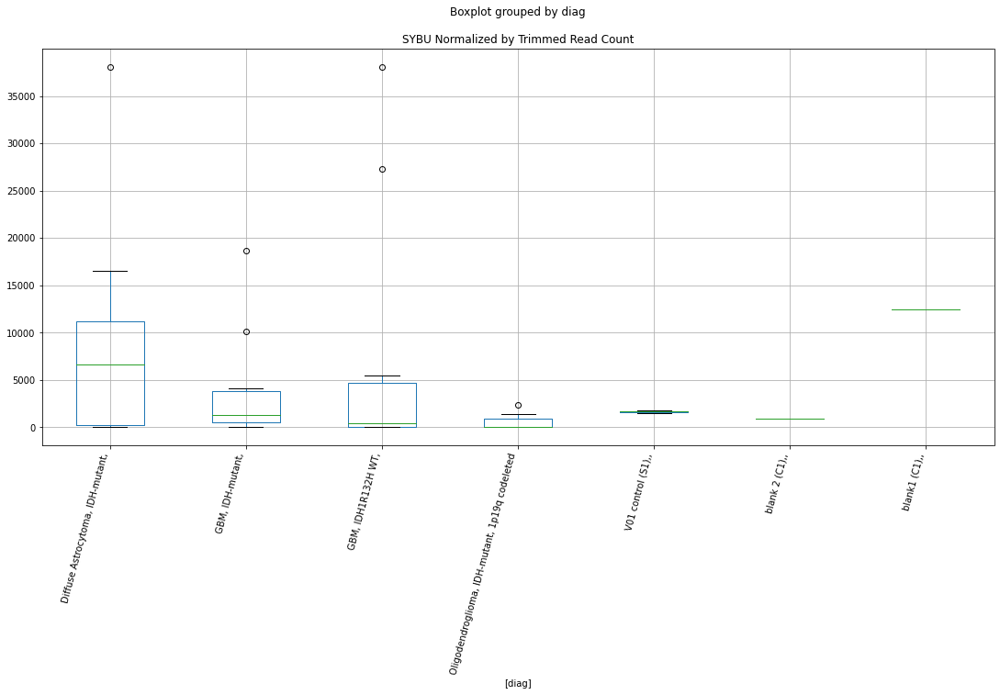

 p : 0.03461498295846821  ( t : 2.2856939272341736 ) :  Lexogen  :  bbduk2  :  TMCO6
Control and blanks
79       0.00
343    424.63
Name: TMCO6, dtype: float64
211    1093.23
Name: TMCO6, dtype: float64
475    718.55
Name: TMCO6, dtype: float64


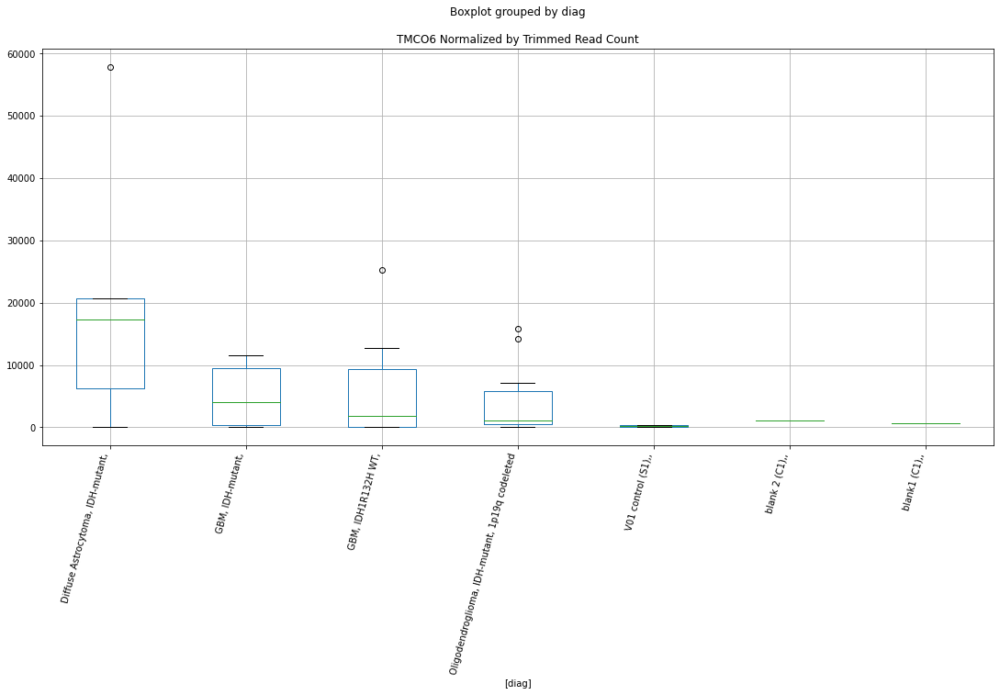

 p : 0.03466210747327589  ( t : 2.285020259966238 ) :  Lexogen  :  cutadapt2  :  SPEG
Control and blanks
82        0.00
346    2735.65
Name: SPEG, dtype: float64
214    0.0
Name: SPEG, dtype: float64
478    0.0
Name: SPEG, dtype: float64


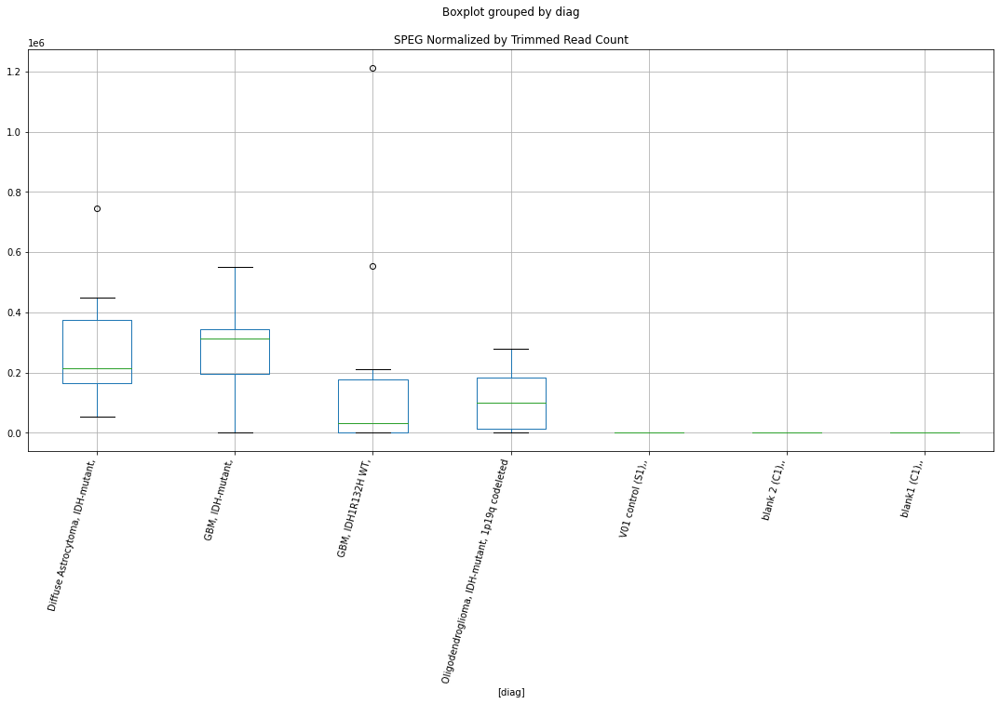

 p : 0.03471740674521036  ( t : 2.284230811185675 ) :  D-plex  :  bbduk2  :  VAX1
Control and blanks
73     773.01
337      0.00
Name: VAX1, dtype: float64
205    1074.55
Name: VAX1, dtype: float64
469    1183.05
Name: VAX1, dtype: float64


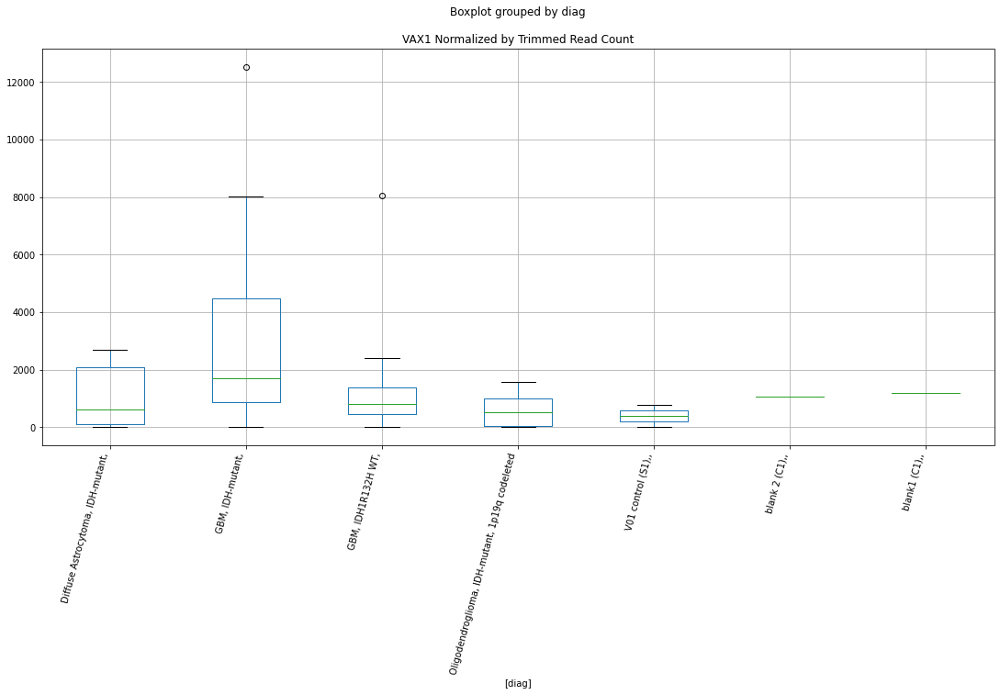

 p : 0.03488782398945028  ( t : 2.281805246172223 ) :  Lexogen  :  cutadapt2  :  TSHR
Control and blanks
82     0.0
346    0.0
Name: TSHR, dtype: float64
214    0.0
Name: TSHR, dtype: float64
478    0.0
Name: TSHR, dtype: float64


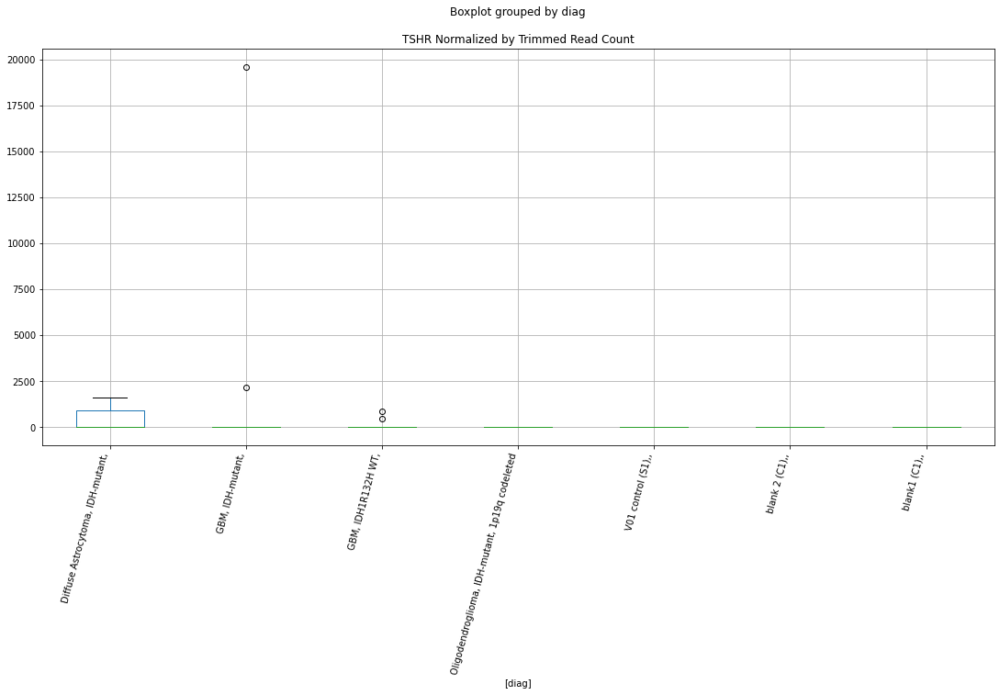

 p : 0.034932063848931286  ( t : 2.281177369143938 ) :  Lexogen  :  bbduk2  :  TSHR
Control and blanks
79     0.0
343    0.0
Name: TSHR, dtype: float64
211    0.0
Name: TSHR, dtype: float64
475    0.0
Name: TSHR, dtype: float64


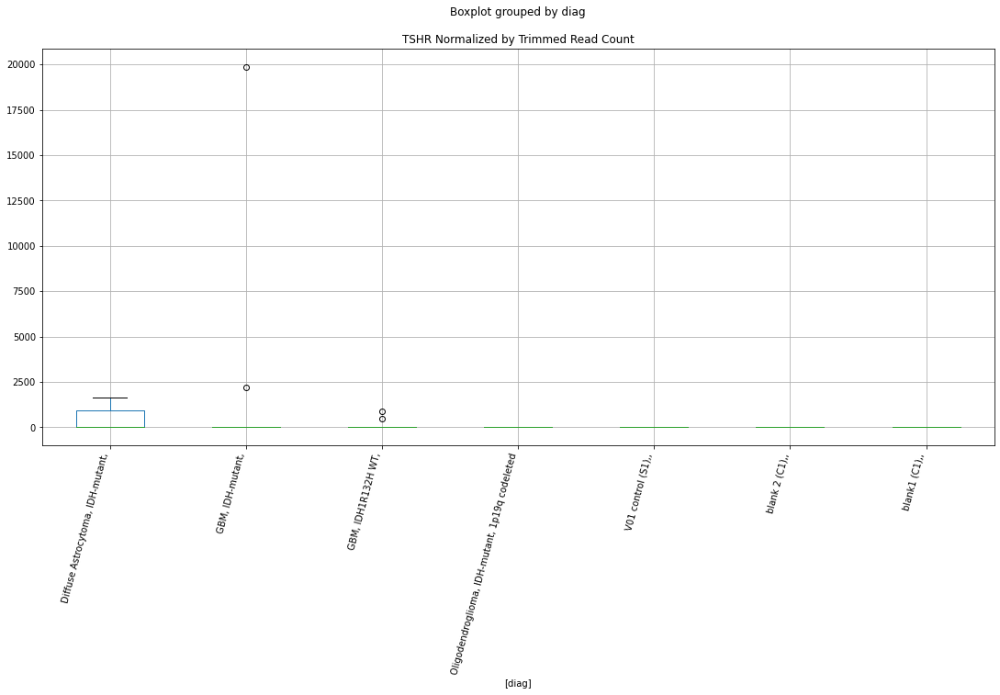

 p : 0.035040504741579596  ( t : 2.279641422210345 ) :  D-plex  :  bbduk2  :  XRCC1
Control and blanks
73      3092.03
337    32045.66
Name: XRCC1, dtype: float64
205    14685.46
Name: XRCC1, dtype: float64
469    14788.18
Name: XRCC1, dtype: float64


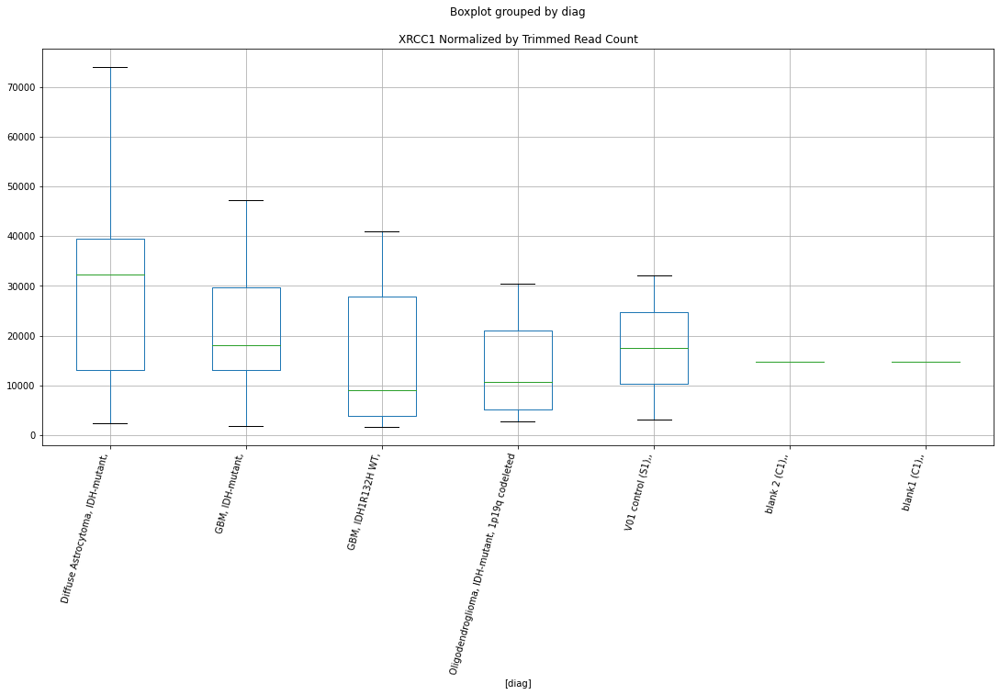

 p : 0.0350567694699441  ( t : 2.279411429539941 ) :  D-plex  :  cutadapt2  :  ZACN
Control and blanks
76         0.0
340    22018.3
Name: ZACN, dtype: float64
208    176.36
Name: ZACN, dtype: float64
472    577.96
Name: ZACN, dtype: float64


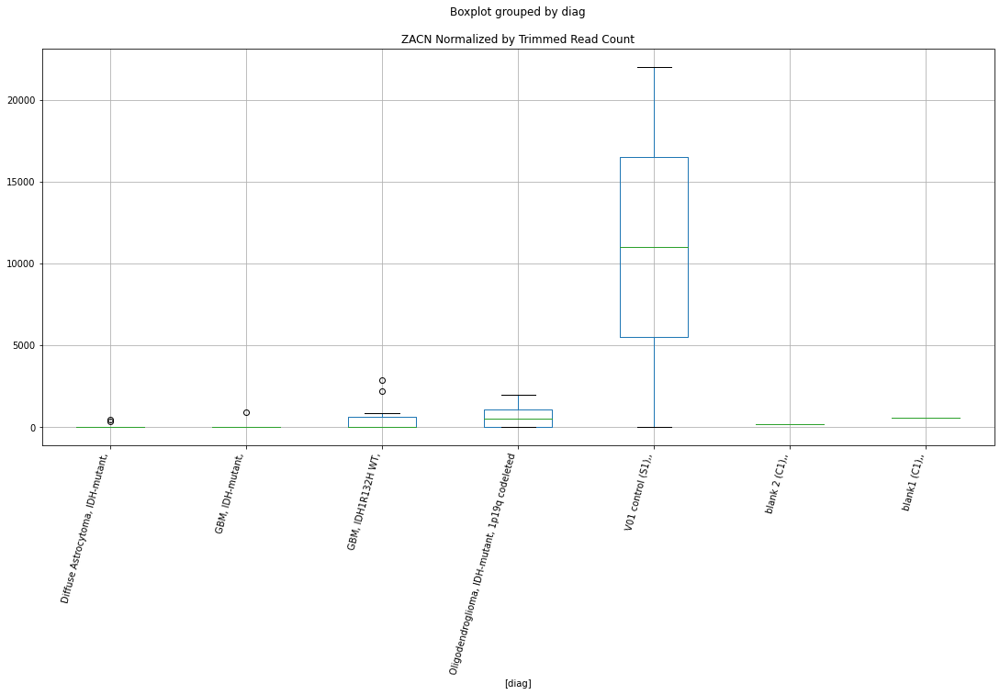

 p : 0.035108844081979576  ( t : 2.2786757279717507 ) :  D-plex  :  bbduk2  :  ZACN
Control and blanks
73         0.00
337    22253.93
Name: ZACN, dtype: float64
205    179.09
Name: ZACN, dtype: float64
469    591.53
Name: ZACN, dtype: float64


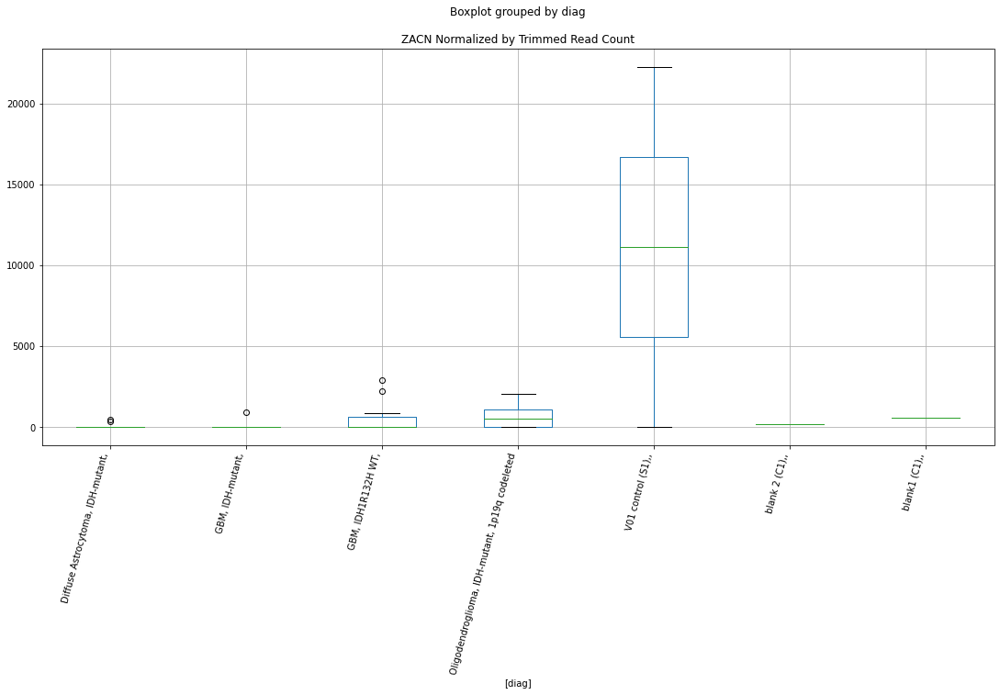

 p : 0.03529778458493031  ( t : 2.276014857958189 ) :  D-plex  :  cutadapt2  :  ZSCAN1
Control and blanks
76     0.0
340    0.0
Name: ZSCAN1, dtype: float64
208    8288.93
Name: ZSCAN1, dtype: float64
472    2311.82
Name: ZSCAN1, dtype: float64


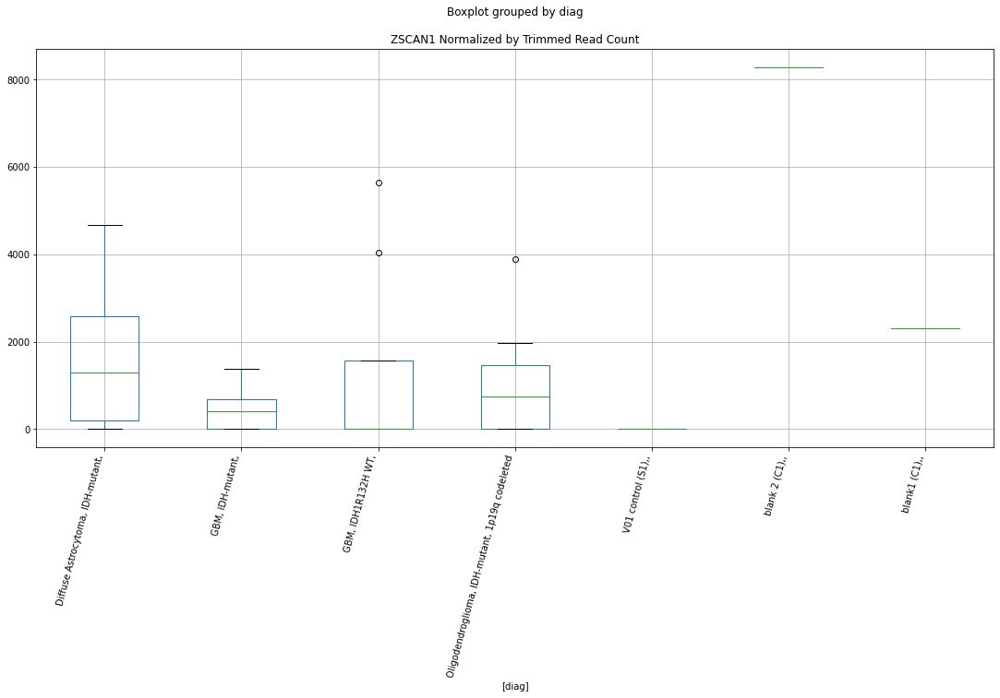

 p : 0.035320462860760404  ( t : 2.2756963634940615 ) :  Lexogen  :  bbduk2  :  THCAT155
Control and blanks
79     15736.59
343    24628.46
Name: THCAT155, dtype: float64
211    8472.5
Name: THCAT155, dtype: float64
475    17005.62
Name: THCAT155, dtype: float64


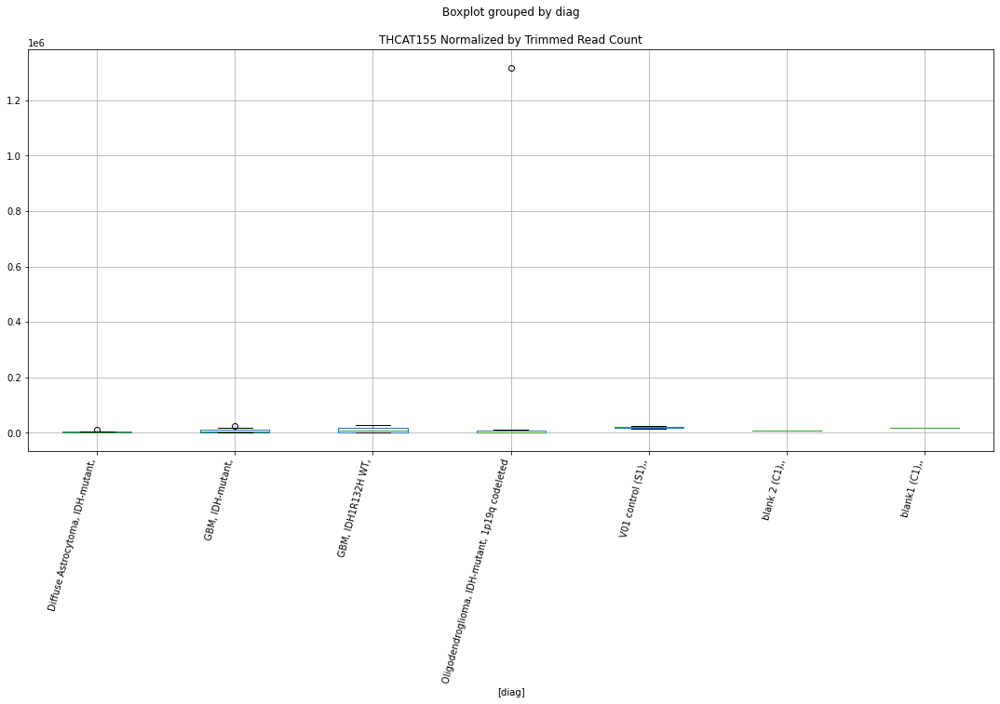

 p : 0.035438867259352906  ( t : 2.274036553951102 ) :  D-plex  :  bbduk2  :  SULT2A1
Control and blanks
73     0.0
337    0.0
Name: SULT2A1, dtype: float64
205    1074.55
Name: SULT2A1, dtype: float64
469    1183.05
Name: SULT2A1, dtype: float64


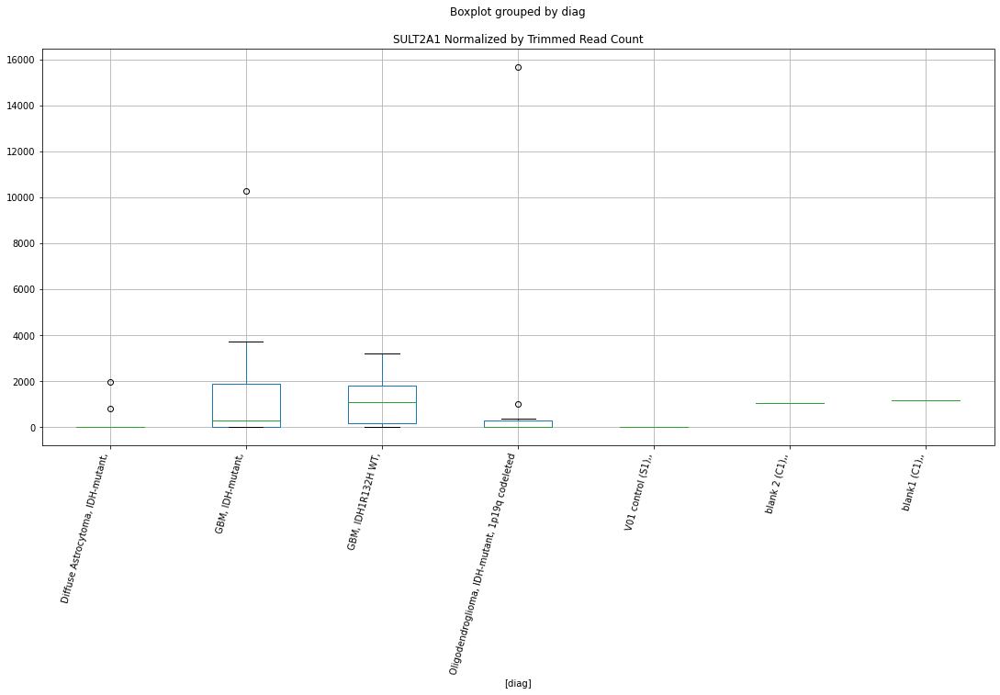

 p : 0.03545693448389243  ( t : 2.2737837362334035 ) :  D-plex  :  cutadapt2  :  TUFT1
Control and blanks
76        0.00
340    5284.39
Name: TUFT1, dtype: float64
208    2645.4
Name: TUFT1, dtype: float64
472    3467.74
Name: TUFT1, dtype: float64


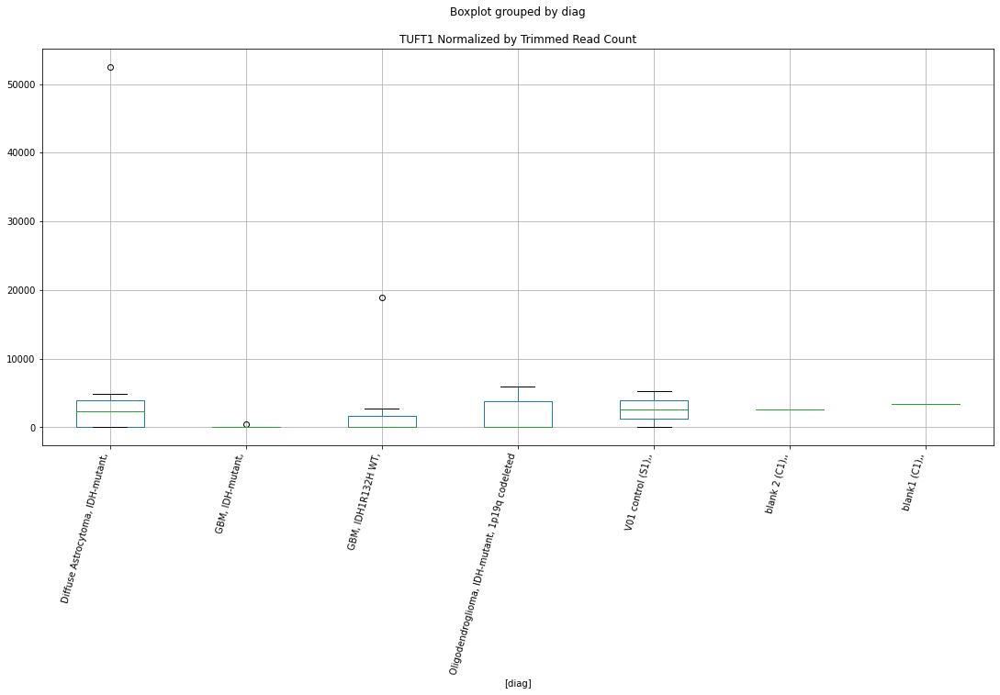

 p : 0.03563981625290728  ( t : 2.271231325886751 ) :  Lexogen  :  cutadapt2  :  ST8SIA5
Control and blanks
82       0.0
346    631.3
Name: ST8SIA5, dtype: float64
214    0.0
Name: ST8SIA5, dtype: float64
478    0.0
Name: ST8SIA5, dtype: float64


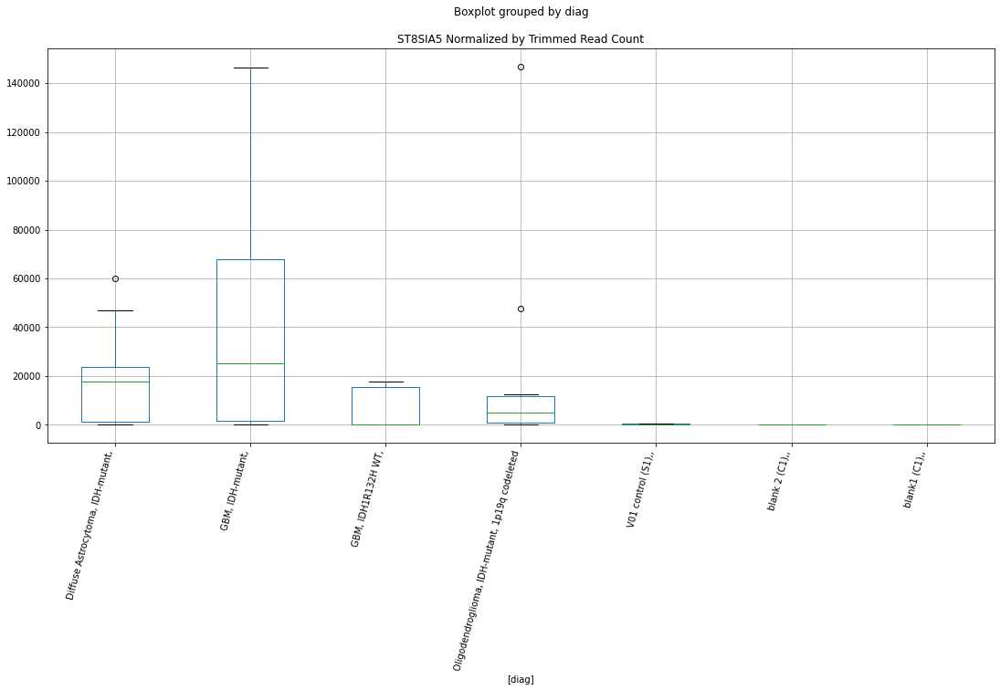

 p : 0.03571907676301113  ( t : 2.270128877577664 ) :  D-plex  :  bbduk2  :  TUFT1
Control and blanks
73     0.0
337    0.0
Name: TUFT1, dtype: float64
205    2686.36
Name: TUFT1, dtype: float64
469    4140.69
Name: TUFT1, dtype: float64


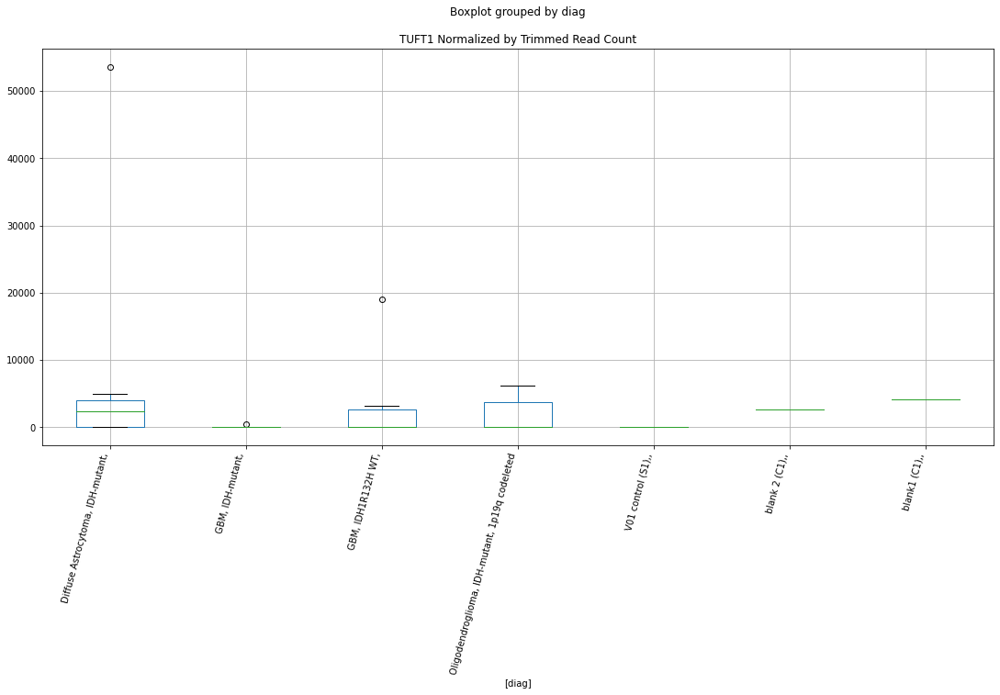

 p : 0.03575903718749122  ( t : 2.269573918403796 ) :  D-plex  :  cutadapt2  :  ZNF879
Control and blanks
76     0.0
340    0.0
Name: ZNF879, dtype: float64
208    1410.88
Name: ZNF879, dtype: float64
472    0.0
Name: ZNF879, dtype: float64


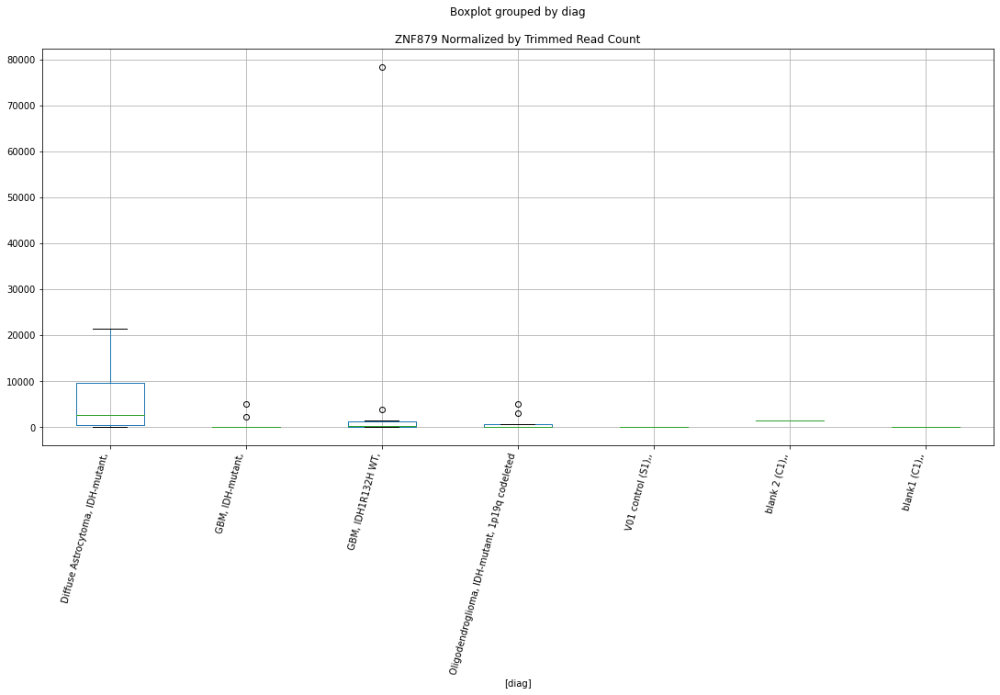

 p : 0.03578230448289652  ( t : 2.2692510527848024 ) :  D-plex  :  cutadapt2  :  TRHDE-AS1
Control and blanks
76     3030.46
340    1761.46
Name: TRHDE-AS1, dtype: float64
208    8112.57
Name: TRHDE-AS1, dtype: float64
472    1155.91
Name: TRHDE-AS1, dtype: float64


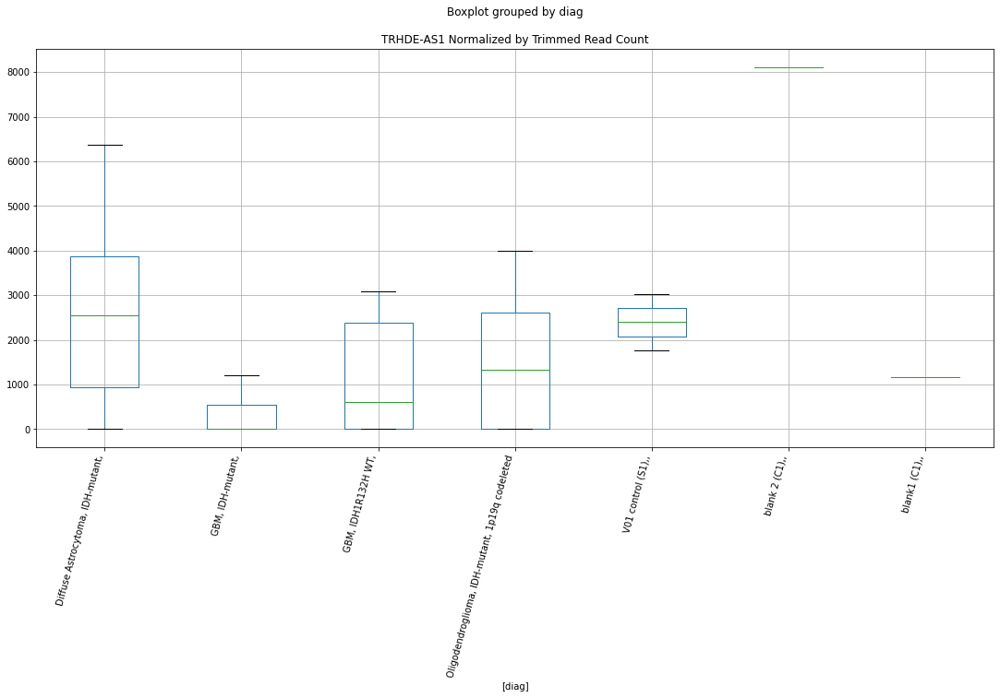

 p : 0.035793877839692255  ( t : 2.2690905288702807 ) :  D-plex  :  bbduk2  :  TNRC6C
Control and blanks
73     279056.03
337         0.00
Name: TNRC6C, dtype: float64
205    27400.92
Name: TNRC6C, dtype: float64
469    46139.13
Name: TNRC6C, dtype: float64


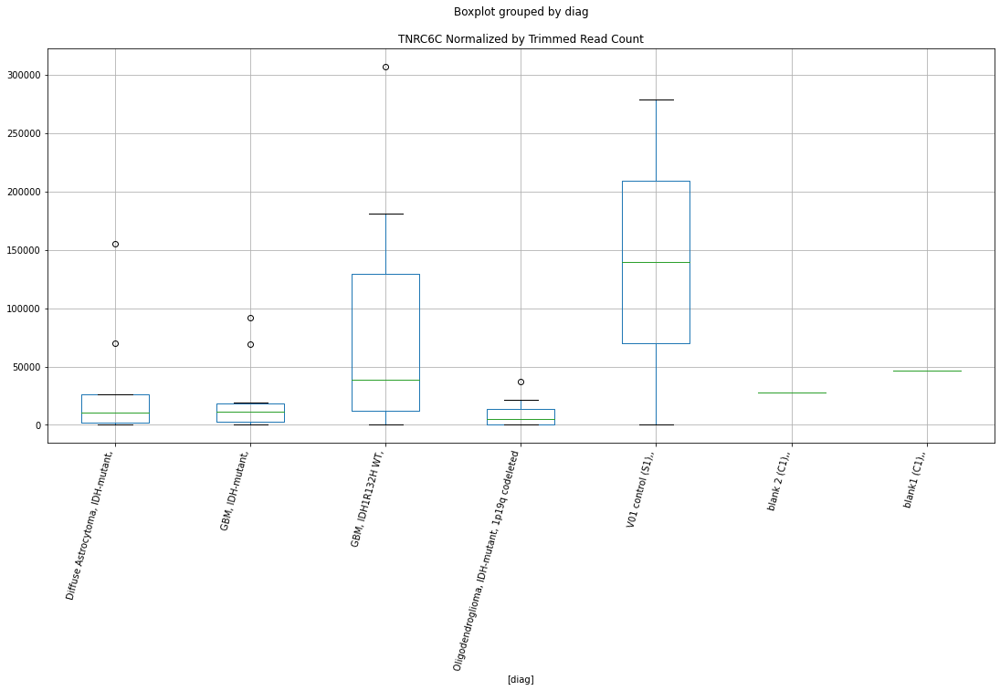

 p : 0.03581302660106375  ( t : 2.268825038485449 ) :  Lexogen  :  cutadapt2  :  THCAT155
Control and blanks
82     15620.56
346    24410.40
Name: THCAT155, dtype: float64
214    8408.02
Name: THCAT155, dtype: float64
478    16859.69
Name: THCAT155, dtype: float64


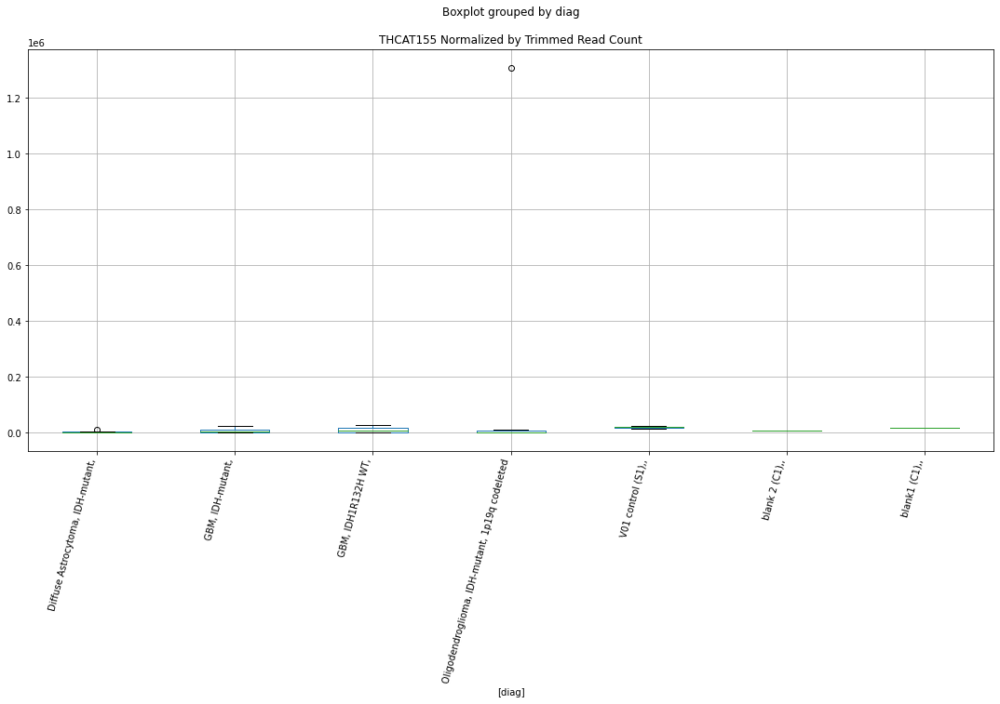

 p : 0.03581755376872615  ( t : 2.268762290187034 ) :  D-plex  :  bbduk2  :  TOP3B
Control and blanks
73     0.0
337    0.0
Name: TOP3B, dtype: float64
205    4119.09
Name: TOP3B, dtype: float64
469    5915.27
Name: TOP3B, dtype: float64


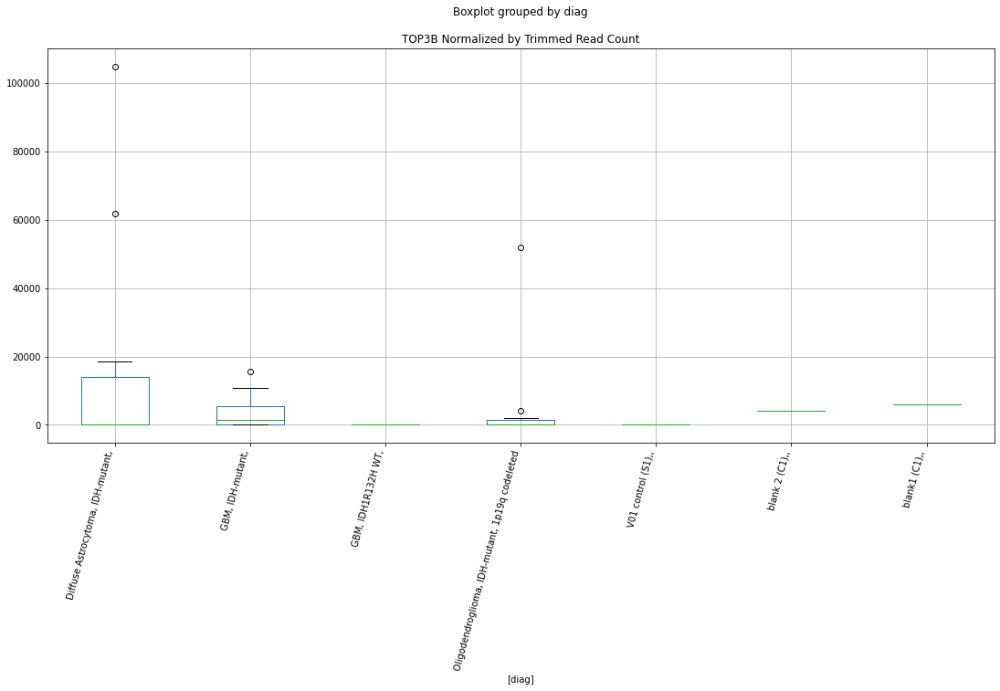

 p : 0.03582374201760517  ( t : 2.2686765305189325 ) :  Lexogen  :  cutadapt2  :  ZNF213
Control and blanks
82         0.00
346    30302.57
Name: ZNF213, dtype: float64
214    17358.49
Name: ZNF213, dtype: float64
478    86435.62
Name: ZNF213, dtype: float64


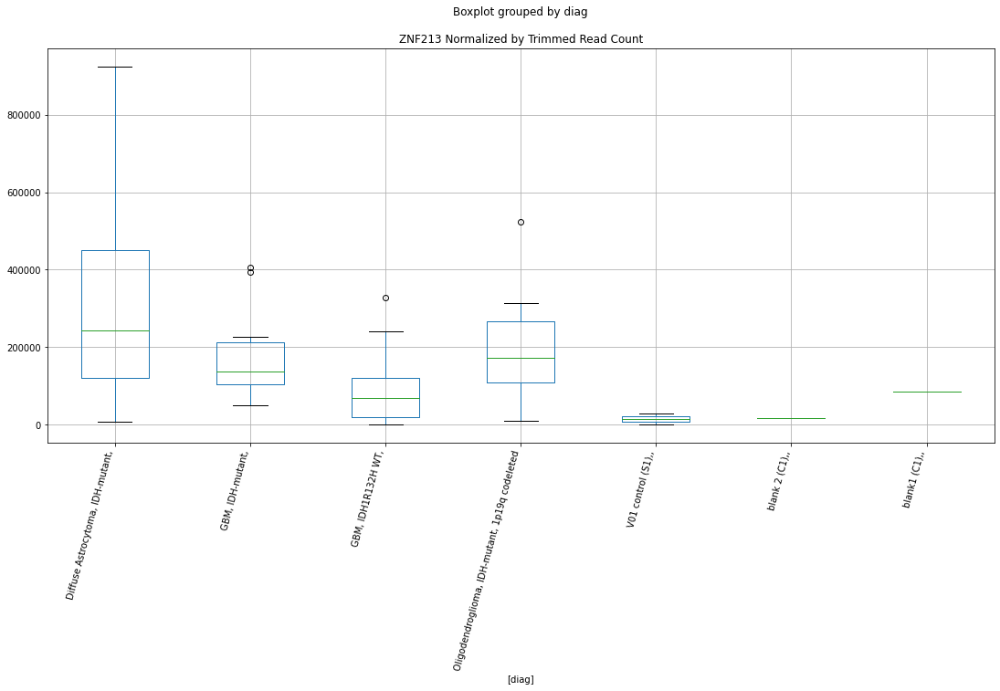

 p : 0.035843588991950635  ( t : 2.2684015741649137 ) :  D-plex  :  cutadapt2  :  SULT2A1
Control and blanks
76     0.0
340    0.0
Name: SULT2A1, dtype: float64
208    1058.16
Name: SULT2A1, dtype: float64
472    1155.91
Name: SULT2A1, dtype: float64


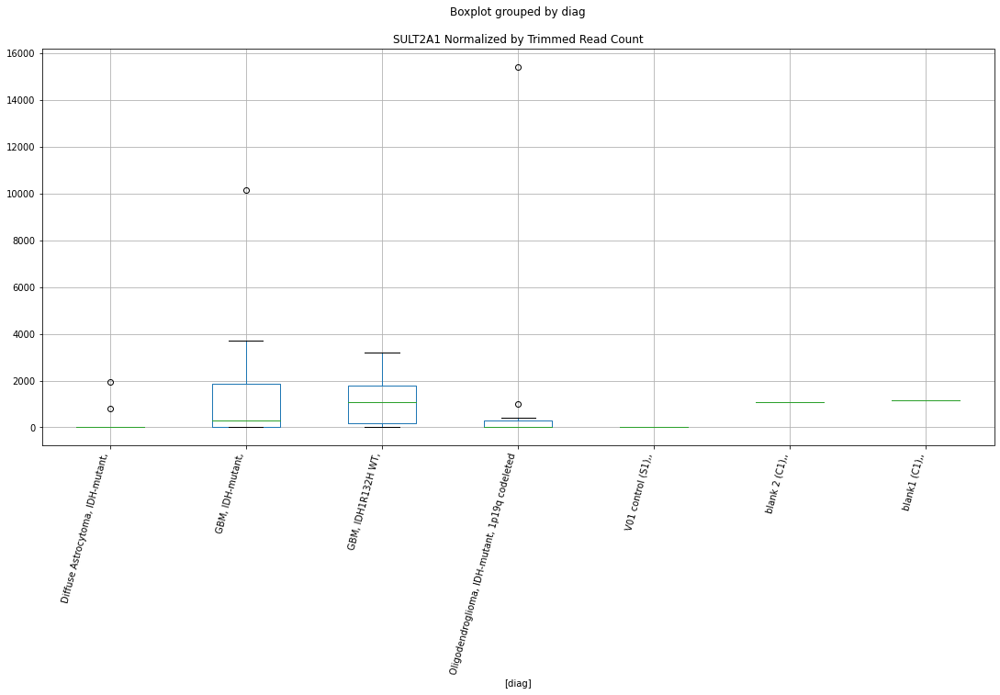

 p : 0.035907283588449926  ( t : 2.267520110484891 ) :  D-plex  :  bbduk2  :  TOX2
Control and blanks
73     0.0
337    0.0
Name: TOX2, dtype: float64
205    179.09
Name: TOX2, dtype: float64
469    0.0
Name: TOX2, dtype: float64


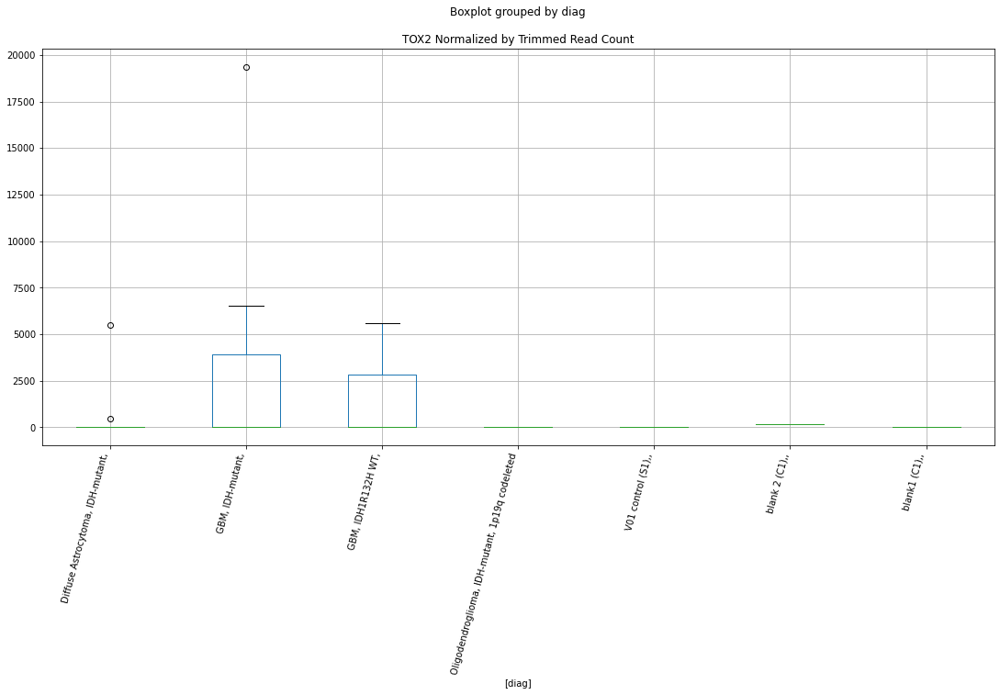

 p : 0.03598044703336253  ( t : 2.266509390090535 ) :  D-plex  :  cutadapt2  :  ZBTB14
Control and blanks
76      1515.23
340    26421.96
Name: ZBTB14, dtype: float64
208    6701.69
Name: ZBTB14, dtype: float64
472    12137.07
Name: ZBTB14, dtype: float64


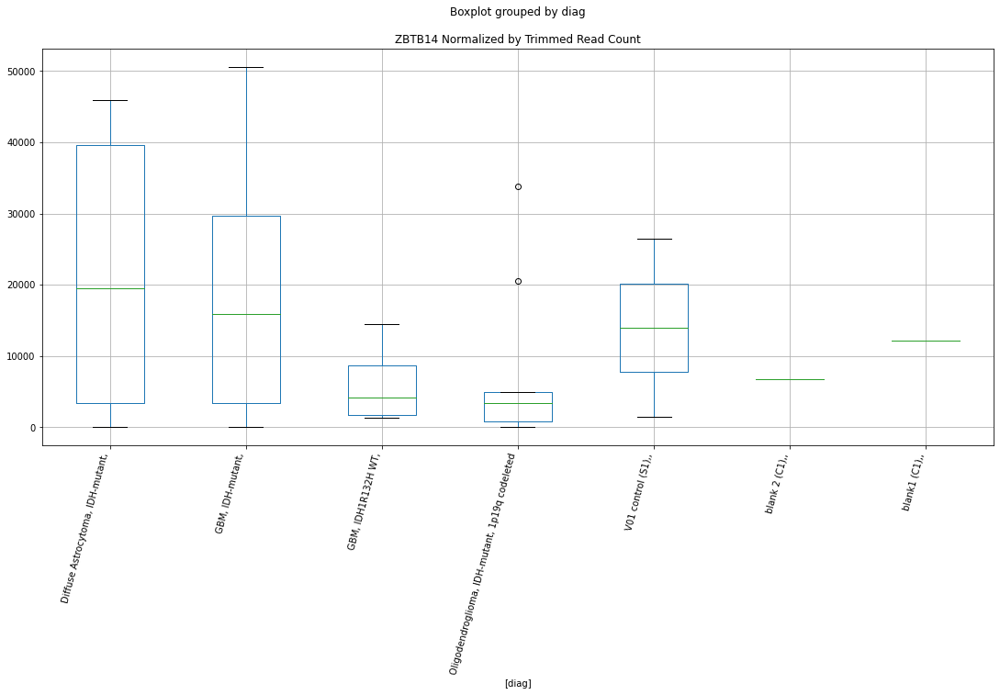

 p : 0.036046207418847  ( t : 2.2656025593477893 ) :  Lexogen  :  cutadapt2  :  ZNF165
Control and blanks
82     0.0
346    0.0
Name: ZNF165, dtype: float64
214    0.0
Name: ZNF165, dtype: float64
478    0.0
Name: ZNF165, dtype: float64


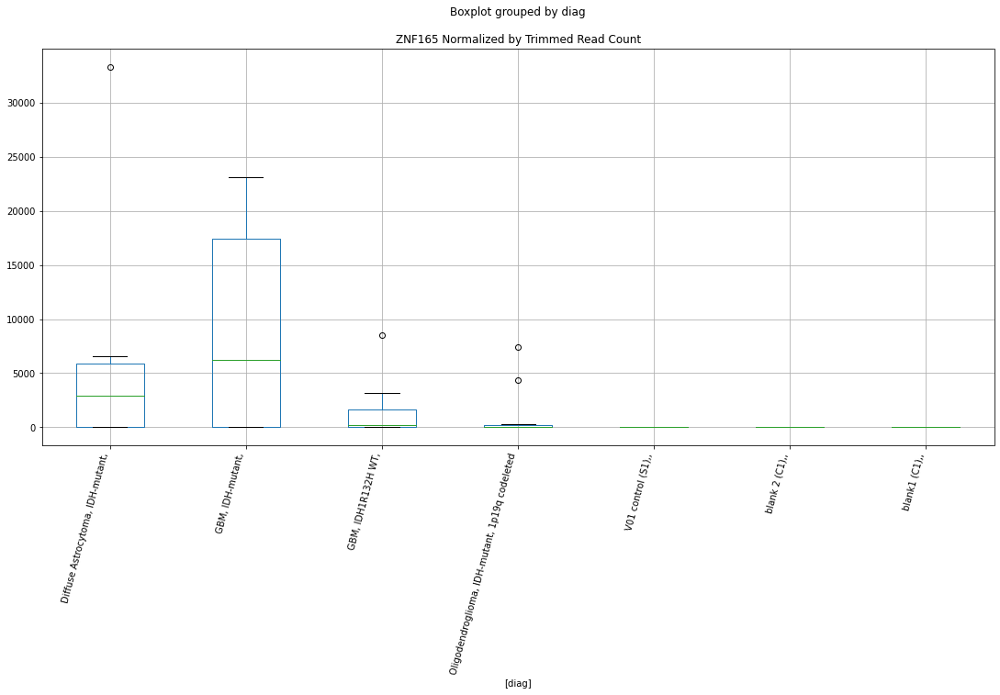

 p : 0.03612206130036639  ( t : 2.2645584370826133 ) :  D-plex  :  bbduk2  :  UPK1B
Control and blanks
73     0.0
337    0.0
Name: UPK1B, dtype: float64
205    0.0
Name: UPK1B, dtype: float64
469    0.0
Name: UPK1B, dtype: float64


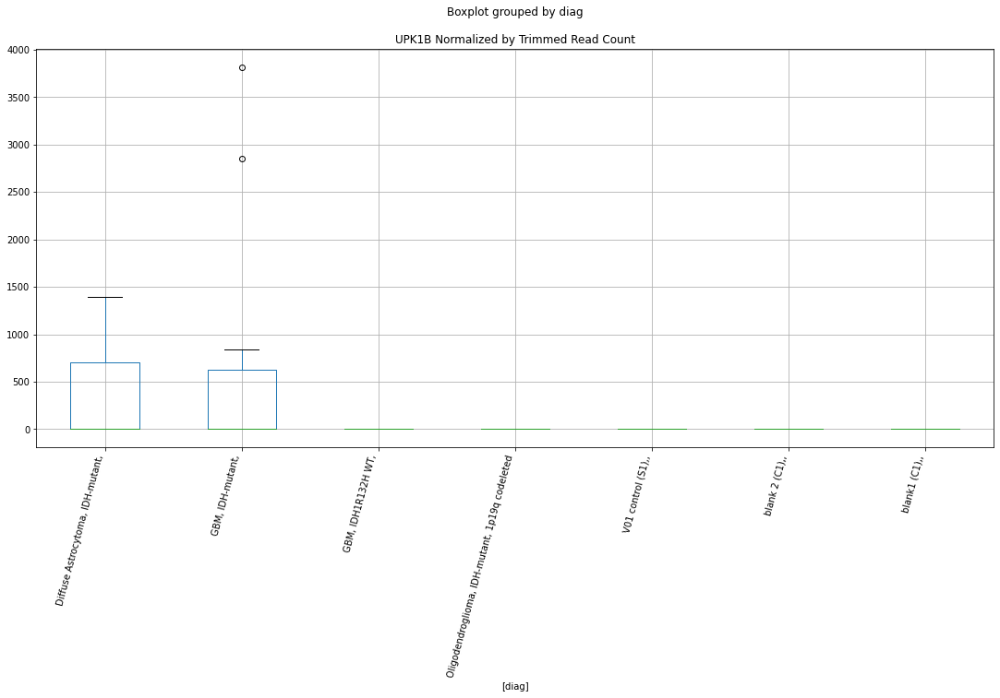

 p : 0.03616078128465341  ( t : 2.2640262406505327 ) :  D-plex  :  cutadapt2  :  STK32C
Control and blanks
76     0.0
340    0.0
Name: STK32C, dtype: float64
208    15343.34
Name: STK32C, dtype: float64
472    8091.38
Name: STK32C, dtype: float64


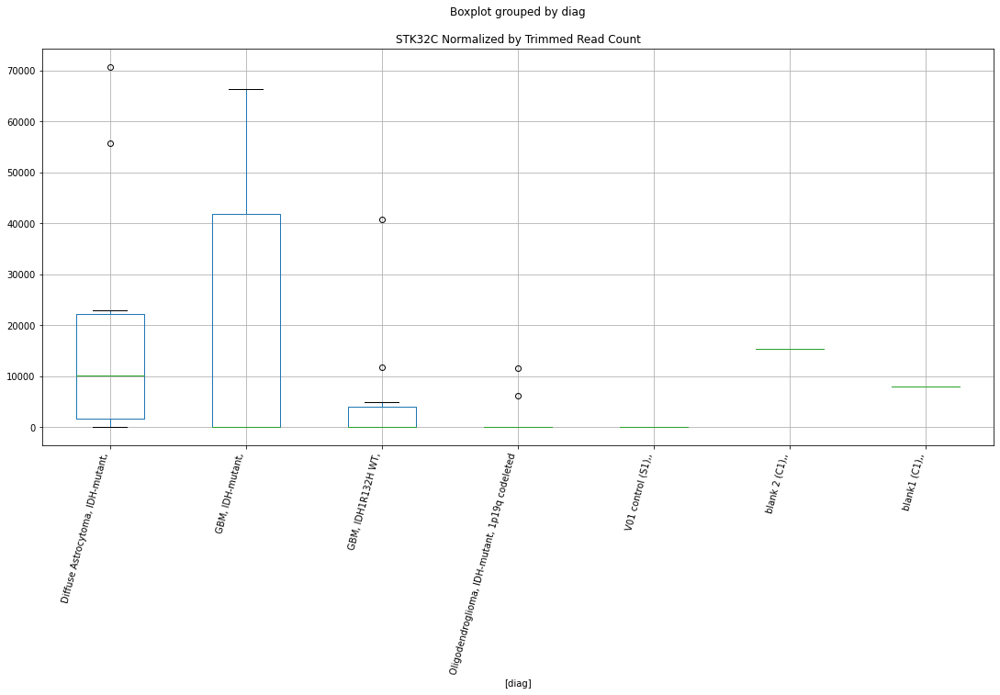

 p : 0.036161781436651726  ( t : 2.264012500791134 ) :  D-plex  :  cutadapt2  :  ZBTB7B
Control and blanks
76     0.0
340    0.0
Name: ZBTB7B, dtype: float64
208    2645.4
Name: ZBTB7B, dtype: float64
472    8669.34
Name: ZBTB7B, dtype: float64


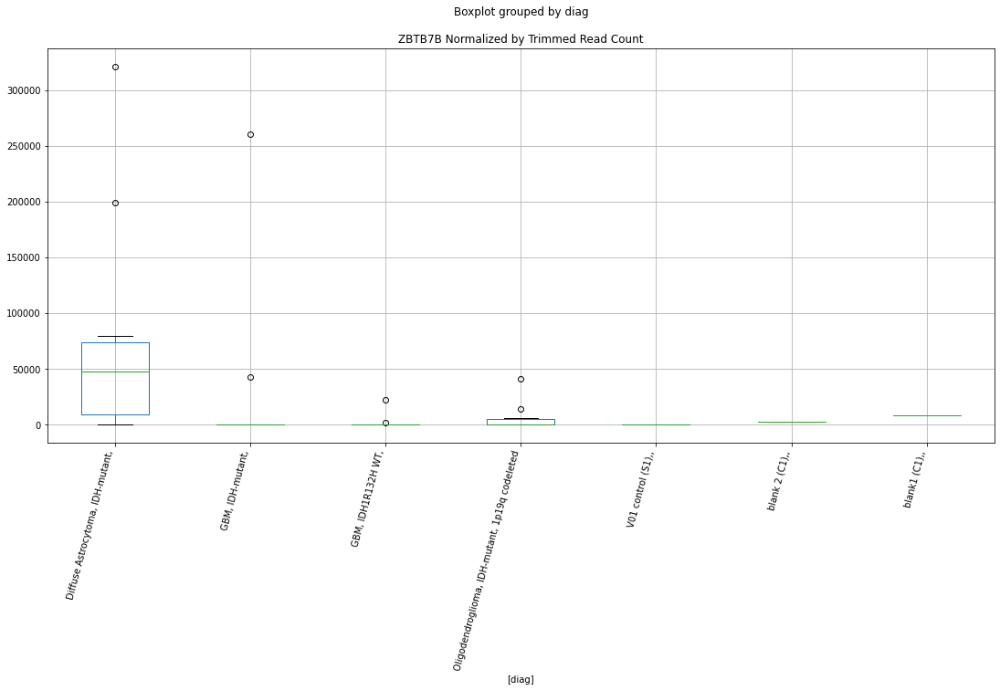

 p : 0.03628790109336271  ( t : 2.262282705414907 ) :  D-plex  :  cutadapt2  :  ZNF556
Control and blanks
76        0.00
340    5284.39
Name: ZNF556, dtype: float64
208    705.44
Name: ZNF556, dtype: float64
472    0.0
Name: ZNF556, dtype: float64


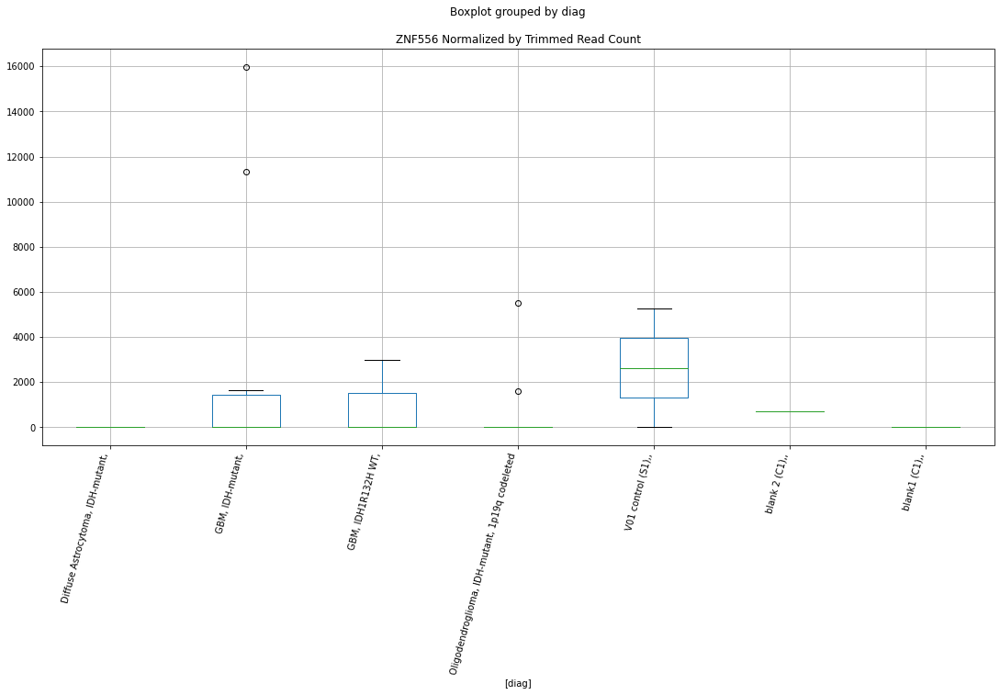

 p : 0.03631157512034688  ( t : 2.2619586233966715 ) :  Lexogen  :  cutadapt2  :  ZNF641
Control and blanks
82       0.00
346    841.74
Name: ZNF641, dtype: float64
214    0.0
Name: ZNF641, dtype: float64
478    0.0
Name: ZNF641, dtype: float64


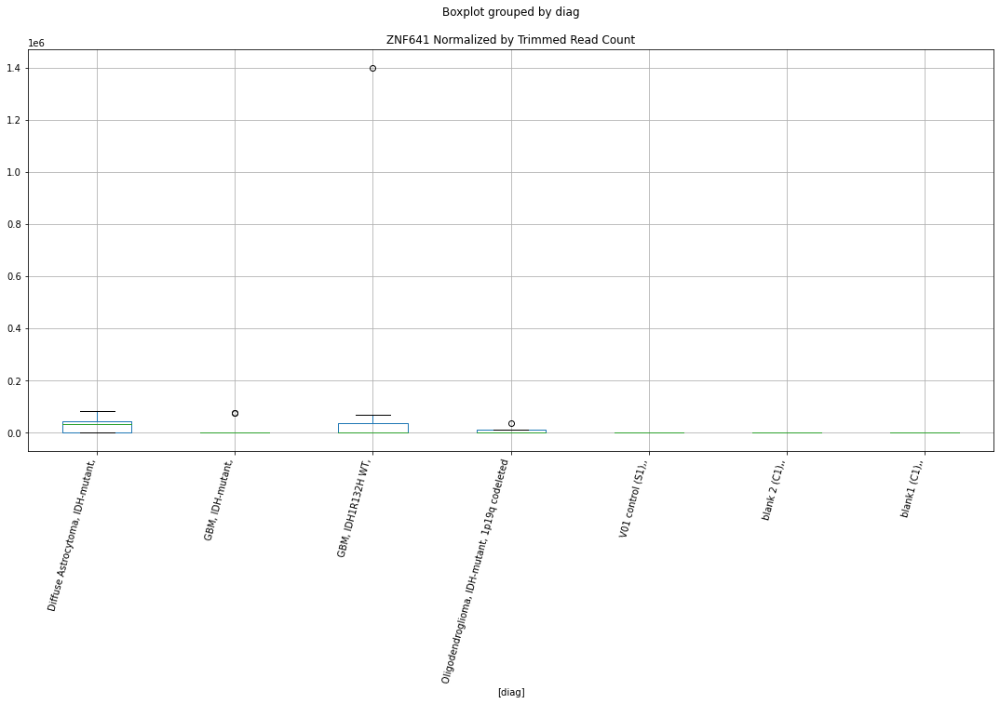

 p : 0.036317124240586134  ( t : 2.2618826877942144 ) :  Lexogen  :  bbduk2  :  ST8SIA5
Control and blanks
79       0.00
343    636.94
Name: ST8SIA5, dtype: float64
211    0.0
Name: ST8SIA5, dtype: float64
475    0.0
Name: ST8SIA5, dtype: float64


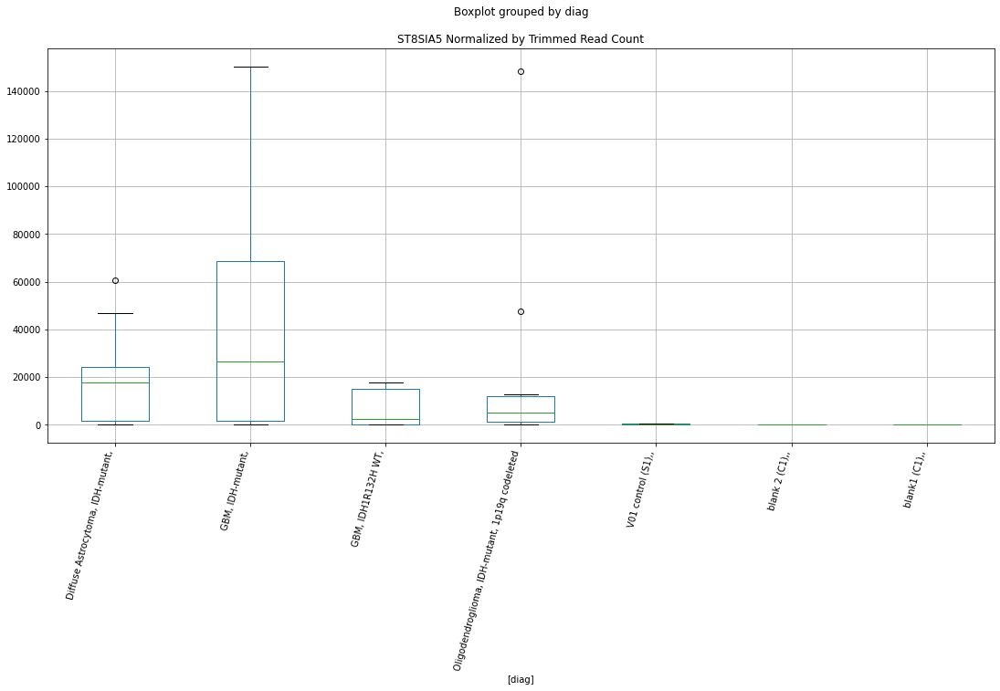

 p : 0.03642785686139353  ( t : 2.2603696306289853 ) :  D-plex  :  cutadapt2  :  UPK1B
Control and blanks
76     0.0
340    0.0
Name: UPK1B, dtype: float64
208    0.0
Name: UPK1B, dtype: float64
472    0.0
Name: UPK1B, dtype: float64


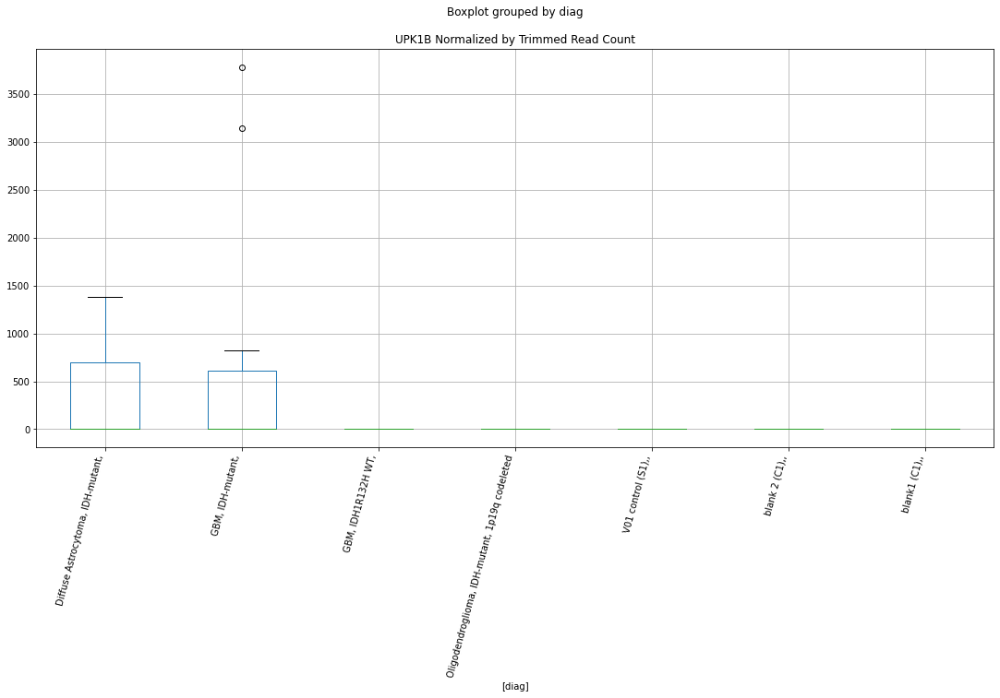

 p : 0.03644073238849898  ( t : 2.260193974480827 ) :  D-plex  :  bbduk2  :  TRAPPC5
Control and blanks
73     0.0
337    0.0
Name: TRAPPC5, dtype: float64
205    1074.55
Name: TRAPPC5, dtype: float64
469    3549.16
Name: TRAPPC5, dtype: float64


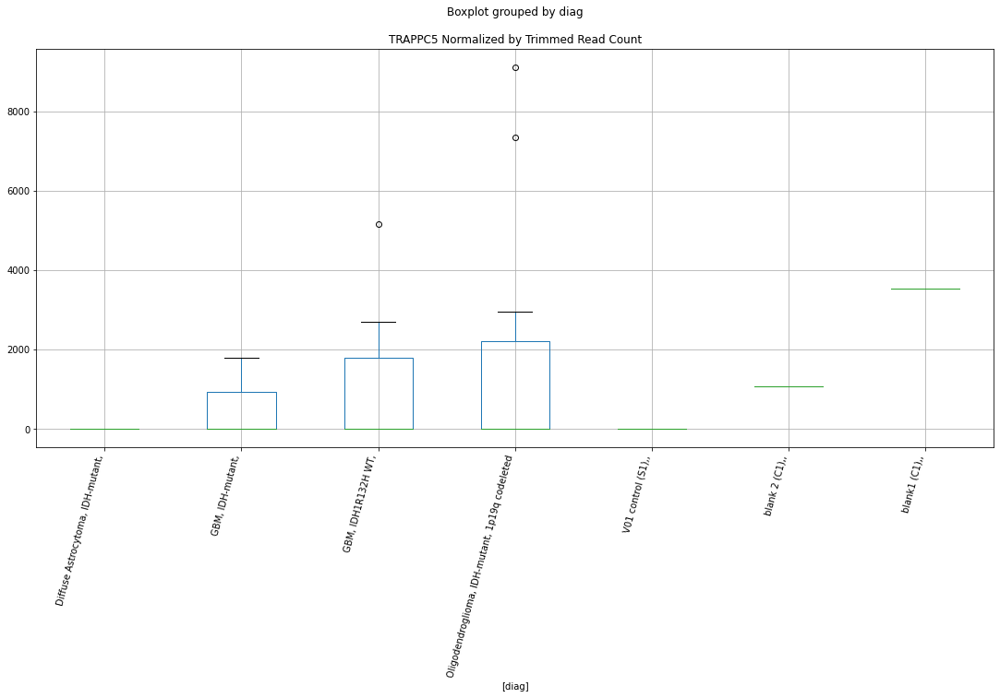

 p : 0.03651507757999408  ( t : 2.2591808297990887 ) :  D-plex  :  bbduk2  :  STK10
Control and blanks
73     63386.69
337    46288.18
Name: STK10, dtype: float64
205    3581.82
Name: STK10, dtype: float64
469    3549.16
Name: STK10, dtype: float64


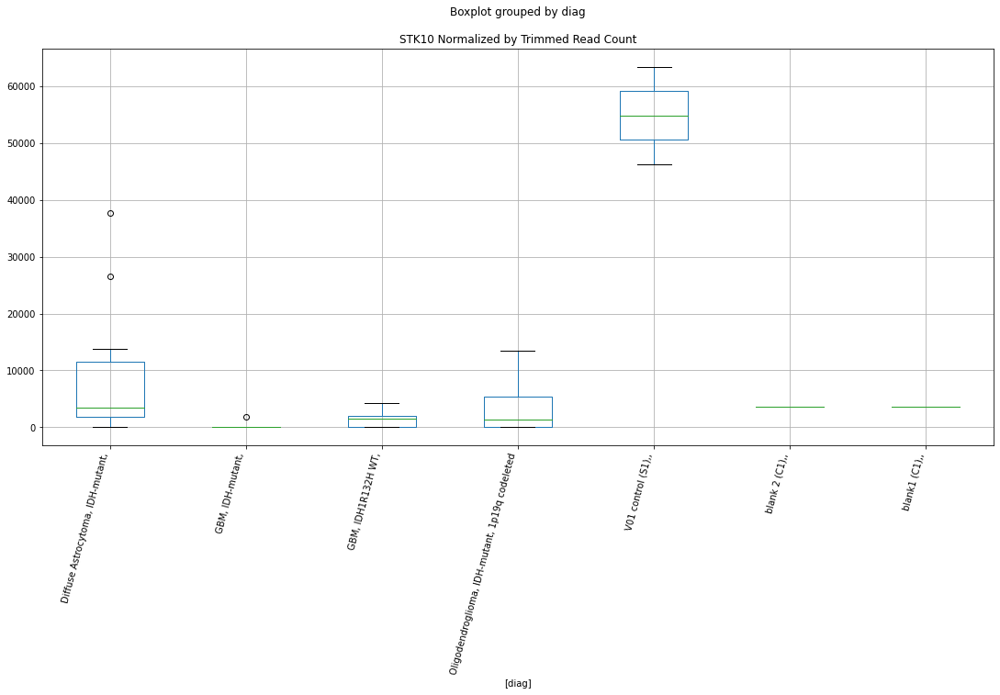

 p : 0.036603041999472015  ( t : 2.2579845459131658 ) :  Lexogen  :  bbduk2  :  ZNF213
Control and blanks
79         0.00
343    30573.26
Name: ZNF213, dtype: float64
211    17491.61
Name: ZNF213, dtype: float64
475    86225.67
Name: ZNF213, dtype: float64


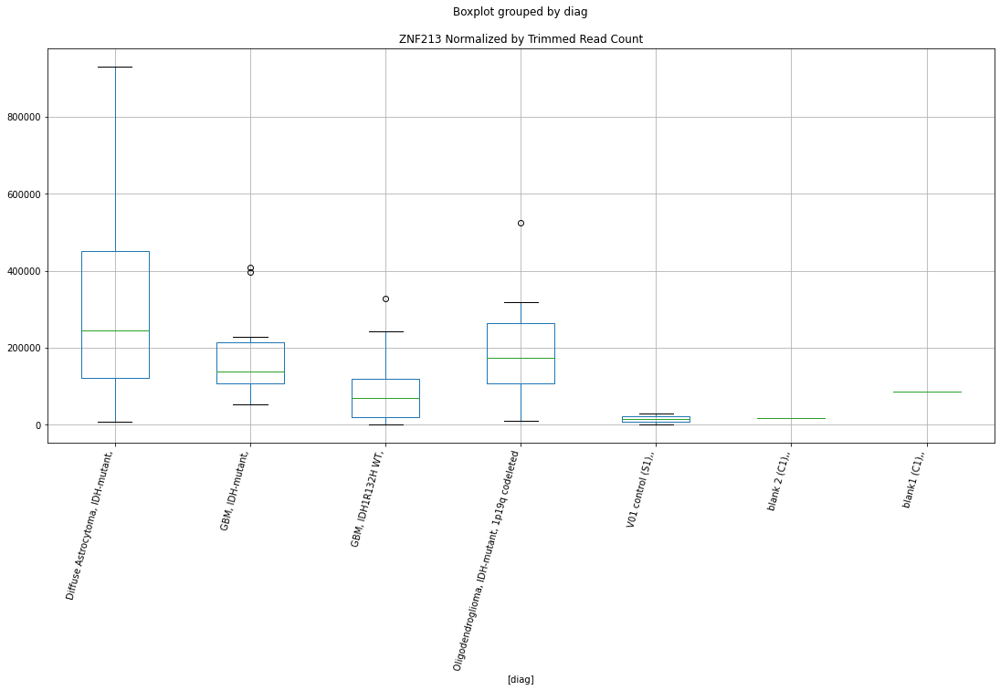

 p : 0.03665515135087481  ( t : 2.2572771295286658 ) :  Lexogen  :  cutadapt2  :  TRIM32
Control and blanks
82     0.0
346    0.0
Name: TRIM32, dtype: float64
214    0.0
Name: TRIM32, dtype: float64
478    0.0
Name: TRIM32, dtype: float64


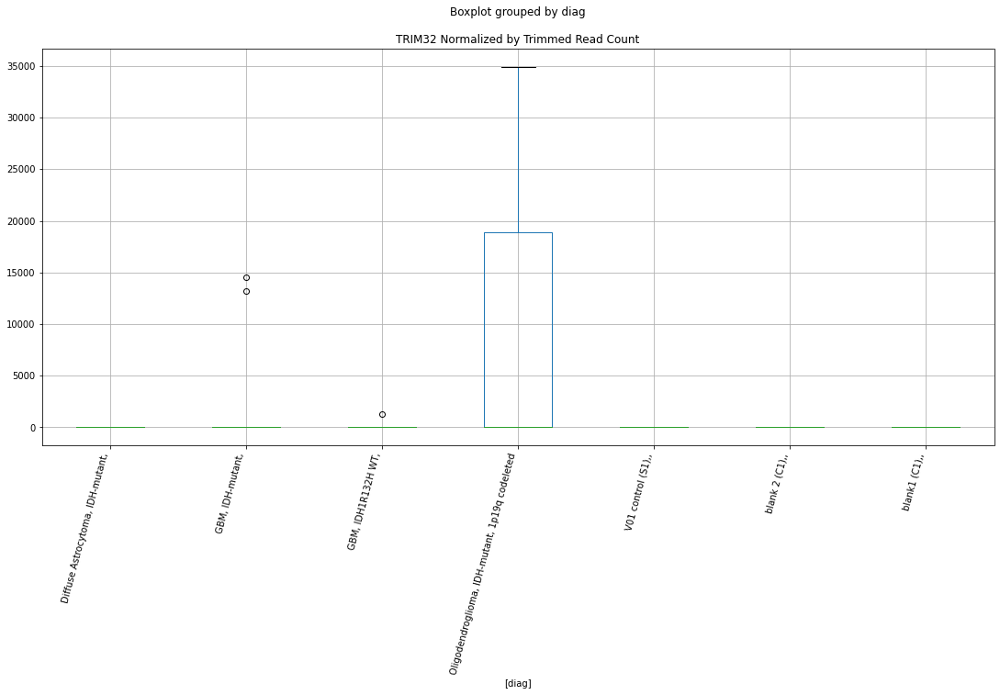

 p : 0.036667924829564005  ( t : 2.2571038634617233 ) :  Lexogen  :  cutadapt2  :  ZNF142
Control and blanks
82     247088.90
346    837108.53
Name: ZNF142, dtype: float64
214    952004.85
Name: ZNF142, dtype: float64
478    892139.04
Name: ZNF142, dtype: float64


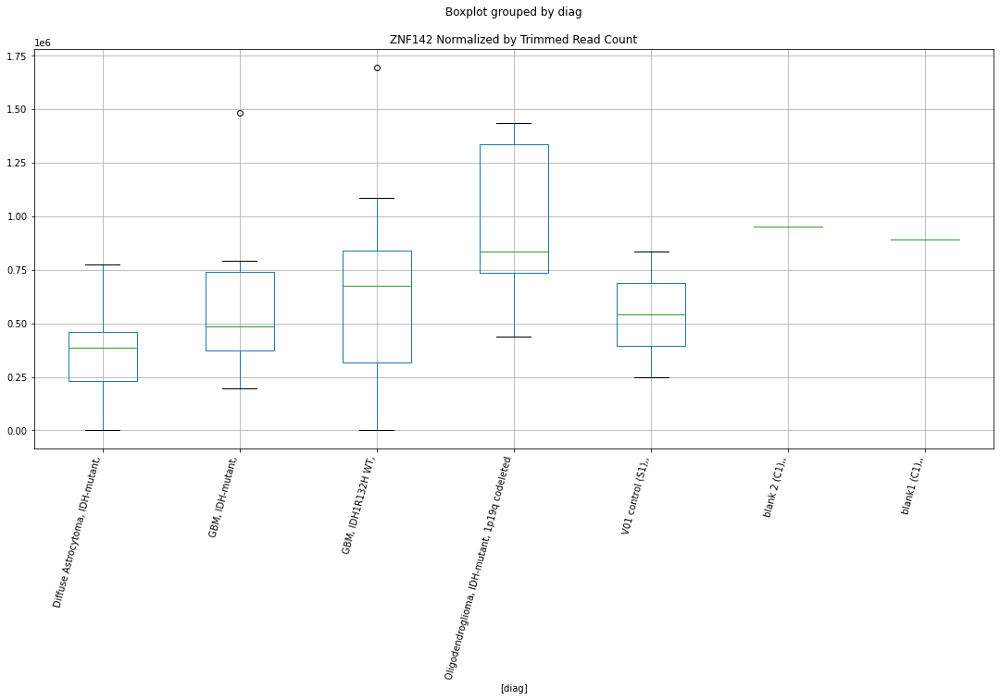

 p : 0.03679362848825829  ( t : 2.255401720837252 ) :  D-plex  :  cutadapt2  :  ZNF800
Control and blanks
76     152280.46
340     11449.52
Name: ZNF800, dtype: float64
208    56964.35
Name: ZNF800, dtype: float64
472    43924.64
Name: ZNF800, dtype: float64


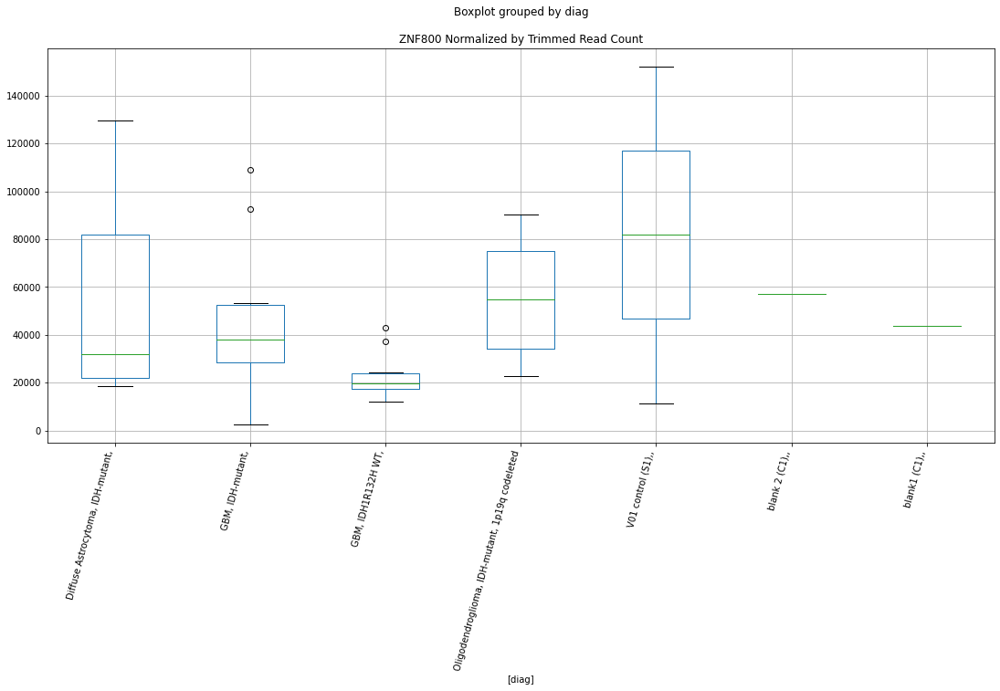

 p : 0.03679612327900554  ( t : 2.2553679934591155 ) :  Lexogen  :  bbduk2  :  TRIM32
Control and blanks
79     0.0
343    0.0
Name: TRIM32, dtype: float64
211    0.0
Name: TRIM32, dtype: float64
475    0.0
Name: TRIM32, dtype: float64


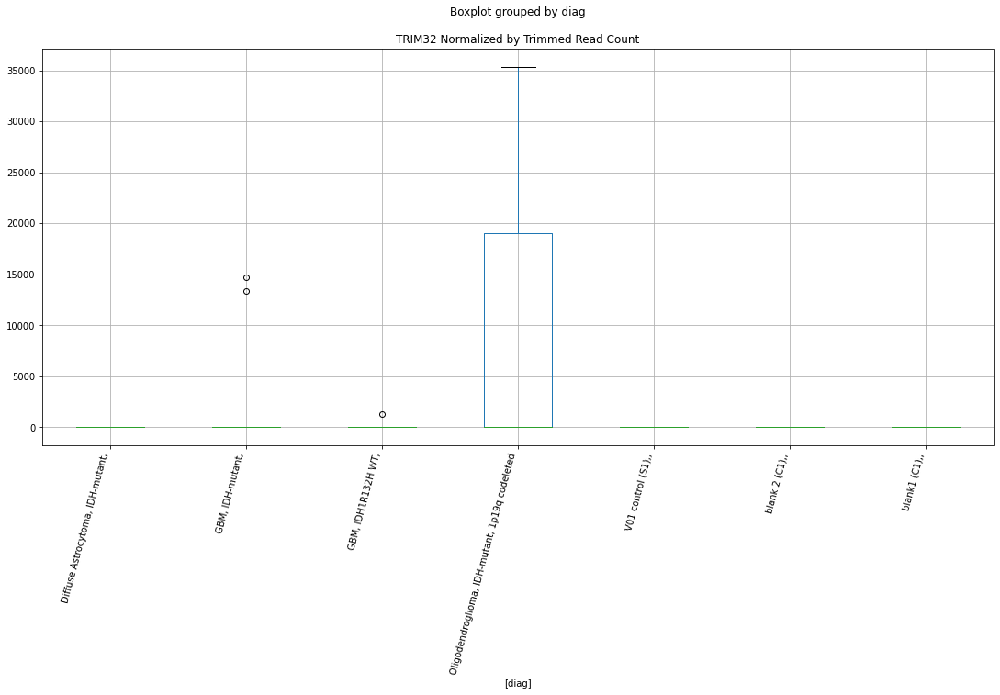

 p : 0.03693862998896309  ( t : 2.2534449240126175 ) :  Lexogen  :  cutadapt2  :  TSC22D4
Control and blanks
82     0.0
346    0.0
Name: TSC22D4, dtype: float64
214    0.0
Name: TSC22D4, dtype: float64
478    0.0
Name: TSC22D4, dtype: float64


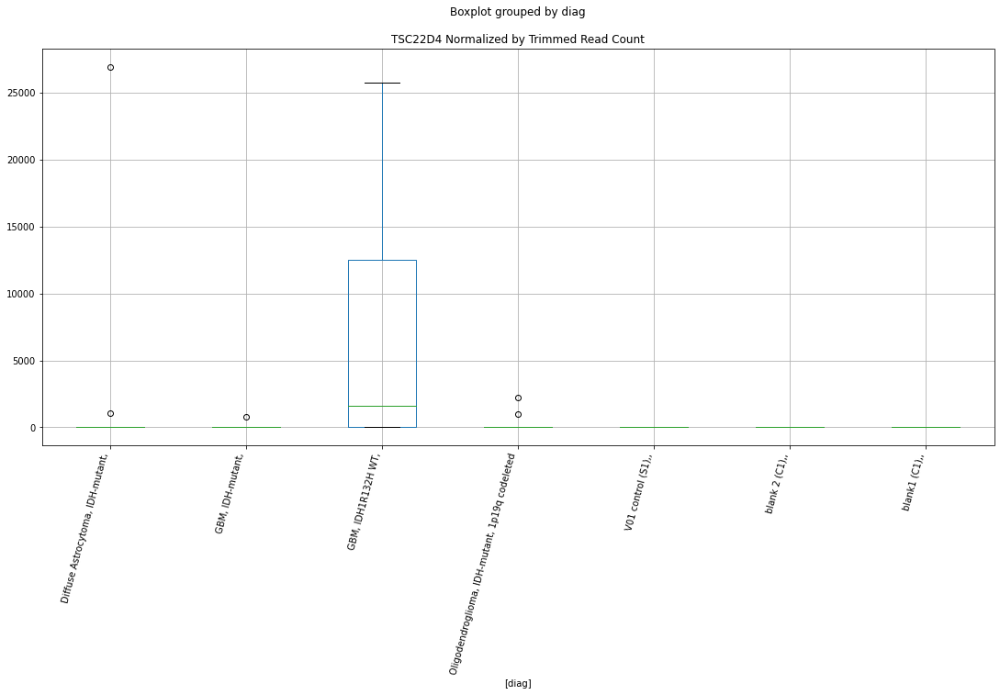

 p : 0.0369711183496443  ( t : 2.2530074657874737 ) :  Lexogen  :  bbduk2  :  TSC22D4
Control and blanks
79     0.0
343    0.0
Name: TSC22D4, dtype: float64
211    0.0
Name: TSC22D4, dtype: float64
475    0.0
Name: TSC22D4, dtype: float64


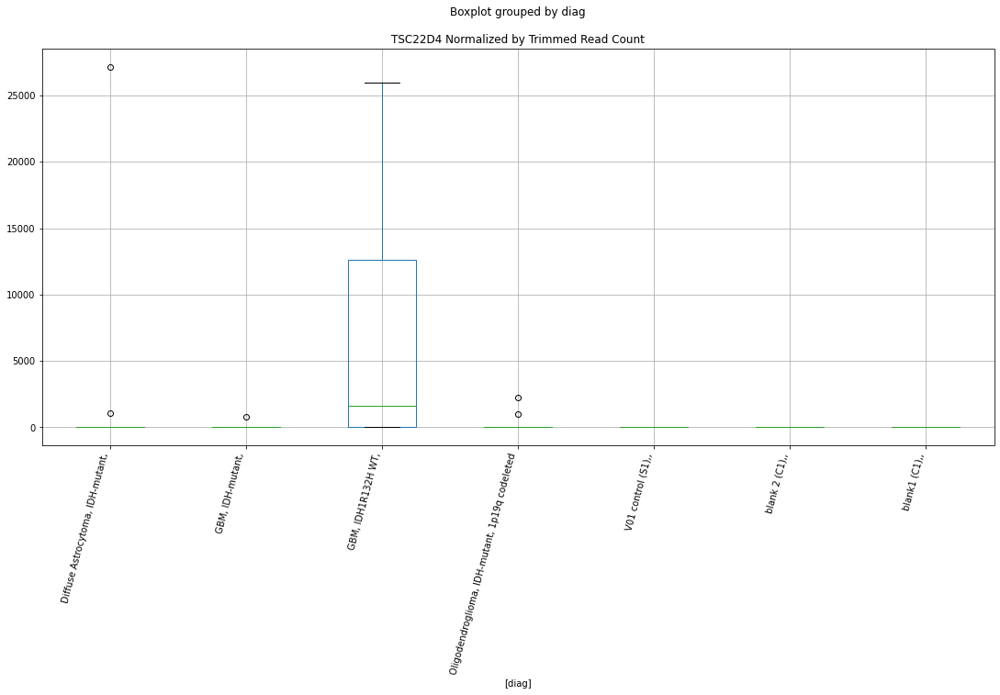

 p : 0.0369845507647409  ( t : 2.2528267009871357 ) :  D-plex  :  bbduk2  :  VPS28
Control and blanks
73     0.0
337    0.0
Name: VPS28, dtype: float64
205    2865.46
Name: VPS28, dtype: float64
469    4732.22
Name: VPS28, dtype: float64


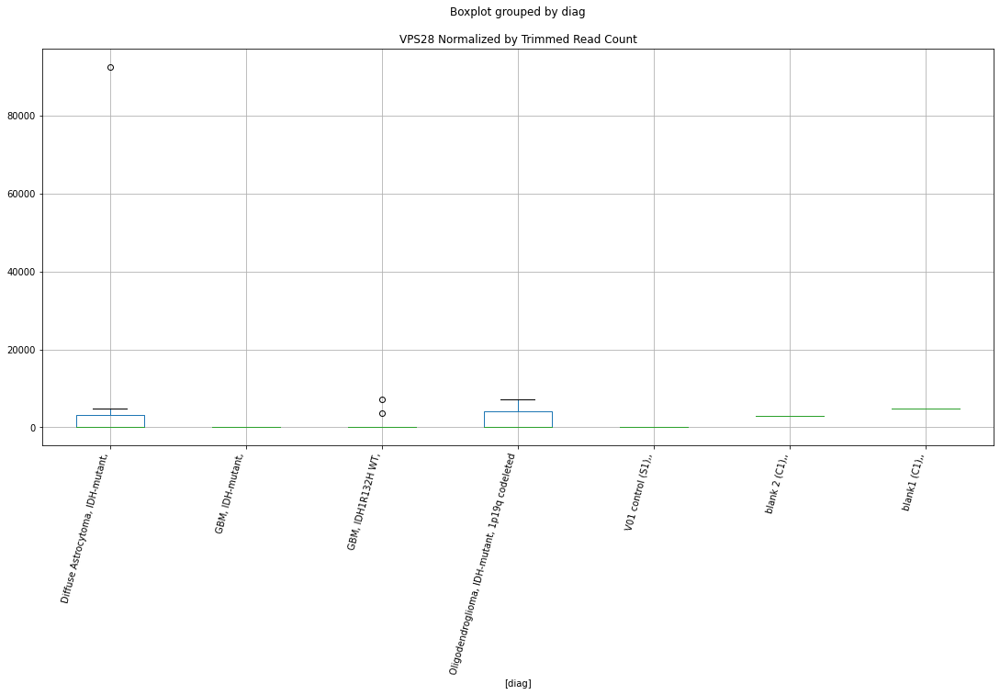

 p : 0.037131642474227136  ( t : 2.2508511906920727 ) :  D-plex  :  cutadapt2  :  XRCC1
Control and blanks
76      3030.46
340    31706.36
Name: XRCC1, dtype: float64
208    14637.9
Name: XRCC1, dtype: float64
472    13870.94
Name: XRCC1, dtype: float64


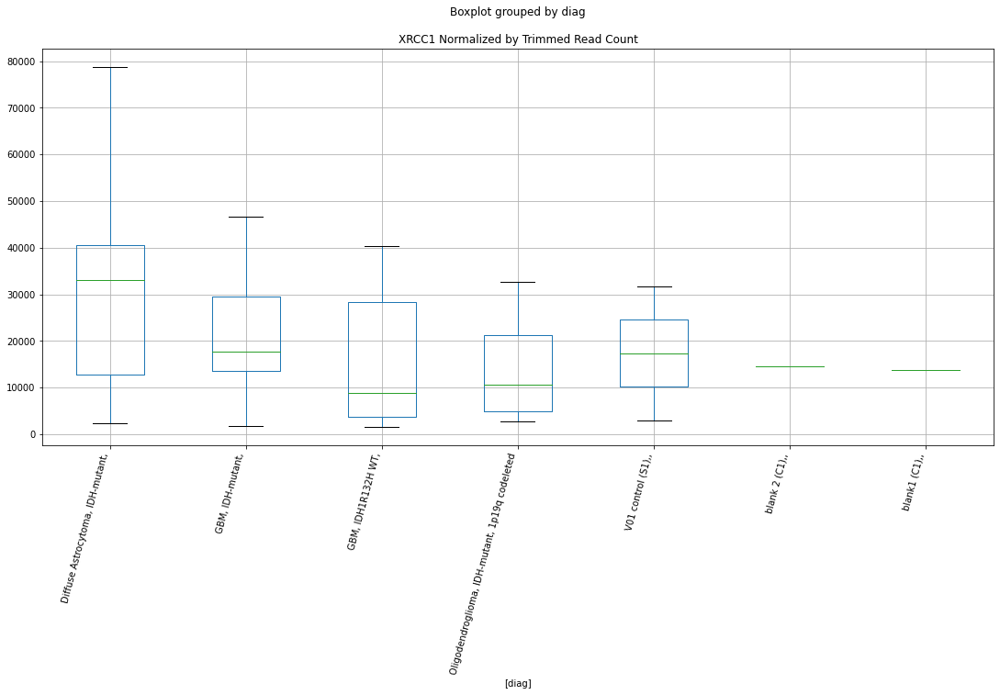

 p : 0.037281264537163794  ( t : 2.24884909263764 ) :  D-plex  :  cutadapt2  :  TRIM4
Control and blanks
76     0.0
340    0.0
Name: TRIM4, dtype: float64
208    352.72
Name: TRIM4, dtype: float64
472    0.0
Name: TRIM4, dtype: float64


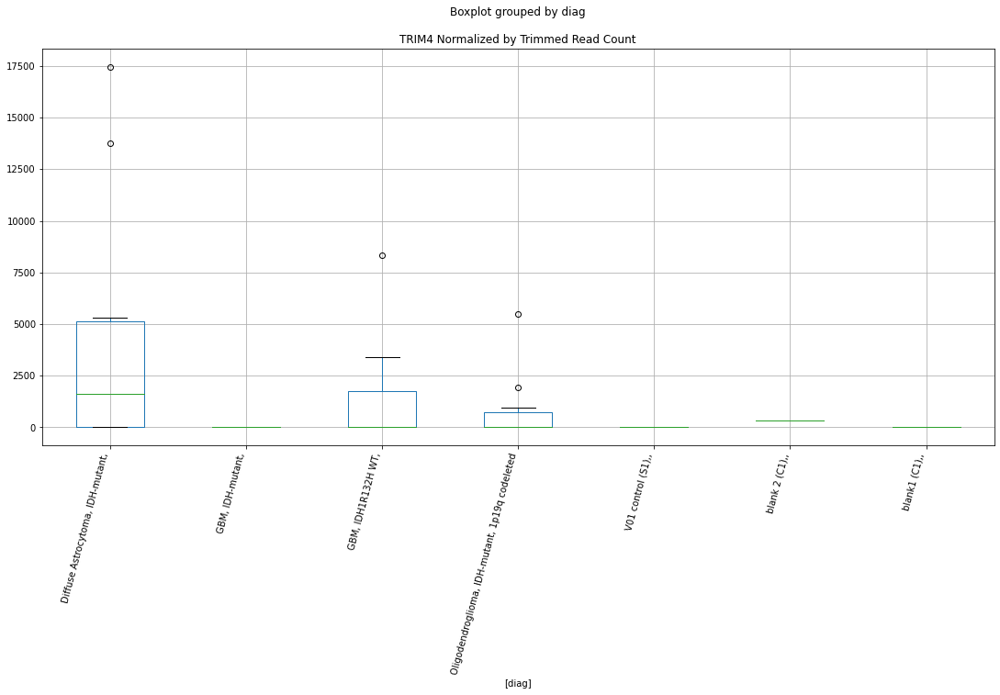

 p : 0.037289136036954086  ( t : 2.2487439692471325 ) :  D-plex  :  cutadapt2  :  ZNF3
Control and blanks
76        0.00
340    9688.05
Name: ZNF3, dtype: float64
208    6525.33
Name: ZNF3, dtype: float64
472    2889.78
Name: ZNF3, dtype: float64


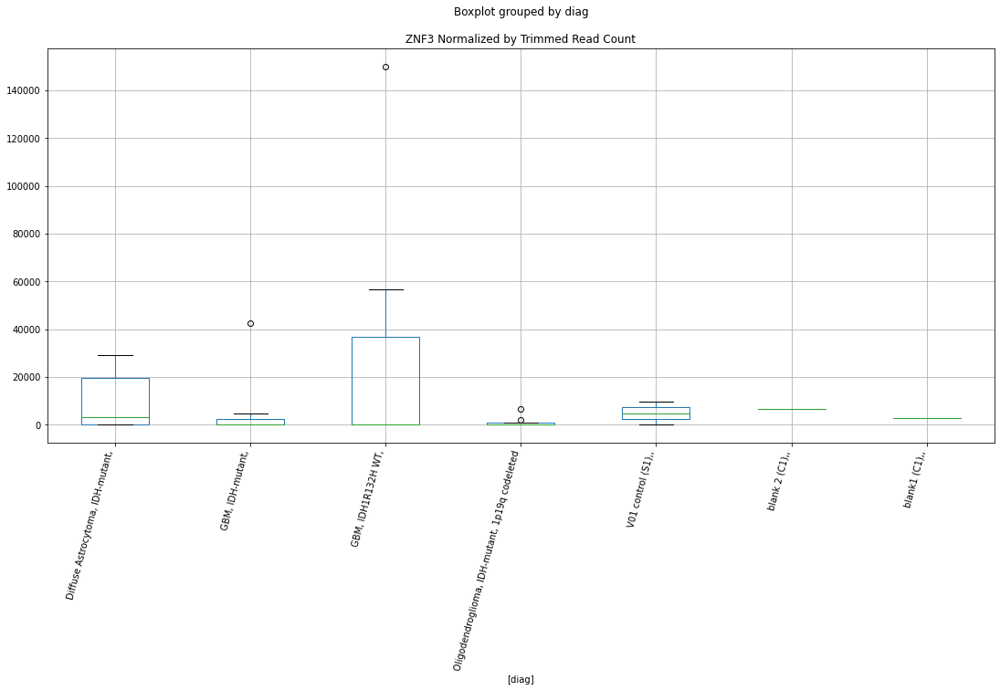

 p : 0.037485086430446464  ( t : 2.2461336408730896 ) :  D-plex  :  cutadapt2  :  ZNF335
Control and blanks
76     0.0
340    0.0
Name: ZNF335, dtype: float64
208    9347.09
Name: ZNF335, dtype: float64
472    5201.6
Name: ZNF335, dtype: float64


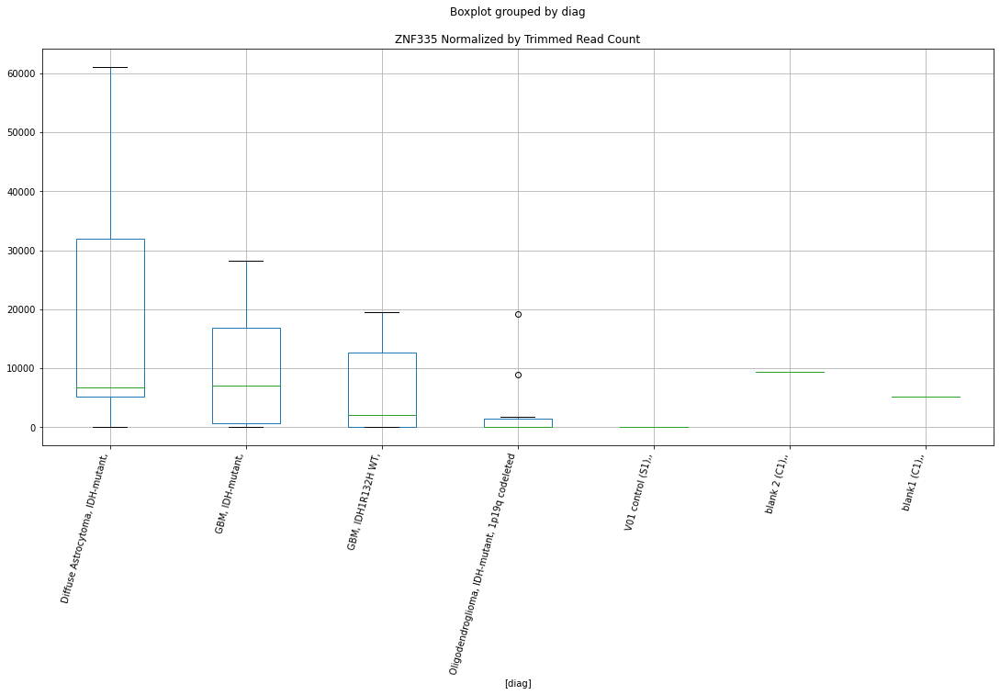

 p : 0.037543434906606256  ( t : 2.245358791253077 ) :  D-plex  :  cutadapt2  :  TFB1M
Control and blanks
76     5303.3
340       0.0
Name: TFB1M, dtype: float64
208    75658.53
Name: TFB1M, dtype: float64
472    4045.69
Name: TFB1M, dtype: float64


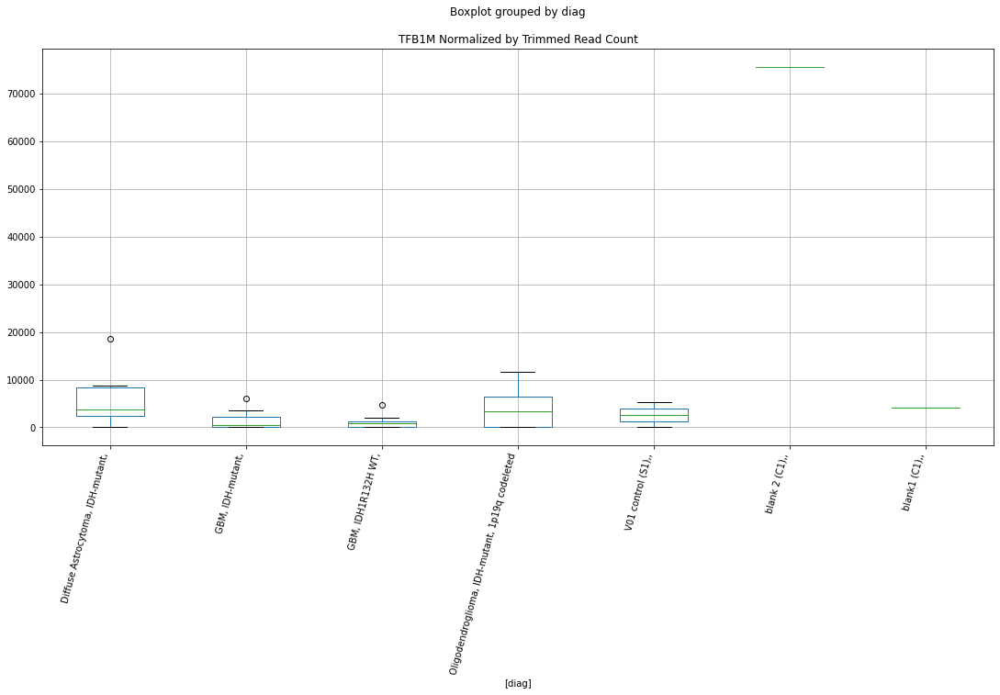

 p : 0.03771317462573046  ( t : 2.243110999854108 ) :  Lexogen  :  bbduk2  :  ZNF165
Control and blanks
79     0.0
343    0.0
Name: ZNF165, dtype: float64
211    0.0
Name: ZNF165, dtype: float64
475    0.0
Name: ZNF165, dtype: float64


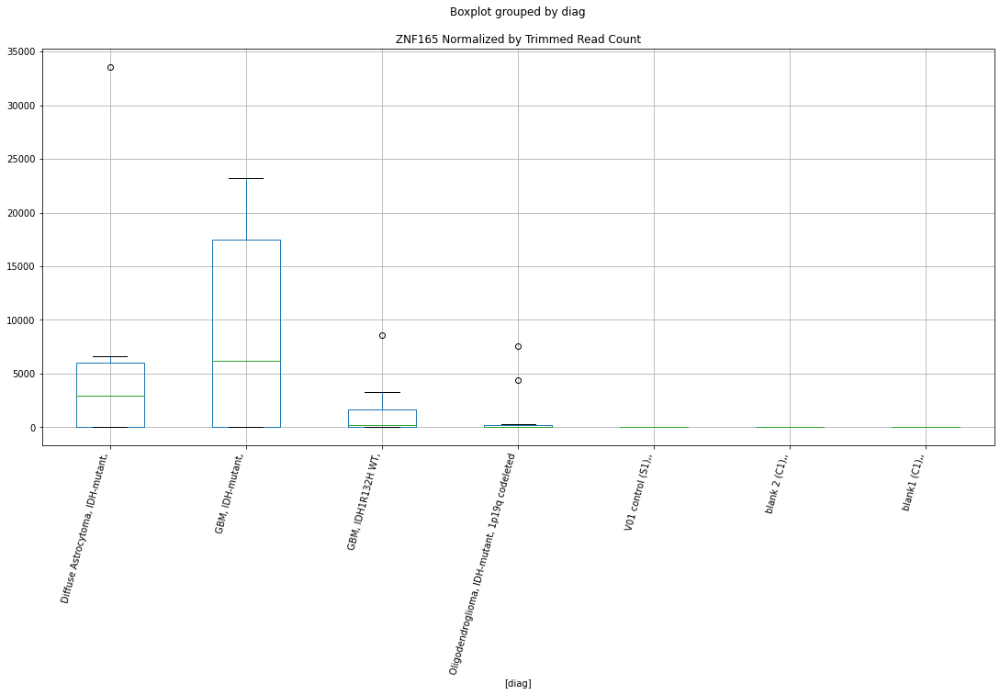

 p : 0.03772399744641917  ( t : 2.242967994448855 ) :  D-plex  :  cutadapt2  :  ZBTB22
Control and blanks
76     0.0
340    0.0
Name: ZBTB22, dtype: float64
208    8818.01
Name: ZBTB22, dtype: float64
472    0.0
Name: ZBTB22, dtype: float64


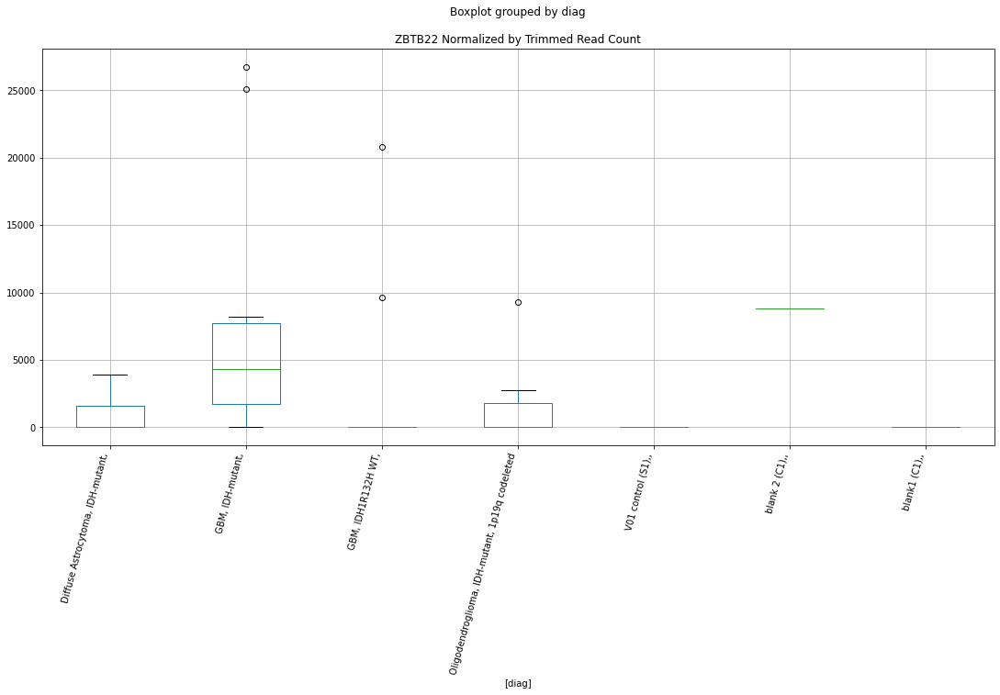

 p : 0.03779271504197847  ( t : 2.2420608885780053 ) :  D-plex  :  bbduk2  :  TRIM22
Control and blanks
73     0.0
337    0.0
Name: TRIM22, dtype: float64
205    2149.09
Name: TRIM22, dtype: float64
469    0.0
Name: TRIM22, dtype: float64


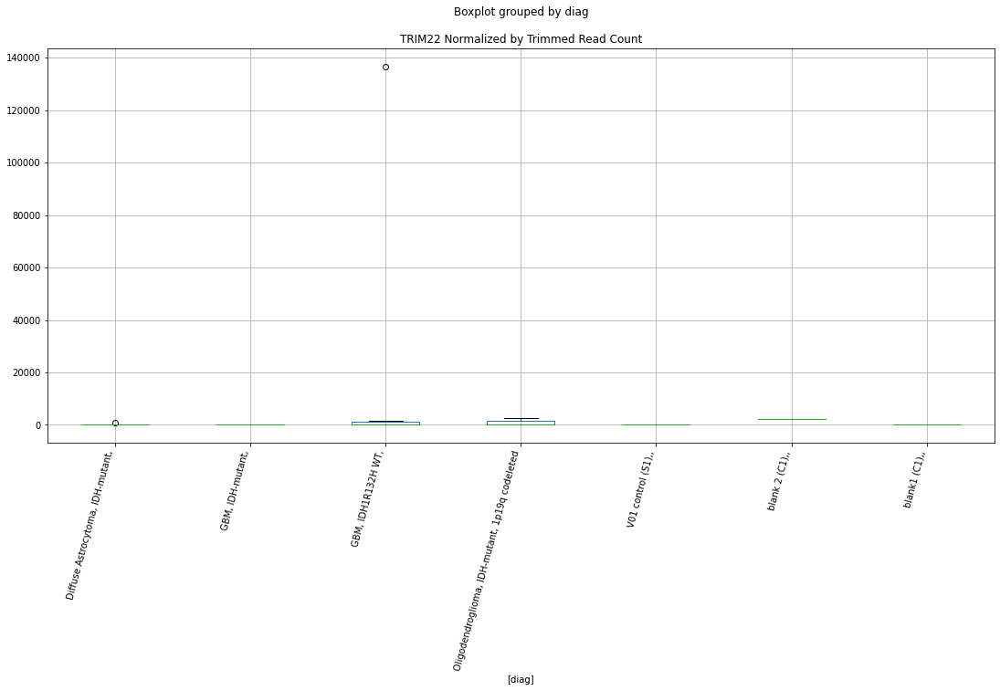

 p : 0.037813867305706766  ( t : 2.2417819744899767 ) :  Lexogen  :  bbduk2  :  ZNF142
Control and blanks
79     248924.19
343    839066.17
Name: ZNF142, dtype: float64
211    948646.29
Name: ZNF142, dtype: float64
475    893633.22
Name: ZNF142, dtype: float64


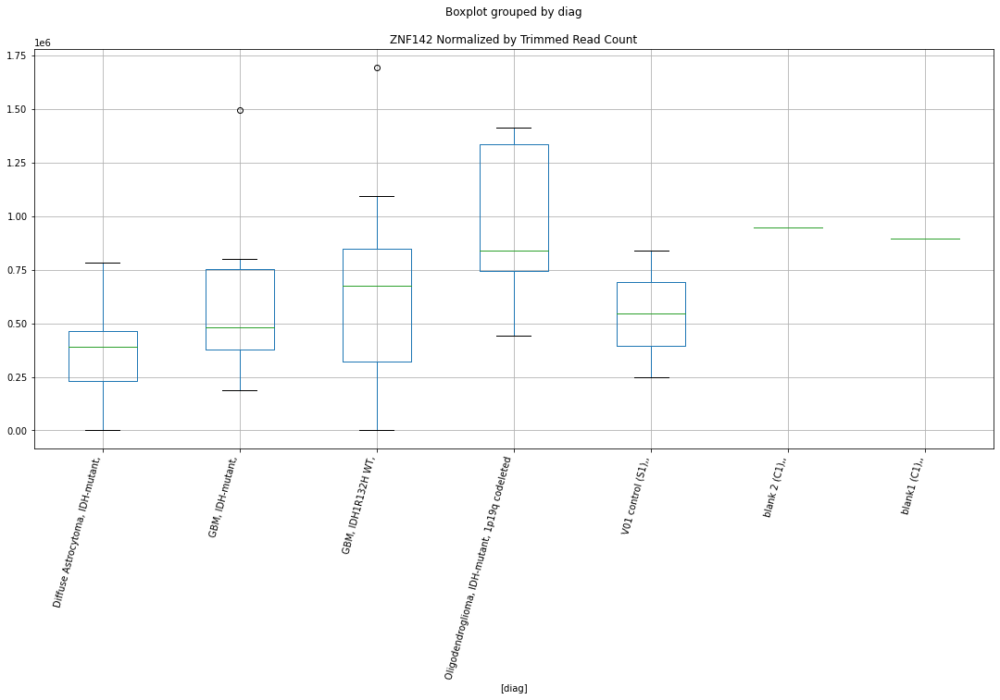

 p : 0.037841438998335516  ( t : 2.2414186296169056 ) :  D-plex  :  cutadapt2  :  TRIM22
Control and blanks
76     0.0
340    0.0
Name: TRIM22, dtype: float64
208    2116.32
Name: TRIM22, dtype: float64
472    0.0
Name: TRIM22, dtype: float64


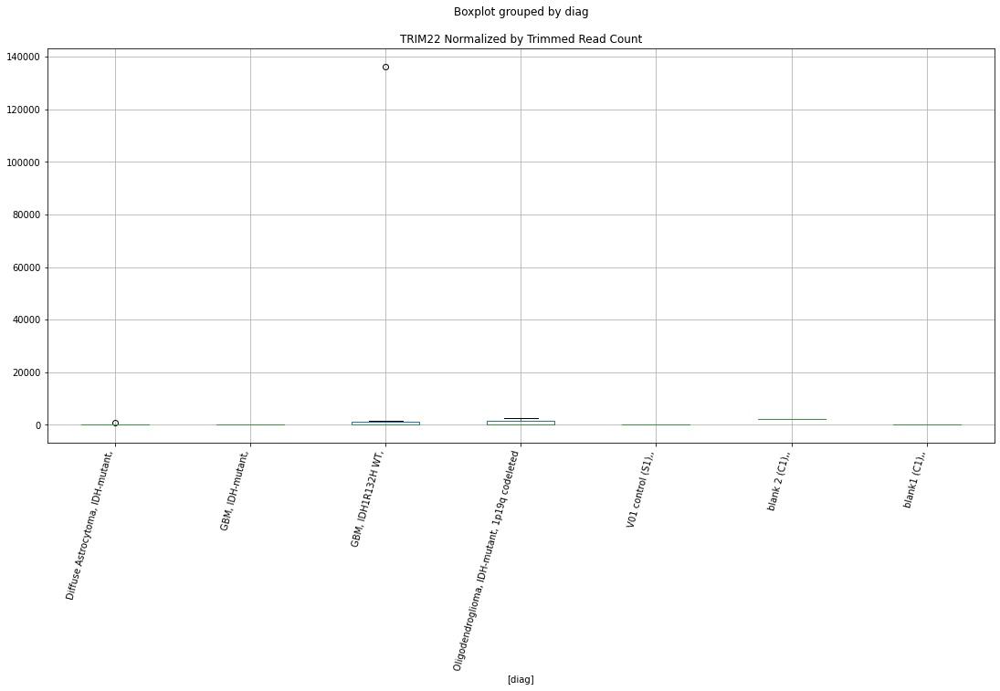

 p : 0.0378470207534361  ( t : 2.2413451019274993 ) :  Lexogen  :  cutadapt2  :  TRAPPC6A
Control and blanks
82     0.0
346    0.0
Name: TRAPPC6A, dtype: float64
214    0.0
Name: TRAPPC6A, dtype: float64
478    0.0
Name: TRAPPC6A, dtype: float64


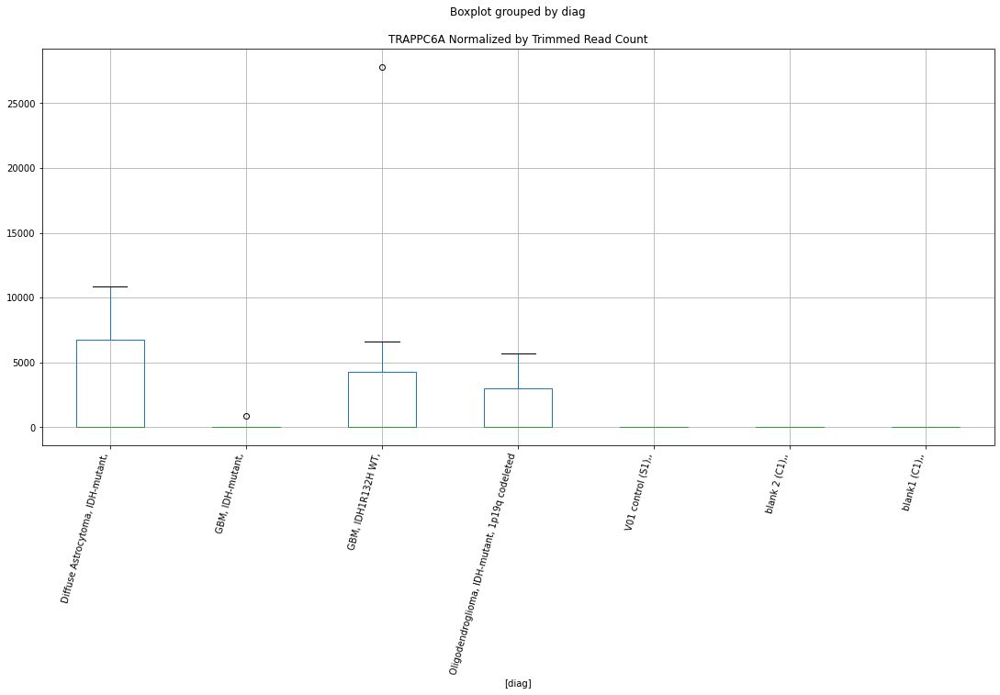

 p : 0.037852900975657494  ( t : 2.2412676533865223 ) :  Lexogen  :  bbduk2  :  TRAPPC6A
Control and blanks
79     0.0
343    0.0
Name: TRAPPC6A, dtype: float64
211    0.0
Name: TRAPPC6A, dtype: float64
475    0.0
Name: TRAPPC6A, dtype: float64


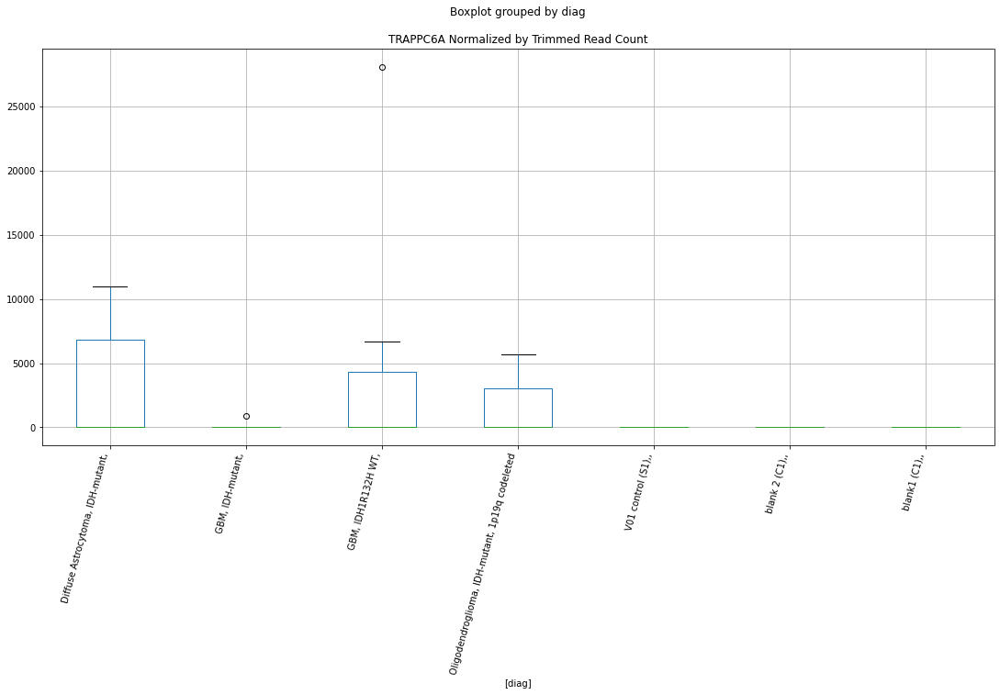

 p : 0.03786558665241067  ( t : 2.2411006078237783 ) :  D-plex  :  bbduk2  :  USP19
Control and blanks
73     31693.34
337        0.00
Name: USP19, dtype: float64
205    17730.0
Name: USP19, dtype: float64
469    71574.81
Name: USP19, dtype: float64


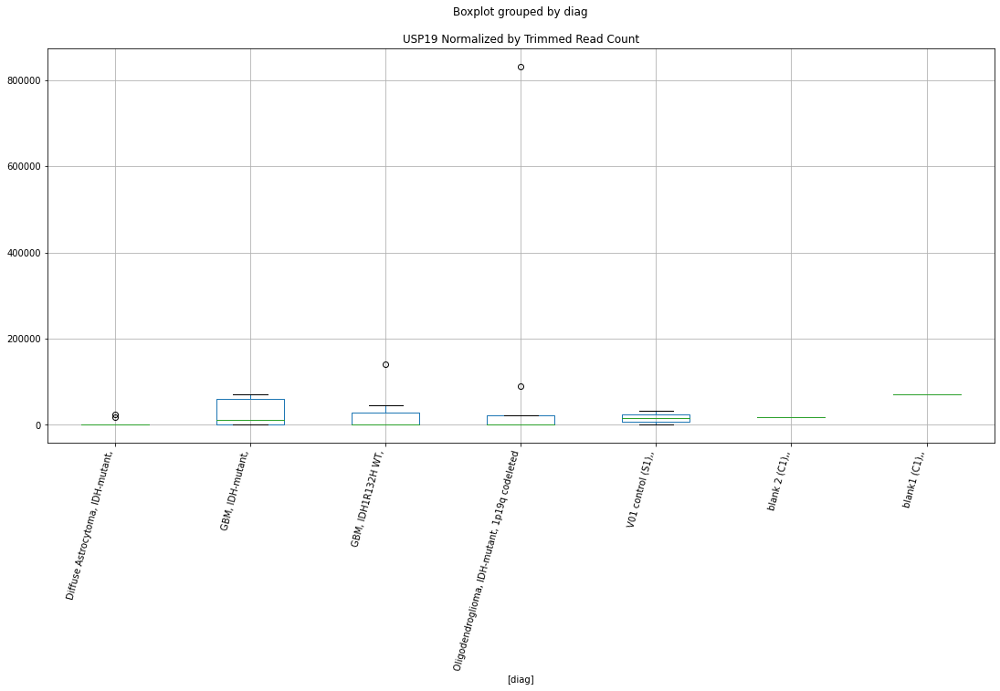

 p : 0.03793063114079904  ( t : 2.2402449088133 ) :  D-plex  :  cutadapt2  :  STK16
Control and blanks
76       3788.07
340    158531.78
Name: STK16, dtype: float64
208    250431.51
Name: STK16, dtype: float64
472    8669.34
Name: STK16, dtype: float64


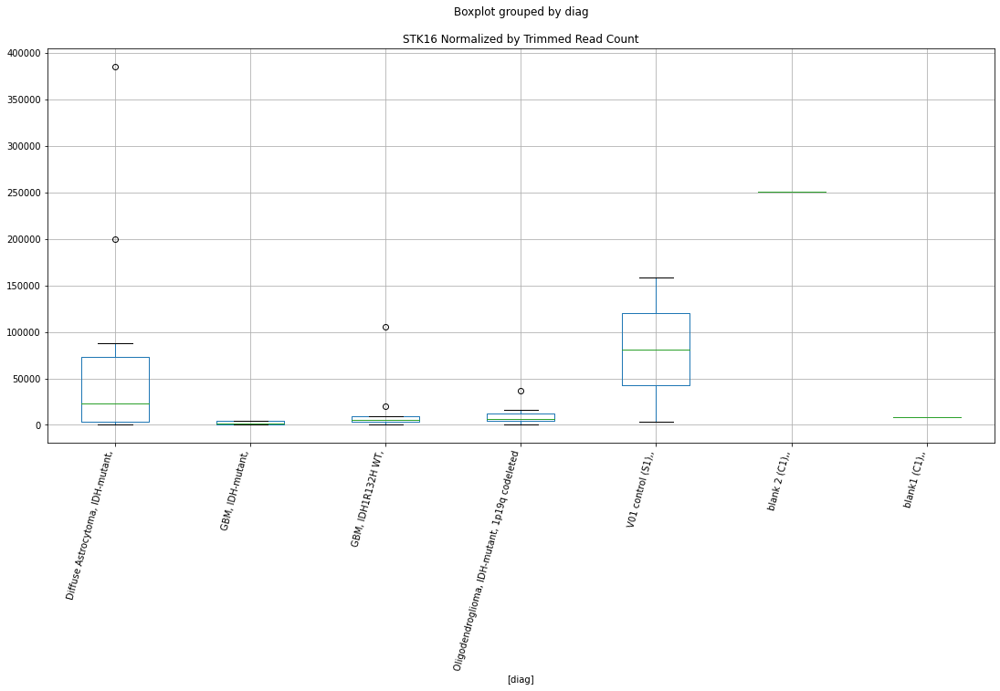

 p : 0.03795443960933959  ( t : 2.2399320324297043 ) :  D-plex  :  cutadapt2  :  XRCC6
Control and blanks
76     3030.46
340       0.00
Name: XRCC6, dtype: float64
208    65782.36
Name: XRCC6, dtype: float64
472    2889.78
Name: XRCC6, dtype: float64


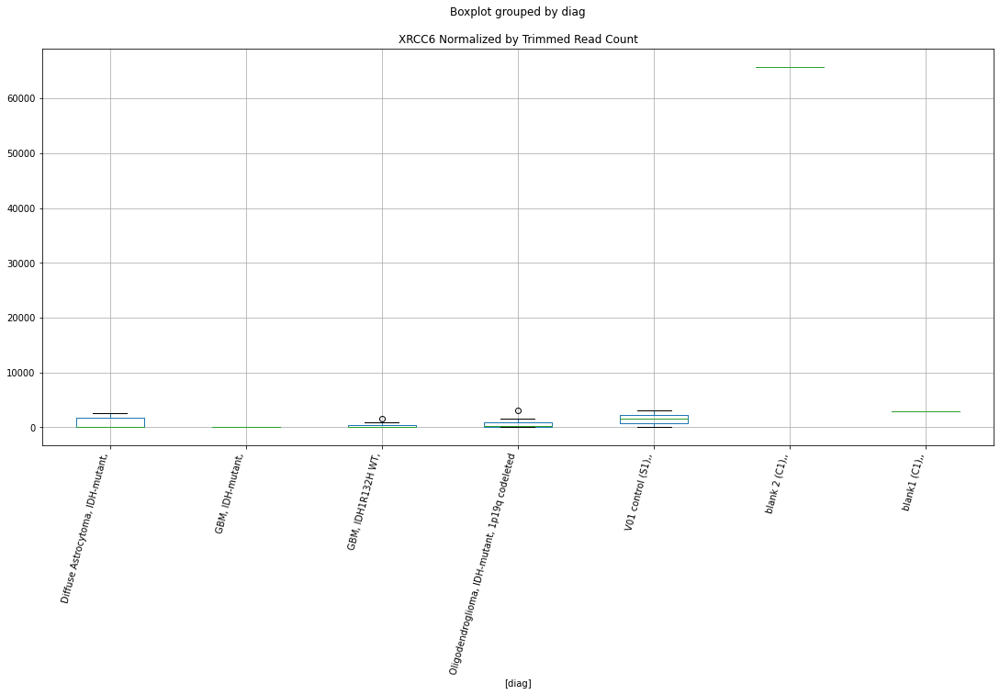

 p : 0.03798881424856906  ( t : 2.2394806209443936 ) :  D-plex  :  cutadapt2  :  YDJC
Control and blanks
76     0.0
340    0.0
Name: YDJC, dtype: float64
208    529.08
Name: YDJC, dtype: float64
472    6935.47
Name: YDJC, dtype: float64


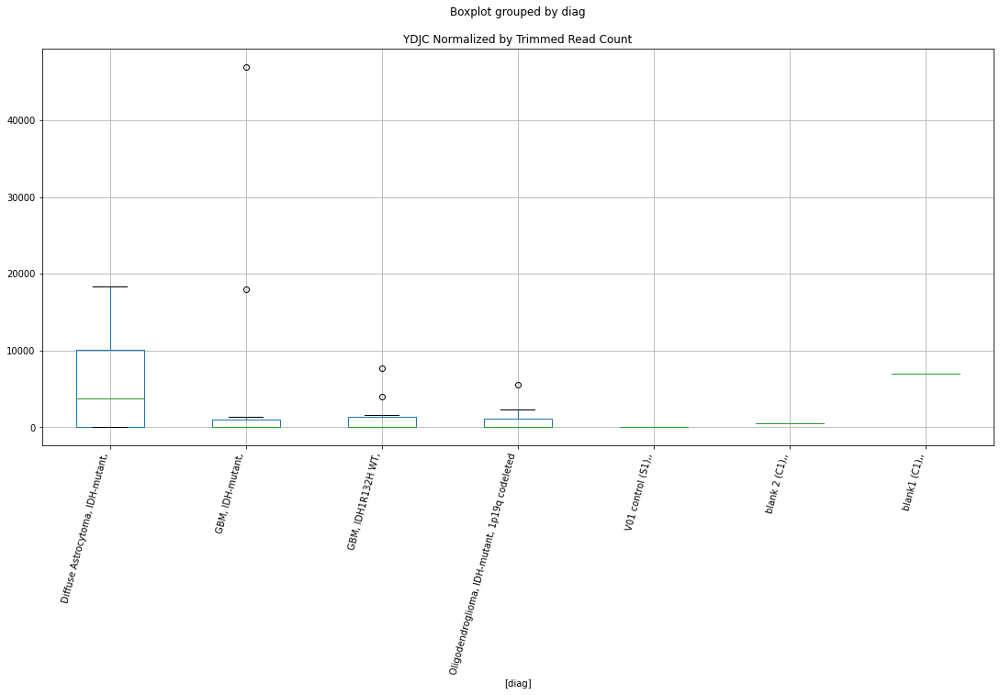

 p : 0.03812988363322278  ( t : 2.2376320174047395 ) :  D-plex  :  bbduk2  :  TENM4
Control and blanks
73     773.01
337      0.00
Name: TENM4, dtype: float64
205    10387.28
Name: TENM4, dtype: float64
469    17745.82
Name: TENM4, dtype: float64


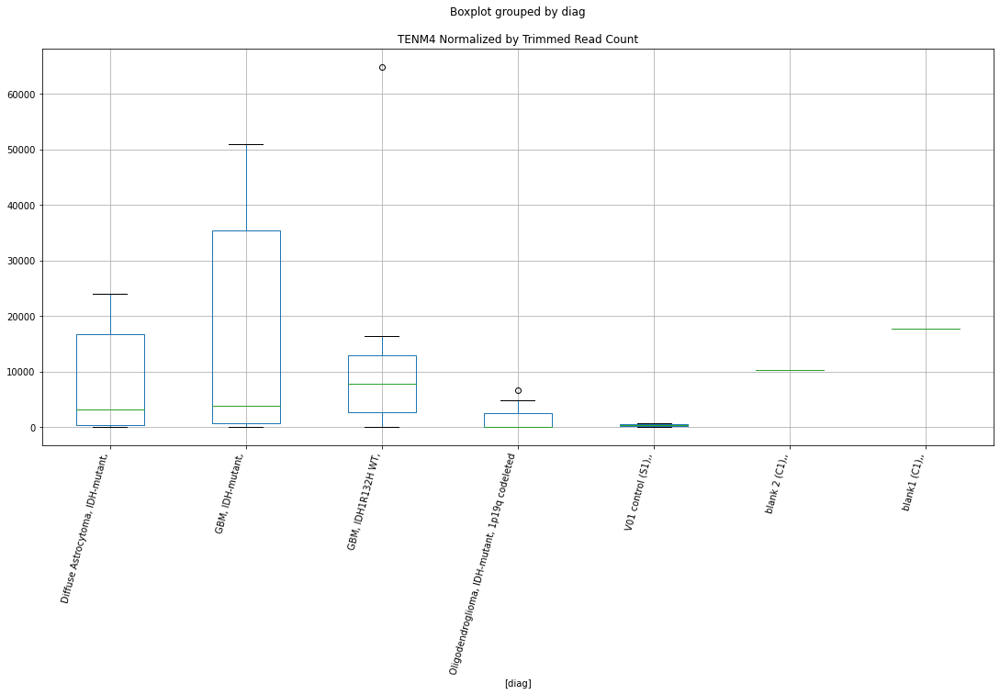

 p : 0.03815796662575671  ( t : 2.2372647644248542 ) :  D-plex  :  bbduk2  :  ZNF235
Control and blanks
73     0.0
337    0.0
Name: ZNF235, dtype: float64
205    3581.82
Name: ZNF235, dtype: float64
469    2366.11
Name: ZNF235, dtype: float64


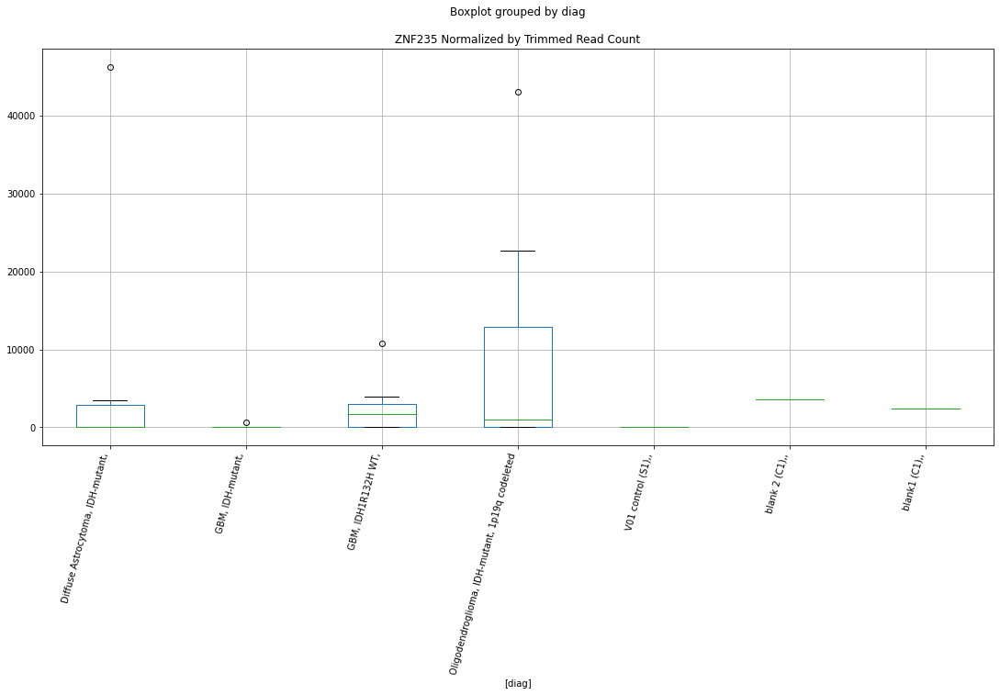

 p : 0.03824783825195733  ( t : 2.23609114777566 ) :  Lexogen  :  cutadapt2  :  ZNF583
Control and blanks
82       0.00
346    420.87
Name: ZNF583, dtype: float64
214    0.0
Name: ZNF583, dtype: float64
478    0.0
Name: ZNF583, dtype: float64


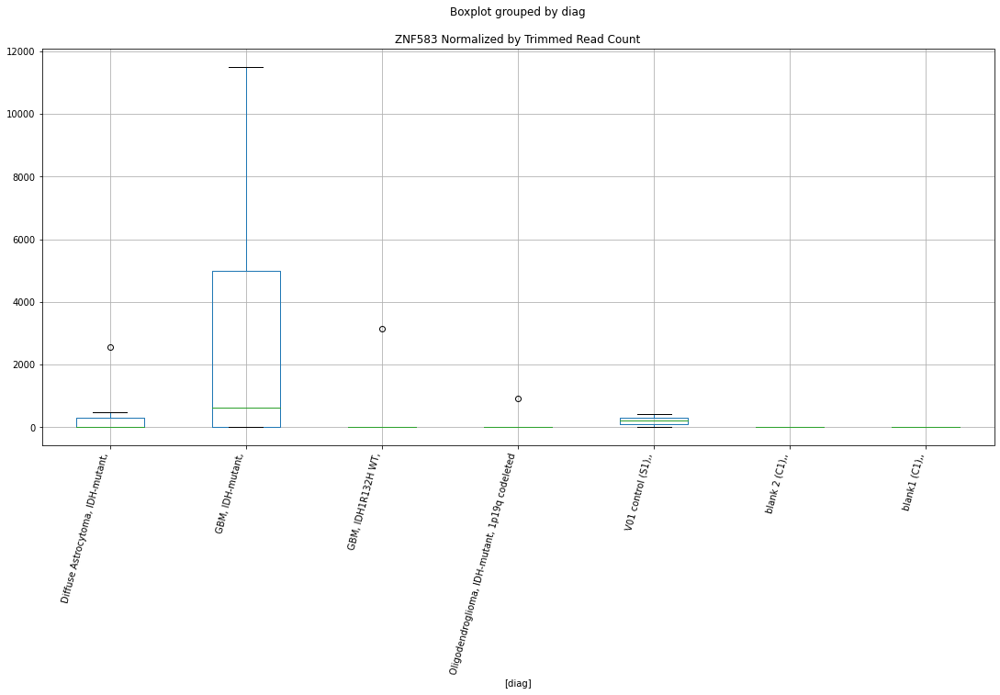

 p : 0.038324964538359124  ( t : 2.2350859948104462 ) :  D-plex  :  bbduk2  :  SUN2
Control and blanks
73     34785.38
337        0.00
Name: SUN2, dtype: float64
205    20774.55
Name: SUN2, dtype: float64
469    21886.51
Name: SUN2, dtype: float64


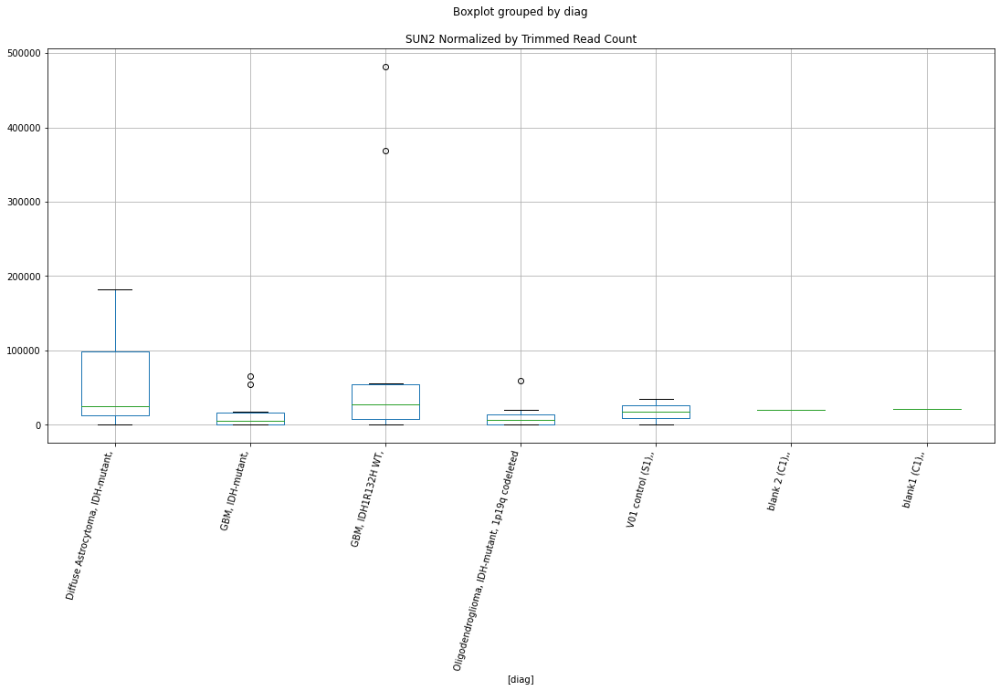

 p : 0.038352546098040834  ( t : 2.2347269889491455 ) :  D-plex  :  bbduk2  :  SRI
Control and blanks
73     0.0
337    0.0
Name: SRI, dtype: float64
205    1432.73
Name: SRI, dtype: float64
469    0.0
Name: SRI, dtype: float64


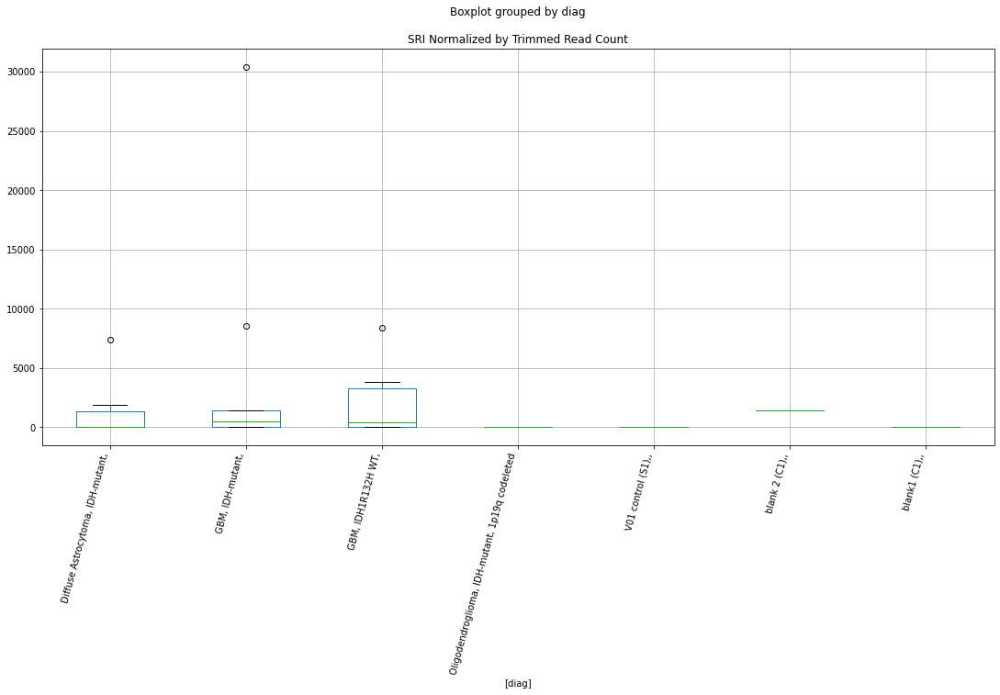

 p : 0.03842053529771273  ( t : 2.233843045998007 ) :  D-plex  :  bbduk2  :  TAF4
Control and blanks
73     1546.02
337       0.00
Name: TAF4, dtype: float64
205    2507.27
Name: TAF4, dtype: float64
469    7689.86
Name: TAF4, dtype: float64


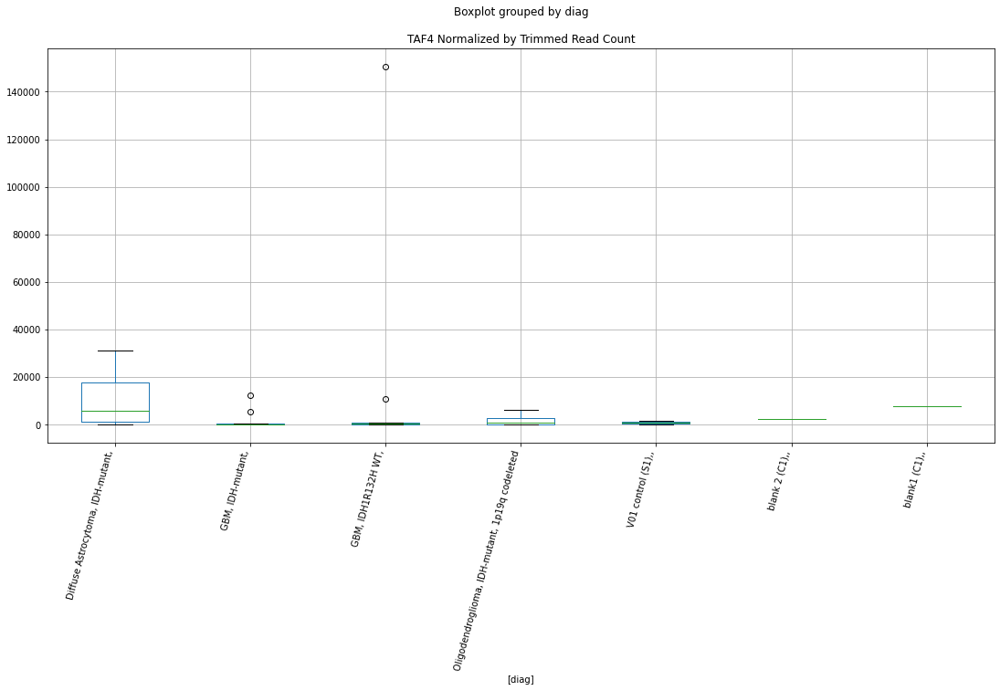

 p : 0.038429966491913096  ( t : 2.233720542765937 ) :  D-plex  :  cutadapt2  :  ZNF766
Control and blanks
76       0.00
340    880.73
Name: ZNF766, dtype: float64
208    1763.6
Name: ZNF766, dtype: float64
472    4045.69
Name: ZNF766, dtype: float64


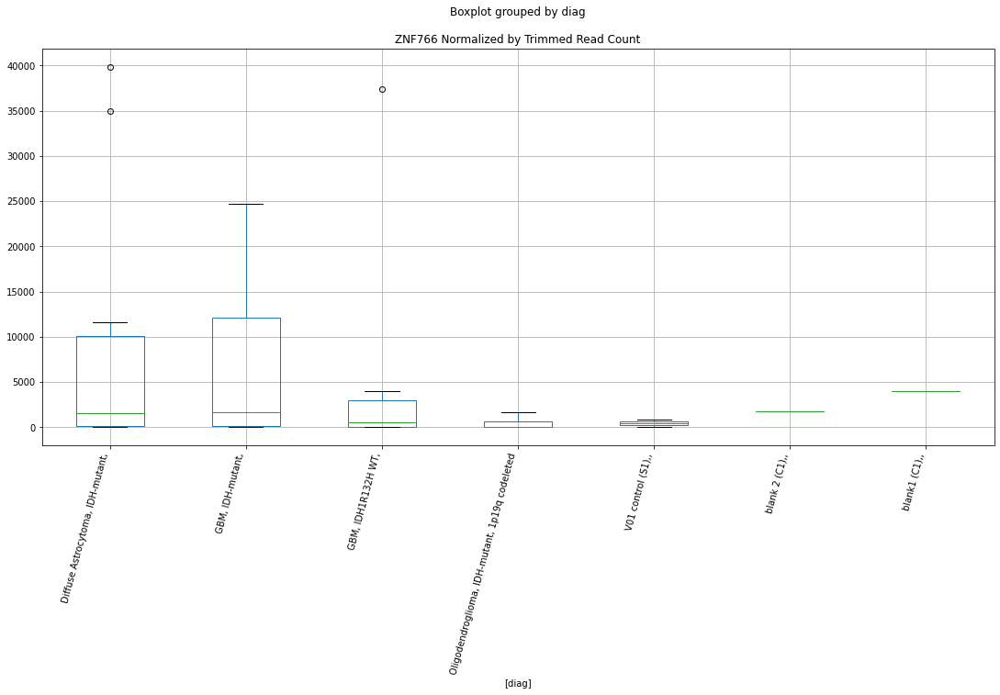

 p : 0.03843023389423292  ( t : 2.233717069839934 ) :  D-plex  :  cutadapt2  :  TENM4
Control and blanks
76     757.61
340      0.00
Name: TENM4, dtype: float64
208    5996.25
Name: TENM4, dtype: float64
472    12715.03
Name: TENM4, dtype: float64


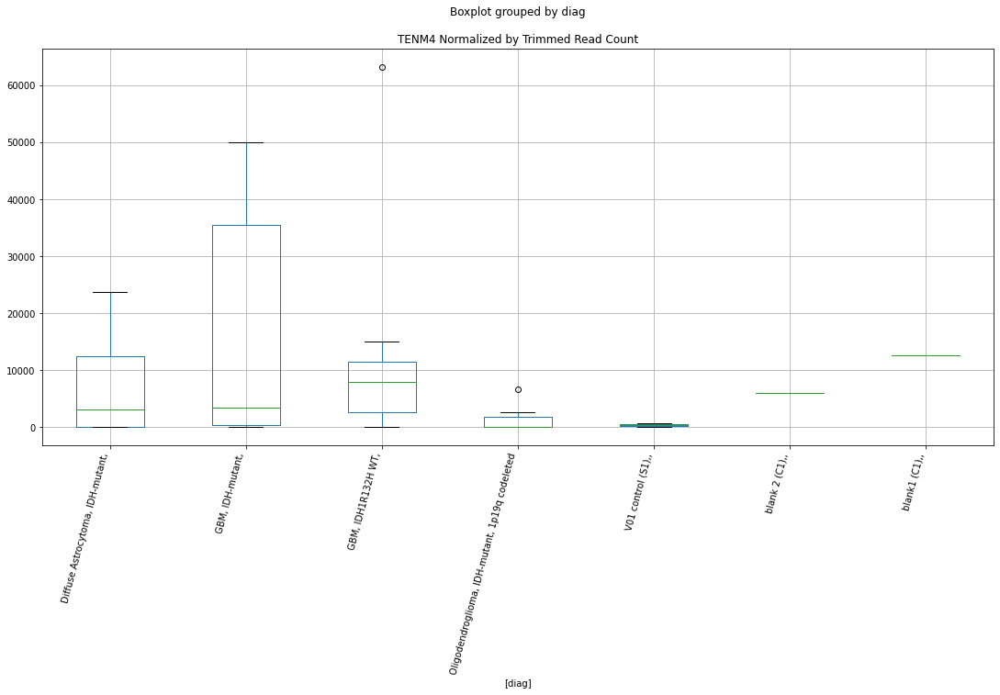

 p : 0.03845493751432886  ( t : 2.233396324034225 ) :  D-plex  :  cutadapt2  :  STK10
Control and blanks
76     63639.59
340    45798.07
Name: STK10, dtype: float64
208    3527.2
Name: STK10, dtype: float64
472    3467.74
Name: STK10, dtype: float64


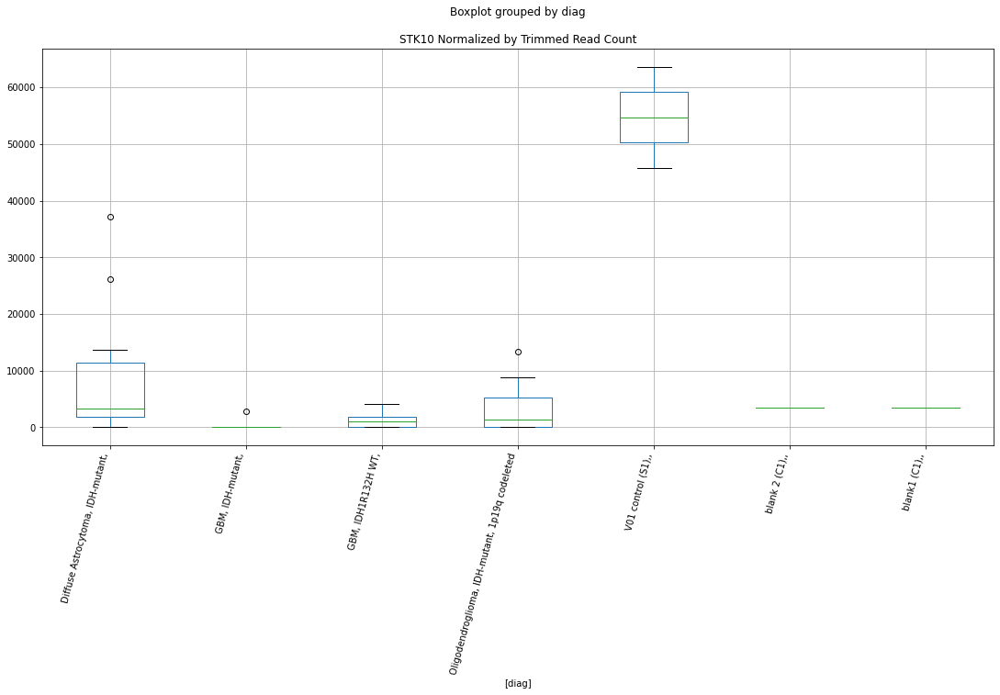

 p : 0.03852651552050613  ( t : 2.2324680433758 ) :  Lexogen  :  cutadapt2  :  TMEM178B
Control and blanks
82     0.0
346    0.0
Name: TMEM178B, dtype: float64
214    0.0
Name: TMEM178B, dtype: float64
478    0.0
Name: TMEM178B, dtype: float64


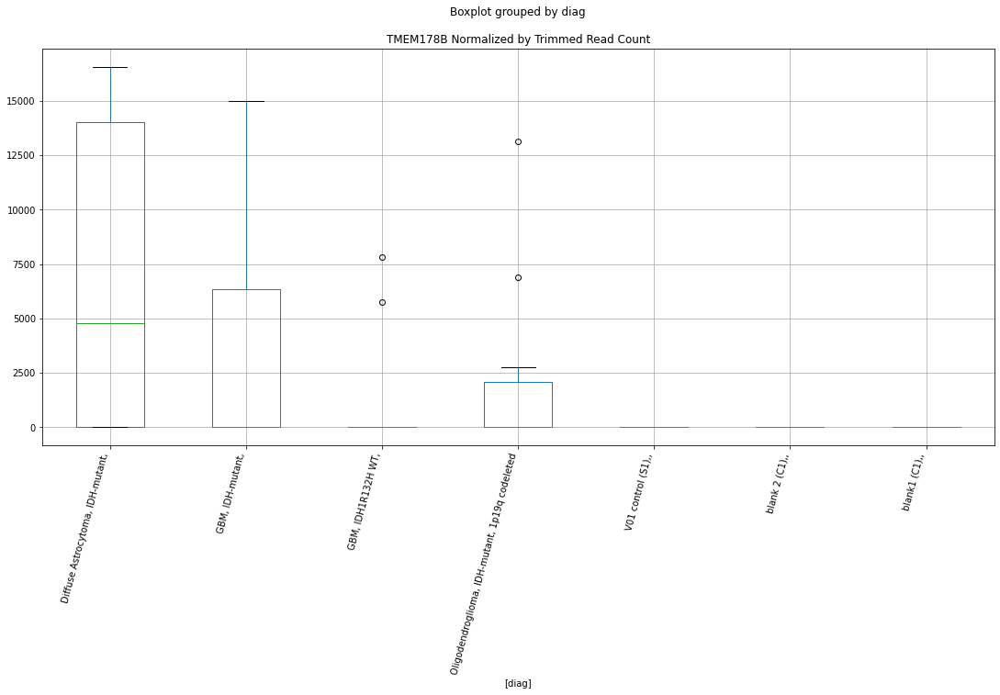

 p : 0.038573908041767906  ( t : 2.2318542932852394 ) :  Lexogen  :  bbduk2  :  ZNF641
Control and blanks
79       0.00
343    849.26
Name: ZNF641, dtype: float64
211    0.0
Name: ZNF641, dtype: float64
475    0.0
Name: ZNF641, dtype: float64


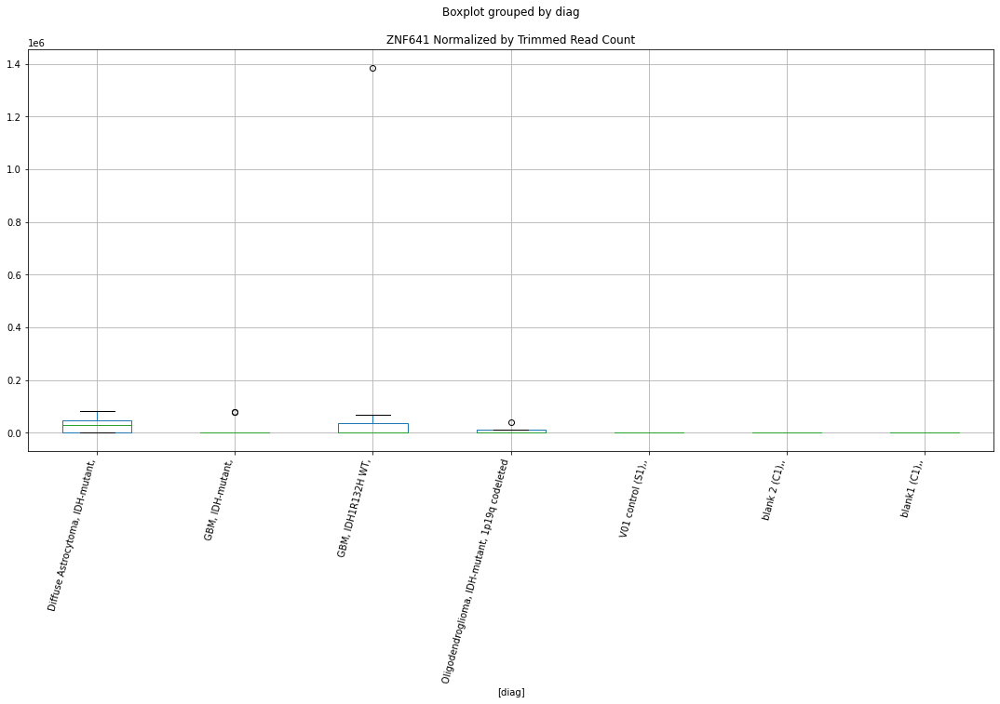

 p : 0.038606754128520944  ( t : 2.231429332161149 ) :  D-plex  :  bbduk2  :  TMEM144
Control and blanks
73     0.0
337    0.0
Name: TMEM144, dtype: float64
205    358.18
Name: TMEM144, dtype: float64
469    0.0
Name: TMEM144, dtype: float64


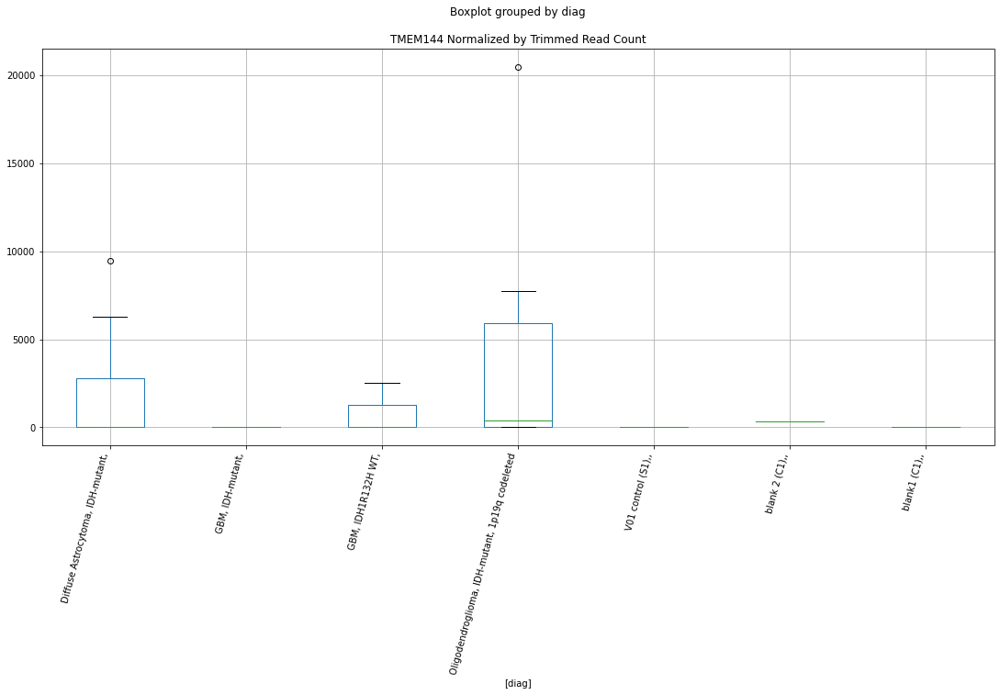

 p : 0.038621027708674836  ( t : 2.2312447650616973 ) :  D-plex  :  bbduk2  :  TENT4B
Control and blanks
73     17779.19
337     3560.63
Name: TENT4B, dtype: float64
205    23640.01
Name: TENT4B, dtype: float64
469    44364.55
Name: TENT4B, dtype: float64


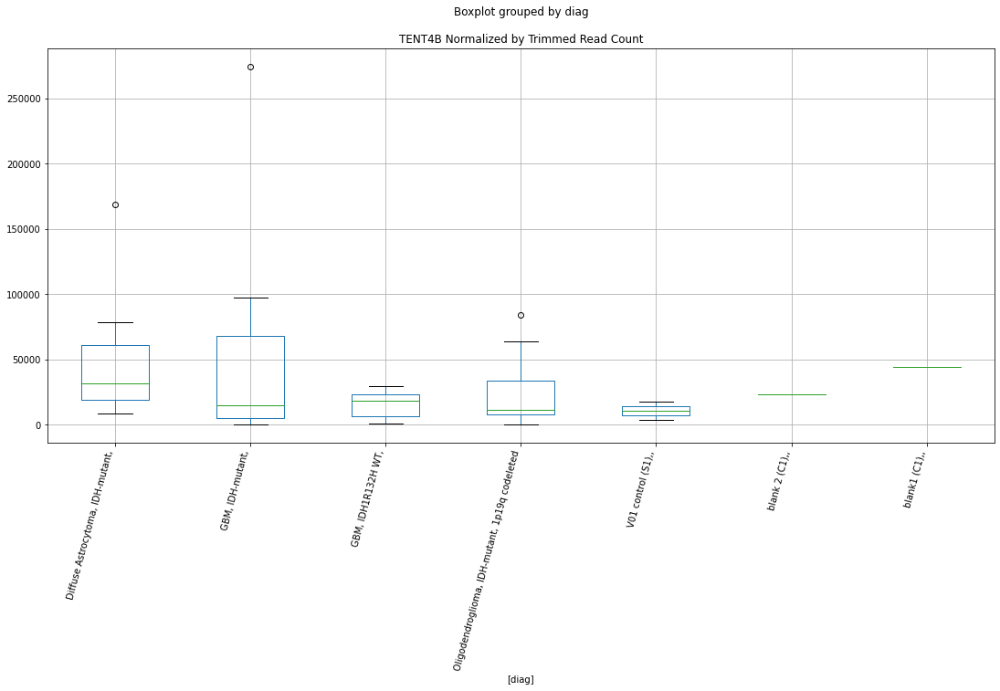

 p : 0.038685607400301414  ( t : 2.2304104902195183 ) :  D-plex  :  cutadapt2  :  TMEM144
Control and blanks
76     0.0
340    0.0
Name: TMEM144, dtype: float64
208    352.72
Name: TMEM144, dtype: float64
472    0.0
Name: TMEM144, dtype: float64


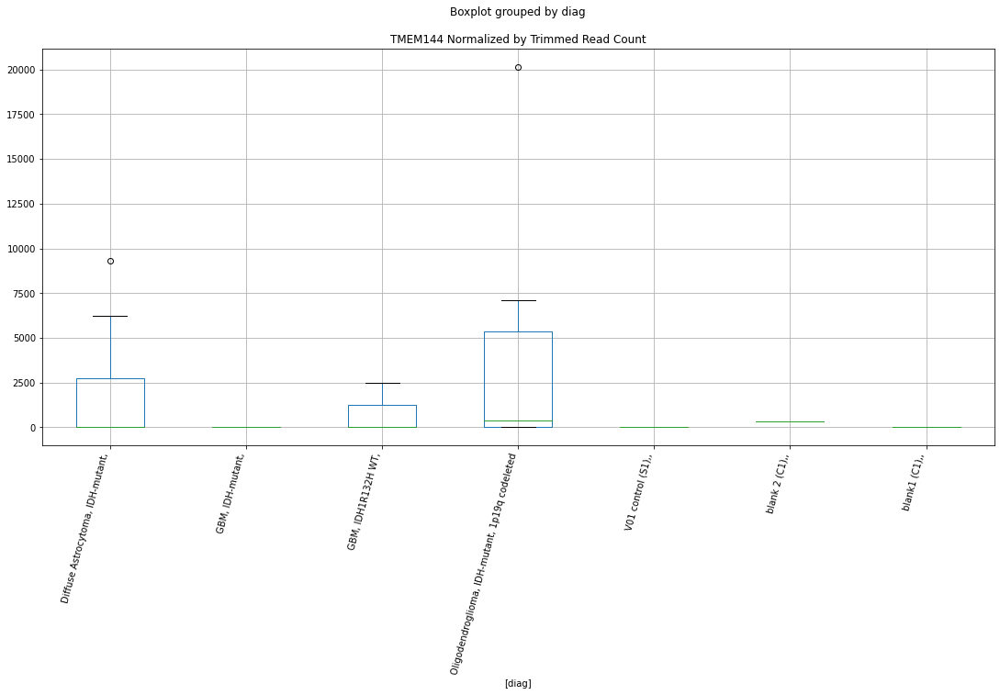

 p : 0.038722788335650654  ( t : 2.2299307488254687 ) :  D-plex  :  bbduk2  :  TMEM177
Control and blanks
73     0.0
337    0.0
Name: TMEM177, dtype: float64
205    0.0
Name: TMEM177, dtype: float64
469    591.53
Name: TMEM177, dtype: float64


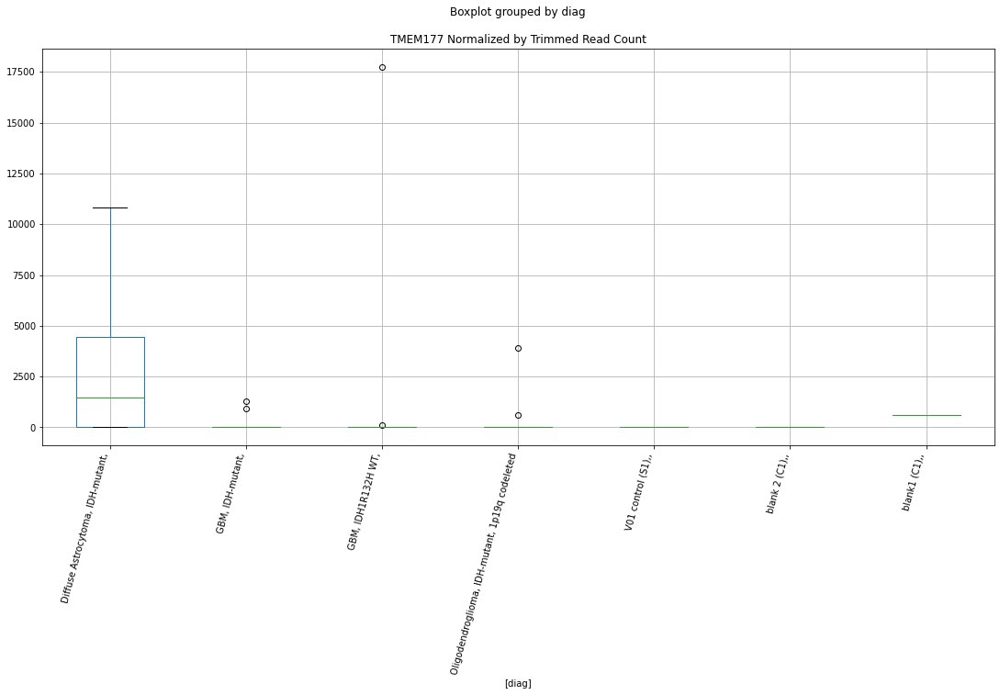

 p : 0.03873080170638457  ( t : 2.2298274087899603 ) :  Lexogen  :  bbduk2  :  TGM1
Control and blanks
79     0.0
343    0.0
Name: TGM1, dtype: float64
211    0.0
Name: TGM1, dtype: float64
475    0.0
Name: TGM1, dtype: float64


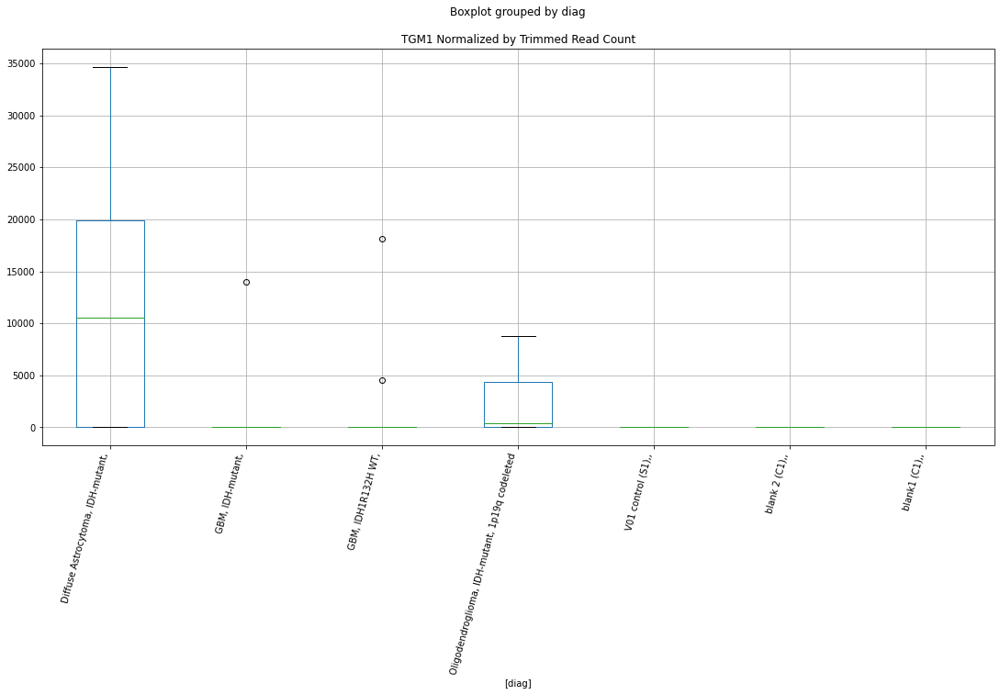

 p : 0.038796408108891144  ( t : 2.228982091679367 ) :  D-plex  :  bbduk2  :  TFB1M
Control and blanks
73     773.01
337      0.00
Name: TFB1M, dtype: float64
205    76830.02
Name: TFB1M, dtype: float64
469    4140.69
Name: TFB1M, dtype: float64


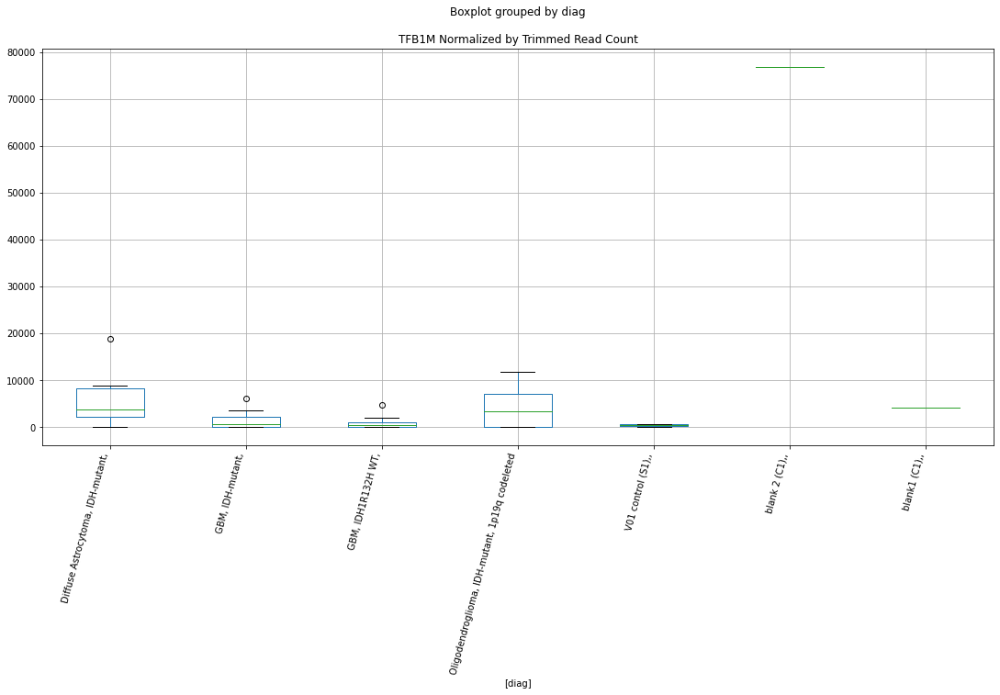

 p : 0.03885193448196658  ( t : 2.2282676804920776 ) :  D-plex  :  bbduk2  :  VPS13A
Control and blanks
73     3092.03
337       0.00
Name: VPS13A, dtype: float64
205    7163.64
Name: VPS13A, dtype: float64
469    11830.55
Name: VPS13A, dtype: float64


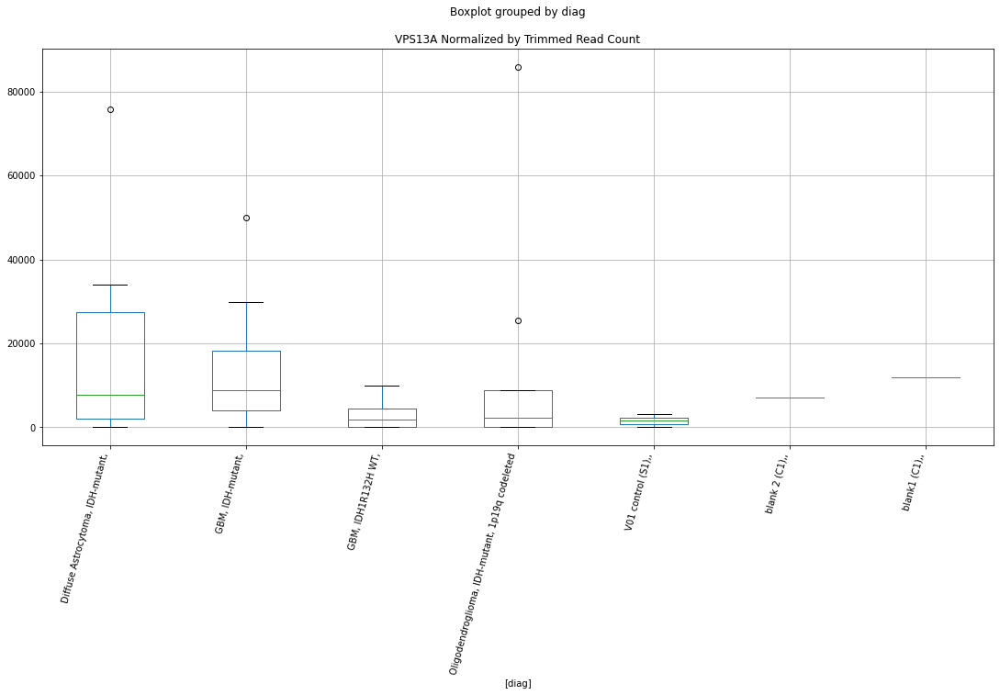

 p : 0.038974824425478845  ( t : 2.2266898962205723 ) :  D-plex  :  bbduk2  :  TCF21
Control and blanks
73     1546.02
337       0.00
Name: TCF21, dtype: float64
205    537.27
Name: TCF21, dtype: float64
469    2366.11
Name: TCF21, dtype: float64


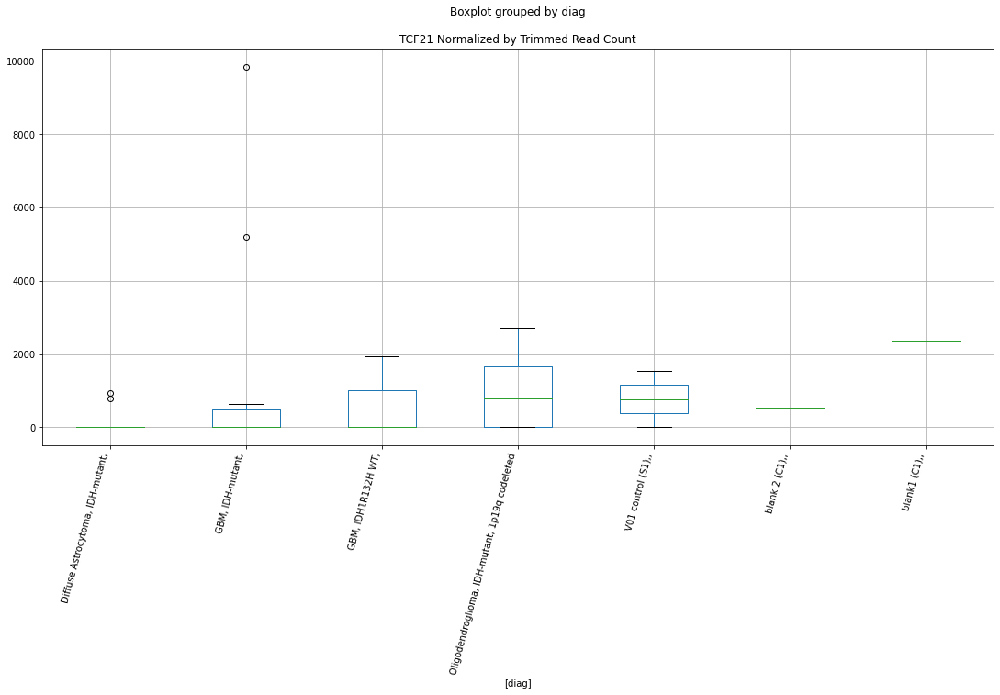

 p : 0.03908404677183811  ( t : 2.225291430497132 ) :  Lexogen  :  bbduk2  :  TFR2
Control and blanks
79         0.00
343    19108.29
Name: TFR2, dtype: float64
211    0.0
Name: TFR2, dtype: float64
475    0.0
Name: TFR2, dtype: float64


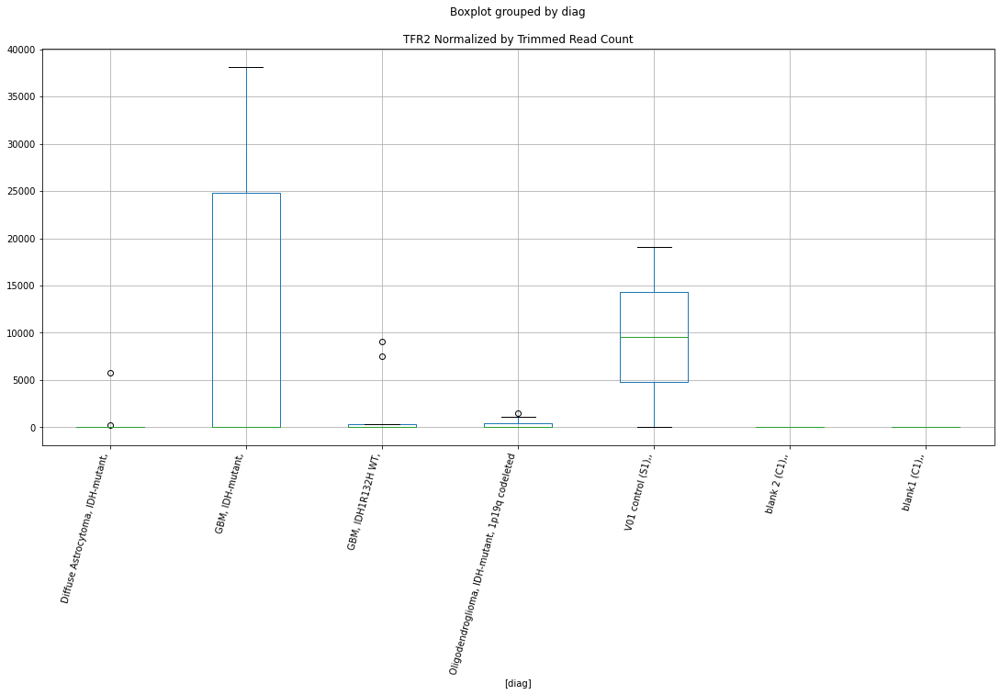

 p : 0.03914798627591662  ( t : 2.2244744279630453 ) :  Lexogen  :  bbduk2  :  YBX3
Control and blanks
79     0.0
343    0.0
Name: YBX3, dtype: float64
211    0.0
Name: YBX3, dtype: float64
475    0.0
Name: YBX3, dtype: float64


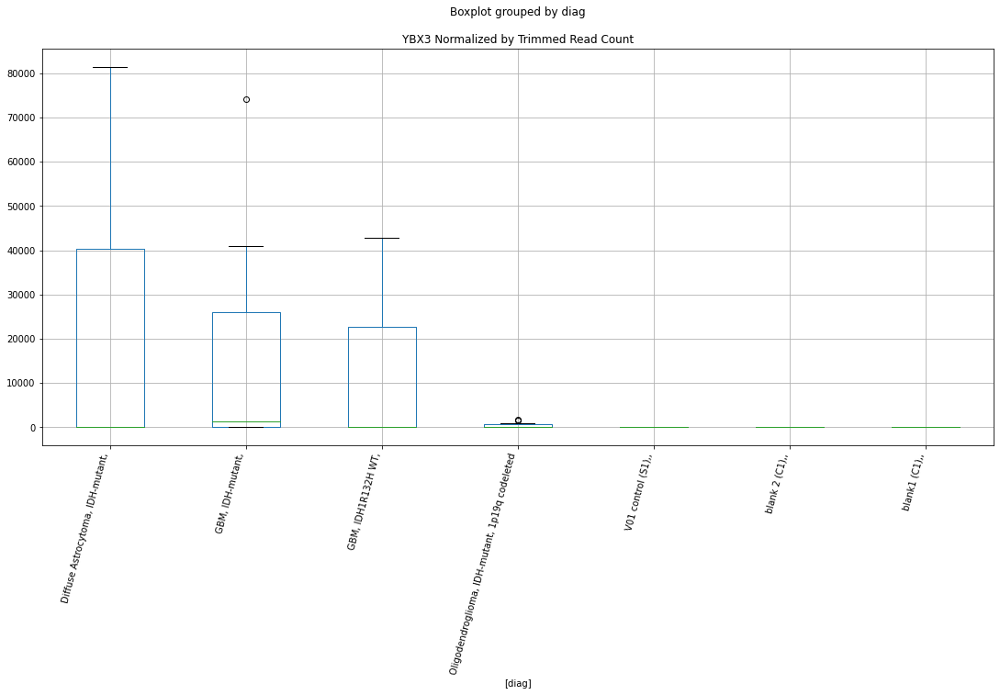

 p : 0.03917270600913837  ( t : 2.2241588948087894 ) :  Lexogen  :  cutadapt2  :  YBX3
Control and blanks
82     0.0
346    0.0
Name: YBX3, dtype: float64
214    0.0
Name: YBX3, dtype: float64
478    0.0
Name: YBX3, dtype: float64


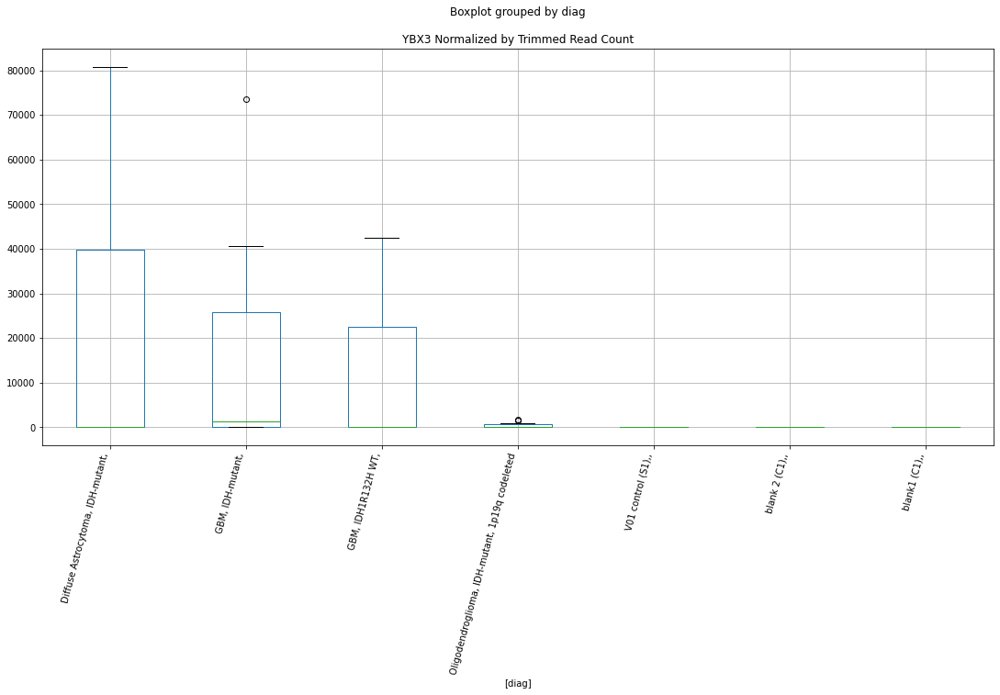

 p : 0.039185354082823025  ( t : 2.223997520314716 ) :  D-plex  :  cutadapt2  :  UNC119
Control and blanks
76     0.0
340    0.0
Name: UNC119, dtype: float64
208    1058.16
Name: UNC119, dtype: float64
472    577.96
Name: UNC119, dtype: float64


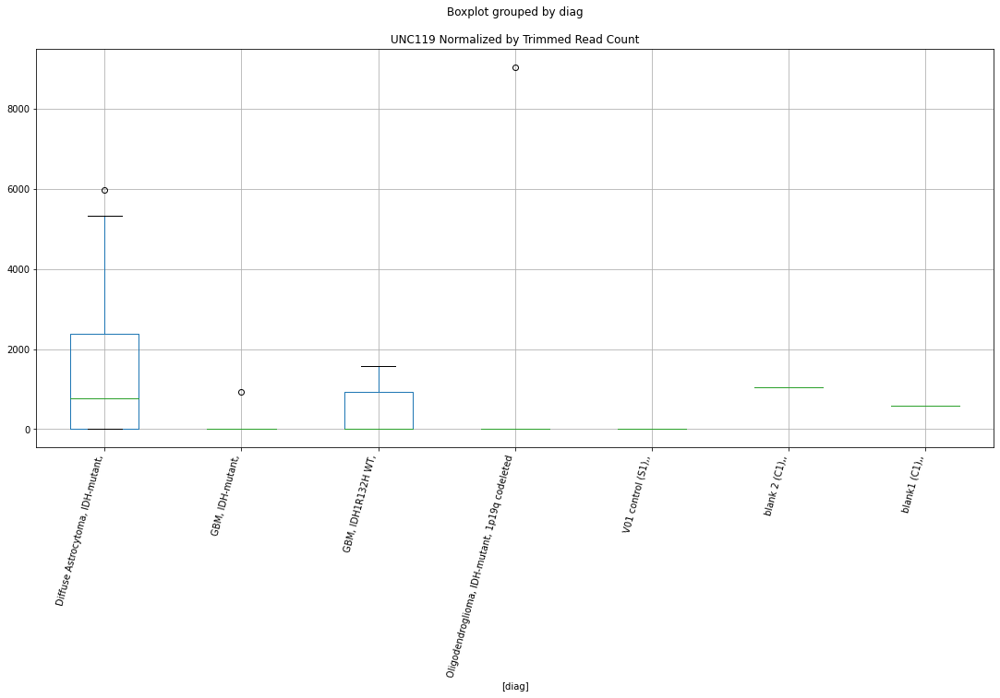

 p : 0.039206106793922044  ( t : 2.223732844063012 ) :  D-plex  :  bbduk2  :  STMP1
Control and blanks
73     773.01
337      0.00
Name: STMP1, dtype: float64
205    358.18
Name: STMP1, dtype: float64
469    0.0
Name: STMP1, dtype: float64


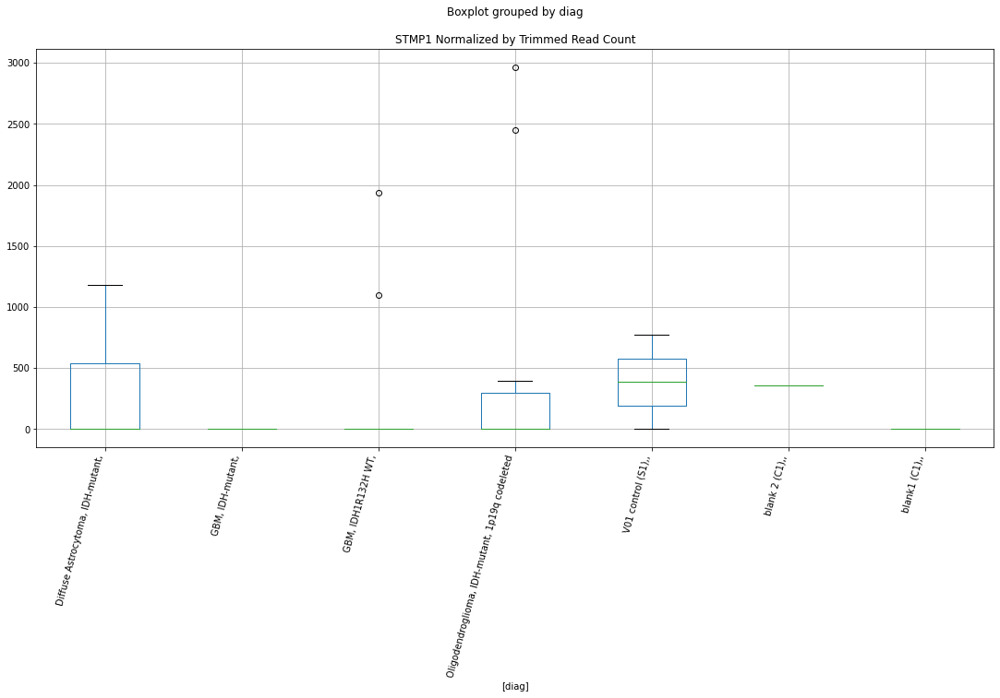

 p : 0.03921833801086328  ( t : 2.223576909774691 ) :  D-plex  :  bbduk2  :  SRGAP2
Control and blanks
73     0.0
337    0.0
Name: SRGAP2, dtype: float64
205    13969.09
Name: SRGAP2, dtype: float64
469    26027.2
Name: SRGAP2, dtype: float64


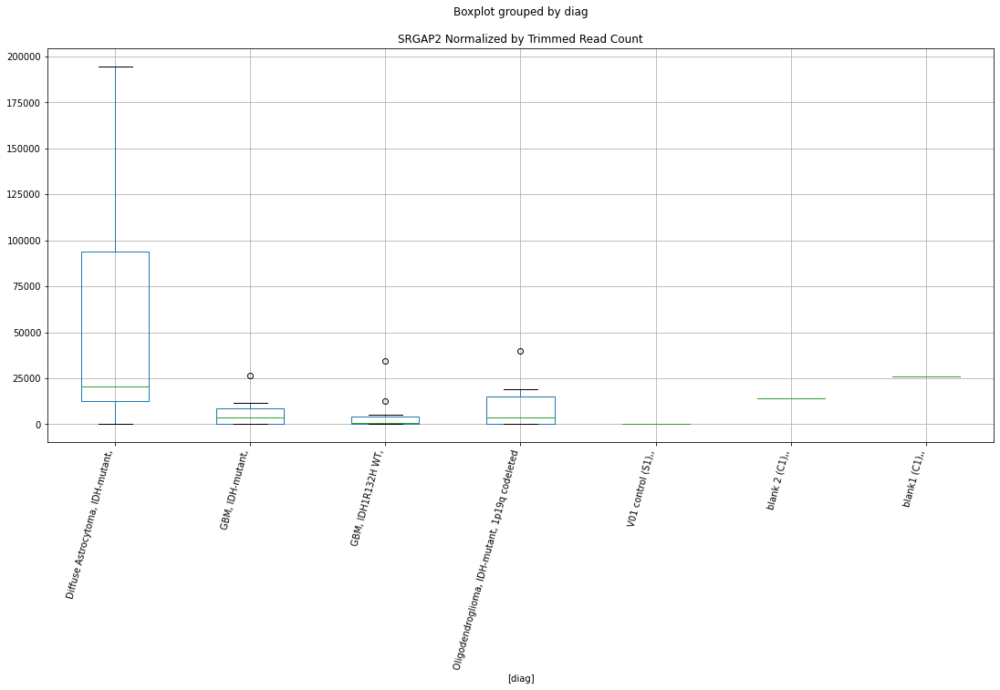

 p : 0.03923565524768254  ( t : 2.2233562109826606 ) :  Lexogen  :  cutadapt2  :  TESK2
Control and blanks
82     0.0
346    0.0
Name: TESK2, dtype: float64
214    0.0
Name: TESK2, dtype: float64
478    0.0
Name: TESK2, dtype: float64


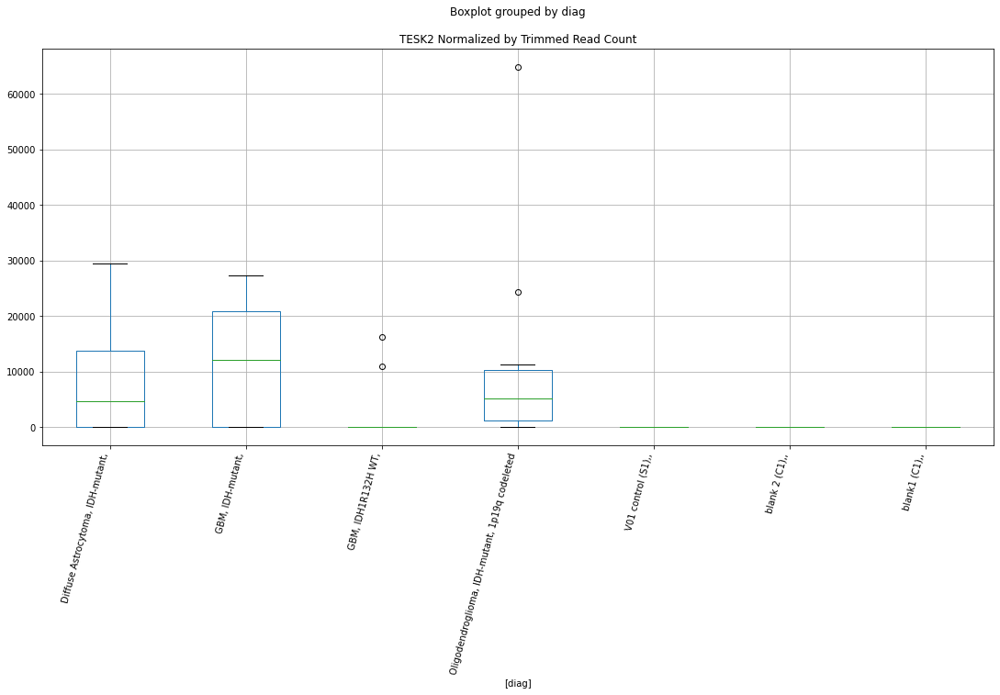

 p : 0.03927529693743668  ( t : 2.2228513365054927 ) :  Lexogen  :  cutadapt2  :  TFR2
Control and blanks
82         0.00
346    18939.11
Name: TFR2, dtype: float64
214    0.0
Name: TFR2, dtype: float64
478    0.0
Name: TFR2, dtype: float64


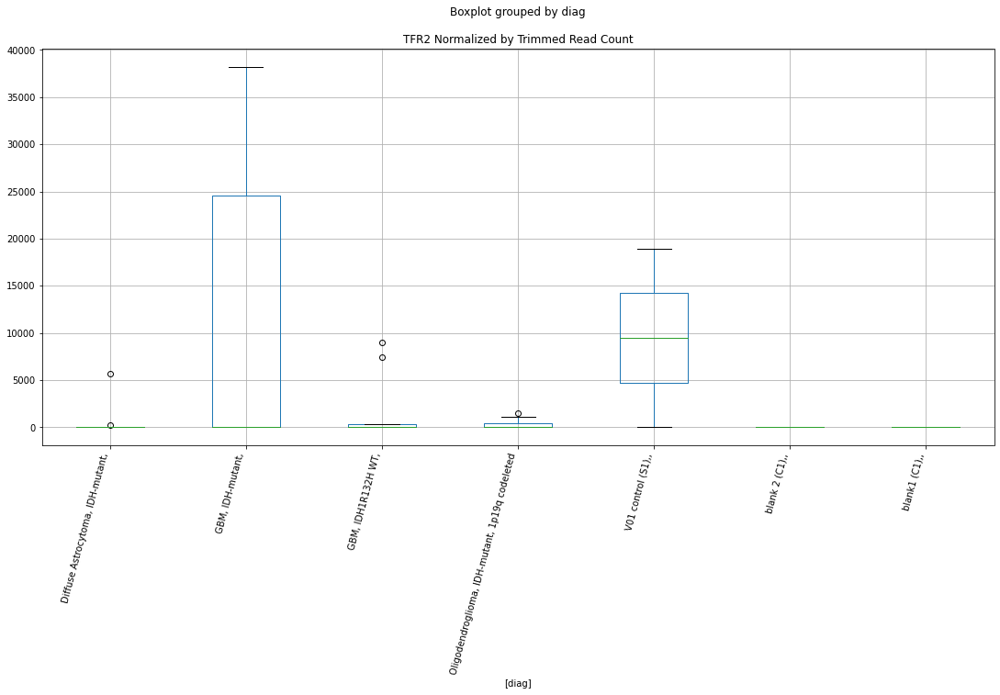

 p : 0.03932174917244608  ( t : 2.22226031978021 ) :  D-plex  :  bbduk2  :  TAGAP
Control and blanks
73     108994.18
337     74773.21
Name: TAGAP, dtype: float64
205    88650.02
Name: TAGAP, dtype: float64
469    97602.01
Name: TAGAP, dtype: float64


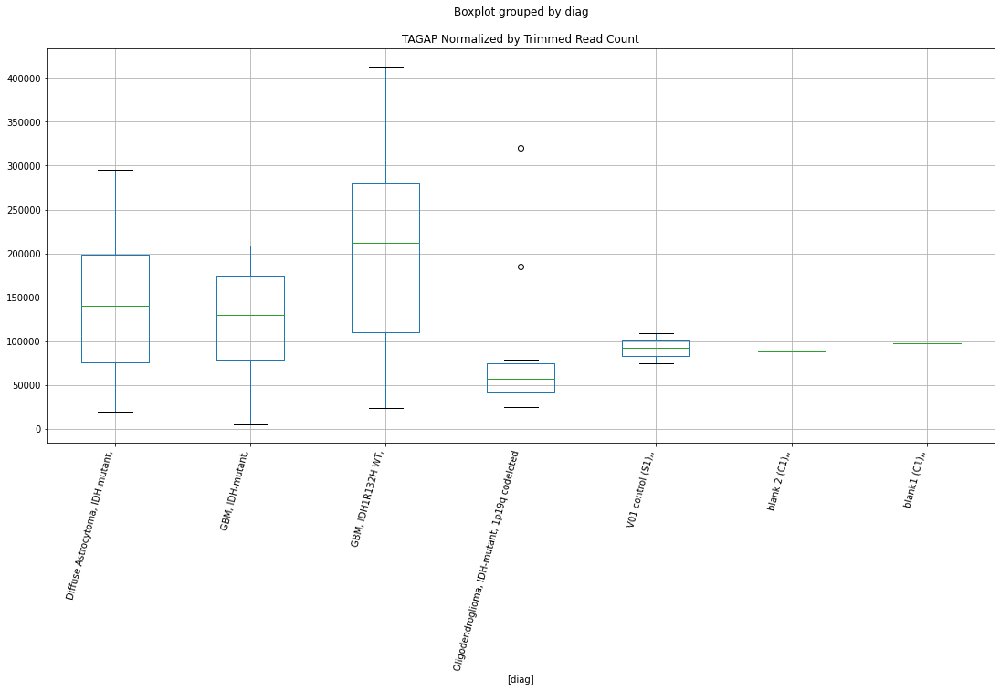

 p : 0.039373816770576026  ( t : 2.2215986215352035 ) :  D-plex  :  bbduk2  :  UNC119
Control and blanks
73     0.0
337    0.0
Name: UNC119, dtype: float64
205    1074.55
Name: UNC119, dtype: float64
469    591.53
Name: UNC119, dtype: float64


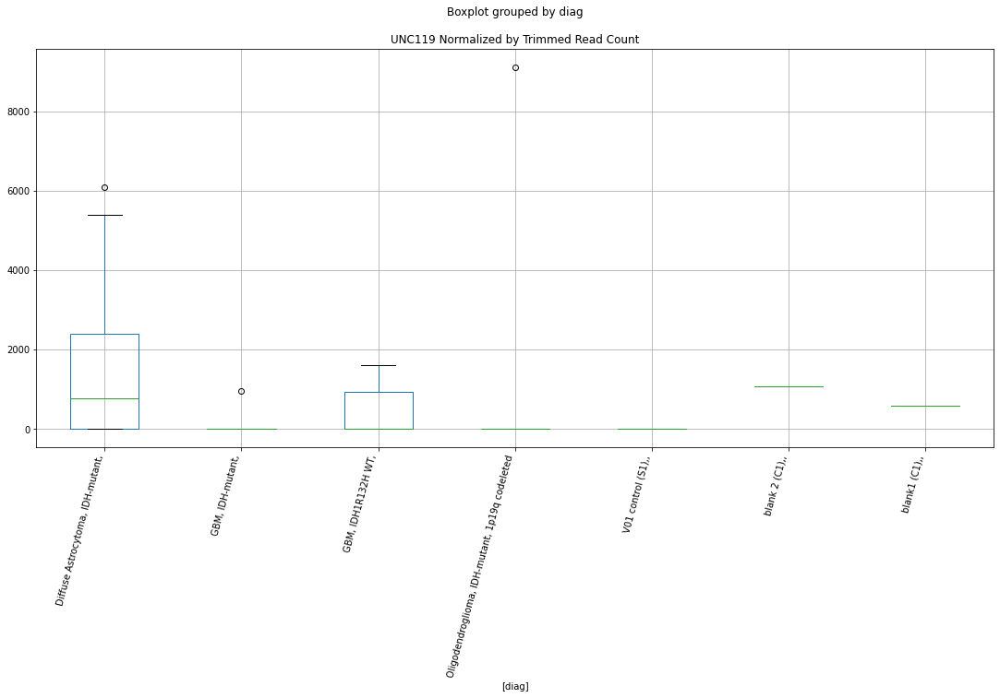

 p : 0.03943834619850206  ( t : 2.220779669389531 ) :  D-plex  :  bbduk2  :  TAB1
Control and blanks
73       0.00
337    890.16
Name: TAB1, dtype: float64
205    895.45
Name: TAB1, dtype: float64
469    1183.05
Name: TAB1, dtype: float64


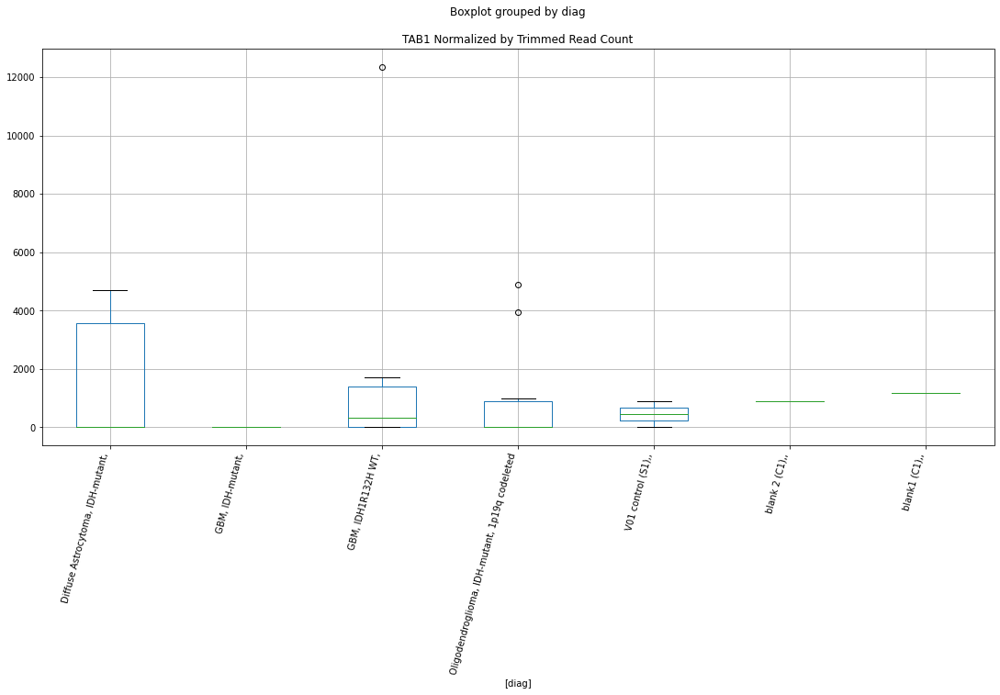

 p : 0.03949462783084201  ( t : 2.220066397357911 ) :  Lexogen  :  cutadapt2  :  WDYHV1
Control and blanks
82     0.0
346    0.0
Name: WDYHV1, dtype: float64
214    0.0
Name: WDYHV1, dtype: float64
478    0.0
Name: WDYHV1, dtype: float64


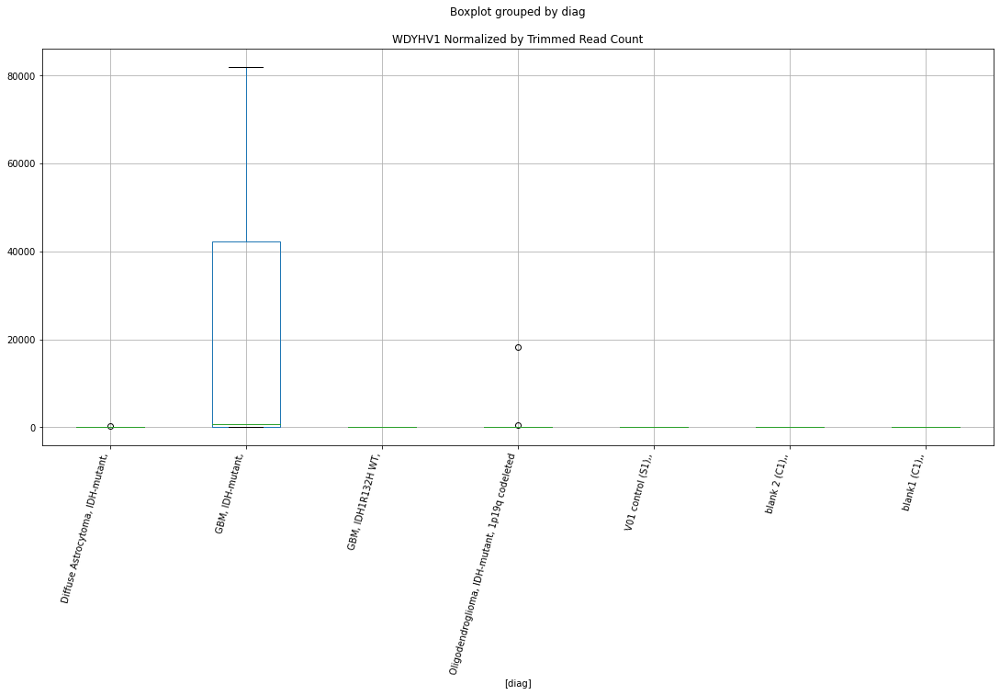

 p : 0.03953698204725717  ( t : 2.219530247680264 ) :  D-plex  :  cutadapt2  :  TAB1
Control and blanks
76       0.00
340    880.73
Name: TAB1, dtype: float64
208    176.36
Name: TAB1, dtype: float64
472    1155.91
Name: TAB1, dtype: float64


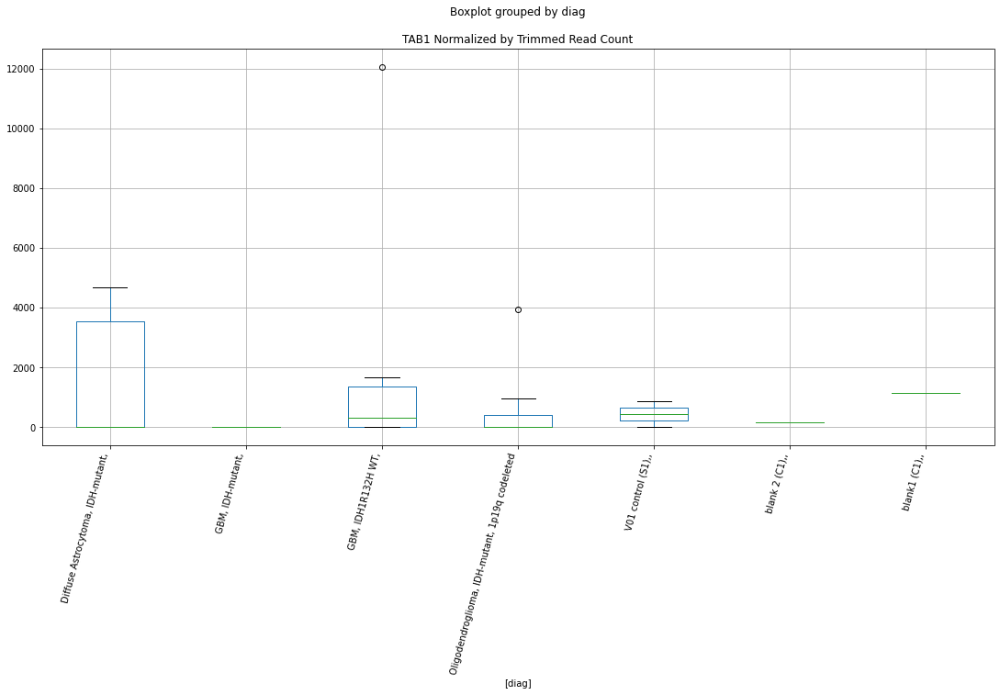

 p : 0.03957949405529539  ( t : 2.2189926317503694 ) :  Lexogen  :  bbduk2  :  WDYHV1
Control and blanks
79     0.0
343    0.0
Name: WDYHV1, dtype: float64
211    0.0
Name: WDYHV1, dtype: float64
475    0.0
Name: WDYHV1, dtype: float64


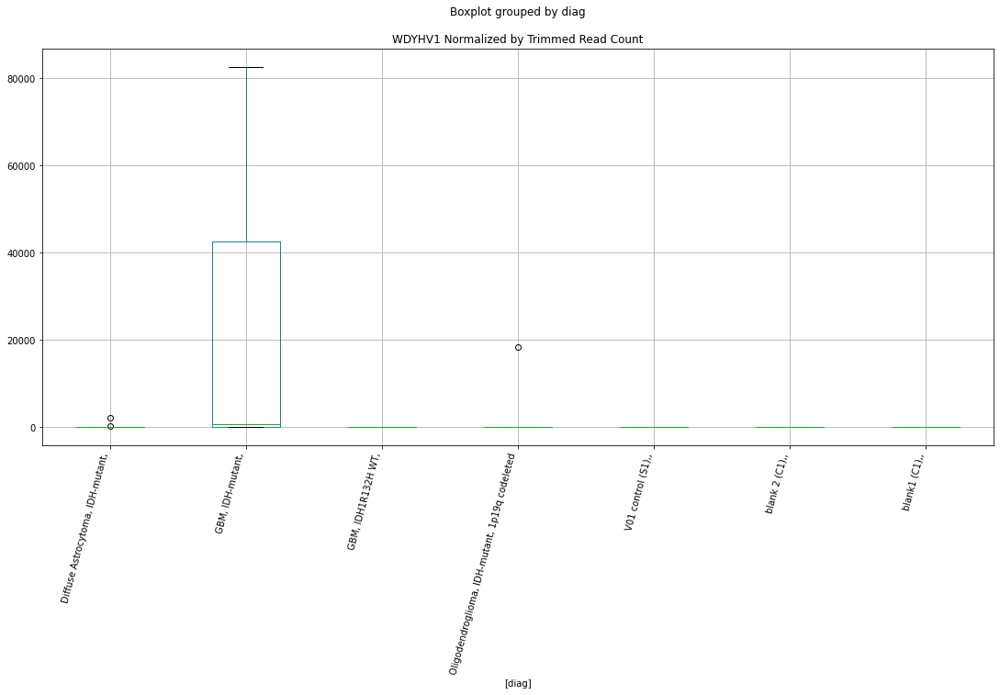

 p : 0.03963059619546637  ( t : 2.218347085925885 ) :  Lexogen  :  bbduk2  :  SYMPK
Control and blanks
79     0.0
343    0.0
Name: SYMPK, dtype: float64
211    0.0
Name: SYMPK, dtype: float64
475    0.0
Name: SYMPK, dtype: float64


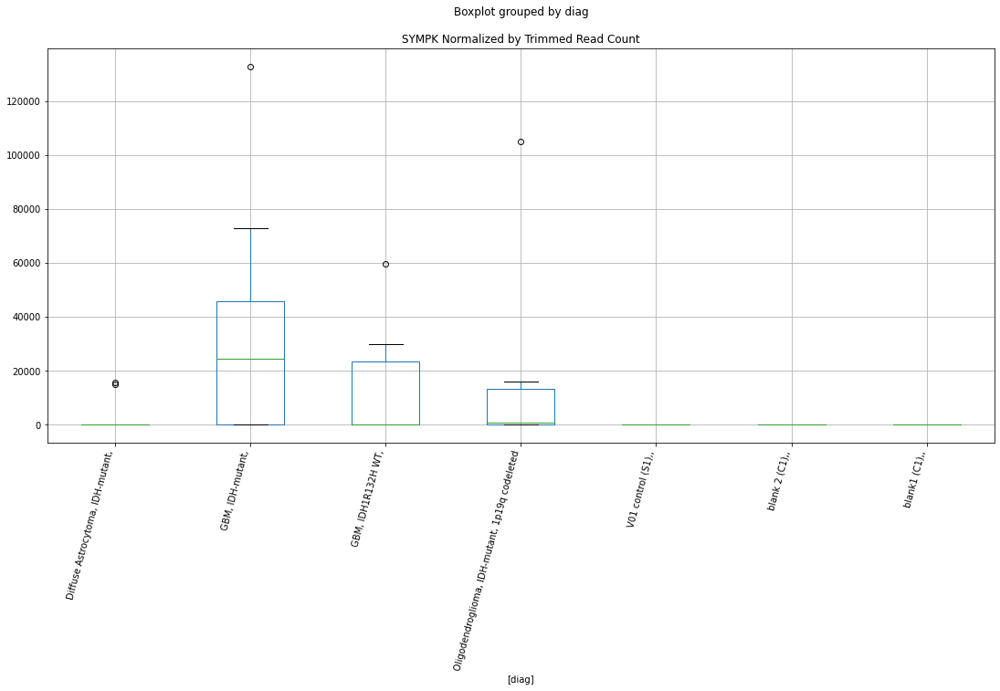

 p : 0.039678444225354326  ( t : 2.2177433414026866 ) :  Lexogen  :  cutadapt2  :  WDYHV1
Control and blanks
82     0.0
346    0.0
Name: WDYHV1, dtype: float64
214    0.0
Name: WDYHV1, dtype: float64
478    0.0
Name: WDYHV1, dtype: float64


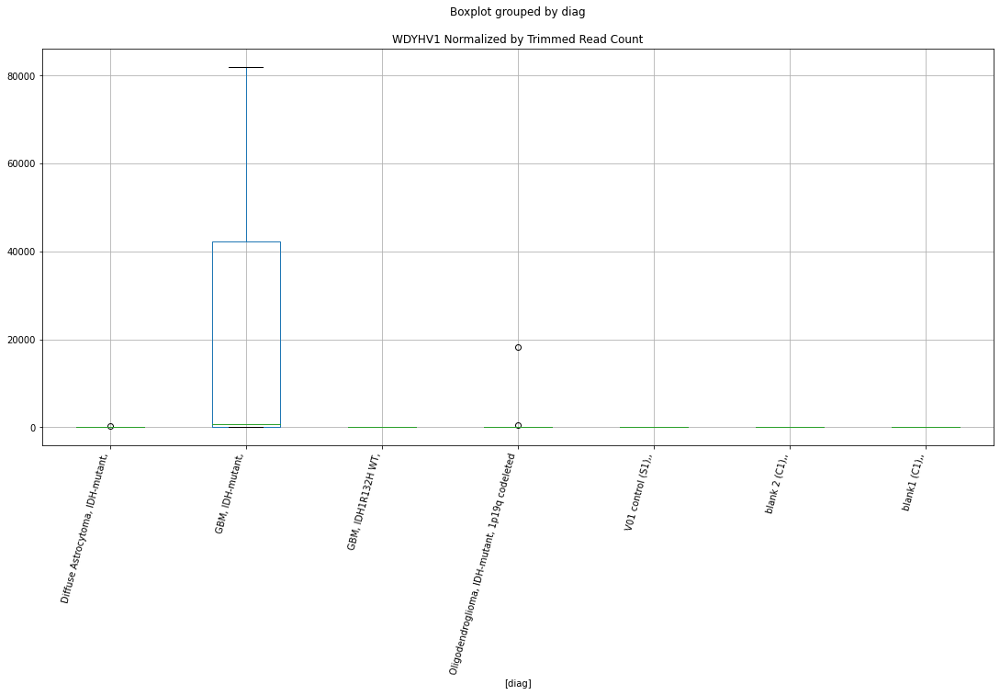

 p : 0.03973375706589976  ( t : 2.217046240329857 ) :  D-plex  :  bbduk2  :  TRIM4
Control and blanks
73     0.0
337    0.0
Name: TRIM4, dtype: float64
205    358.18
Name: TRIM4, dtype: float64
469    0.0
Name: TRIM4, dtype: float64


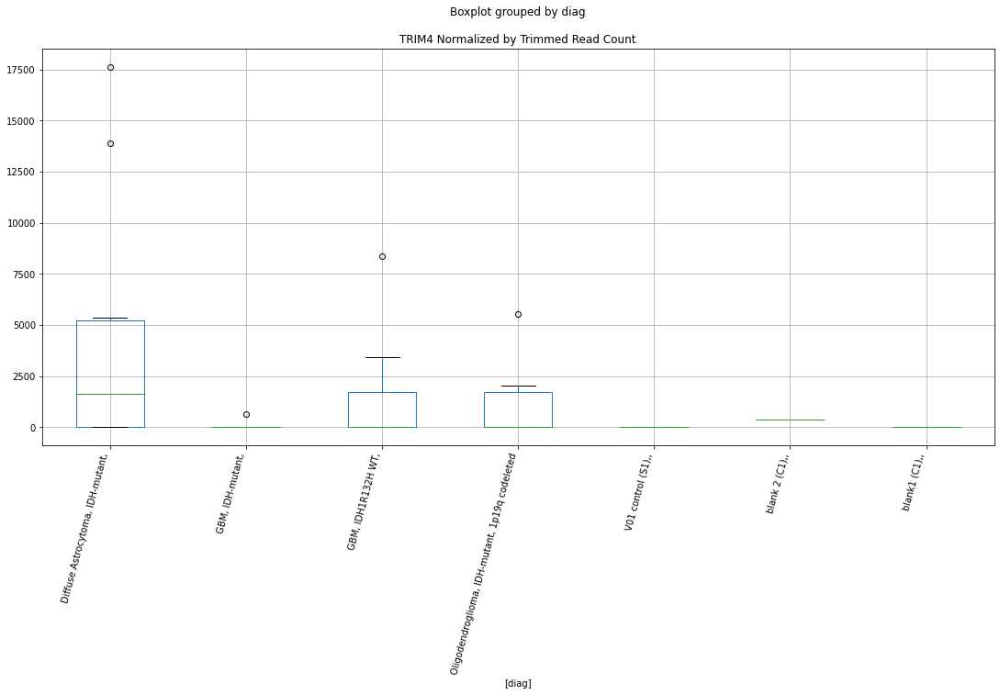

 p : 0.039739797114908  ( t : 2.216970172392672 ) :  Lexogen  :  cutadapt2  :  WSCD1
Control and blanks
82     0.0
346    0.0
Name: WSCD1, dtype: float64
214    0.0
Name: WSCD1, dtype: float64
478    0.0
Name: WSCD1, dtype: float64


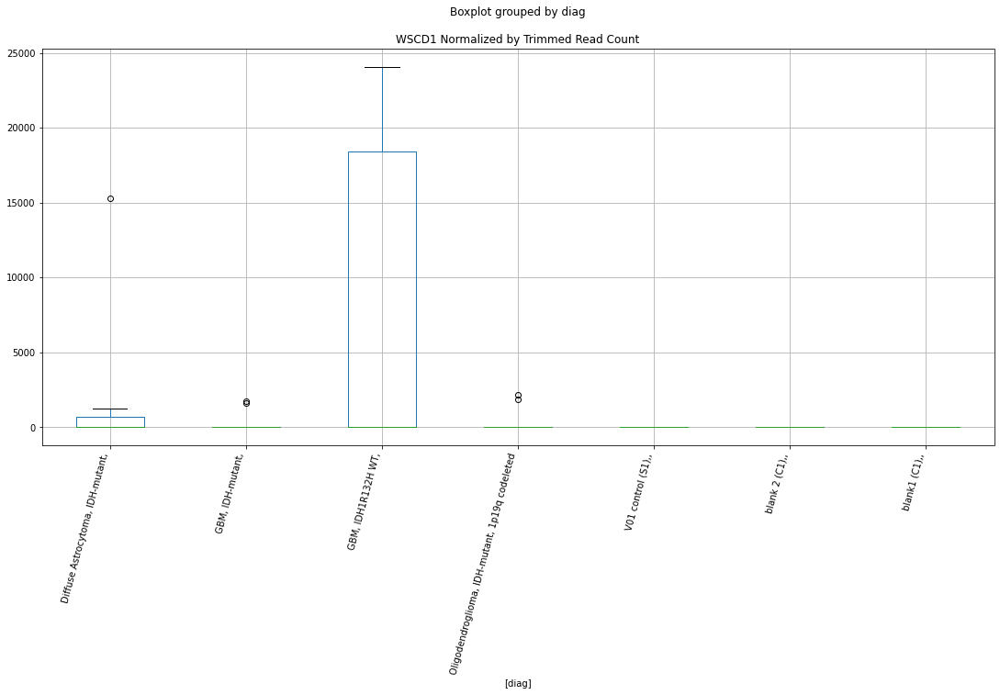

 p : 0.039755070910862236  ( t : 2.2167778627617536 ) :  Lexogen  :  bbduk2  :  WSCD1
Control and blanks
79     0.0
343    0.0
Name: WSCD1, dtype: float64
211    0.0
Name: WSCD1, dtype: float64
475    0.0
Name: WSCD1, dtype: float64


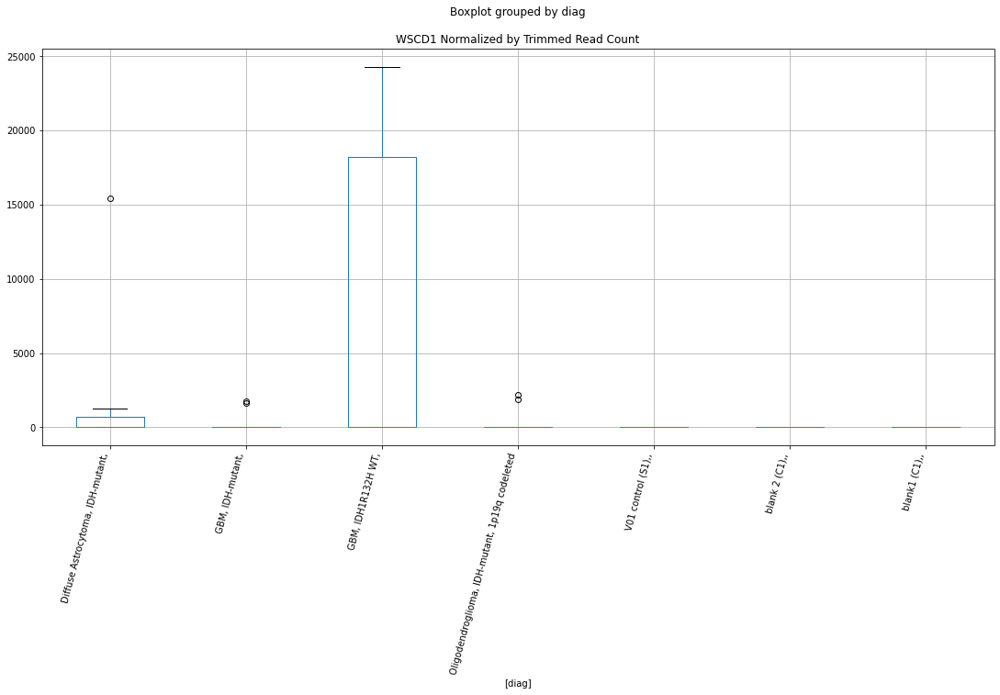

 p : 0.03981155314313829  ( t : 2.216067294977291 ) :  Lexogen  :  cutadapt2  :  TSC22D2
Control and blanks
82       0.0
346    631.3
Name: TSC22D2, dtype: float64
214    1084.91
Name: TSC22D2, dtype: float64
478    0.0
Name: TSC22D2, dtype: float64


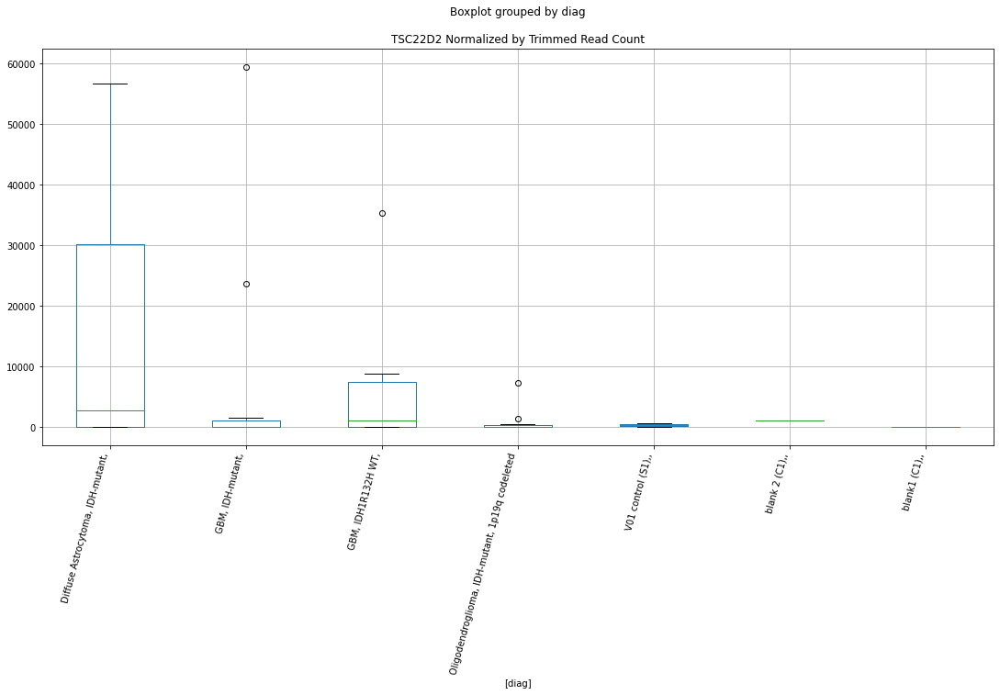

 p : 0.03991261268751575  ( t : 2.2147982384669738 ) :  D-plex  :  cutadapt2  :  TBC1D13
Control and blanks
76     0.0
340    0.0
Name: TBC1D13, dtype: float64
208    4232.65
Name: TBC1D13, dtype: float64
472    10403.21
Name: TBC1D13, dtype: float64


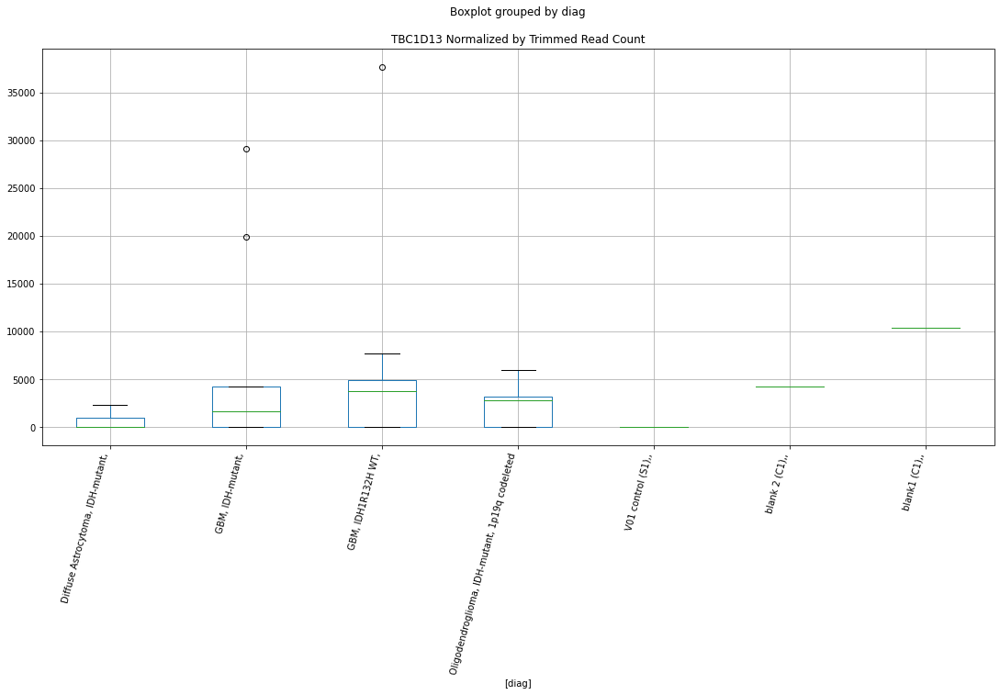

 p : 0.03993293436426787  ( t : 2.214543405700865 ) :  D-plex  :  cutadapt2  :  ZDHHC2
Control and blanks
76          0.00
340    116256.64
Name: ZDHHC2, dtype: float64
208    7407.13
Name: ZDHHC2, dtype: float64
472    12137.07
Name: ZDHHC2, dtype: float64


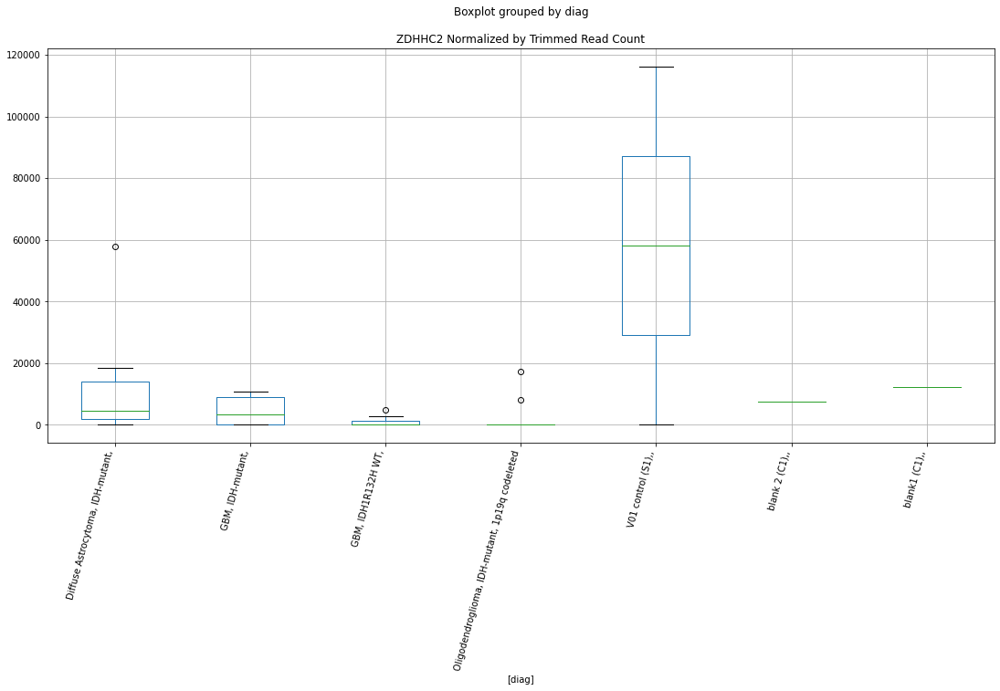

 p : 0.039947502523426666  ( t : 2.214360795133237 ) :  D-plex  :  cutadapt2  :  TF
Control and blanks
76         0.00
340    44917.34
Name: TF, dtype: float64
208    6348.97
Name: TF, dtype: float64
472    1733.87
Name: TF, dtype: float64


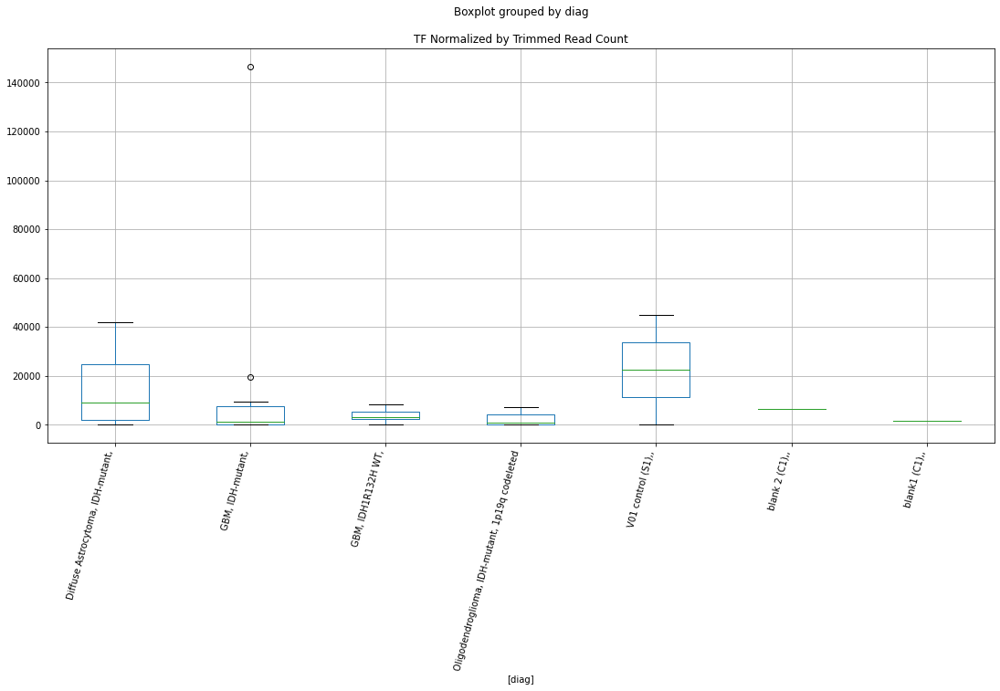

 p : 0.0399484917455409  ( t : 2.2143483975435454 ) :  D-plex  :  cutadapt2  :  ZNF619
Control and blanks
76     12879.44
340        0.00
Name: ZNF619, dtype: float64
208    4938.09
Name: ZNF619, dtype: float64
472    19650.5
Name: ZNF619, dtype: float64


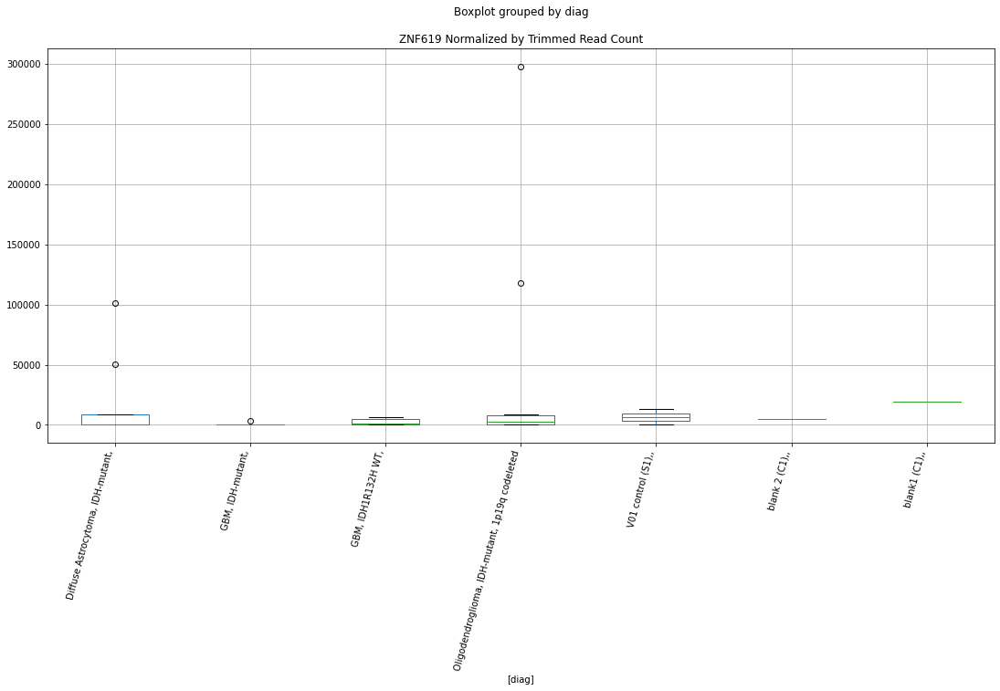

 p : 0.0399893446545193  ( t : 2.213836648141485 ) :  D-plex  :  bbduk2  :  USP48
Control and blanks
73     0.0
337    0.0
Name: USP48, dtype: float64
205    358.18
Name: USP48, dtype: float64
469    0.0
Name: USP48, dtype: float64


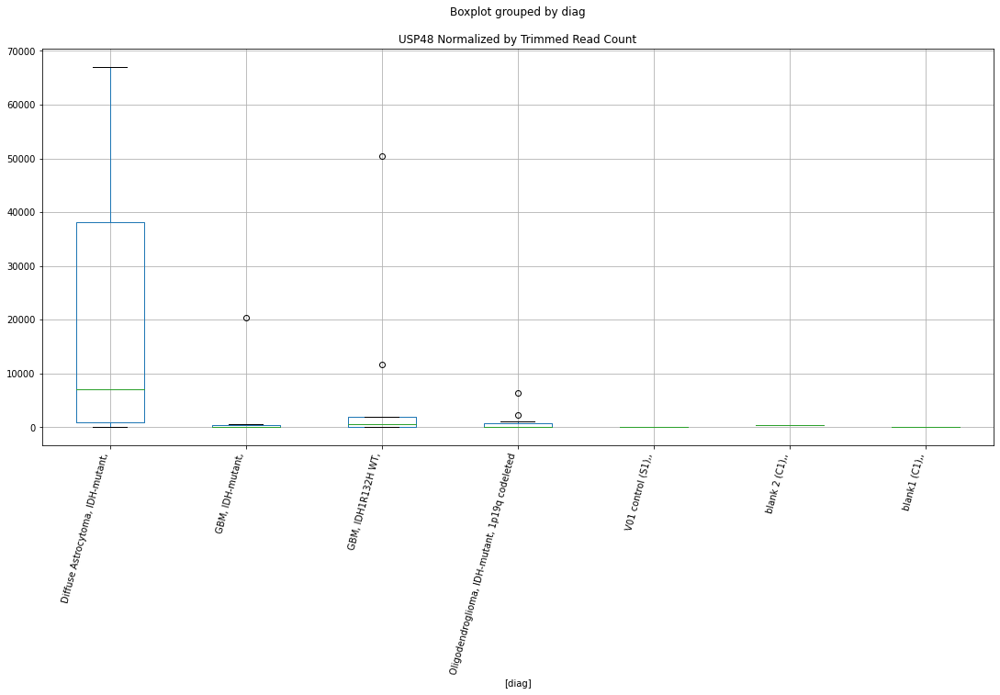

 p : 0.04001235093141634  ( t : 2.213548668529877 ) :  Lexogen  :  bbduk2  :  ZNF444
Control and blanks
79         0.00
343    46072.21
Name: ZNF444, dtype: float64
211    0.0
Name: ZNF444, dtype: float64
475    0.0
Name: ZNF444, dtype: float64


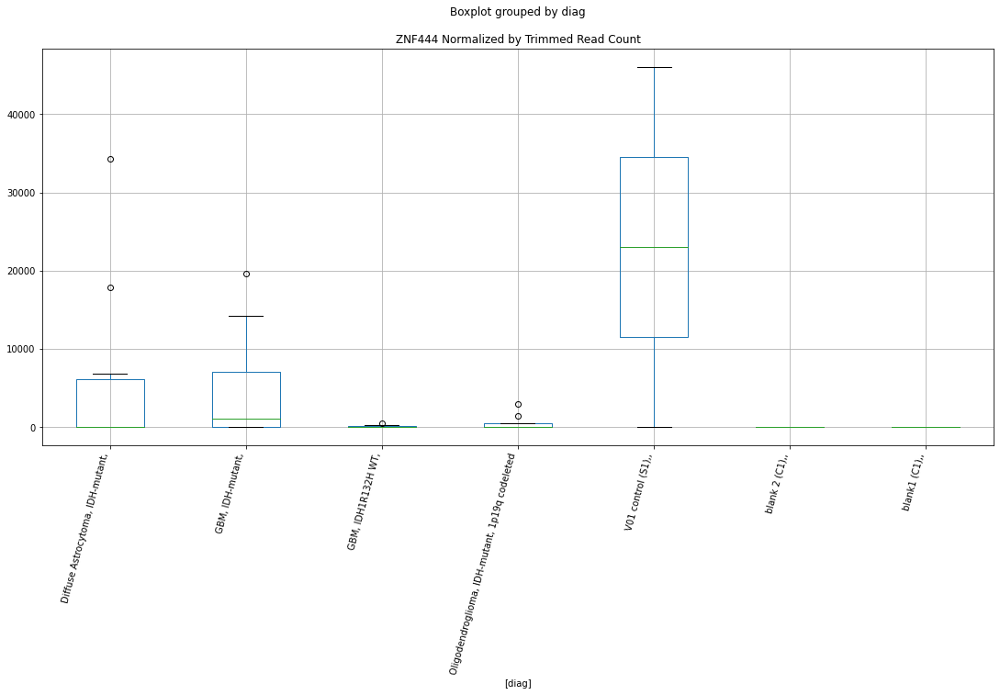

 p : 0.04003041706696763  ( t : 2.2133226335409937 ) :  D-plex  :  bbduk2  :  ZDHHC2
Control and blanks
73          0.00
337    117500.76
Name: ZDHHC2, dtype: float64
205    6447.27
Name: ZDHHC2, dtype: float64
469    12422.07
Name: ZDHHC2, dtype: float64


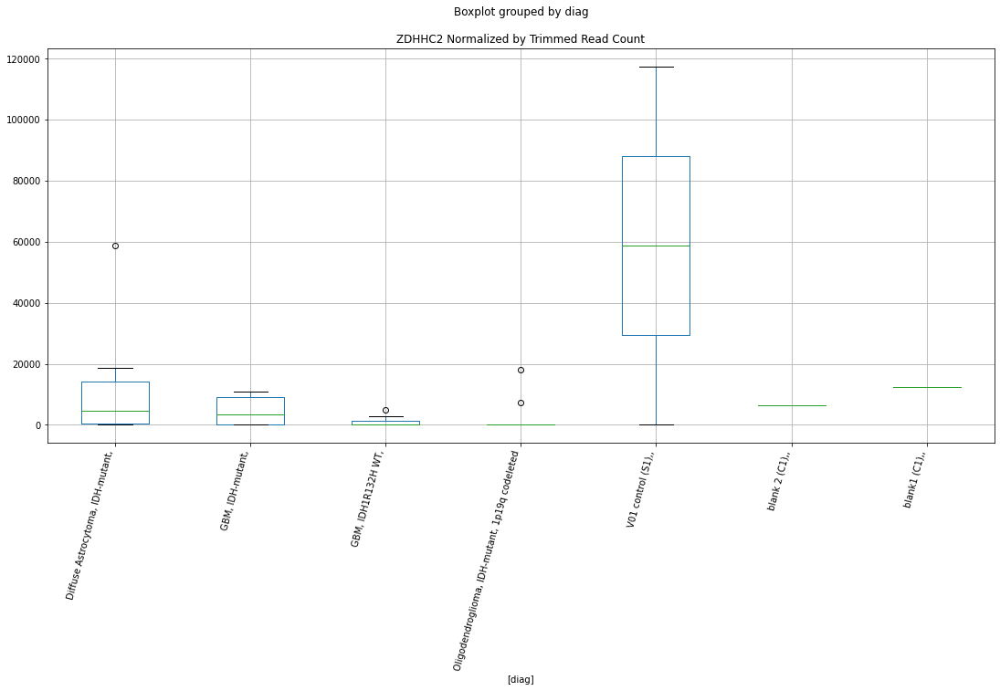

 p : 0.04007275919024414  ( t : 2.21279323617473 ) :  Lexogen  :  bbduk2  :  TMCO6
Control and blanks
79       0.00
343    424.63
Name: TMCO6, dtype: float64
211    1093.23
Name: TMCO6, dtype: float64
475    718.55
Name: TMCO6, dtype: float64


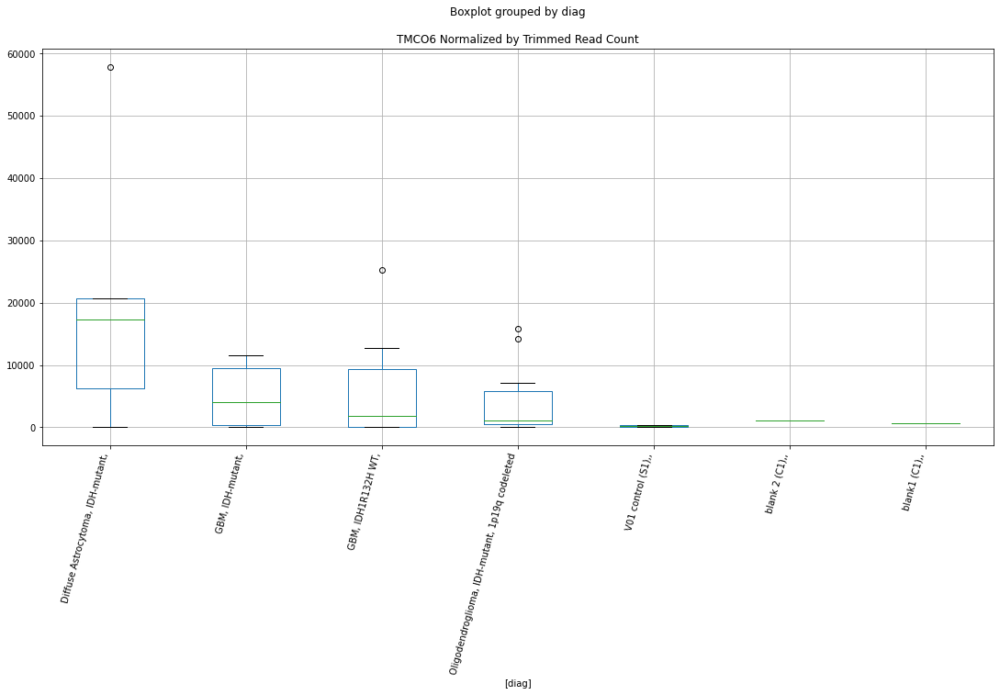

 p : 0.04008686770640215  ( t : 2.2126169537100684 ) :  Lexogen  :  cutadapt2  :  SYMPK
Control and blanks
82     0.0
346    0.0
Name: SYMPK, dtype: float64
214    0.0
Name: SYMPK, dtype: float64
478    0.0
Name: SYMPK, dtype: float64


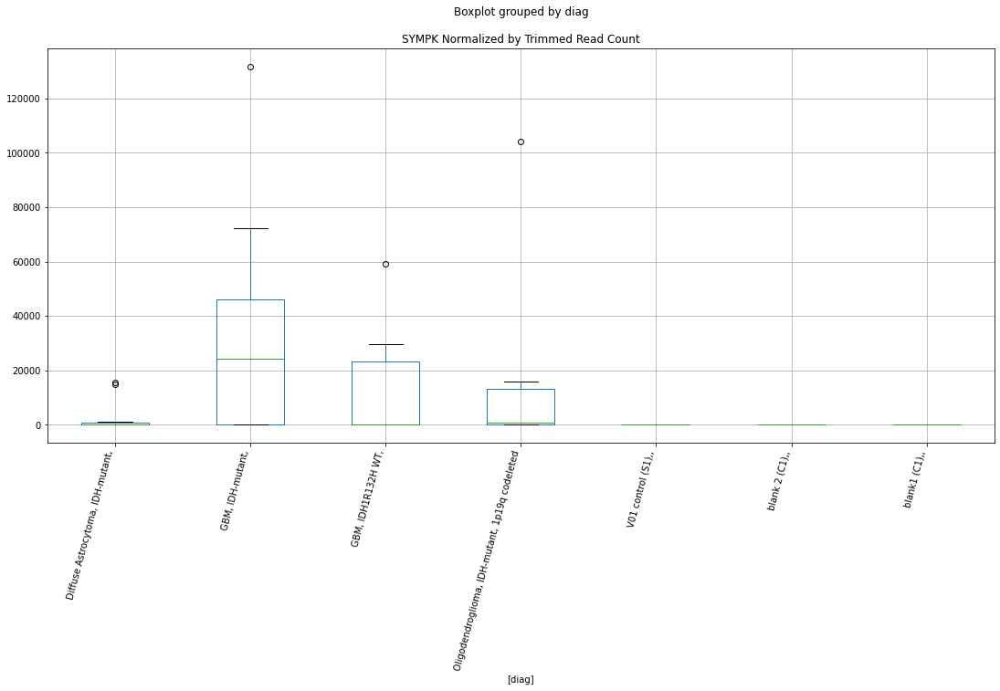

 p : 0.040109929916938444  ( t : 2.212328919829162 ) :  D-plex  :  bbduk2  :  TMEM230
Control and blanks
73       9276.10
337    534094.36
Name: TMEM230, dtype: float64
205    37967.28
Name: TMEM230, dtype: float64
469    33125.53
Name: TMEM230, dtype: float64


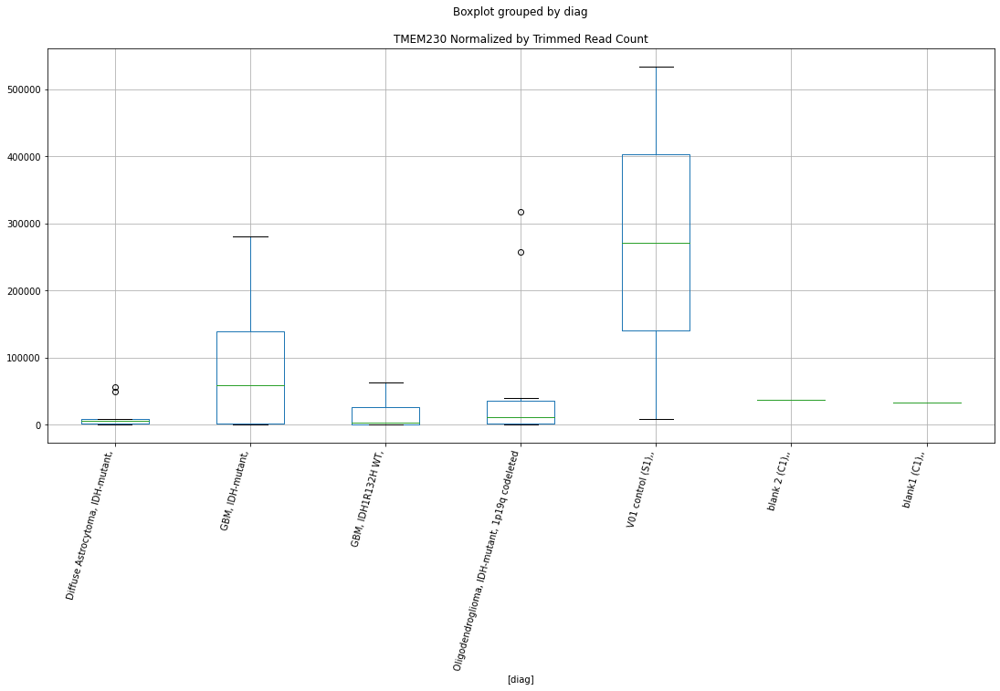

 p : 0.04014004908975375  ( t : 2.211952977726617 ) :  D-plex  :  cutadapt2  :  ZNF362
Control and blanks
76     0.0
340    0.0
Name: ZNF362, dtype: float64
208    4232.65
Name: ZNF362, dtype: float64
472    4623.65
Name: ZNF362, dtype: float64


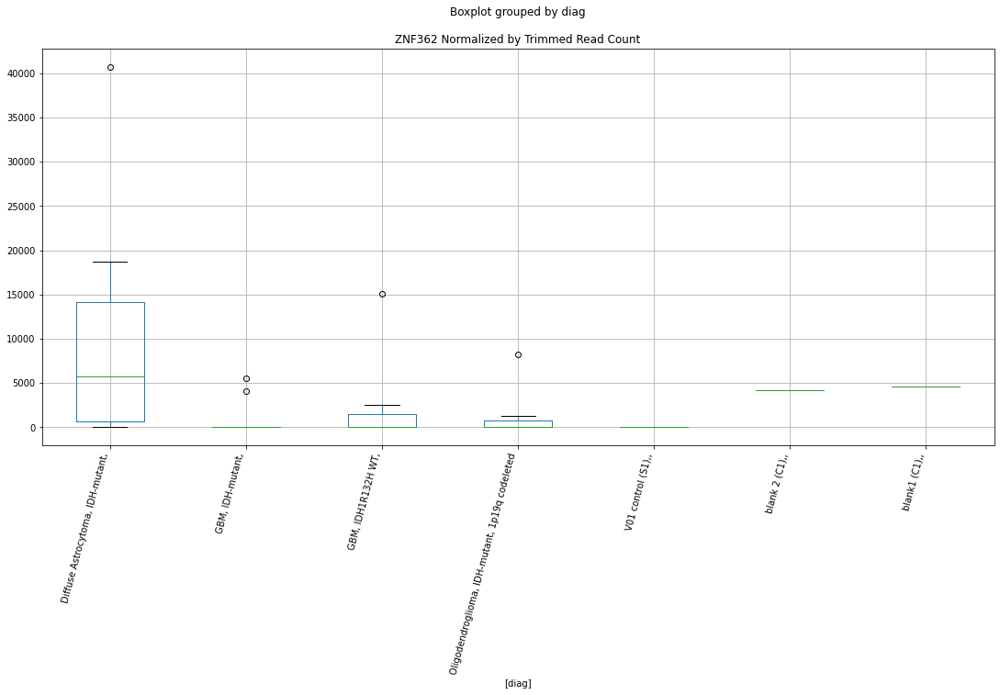

 p : 0.040148547079505506  ( t : 2.211846954260263 ) :  D-plex  :  cutadapt2  :  TGIF1
Control and blanks
76     0.0
340    0.0
Name: TGIF1, dtype: float64
208    1234.52
Name: TGIF1, dtype: float64
472    4623.65
Name: TGIF1, dtype: float64


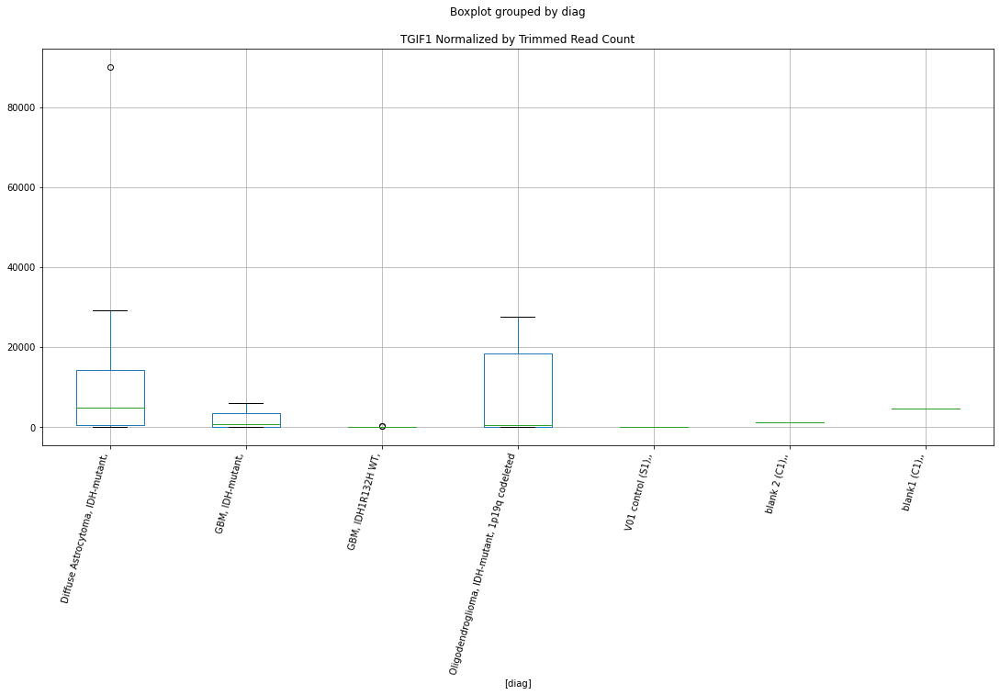

 p : 0.04019635242577834  ( t : 2.2112509046818922 ) :  Lexogen  :  cutadapt2  :  TRIM28
Control and blanks
82         0.00
346    28198.23
Name: TRIM28, dtype: float64
214    0.0
Name: TRIM28, dtype: float64
478    0.0
Name: TRIM28, dtype: float64


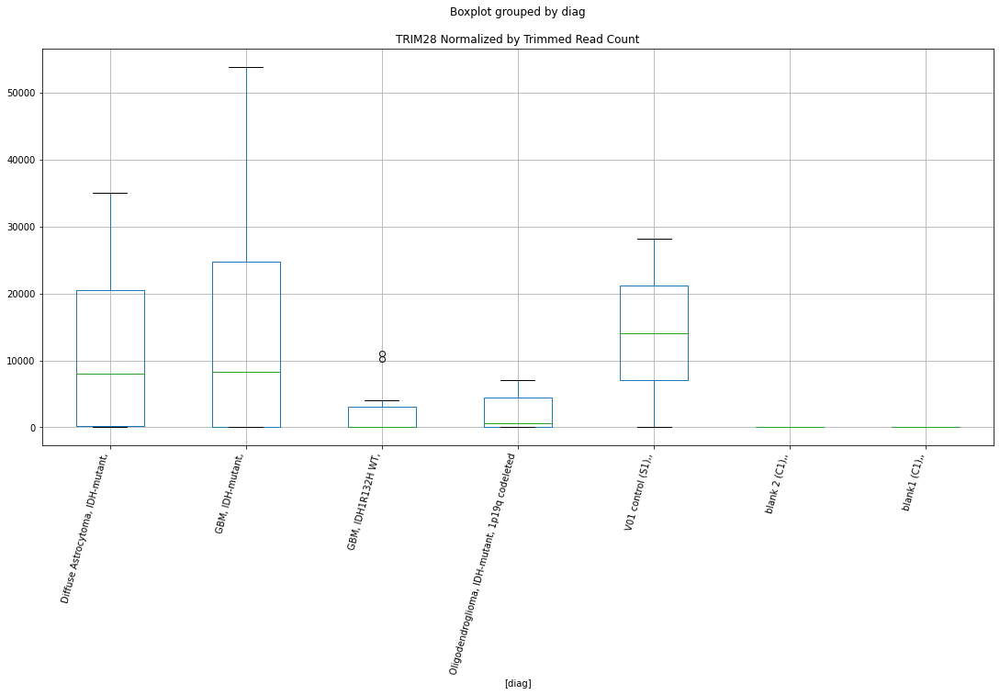

 p : 0.040225670543283326  ( t : 2.21088568105336 ) :  D-plex  :  cutadapt2  :  ZFP62
Control and blanks
76         0.00
340    11449.52
Name: ZFP62, dtype: float64
208    12521.58
Name: ZFP62, dtype: float64
472    15026.85
Name: ZFP62, dtype: float64


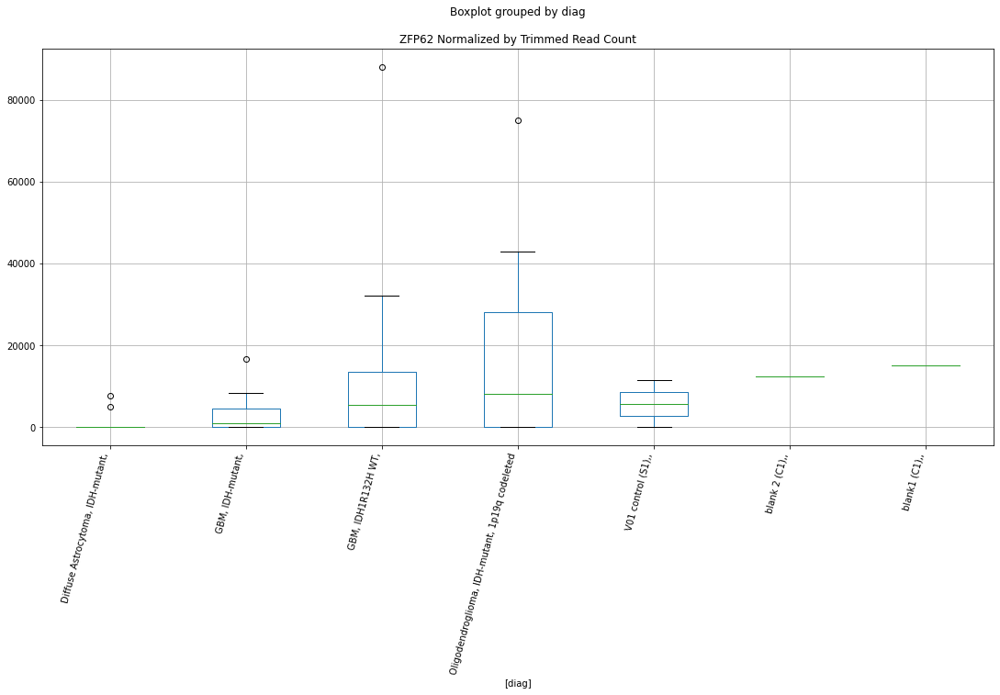

 p : 0.04027762130836083  ( t : 2.210239117092457 ) :  Lexogen  :  cutadapt2  :  SUN2
Control and blanks
82          0.00
346    290399.64
Name: SUN2, dtype: float64
214    0.0
Name: SUN2, dtype: float64
478    0.0
Name: SUN2, dtype: float64


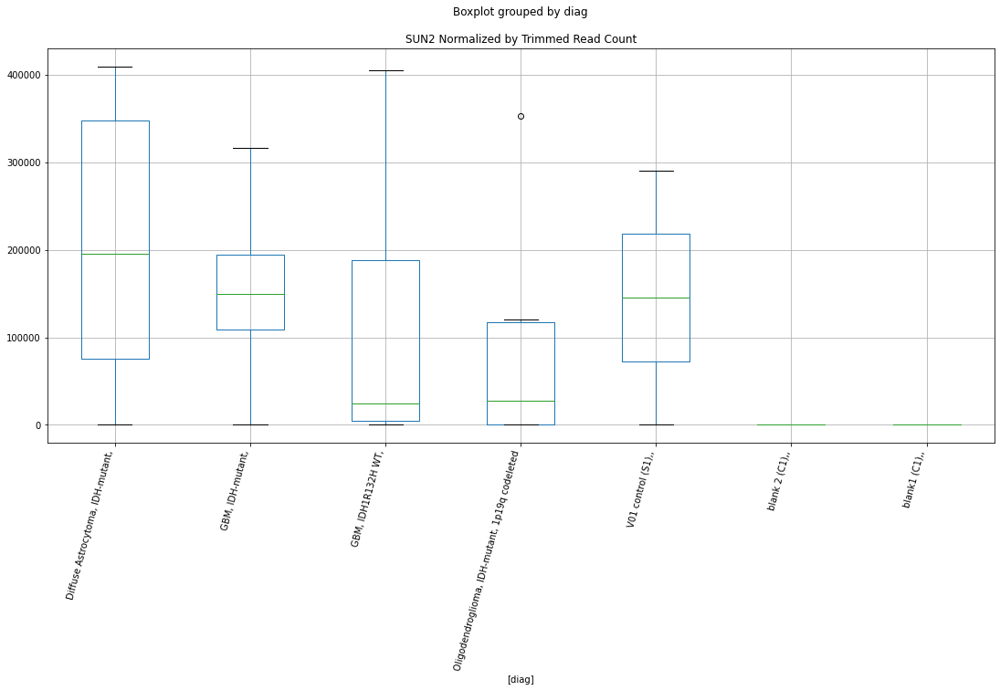

 p : 0.04040531492336047  ( t : 2.2086531321001814 ) :  D-plex  :  cutadapt2  :  TEX30
Control and blanks
76     0.0
340    0.0
Name: TEX30, dtype: float64
208    3527.2
Name: TEX30, dtype: float64
472    2311.82
Name: TEX30, dtype: float64


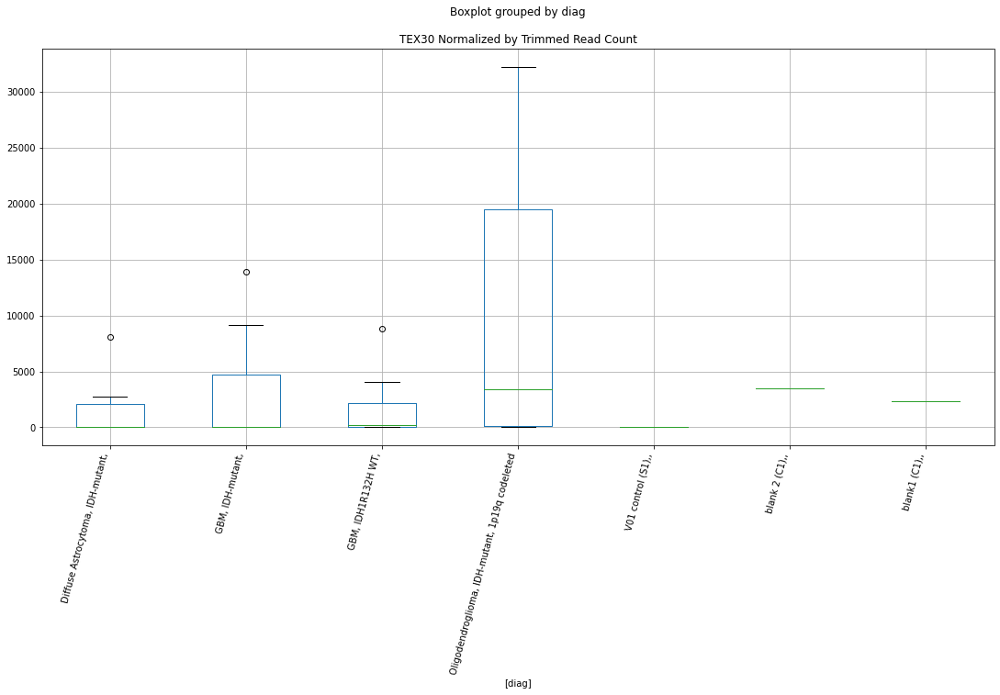

 p : 0.040451416184354314  ( t : 2.208081675258672 ) :  D-plex  :  cutadapt2  :  SPINK14
Control and blanks
76     757.61
340      0.00
Name: SPINK14, dtype: float64
208    352.72
Name: SPINK14, dtype: float64
472    577.96
Name: SPINK14, dtype: float64


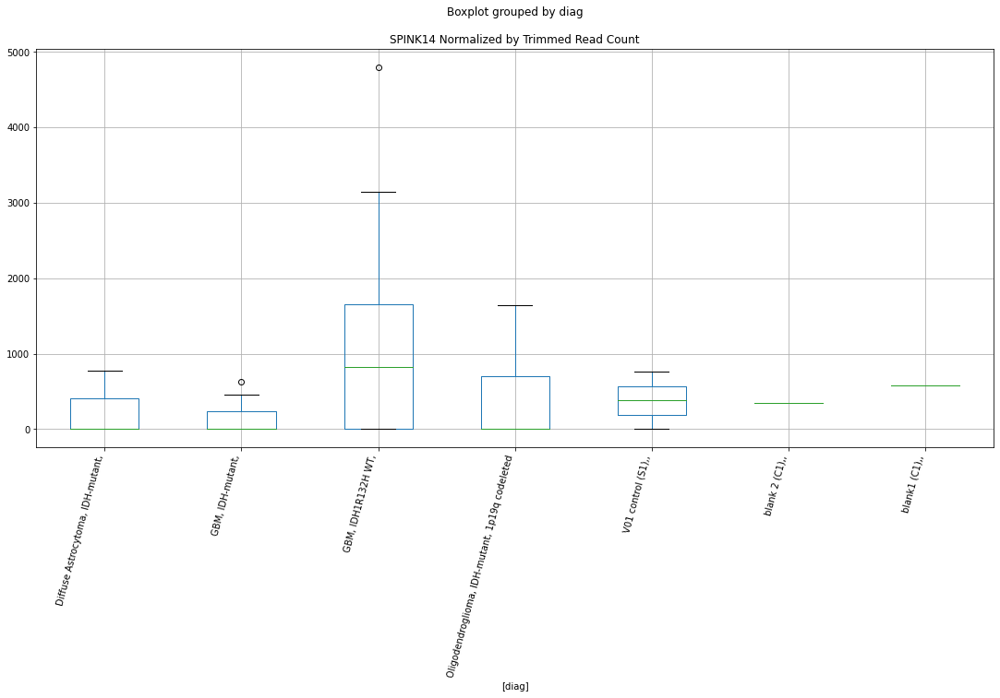

 p : 0.040479167869700294  ( t : 2.2077379625909703 ) :  D-plex  :  bbduk2  :  TMEM259
Control and blanks
73     688750.49
337     72102.74
Name: TMEM259, dtype: float64
205    678575.62
Name: TMEM259, dtype: float64
469    484460.87
Name: TMEM259, dtype: float64


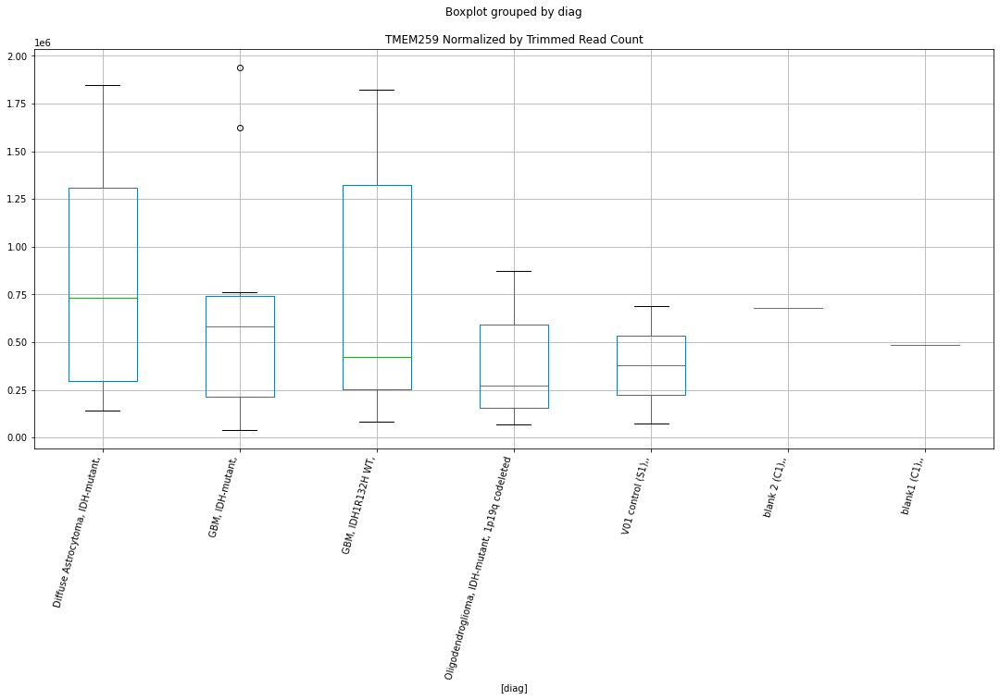

 p : 0.04053124832072555  ( t : 2.2070935152883755 ) :  D-plex  :  bbduk2  :  STK10
Control and blanks
73     63386.69
337    46288.18
Name: STK10, dtype: float64
205    3581.82
Name: STK10, dtype: float64
469    3549.16
Name: STK10, dtype: float64


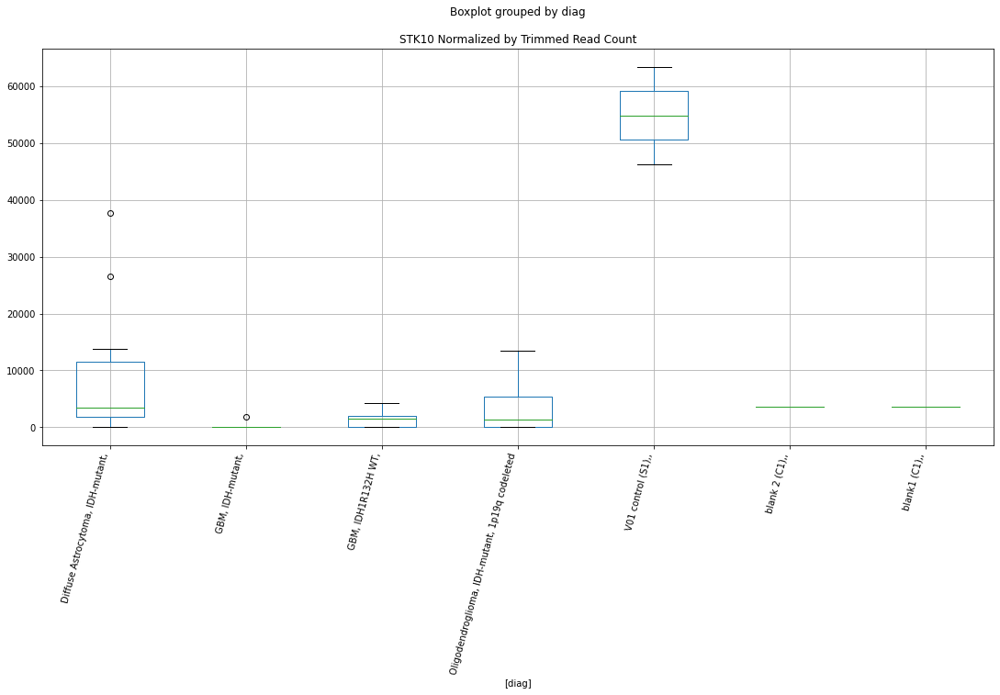

 p : 0.04059475720933102  ( t : 2.2063086807204577 ) :  D-plex  :  cutadapt2  :  SUPT3H
Control and blanks
76     0.0
340    0.0
Name: SUPT3H, dtype: float64
208    7936.21
Name: SUPT3H, dtype: float64
472    4623.65
Name: SUPT3H, dtype: float64


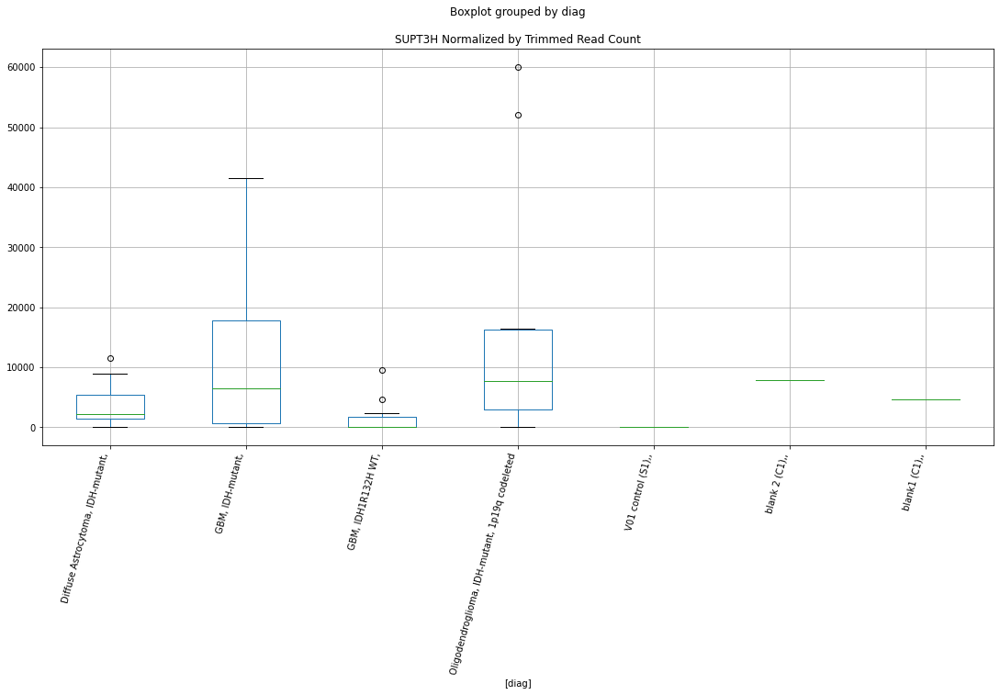

 p : 0.04065356845380784  ( t : 2.2055829046136015 ) :  Lexogen  :  bbduk2  :  TRIM28
Control and blanks
79         0.00
343    28450.12
Name: TRIM28, dtype: float64
211    0.0
Name: TRIM28, dtype: float64
475    0.0
Name: TRIM28, dtype: float64


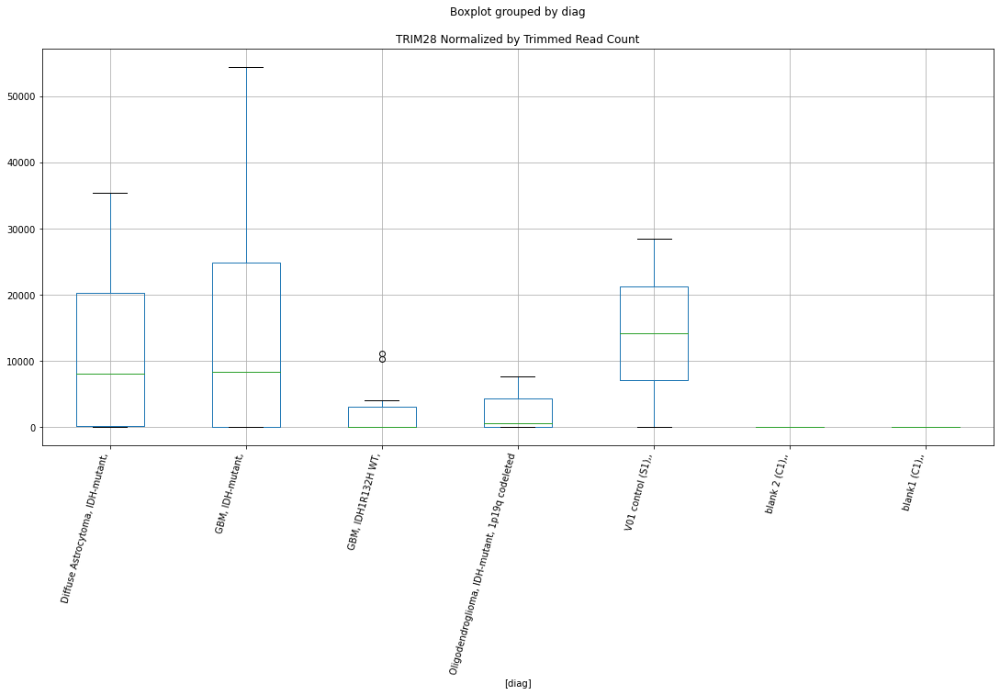

 p : 0.04067920937720022  ( t : 2.2052667778195936 ) :  Lexogen  :  bbduk2  :  TMEM178B
Control and blanks
79     0.0
343    0.0
Name: TMEM178B, dtype: float64
211    0.0
Name: TMEM178B, dtype: float64
475    0.0
Name: TMEM178B, dtype: float64


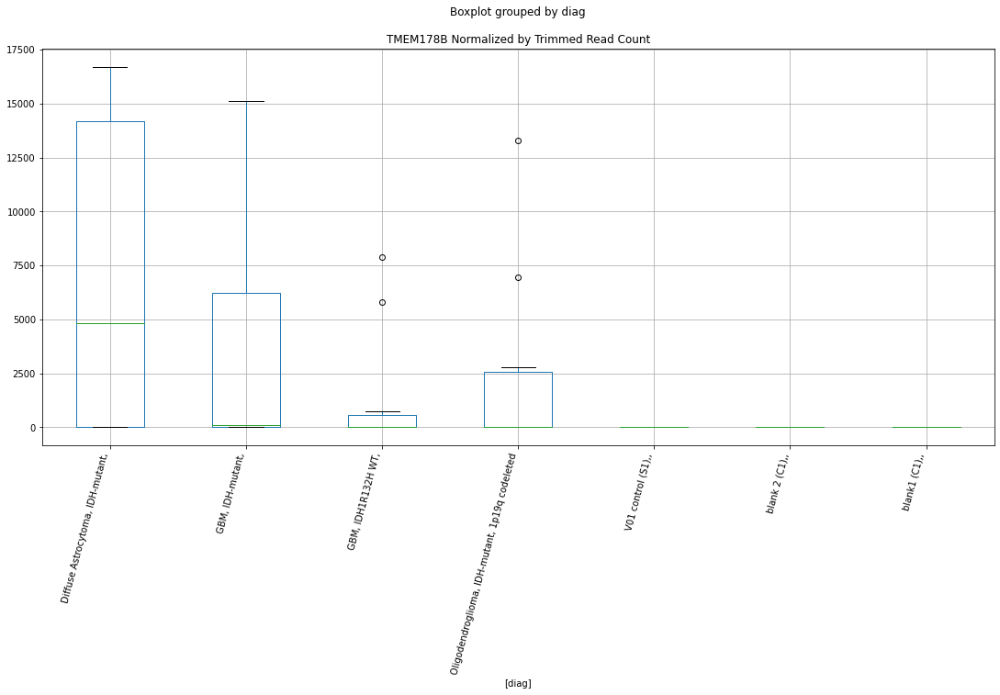

 p : 0.040700180101937565  ( t : 2.205008365956693 ) :  Lexogen  :  cutadapt2  :  SPEN
Control and blanks
82       0.00
346    210.43
Name: SPEN, dtype: float64
214    0.0
Name: SPEN, dtype: float64
478    0.0
Name: SPEN, dtype: float64


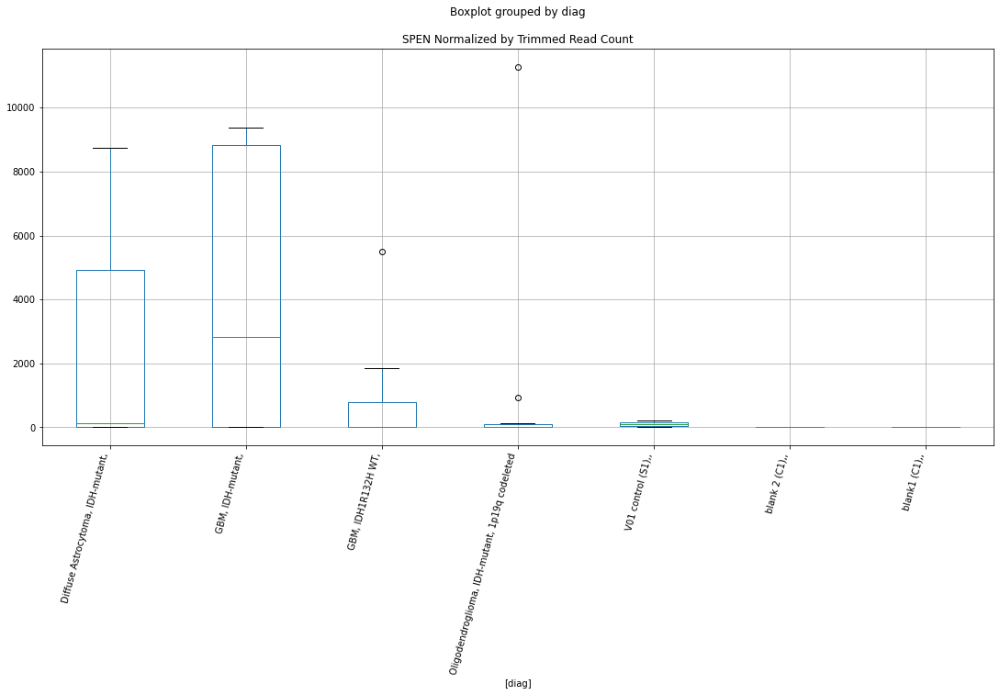

 p : 0.04070227892739761  ( t : 2.2049825099045424 ) :  D-plex  :  cutadapt2  :  TMEM132E
Control and blanks
76     0.0
340    0.0
Name: TMEM132E, dtype: float64
208    705.44
Name: TMEM132E, dtype: float64
472    1155.91
Name: TMEM132E, dtype: float64


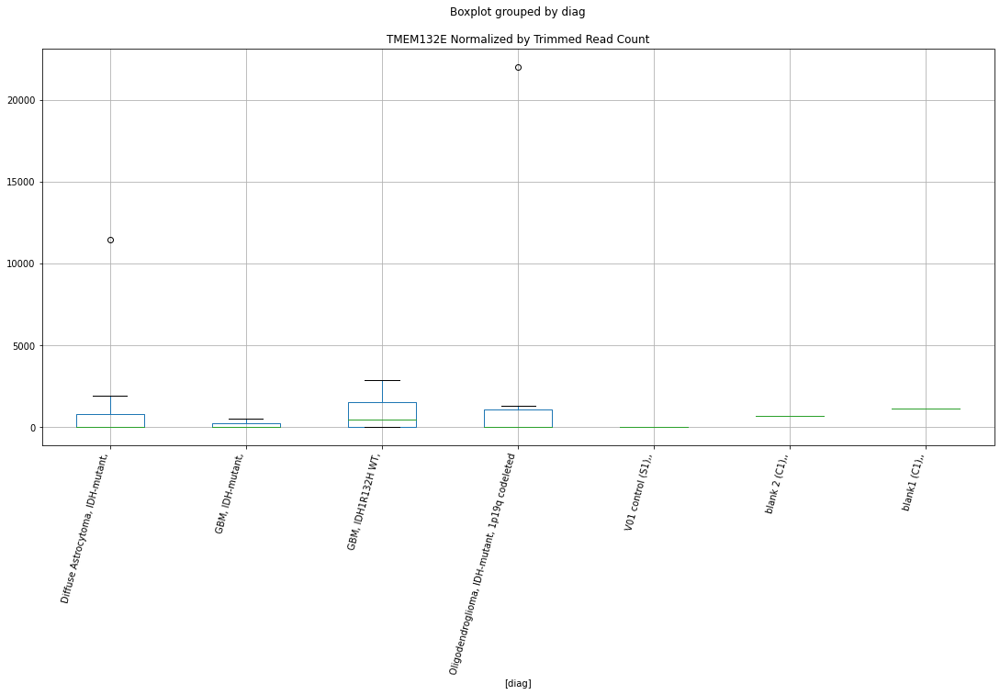

 p : 0.040780610656784365  ( t : 2.2040183931101343 ) :  D-plex  :  cutadapt2  :  TAGAP
Control and blanks
76     109096.45
340     71339.30
Name: TAGAP, dtype: float64
208    86769.23
Name: TAGAP, dtype: float64
472    93628.85
Name: TAGAP, dtype: float64


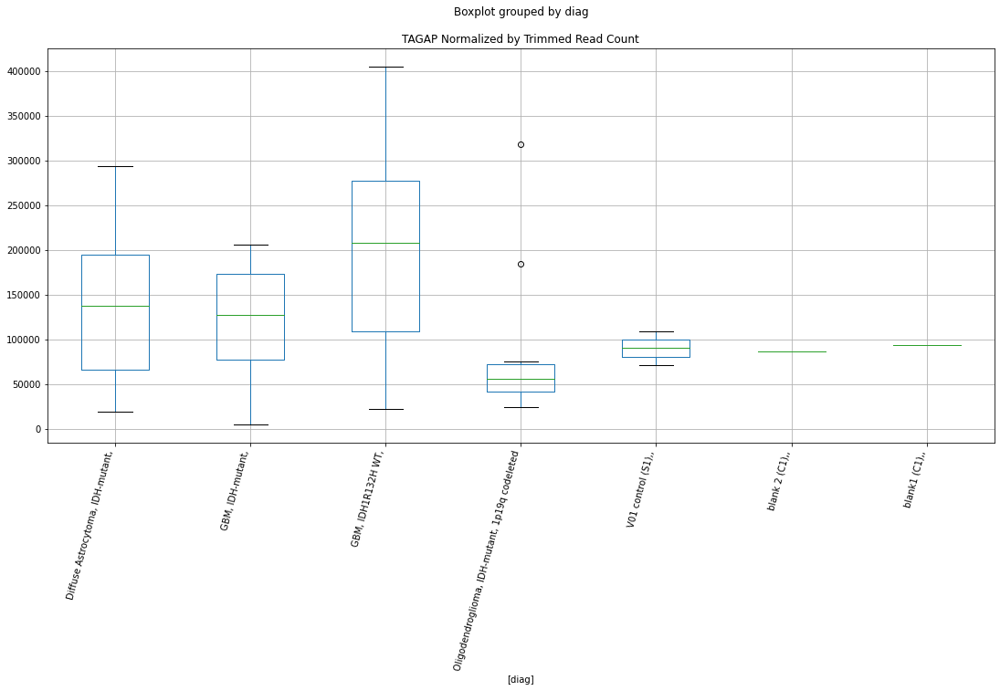

 p : 0.040812147760775484  ( t : 2.203630710798789 ) :  D-plex  :  cutadapt2  :  TPR
Control and blanks
76     4545.69
340     880.73
Name: TPR, dtype: float64
208    5114.45
Name: TPR, dtype: float64
472    6935.47
Name: TPR, dtype: float64


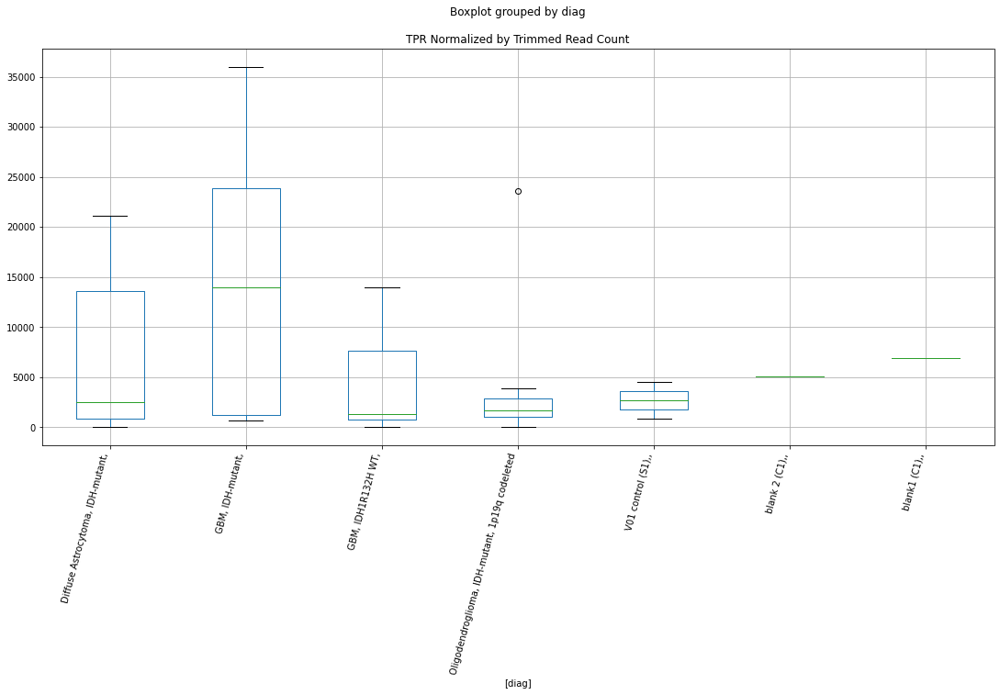

 p : 0.04084647130884634  ( t : 2.203209087674667 ) :  D-plex  :  cutadapt2  :  VEGFC
Control and blanks
76     28031.73
340    91596.14
Name: VEGFC, dtype: float64
208    196994.36
Name: VEGFC, dtype: float64
472    295913.39
Name: VEGFC, dtype: float64


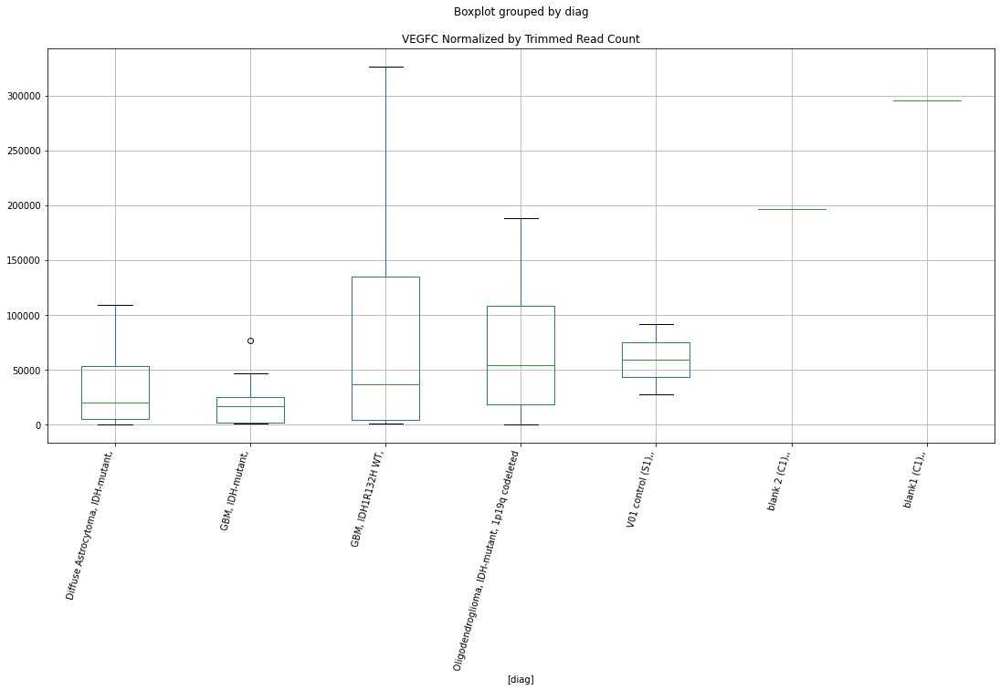

 p : 0.04084965166633755  ( t : 2.203170037321733 ) :  D-plex  :  bbduk2  :  TFB1M
Control and blanks
73     773.01
337      0.00
Name: TFB1M, dtype: float64
205    76830.02
Name: TFB1M, dtype: float64
469    4140.69
Name: TFB1M, dtype: float64


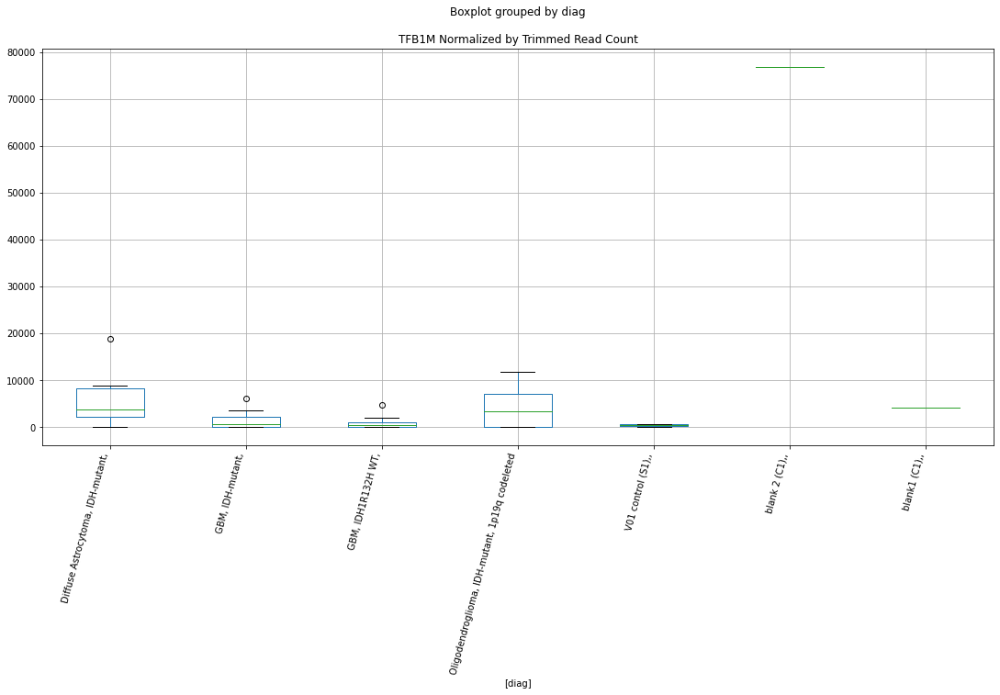

 p : 0.04088290059062028  ( t : 2.2027619540644885 ) :  D-plex  :  bbduk2  :  UBE2QL1
Control and blanks
73     0.0
337    0.0
Name: UBE2QL1, dtype: float64
205    895.45
Name: UBE2QL1, dtype: float64
469    2366.11
Name: UBE2QL1, dtype: float64


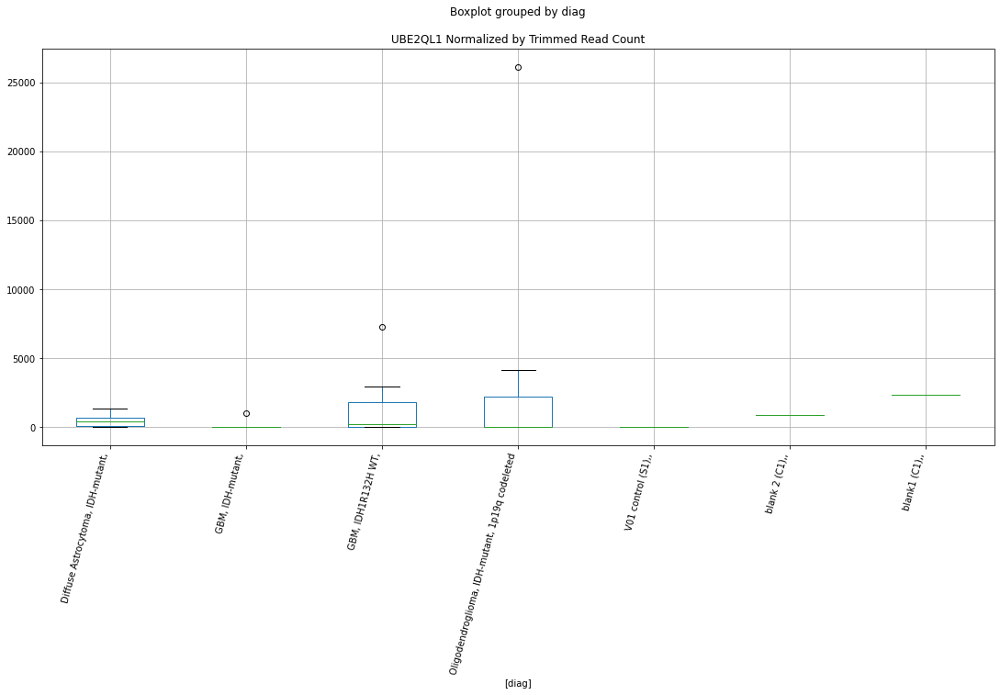

 p : 0.040884180257237106  ( t : 2.202746254070463 ) :  D-plex  :  bbduk2  :  TEX30
Control and blanks
73     0.0
337    0.0
Name: TEX30, dtype: float64
205    3581.82
Name: TEX30, dtype: float64
469    2366.11
Name: TEX30, dtype: float64


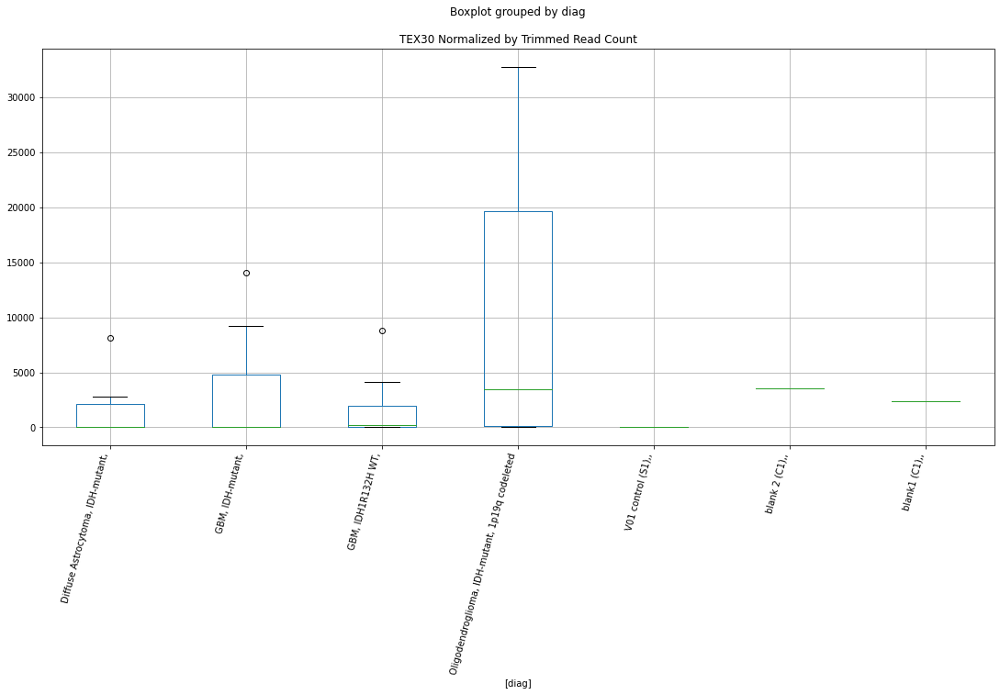

 p : 0.040908177975917344  ( t : 2.2024519140593246 ) :  D-plex  :  bbduk2  :  ZNF827
Control and blanks
73          0.00
337    320456.62
Name: ZNF827, dtype: float64
205    43877.28
Name: ZNF827, dtype: float64
469    6506.8
Name: ZNF827, dtype: float64


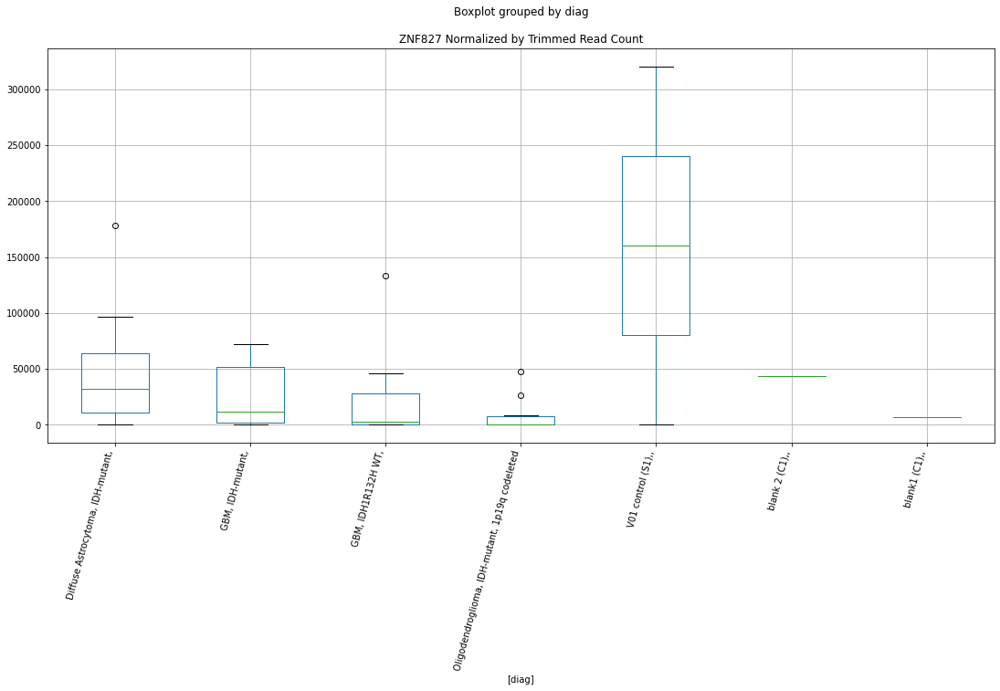

 p : 0.041096507532729074  ( t : 2.2001474801270384 ) :  D-plex  :  bbduk2  :  ZNF708
Control and blanks
73     0.0
337    0.0
Name: ZNF708, dtype: float64
205    6447.27
Name: ZNF708, dtype: float64
469    7098.33
Name: ZNF708, dtype: float64


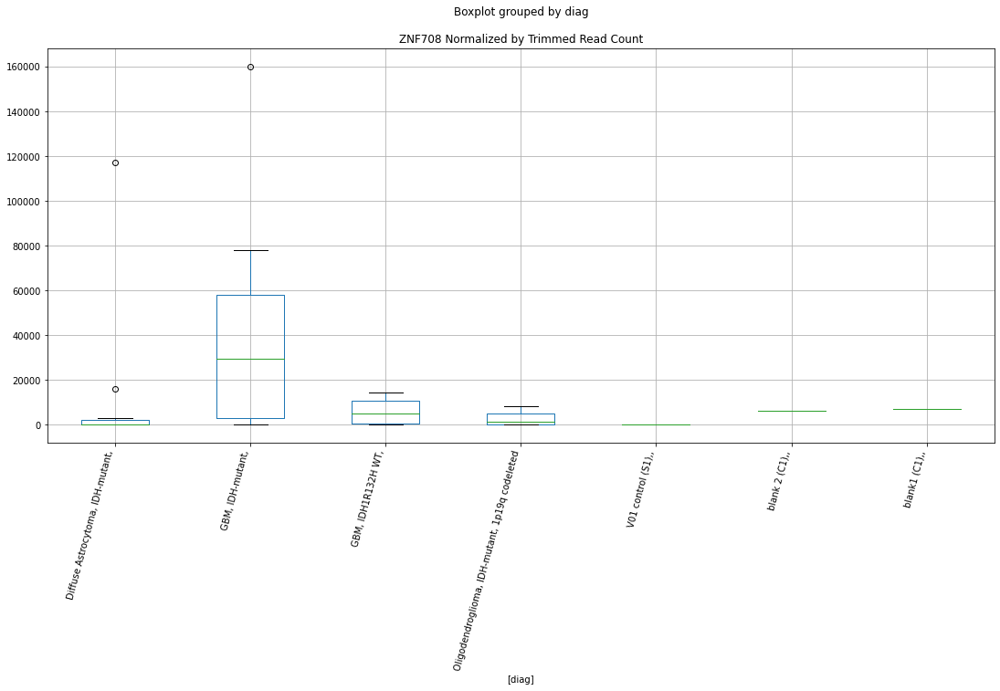

 p : 0.041189370980671595  ( t : 2.1990147546058094 ) :  Lexogen  :  cutadapt2  :  SYTL3
Control and blanks
82     0.0
346    0.0
Name: SYTL3, dtype: float64
214    0.0
Name: SYTL3, dtype: float64
478    0.0
Name: SYTL3, dtype: float64


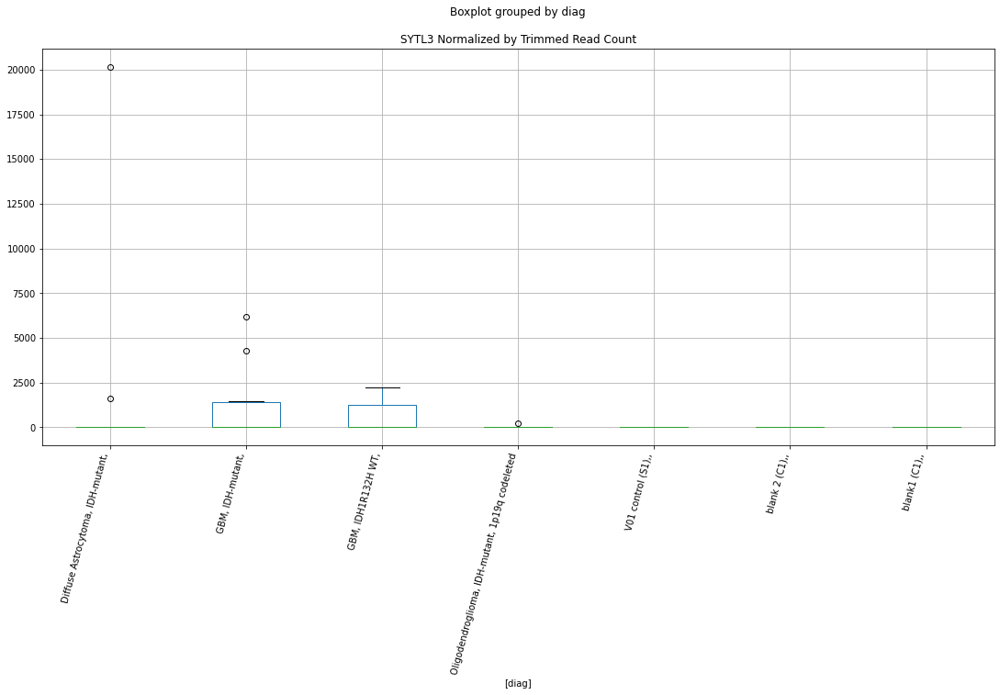

 p : 0.04122469286423754  ( t : 2.198584522520505 ) :  D-plex  :  cutadapt2  :  TEKT4
Control and blanks
76     0.0
340    0.0
Name: TEKT4, dtype: float64
208    1410.88
Name: TEKT4, dtype: float64
472    12137.07
Name: TEKT4, dtype: float64


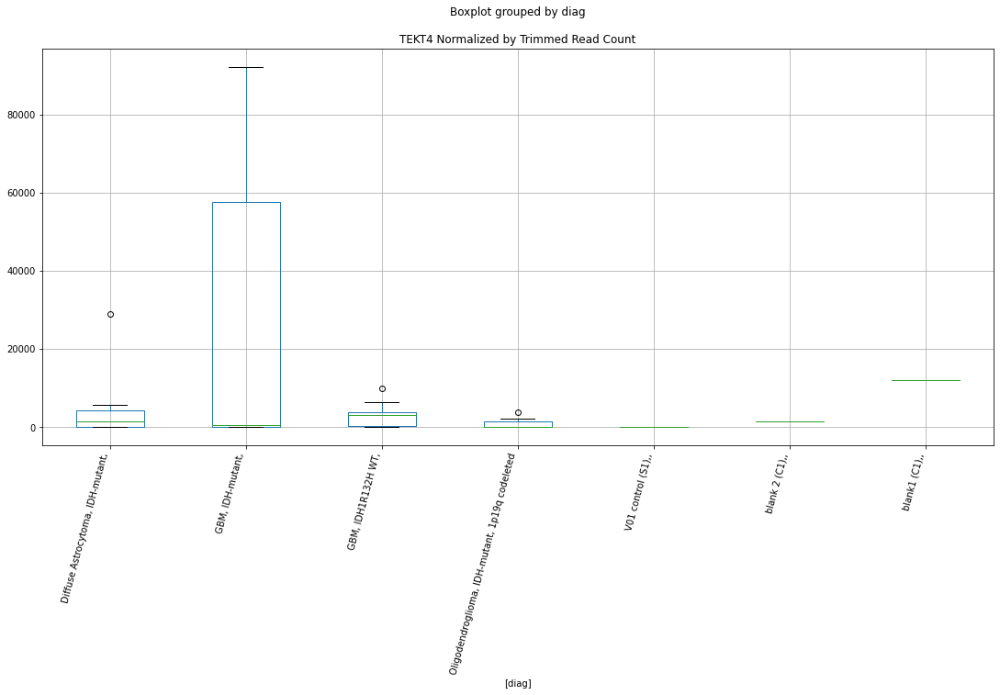

 p : 0.04122552622082448  ( t : 2.1985743760528798 ) :  Lexogen  :  bbduk2  :  ZNF460
Control and blanks
79         0.00
343    32271.78
Name: ZNF460, dtype: float64
211    25690.8
Name: ZNF460, dtype: float64
475    479.03
Name: ZNF460, dtype: float64


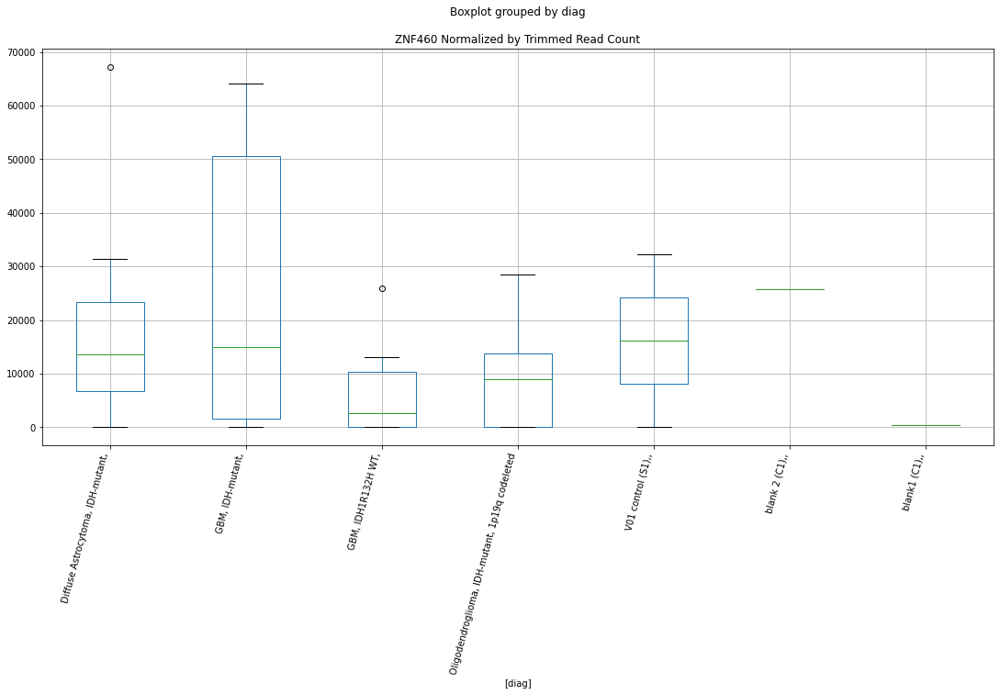

 p : 0.04124430349402996  ( t : 2.1983458047557365 ) :  D-plex  :  cutadapt2  :  ZNF282
Control and blanks
76     2272.84
340    2642.20
Name: ZNF282, dtype: float64
208    1587.24
Name: ZNF282, dtype: float64
472    3467.74
Name: ZNF282, dtype: float64


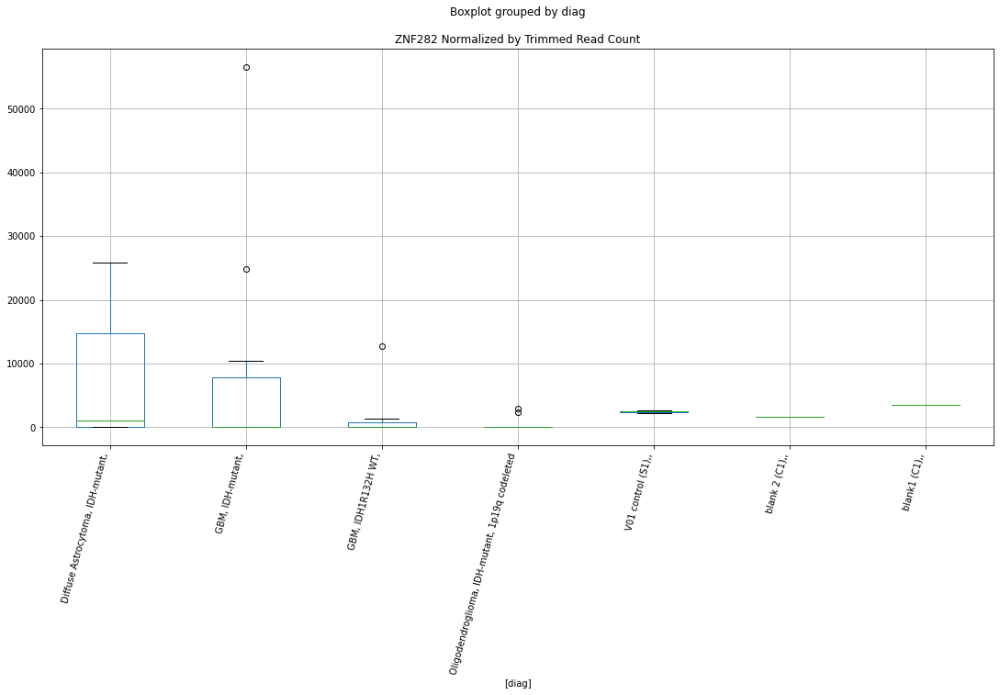

 p : 0.04136587425422328  ( t : 2.196868260430174 ) :  D-plex  :  cutadapt2  :  ZSWIM9
Control and blanks
76     0.0
340    0.0
Name: ZSWIM9, dtype: float64
208    176.36
Name: ZSWIM9, dtype: float64
472    2889.78
Name: ZSWIM9, dtype: float64


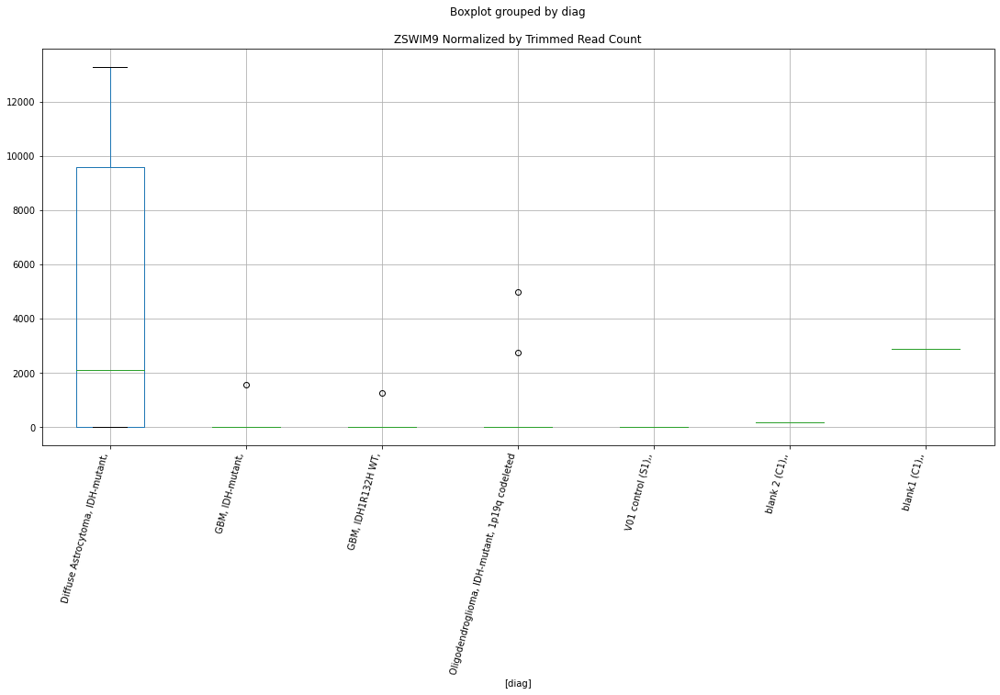

 p : 0.041381622386627424  ( t : 2.1966771528511106 ) :  D-plex  :  cutadapt2  :  TENT4B
Control and blanks
76     17425.13
340        0.00
Name: TENT4B, dtype: float64
208    23279.55
Name: TENT4B, dtype: float64
472    43346.69
Name: TENT4B, dtype: float64


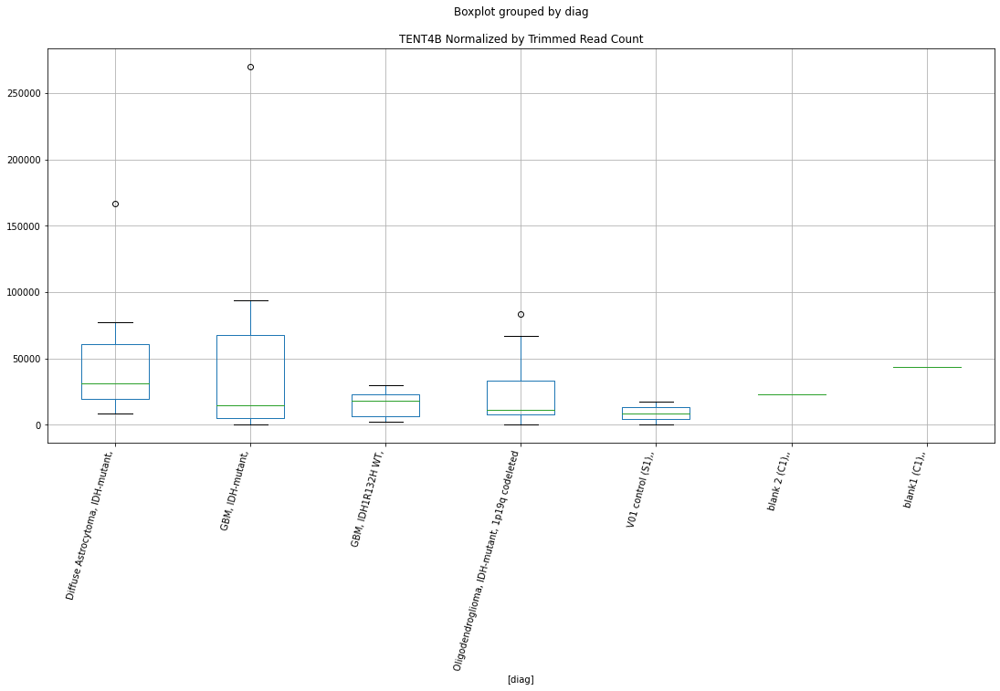

 p : 0.04138794569794492  ( t : 2.1966004366522527 ) :  D-plex  :  cutadapt2  :  TTN-AS1
Control and blanks
76        0.00
340    5284.39
Name: TTN-AS1, dtype: float64
208    176.36
Name: TTN-AS1, dtype: float64
472    0.0
Name: TTN-AS1, dtype: float64


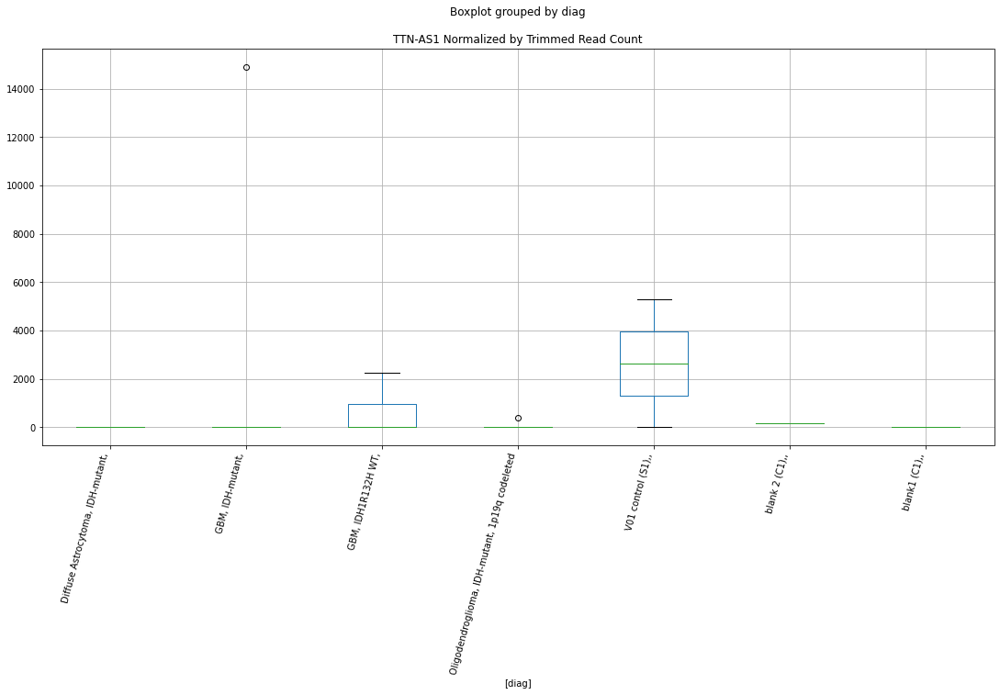

 p : 0.04140013649237015  ( t : 2.1964525648566853 ) :  D-plex  :  bbduk2  :  ZSWIM9
Control and blanks
73     0.0
337    0.0
Name: ZSWIM9, dtype: float64
205    179.09
Name: ZSWIM9, dtype: float64
469    2957.64
Name: ZSWIM9, dtype: float64


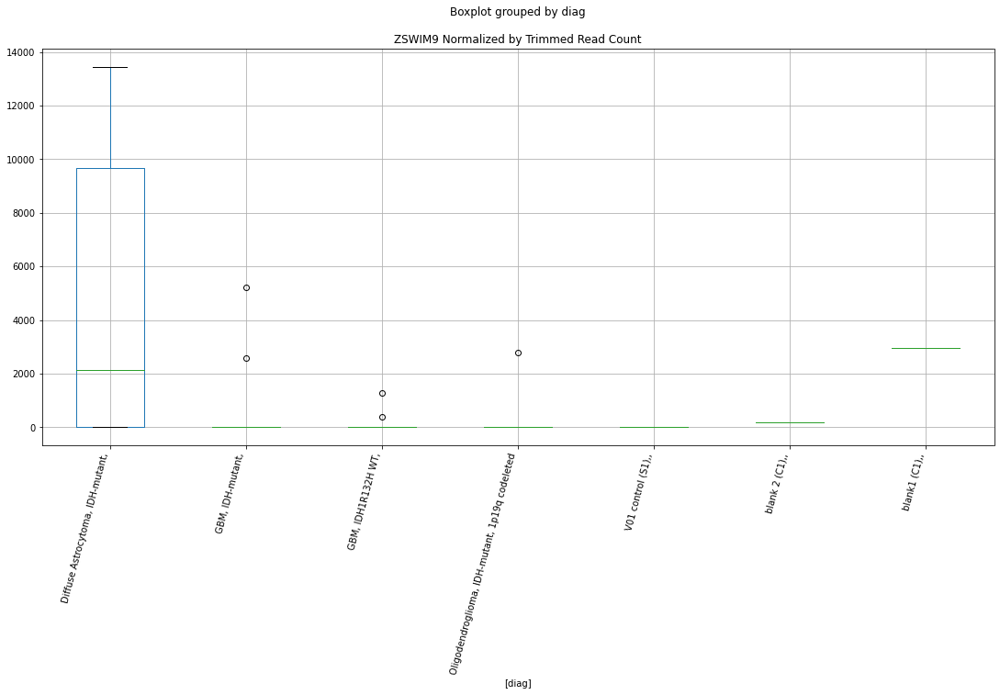

 p : 0.0414091958448631  ( t : 2.1963427026881375 ) :  Lexogen  :  cutadapt2  :  TRIM28
Control and blanks
82         0.00
346    28198.23
Name: TRIM28, dtype: float64
214    0.0
Name: TRIM28, dtype: float64
478    0.0
Name: TRIM28, dtype: float64


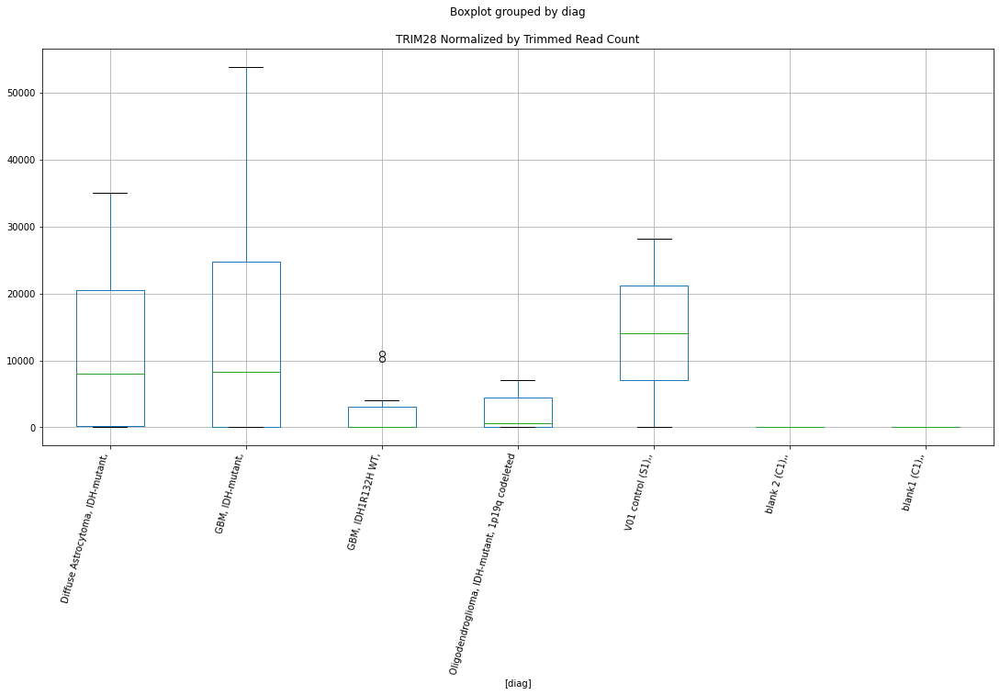

 p : 0.04143061931141713  ( t : 2.196082989488379 ) :  D-plex  :  cutadapt2  :  SUPT3H
Control and blanks
76     0.0
340    0.0
Name: SUPT3H, dtype: float64
208    7936.21
Name: SUPT3H, dtype: float64
472    4623.65
Name: SUPT3H, dtype: float64


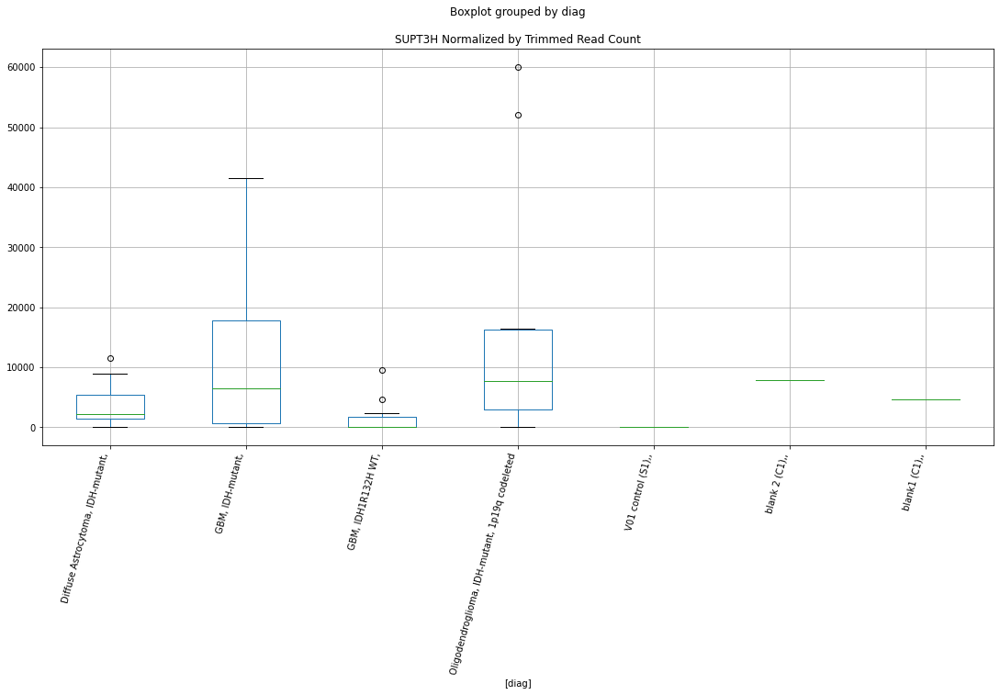

 p : 0.04146888574967381  ( t : 2.195619398309044 ) :  Lexogen  :  cutadapt2  :  WSCD1
Control and blanks
82     0.0
346    0.0
Name: WSCD1, dtype: float64
214    0.0
Name: WSCD1, dtype: float64
478    0.0
Name: WSCD1, dtype: float64


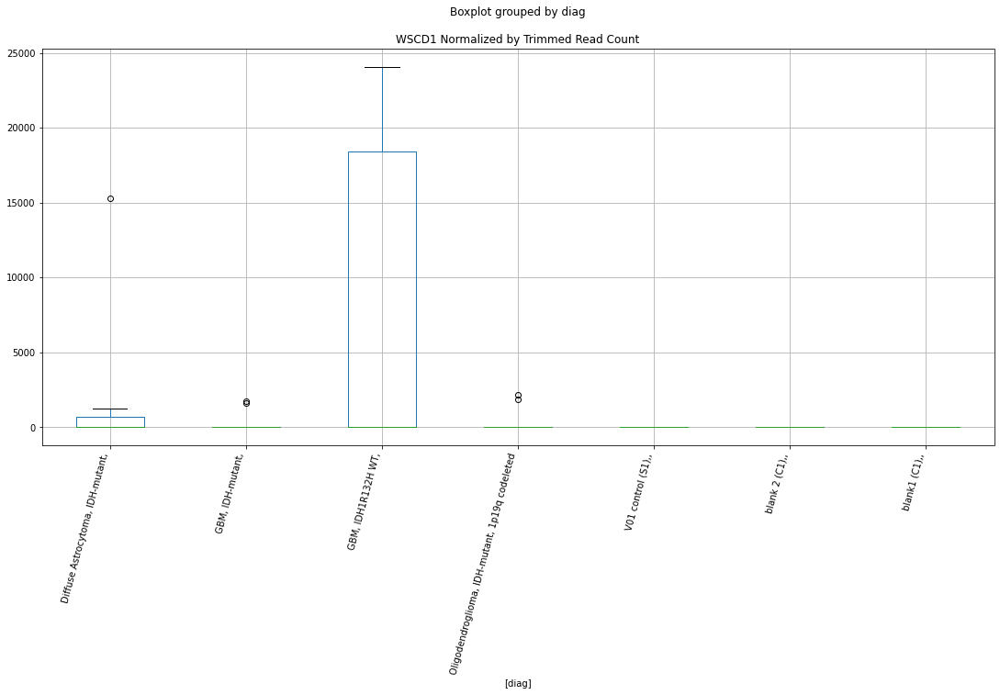

 p : 0.04152228773593014  ( t : 2.194973098603608 ) :  Lexogen  :  bbduk2  :  WDYHV1
Control and blanks
79     0.0
343    0.0
Name: WDYHV1, dtype: float64
211    0.0
Name: WDYHV1, dtype: float64
475    0.0
Name: WDYHV1, dtype: float64


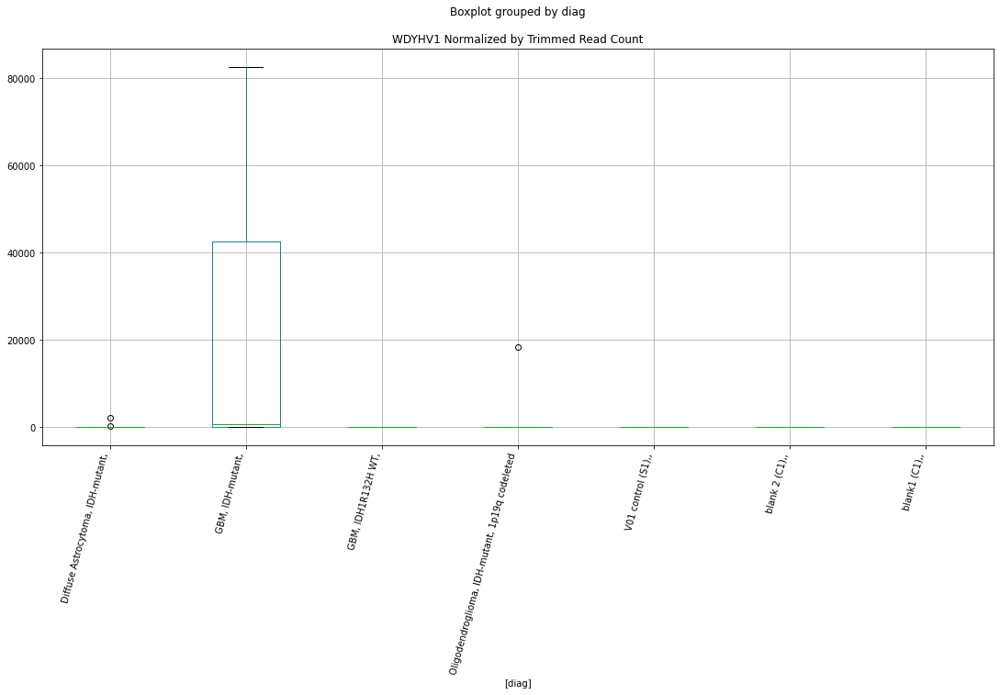

 p : 0.04153023268952977  ( t : 2.1948770096901957 ) :  Lexogen  :  bbduk2  :  WSCD1
Control and blanks
79     0.0
343    0.0
Name: WSCD1, dtype: float64
211    0.0
Name: WSCD1, dtype: float64
475    0.0
Name: WSCD1, dtype: float64


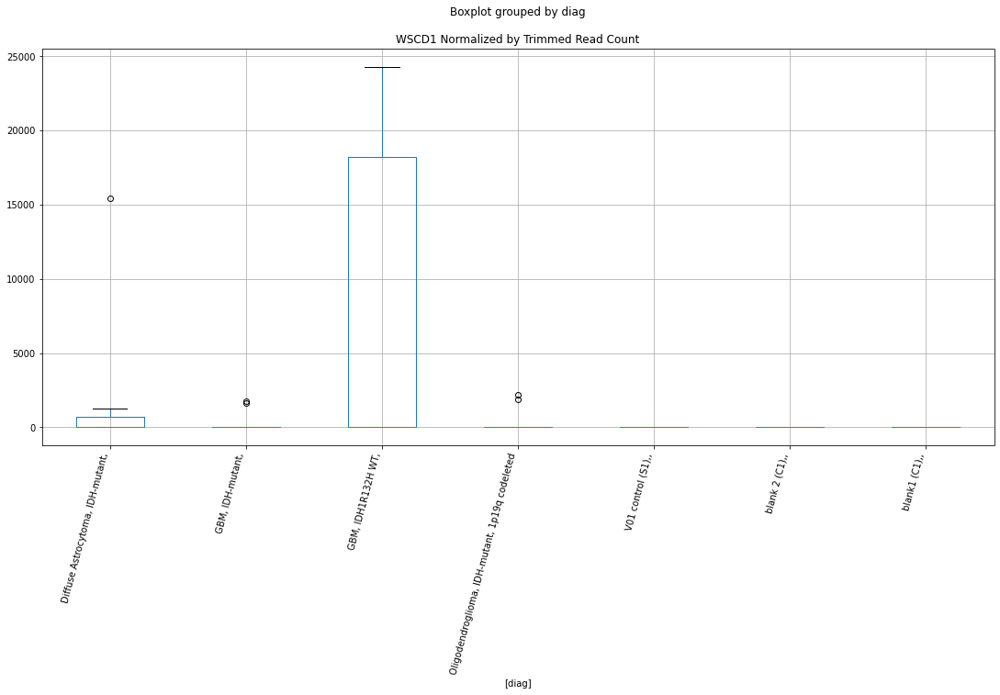

 p : 0.041545793108581926  ( t : 2.1946888656780357 ) :  D-plex  :  bbduk2  :  ZBTB7B
Control and blanks
73     0.0
337    0.0
Name: ZBTB7B, dtype: float64
205    2686.36
Name: ZBTB7B, dtype: float64
469    8872.91
Name: ZBTB7B, dtype: float64


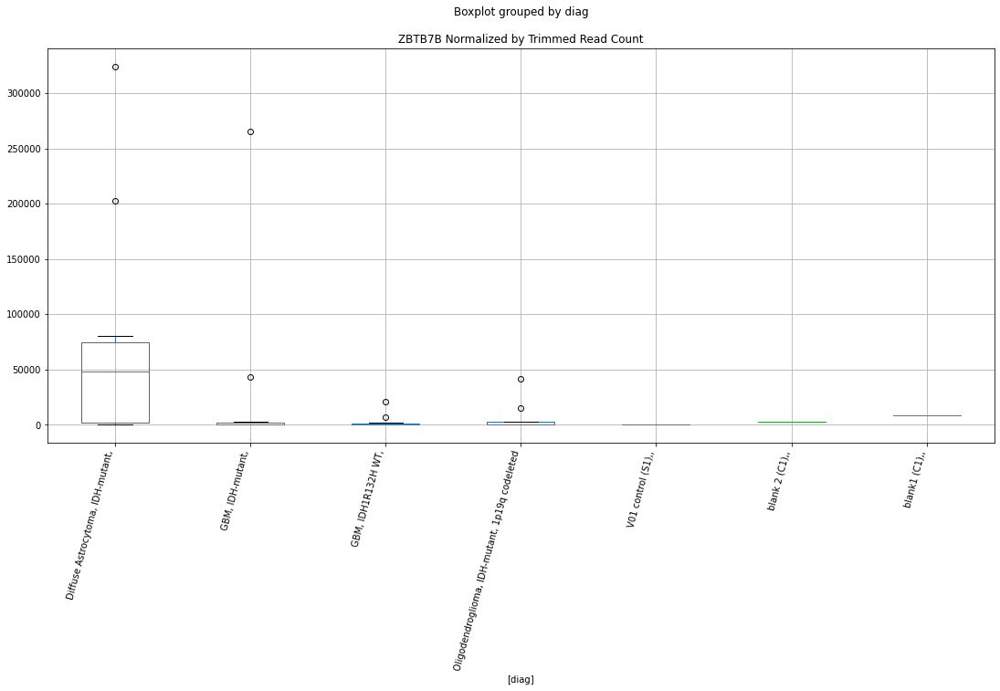

 p : 0.041554104191430165  ( t : 2.194588401279216 ) :  Lexogen  :  bbduk2  :  TONSL
Control and blanks
79     0.0
343    0.0
Name: TONSL, dtype: float64
211    546.61
Name: TONSL, dtype: float64
475    479.03
Name: TONSL, dtype: float64


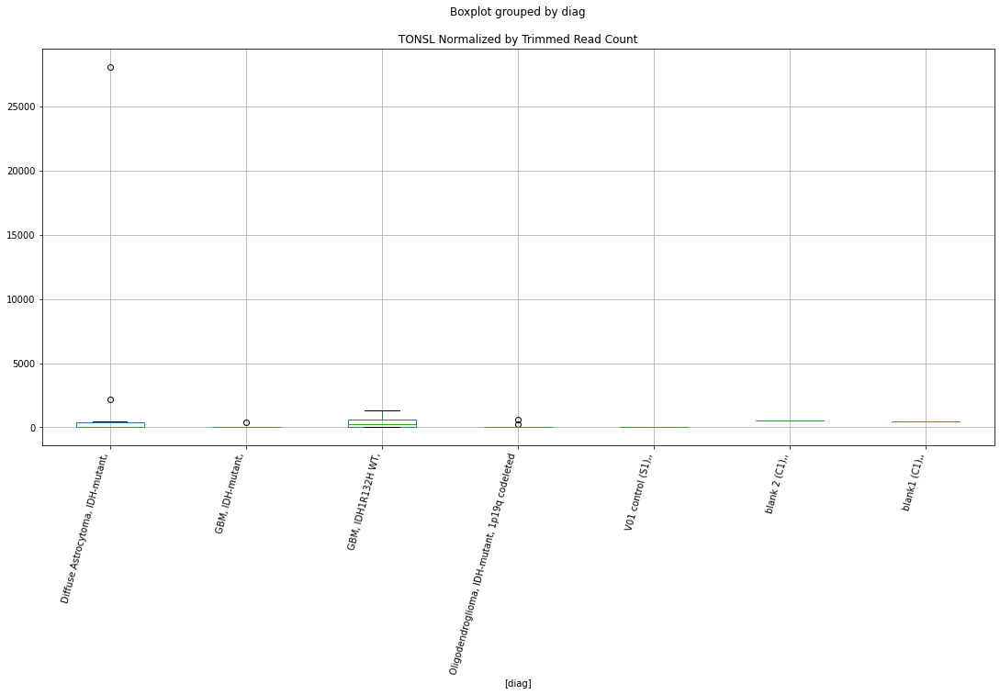

 p : 0.04155708334287144  ( t : 2.1945523937765716 ) :  D-plex  :  cutadapt2  :  ZNF708
Control and blanks
76     0.0
340    0.0
Name: ZNF708, dtype: float64
208    6348.97
Name: ZNF708, dtype: float64
472    6935.47
Name: ZNF708, dtype: float64


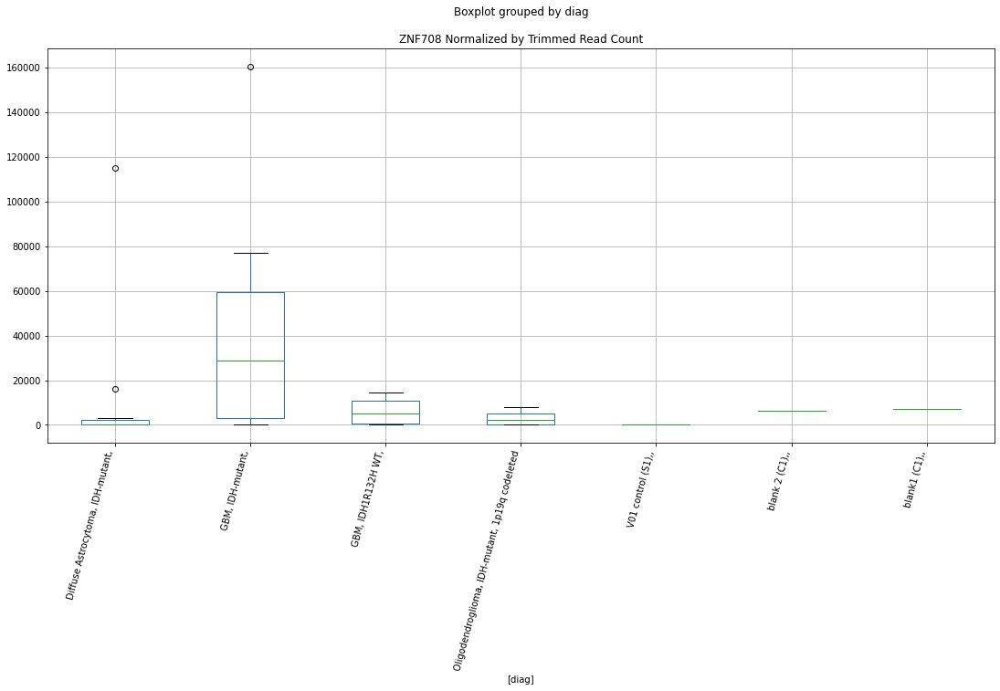

 p : 0.0415588438991923  ( t : 2.194531115933058 ) :  D-plex  :  bbduk2  :  SSBP4
Control and blanks
73     0.0
337    0.0
Name: SSBP4, dtype: float64
205    12357.28
Name: SSBP4, dtype: float64
469    3549.16
Name: SSBP4, dtype: float64


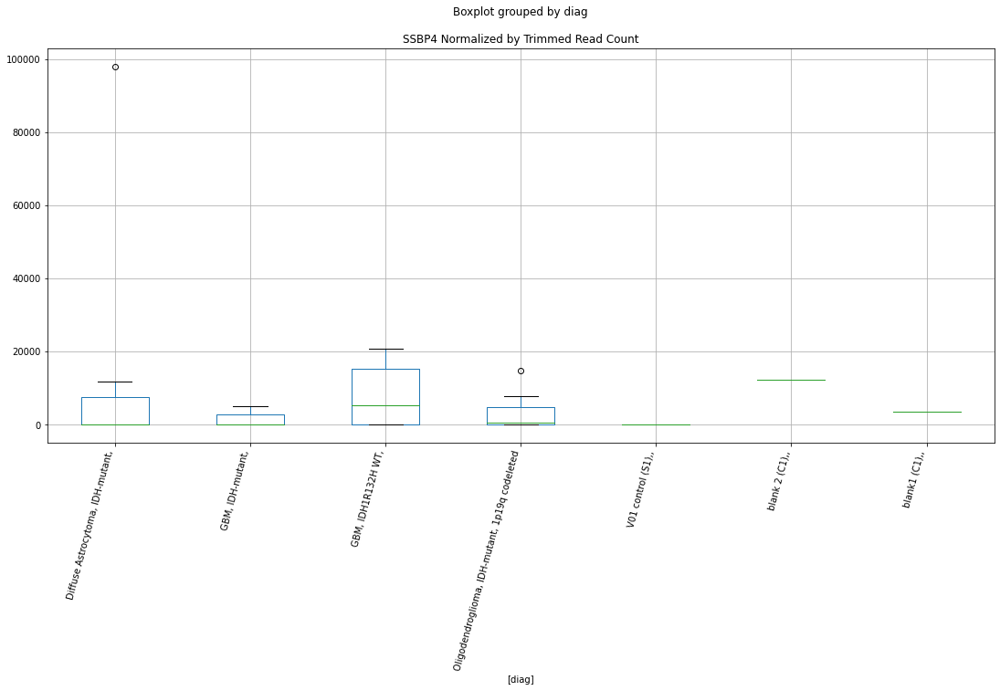

 p : 0.041585565619982126  ( t : 2.1942082624000787 ) :  Lexogen  :  bbduk2  :  TENM2
Control and blanks
79     0.0
343    0.0
Name: TENM2, dtype: float64
211    0.0
Name: TENM2, dtype: float64
475    30178.98
Name: TENM2, dtype: float64


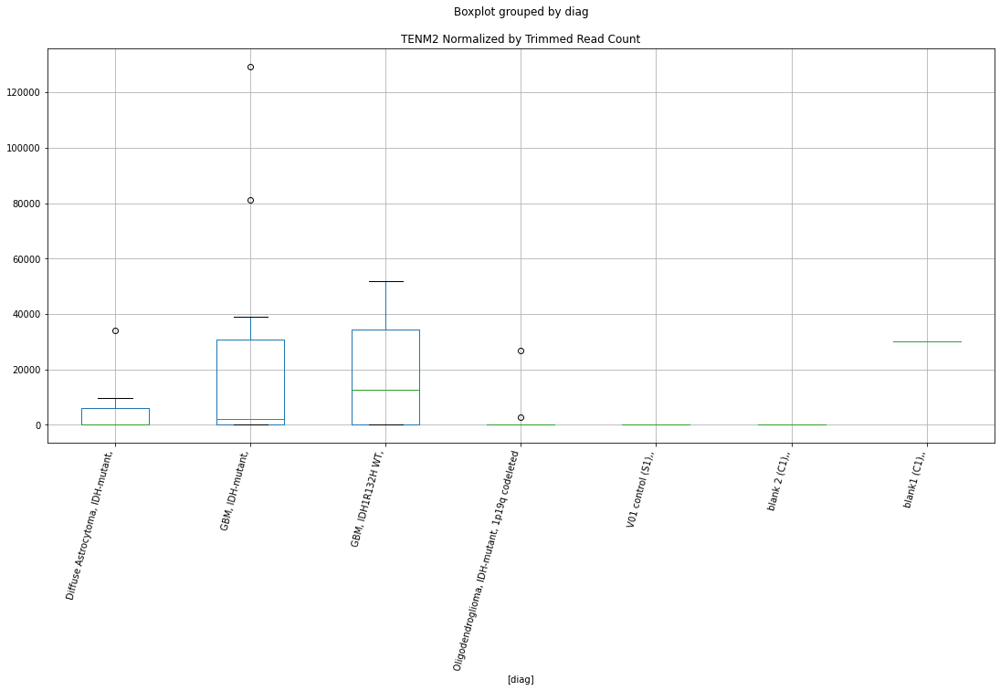

 p : 0.041606185367048236  ( t : 2.1939592634338965 ) :  D-plex  :  bbduk2  :  TIMD4
Control and blanks
73     0.0
337    0.0
Name: TIMD4, dtype: float64
205    716.36
Name: TIMD4, dtype: float64
469    2366.11
Name: TIMD4, dtype: float64


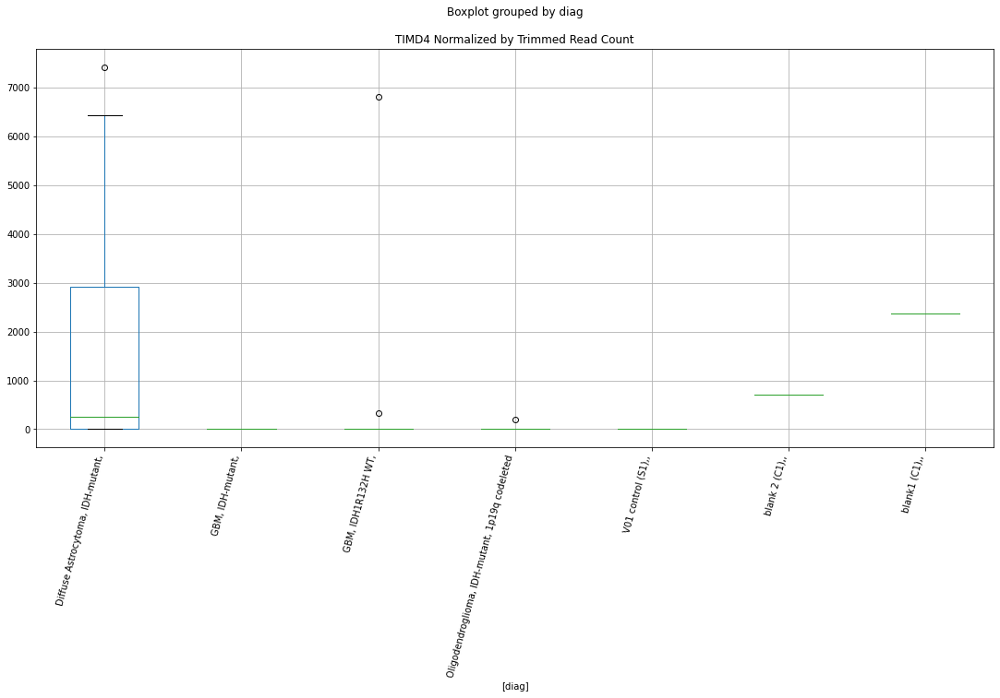

 p : 0.04167205760303027  ( t : 2.1931645647622946 ) :  Lexogen  :  cutadapt2  :  TUFT1
Control and blanks
82     0.0
346    0.0
Name: TUFT1, dtype: float64
214    0.0
Name: TUFT1, dtype: float64
478    0.0
Name: TUFT1, dtype: float64


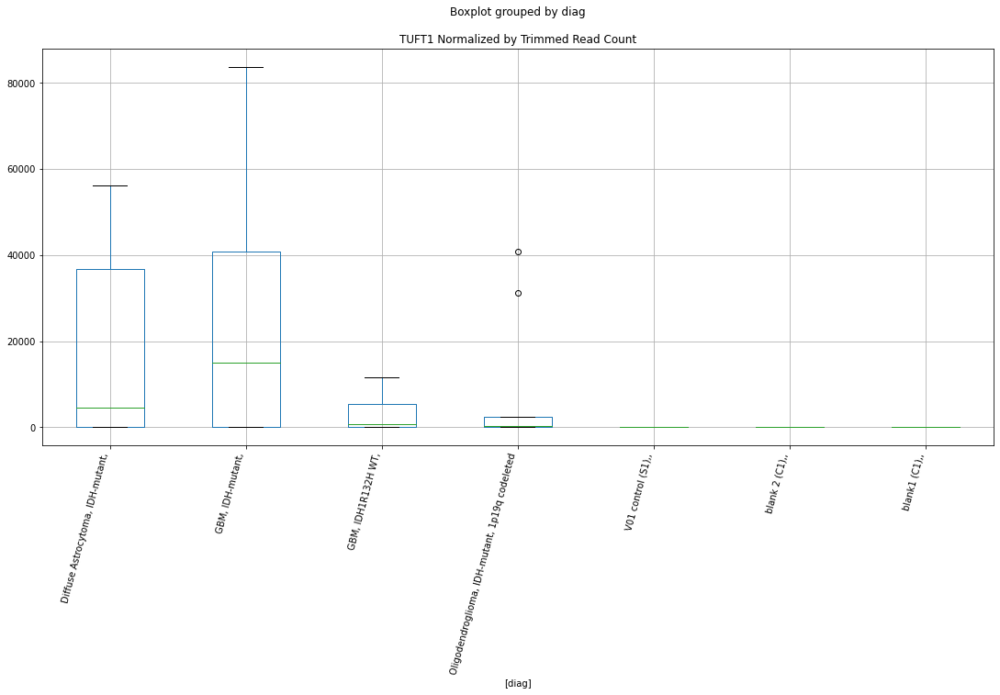

 p : 0.04171193089018892  ( t : 2.1926840836972463 ) :  D-plex  :  bbduk2  :  VTI1A
Control and blanks
73      3092.03
337    40057.08
Name: VTI1A, dtype: float64
205    1074.55
Name: VTI1A, dtype: float64
469    3549.16
Name: VTI1A, dtype: float64


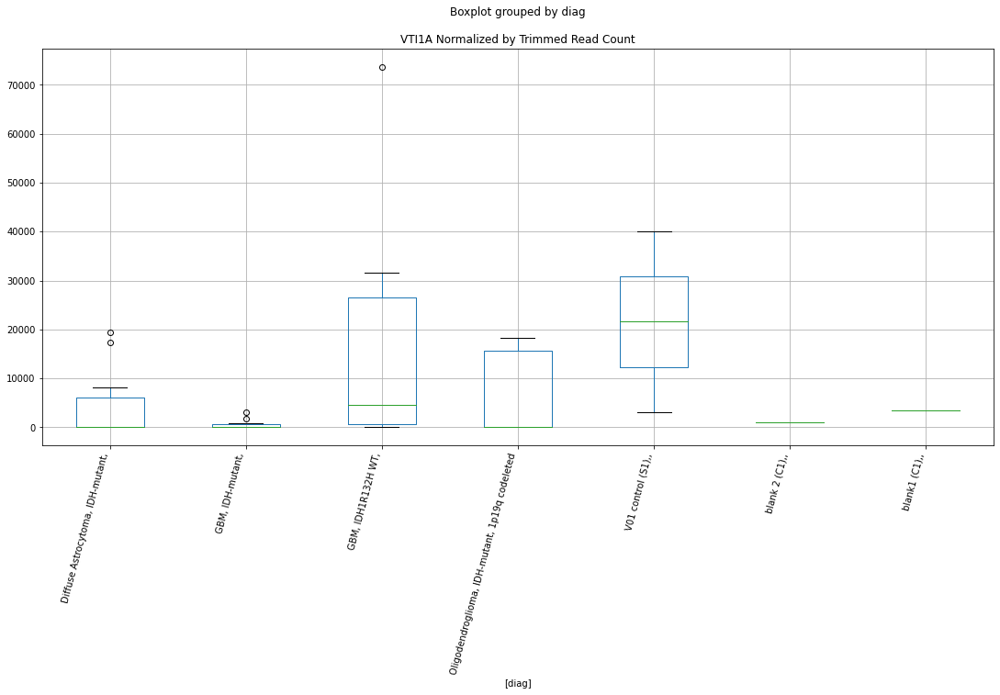

 p : 0.04171653182099909  ( t : 2.1926286686910683 ) :  Lexogen  :  cutadapt2  :  TTC9B
Control and blanks
82     0.0
346    0.0
Name: TTC9B, dtype: float64
214    0.0
Name: TTC9B, dtype: float64
478    0.0
Name: TTC9B, dtype: float64


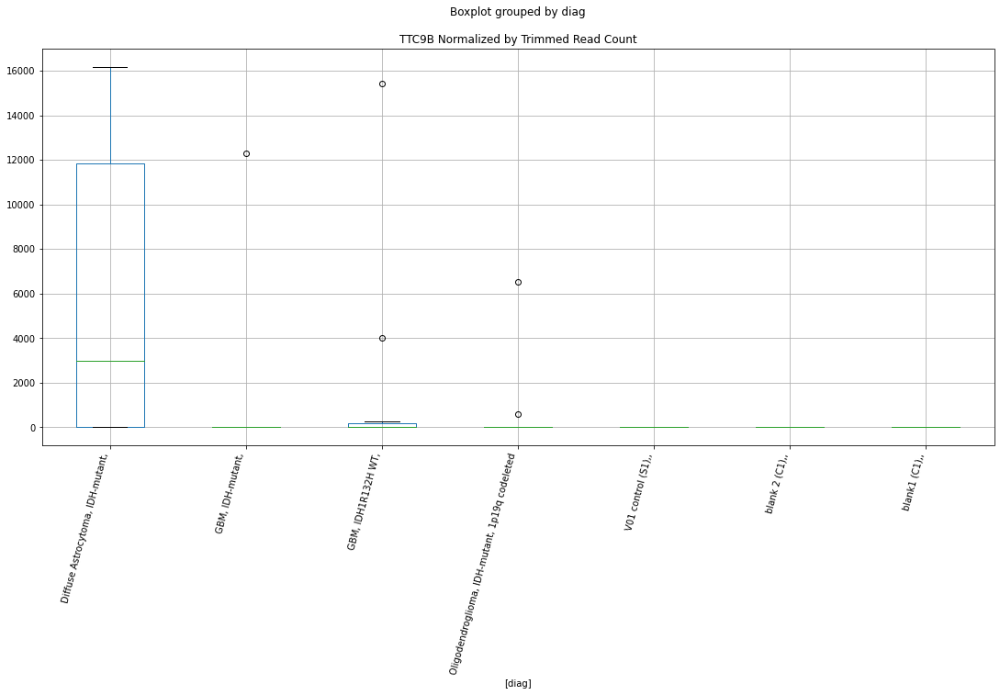

 p : 0.04174116174701036  ( t : 2.192332113736317 ) :  Lexogen  :  bbduk2  :  TTC9B
Control and blanks
79     0.0
343    0.0
Name: TTC9B, dtype: float64
211    0.0
Name: TTC9B, dtype: float64
475    0.0
Name: TTC9B, dtype: float64


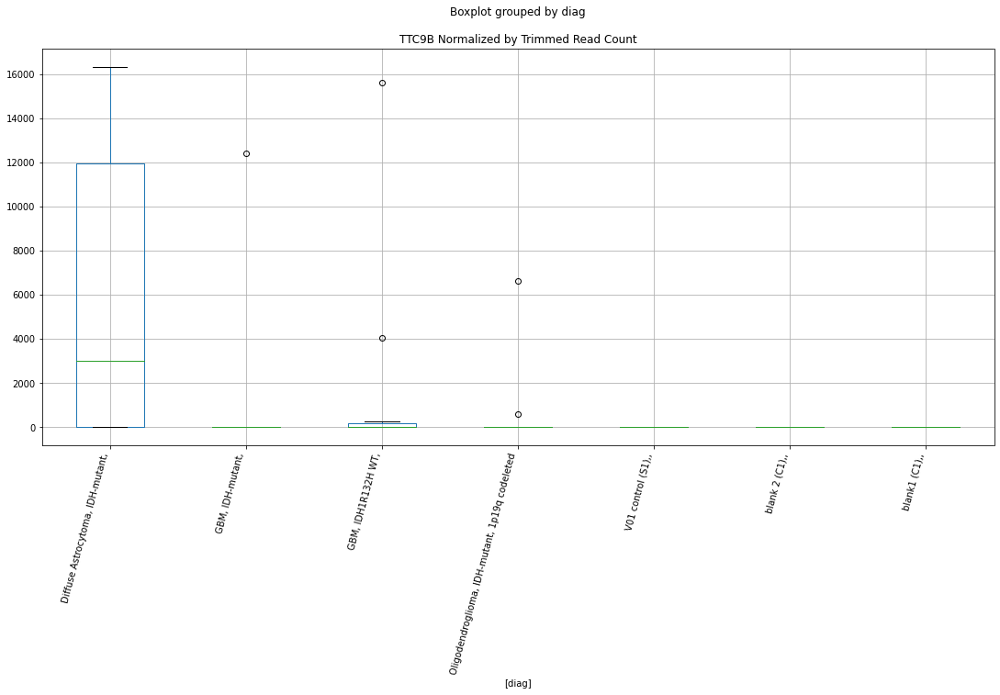

 p : 0.041771995882347736  ( t : 2.1919610836885837 ) :  Lexogen  :  bbduk2  :  TUFT1
Control and blanks
79     0.0
343    0.0
Name: TUFT1, dtype: float64
211    0.0
Name: TUFT1, dtype: float64
475    0.0
Name: TUFT1, dtype: float64


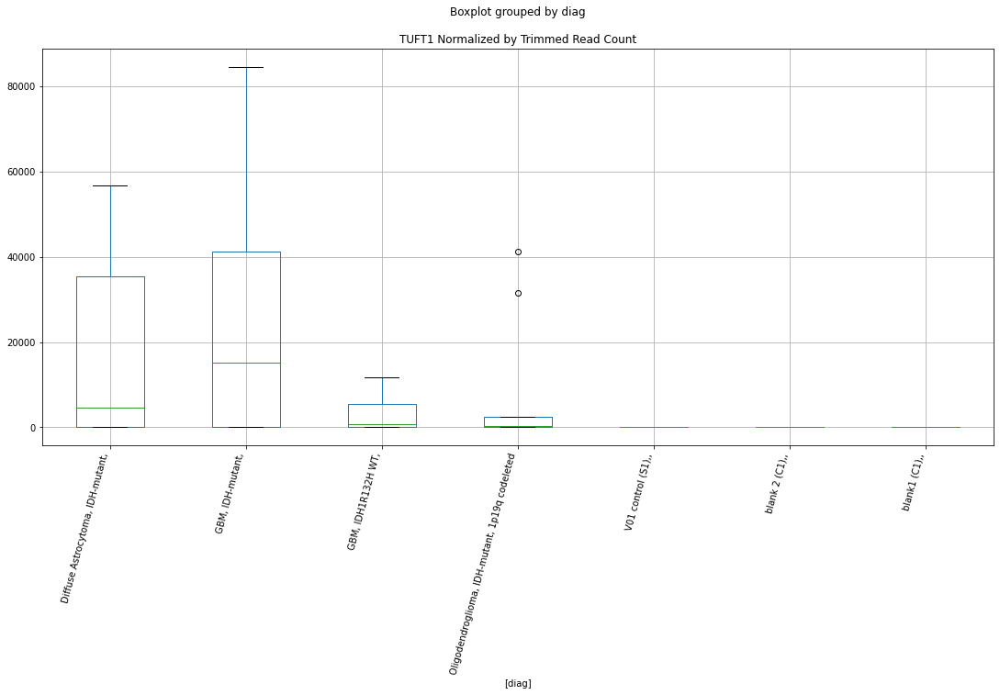

 p : 0.04179454575331925  ( t : 2.191689898048258 ) :  D-plex  :  cutadapt2  :  TIMD4
Control and blanks
76     0.0
340    0.0
Name: TIMD4, dtype: float64
208    705.44
Name: TIMD4, dtype: float64
472    2311.82
Name: TIMD4, dtype: float64


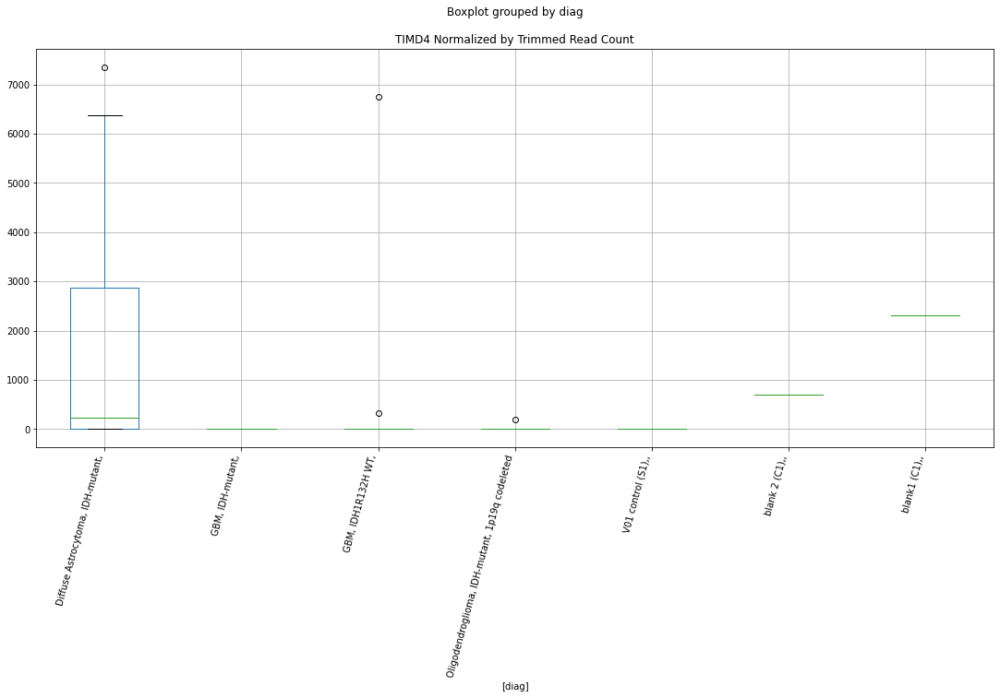

 p : 0.04189564055694646  ( t : 2.1904757757269206 ) :  D-plex  :  cutadapt2  :  TPR
Control and blanks
76     4545.69
340     880.73
Name: TPR, dtype: float64
208    5114.45
Name: TPR, dtype: float64
472    6935.47
Name: TPR, dtype: float64


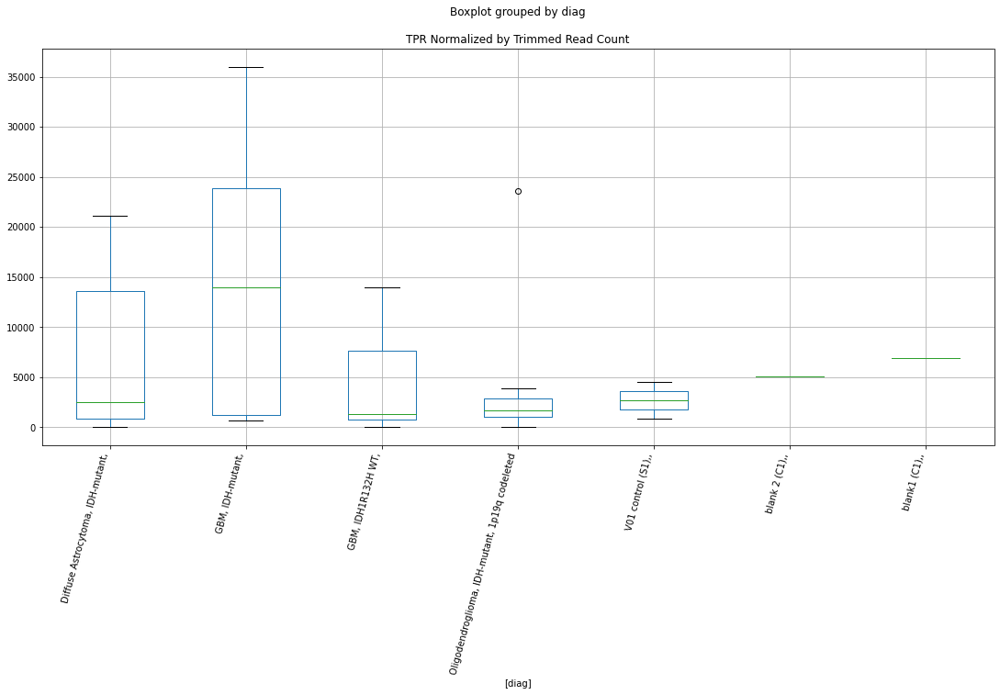

 p : 0.04200348394663429  ( t : 2.189183564242655 ) :  D-plex  :  cutadapt2  :  WDR90
Control and blanks
76      6818.53
340    43155.87
Name: WDR90, dtype: float64
208    37388.37
Name: WDR90, dtype: float64
472    52016.03
Name: WDR90, dtype: float64


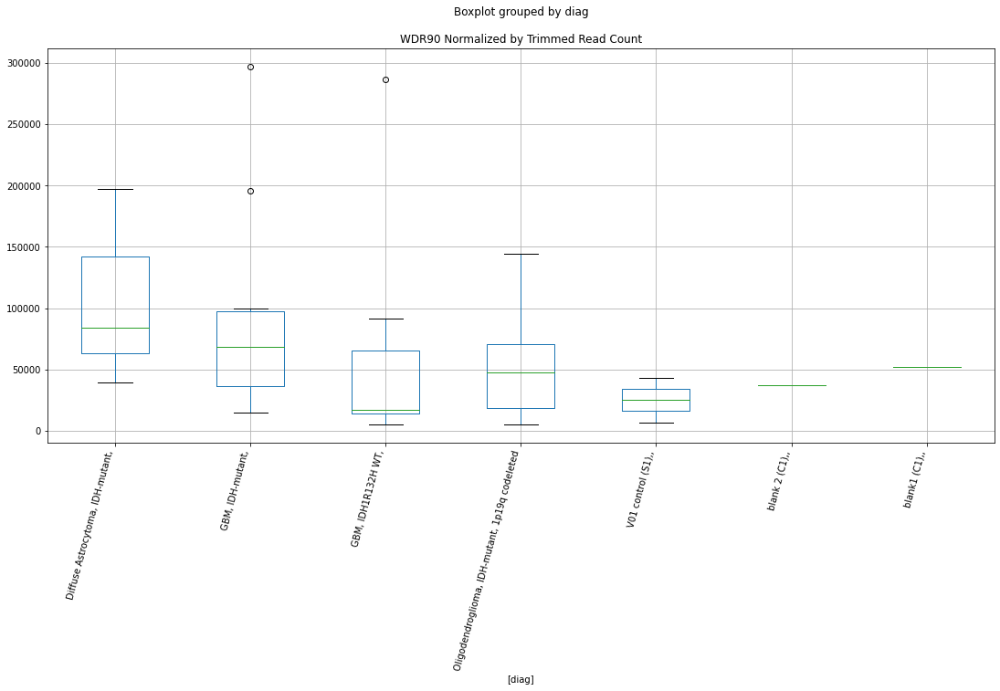

 p : 0.04200645965986022  ( t : 2.1891479515346184 ) :  D-plex  :  bbduk2  :  STARD6
Control and blanks
73     0.0
337    0.0
Name: STARD6, dtype: float64
205    716.36
Name: STARD6, dtype: float64
469    1183.05
Name: STARD6, dtype: float64


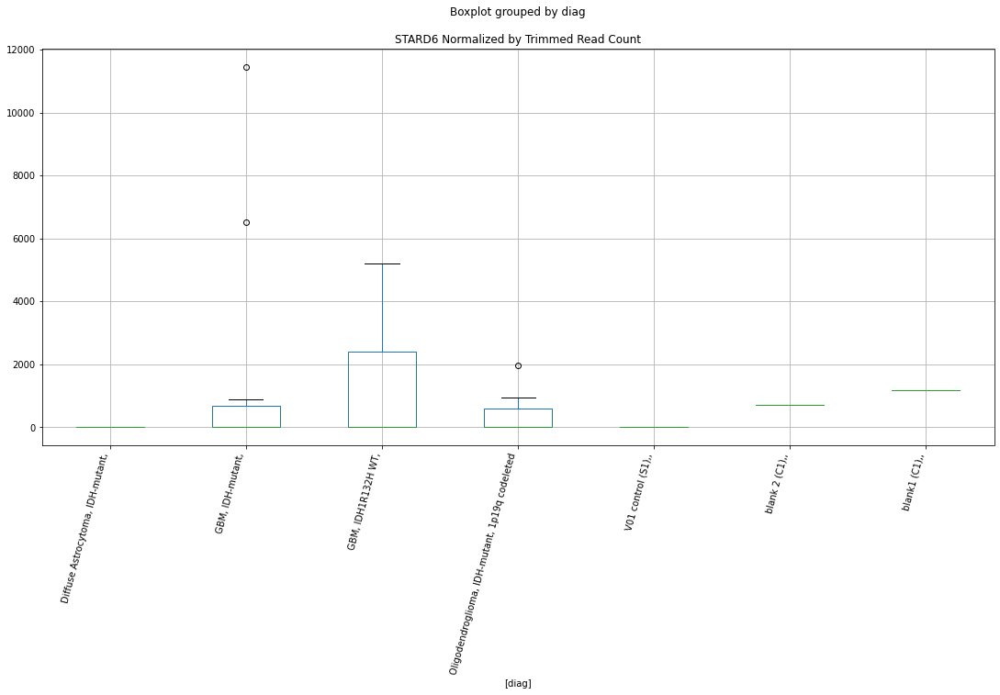

 p : 0.04205681360315849  ( t : 2.1885456768285447 ) :  D-plex  :  cutadapt2  :  SPTBN1
Control and blanks
76     1515.23
340    9688.05
Name: SPTBN1, dtype: float64
208    20986.87
Name: SPTBN1, dtype: float64
472    17916.63
Name: SPTBN1, dtype: float64


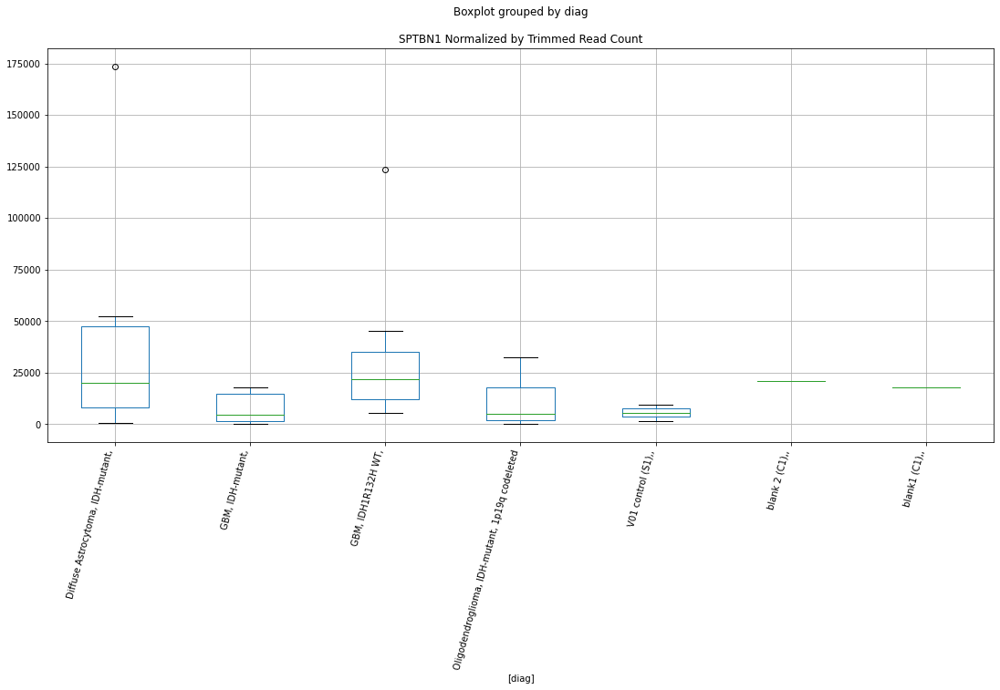

 p : 0.042081153144785784  ( t : 2.1882547929431375 ) :  D-plex  :  cutadapt2  :  STARD6
Control and blanks
76     0.0
340    0.0
Name: STARD6, dtype: float64
208    1234.52
Name: STARD6, dtype: float64
472    1155.91
Name: STARD6, dtype: float64


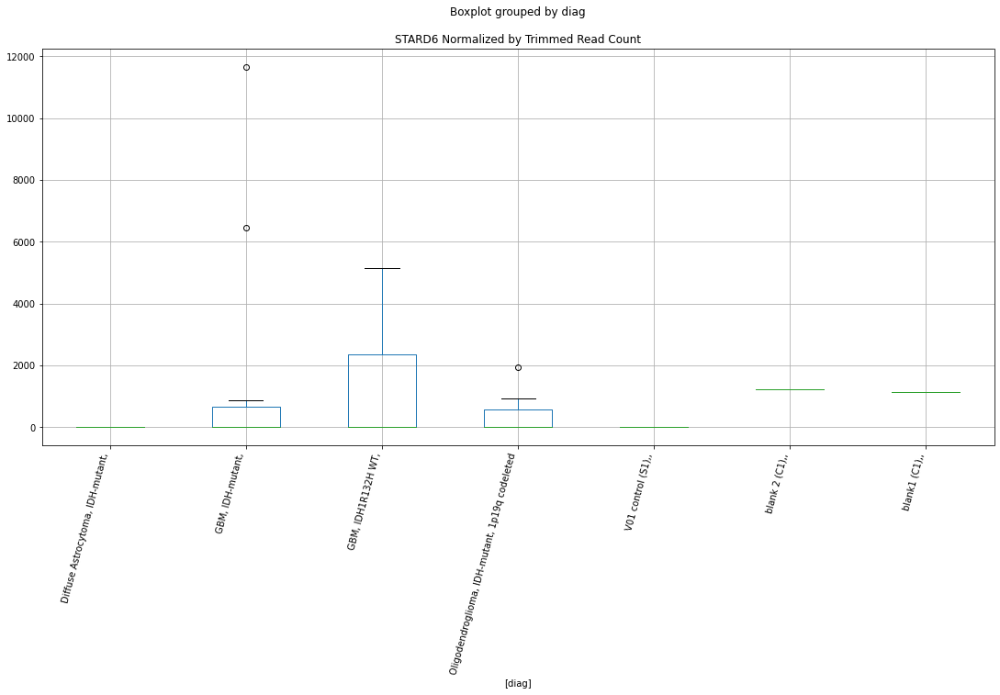

 p : 0.04220303105994332  ( t : 2.1868005370043724 ) :  D-plex  :  bbduk2  :  ZNF185
Control and blanks
73     6957.08
337       0.00
Name: ZNF185, dtype: float64
205    19700.0
Name: ZNF185, dtype: float64
469    0.0
Name: ZNF185, dtype: float64


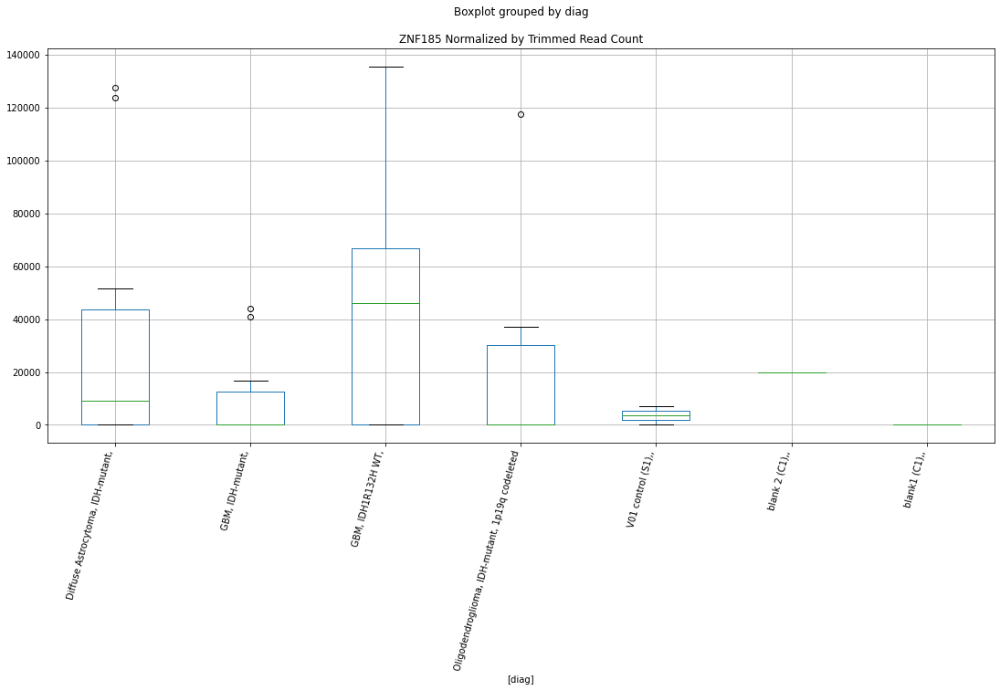

 p : 0.04225069049529155  ( t : 2.1862329086921473 ) :  D-plex  :  cutadapt2  :  VPS35
Control and blanks
76     0.0
340    0.0
Name: VPS35, dtype: float64
208    1410.88
Name: VPS35, dtype: float64
472    1733.87
Name: VPS35, dtype: float64


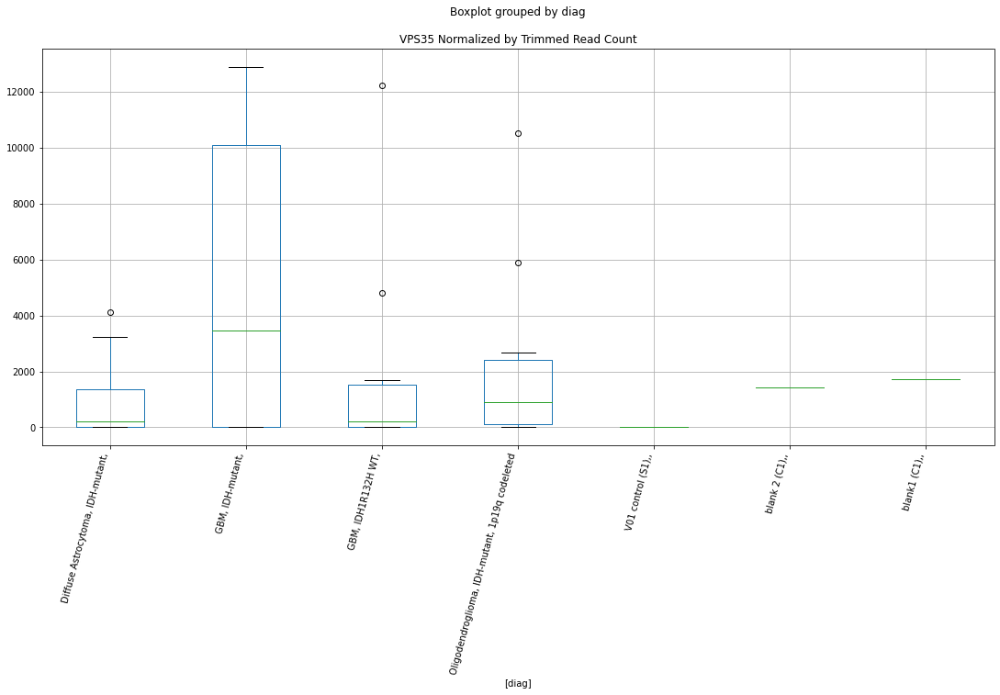

 p : 0.042358831902753497  ( t : 2.184947109211128 ) :  Lexogen  :  bbduk2  :  TRPS1
Control and blanks
79         0.00
343    15286.63
Name: TRPS1, dtype: float64
211    19678.06
Name: TRPS1, dtype: float64
475    4311.28
Name: TRPS1, dtype: float64


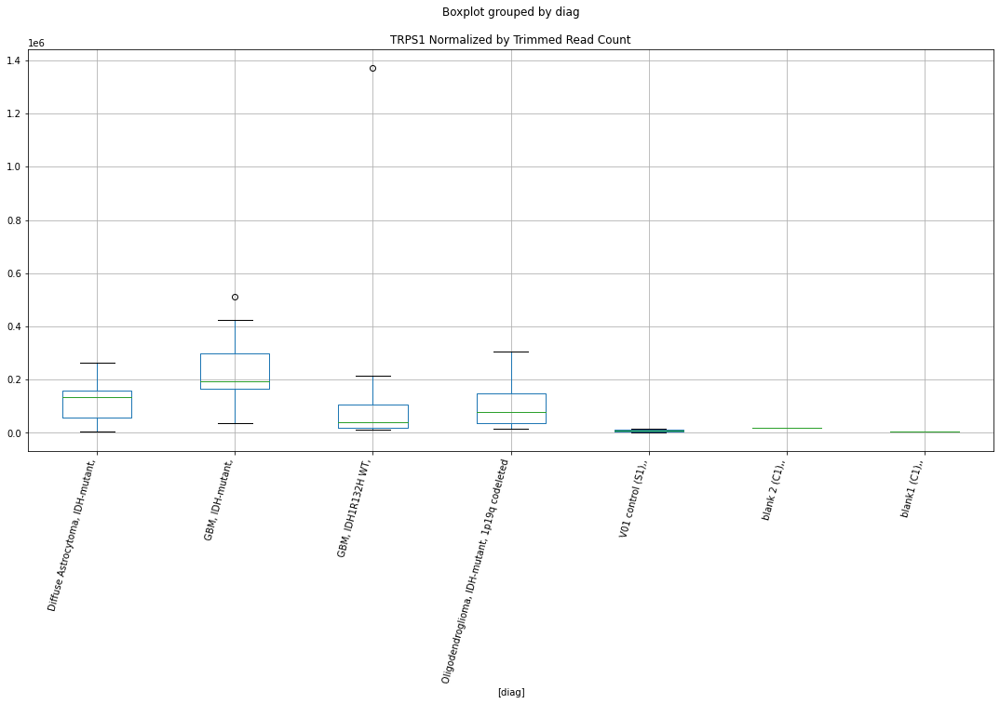

 p : 0.04238090548616272  ( t : 2.184685024667111 ) :  Lexogen  :  bbduk2  :  TRIM28
Control and blanks
79         0.00
343    28450.12
Name: TRIM28, dtype: float64
211    0.0
Name: TRIM28, dtype: float64
475    0.0
Name: TRIM28, dtype: float64


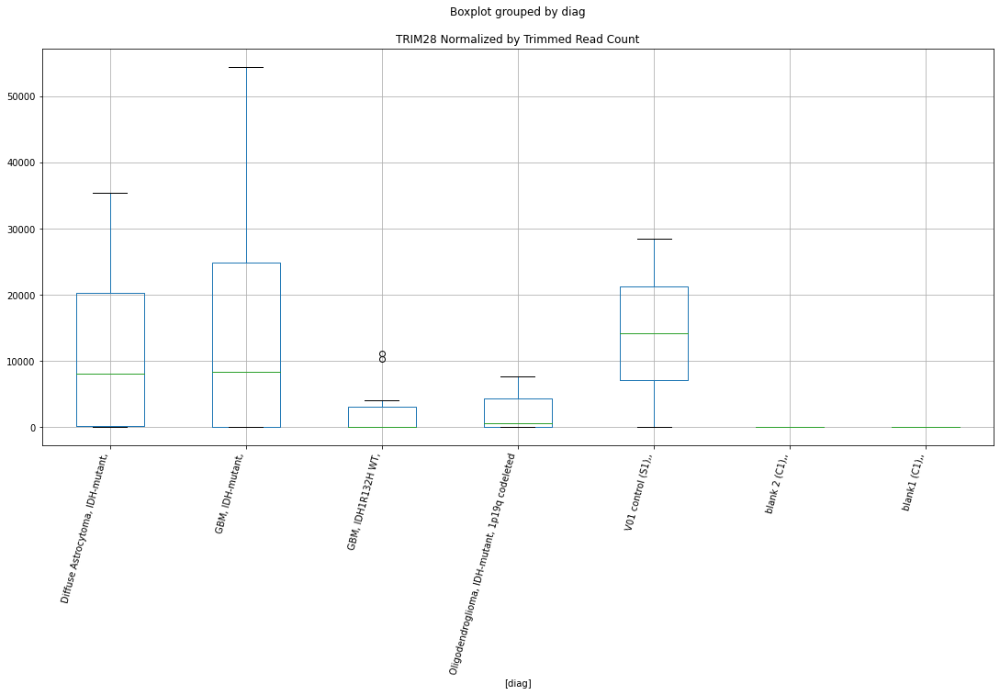

 p : 0.04240359834236353  ( t : 2.1844157178155914 ) :  Lexogen  :  cutadapt2  :  UGT2B7
Control and blanks
82       0.00
346    841.74
Name: UGT2B7, dtype: float64
214    542.45
Name: UGT2B7, dtype: float64
478    0.0
Name: UGT2B7, dtype: float64


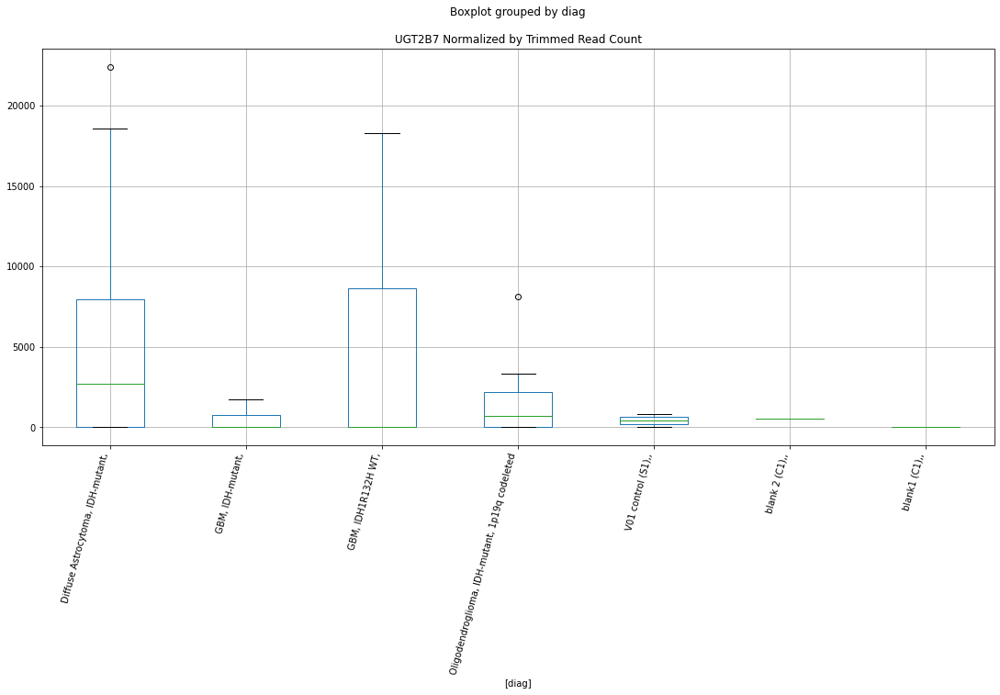

 p : 0.04254030993062937  ( t : 2.18279608744264 ) :  D-plex  :  bbduk2  :  TMEM203
Control and blanks
73     0.0
337    0.0
Name: TMEM203, dtype: float64
205    0.0
Name: TMEM203, dtype: float64
469    0.0
Name: TMEM203, dtype: float64


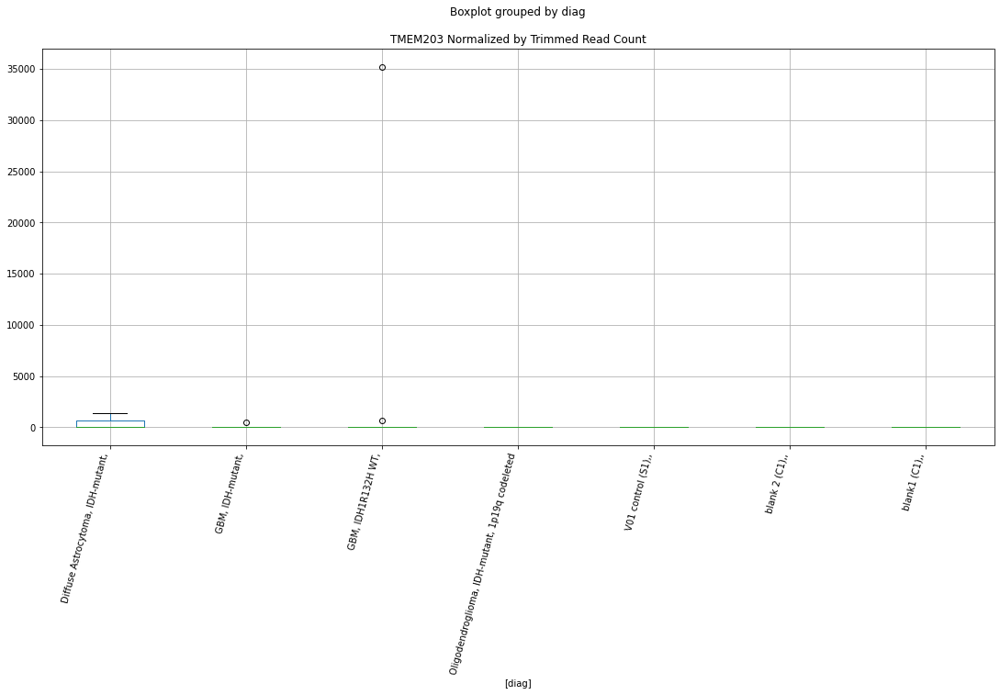

 p : 0.042609322967994606  ( t : 2.18198029756647 ) :  D-plex  :  bbduk2  :  UBE3D
Control and blanks
73     773.01
337      0.00
Name: UBE3D, dtype: float64
205    2328.18
Name: UBE3D, dtype: float64
469    0.0
Name: UBE3D, dtype: float64


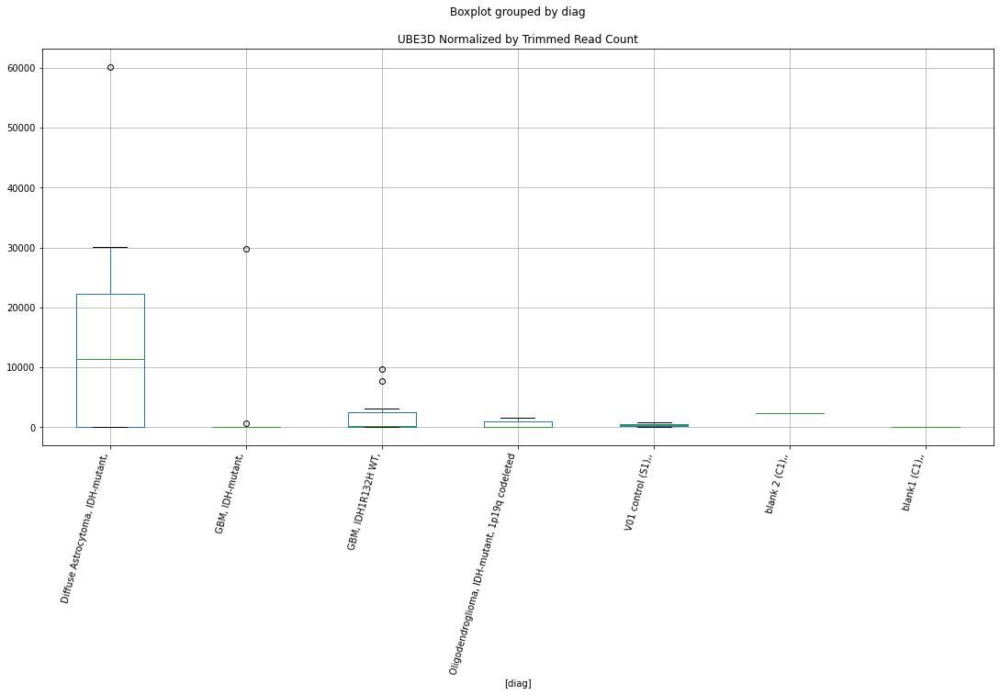

 p : 0.04262418729525941  ( t : 2.181804747761634 ) :  Lexogen  :  bbduk2  :  TLN2
Control and blanks
79     30042.57
343    31422.52
Name: TLN2, dtype: float64
211    12025.48
Name: TLN2, dtype: float64
475    11017.72
Name: TLN2, dtype: float64


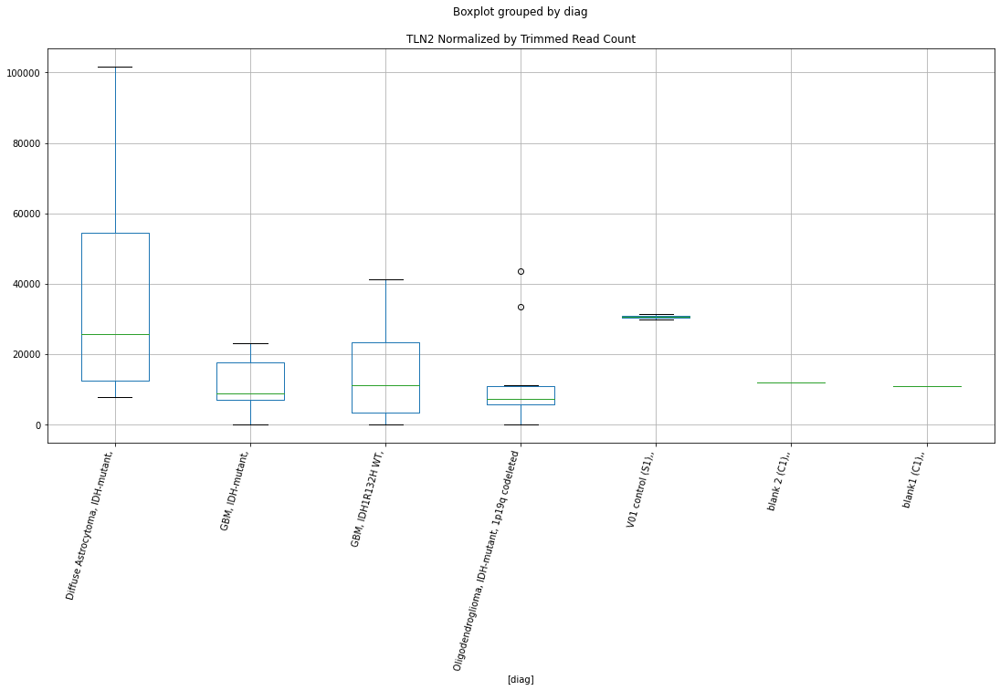

 p : 0.04262605962066753  ( t : 2.1817826393139472 ) :  D-plex  :  bbduk2  :  TBX21
Control and blanks
73     68024.74
337        0.00
Name: TBX21, dtype: float64
205    1253.64
Name: TBX21, dtype: float64
469    3549.16
Name: TBX21, dtype: float64


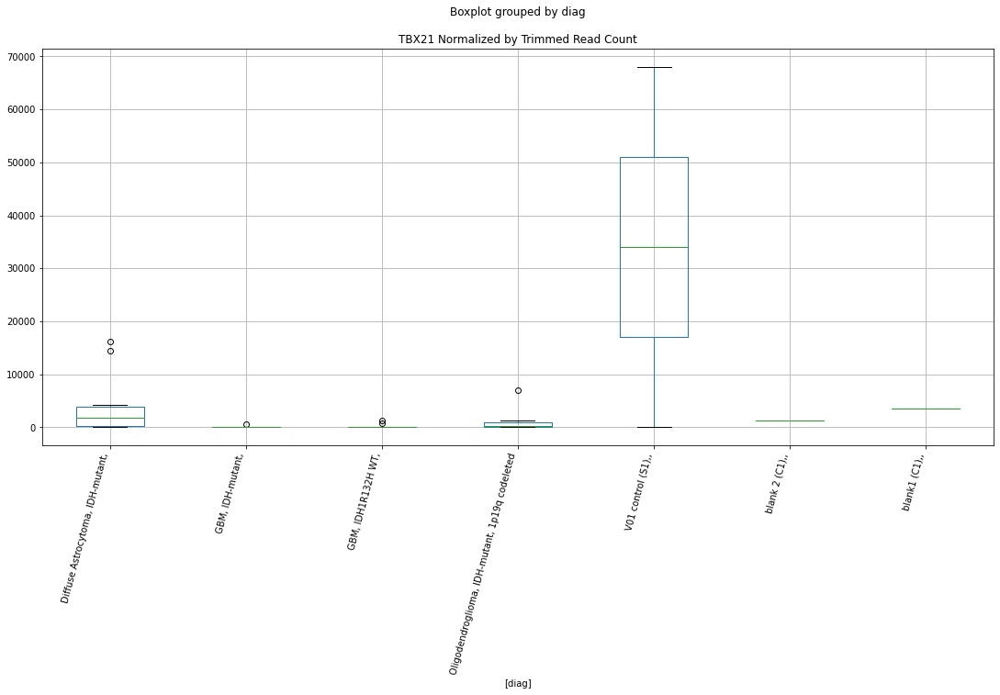

 p : 0.042690981090131135  ( t : 2.181016595634005 ) :  D-plex  :  bbduk2  :  VEGFC
Control and blanks
73     28601.31
337    91686.20
Name: VEGFC, dtype: float64
205    197358.23
Name: VEGFC, dtype: float64
469    299904.35
Name: VEGFC, dtype: float64


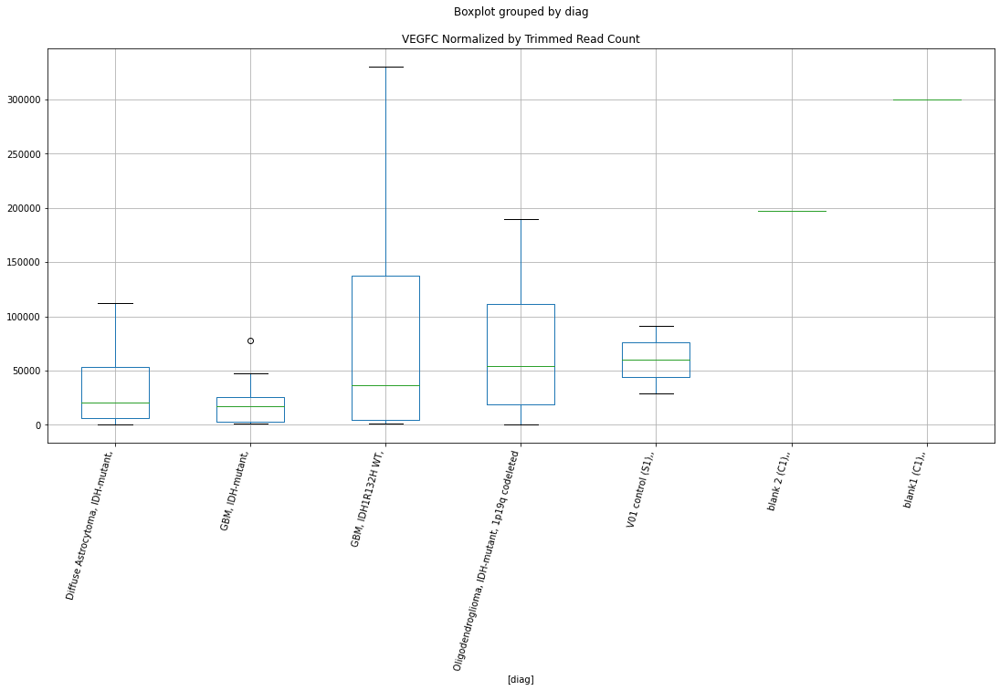

 p : 0.04276360369625654  ( t : 2.1801609463833316 ) :  D-plex  :  bbduk2  :  VPS13C
Control and blanks
73     0.0
337    0.0
Name: VPS13C, dtype: float64
205    10208.18
Name: VPS13C, dtype: float64
469    5915.27
Name: VPS13C, dtype: float64


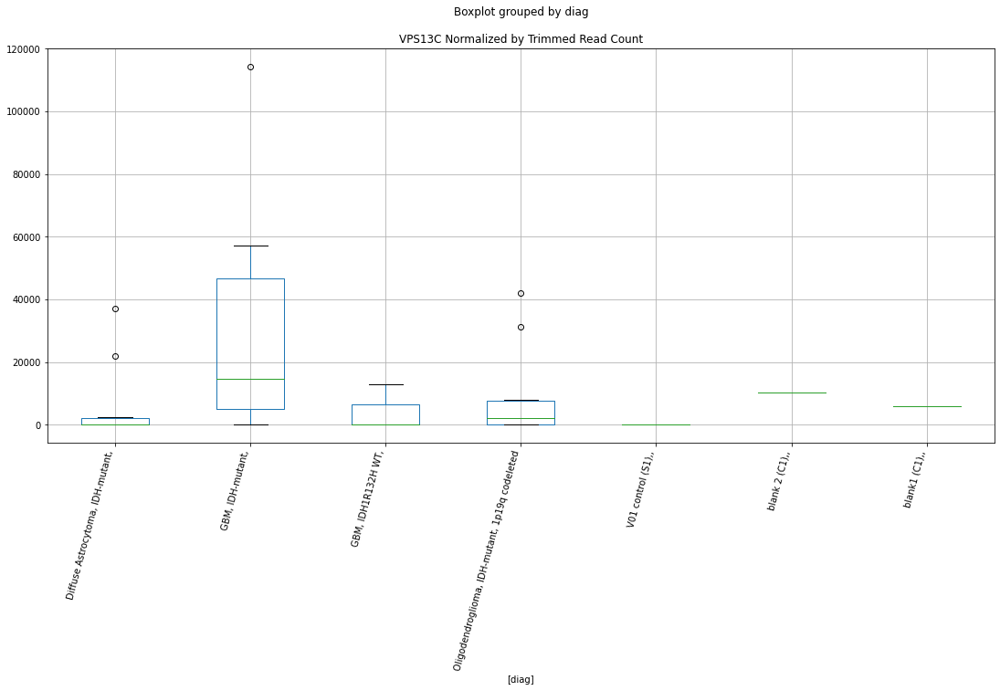

 p : 0.04278387792543008  ( t : 2.179922310519664 ) :  D-plex  :  bbduk2  :  TMCO6
Control and blanks
73      79619.87
337    189603.50
Name: TMCO6, dtype: float64
205    45310.01
Name: TMCO6, dtype: float64
469    65068.0
Name: TMCO6, dtype: float64


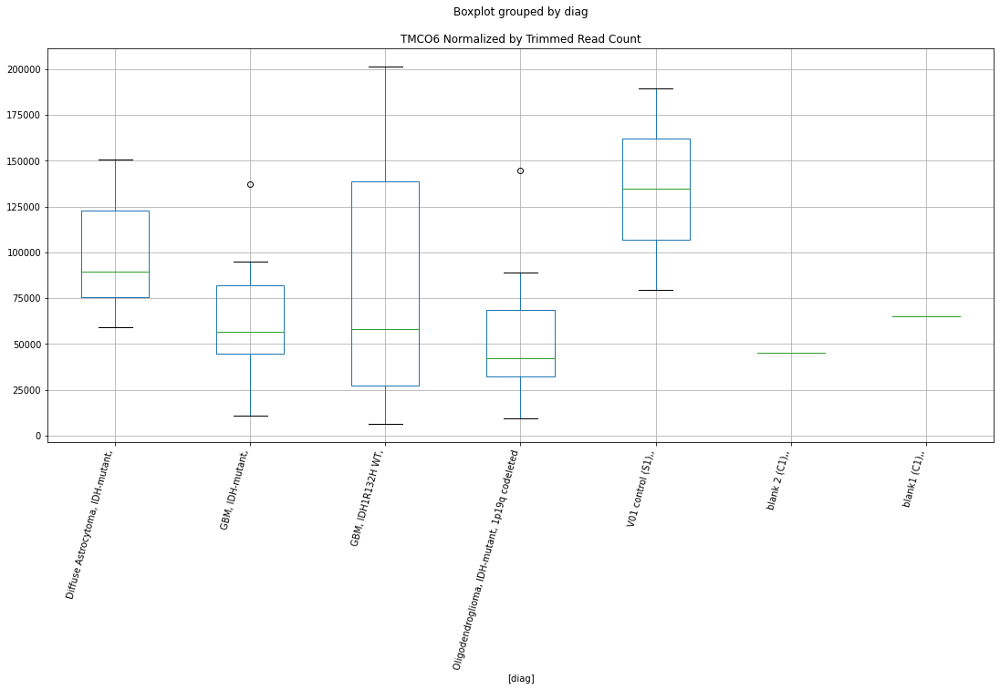

 p : 0.04286425893498708  ( t : 2.178977212472787 ) :  Lexogen  :  bbduk2  :  SVOP
Control and blanks
79        0.00
343    1061.57
Name: SVOP, dtype: float64
211    0.0
Name: SVOP, dtype: float64
475    958.06
Name: SVOP, dtype: float64


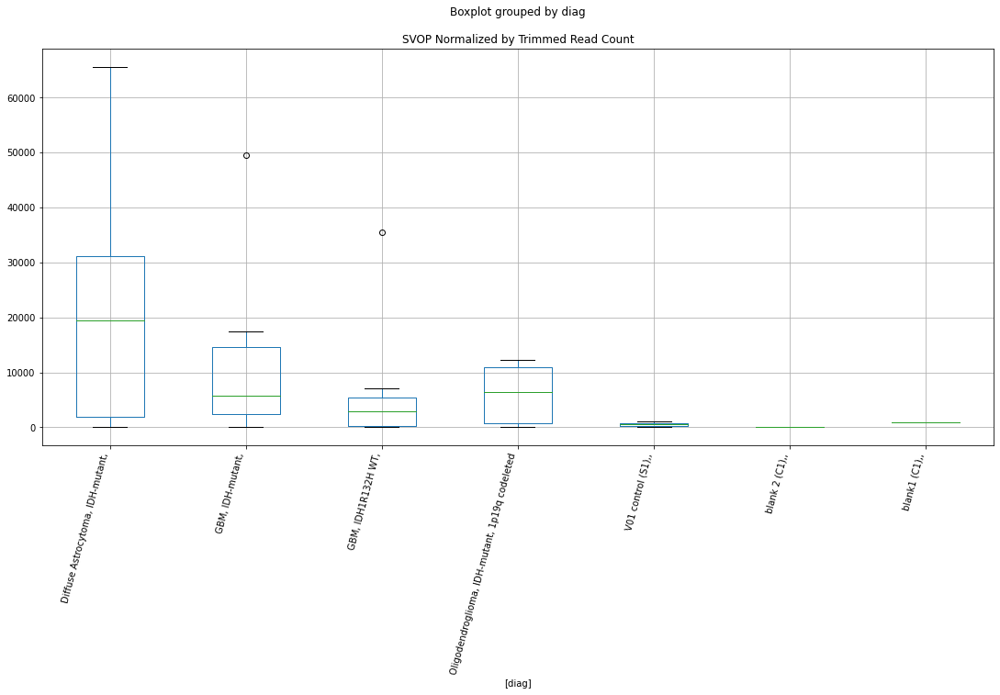

 p : 0.042928481064122094  ( t : 2.178223272699651 ) :  Lexogen  :  bbduk2  :  SUN2
Control and blanks
79          0.00
343    290870.61
Name: SUN2, dtype: float64
211    0.0
Name: SUN2, dtype: float64
475    0.0
Name: SUN2, dtype: float64


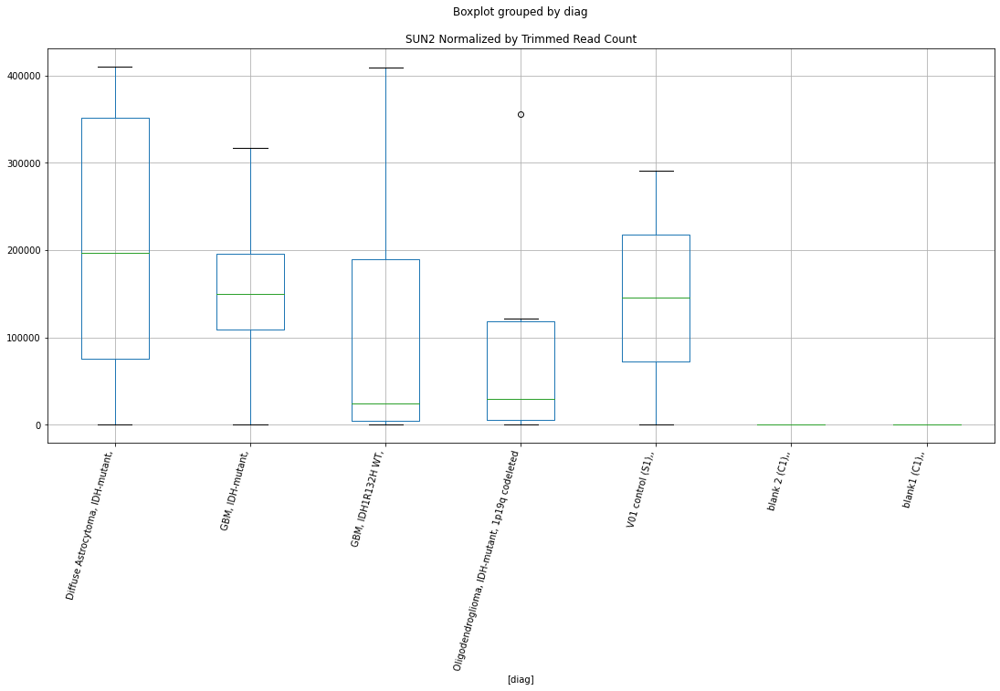

 p : 0.04294964207757409  ( t : 2.177975078021076 ) :  D-plex  :  bbduk2  :  TEKT4
Control and blanks
73     3092.03
337       0.00
Name: TEKT4, dtype: float64
205    2865.46
Name: TEKT4, dtype: float64
469    12422.07
Name: TEKT4, dtype: float64


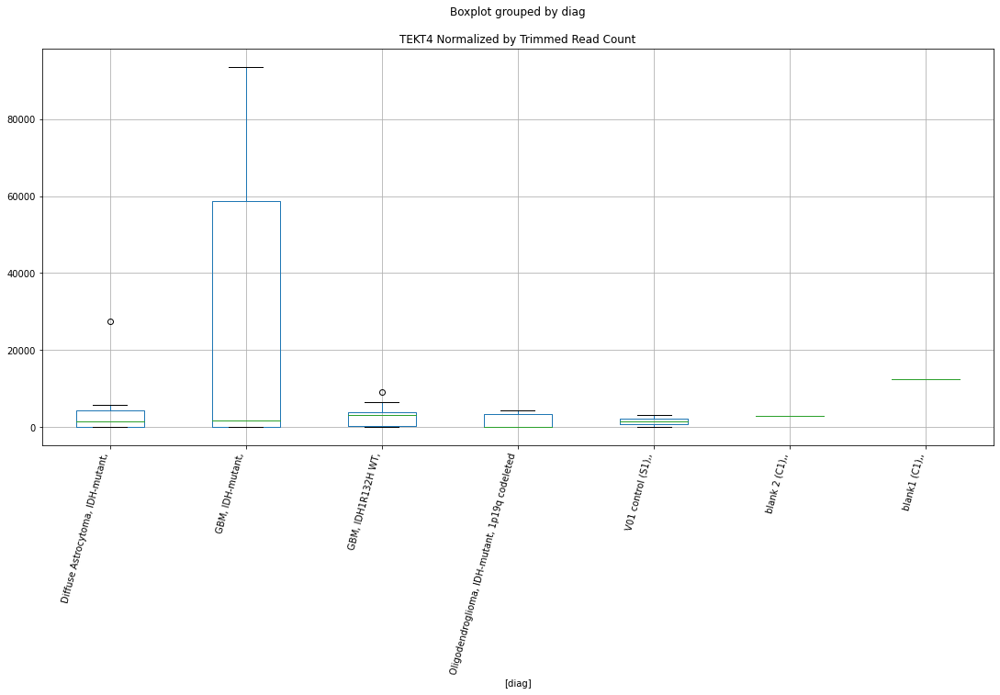

 p : 0.04299398735661383  ( t : 2.1774553214659975 ) :  D-plex  :  bbduk2  :  TF
Control and blanks
73         0.00
337    45398.02
Name: TF, dtype: float64
205    6447.27
Name: TF, dtype: float64
469    1774.58
Name: TF, dtype: float64


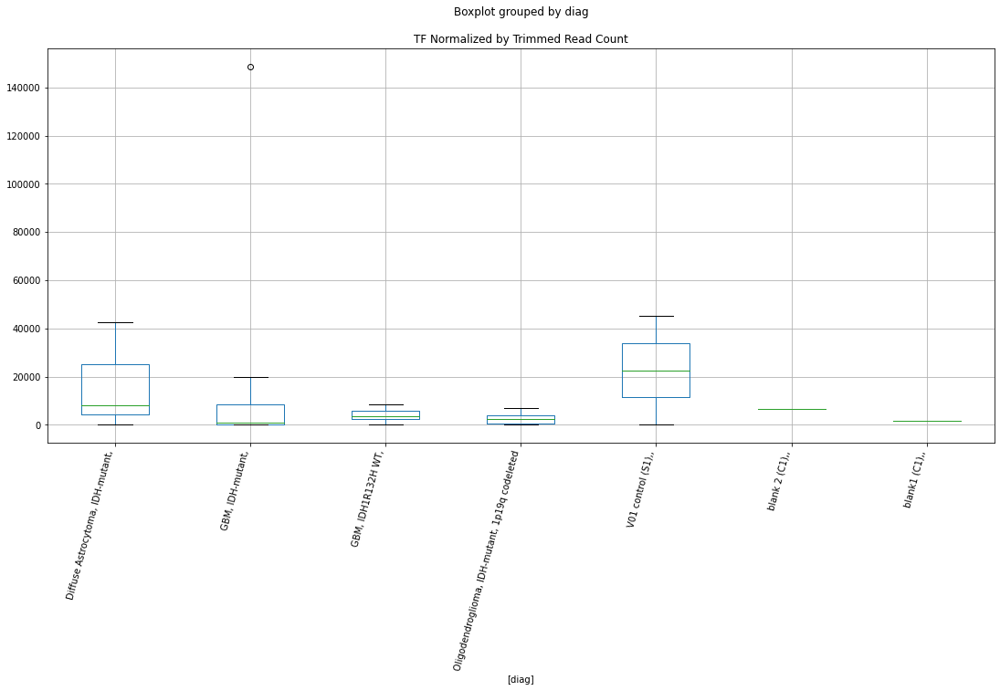

 p : 0.043155708810538  ( t : 2.1755639899407275 ) :  D-plex  :  cutadapt2  :  TSNARE1
Control and blanks
76      30304.57
340    276549.89
Name: TSNARE1, dtype: float64
208    262071.28
Name: TSNARE1, dtype: float64
472    129462.11
Name: TSNARE1, dtype: float64


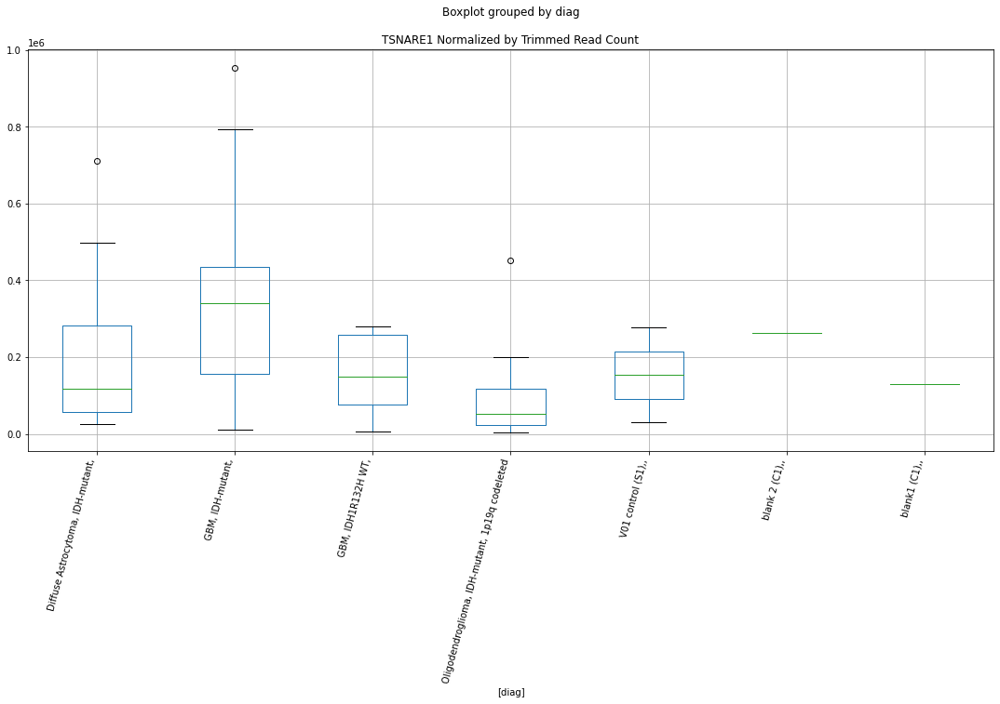

 p : 0.04329237381945782  ( t : 2.173970748719122 ) :  D-plex  :  bbduk2  :  VIRMA
Control and blanks
73     0.0
337    0.0
Name: VIRMA, dtype: float64
205    716.36
Name: VIRMA, dtype: float64
469    7689.86
Name: VIRMA, dtype: float64


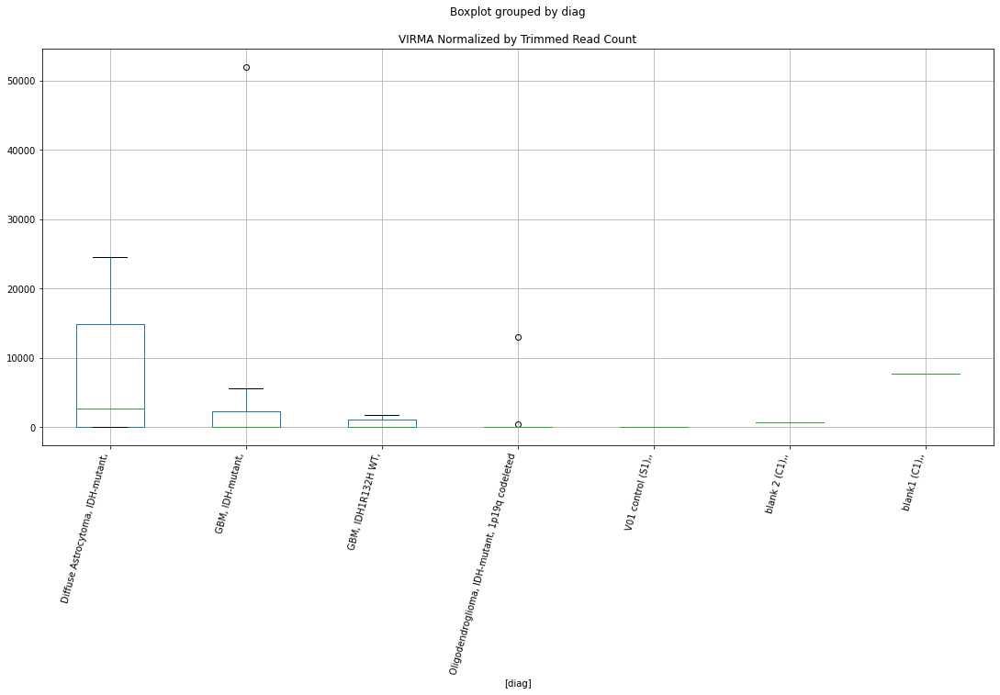

 p : 0.04332022180394818  ( t : 2.1736466619408903 ) :  Lexogen  :  cutadapt2  :  TNN
Control and blanks
82        0.00
346    1262.61
Name: TNN, dtype: float64
214    0.0
Name: TNN, dtype: float64
478    712.38
Name: TNN, dtype: float64


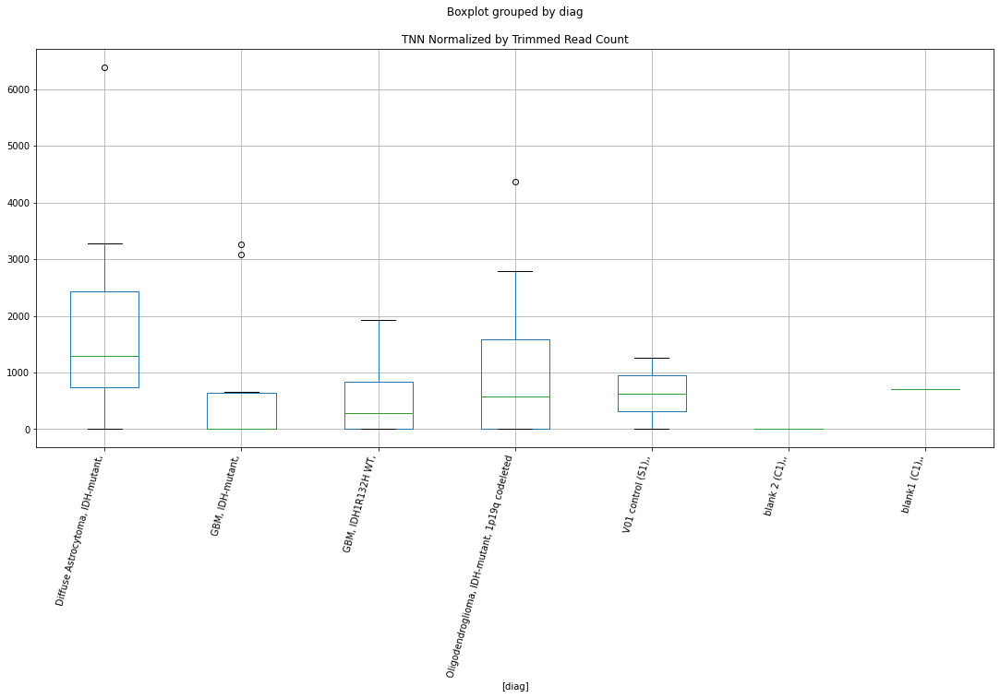

 p : 0.043400113626969626  ( t : 2.172717961906377 ) :  Lexogen  :  bbduk2  :  WASL
Control and blanks
79     0.0
343    0.0
Name: WASL, dtype: float64
211    0.0
Name: WASL, dtype: float64
475    239.52
Name: WASL, dtype: float64


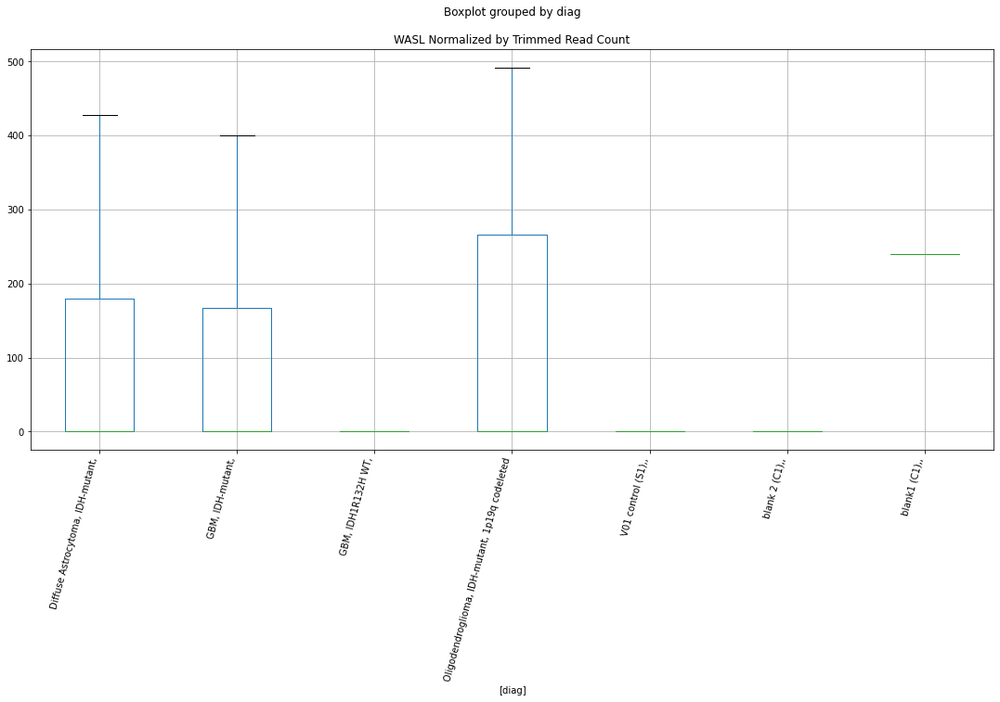

 p : 0.04341630150576476  ( t : 2.1725299771995807 ) :  D-plex  :  cutadapt2  :  ZNF362
Control and blanks
76     0.0
340    0.0
Name: ZNF362, dtype: float64
208    4232.65
Name: ZNF362, dtype: float64
472    4623.65
Name: ZNF362, dtype: float64


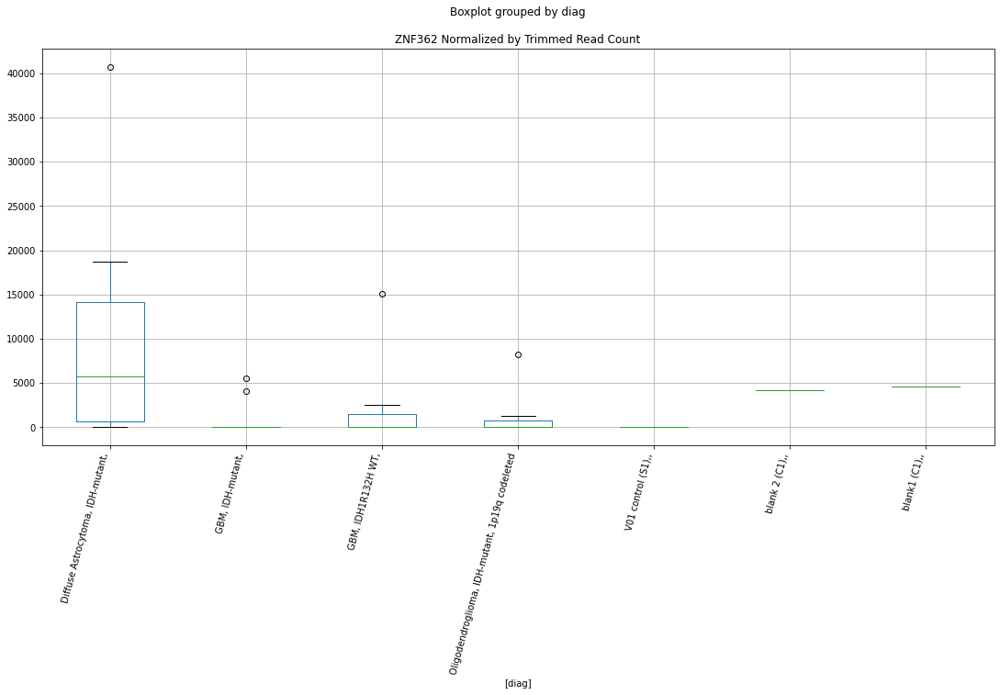

 p : 0.0434169956893311  ( t : 2.1725219173012937 ) :  D-plex  :  cutadapt2  :  TMEM259
Control and blanks
76     831860.41
340     55486.12
Name: TMEM259, dtype: float64
208    665054.38
Name: TMEM259, dtype: float64
472    473345.83
Name: TMEM259, dtype: float64


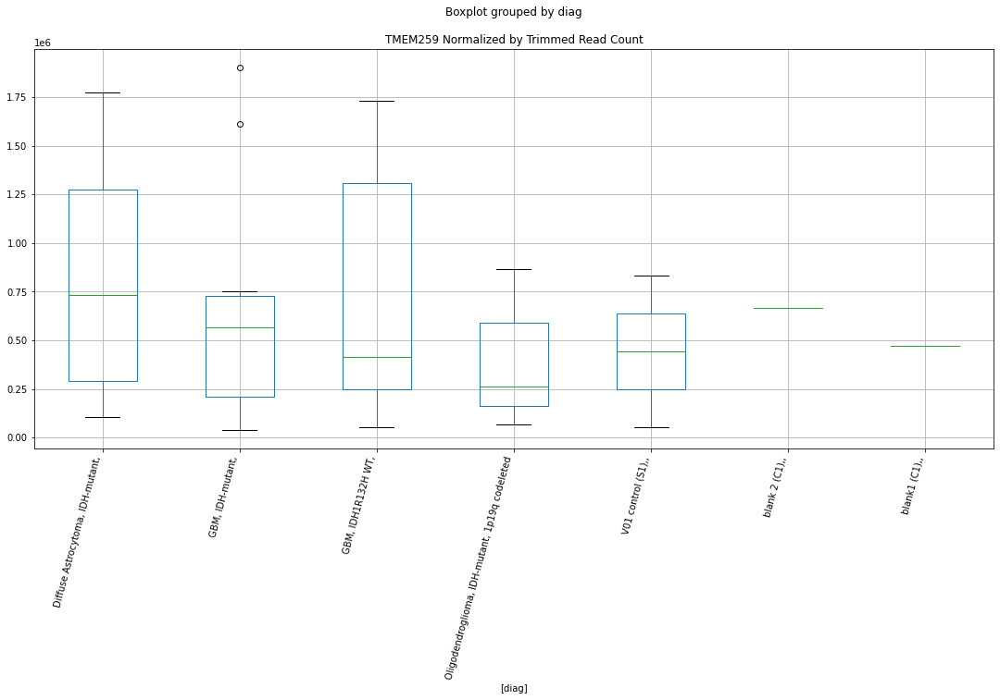

 p : 0.0434800425437994  ( t : 2.1717903961873612 ) :  Lexogen  :  cutadapt2  :  VCAN
Control and blanks
82       0.00
346    420.87
Name: VCAN, dtype: float64
214    0.0
Name: VCAN, dtype: float64
478    0.0
Name: VCAN, dtype: float64


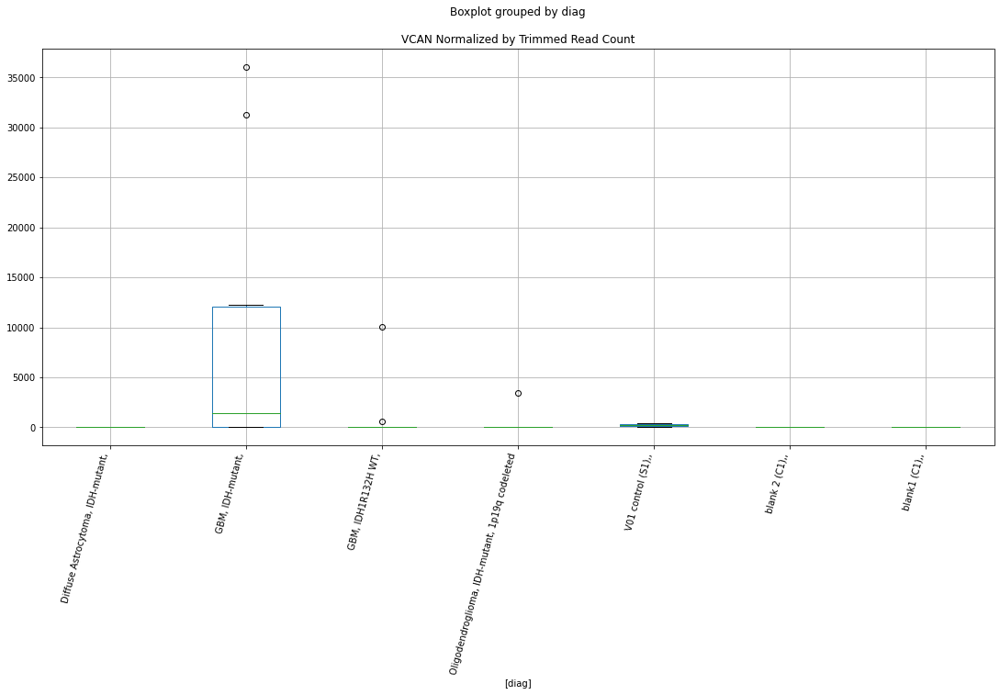

 p : 0.043493443160177024  ( t : 2.1716350364752364 ) :  D-plex  :  bbduk2  :  ZNF766
Control and blanks
73     0.0
337    0.0
Name: ZNF766, dtype: float64
205    1790.91
Name: ZNF766, dtype: float64
469    4140.69
Name: ZNF766, dtype: float64


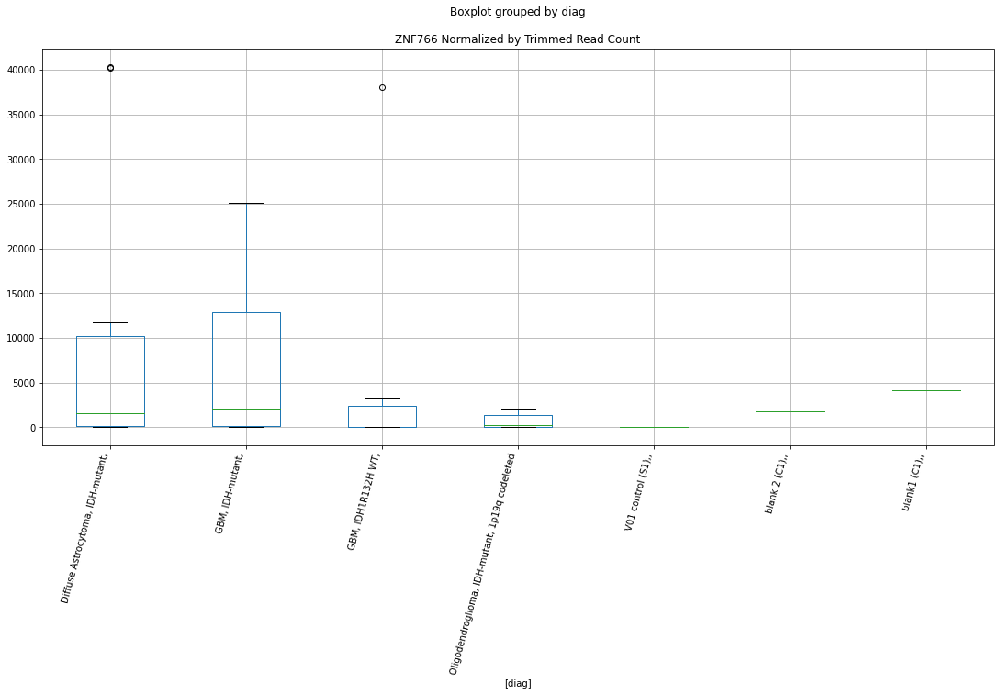

 p : 0.043570992896963125  ( t : 2.1707368254346213 ) :  D-plex  :  bbduk2  :  TIMD4
Control and blanks
73     0.0
337    0.0
Name: TIMD4, dtype: float64
205    716.36
Name: TIMD4, dtype: float64
469    2366.11
Name: TIMD4, dtype: float64


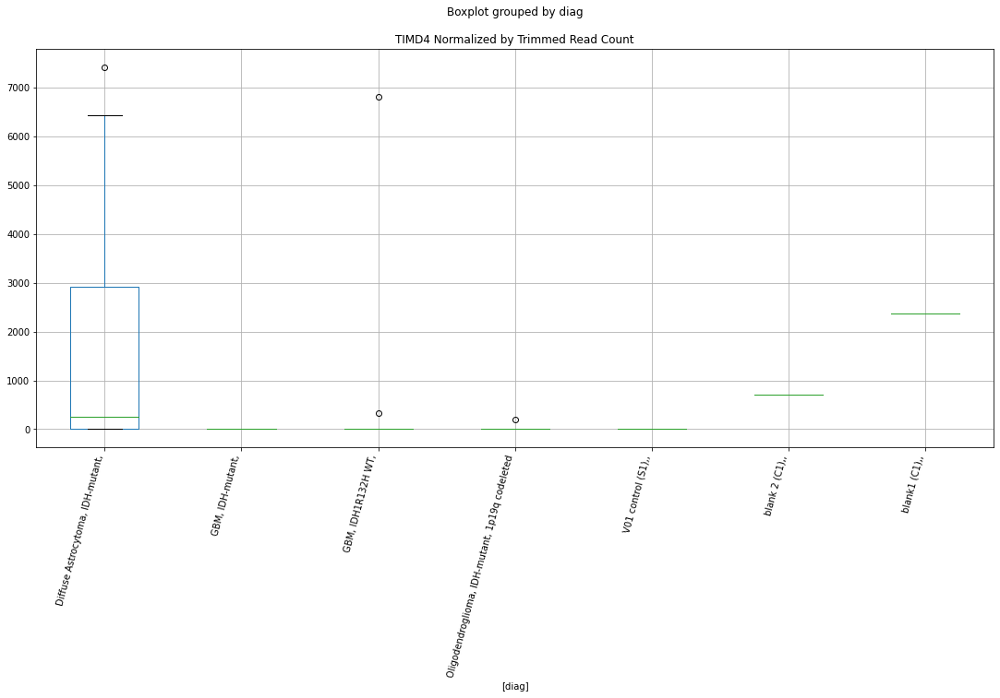

 p : 0.04359844728306702  ( t : 2.170419188956395 ) :  D-plex  :  bbduk2  :  ZNF879
Control and blanks
73     0.0
337    0.0
Name: ZNF879, dtype: float64
205    1432.73
Name: ZNF879, dtype: float64
469    0.0
Name: ZNF879, dtype: float64


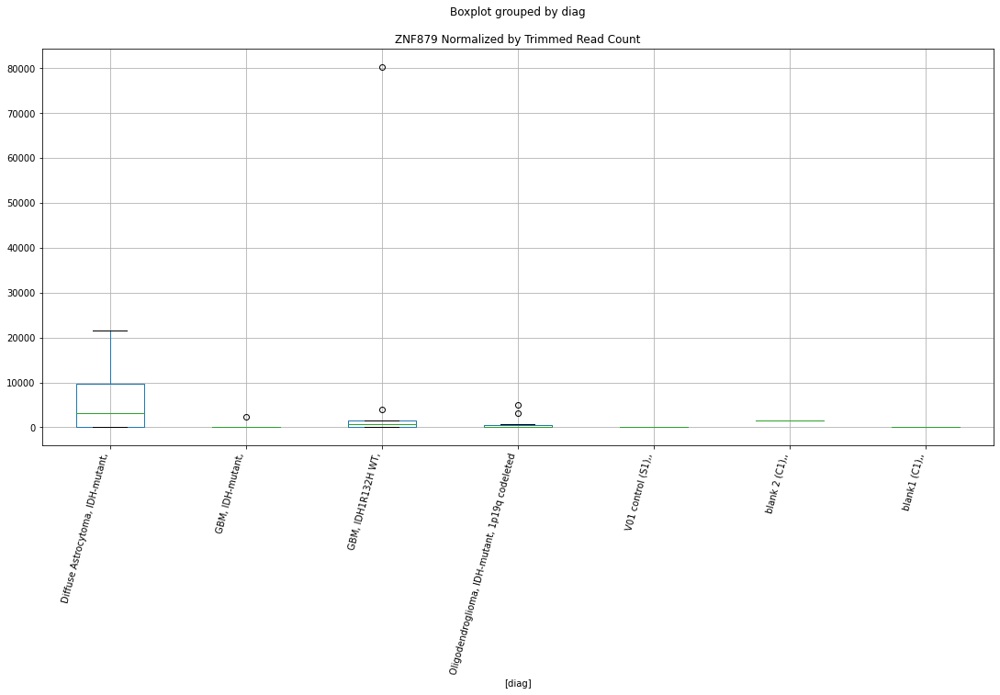

 p : 0.043598482290181595  ( t : 2.17041878405474 ) :  D-plex  :  bbduk2  :  ZNF282
Control and blanks
73     2319.03
337    2670.47
Name: ZNF282, dtype: float64
205    1611.82
Name: ZNF282, dtype: float64
469    3549.16
Name: ZNF282, dtype: float64


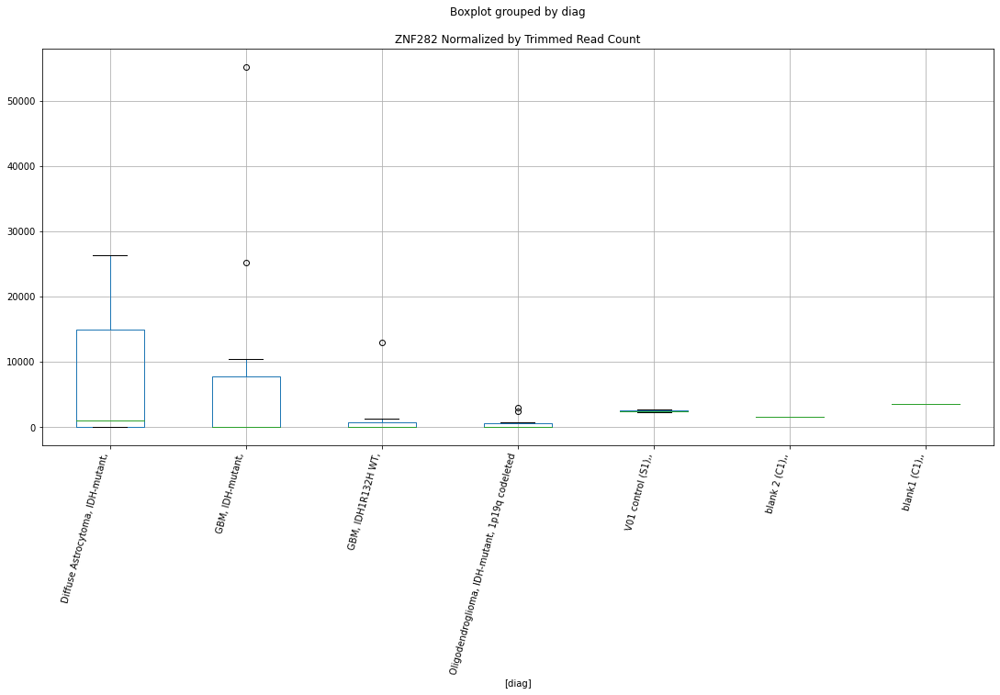

 p : 0.0435987866210365  ( t : 2.1704152640951797 ) :  D-plex  :  cutadapt2  :  UCP1
Control and blanks
76     0.0
340    0.0
Name: UCP1, dtype: float64
208    1763.6
Name: UCP1, dtype: float64
472    2311.82
Name: UCP1, dtype: float64


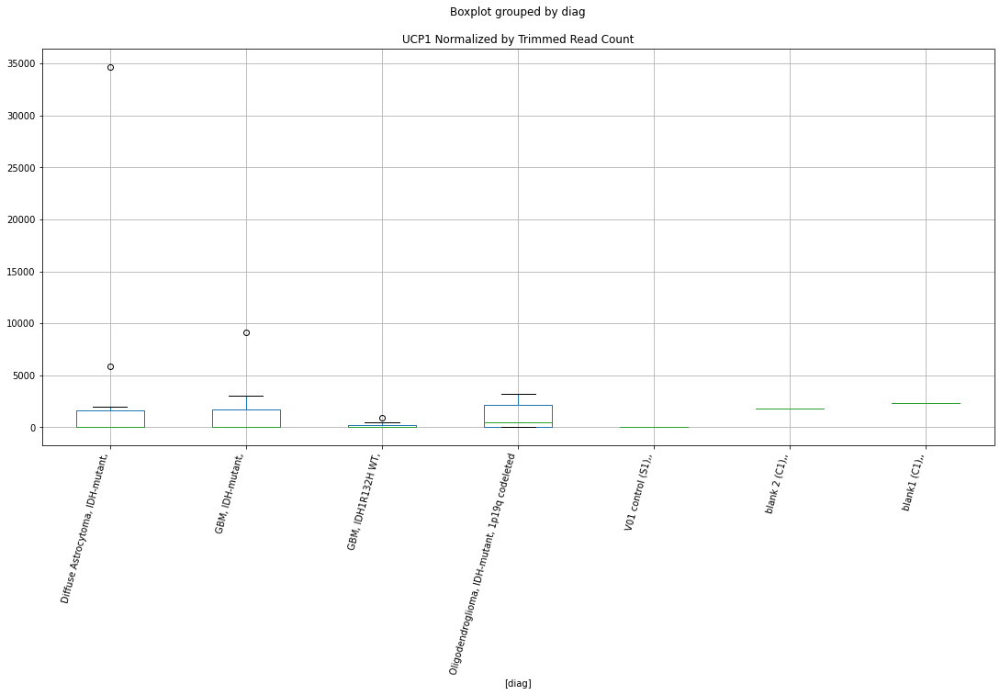

 p : 0.043601637989093486  ( t : 2.1703822856195782 ) :  D-plex  :  cutadapt2  :  ZNF160
Control and blanks
76     0.0
340    0.0
Name: ZNF160, dtype: float64
208    13403.38
Name: ZNF160, dtype: float64
472    8669.34
Name: ZNF160, dtype: float64


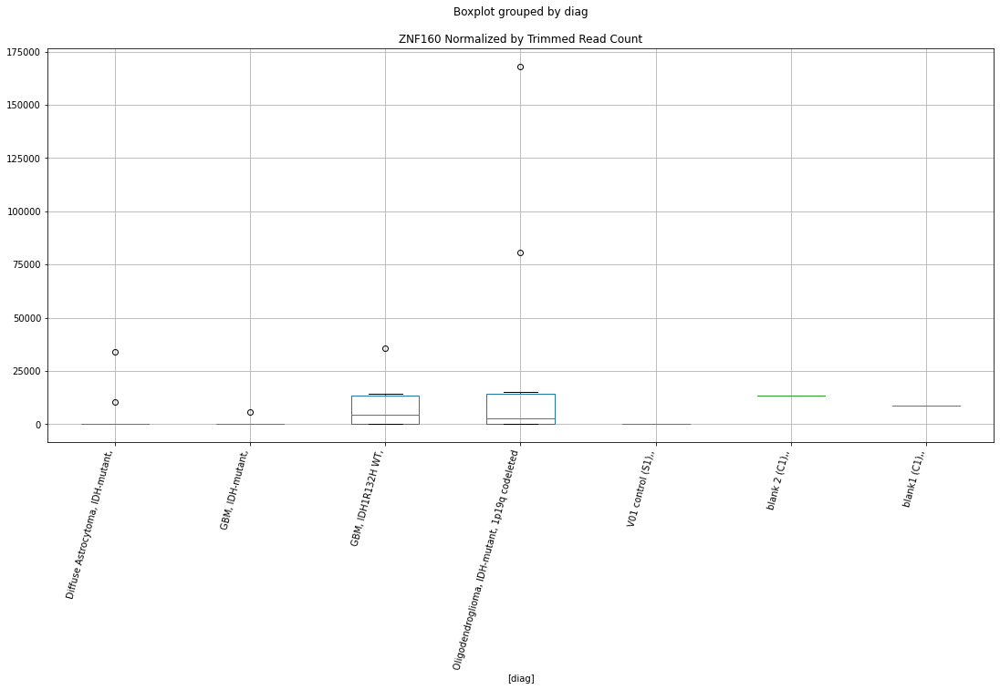

 p : 0.04369505914467102  ( t : 2.1693028819206024 ) :  D-plex  :  bbduk2  :  VTA1
Control and blanks
73     0.0
337    0.0
Name: VTA1, dtype: float64
205    3044.55
Name: VTA1, dtype: float64
469    2366.11
Name: VTA1, dtype: float64


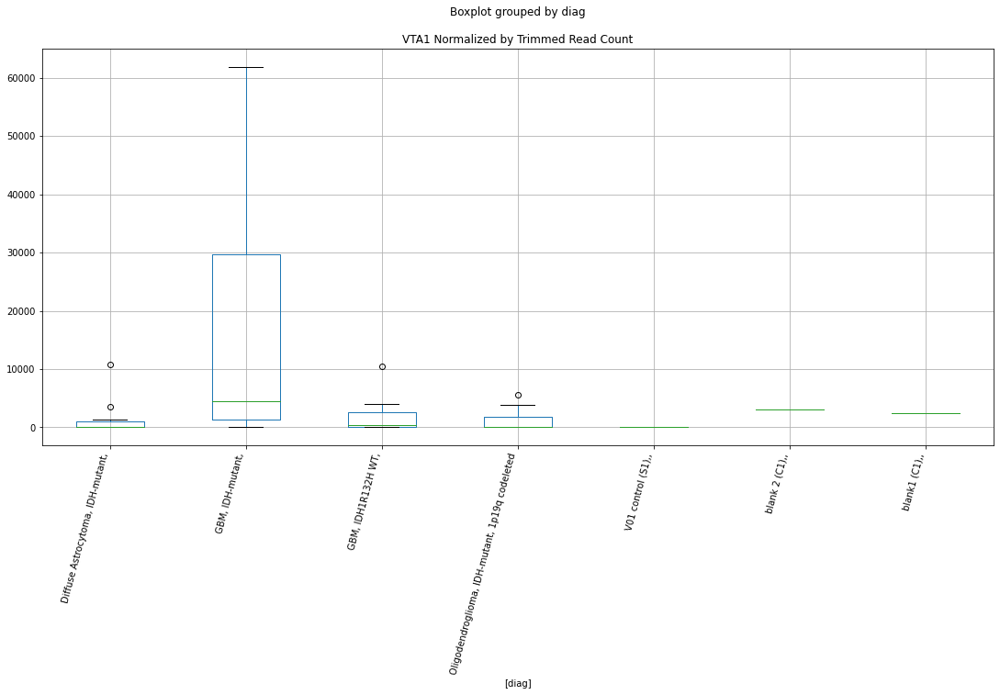

 p : 0.04372012018548119  ( t : 2.169013681895369 ) :  D-plex  :  bbduk2  :  TSPYL5
Control and blanks
73     773.01
337      0.00
Name: TSPYL5, dtype: float64
205    537.27
Name: TSPYL5, dtype: float64
469    591.53
Name: TSPYL5, dtype: float64


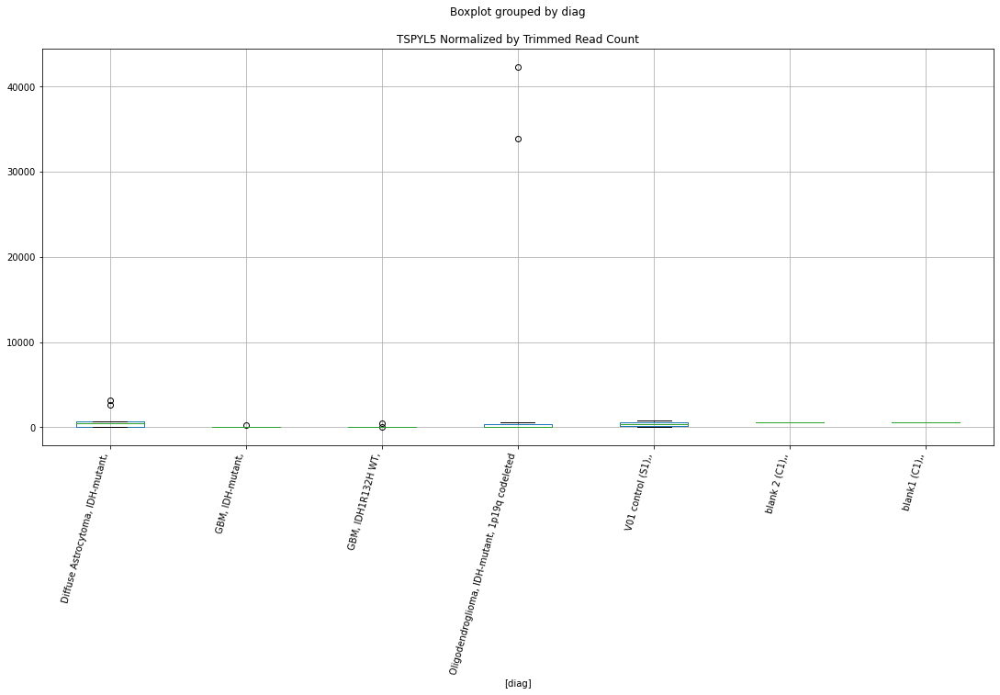

 p : 0.04373931948815452  ( t : 2.16879222795754 ) :  Lexogen  :  bbduk2  :  TOR4A
Control and blanks
79     11444.79
343    15498.95
Name: TOR4A, dtype: float64
211    16125.07
Name: TOR4A, dtype: float64
475    13412.88
Name: TOR4A, dtype: float64


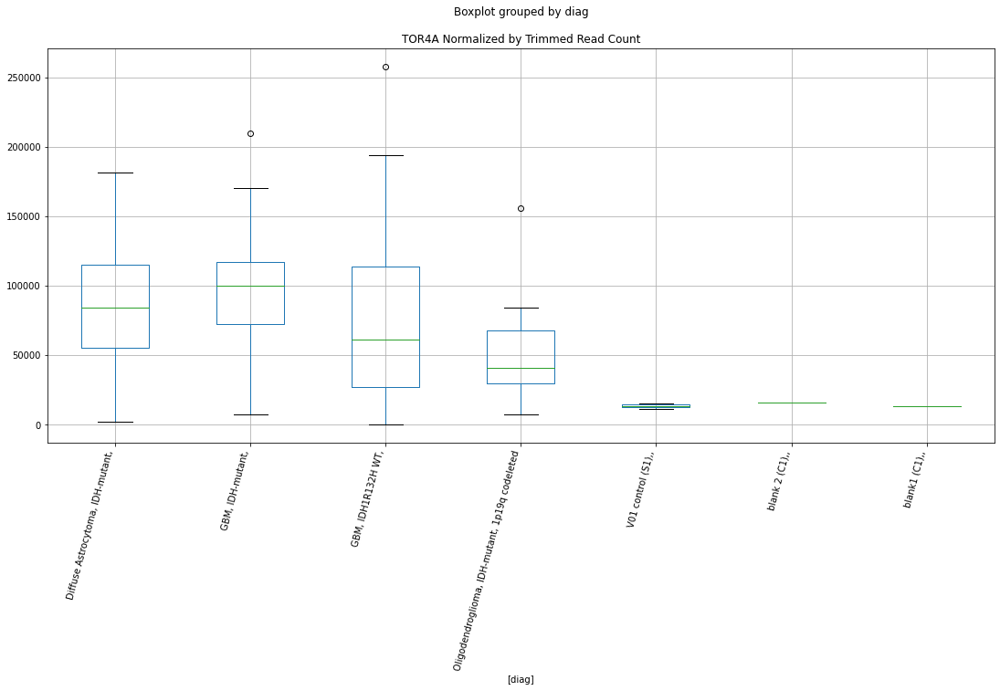

 p : 0.04374266415363858  ( t : 2.1687536580888276 ) :  D-plex  :  bbduk2  :  SRGAP3
Control and blanks
73     0.0
337    0.0
Name: SRGAP3, dtype: float64
205    10208.18
Name: SRGAP3, dtype: float64
469    7689.86
Name: SRGAP3, dtype: float64


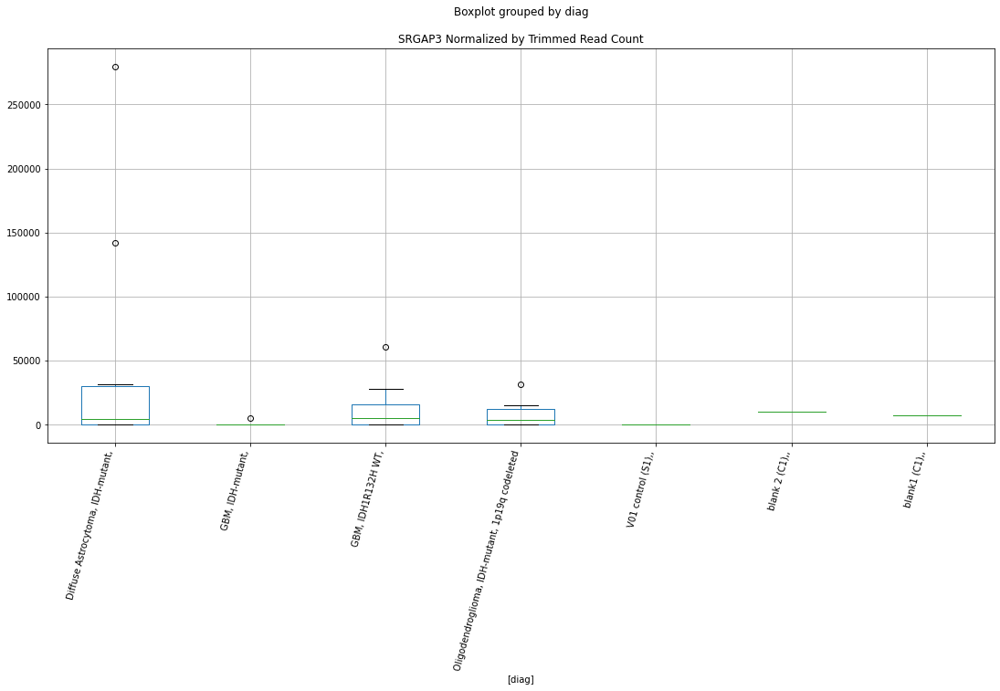

 p : 0.04375194312723574  ( t : 2.1686466693560127 ) :  D-plex  :  cutadapt2  :  VTI1A
Control and blanks
76      3030.46
340    39632.95
Name: VTI1A, dtype: float64
208    1234.52
Name: VTI1A, dtype: float64
472    3467.74
Name: VTI1A, dtype: float64


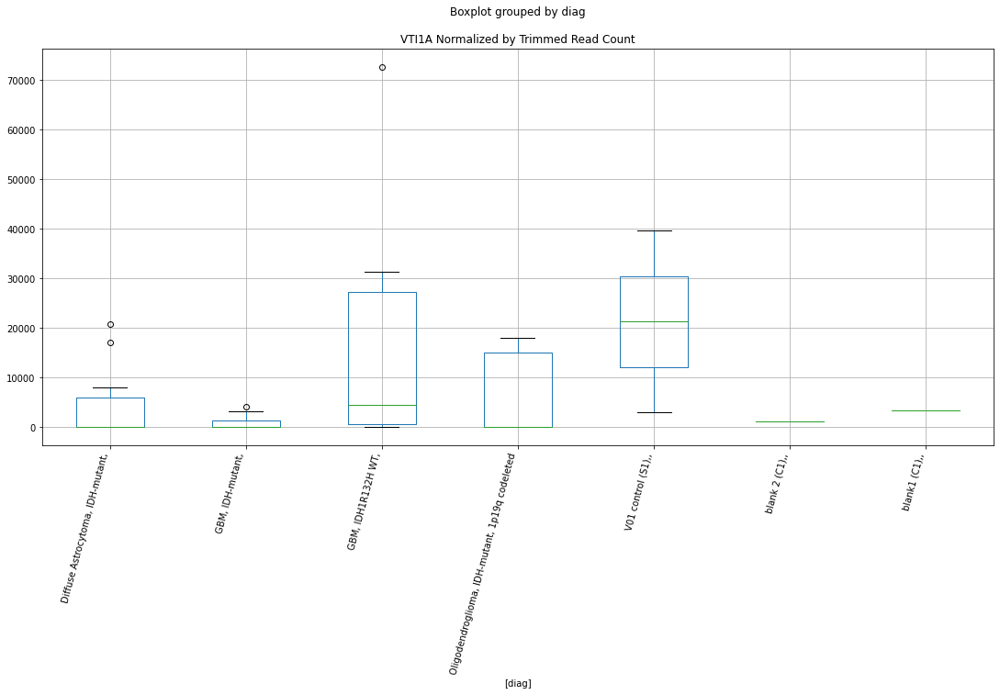

 p : 0.04377073378223157  ( t : 2.168430072326807 ) :  D-plex  :  cutadapt2  :  TIMD4
Control and blanks
76     0.0
340    0.0
Name: TIMD4, dtype: float64
208    705.44
Name: TIMD4, dtype: float64
472    2311.82
Name: TIMD4, dtype: float64


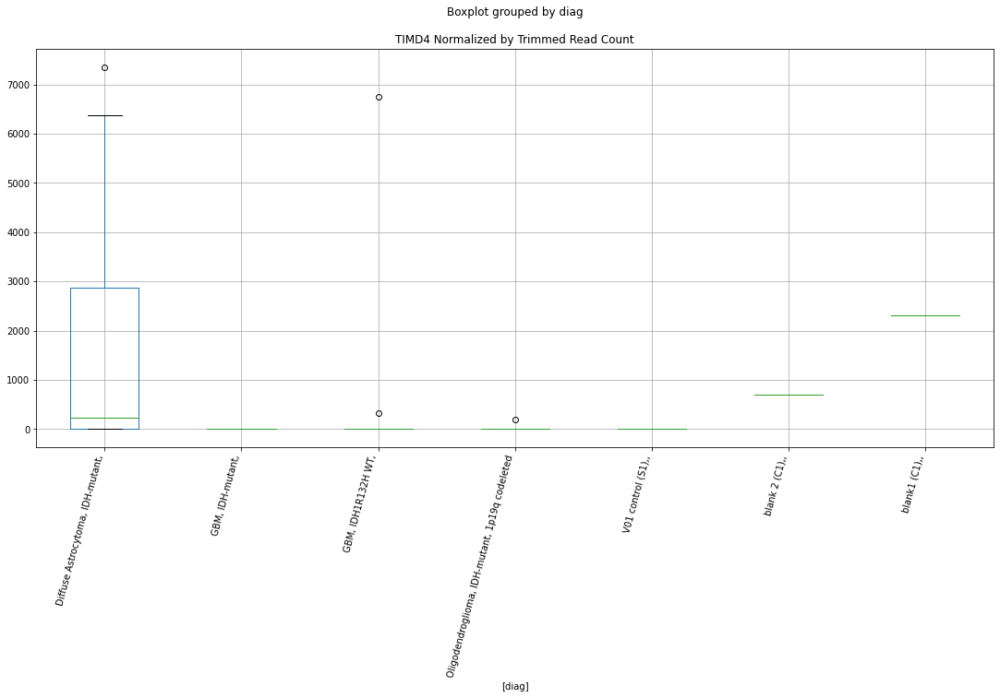

 p : 0.043847217431804295  ( t : 2.167549334353672 ) :  D-plex  :  cutadapt2  :  VTA1
Control and blanks
76     0.0
340    0.0
Name: VTA1, dtype: float64
208    2469.04
Name: VTA1, dtype: float64
472    2311.82
Name: VTA1, dtype: float64


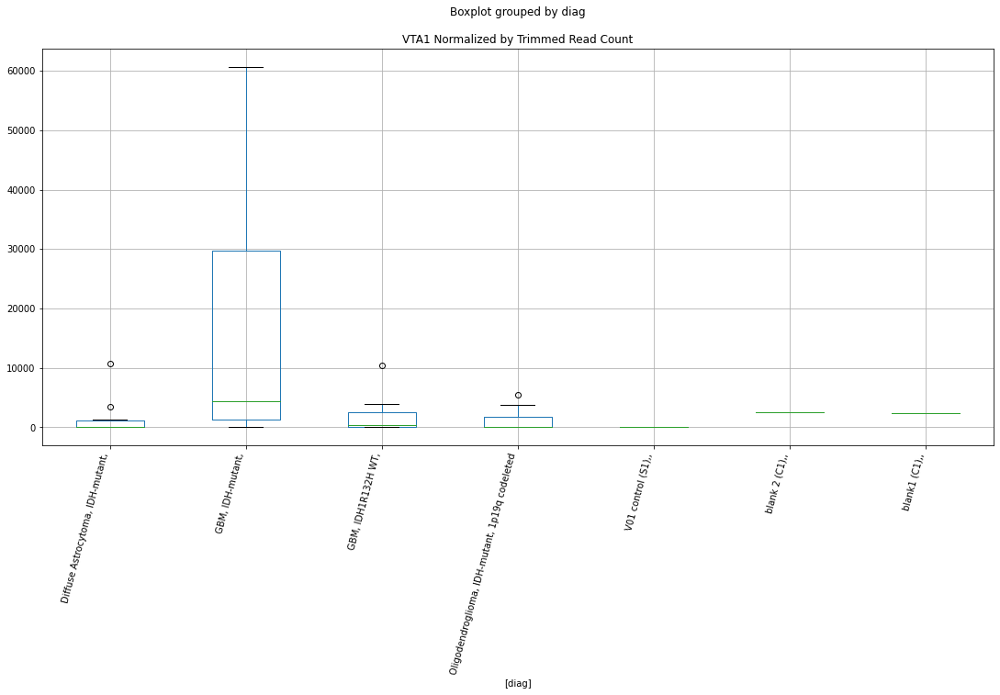

 p : 0.043852215114097724  ( t : 2.167491833124923 ) :  Lexogen  :  cutadapt2  :  TACC2
Control and blanks
82     0.0
346    0.0
Name: TACC2, dtype: float64
214    0.0
Name: TACC2, dtype: float64
478    0.0
Name: TACC2, dtype: float64


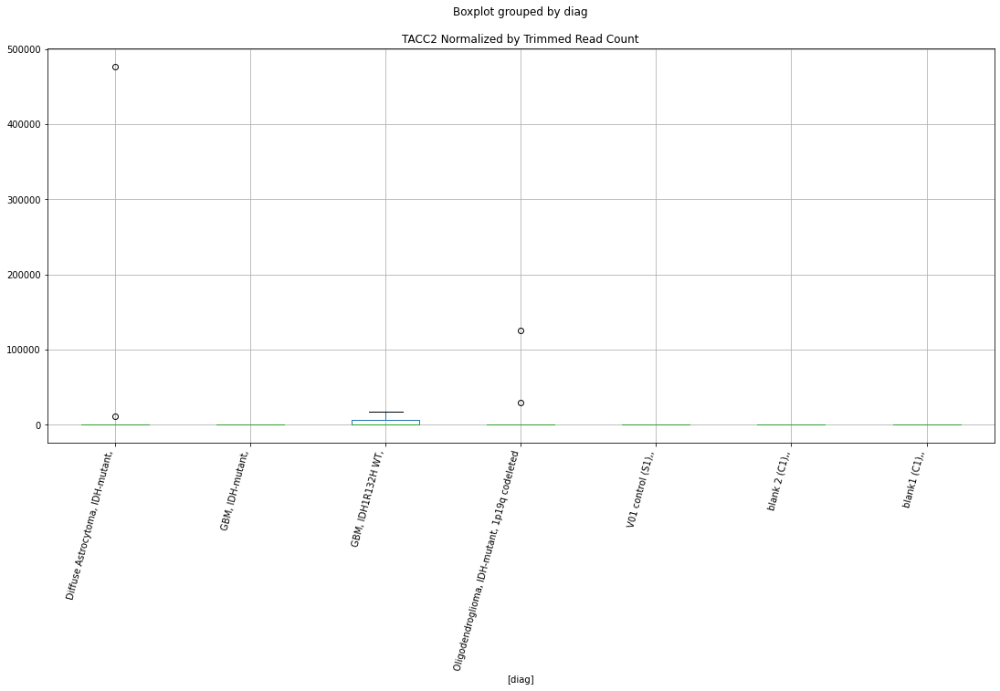

 p : 0.04389450218759778  ( t : 2.1670055358244795 ) :  Lexogen  :  bbduk2  :  TACC2
Control and blanks
79     0.0
343    0.0
Name: TACC2, dtype: float64
211    0.0
Name: TACC2, dtype: float64
475    0.0
Name: TACC2, dtype: float64


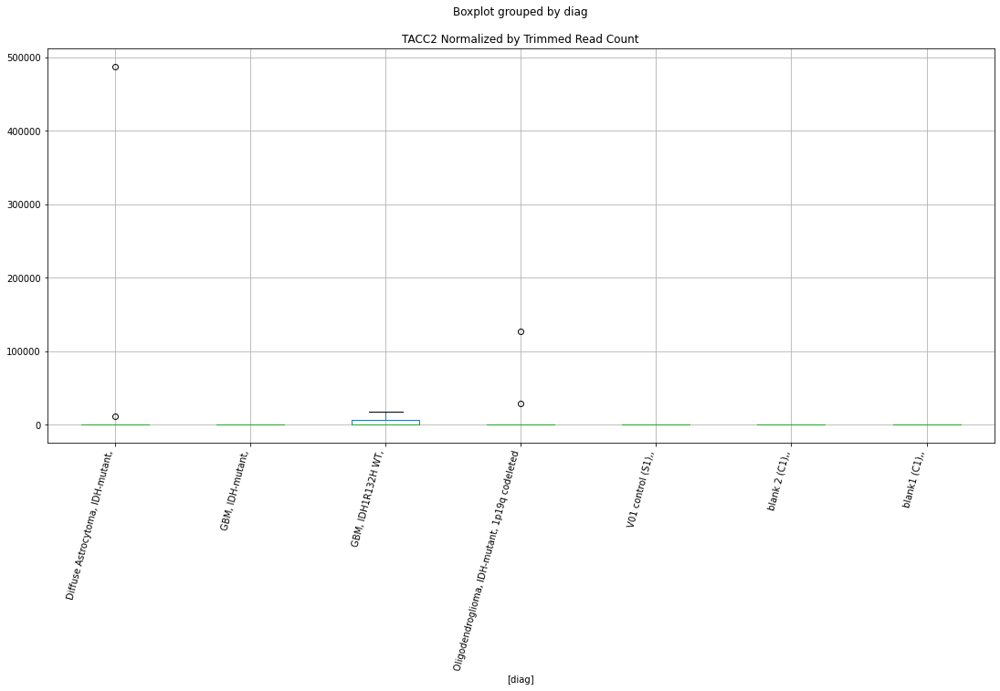

 p : 0.043997536379314736  ( t : 2.1658224453848485 ) :  D-plex  :  bbduk2  :  ZNF518B
Control and blanks
73     0.0
337    0.0
Name: ZNF518B, dtype: float64
205    4298.18
Name: ZNF518B, dtype: float64
469    3549.16
Name: ZNF518B, dtype: float64


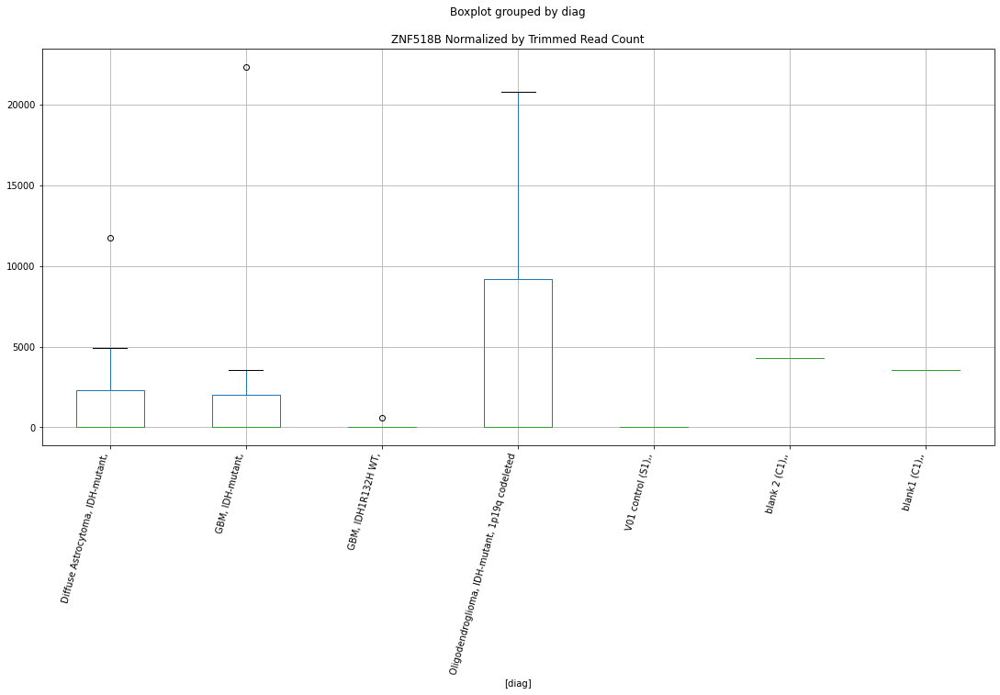

 p : 0.044009130980698995  ( t : 2.165689469111296 ) :  D-plex  :  cutadapt2  :  SRI
Control and blanks
76     0.0
340    0.0
Name: SRI, dtype: float64
208    881.8
Name: SRI, dtype: float64
472    0.0
Name: SRI, dtype: float64


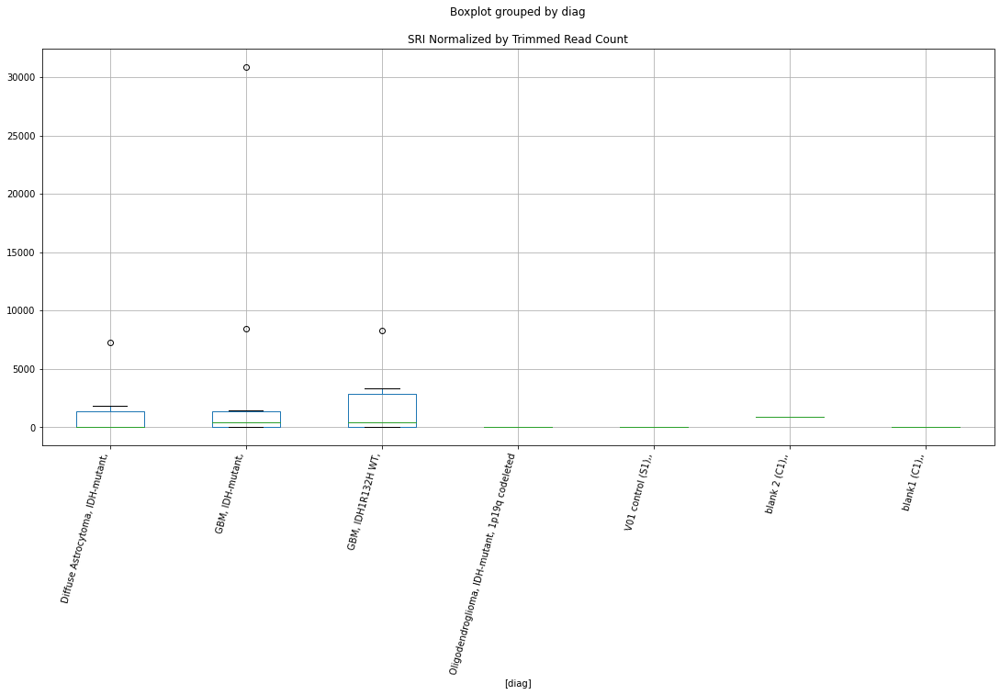

 p : 0.04405168015242078  ( t : 2.1652017553396523 ) :  Lexogen  :  cutadapt2  :  ST3GAL5-AS1
Control and blanks
82     0.0
346    0.0
Name: ST3GAL5-AS1, dtype: float64
214    0.0
Name: ST3GAL5-AS1, dtype: float64
478    0.0
Name: ST3GAL5-AS1, dtype: float64


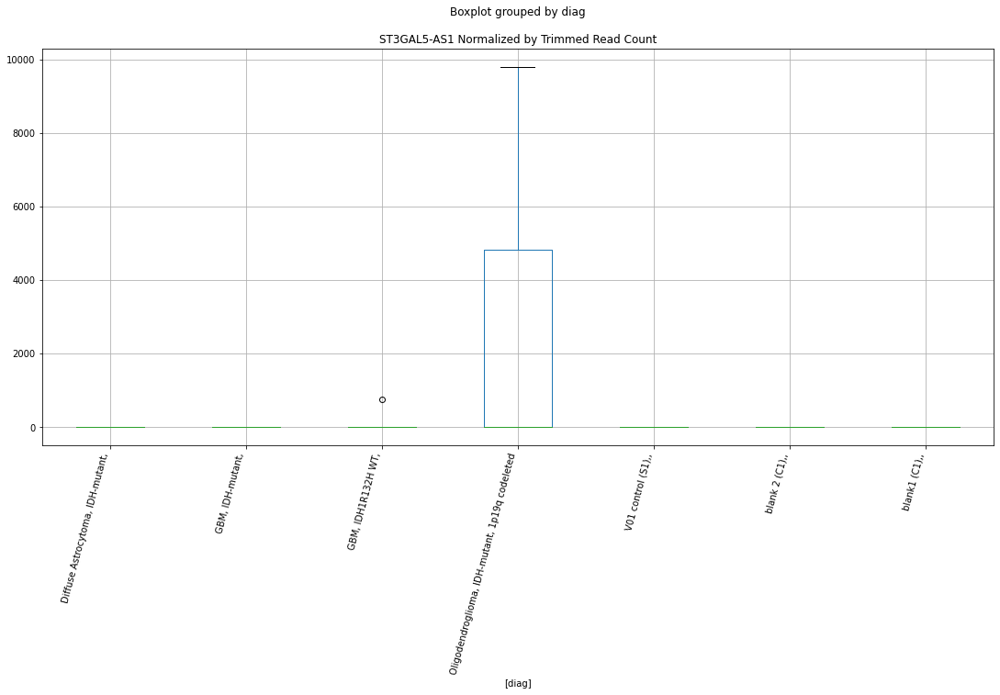

 p : 0.044066557402265664  ( t : 2.165031328718141 ) :  Lexogen  :  bbduk2  :  ZNF37A
Control and blanks
79     0.0
343    0.0
Name: ZNF37A, dtype: float64
211    0.0
Name: ZNF37A, dtype: float64
475    0.0
Name: ZNF37A, dtype: float64


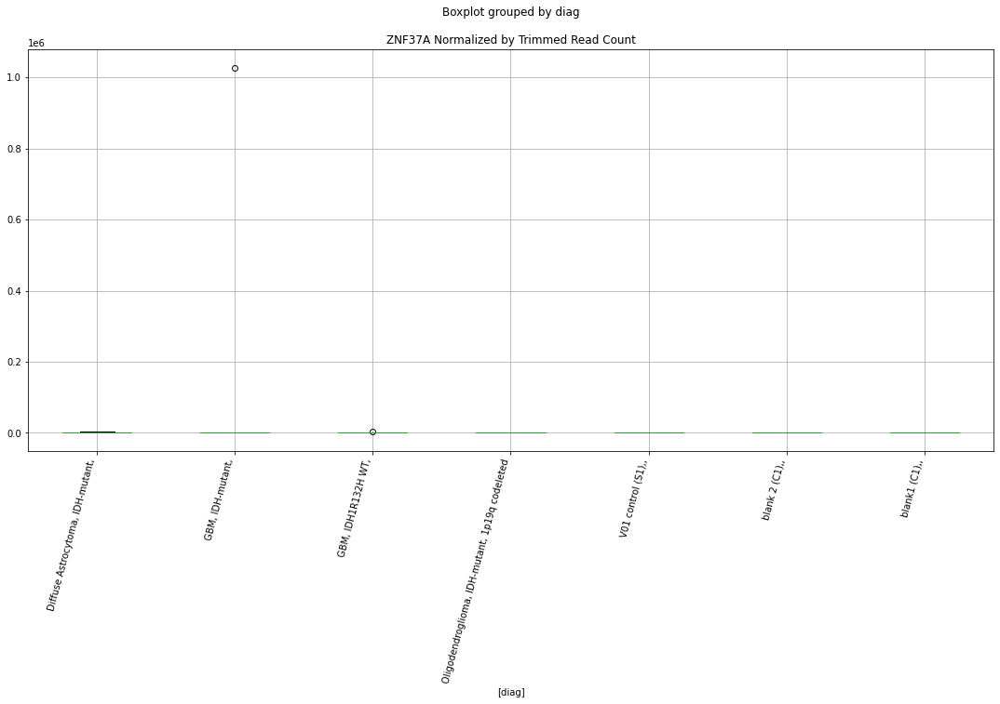

 p : 0.04407331903903431  ( t : 2.164953888061763 ) :  Lexogen  :  bbduk2  :  ST3GAL5-AS1
Control and blanks
79     0.0
343    0.0
Name: ST3GAL5-AS1, dtype: float64
211    0.0
Name: ST3GAL5-AS1, dtype: float64
475    0.0
Name: ST3GAL5-AS1, dtype: float64


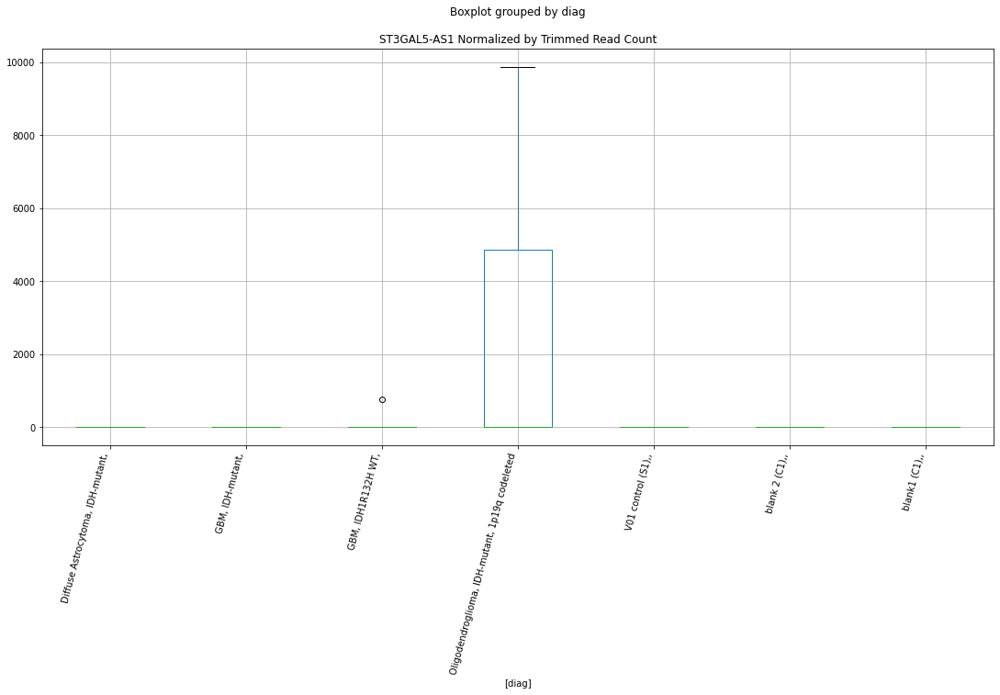

 p : 0.04419527752858211  ( t : 2.1635589674479 ) :  D-plex  :  cutadapt2  :  TIE1
Control and blanks
76     0.0
340    0.0
Name: TIE1, dtype: float64
208    881.8
Name: TIE1, dtype: float64
472    0.0
Name: TIE1, dtype: float64


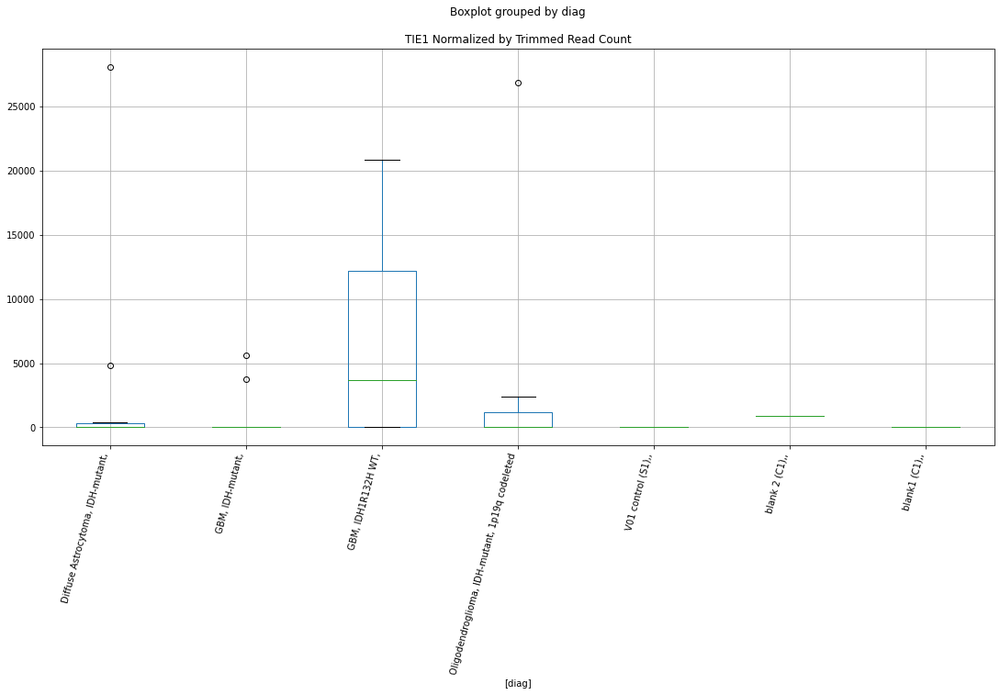

 p : 0.04420007633332457  ( t : 2.163504152372216 ) :  Lexogen  :  bbduk2  :  UGT2B7
Control and blanks
79       0.00
343    849.26
Name: UGT2B7, dtype: float64
211    546.61
Name: UGT2B7, dtype: float64
475    0.0
Name: UGT2B7, dtype: float64


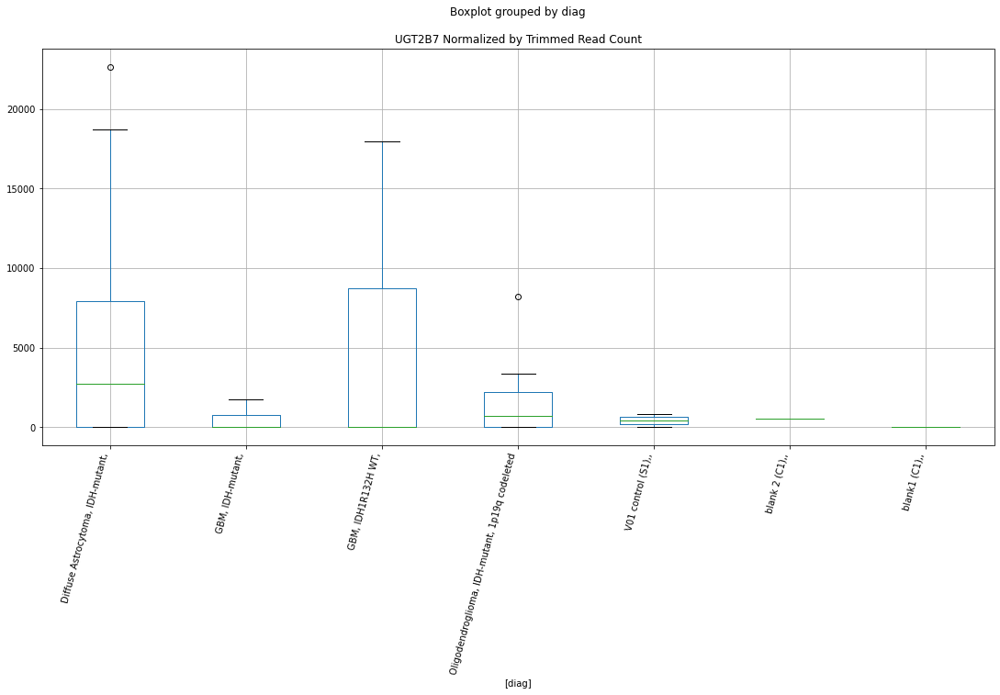

 p : 0.044202998762289156  ( t : 2.163470773151535 ) :  Lexogen  :  cutadapt2  :  TOR4A
Control and blanks
82     11360.41
346    15572.15
Name: TOR4A, dtype: float64
214    16002.36
Name: TOR4A, dtype: float64
478    13297.79
Name: TOR4A, dtype: float64


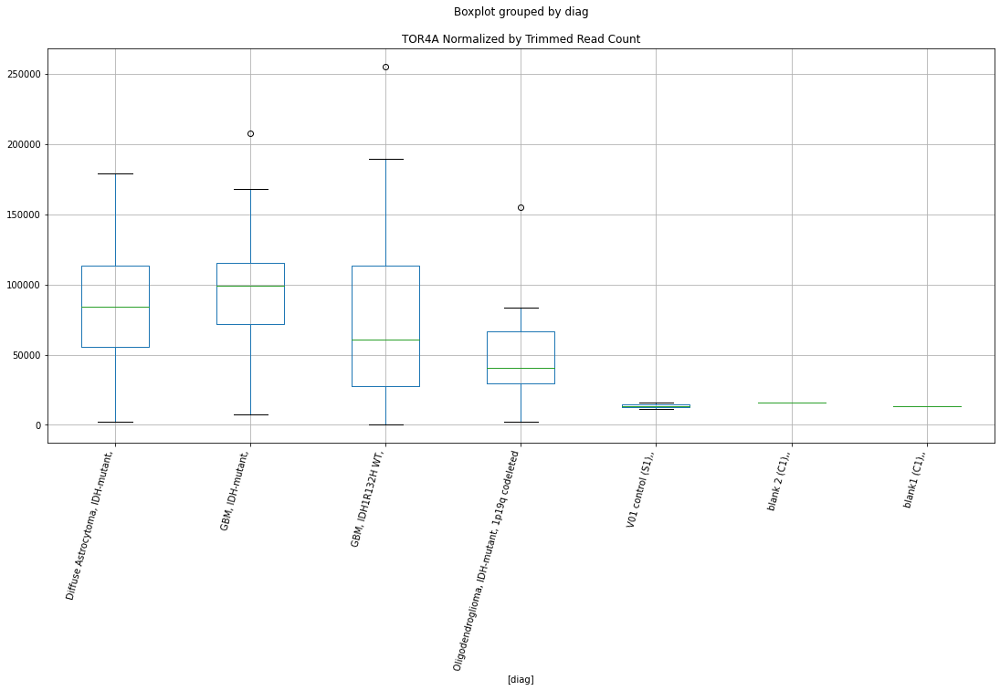

 p : 0.04433483219170295  ( t : 2.161967102189879 ) :  D-plex  :  cutadapt2  :  TNFSF4
Control and blanks
76     4545.69
340     880.73
Name: TNFSF4, dtype: float64
208    7583.49
Name: TNFSF4, dtype: float64
472    11559.12
Name: TNFSF4, dtype: float64


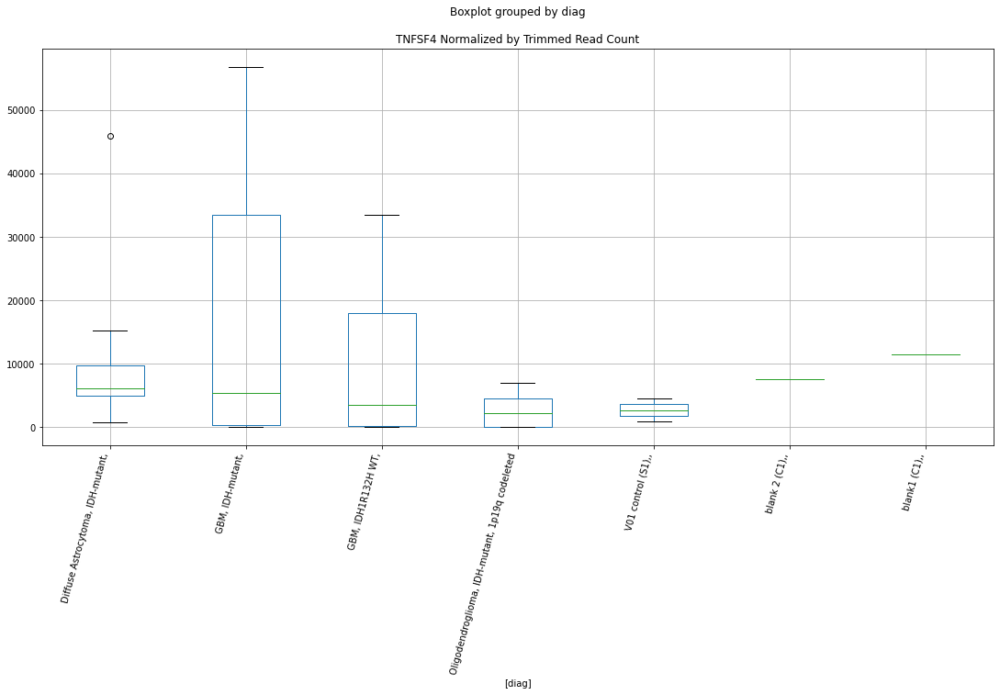

 p : 0.04440049766691692  ( t : 2.1612196579114964 ) :  Lexogen  :  cutadapt2  :  TGM1
Control and blanks
82     0.0
346    0.0
Name: TGM1, dtype: float64
214    0.0
Name: TGM1, dtype: float64
478    0.0
Name: TGM1, dtype: float64


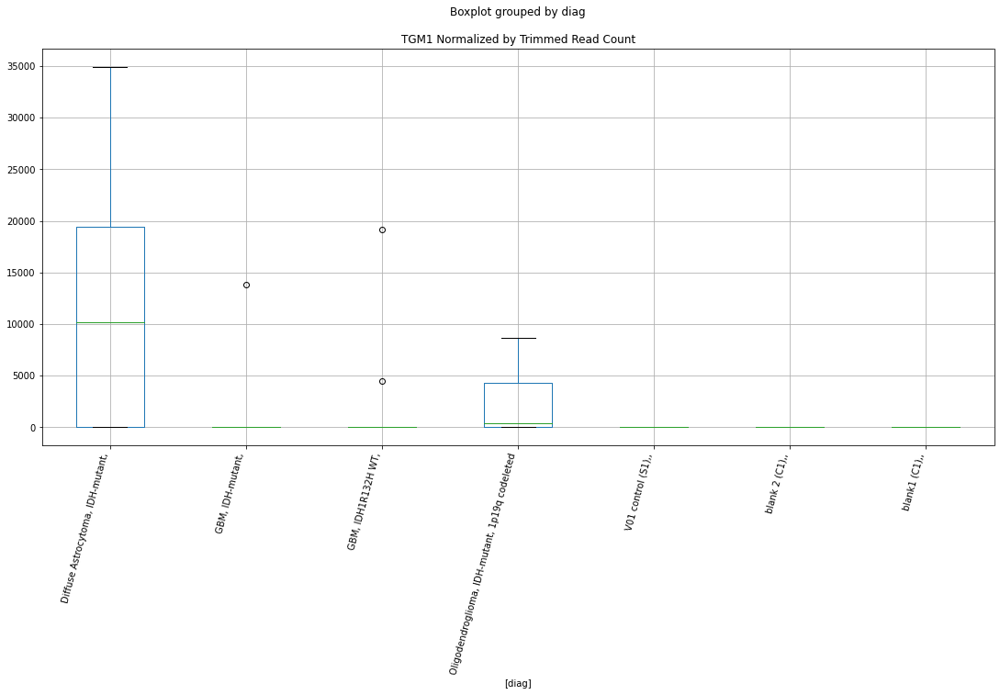

 p : 0.044435112861579106  ( t : 2.1608260537074004 ) :  D-plex  :  bbduk2  :  TRPA1
Control and blanks
73     0.0
337    0.0
Name: TRPA1, dtype: float64
205    6805.46
Name: TRPA1, dtype: float64
469    1183.05
Name: TRPA1, dtype: float64


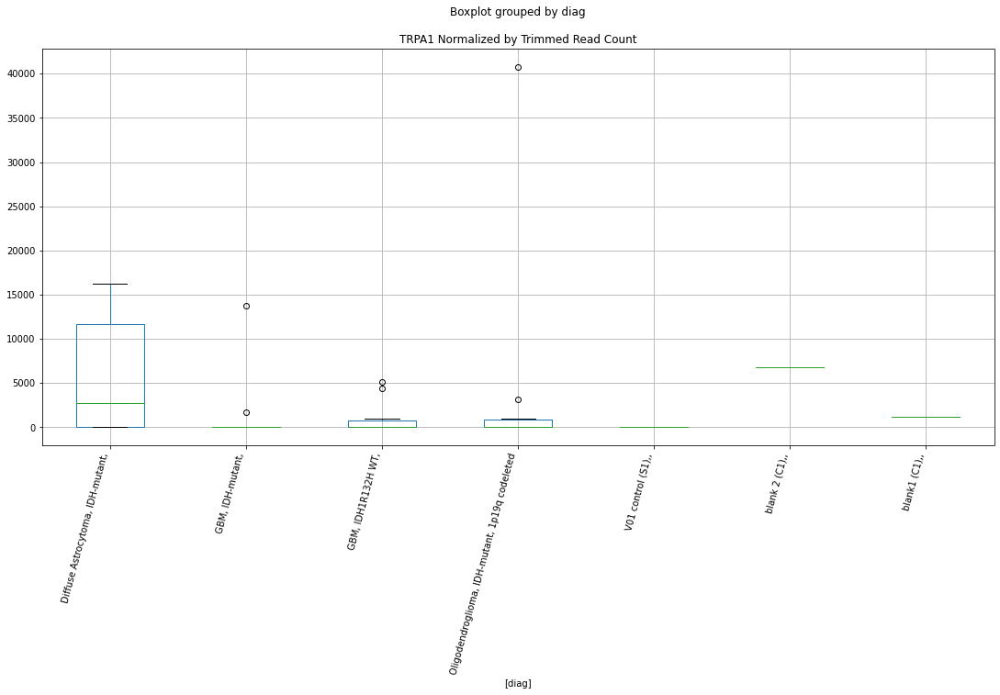

 p : 0.044465184761215776  ( t : 2.160484338242166 ) :  Lexogen  :  bbduk2  :  SPEN
Control and blanks
79     0.0
343    0.0
Name: SPEN, dtype: float64
211    0.0
Name: SPEN, dtype: float64
475    0.0
Name: SPEN, dtype: float64


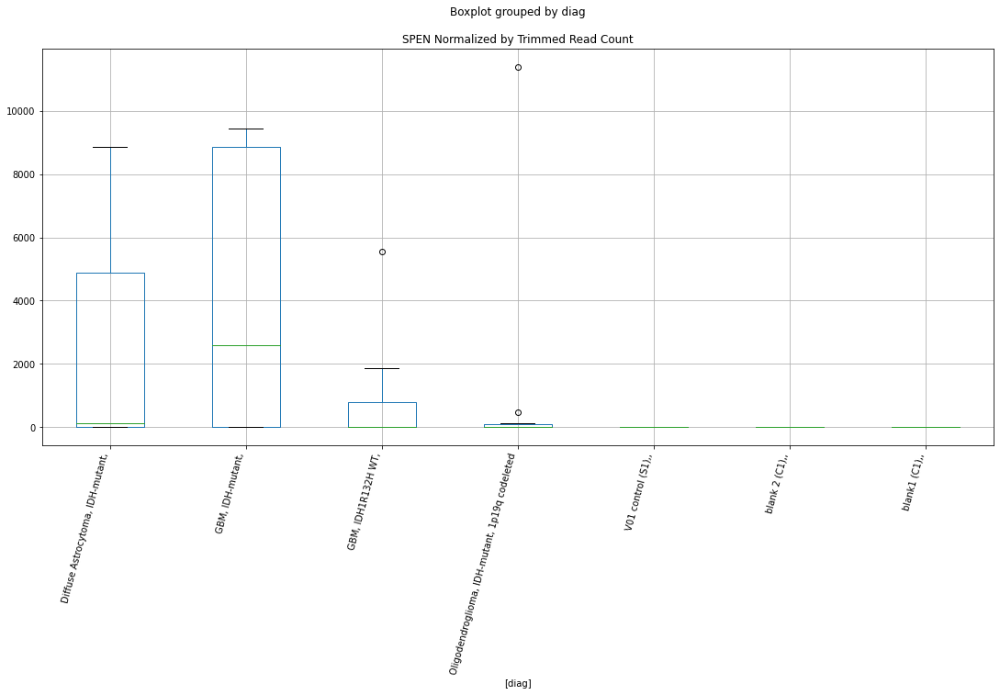

 p : 0.0445033133116482  ( t : 2.160051376587964 ) :  D-plex  :  bbduk2  :  YDJC
Control and blanks
73     0.0
337    0.0
Name: YDJC, dtype: float64
205    1074.55
Name: YDJC, dtype: float64
469    7098.33
Name: YDJC, dtype: float64


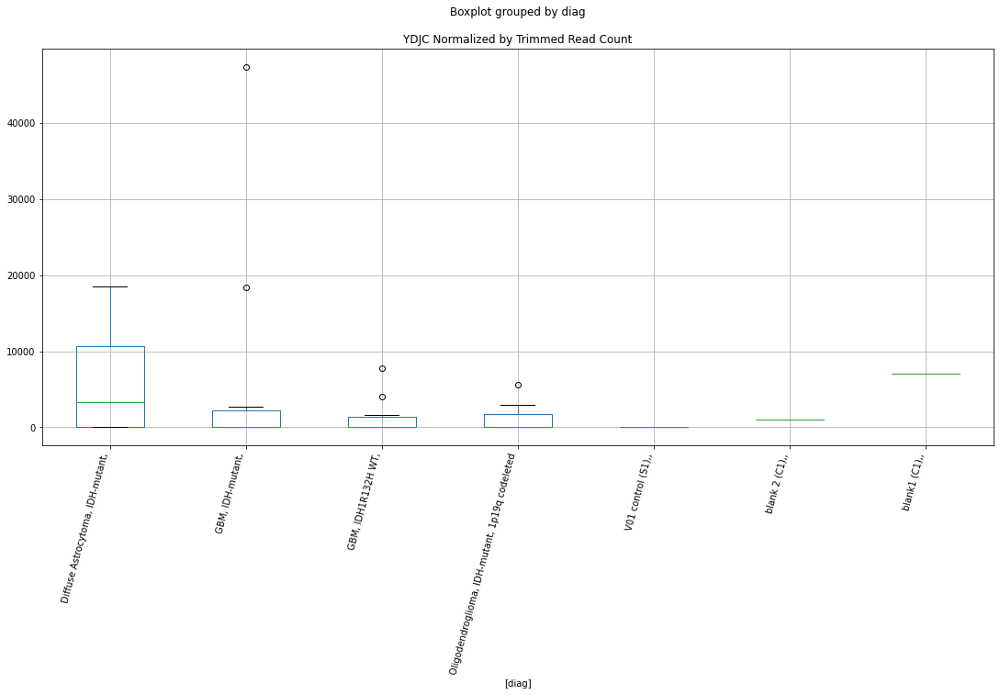

 p : 0.04450796983660228  ( t : 2.1599985235370247 ) :  Lexogen  :  bbduk2  :  USP7
Control and blanks
79     0.0
343    0.0
Name: USP7, dtype: float64
211    546.61
Name: USP7, dtype: float64
475    55807.17
Name: USP7, dtype: float64


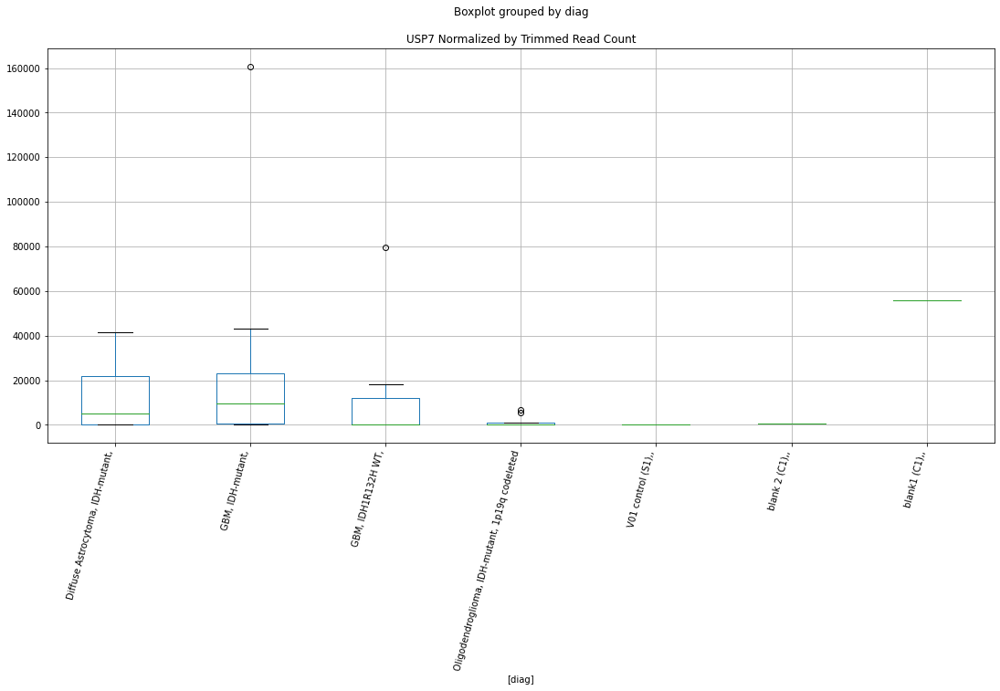

 p : 0.04451029832851803  ( t : 2.1599720963042404 ) :  D-plex  :  cutadapt2  :  STRN4
Control and blanks
76     0.0
340    0.0
Name: STRN4, dtype: float64
208    2821.76
Name: STRN4, dtype: float64
472    0.0
Name: STRN4, dtype: float64


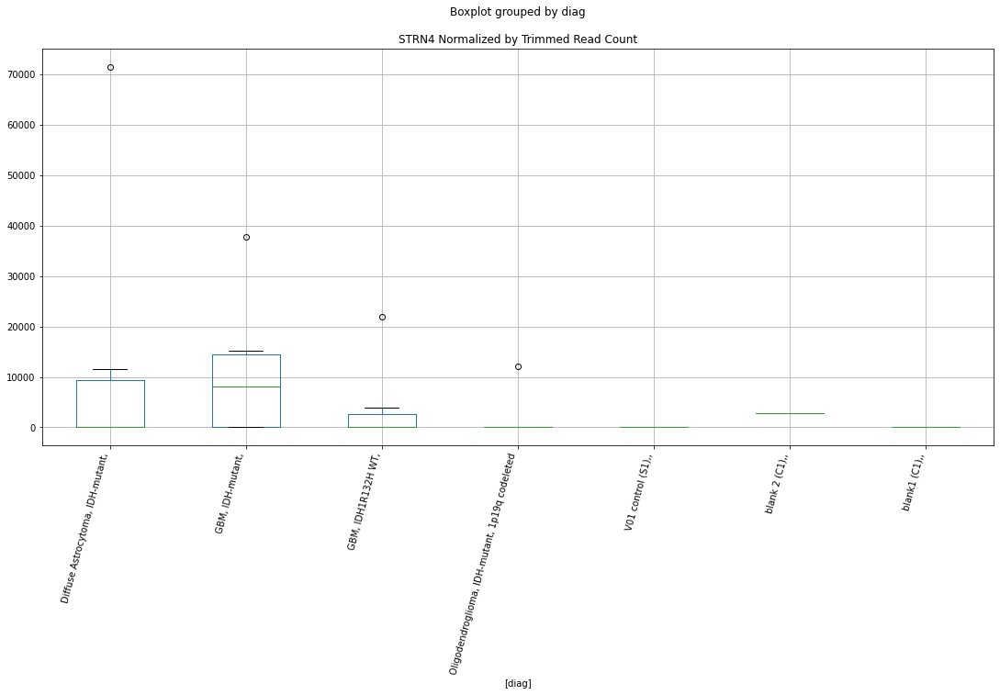

 p : 0.044555560976507494  ( t : 2.1594586386462877 ) :  Lexogen  :  cutadapt2  :  USP7
Control and blanks
82     0.0
346    0.0
Name: USP7, dtype: float64
214    542.45
Name: USP7, dtype: float64
478    55328.29
Name: USP7, dtype: float64


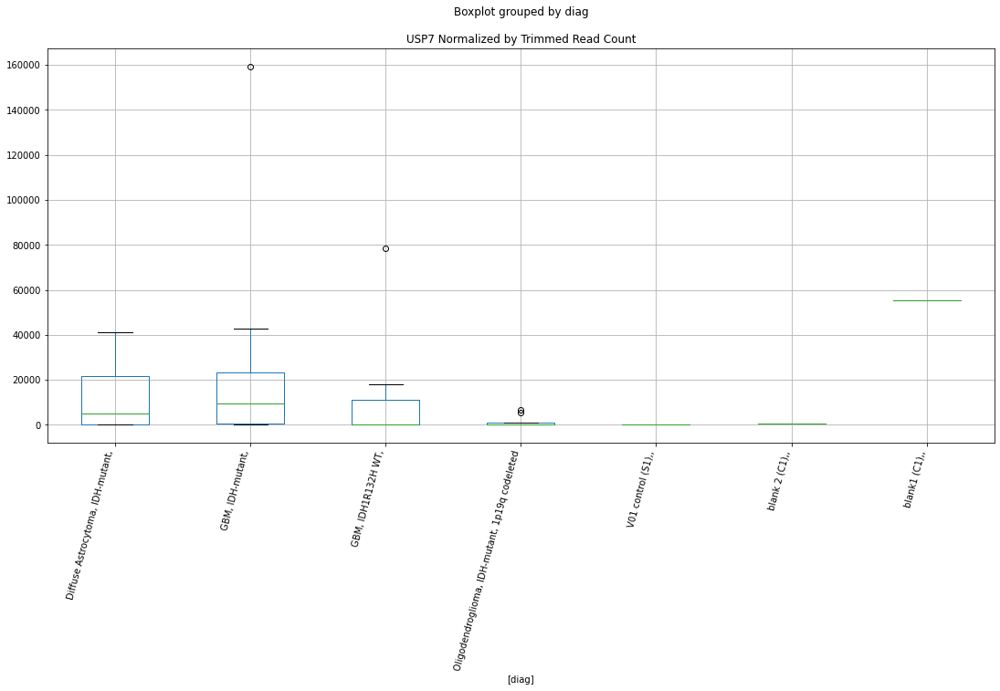

 p : 0.044589270127490664  ( t : 2.1590765532536538 ) :  D-plex  :  cutadapt2  :  VIRMA
Control and blanks
76     0.0
340    0.0
Name: VIRMA, dtype: float64
208    705.44
Name: VIRMA, dtype: float64
472    7513.43
Name: VIRMA, dtype: float64


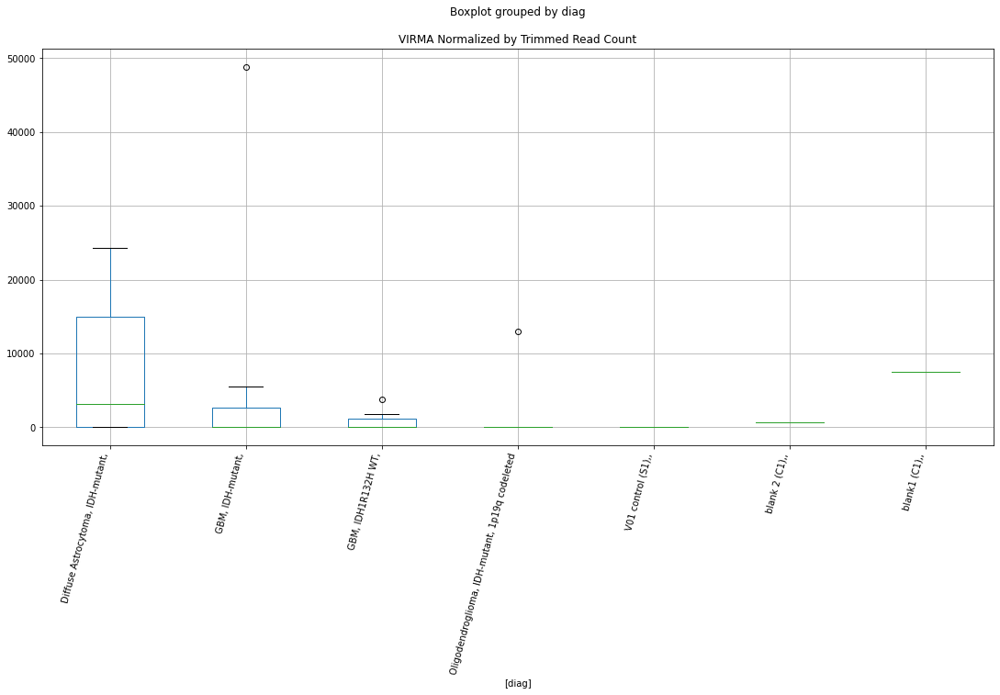

 p : 0.044656033806109115  ( t : 2.1583205815909774 ) :  Lexogen  :  bbduk2  :  WNT1
Control and blanks
79         0.00
343    17409.77
Name: WNT1, dtype: float64
211    0.0
Name: WNT1, dtype: float64
475    0.0
Name: WNT1, dtype: float64


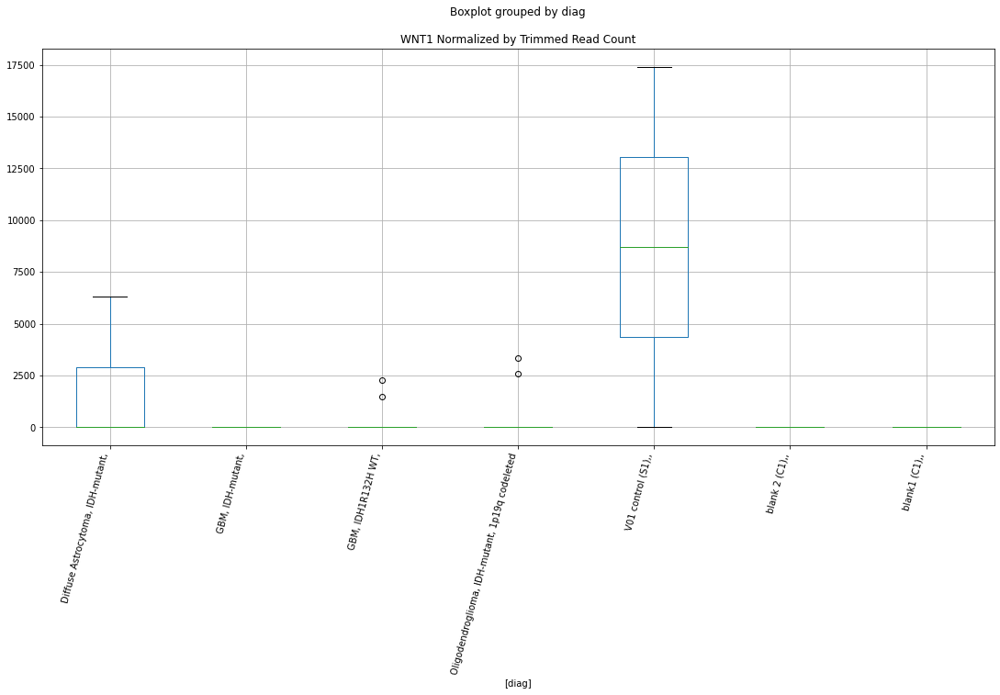

 p : 0.044679332380338575  ( t : 2.1580570128311725 ) :  D-plex  :  cutadapt2  :  SRGAP3
Control and blanks
76     0.0
340    0.0
Name: SRGAP3, dtype: float64
208    10052.53
Name: SRGAP3, dtype: float64
472    7513.43
Name: SRGAP3, dtype: float64


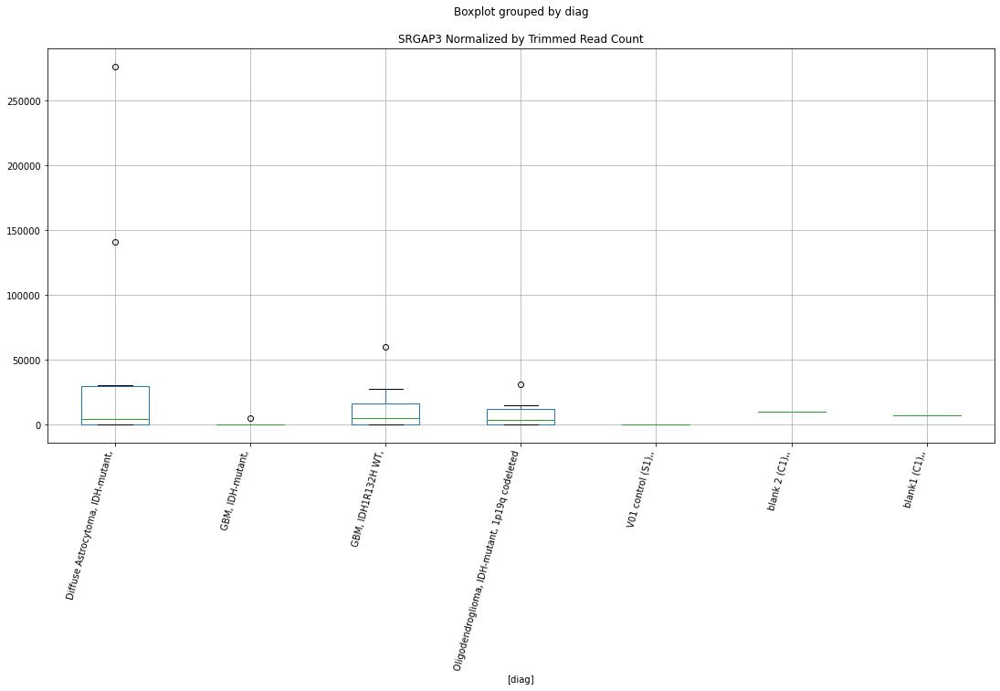

 p : 0.044682058890999084  ( t : 2.158026176968965 ) :  Lexogen  :  cutadapt2  :  WNT1
Control and blanks
82         0.00
346    17255.63
Name: WNT1, dtype: float64
214    0.0
Name: WNT1, dtype: float64
478    0.0
Name: WNT1, dtype: float64


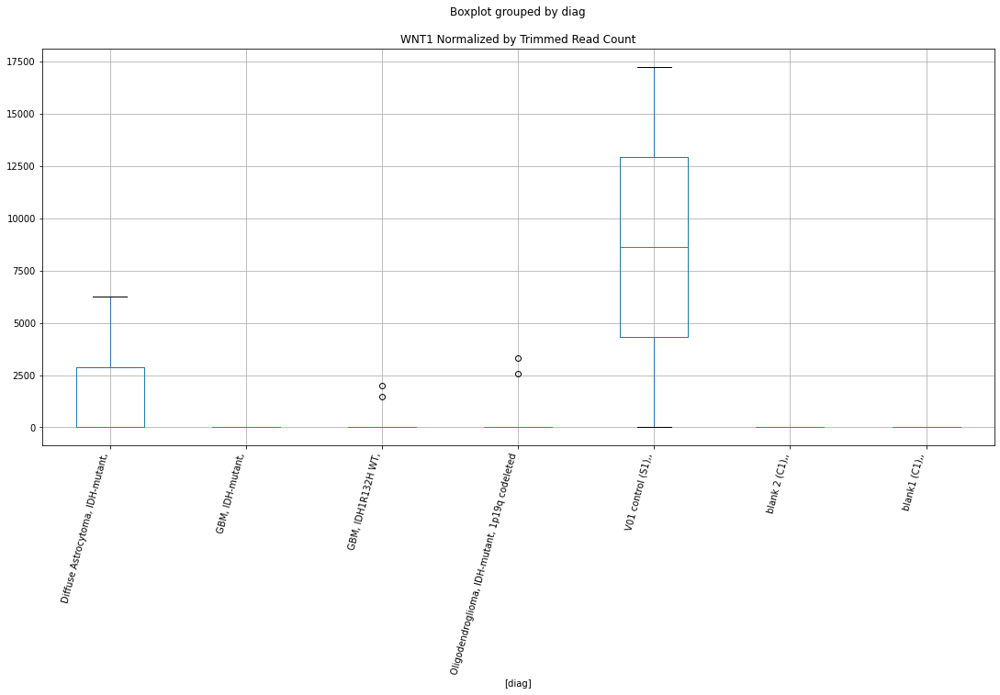

 p : 0.04472211218334506  ( t : 2.1575733867249562 ) :  D-plex  :  cutadapt2  :  SUSD6
Control and blanks
76     2272.84
340       0.00
Name: SUSD6, dtype: float64
208    2645.4
Name: SUSD6, dtype: float64
472    142755.09
Name: SUSD6, dtype: float64


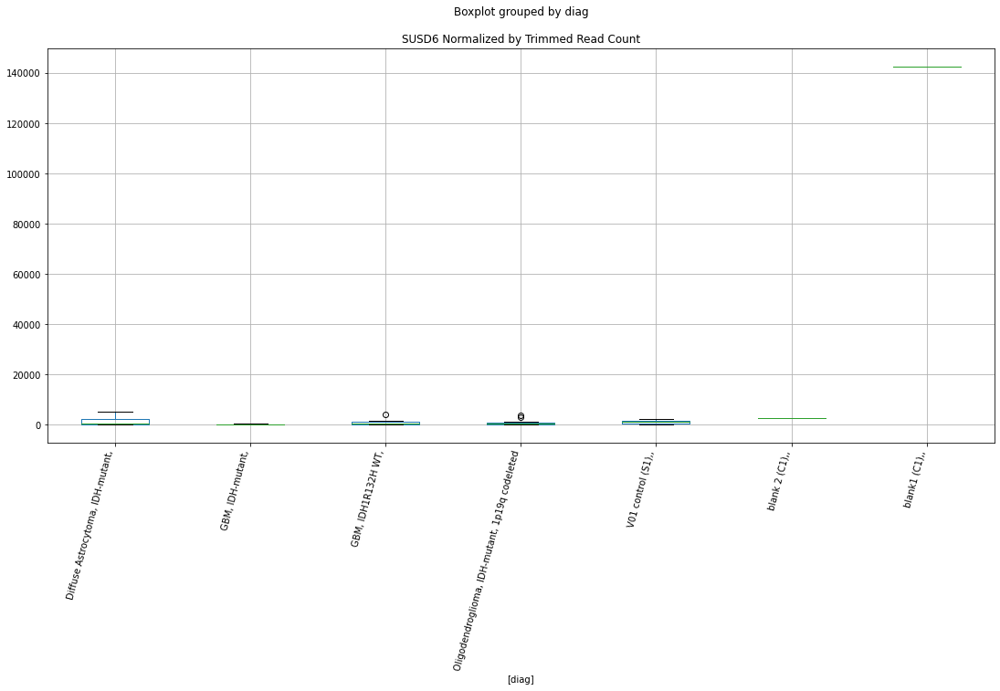

 p : 0.0447275205694188  ( t : 2.1575122749908933 ) :  D-plex  :  cutadapt2  :  VPS37C
Control and blanks
76     0.0
340    0.0
Name: VPS37C, dtype: float64
208    1058.16
Name: VPS37C, dtype: float64
472    12137.07
Name: VPS37C, dtype: float64


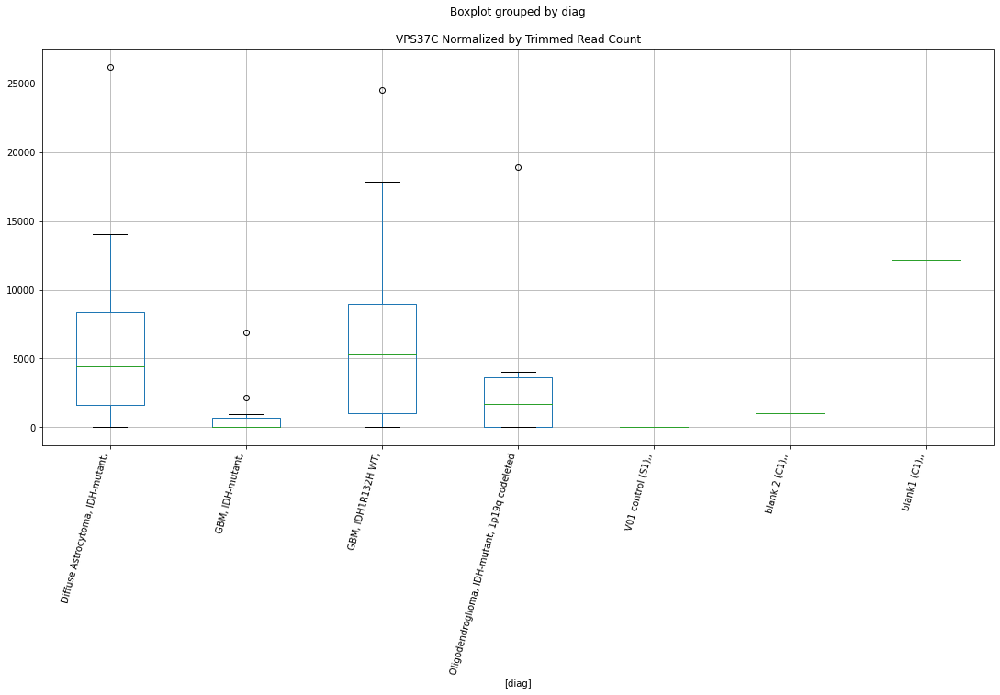

 p : 0.044734098602242894  ( t : 2.1574379560101913 ) :  Lexogen  :  bbduk2  :  ZNF510
Control and blanks
79     0.0
343    0.0
Name: ZNF510, dtype: float64
211    0.0
Name: ZNF510, dtype: float64
475    0.0
Name: ZNF510, dtype: float64


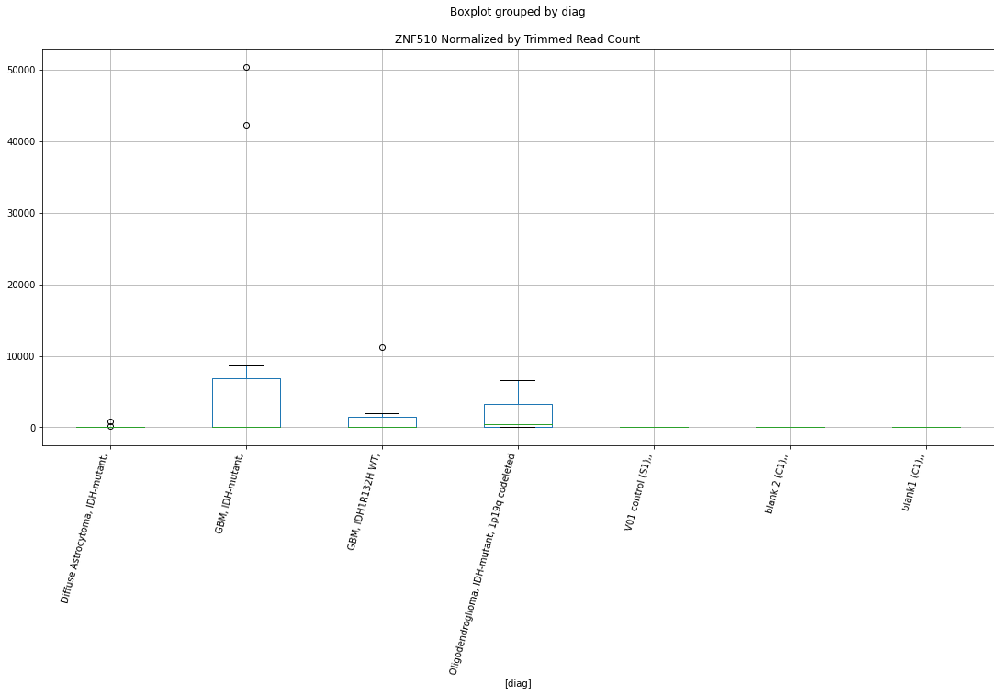

 p : 0.0447413567821962  ( t : 2.1573559642850784 ) :  D-plex  :  bbduk2  :  TMEM81
Control and blanks
73     0.0
337    0.0
Name: TMEM81, dtype: float64
205    179.09
Name: TMEM81, dtype: float64
469    1774.58
Name: TMEM81, dtype: float64


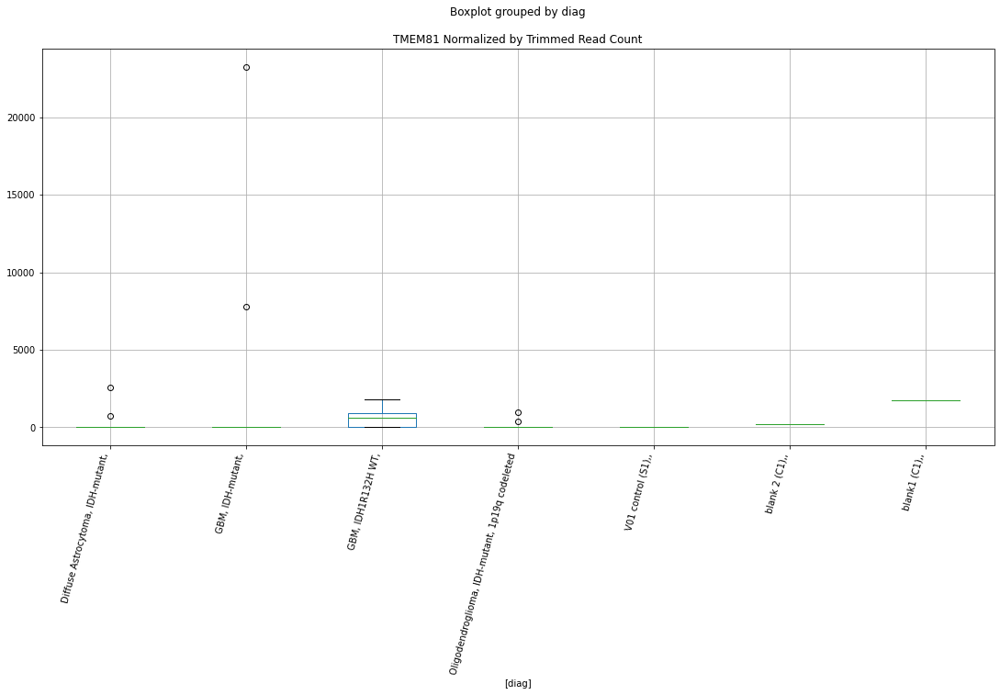

 p : 0.04474465307600538  ( t : 2.157318731856559 ) :  Lexogen  :  cutadapt2  :  ZNF385B
Control and blanks
82       0.0
346    631.3
Name: ZNF385B, dtype: float64
214    0.0
Name: ZNF385B, dtype: float64
478    0.0
Name: ZNF385B, dtype: float64


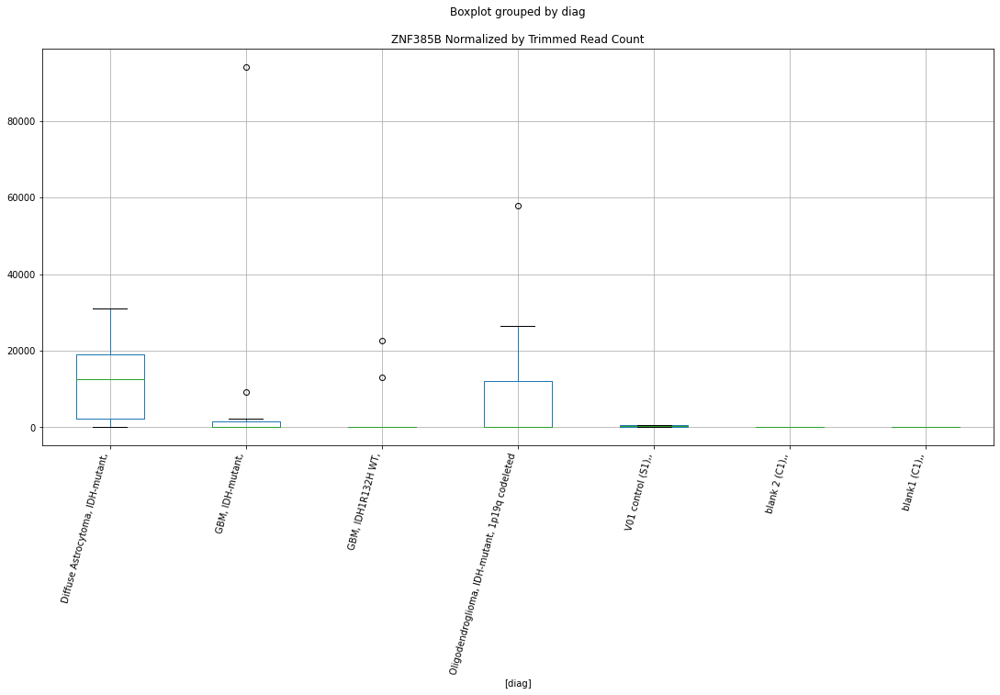

 p : 0.04479992674538493  ( t : 2.1566947758654003 ) :  D-plex  :  bbduk2  :  TPR
Control and blanks
73     4638.05
337     890.16
Name: TPR, dtype: float64
205    5551.82
Name: TPR, dtype: float64
469    7098.33
Name: TPR, dtype: float64


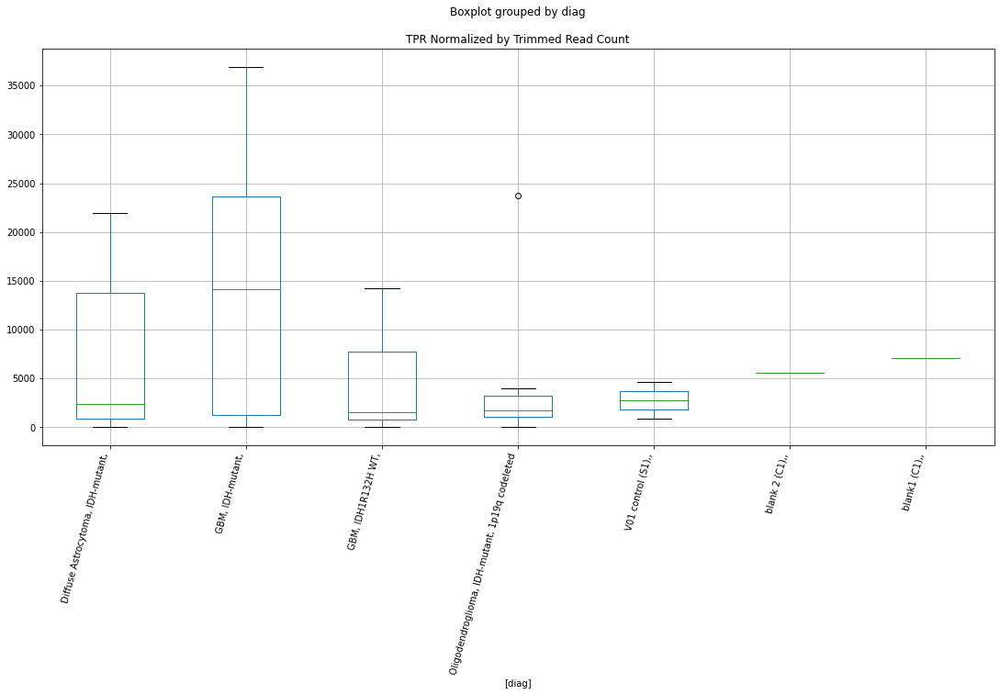

 p : 0.044874069044640294  ( t : 2.1558589260473635 ) :  D-plex  :  bbduk2  :  TNKS
Control and blanks
73     2319.03
337       0.00
Name: TNKS, dtype: float64
205    13969.09
Name: TNKS, dtype: float64
469    585020.52
Name: TNKS, dtype: float64


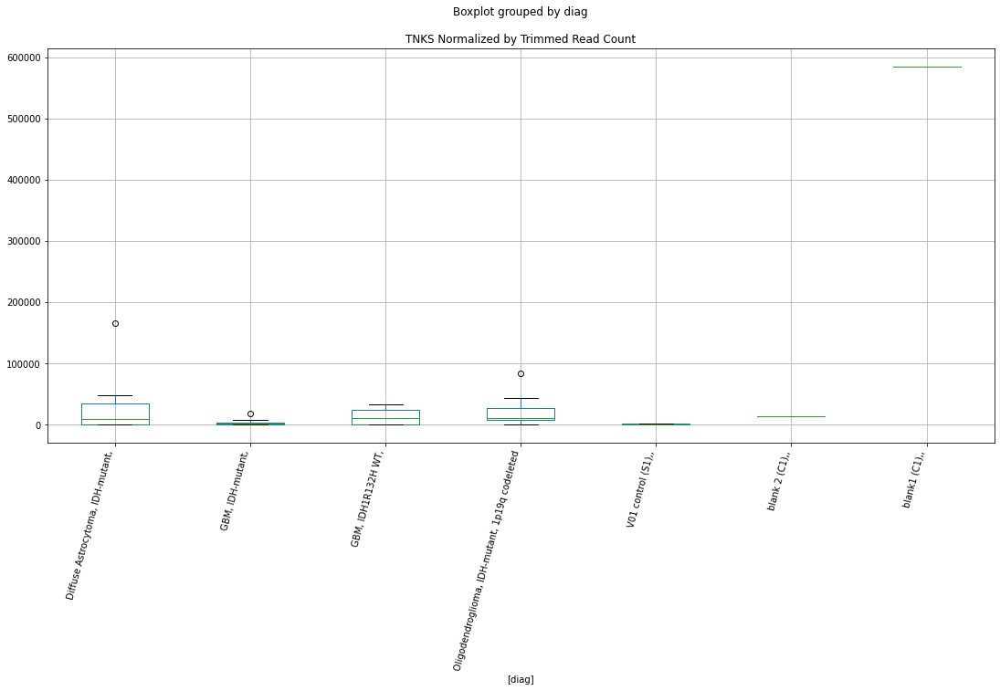

 p : 0.04489626218196721  ( t : 2.155608975275724 ) :  D-plex  :  cutadapt2  :  TMEM95
Control and blanks
76     0.0
340    0.0
Name: TMEM95, dtype: float64
208    1410.88
Name: TMEM95, dtype: float64
472    577.96
Name: TMEM95, dtype: float64


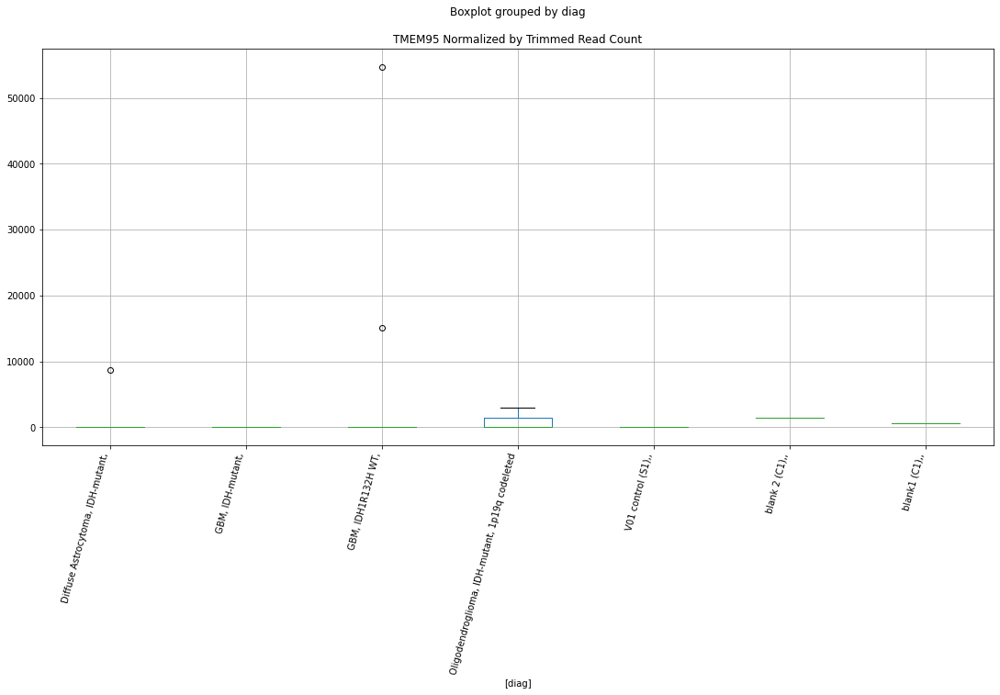

 p : 0.04490886285697059  ( t : 2.155467110125596 ) :  Lexogen  :  cutadapt2  :  TGM4
Control and blanks
82     0.0
346    0.0
Name: TGM4, dtype: float64
214    0.0
Name: TGM4, dtype: float64
478    474.92
Name: TGM4, dtype: float64


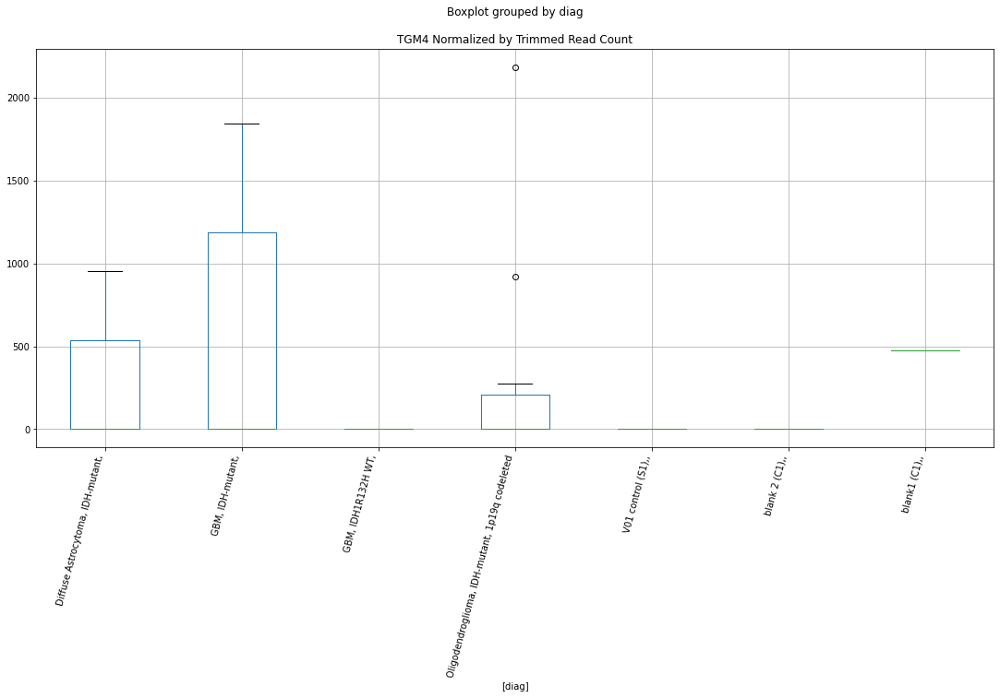

 p : 0.04494326615980093  ( t : 2.155079964544864 ) :  Lexogen  :  cutadapt2  :  ZNF740
Control and blanks
82         0.00
346    95958.14
Name: ZNF740, dtype: float64
214    0.0
Name: ZNF740, dtype: float64
478    0.0
Name: ZNF740, dtype: float64


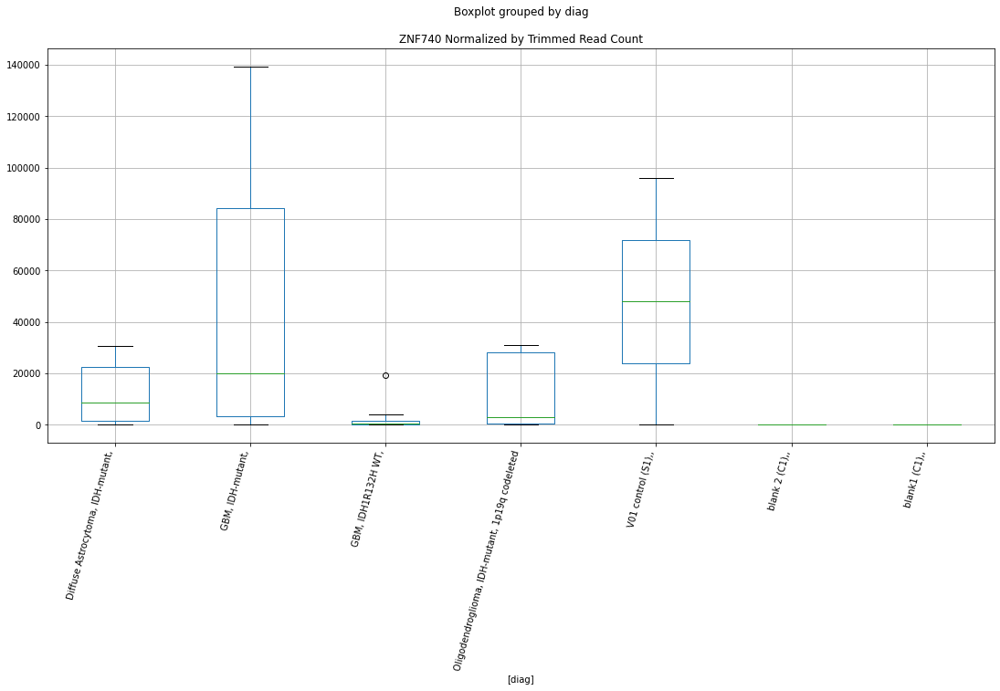

 p : 0.044950782502217554  ( t : 2.154995418067827 ) :  D-plex  :  bbduk2  :  TMEM14B
Control and blanks
73     0.0
337    0.0
Name: TMEM14B, dtype: float64
205    0.0
Name: TMEM14B, dtype: float64
469    2366.11
Name: TMEM14B, dtype: float64


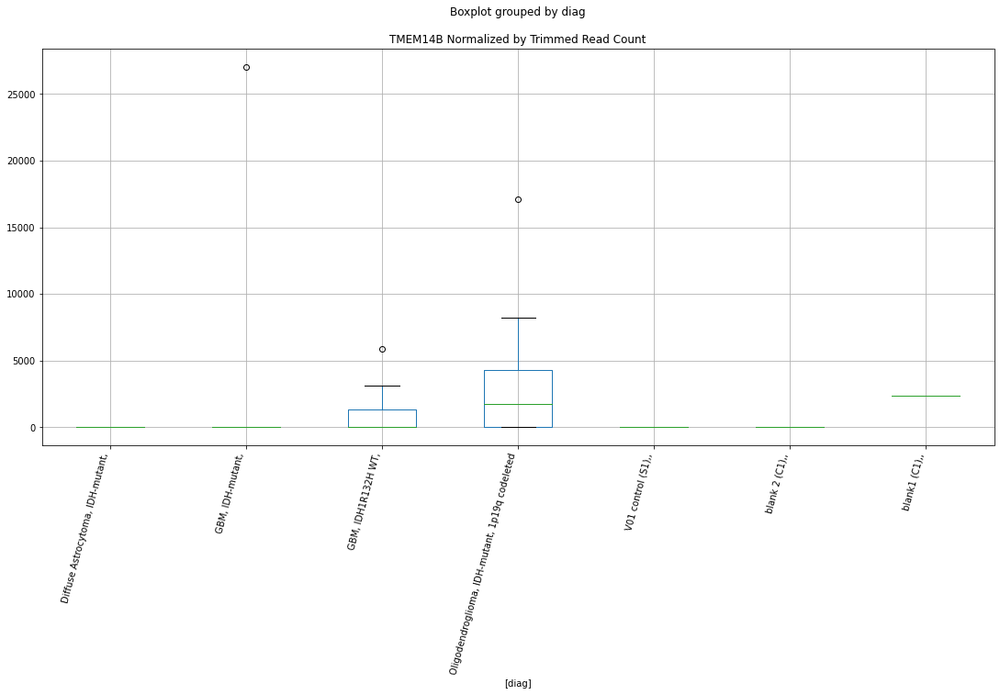

 p : 0.045019251524948206  ( t : 2.1542258488117834 ) :  D-plex  :  cutadapt2  :  TNRC6C
Control and blanks
76     273498.73
340         0.00
Name: TNRC6C, dtype: float64
208    29275.8
Name: TNRC6C, dtype: float64
472    39878.95
Name: TNRC6C, dtype: float64


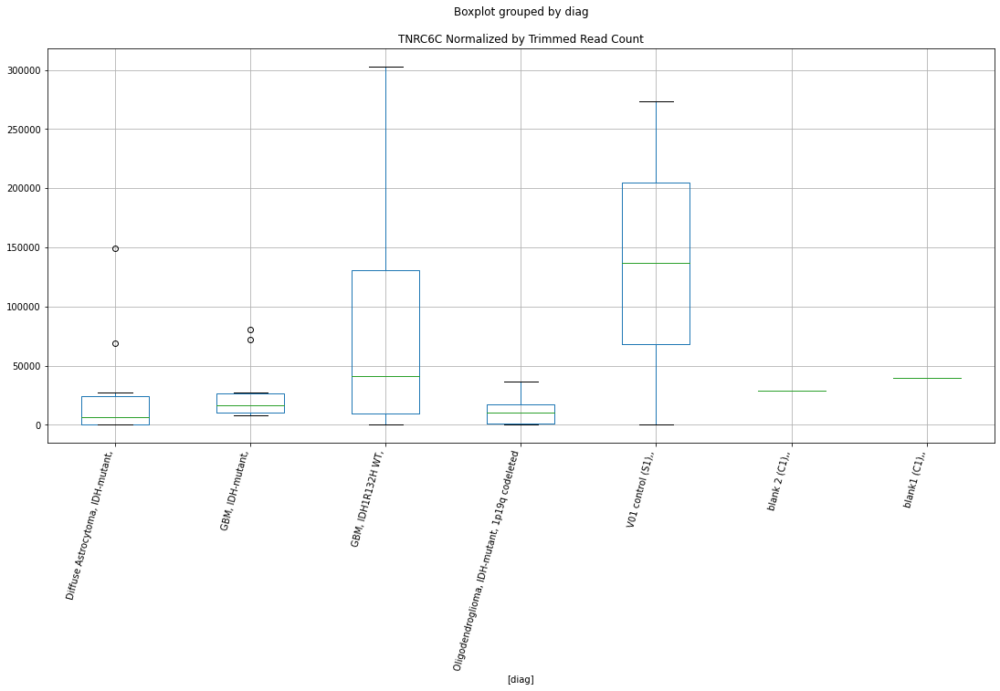

 p : 0.04503811323487051  ( t : 2.154014037377673 ) :  D-plex  :  bbduk2  :  TLCD1
Control and blanks
73     4638.05
337       0.00
Name: TLCD1, dtype: float64
205    92410.93
Name: TLCD1, dtype: float64
469    4732.22
Name: TLCD1, dtype: float64


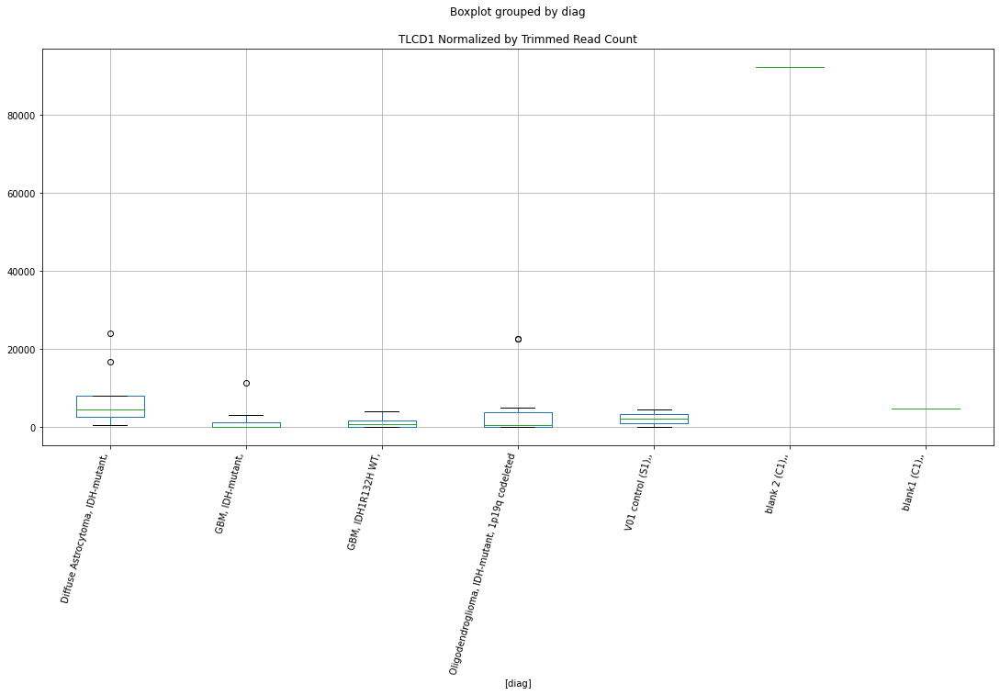

 p : 0.04507832526280761  ( t : 2.15356273874919 ) :  Lexogen  :  cutadapt2  :  SVIL-AS1
Control and blanks
82     0.0
346    0.0
Name: SVIL-AS1, dtype: float64
214    0.0
Name: SVIL-AS1, dtype: float64
478    0.0
Name: SVIL-AS1, dtype: float64


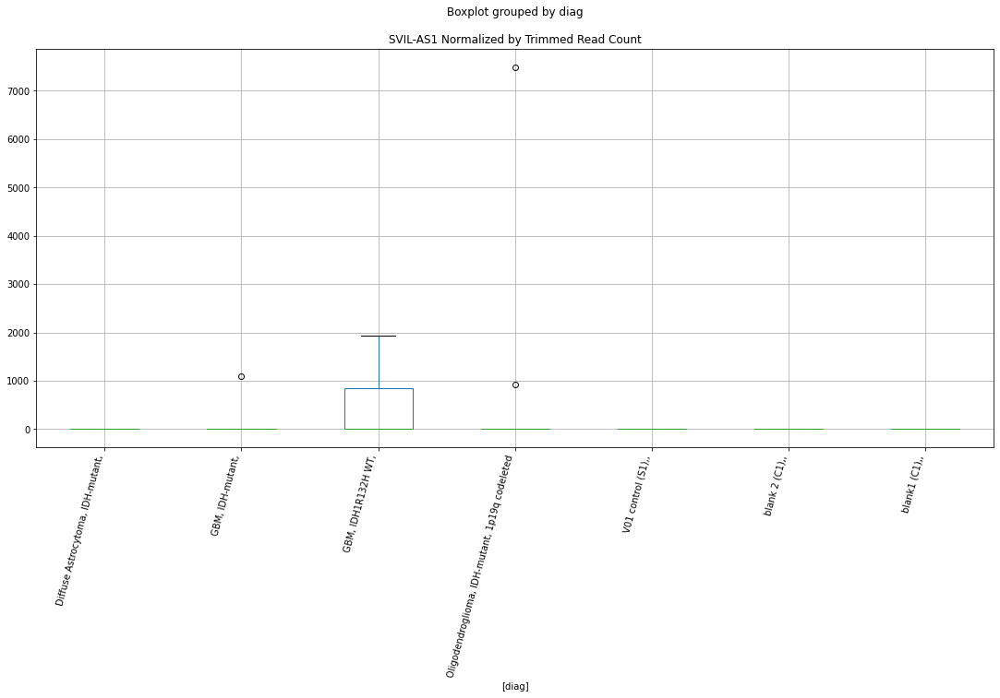

 p : 0.04513283161812484  ( t : 2.152951602309133 ) :  Lexogen  :  cutadapt2  :  SVOP
Control and blanks
82        0.00
346    1052.17
Name: SVOP, dtype: float64
214    0.0
Name: SVOP, dtype: float64
478    949.84
Name: SVOP, dtype: float64


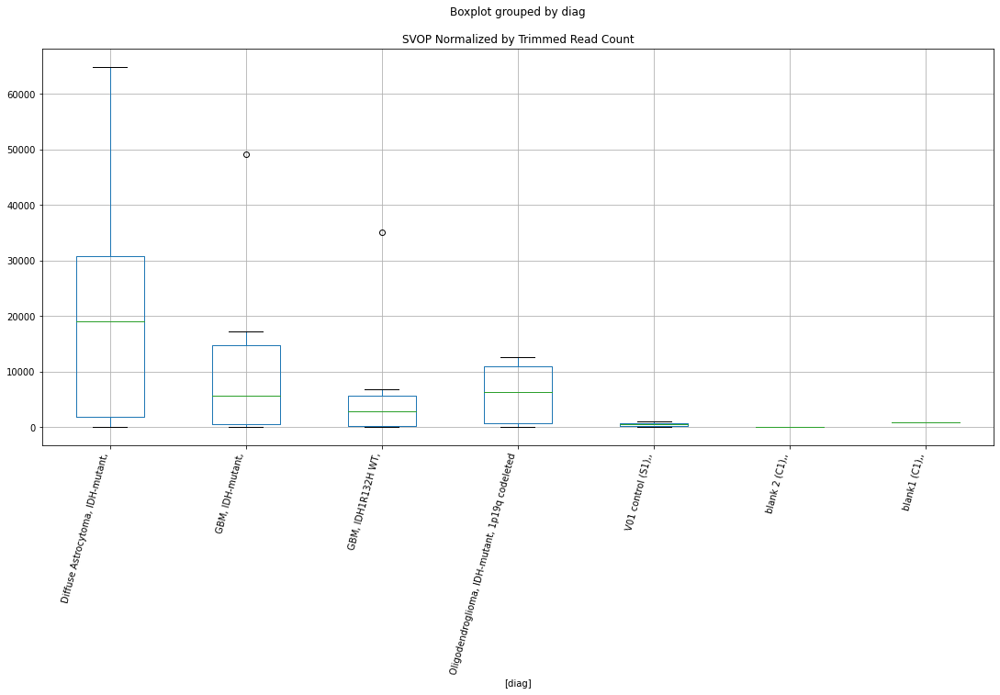

 p : 0.04513590231176125  ( t : 2.152917193138432 ) :  D-plex  :  cutadapt2  :  TMEM81
Control and blanks
76     0.0
340    0.0
Name: TMEM81, dtype: float64
208    176.36
Name: TMEM81, dtype: float64
472    1733.87
Name: TMEM81, dtype: float64


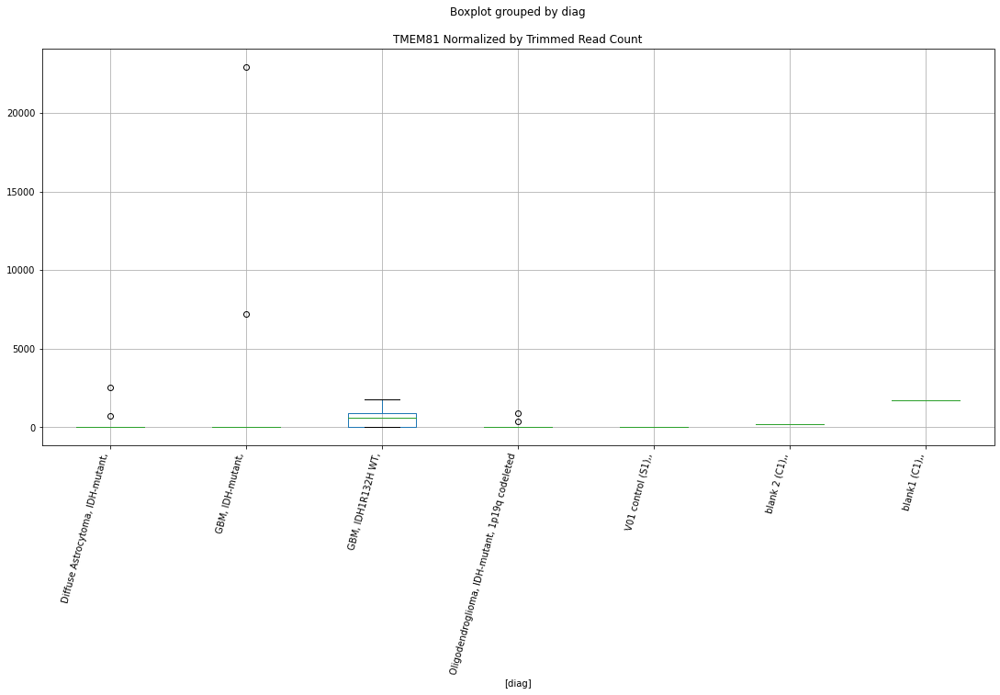

 p : 0.04518451800561735  ( t : 2.152372706750566 ) :  D-plex  :  bbduk2  :  TNFSF12-TNFSF13
Control and blanks
73     0.0
337    0.0
Name: TNFSF12-TNFSF13, dtype: float64
205    358.18
Name: TNFSF12-TNFSF13, dtype: float64
469    0.0
Name: TNFSF12-TNFSF13, dtype: float64


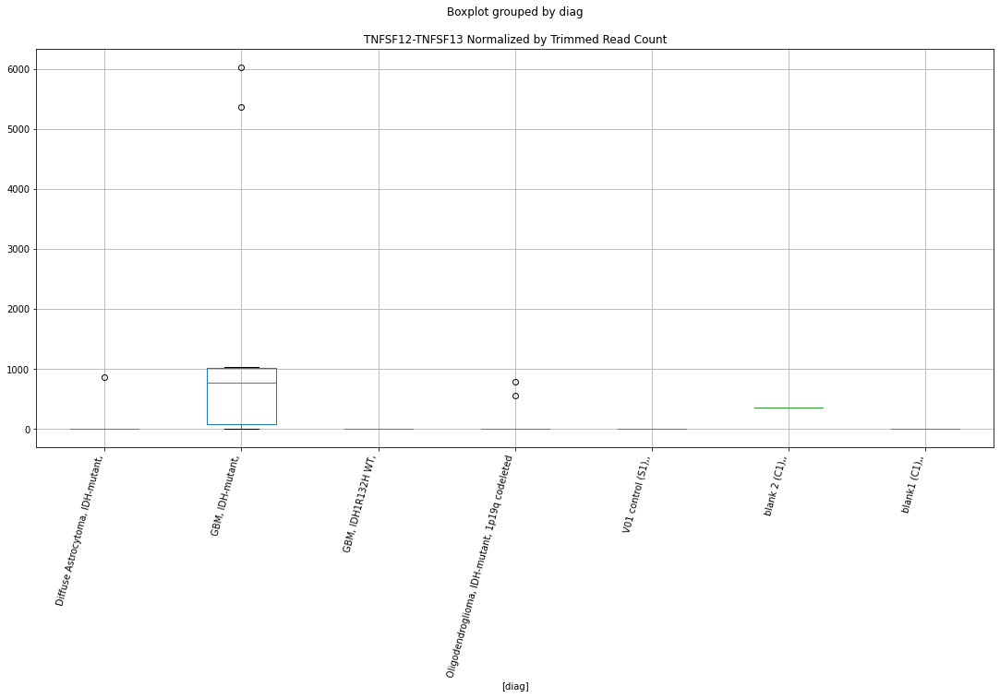

 p : 0.045269786637102086  ( t : 2.151419006310894 ) :  D-plex  :  cutadapt2  :  TEKT4
Control and blanks
76     0.0
340    0.0
Name: TEKT4, dtype: float64
208    1410.88
Name: TEKT4, dtype: float64
472    12137.07
Name: TEKT4, dtype: float64


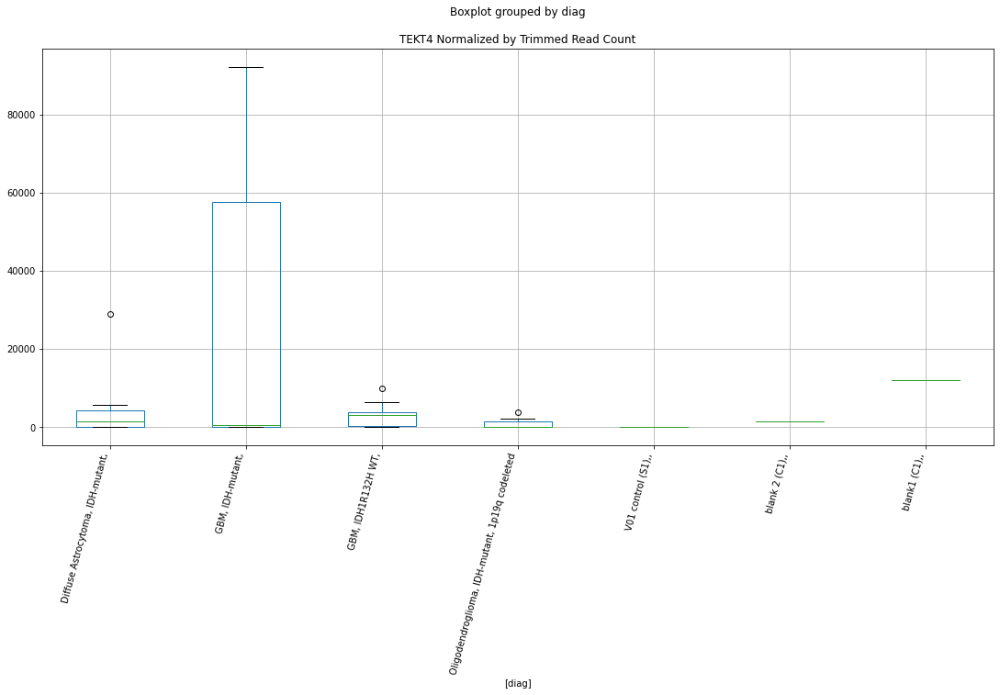

 p : 0.0452722136972492  ( t : 2.1513918845107245 ) :  Lexogen  :  bbduk2  :  ZNF606
Control and blanks
79     0.0
343    0.0
Name: ZNF606, dtype: float64
211    0.0
Name: ZNF606, dtype: float64
475    0.0
Name: ZNF606, dtype: float64


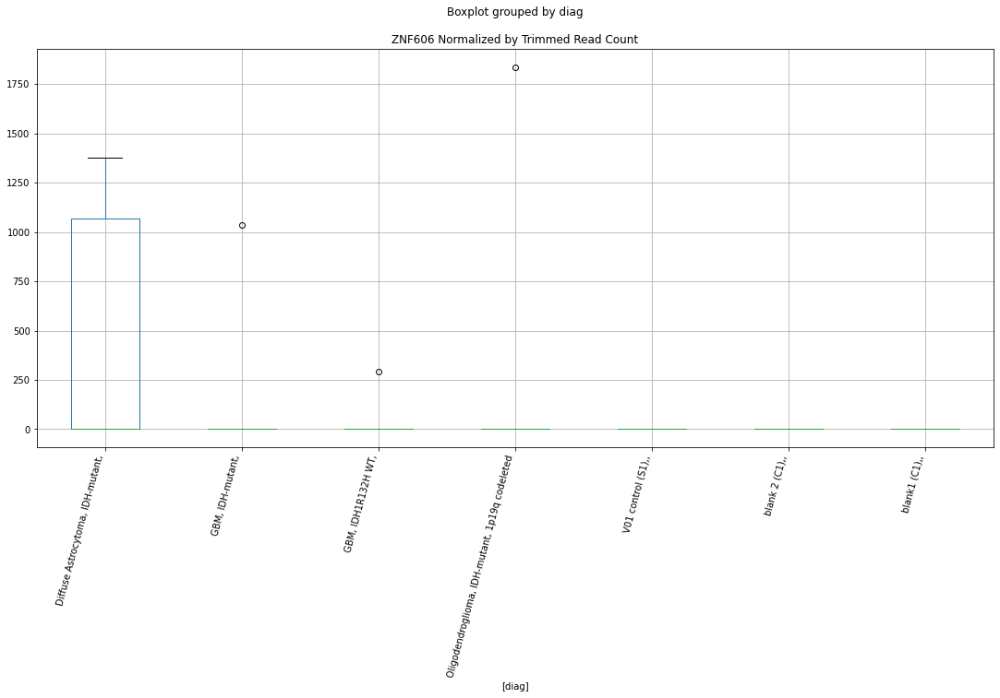

 p : 0.045273069680085404  ( t : 2.151382319430025 ) :  D-plex  :  bbduk2  :  ZNF805
Control and blanks
73     0.0
337    0.0
Name: ZNF805, dtype: float64
205    1074.55
Name: ZNF805, dtype: float64
469    3549.16
Name: ZNF805, dtype: float64


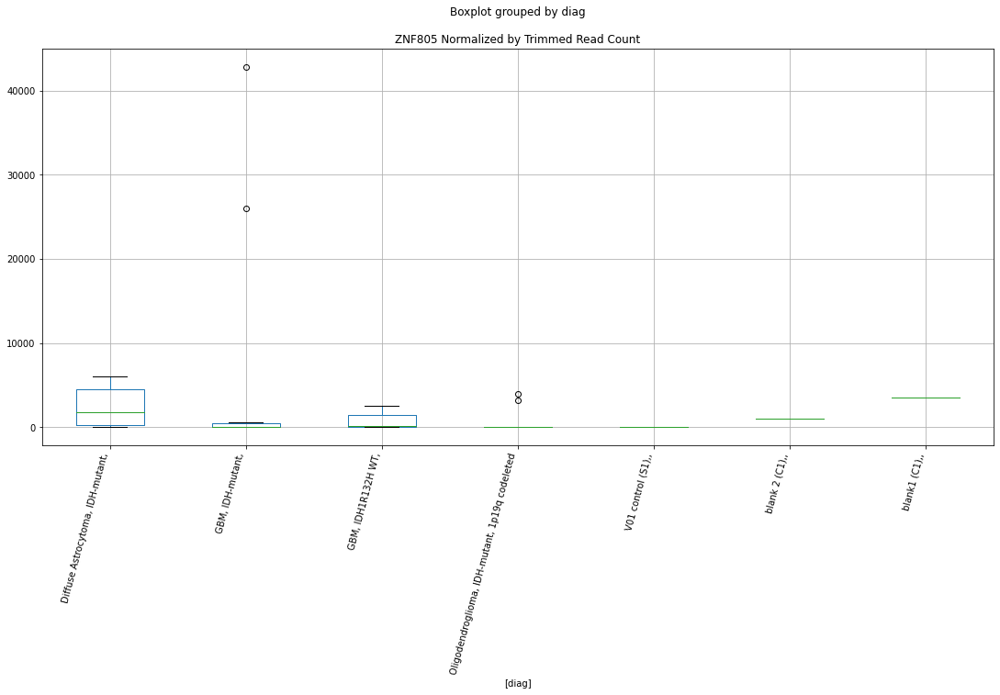

 p : 0.04528082092379262  ( t : 2.151295711581716 ) :  D-plex  :  bbduk2  :  TLCD2
Control and blanks
73     0.0
337    0.0
Name: TLCD2, dtype: float64
205    358.18
Name: TLCD2, dtype: float64
469    0.0
Name: TLCD2, dtype: float64


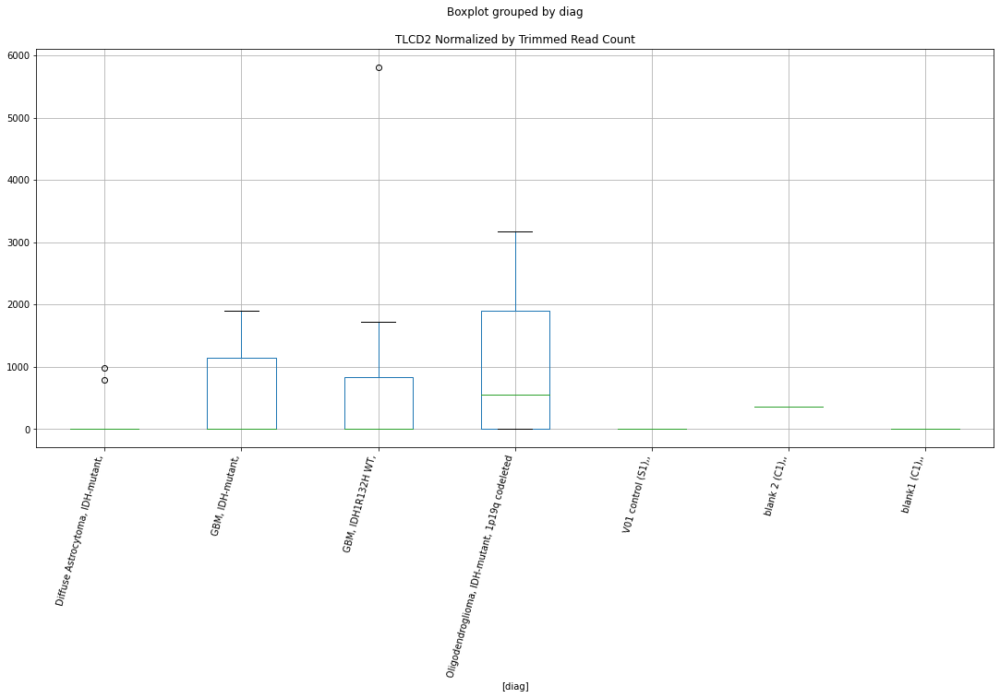

 p : 0.04529643011166179  ( t : 2.1511213447815547 ) :  D-plex  :  cutadapt2  :  ZNF805
Control and blanks
76     0.0
340    0.0
Name: ZNF805, dtype: float64
208    1058.16
Name: ZNF805, dtype: float64
472    3467.74
Name: ZNF805, dtype: float64


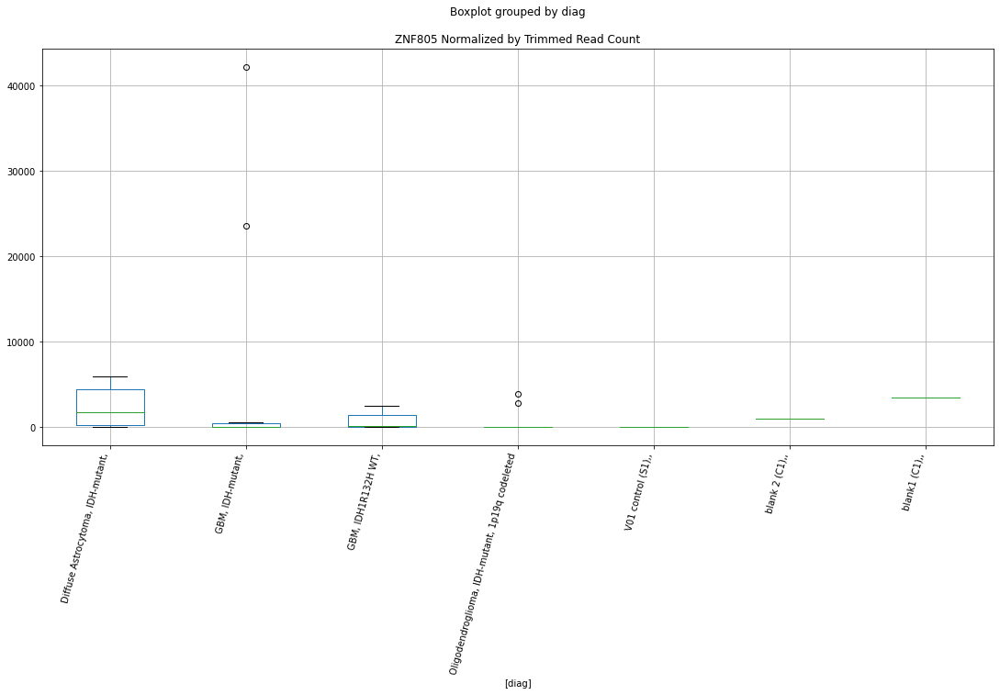

 p : 0.04529864206764174  ( t : 2.1510966399504627 ) :  D-plex  :  cutadapt2  :  VAPB
Control and blanks
76     2272.84
340    2642.20
Name: VAPB, dtype: float64
208    3174.48
Name: VAPB, dtype: float64
472    8669.34
Name: VAPB, dtype: float64


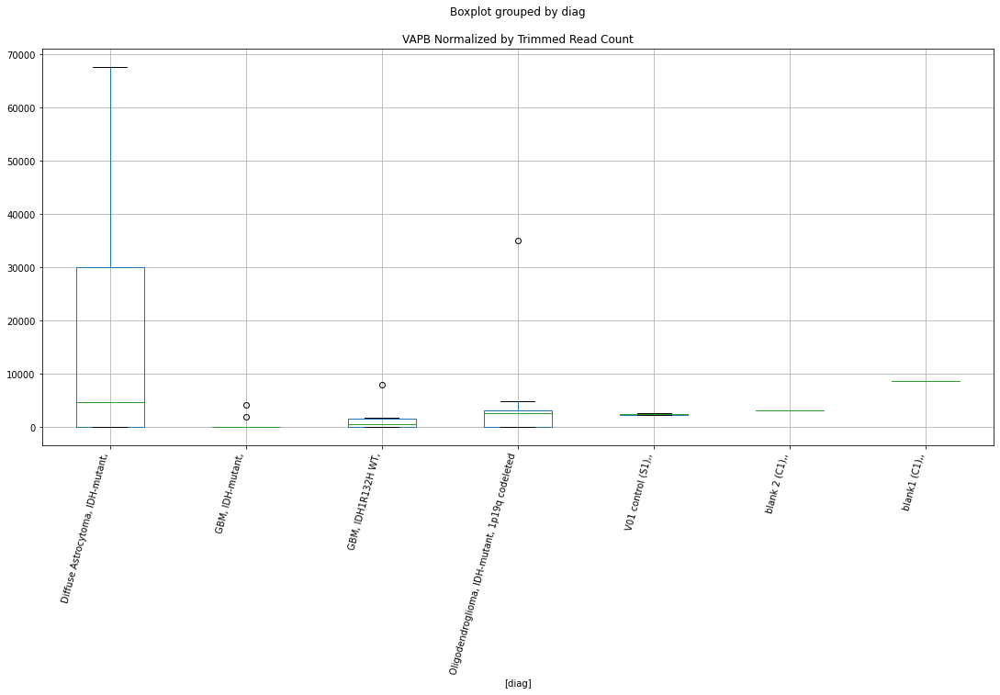

 p : 0.04531651236440763  ( t : 2.1508970911071414 ) :  D-plex  :  bbduk2  :  TRPV6
Control and blanks
73     3092.03
337       0.00
Name: TRPV6, dtype: float64
205    5730.91
Name: TRPV6, dtype: float64
469    1183.05
Name: TRPV6, dtype: float64


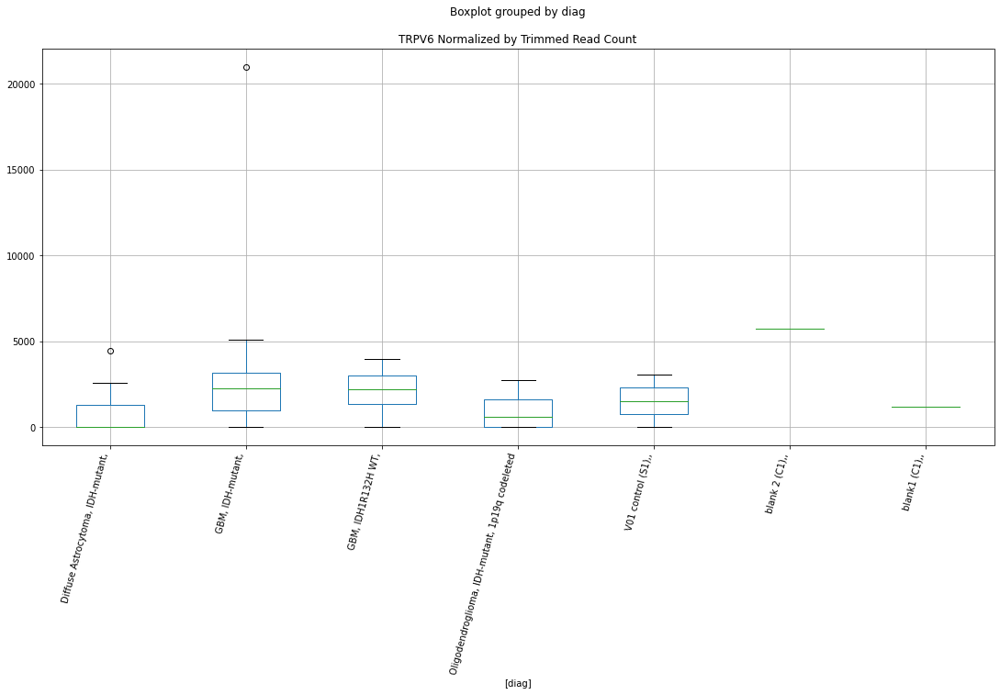

 p : 0.045417979182730946  ( t : 2.1497654222776283 ) :  D-plex  :  cutadapt2  :  SPPL2B
Control and blanks
76     9848.98
340     880.73
Name: SPPL2B, dtype: float64
208    2292.68
Name: SPPL2B, dtype: float64
472    577.96
Name: SPPL2B, dtype: float64


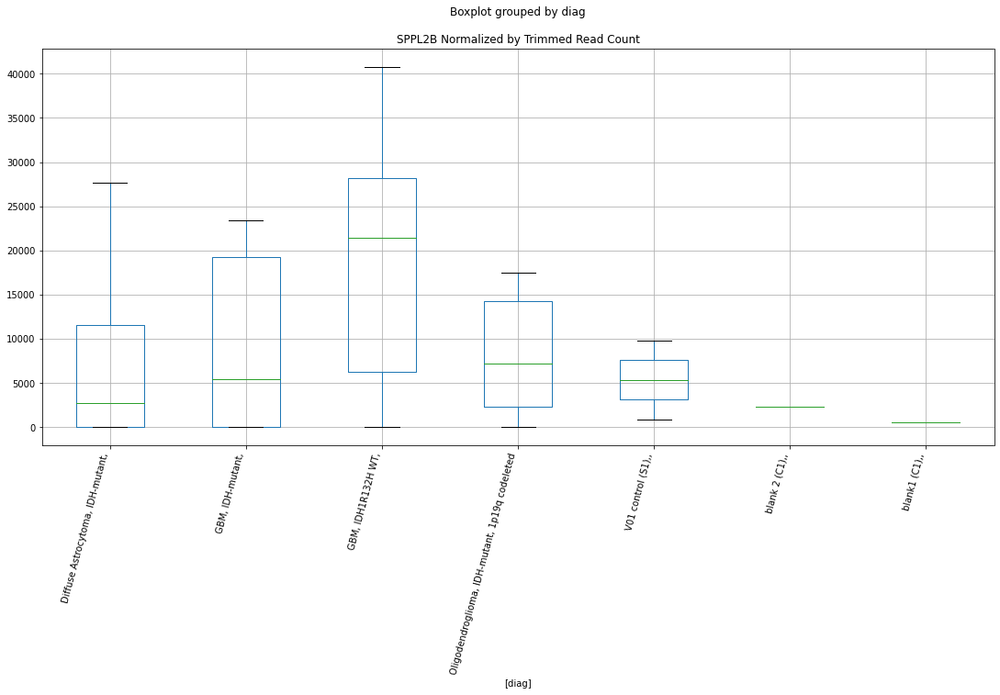

 p : 0.04544630301720484  ( t : 2.1494499363574278 ) :  D-plex  :  cutadapt2  :  TRPA1
Control and blanks
76     0.0
340    0.0
Name: TRPA1, dtype: float64
208    5114.45
Name: TRPA1, dtype: float64
472    577.96
Name: TRPA1, dtype: float64


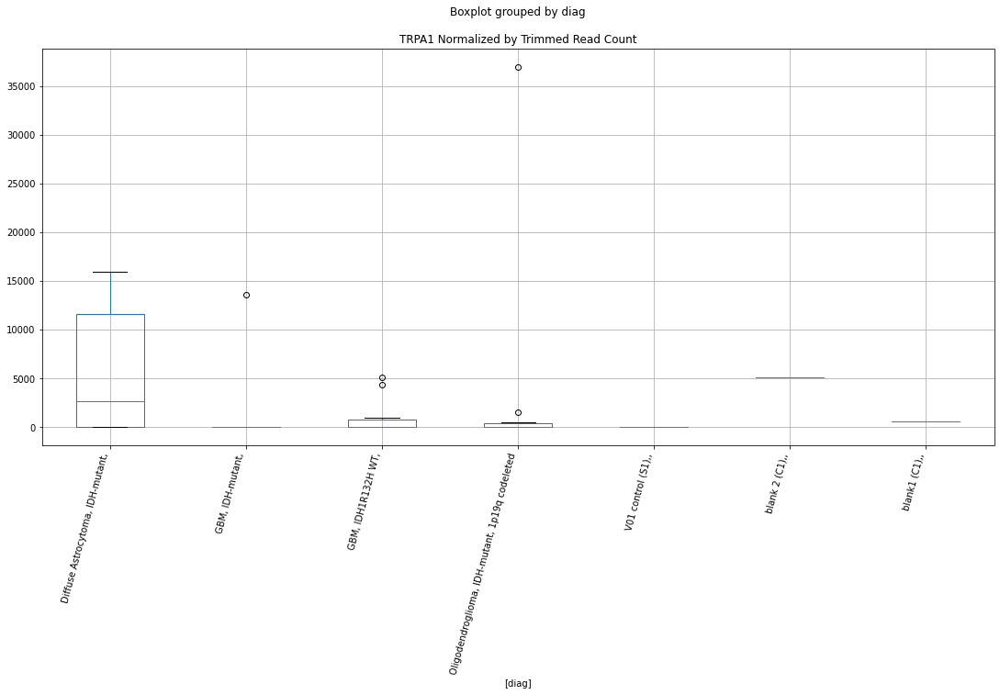

 p : 0.04550885362286511  ( t : 2.1487538504215467 ) :  D-plex  :  bbduk2  :  TTF2
Control and blanks
73     10822.12
337        0.00
Name: TTF2, dtype: float64
205    9670.91
Name: TTF2, dtype: float64
469    24844.15
Name: TTF2, dtype: float64


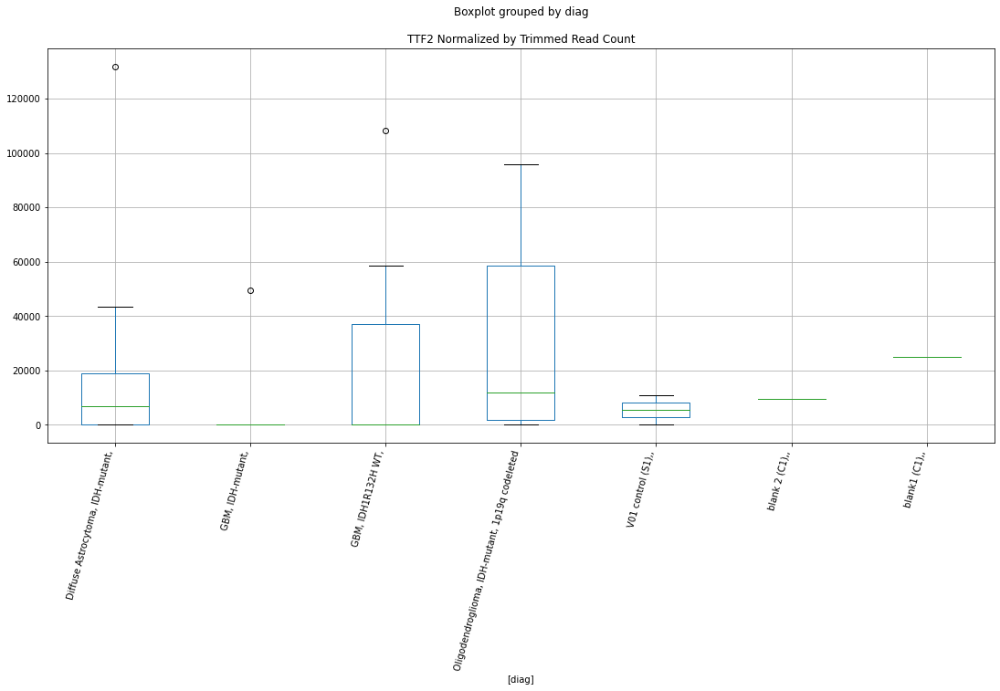

 p : 0.04558668096949243  ( t : 2.147888978686896 ) :  D-plex  :  cutadapt2  :  ZNF133
Control and blanks
76        0.00
340    5284.39
Name: ZNF133, dtype: float64
208    22926.83
Name: ZNF133, dtype: float64
472    3467.74
Name: ZNF133, dtype: float64


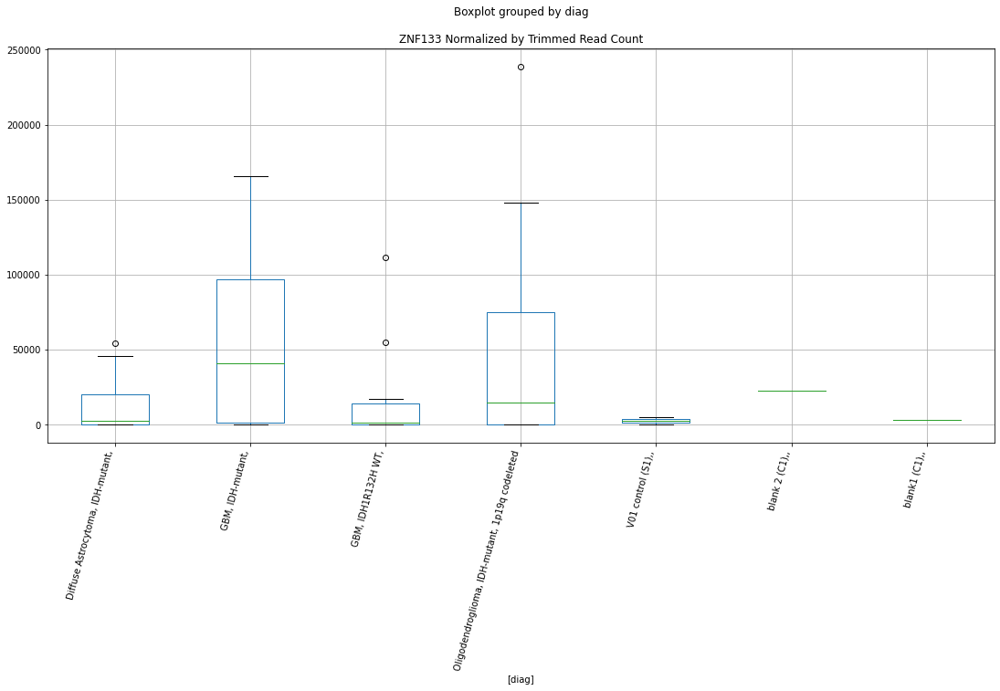

 p : 0.0456855473147009  ( t : 2.146792249915853 ) :  Lexogen  :  cutadapt2  :  TTC7B
Control and blanks
82        0.00
346    1473.04
Name: TTC7B, dtype: float64
214    4882.08
Name: TTC7B, dtype: float64
478    0.0
Name: TTC7B, dtype: float64


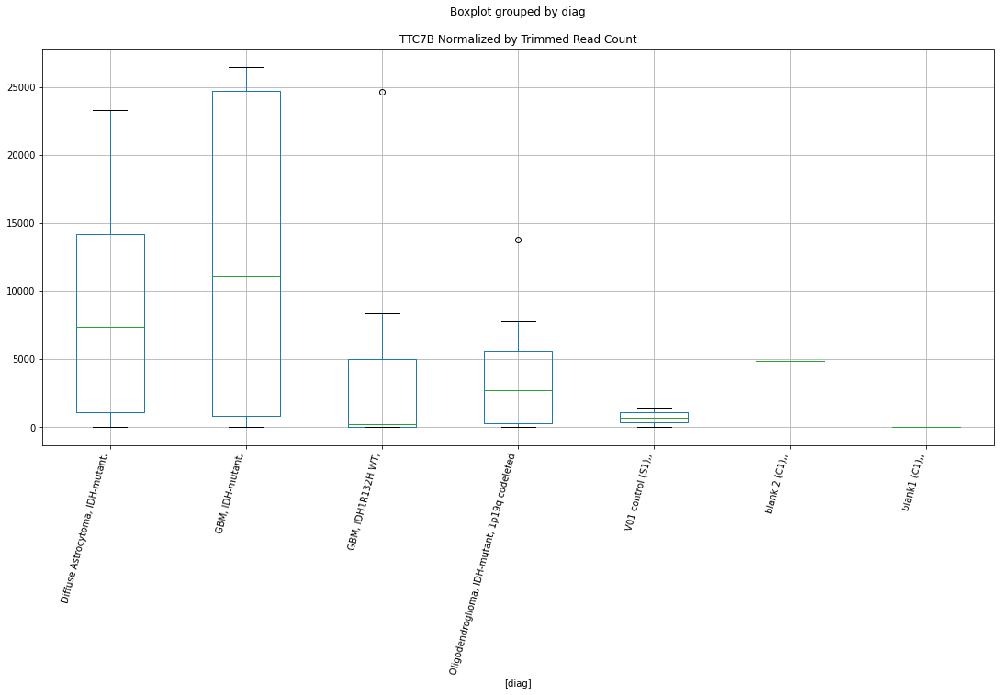

 p : 0.045760187170757895  ( t : 2.1459657018848297 ) :  D-plex  :  bbduk2  :  VTI1A
Control and blanks
73      3092.03
337    40057.08
Name: VTI1A, dtype: float64
205    1074.55
Name: VTI1A, dtype: float64
469    3549.16
Name: VTI1A, dtype: float64


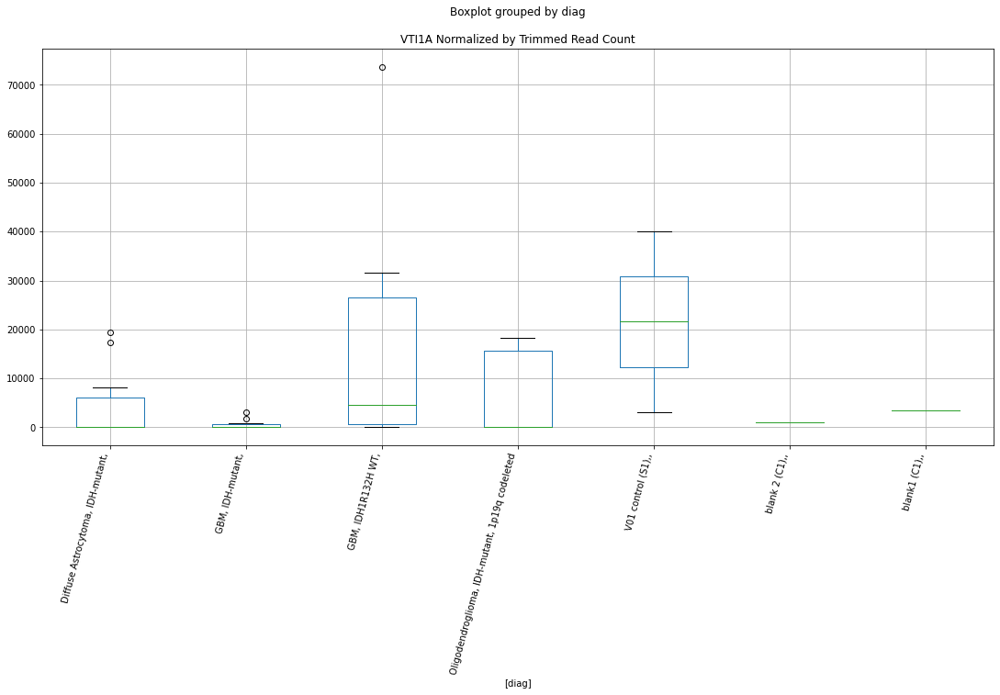

 p : 0.045810141418495126  ( t : 2.145413205296337 ) :  Lexogen  :  bbduk2  :  ZBTB16
Control and blanks
79         0.0
343    99363.1
Name: ZBTB16, dtype: float64
211    16398.38
Name: ZBTB16, dtype: float64
475    54609.59
Name: ZBTB16, dtype: float64


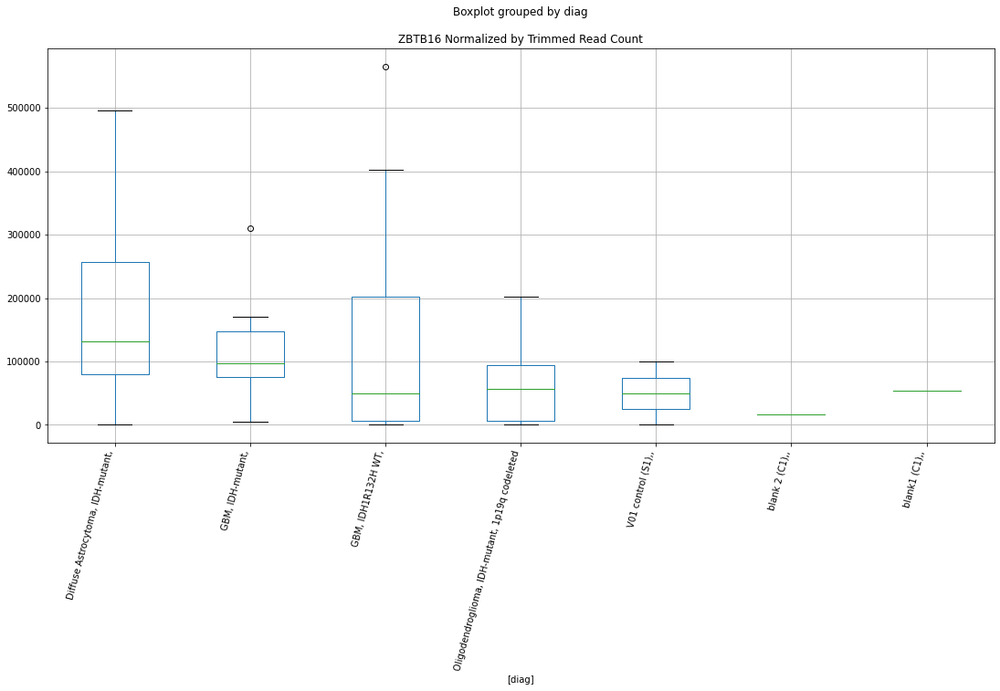

 p : 0.045855363992867736  ( t : 2.144913515580884 ) :  D-plex  :  bbduk2  :  TMEM95
Control and blanks
73     0.0
337    0.0
Name: TMEM95, dtype: float64
205    1970.0
Name: TMEM95, dtype: float64
469    591.53
Name: TMEM95, dtype: float64


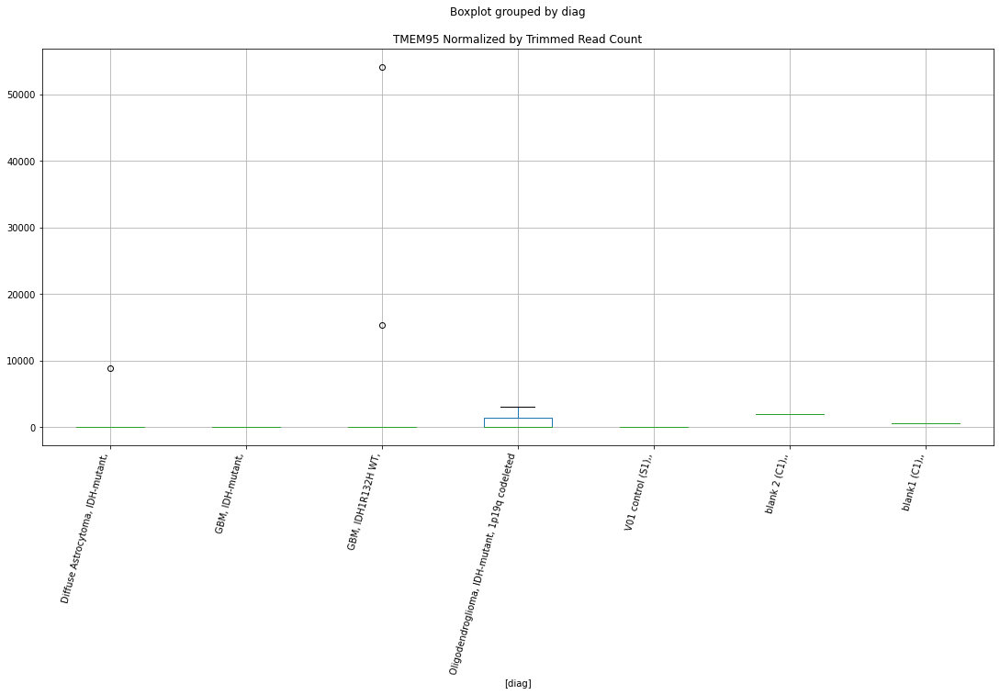

 p : 0.04586679977892848  ( t : 2.14478722642825 ) :  Lexogen  :  bbduk2  :  ZNF571
Control and blanks
79     0.0
343    0.0
Name: ZNF571, dtype: float64
211    0.0
Name: ZNF571, dtype: float64
475    0.0
Name: ZNF571, dtype: float64


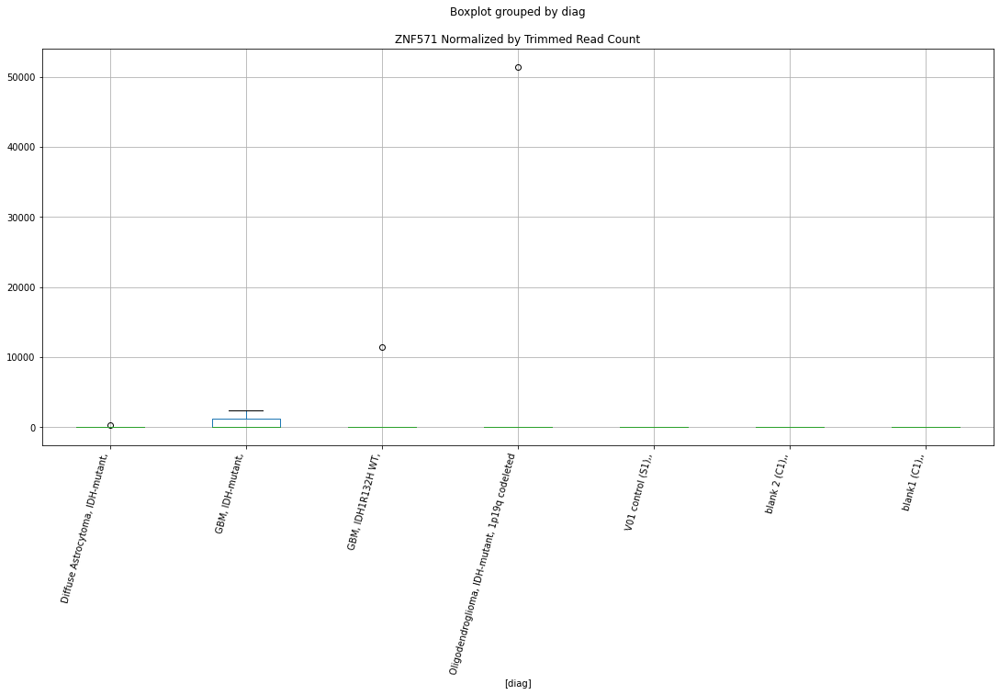

 p : 0.04588970761440377  ( t : 2.144534334123208 ) :  D-plex  :  bbduk2  :  ZNF362
Control and blanks
73     0.0
337    0.0
Name: ZNF362, dtype: float64
205    4298.18
Name: ZNF362, dtype: float64
469    4732.22
Name: ZNF362, dtype: float64


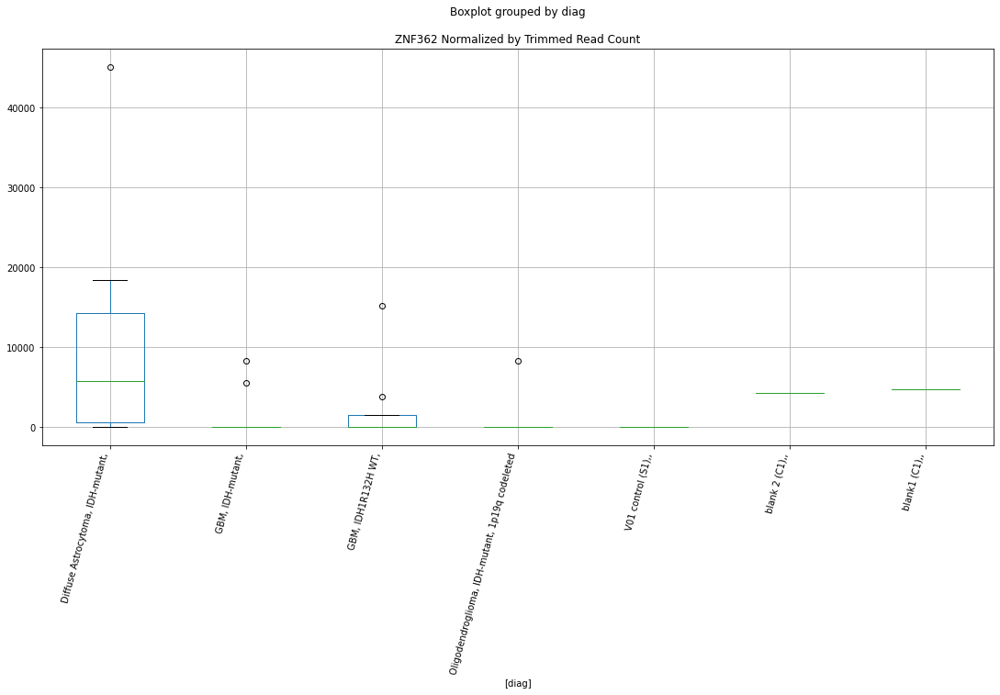

 p : 0.04595118155439913  ( t : 2.1438562585352035 ) :  Lexogen  :  bbduk2  :  ZNF280A
Control and blanks
79       0.00
343    849.26
Name: ZNF280A, dtype: float64
211    13118.7
Name: ZNF280A, dtype: float64
475    14370.94
Name: ZNF280A, dtype: float64


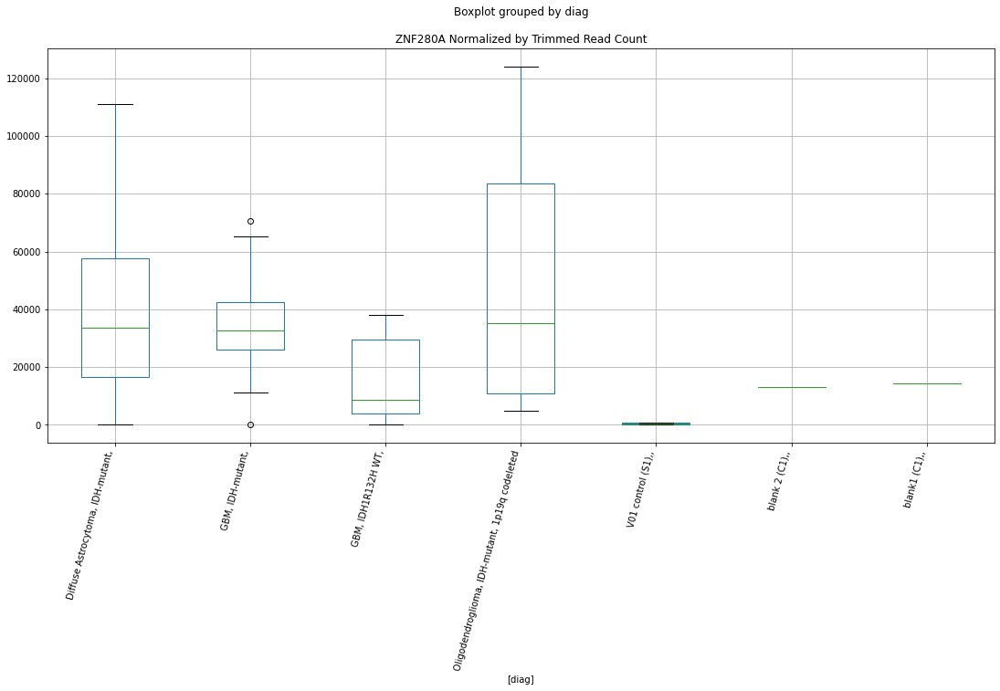

 p : 0.04599792754143814  ( t : 2.1433411907946427 ) :  Lexogen  :  cutadapt2  :  ZNF503
Control and blanks
82     0.0
346    0.0
Name: ZNF503, dtype: float64
214    0.0
Name: ZNF503, dtype: float64
478    237.46
Name: ZNF503, dtype: float64


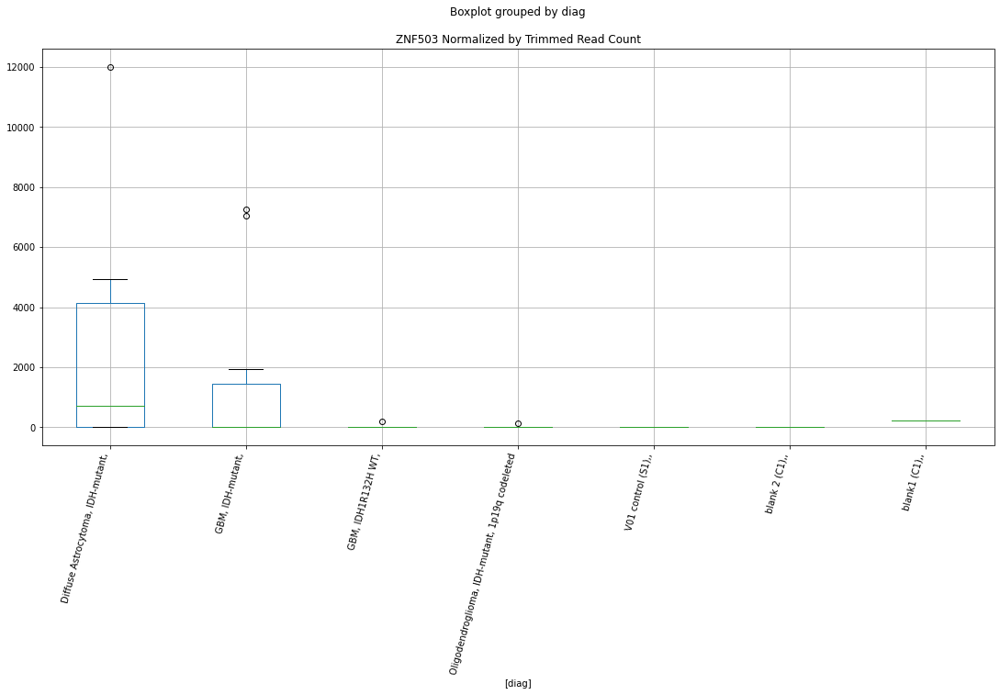

 p : 0.04599840555387045  ( t : 2.1433359263136493 ) :  Lexogen  :  bbduk2  :  TRIM62
Control and blanks
79         0.00
343    51804.69
Name: TRIM62, dtype: float64
211    0.0
Name: TRIM62, dtype: float64
475    0.0
Name: TRIM62, dtype: float64


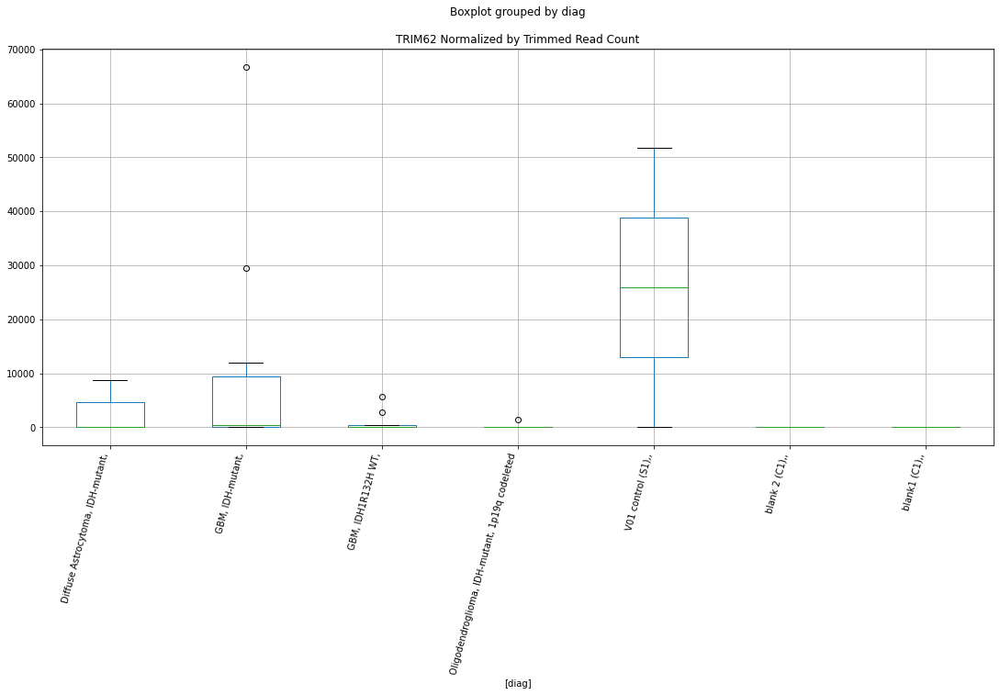

 p : 0.046004856944910015  ( t : 2.1432648802747027 ) :  Lexogen  :  cutadapt2  :  TRIM62
Control and blanks
82         0.00
346    51346.02
Name: TRIM62, dtype: float64
214    0.0
Name: TRIM62, dtype: float64
478    0.0
Name: TRIM62, dtype: float64


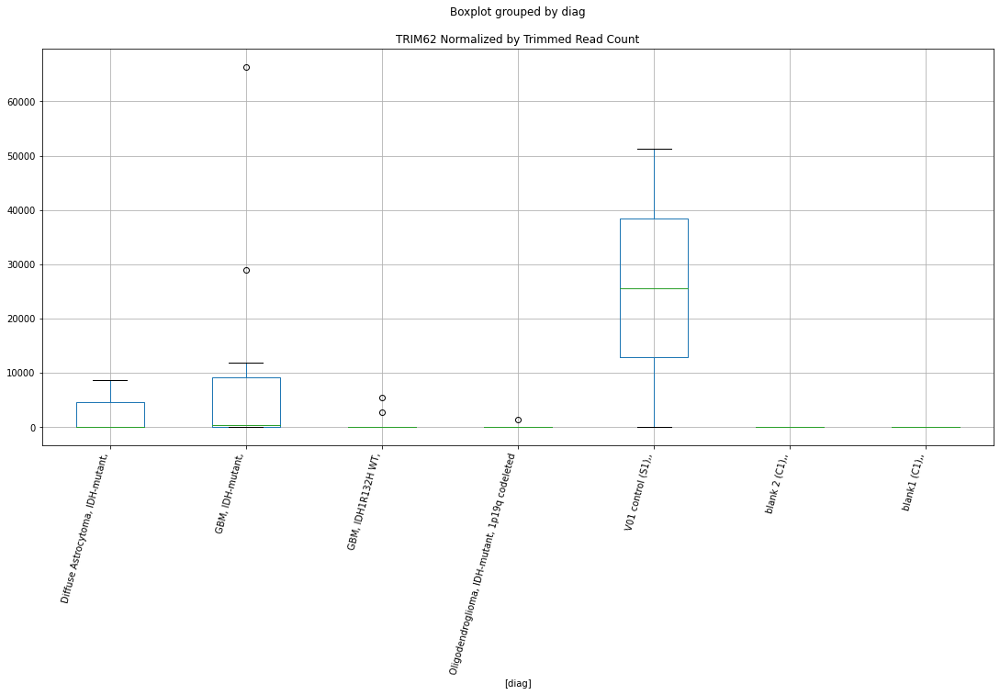

 p : 0.04619194657516997  ( t : 2.141208499704146 ) :  D-plex  :  cutadapt2  :  TMEM230
Control and blanks
76       9091.37
340    549576.85
Name: TMEM230, dtype: float64
208    37388.37
Name: TMEM230, dtype: float64
472    32365.53
Name: TMEM230, dtype: float64


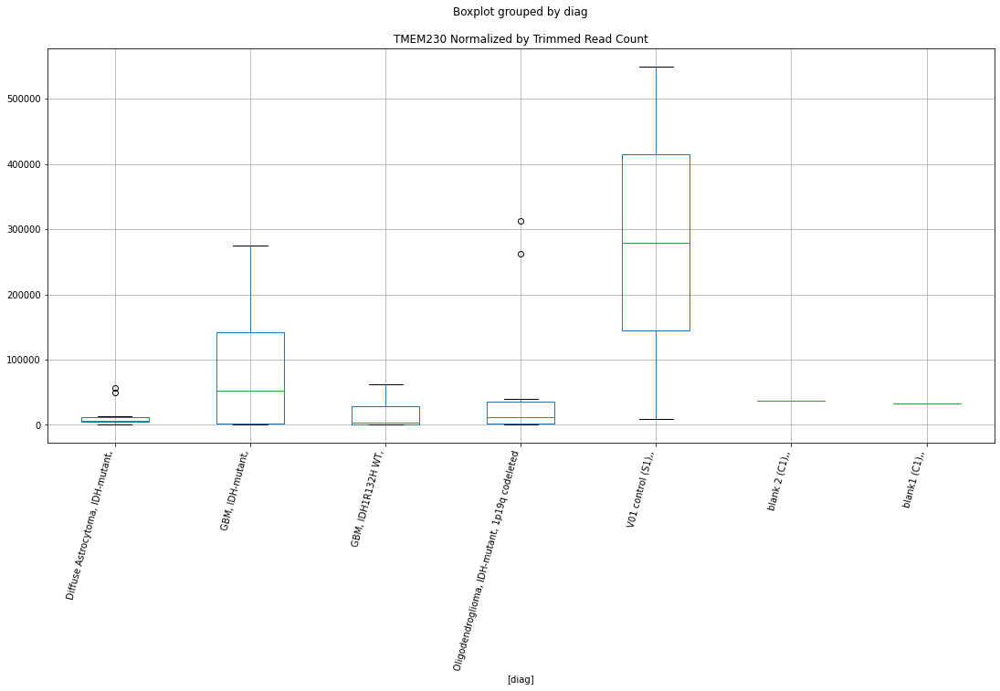

 p : 0.046197397023829925  ( t : 2.1411487055994933 ) :  D-plex  :  bbduk2  :  UNC5B
Control and blanks
73      5411.06
337    68542.11
Name: UNC5B, dtype: float64
205    2686.36
Name: UNC5B, dtype: float64
469    8872.91
Name: UNC5B, dtype: float64


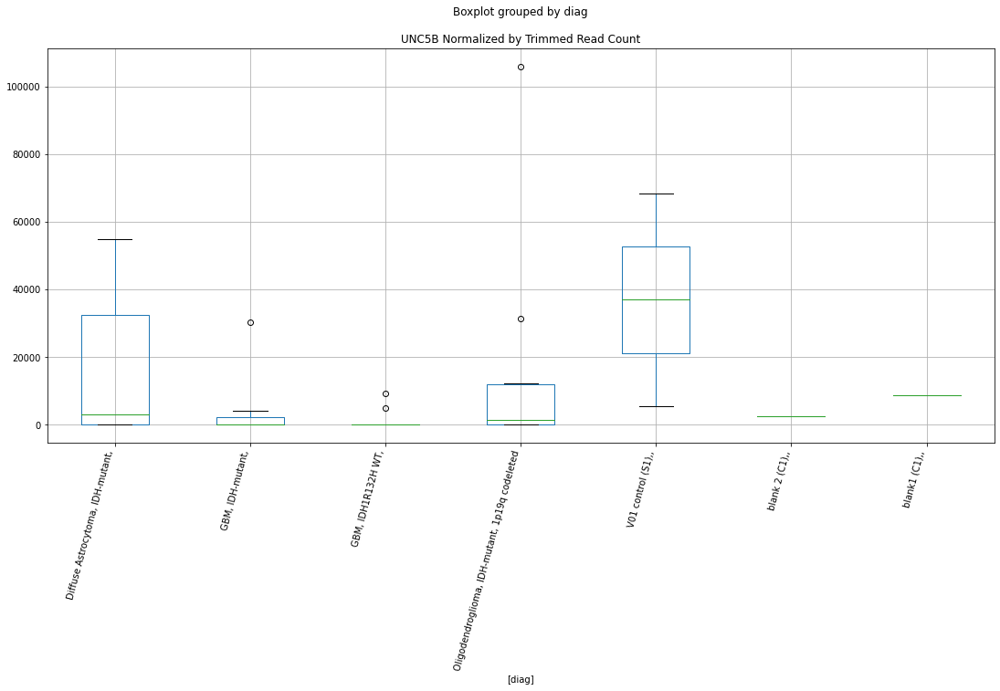

 p : 0.046314805363427206  ( t : 2.1398622392444535 ) :  Lexogen  :  bbduk2  :  TMEM178A
Control and blanks
79     0.0
343    0.0
Name: TMEM178A, dtype: float64
211    273.31
Name: TMEM178A, dtype: float64
475    0.0
Name: TMEM178A, dtype: float64


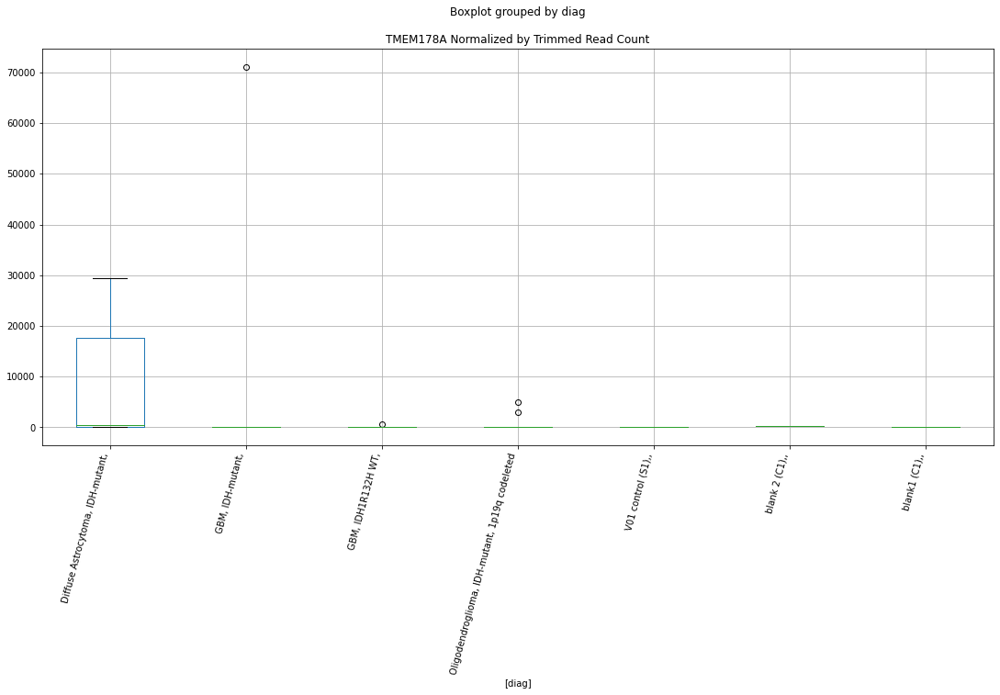

 p : 0.04631956349953204  ( t : 2.139810166196246 ) :  D-plex  :  bbduk2  :  SUGCT
Control and blanks
73     0.0
337    0.0
Name: SUGCT, dtype: float64
205    1432.73
Name: SUGCT, dtype: float64
469    1183.05
Name: SUGCT, dtype: float64


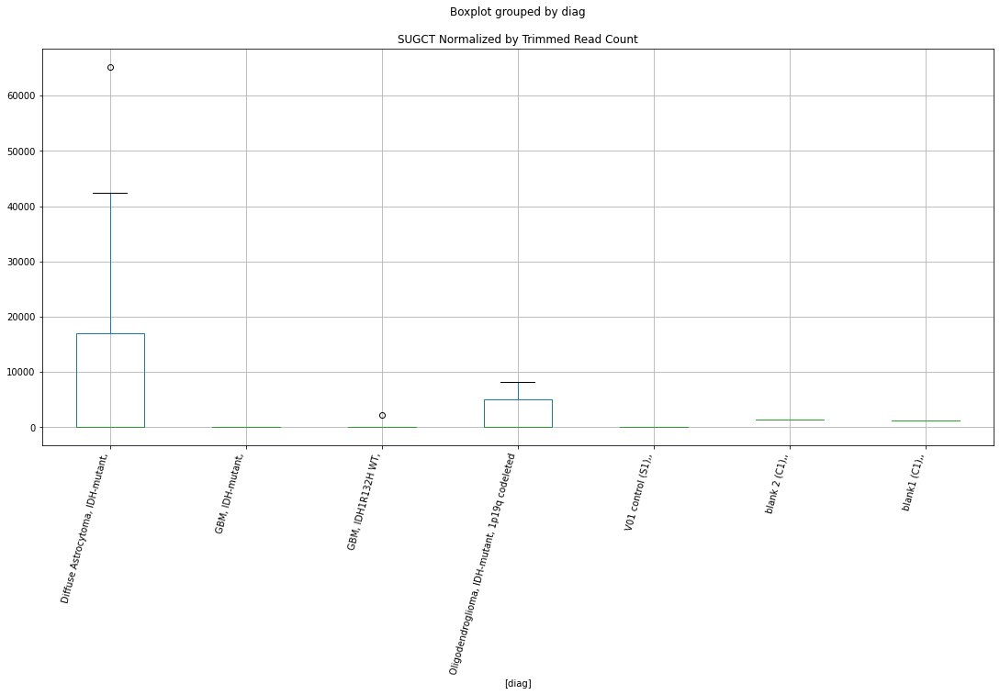

 p : 0.04636853479022453  ( t : 2.1392745078475945 ) :  Lexogen  :  cutadapt2  :  ZNF503
Control and blanks
82     0.0
346    0.0
Name: ZNF503, dtype: float64
214    0.0
Name: ZNF503, dtype: float64
478    237.46
Name: ZNF503, dtype: float64


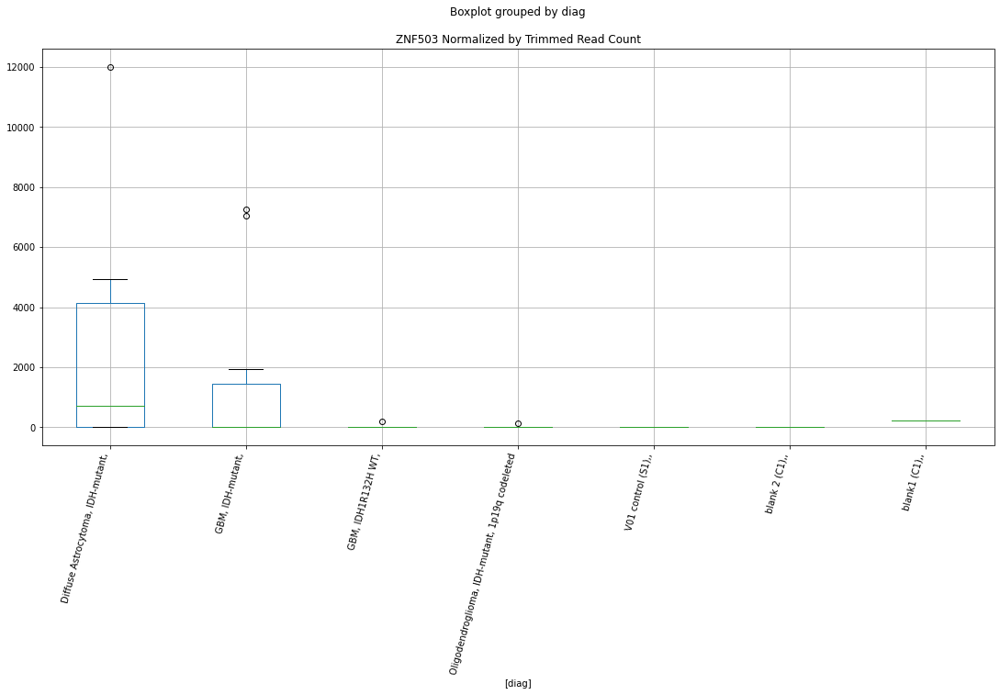

 p : 0.046410972058494926  ( t : 2.138810737448401 ) :  Lexogen  :  cutadapt2  :  ZBTB16
Control and blanks
82         0.00
346    98483.36
Name: ZBTB16, dtype: float64
214    16273.59
Name: ZBTB16, dtype: float64
478    54140.99
Name: ZBTB16, dtype: float64


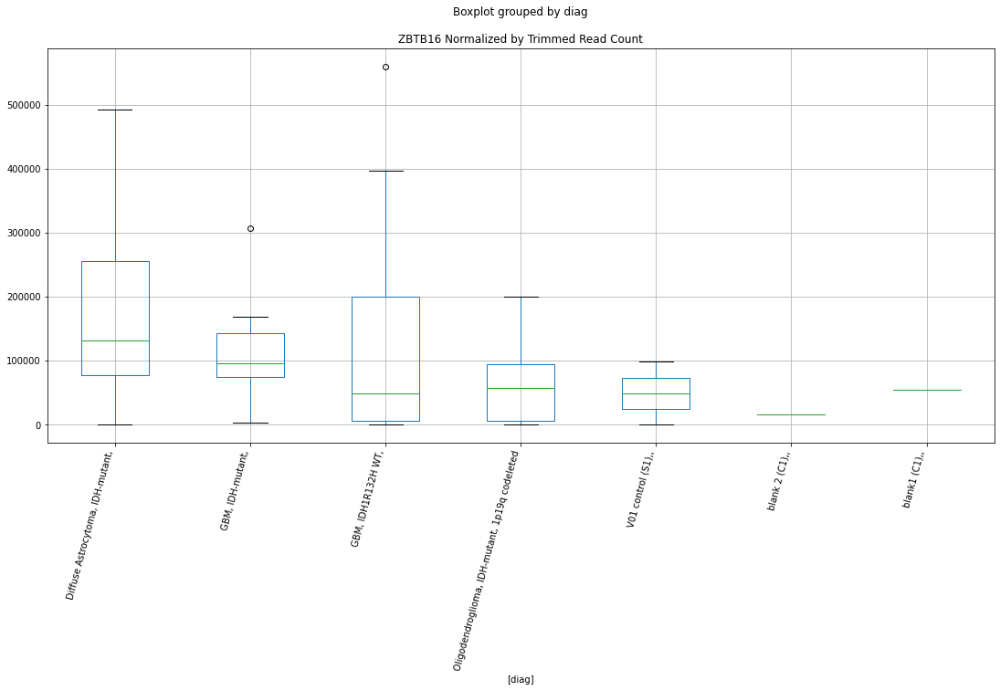

 p : 0.04649310176129493  ( t : 2.1379142914361124 ) :  D-plex  :  cutadapt2  :  SUCLG2
Control and blanks
76     0.0
340    0.0
Name: SUCLG2, dtype: float64
208    0.0
Name: SUCLG2, dtype: float64
472    2311.82
Name: SUCLG2, dtype: float64


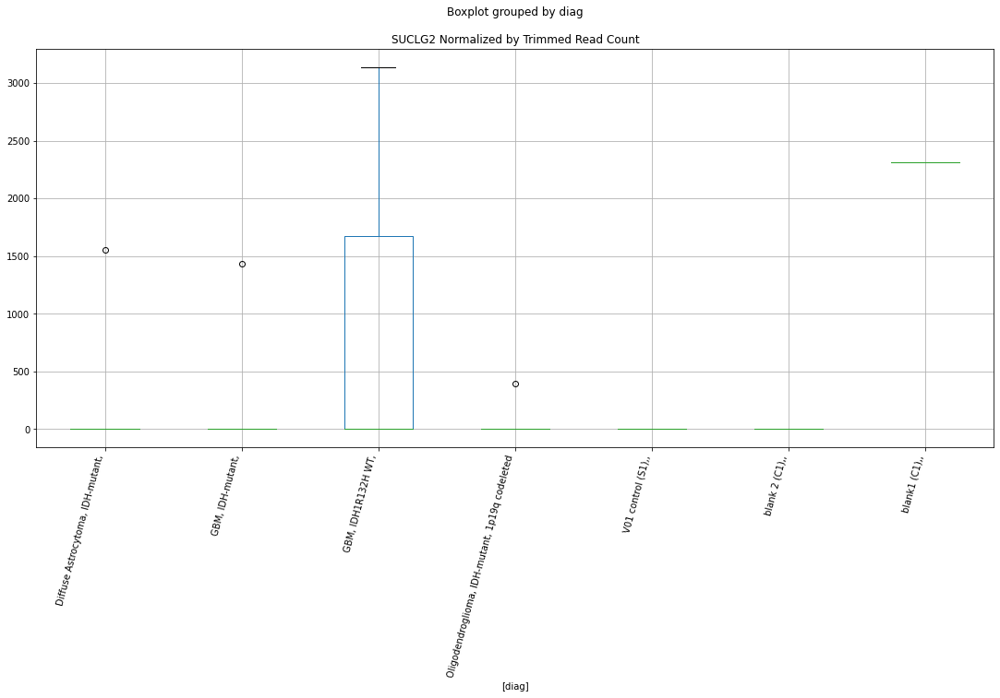

 p : 0.04662209403056628  ( t : 2.1365092532511234 ) :  D-plex  :  bbduk2  :  TEX30
Control and blanks
73     0.0
337    0.0
Name: TEX30, dtype: float64
205    3581.82
Name: TEX30, dtype: float64
469    2366.11
Name: TEX30, dtype: float64


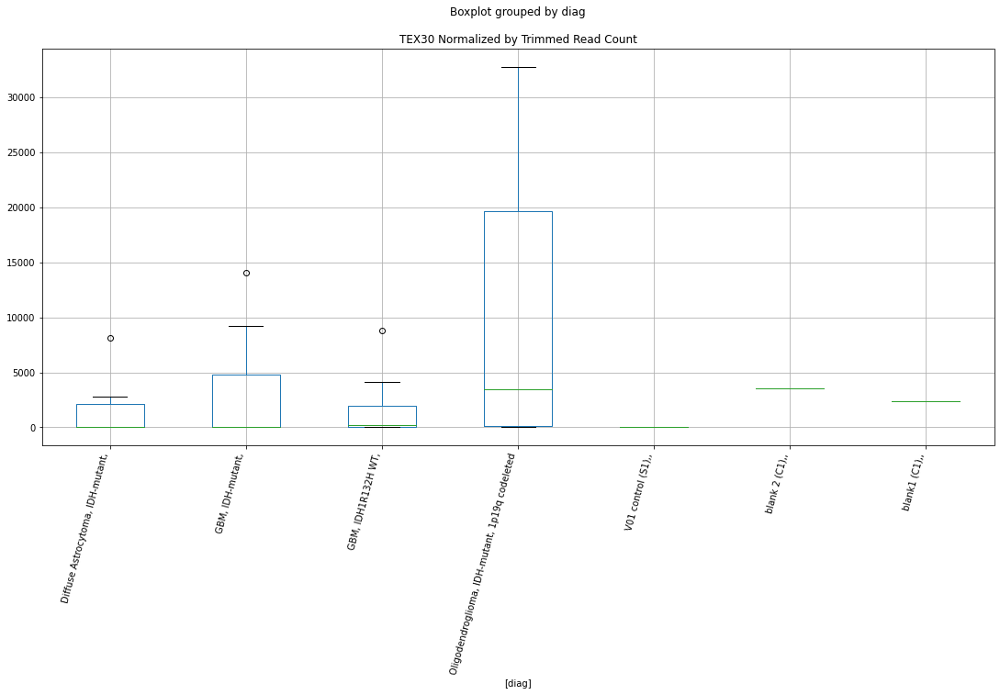

 p : 0.04663765730937266  ( t : 2.136339971328455 ) :  D-plex  :  bbduk2  :  ZBED2
Control and blanks
73     0.0
337    0.0
Name: ZBED2, dtype: float64
205    0.0
Name: ZBED2, dtype: float64
469    0.0
Name: ZBED2, dtype: float64


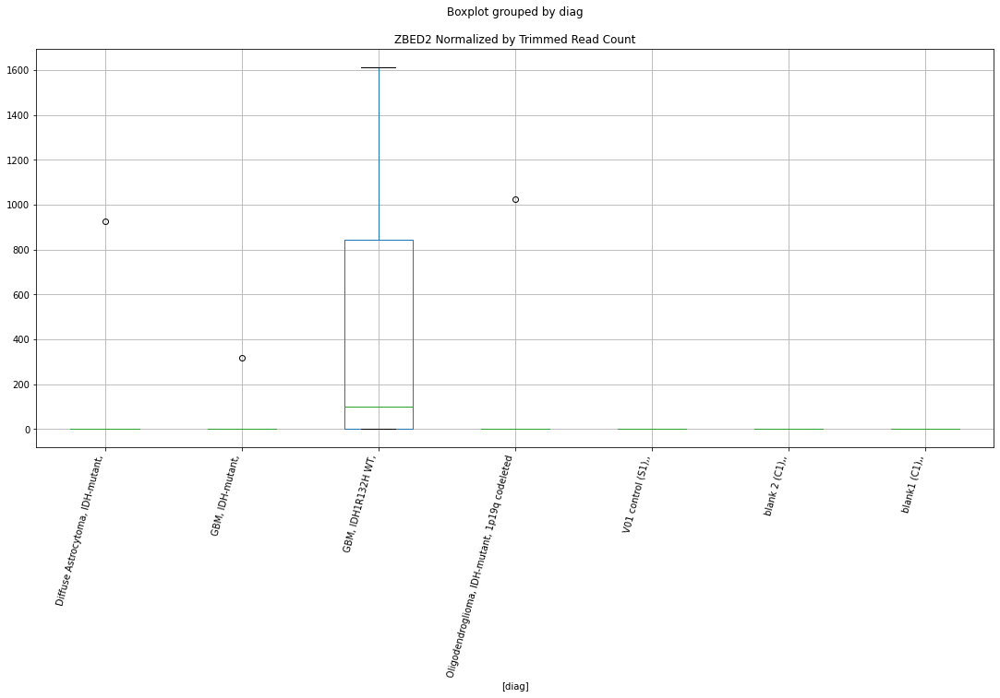

 p : 0.04666864160163653  ( t : 2.1360031082992132 ) :  D-plex  :  cutadapt2  :  ZNF736
Control and blanks
76     0.0
340    0.0
Name: ZNF736, dtype: float64
208    529.08
Name: ZNF736, dtype: float64
472    0.0
Name: ZNF736, dtype: float64


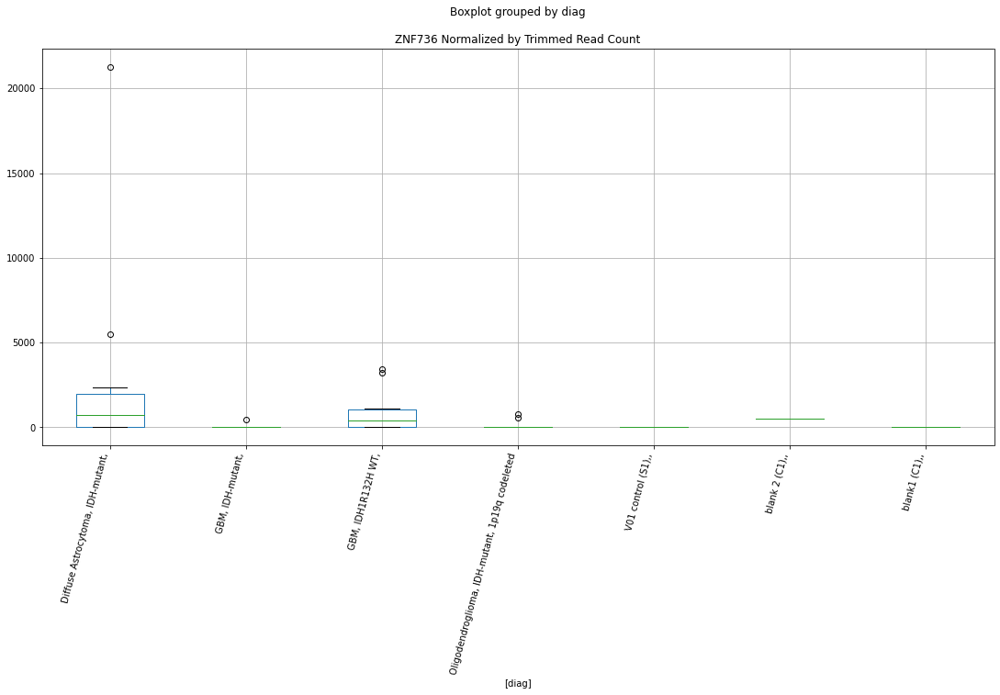

 p : 0.04680842433008987  ( t : 2.134485914511717 ) :  D-plex  :  bbduk2  :  TRIM38
Control and blanks
73     0.0
337    0.0
Name: TRIM38, dtype: float64
205    4119.09
Name: TRIM38, dtype: float64
469    9464.44
Name: TRIM38, dtype: float64


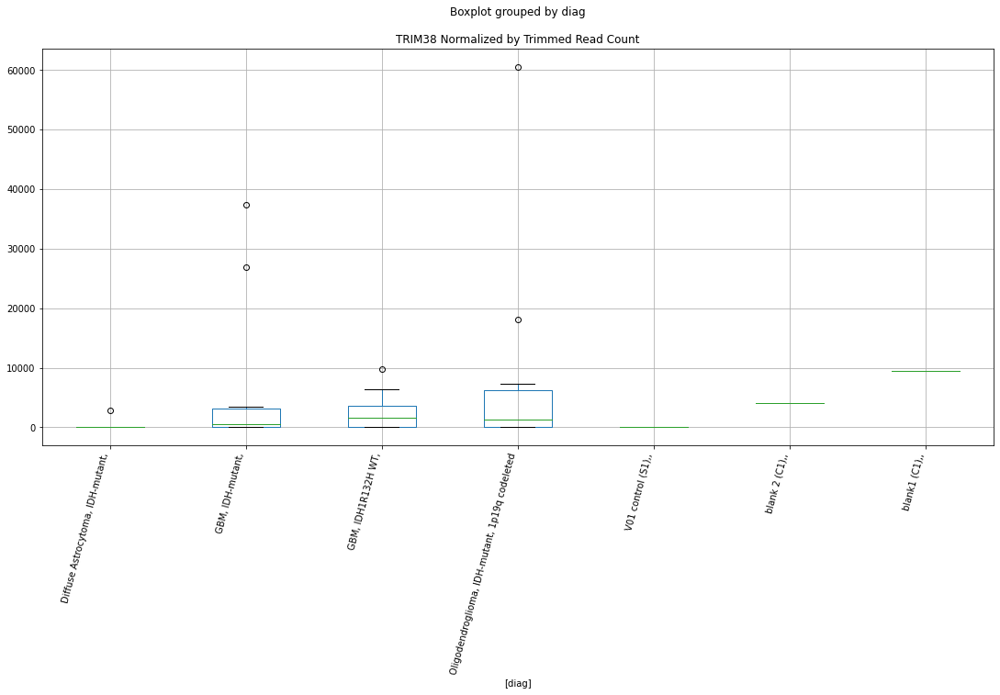

 p : 0.04687981512630327  ( t : 2.1337126367039394 ) :  Lexogen  :  cutadapt2  :  TPCN2
Control and blanks
82     0.0
346    0.0
Name: TPCN2, dtype: float64
214    1084.91
Name: TPCN2, dtype: float64
478    0.0
Name: TPCN2, dtype: float64


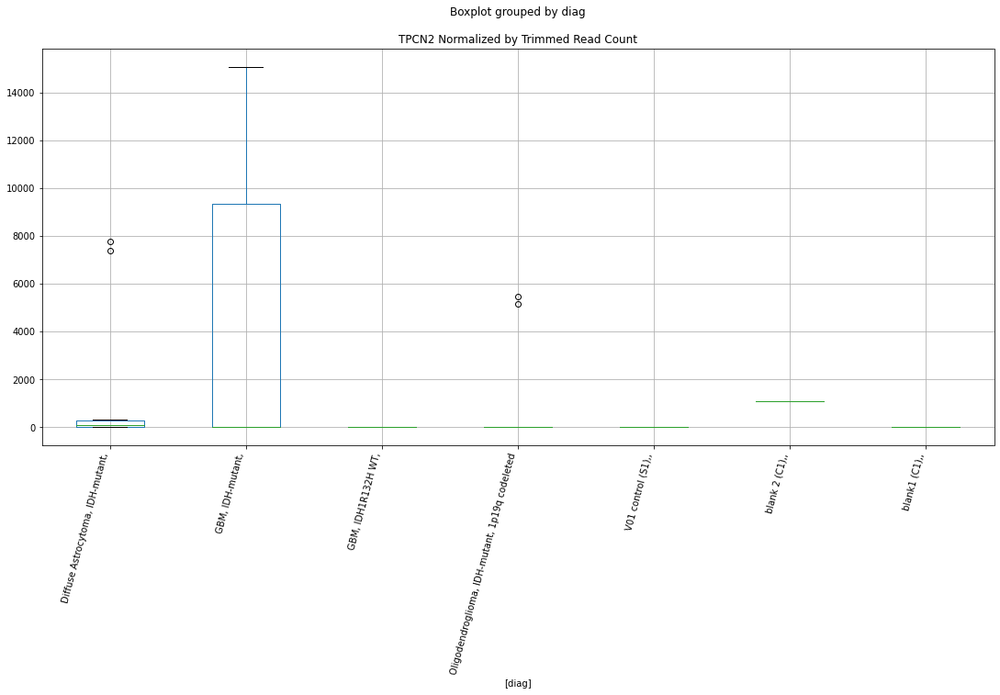

 p : 0.04690487907052633  ( t : 2.1334414083839754 ) :  Lexogen  :  bbduk2  :  TSC22D2
Control and blanks
79       0.00
343    636.94
Name: TSC22D2, dtype: float64
211    1093.23
Name: TSC22D2, dtype: float64
475    1197.58
Name: TSC22D2, dtype: float64


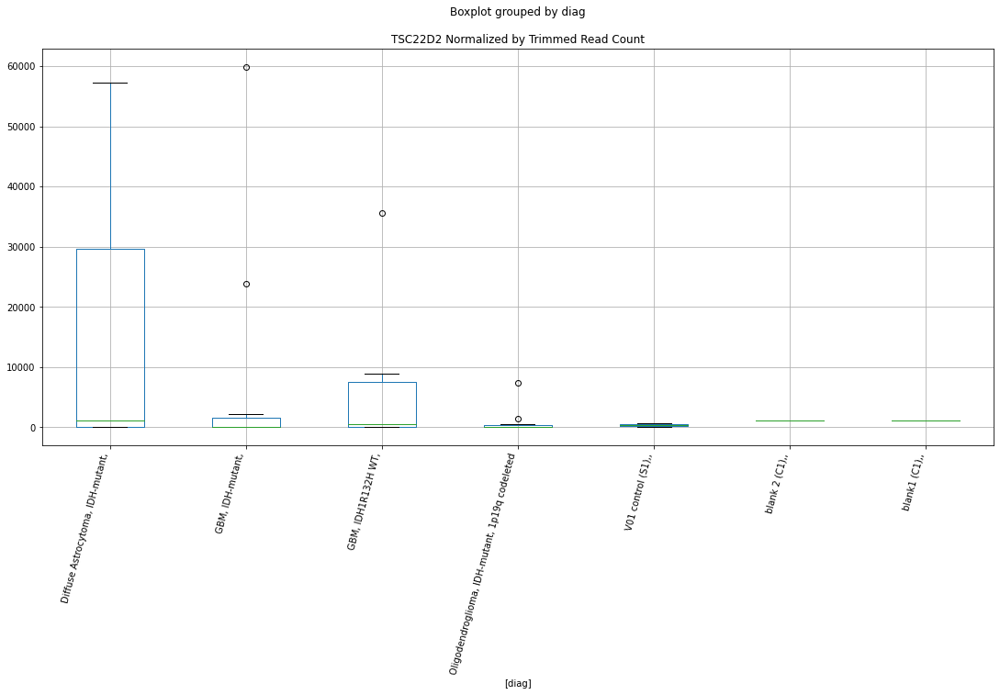

 p : 0.04695610061887528  ( t : 2.1328875276413606 ) :  Lexogen  :  bbduk2  :  TPCN2
Control and blanks
79     0.0
343    0.0
Name: TPCN2, dtype: float64
211    1093.23
Name: TPCN2, dtype: float64
475    0.0
Name: TPCN2, dtype: float64


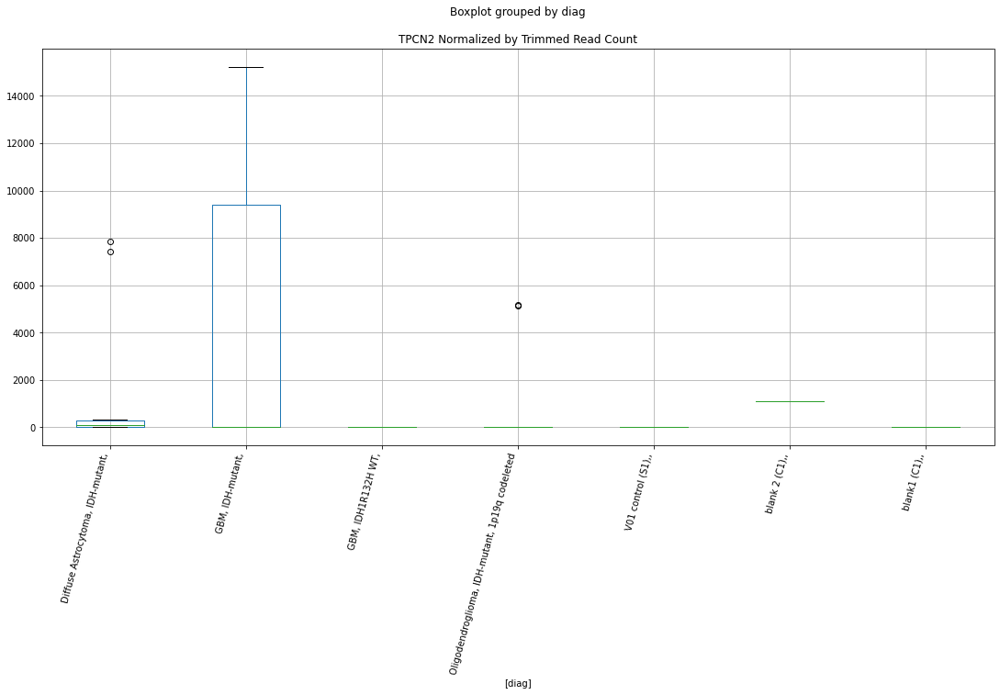

 p : 0.046961584809755784  ( t : 2.1328282573790496 ) :  D-plex  :  bbduk2  :  ZBTB22
Control and blanks
73     0.0
337    0.0
Name: ZBTB22, dtype: float64
205    7163.64
Name: ZBTB22, dtype: float64
469    0.0
Name: ZBTB22, dtype: float64


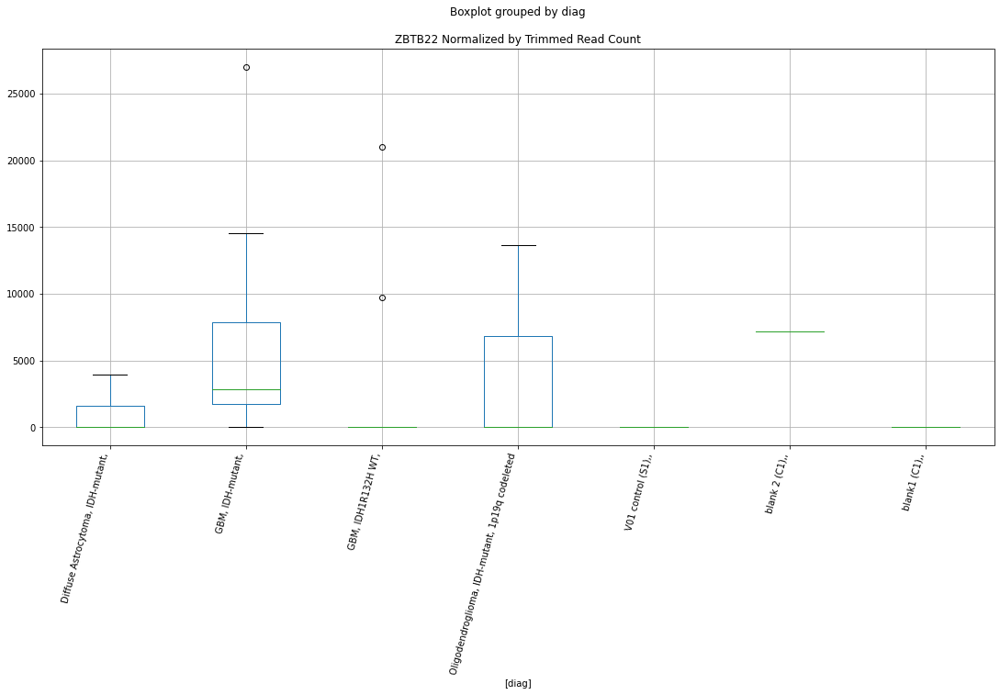

 p : 0.04701278558876692  ( t : 2.1322752105642233 ) :  D-plex  :  cutadapt2  :  ZFYVE16
Control and blanks
76     0.0
340    0.0
Name: ZFYVE16, dtype: float64
208    4761.73
Name: ZFYVE16, dtype: float64
472    16760.72
Name: ZFYVE16, dtype: float64


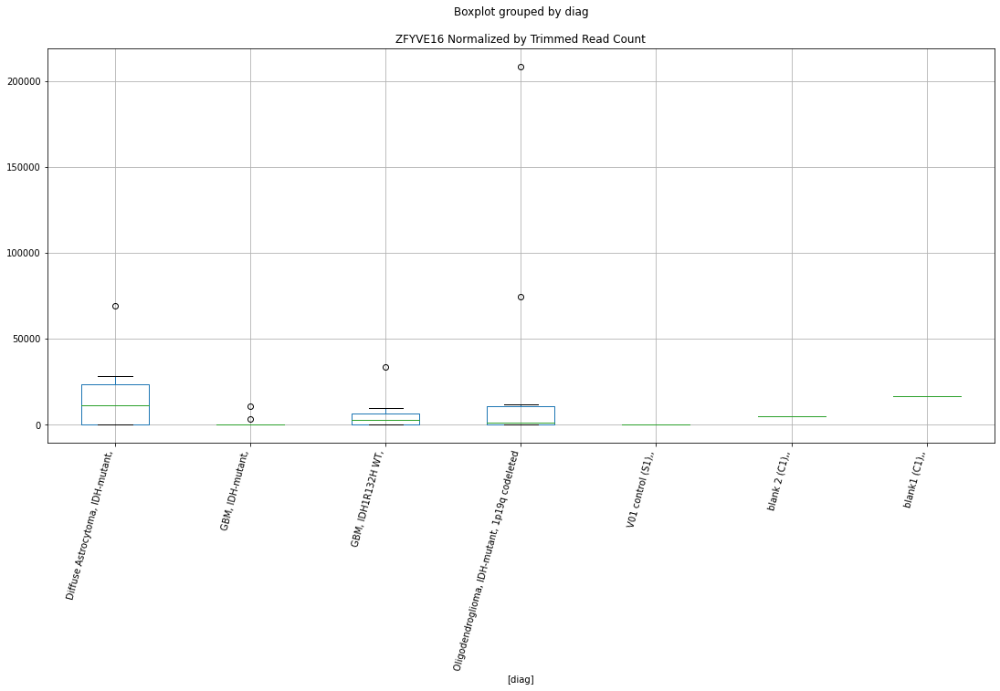

 p : 0.047049290605554225  ( t : 2.1318812358317887 ) :  Lexogen  :  bbduk2  :  TPBG
Control and blanks
79     0.0
343    0.0
Name: TPBG, dtype: float64
211    0.0
Name: TPBG, dtype: float64
475    0.0
Name: TPBG, dtype: float64


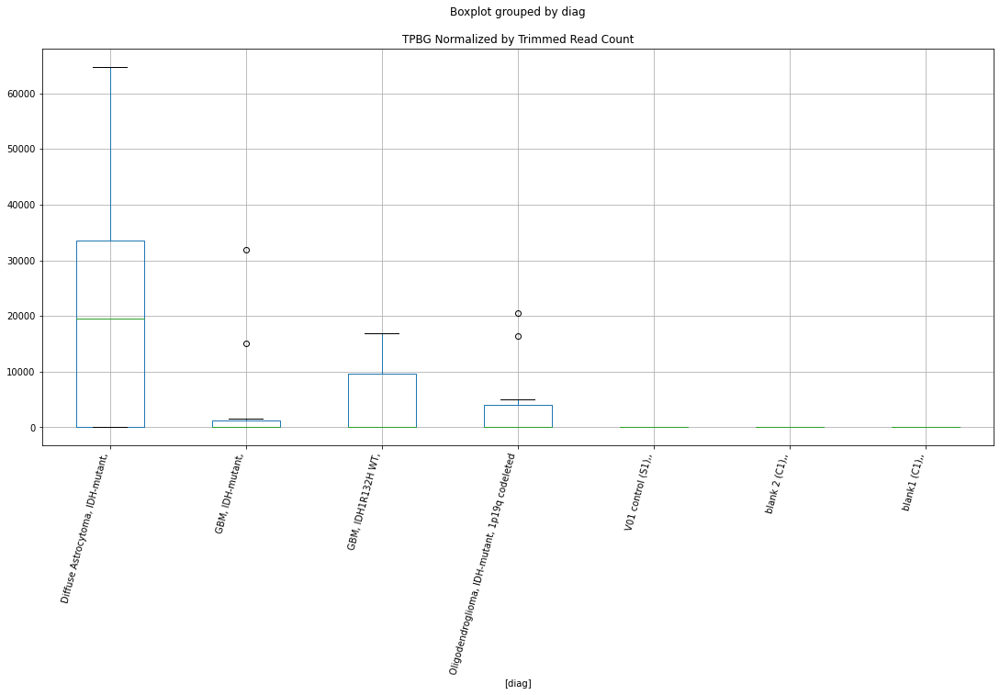

 p : 0.047071011144919975  ( t : 2.1316469525413977 ) :  D-plex  :  cutadapt2  :  TYMS
Control and blanks
76     0.0
340    0.0
Name: TYMS, dtype: float64
208    1939.96
Name: TYMS, dtype: float64
472    3467.74
Name: TYMS, dtype: float64


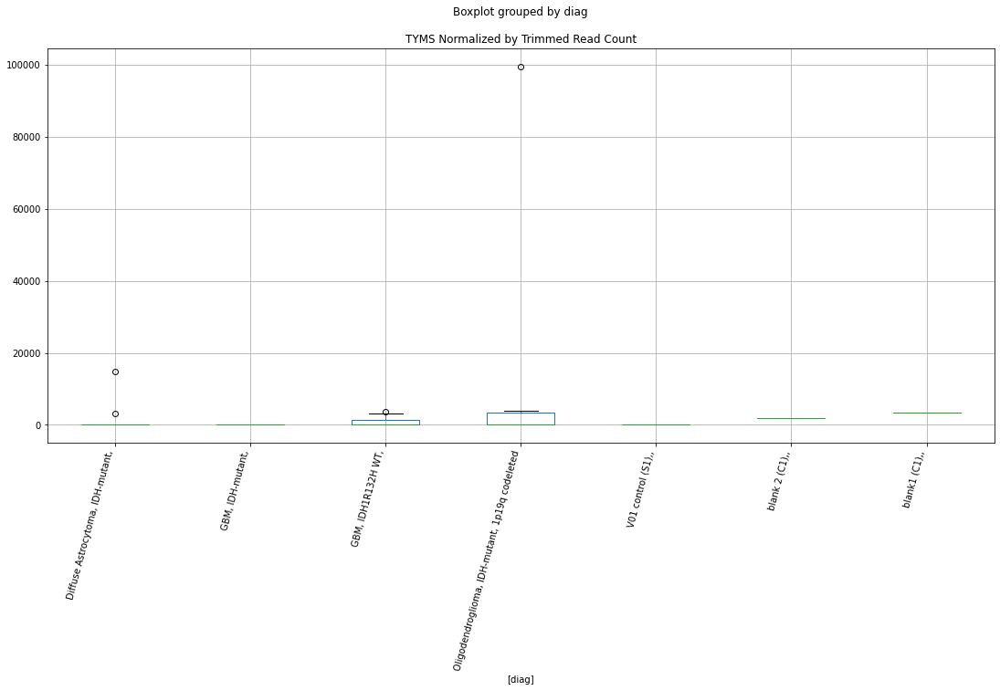

 p : 0.04712285444789841  ( t : 2.1310881556603336 ) :  D-plex  :  bbduk2  :  TENM4
Control and blanks
73     773.01
337      0.00
Name: TENM4, dtype: float64
205    10387.28
Name: TENM4, dtype: float64
469    17745.82
Name: TENM4, dtype: float64


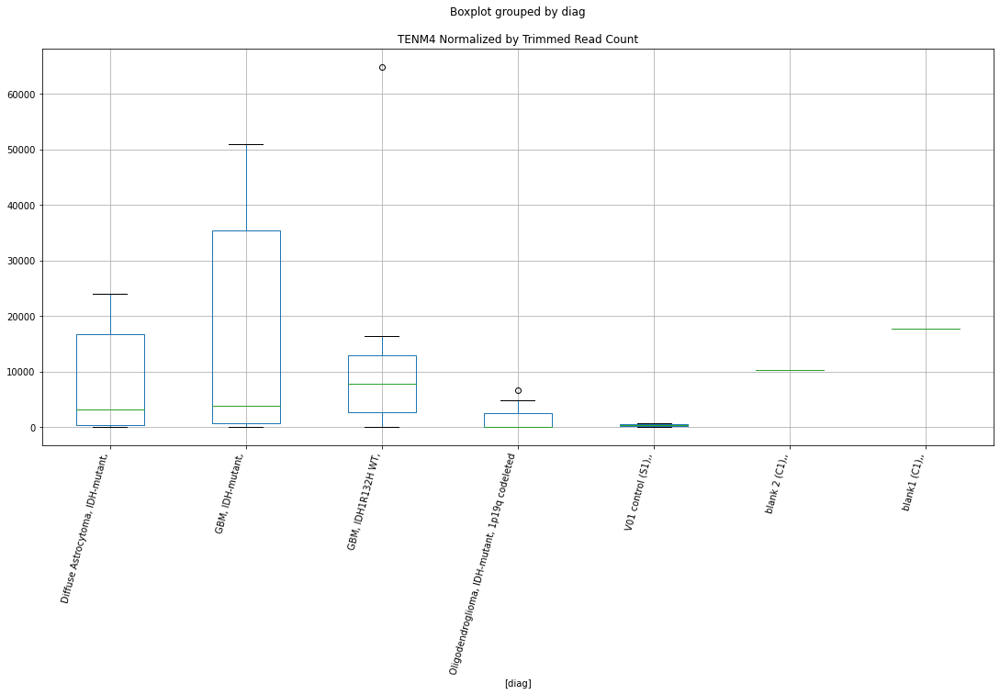

 p : 0.04717307748898311  ( t : 2.1305473572396365 ) :  D-plex  :  bbduk2  :  TPR
Control and blanks
73     4638.05
337     890.16
Name: TPR, dtype: float64
205    5551.82
Name: TPR, dtype: float64
469    7098.33
Name: TPR, dtype: float64


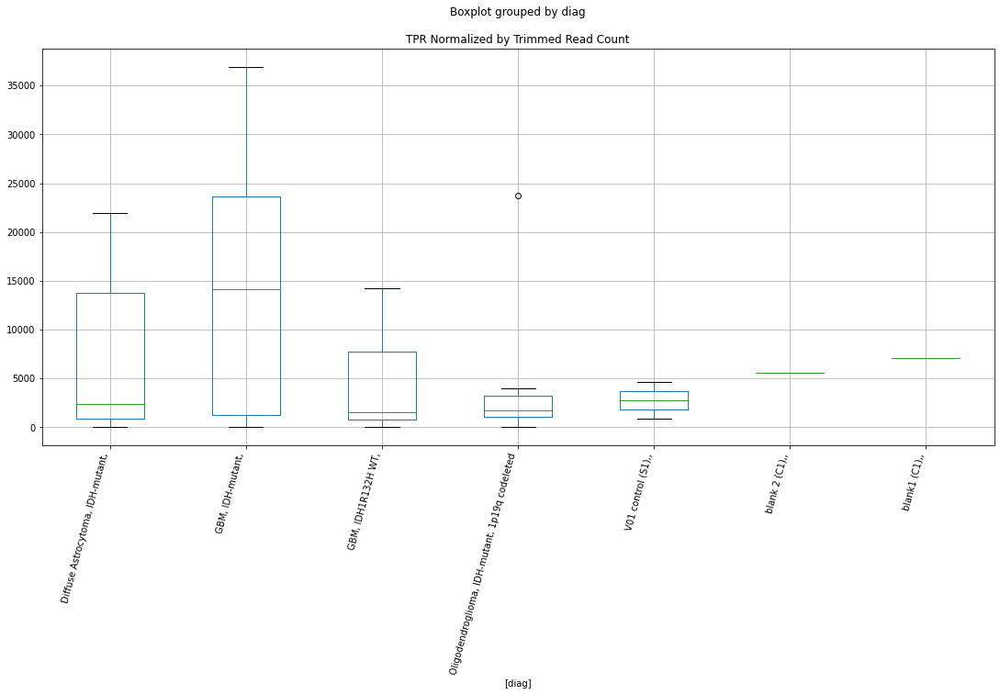

 p : 0.047176085231550556  ( t : 2.130514986729516 ) :  D-plex  :  cutadapt2  :  TBX21
Control and blanks
76     65912.44
340        0.00
Name: TBX21, dtype: float64
208    1234.52
Name: TBX21, dtype: float64
472    3467.74
Name: TBX21, dtype: float64


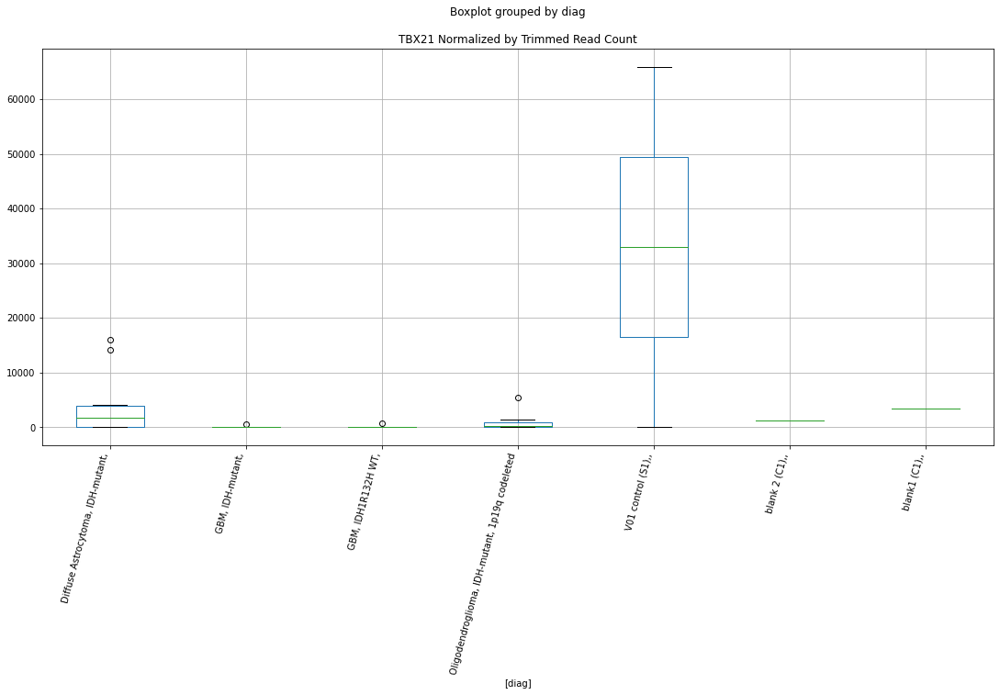

 p : 0.04728120217617178  ( t : 2.1293848572176373 ) :  Lexogen  :  cutadapt2  :  TPBG
Control and blanks
82     0.0
346    0.0
Name: TPBG, dtype: float64
214    0.0
Name: TPBG, dtype: float64
478    0.0
Name: TPBG, dtype: float64


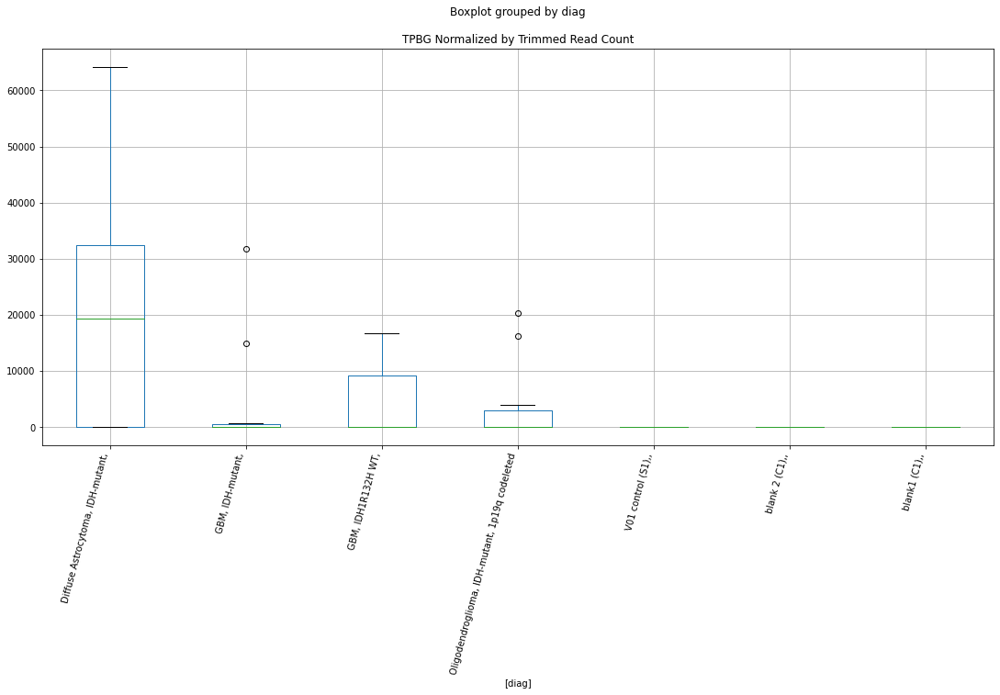

 p : 0.047289190930014685  ( t : 2.1292990625090256 ) :  D-plex  :  bbduk2  :  ZNF106
Control and blanks
73     6184.07
337    7121.26
Name: ZNF106, dtype: float64
205    11640.91
Name: ZNF106, dtype: float64
469    34900.11
Name: ZNF106, dtype: float64


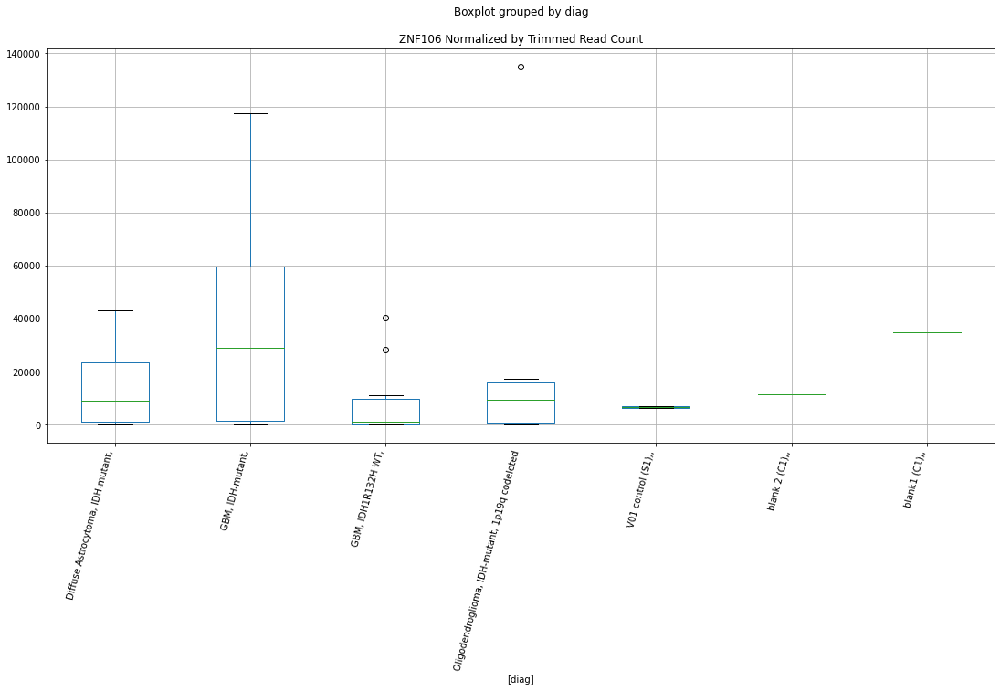

 p : 0.0472965276708017  ( t : 2.129220281692421 ) :  D-plex  :  bbduk2  :  TNKS
Control and blanks
73     2319.03
337       0.00
Name: TNKS, dtype: float64
205    13969.09
Name: TNKS, dtype: float64
469    585020.52
Name: TNKS, dtype: float64


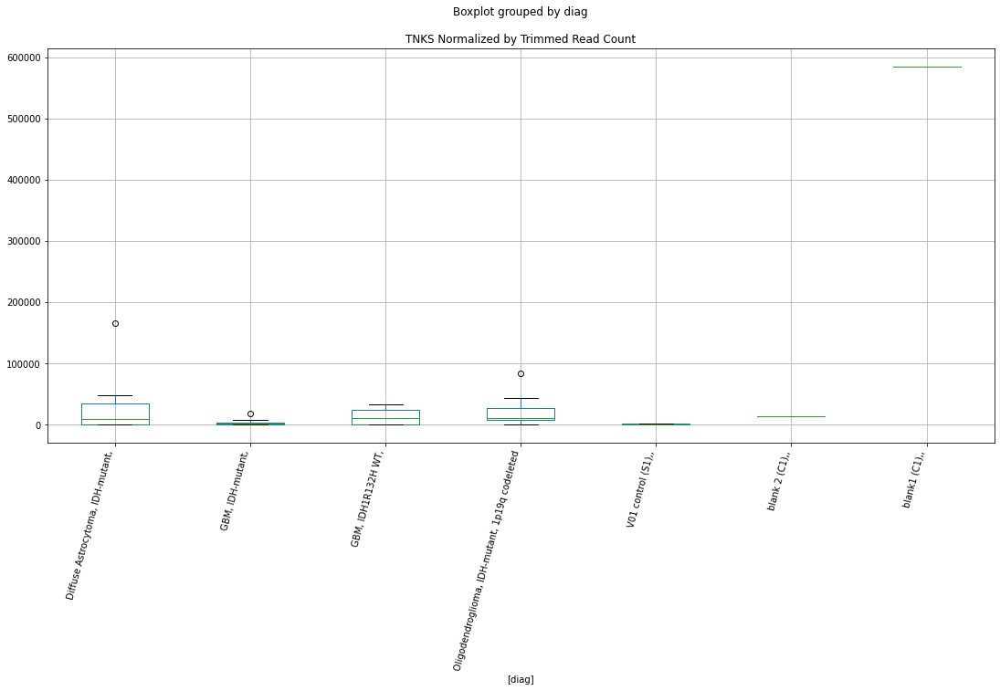

 p : 0.047322703421177024  ( t : 2.128939301187634 ) :  D-plex  :  cutadapt2  :  TOP3B
Control and blanks
76     0.0
340    0.0
Name: TOP3B, dtype: float64
208    5819.89
Name: TOP3B, dtype: float64
472    5779.56
Name: TOP3B, dtype: float64


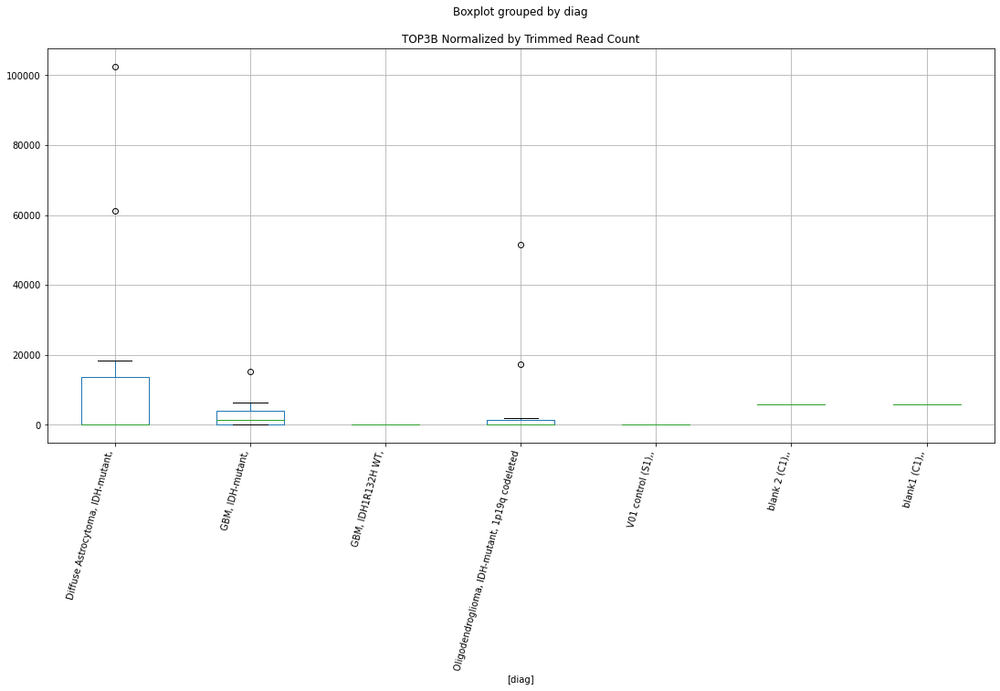

 p : 0.04738517660345532  ( t : 2.1282692624027324 ) :  D-plex  :  cutadapt2  :  TAF2
Control and blanks
76     0.0
340    0.0
Name: TAF2, dtype: float64
208    2292.68
Name: TAF2, dtype: float64
472    16760.72
Name: TAF2, dtype: float64


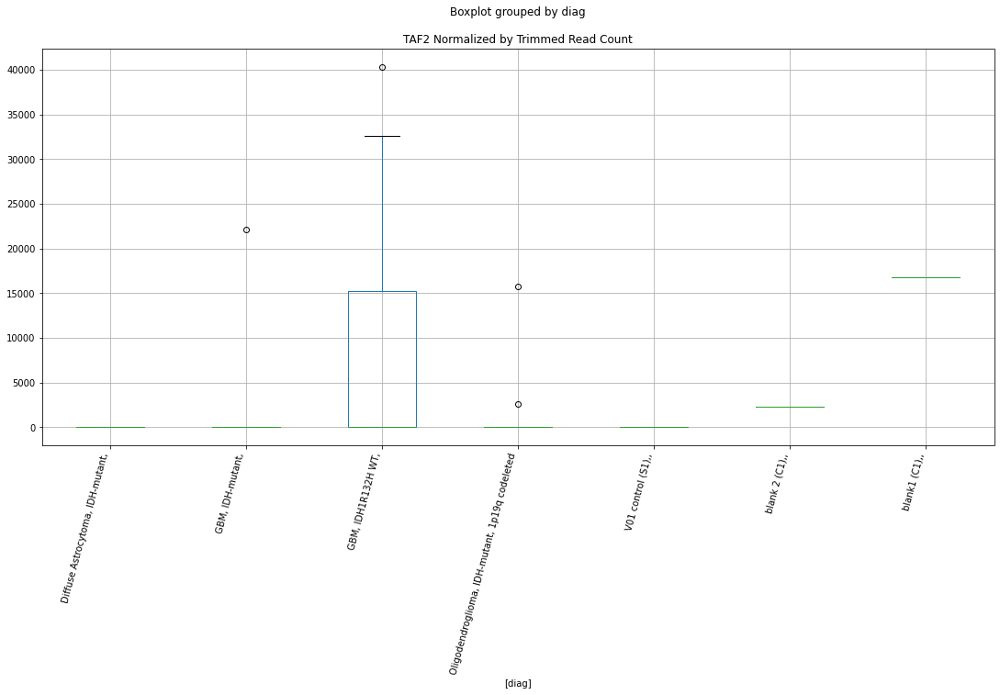

 p : 0.04740819981642396  ( t : 2.1280225363862253 ) :  D-plex  :  bbduk2  :  TBX2
Control and blanks
73     0.0
337    0.0
Name: TBX2, dtype: float64
205    1074.55
Name: TBX2, dtype: float64
469    2366.11
Name: TBX2, dtype: float64


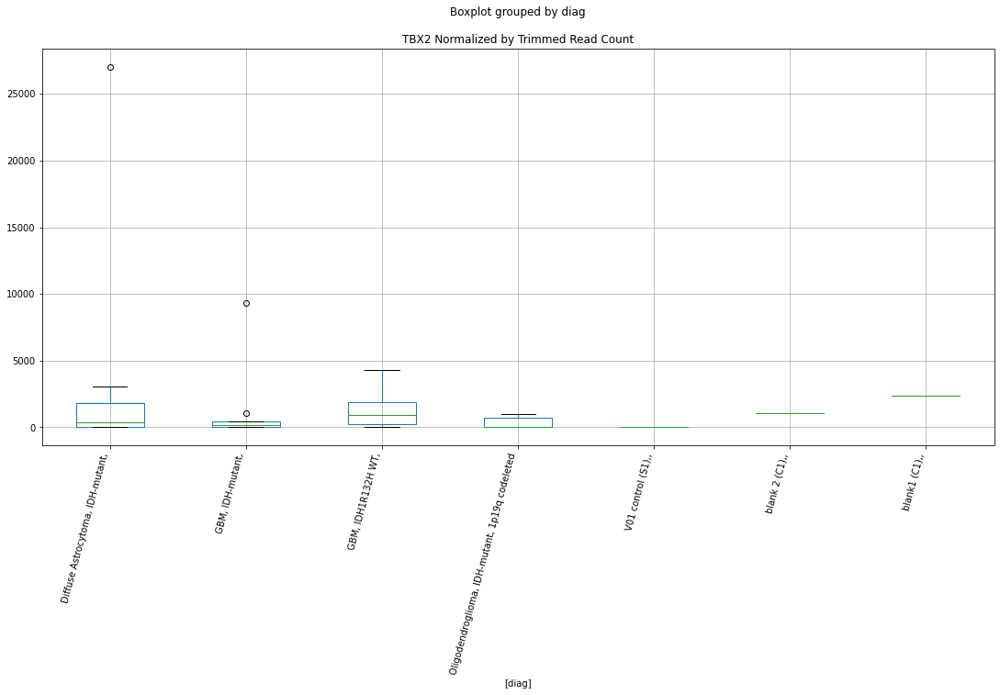

 p : 0.047424750346086945  ( t : 2.127845241722376 ) :  Lexogen  :  bbduk2  :  TIGD5
Control and blanks
79     0.0
343    0.0
Name: TIGD5, dtype: float64
211    0.0
Name: TIGD5, dtype: float64
475    17245.13
Name: TIGD5, dtype: float64


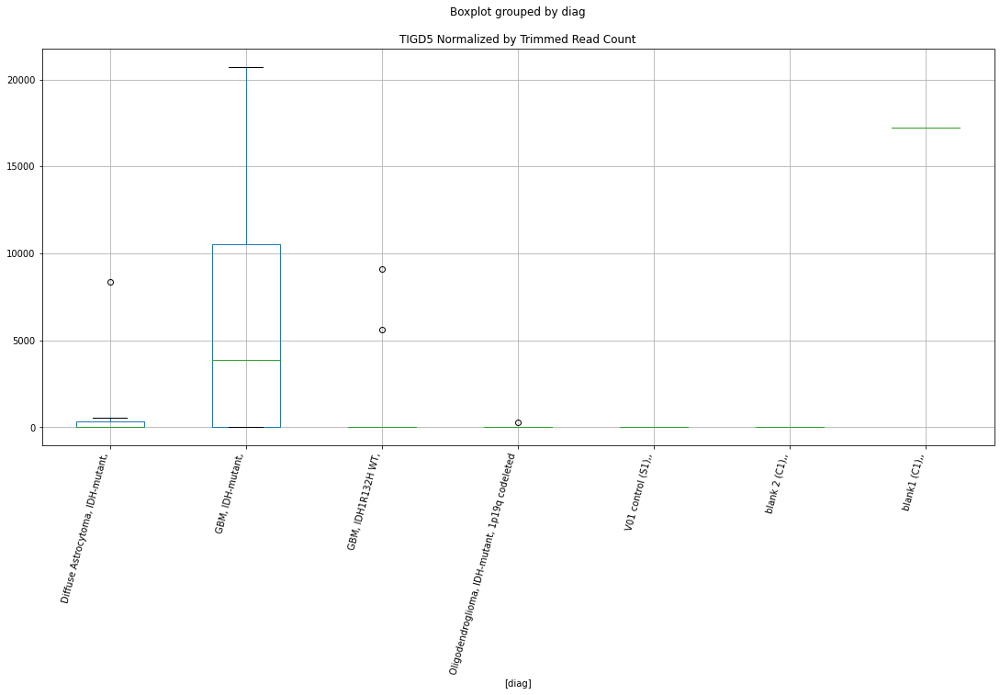

 p : 0.04742507951978403  ( t : 2.127841716078618 ) :  Lexogen  :  cutadapt2  :  TRIM28
Control and blanks
82         0.00
346    28198.23
Name: TRIM28, dtype: float64
214    0.0
Name: TRIM28, dtype: float64
478    0.0
Name: TRIM28, dtype: float64


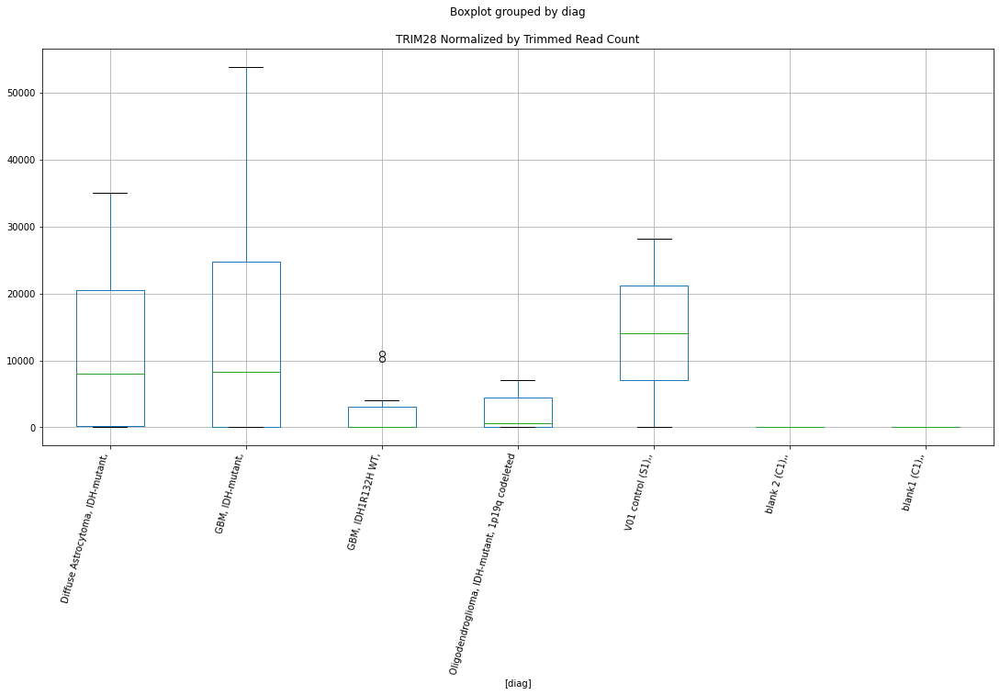

 p : 0.04742636969544317  ( t : 2.127827897754099 ) :  D-plex  :  cutadapt2  :  ZBTB7B
Control and blanks
76     0.0
340    0.0
Name: ZBTB7B, dtype: float64
208    2645.4
Name: ZBTB7B, dtype: float64
472    8669.34
Name: ZBTB7B, dtype: float64


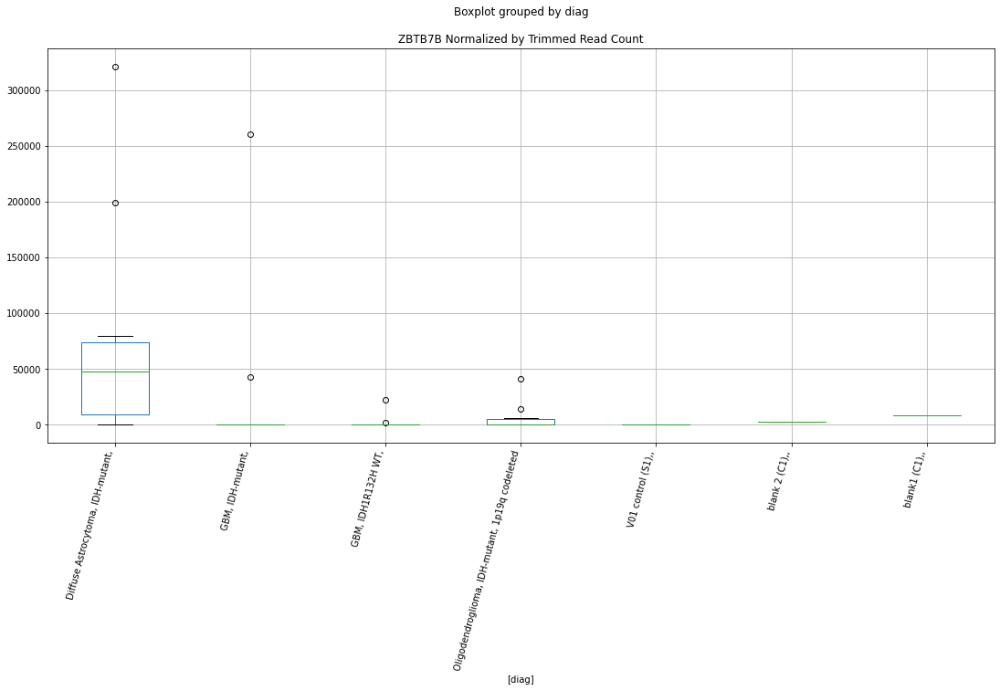

 p : 0.04742914095746604  ( t : 2.1277982175295325 ) :  D-plex  :  bbduk2  :  TNFSF14
Control and blanks
73     40196.44
337     3560.63
Name: TNFSF14, dtype: float64
205    24893.64
Name: TNFSF14, dtype: float64
469    28393.31
Name: TNFSF14, dtype: float64


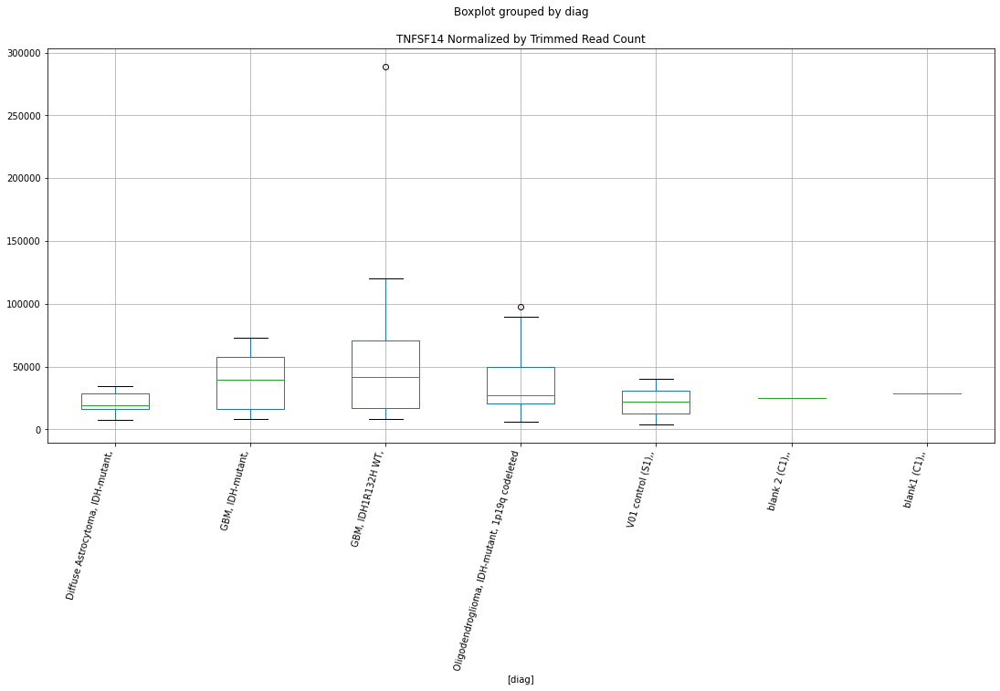

 p : 0.04743986780685469  ( t : 2.1276833478407156 ) :  D-plex  :  cutadapt2  :  ZNF516
Control and blanks
76        0.00
340    9688.05
Name: ZNF516, dtype: float64
208    28923.08
Name: ZNF516, dtype: float64
472    26008.01
Name: ZNF516, dtype: float64


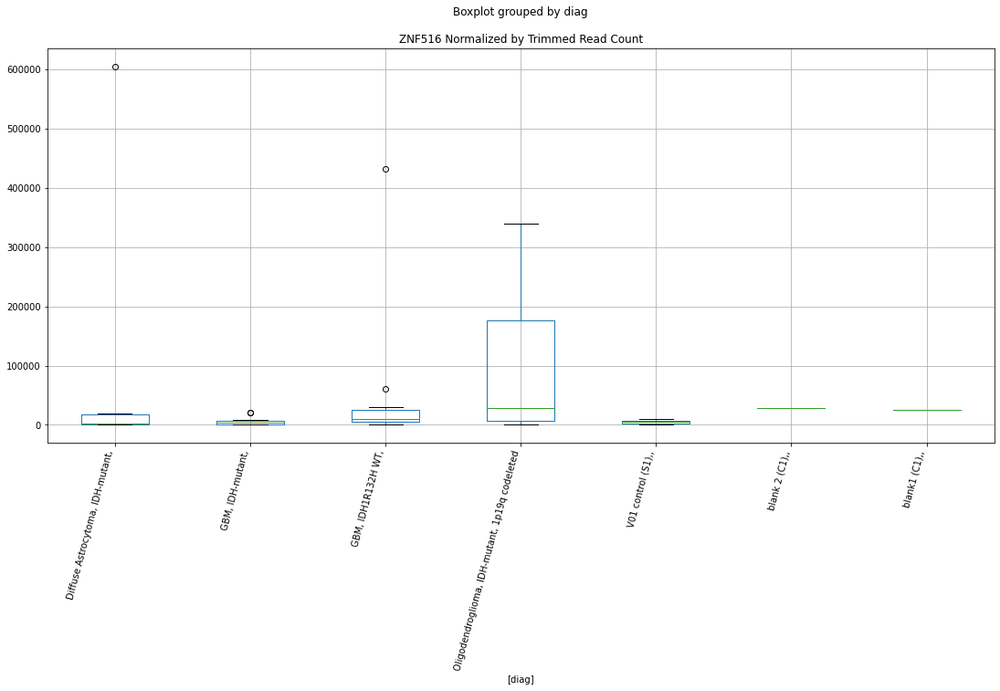

 p : 0.04743989072268642  ( t : 2.127683102469266 ) :  Lexogen  :  bbduk2  :  TTC7A
Control and blanks
79     0.0
343    0.0
Name: TTC7A, dtype: float64
211    0.0
Name: TTC7A, dtype: float64
475    0.0
Name: TTC7A, dtype: float64


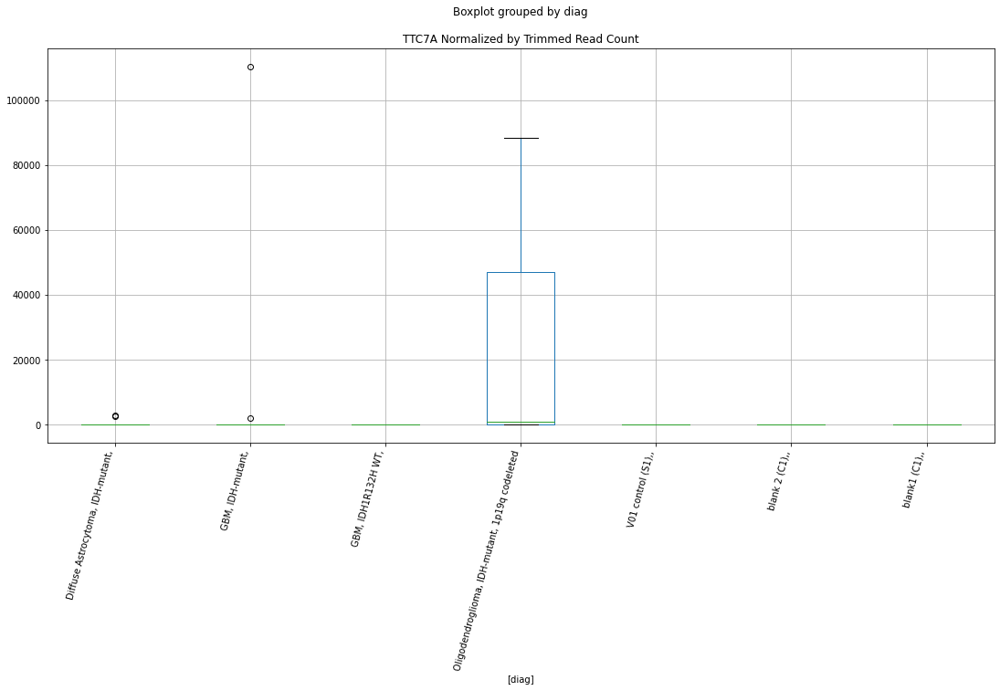

 p : 0.04750717292026846  ( t : 2.126963143230193 ) :  D-plex  :  bbduk2  :  WDR90
Control and blanks
73      6957.08
337    43617.71
Name: WDR90, dtype: float64
205    42265.46
Name: WDR90, dtype: float64
469    56786.62
Name: WDR90, dtype: float64


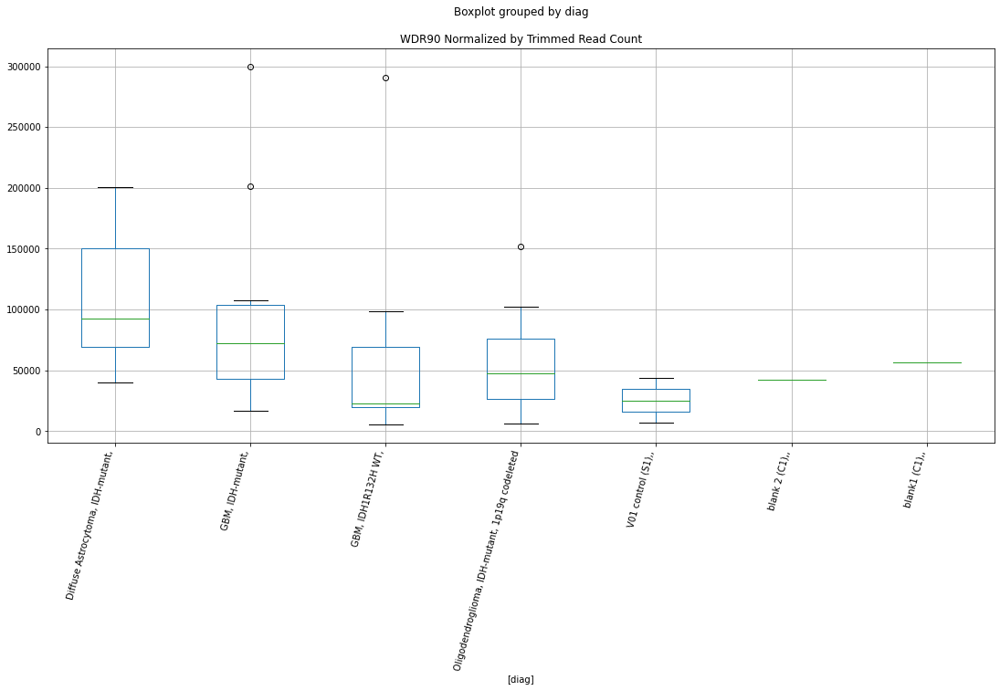

 p : 0.04753682096603285  ( t : 2.1266461866031388 ) :  Lexogen  :  bbduk2  :  ZNF503
Control and blanks
79     0.0
343    0.0
Name: ZNF503, dtype: float64
211    0.0
Name: ZNF503, dtype: float64
475    239.52
Name: ZNF503, dtype: float64


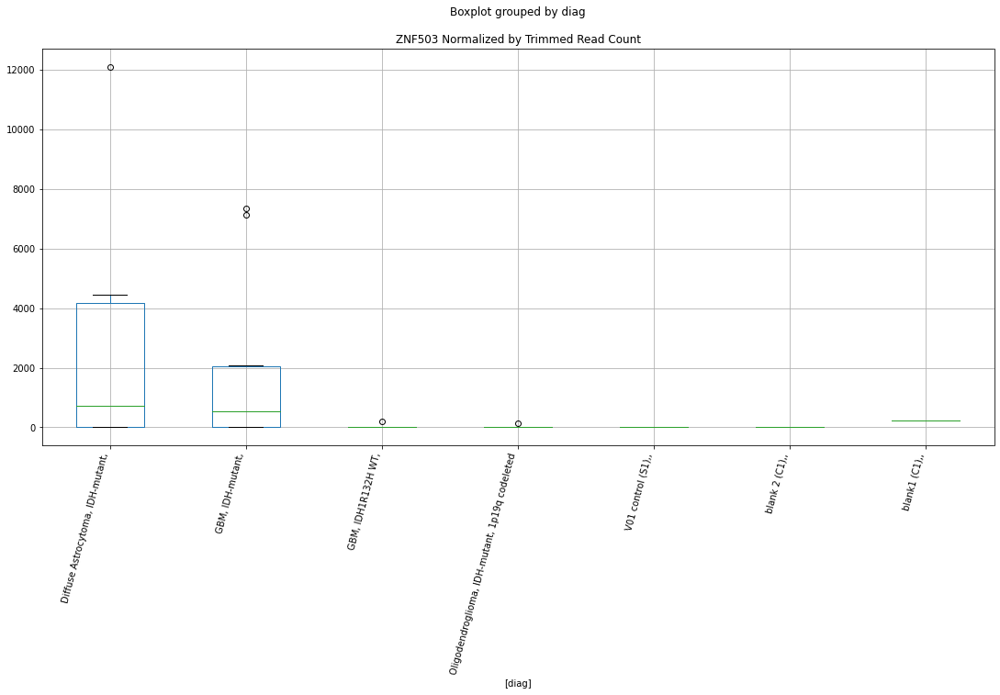

 p : 0.04764826025701002  ( t : 2.1254564382542553 ) :  D-plex  :  cutadapt2  :  SRGAP2
Control and blanks
76     0.0
340    0.0
Name: SRGAP2, dtype: float64
208    13756.1
Name: SRGAP2, dtype: float64
472    25430.06
Name: SRGAP2, dtype: float64


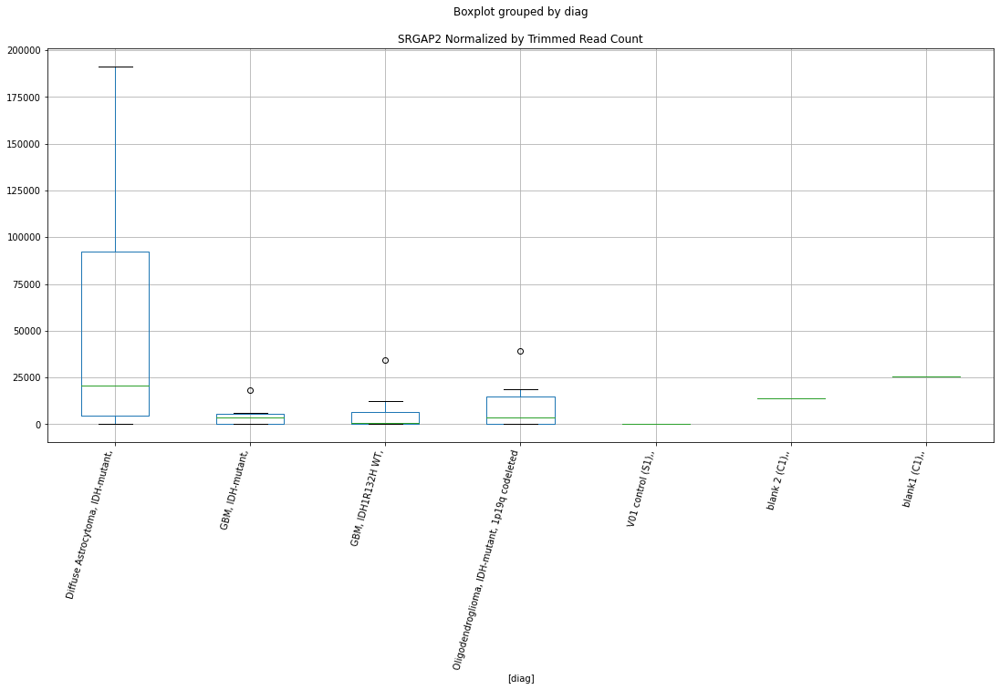

 p : 0.04765182511678865  ( t : 2.1254184209679057 ) :  Lexogen  :  cutadapt2  :  TMEM178A
Control and blanks
82     0.0
346    0.0
Name: TMEM178A, dtype: float64
214    271.23
Name: TMEM178A, dtype: float64
478    0.0
Name: TMEM178A, dtype: float64


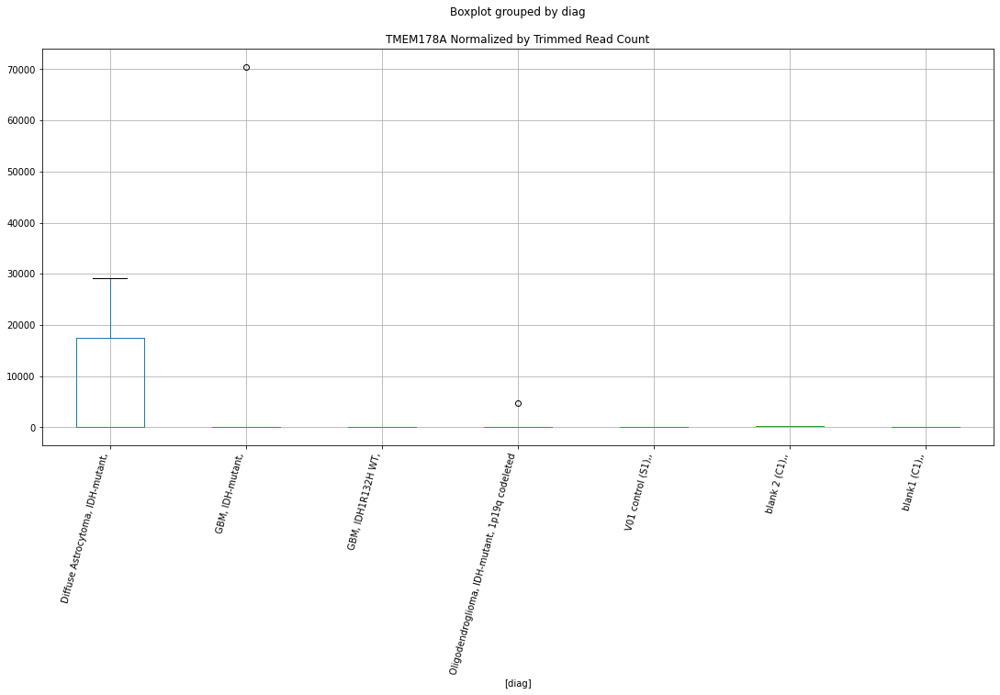

 p : 0.047665289132385186  ( t : 2.125274857958289 ) :  Lexogen  :  cutadapt2  :  TIGD5
Control and blanks
82     0.0
346    0.0
Name: TIGD5, dtype: float64
214    0.0
Name: TIGD5, dtype: float64
478    17097.15
Name: TIGD5, dtype: float64


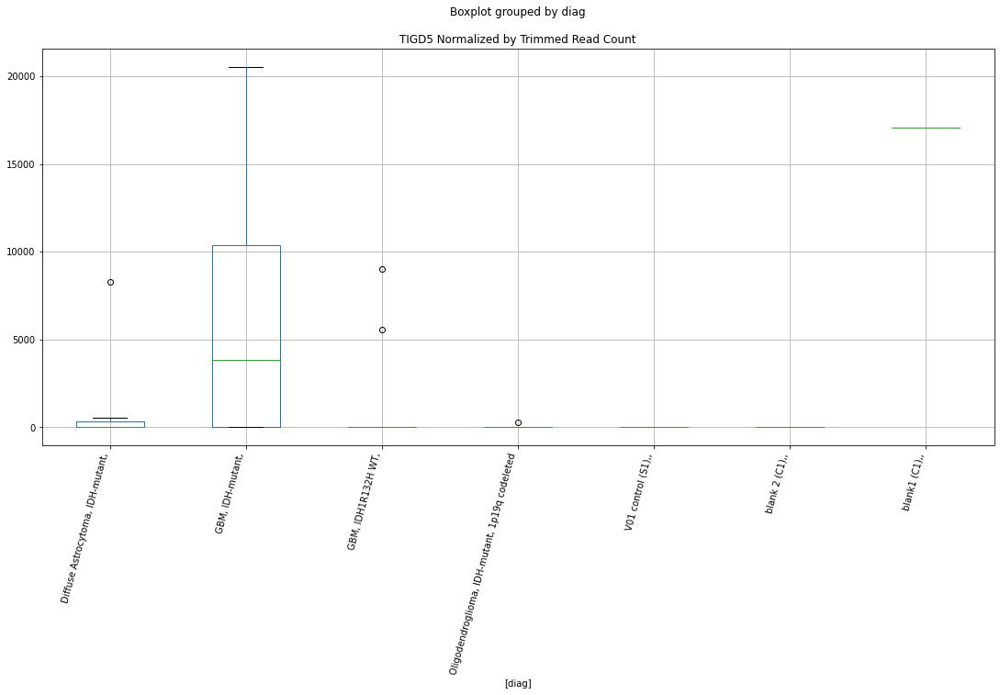

 p : 0.047747496068087314  ( t : 2.124399109355075 ) :  D-plex  :  bbduk2  :  WNK3
Control and blanks
73     556566.05
337         0.00
Name: WNK3, dtype: float64
205    3402.73
Name: WNK3, dtype: float64
469    15971.24
Name: WNK3, dtype: float64


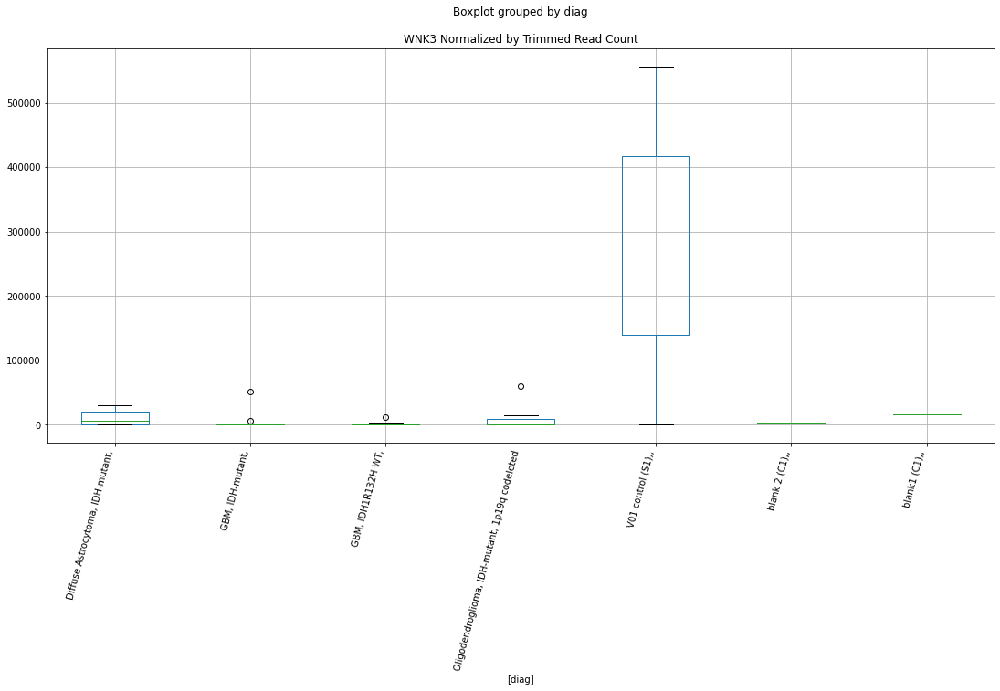

 p : 0.04781421806171716  ( t : 2.1236893310307963 ) :  D-plex  :  bbduk2  :  VOPP1
Control and blanks
73         0.00
337    21363.77
Name: VOPP1, dtype: float64
205    15760.0
Name: VOPP1, dtype: float64
469    20111.93
Name: VOPP1, dtype: float64


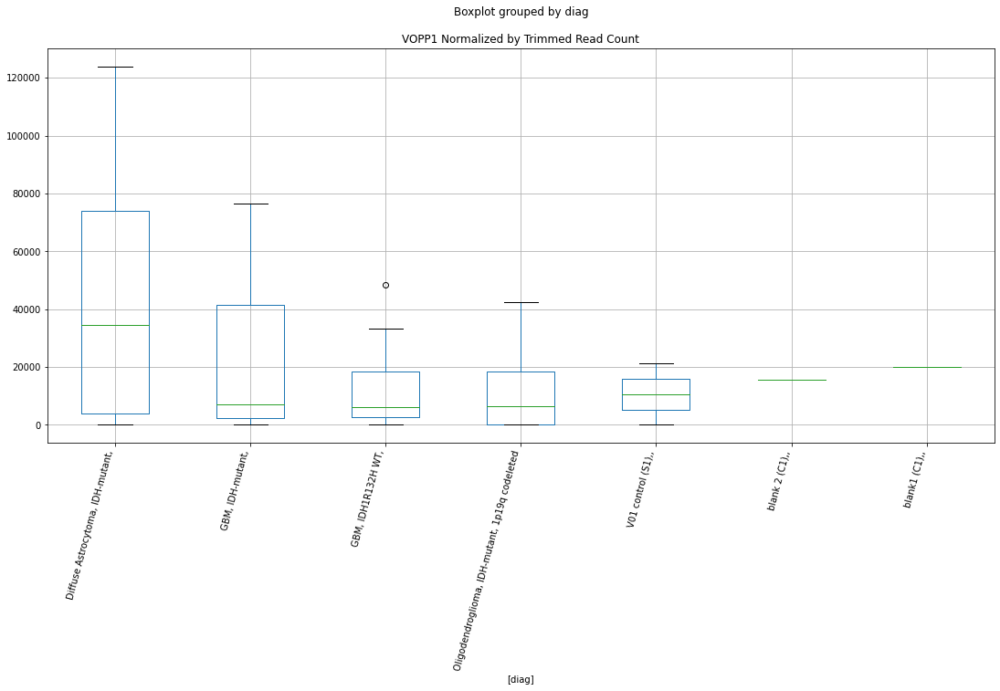

 p : 0.0478353376236179  ( t : 2.1234648524134956 ) :  Lexogen  :  cutadapt2  :  SRGAP1
Control and blanks
82         0.00
346    26935.62
Name: SRGAP1, dtype: float64
214    0.0
Name: SRGAP1, dtype: float64
478    0.0
Name: SRGAP1, dtype: float64


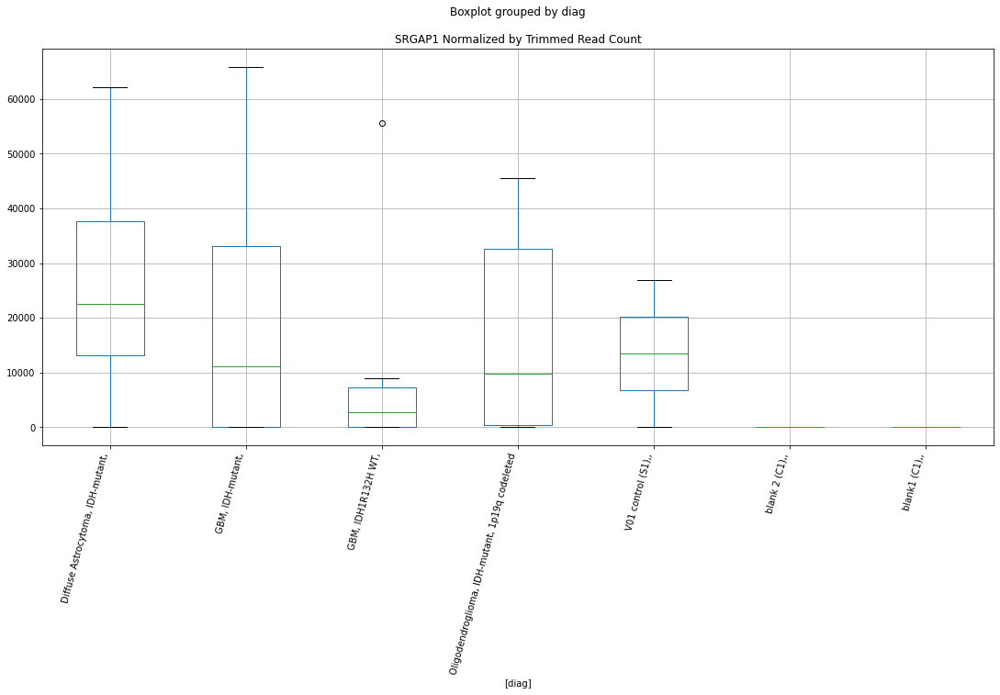

 p : 0.04785025640613123  ( t : 2.123306335945236 ) :  Lexogen  :  cutadapt2  :  TUBA8
Control and blanks
82       0.00
346    420.87
Name: TUBA8, dtype: float64
214    0.0
Name: TUBA8, dtype: float64
478    0.0
Name: TUBA8, dtype: float64


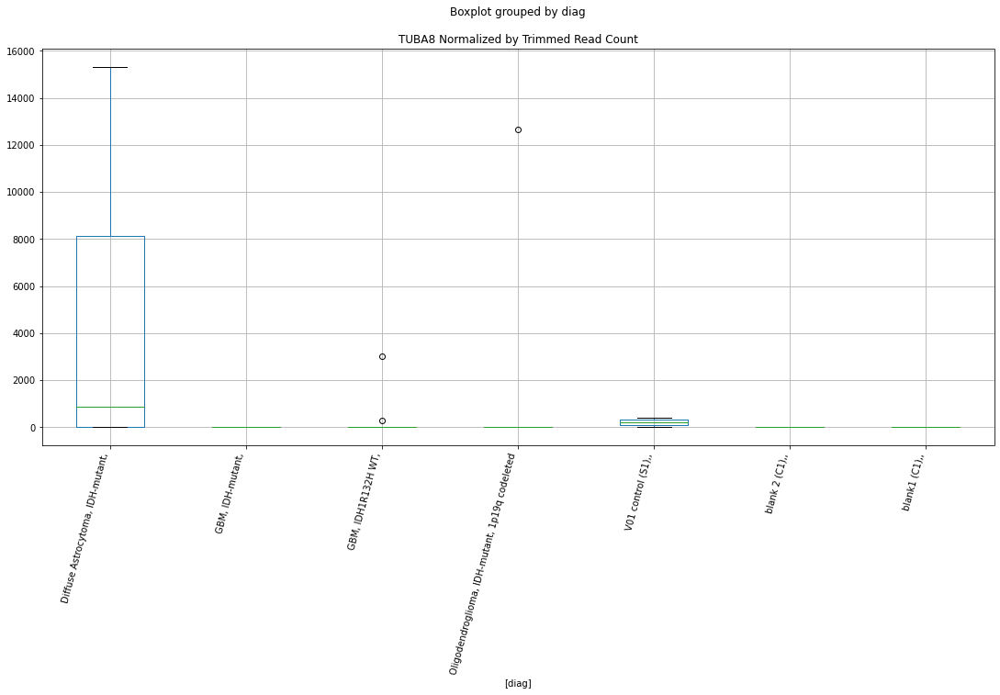

 p : 0.04789132859075541  ( t : 2.1228701643788455 ) :  D-plex  :  bbduk2  :  USP12
Control and blanks
73         0.00
337    53409.44
Name: USP12, dtype: float64
205    2865.46
Name: USP12, dtype: float64
469    2366.11
Name: USP12, dtype: float64


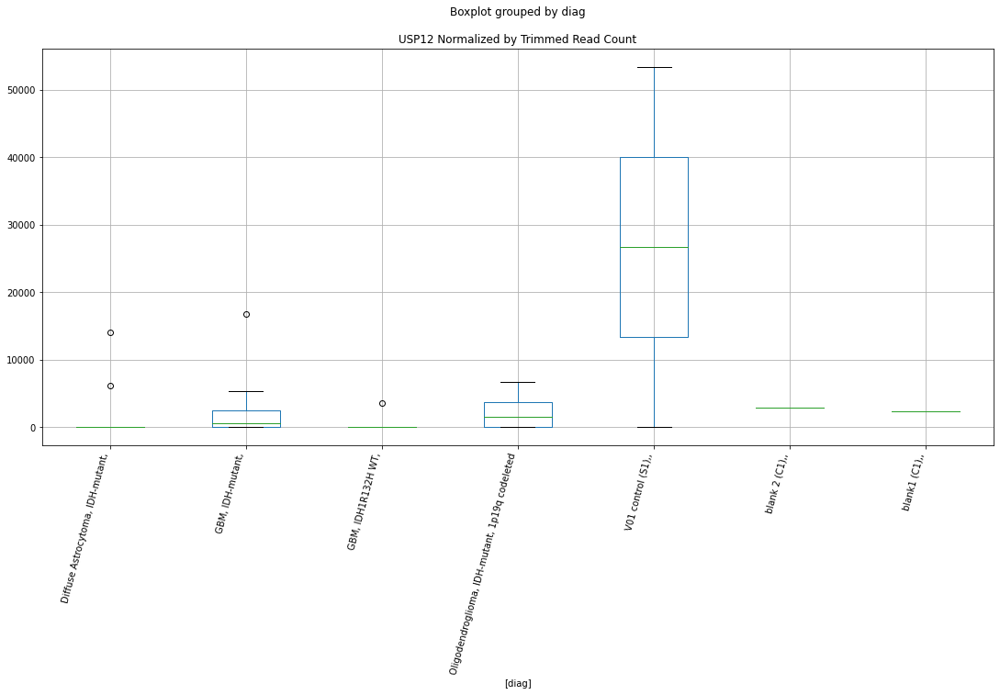

 p : 0.047962157637448044  ( t : 2.1221187858240995 ) :  Lexogen  :  bbduk2  :  SRGAP1
Control and blanks
79         0.00
343    27176.23
Name: SRGAP1, dtype: float64
211    0.0
Name: SRGAP1, dtype: float64
475    0.0
Name: SRGAP1, dtype: float64


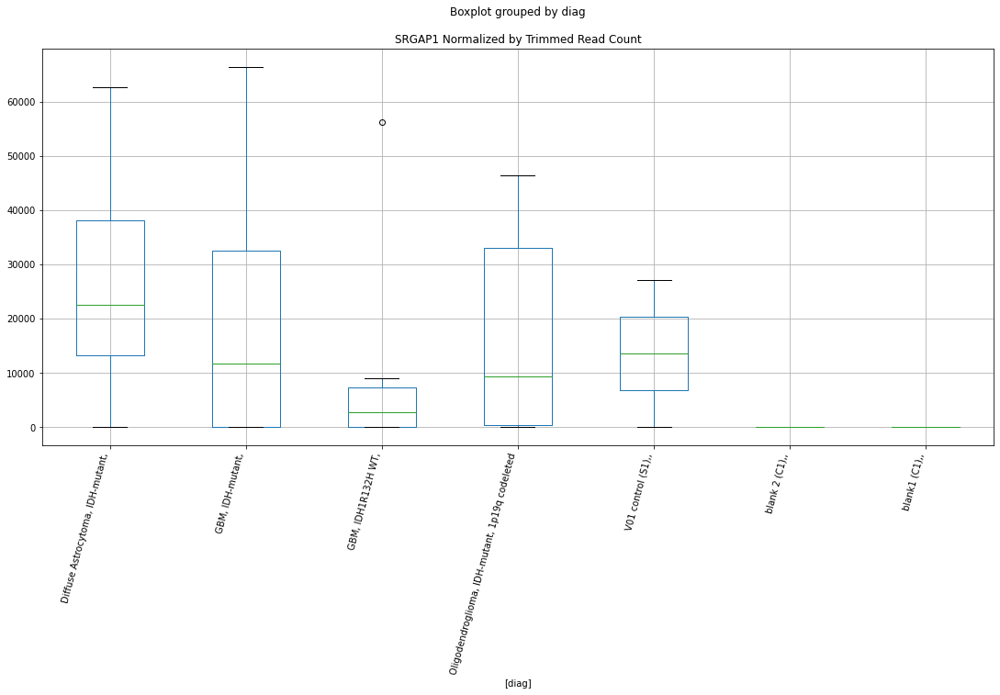

 p : 0.04805158001293877  ( t : 2.121171605357223 ) :  Lexogen  :  bbduk2  :  ZNF503
Control and blanks
79     0.0
343    0.0
Name: ZNF503, dtype: float64
211    0.0
Name: ZNF503, dtype: float64
475    239.52
Name: ZNF503, dtype: float64


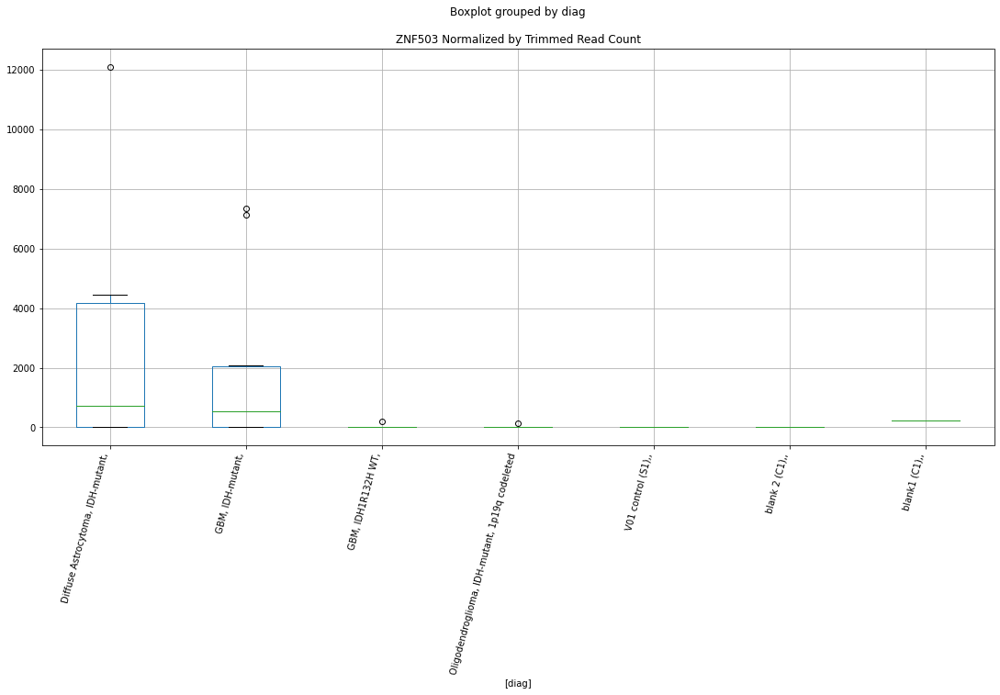

 p : 0.048063303225796015  ( t : 2.121047549714274 ) :  D-plex  :  cutadapt2  :  TBX21
Control and blanks
76     65912.44
340        0.00
Name: TBX21, dtype: float64
208    1234.52
Name: TBX21, dtype: float64
472    3467.74
Name: TBX21, dtype: float64


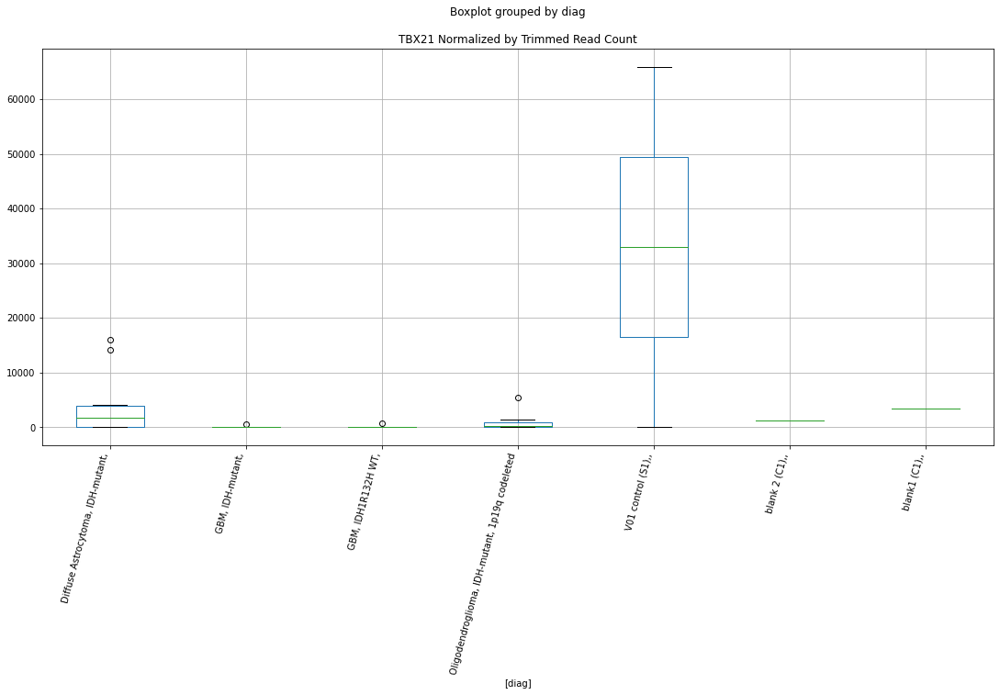

 p : 0.04809911468086514  ( t : 2.1206687616768445 ) :  D-plex  :  cutadapt2  :  TTC4
Control and blanks
76     0.0
340    0.0
Name: TTC4, dtype: float64
208    0.0
Name: TTC4, dtype: float64
472    0.0
Name: TTC4, dtype: float64


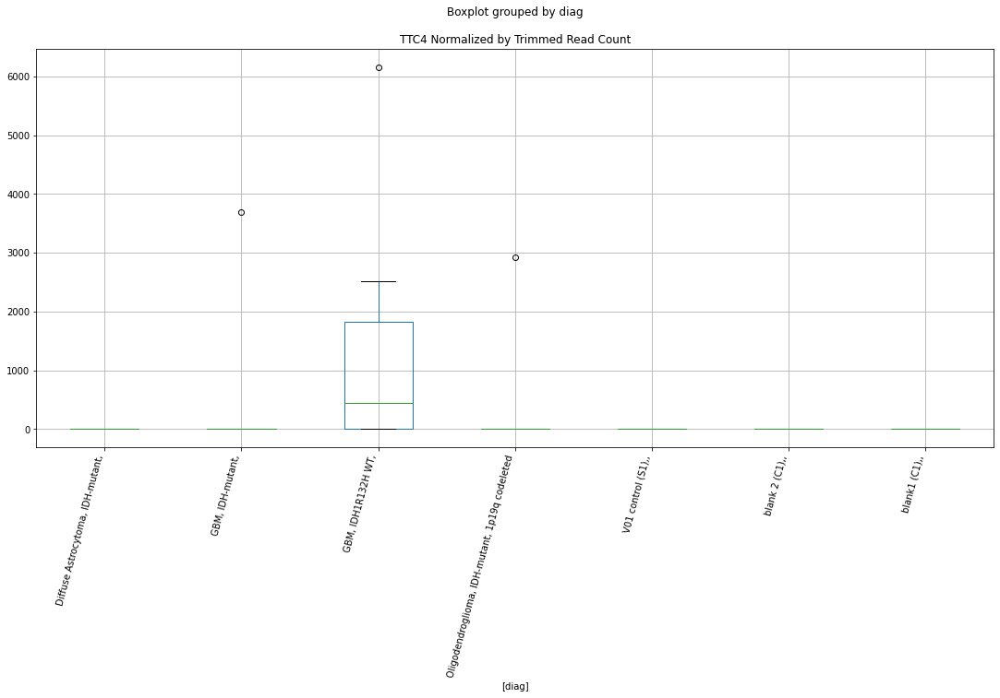

 p : 0.048099877441876444  ( t : 2.120660696529154 ) :  Lexogen  :  bbduk2  :  SUDS3
Control and blanks
79     0.0
343    0.0
Name: SUDS3, dtype: float64
211    0.0
Name: SUDS3, dtype: float64
475    0.0
Name: SUDS3, dtype: float64


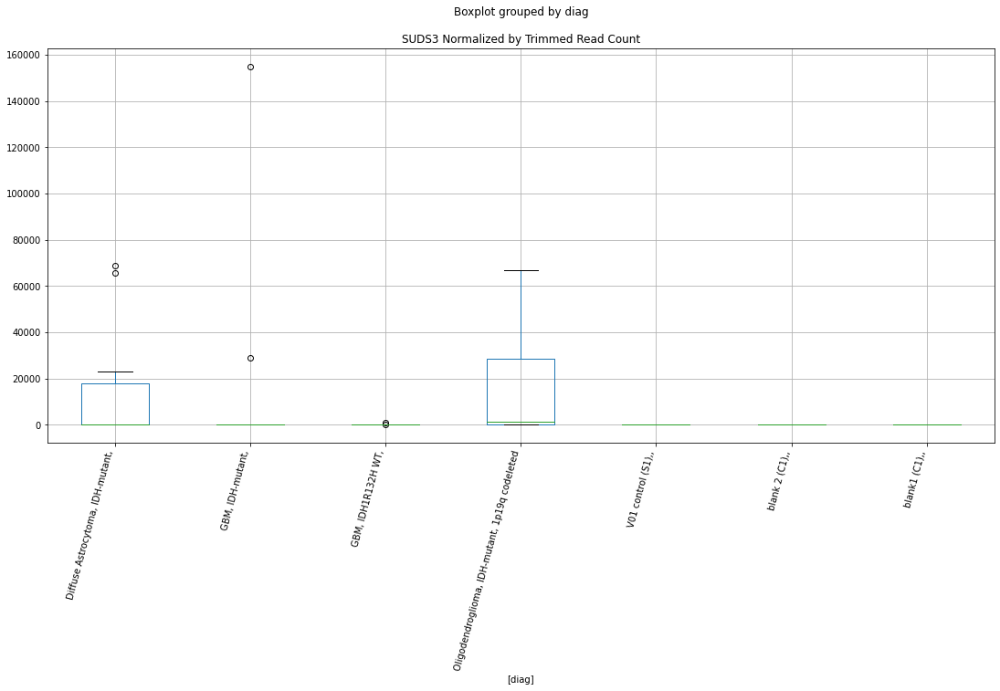

 p : 0.04816539387248819  ( t : 2.1199683848266906 ) :  Lexogen  :  cutadapt2  :  ZNF460
Control and blanks
82         0.00
346    31986.05
Name: ZNF460, dtype: float64
214    25495.29
Name: ZNF460, dtype: float64
478    0.0
Name: ZNF460, dtype: float64


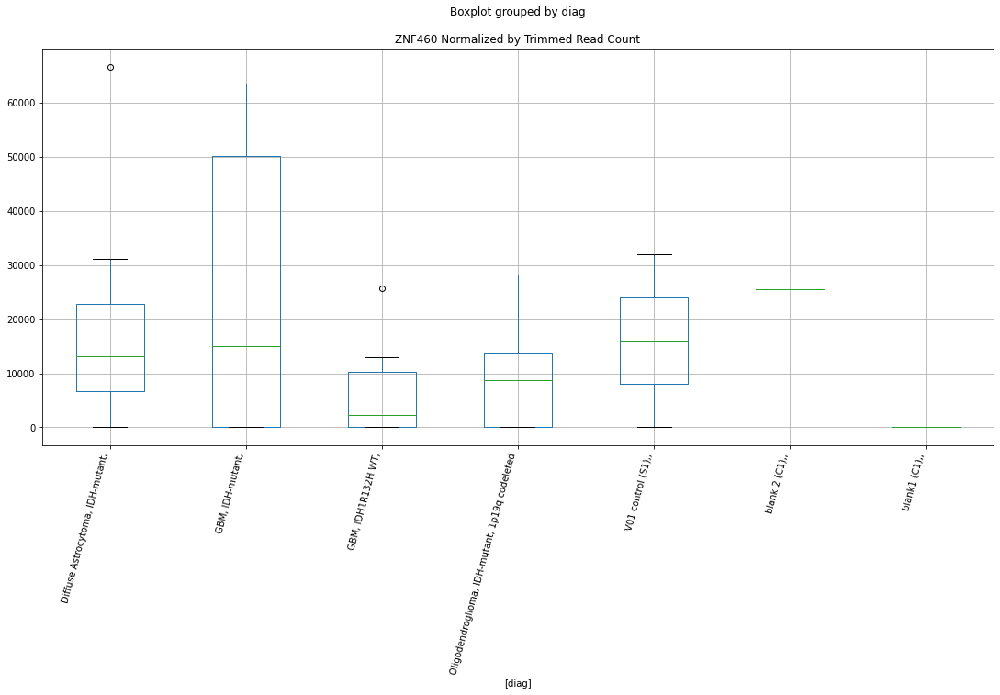

 p : 0.048191283159067136  ( t : 2.1196950493154585 ) :  D-plex  :  cutadapt2  :  TMEM189-UBE2V1
Control and blanks
76     0.0
340    0.0
Name: TMEM189-UBE2V1, dtype: float64
208    176.36
Name: TMEM189-UBE2V1, dtype: float64
472    1155.91
Name: TMEM189-UBE2V1, dtype: float64


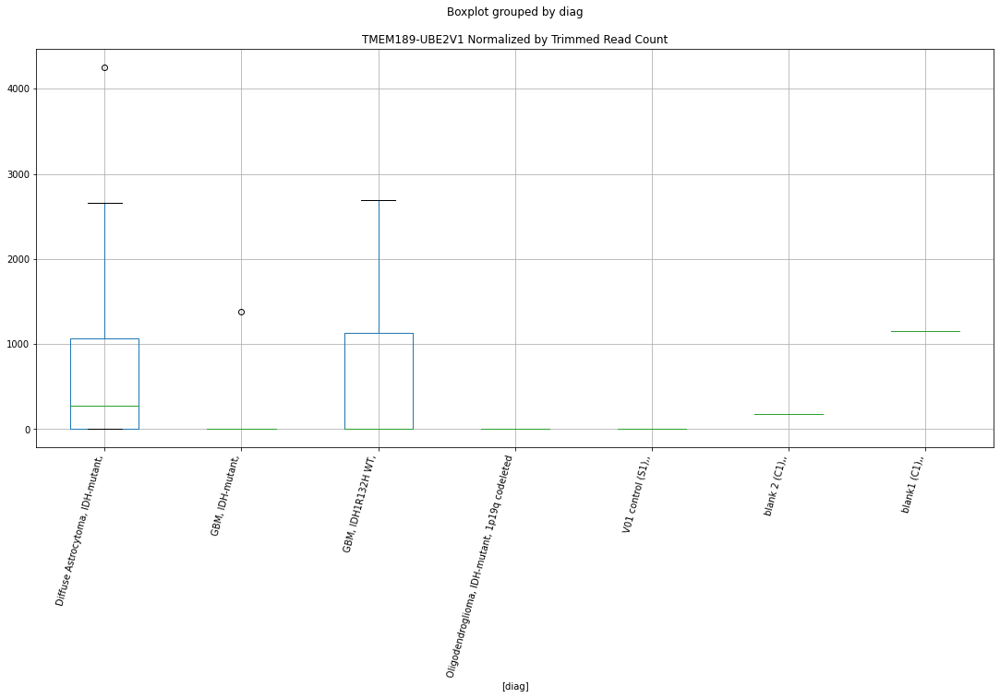

 p : 0.04819638211546357  ( t : 2.119641231003002 ) :  D-plex  :  cutadapt2  :  TSEN2
Control and blanks
76     757.61
340      0.00
Name: TSEN2, dtype: float64
208    5290.81
Name: TSEN2, dtype: float64
472    577.96
Name: TSEN2, dtype: float64


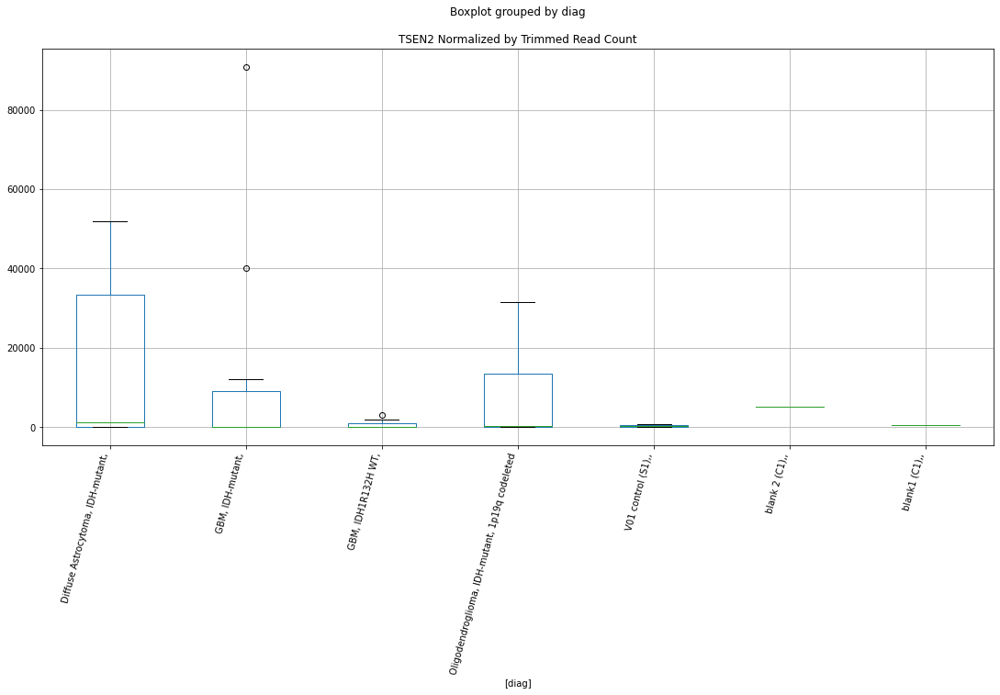

 p : 0.048218233816823046  ( t : 2.119410650034551 ) :  D-plex  :  bbduk2  :  ZER1
Control and blanks
73     9276.1
337       0.0
Name: ZER1, dtype: float64
205    8954.55
Name: ZER1, dtype: float64
469    5915.27
Name: ZER1, dtype: float64


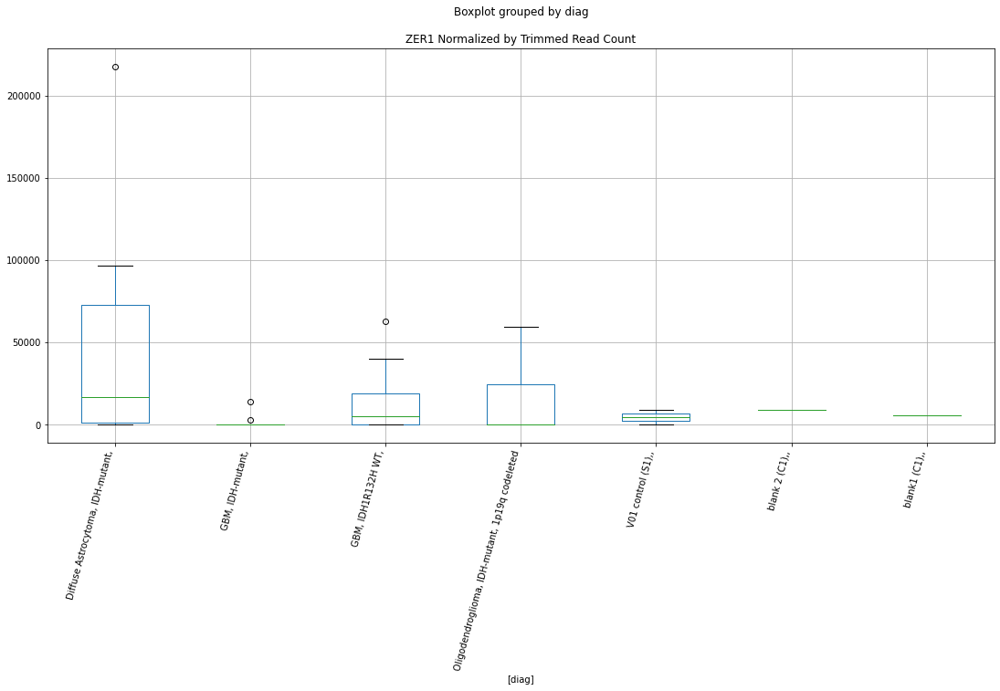

 p : 0.04830198430502251  ( t : 2.1185277883746747 ) :  D-plex  :  cutadapt2  :  ZER1
Control and blanks
76     9091.37
340       0.00
Name: ZER1, dtype: float64
208    10228.89
Name: ZER1, dtype: float64
472    5779.56
Name: ZER1, dtype: float64


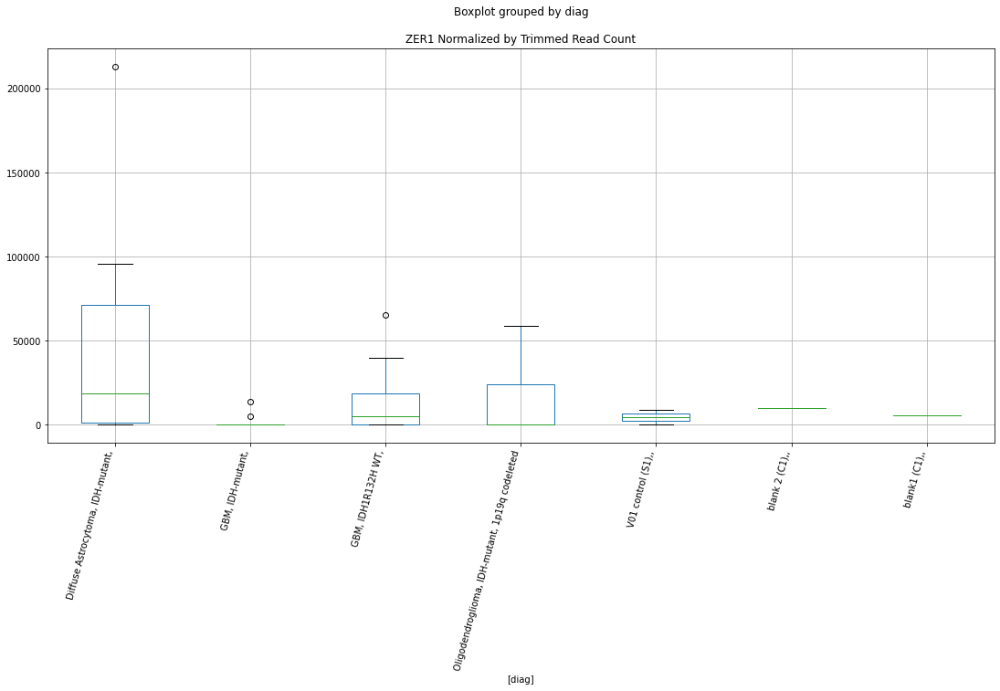

 p : 0.04831378701696742  ( t : 2.118403481350104 ) :  D-plex  :  bbduk2  :  TGIF1
Control and blanks
73     0.0
337    0.0
Name: TGIF1, dtype: float64
205    1790.91
Name: TGIF1, dtype: float64
469    4732.22
Name: TGIF1, dtype: float64


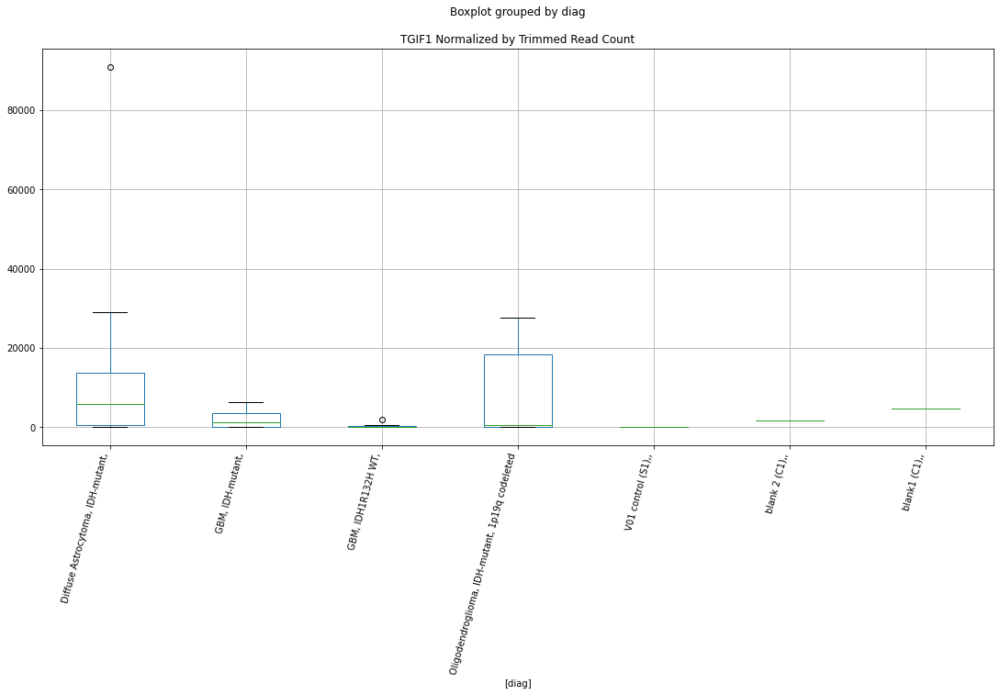

 p : 0.04831564587219879  ( t : 2.118383906271708 ) :  D-plex  :  bbduk2  :  ZNF699
Control and blanks
73     0.0
337    0.0
Name: ZNF699, dtype: float64
205    895.45
Name: ZNF699, dtype: float64
469    1183.05
Name: ZNF699, dtype: float64


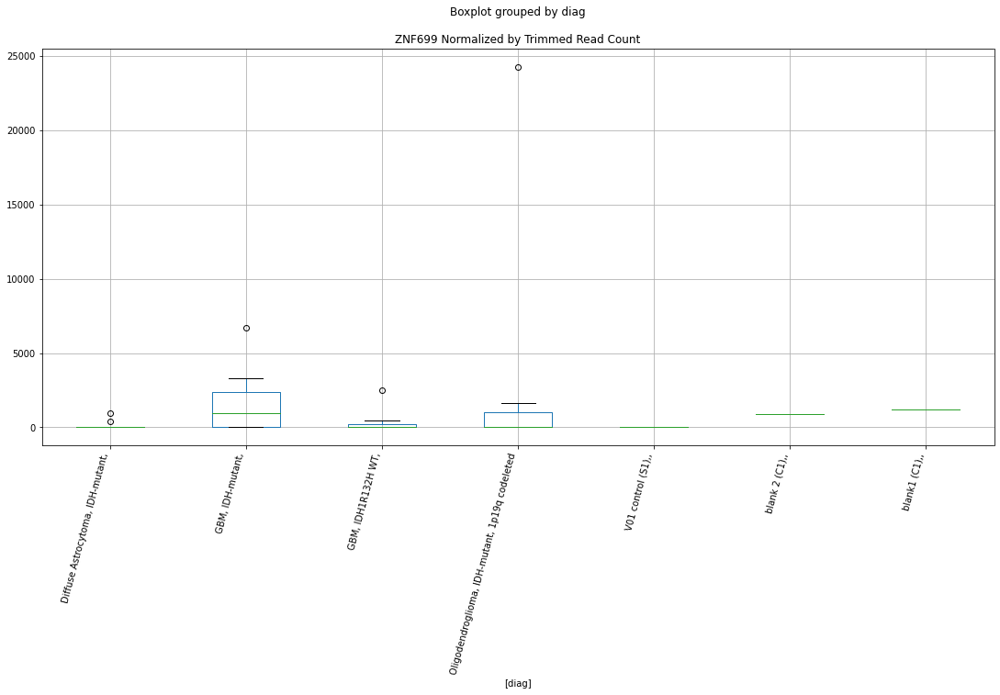

 p : 0.04834232293250565  ( t : 2.1181030532205454 ) :  D-plex  :  cutadapt2  :  TRDN
Control and blanks
76     0.0
340    0.0
Name: TRDN, dtype: float64
208    1939.96
Name: TRDN, dtype: float64
472    2311.82
Name: TRDN, dtype: float64


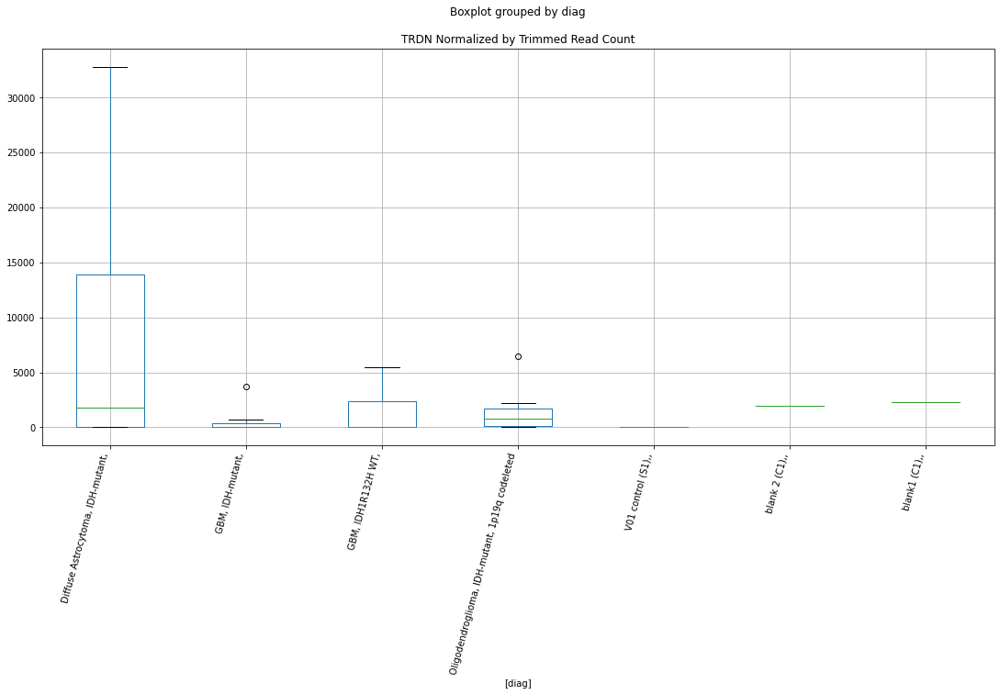

 p : 0.0484242187830919  ( t : 2.1172417438311584 ) :  Lexogen  :  bbduk2  :  ZNF503
Control and blanks
79     0.0
343    0.0
Name: ZNF503, dtype: float64
211    0.0
Name: ZNF503, dtype: float64
475    239.52
Name: ZNF503, dtype: float64


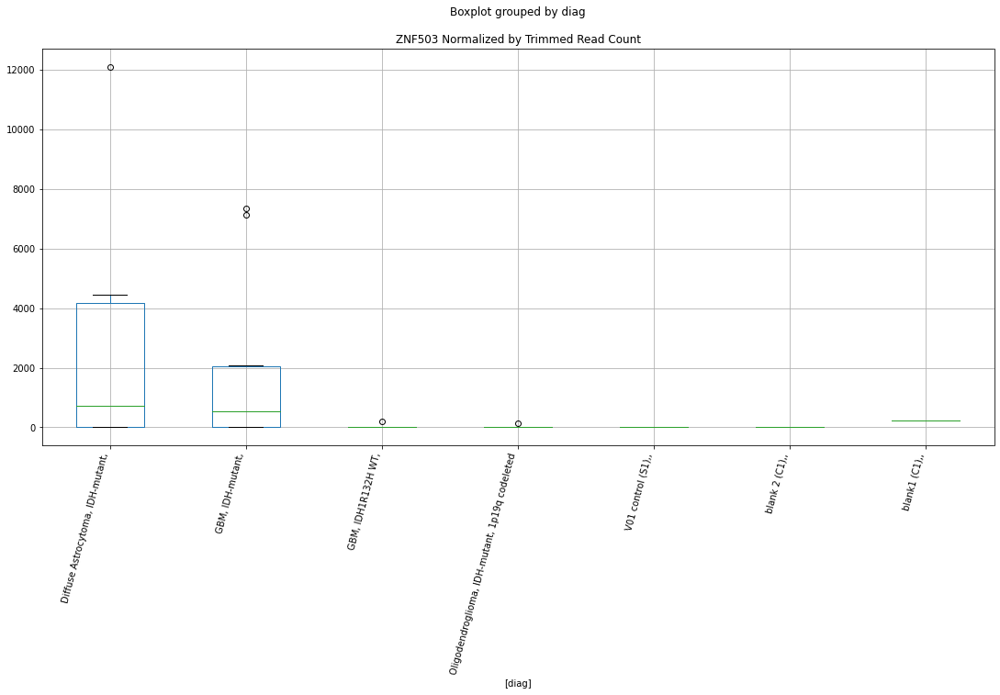

 p : 0.04854777086332405  ( t : 2.115944836980844 ) :  D-plex  :  bbduk2  :  ZMYM5
Control and blanks
73     0.0
337    0.0
Name: ZMYM5, dtype: float64
205    6447.27
Name: ZMYM5, dtype: float64
469    11830.55
Name: ZMYM5, dtype: float64


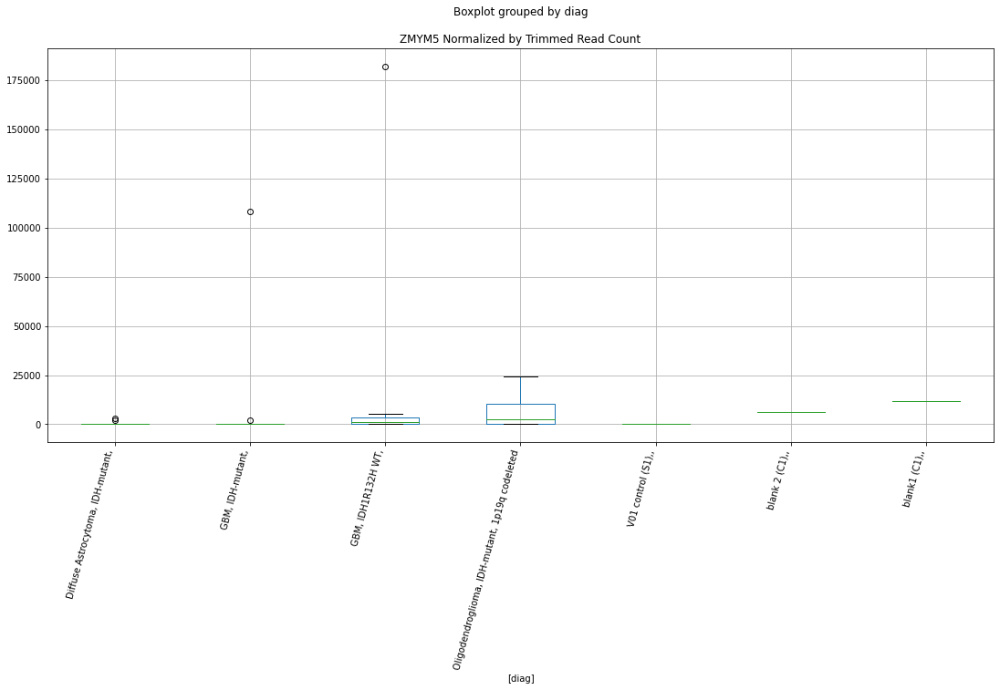

 p : 0.0485670439053052  ( t : 2.115742801870986 ) :  D-plex  :  bbduk2  :  TIE1
Control and blanks
73     0.0
337    0.0
Name: TIE1, dtype: float64
205    895.45
Name: TIE1, dtype: float64
469    0.0
Name: TIE1, dtype: float64


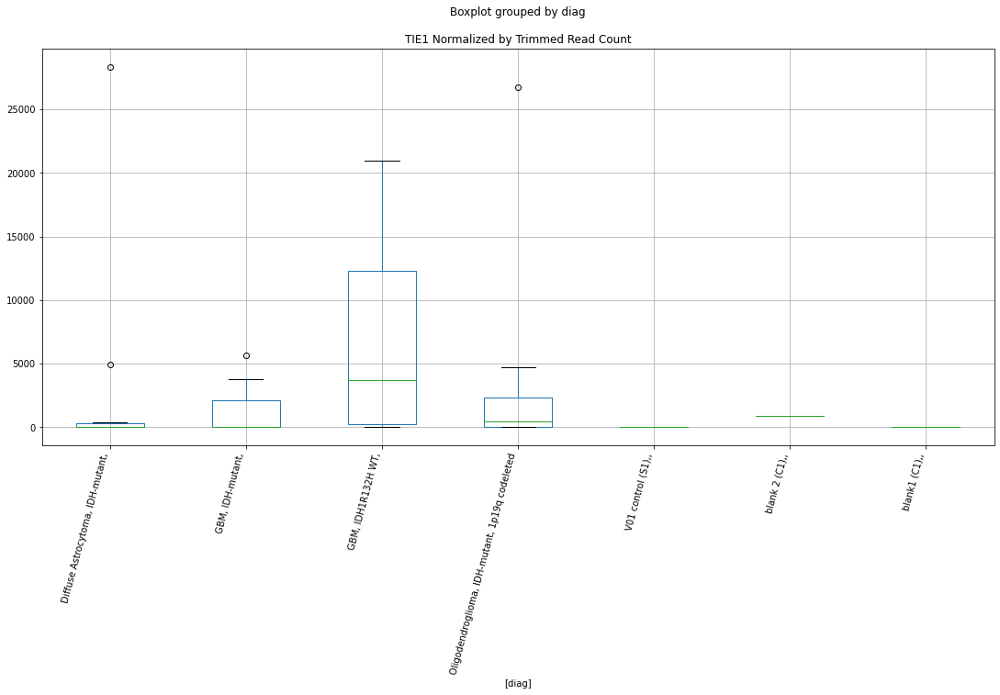

 p : 0.04858057054976654  ( t : 2.115601048583583 ) :  D-plex  :  cutadapt2  :  TMCC2
Control and blanks
76     0.0
340    0.0
Name: TMCC2, dtype: float64
208    1763.6
Name: TMCC2, dtype: float64
472    4623.65
Name: TMCC2, dtype: float64


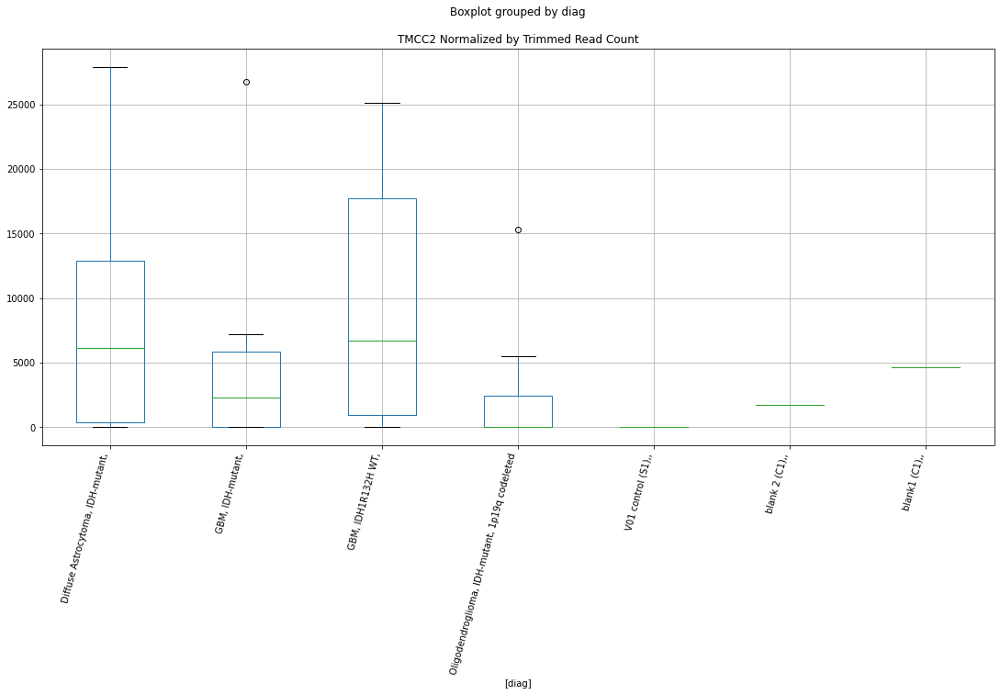

 p : 0.04858393255471713  ( t : 2.1155658218250415 ) :  D-plex  :  bbduk2  :  UBE2U
Control and blanks
73     299154.25
337      2670.47
Name: UBE2U, dtype: float64
205    4835.46
Name: UBE2U, dtype: float64
469    14788.18
Name: UBE2U, dtype: float64


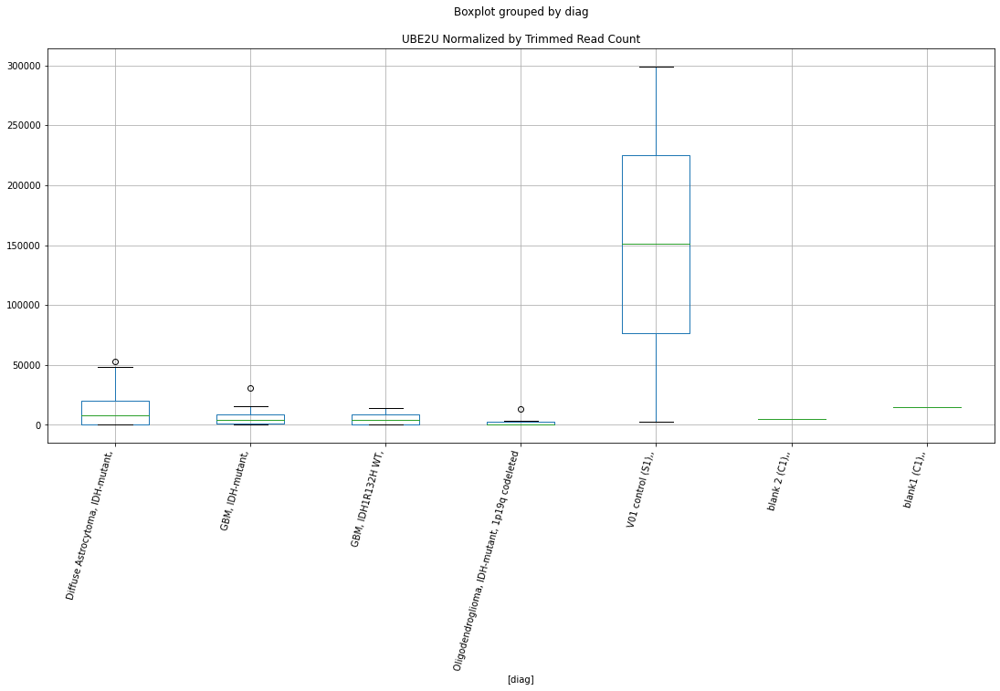

 p : 0.0485866369855641  ( t : 2.1155374866740906 ) :  D-plex  :  cutadapt2  :  STK10
Control and blanks
76     63639.59
340    45798.07
Name: STK10, dtype: float64
208    3527.2
Name: STK10, dtype: float64
472    3467.74
Name: STK10, dtype: float64


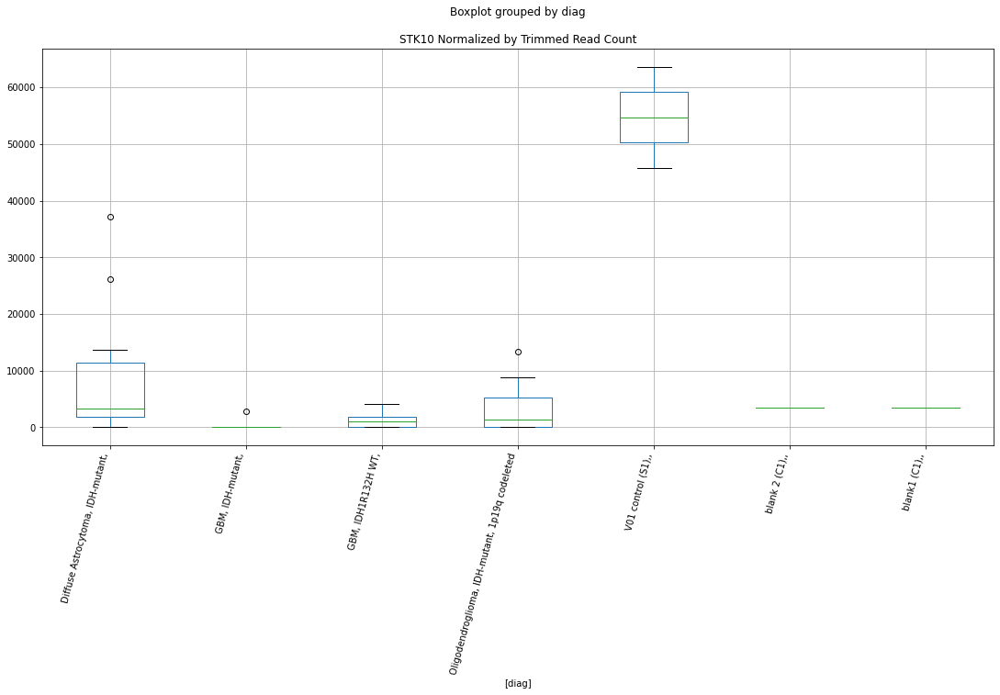

 p : 0.04858836264457667  ( t : 2.1155194071660506 ) :  Lexogen  :  bbduk2  :  TRIM28
Control and blanks
79         0.00
343    28450.12
Name: TRIM28, dtype: float64
211    0.0
Name: TRIM28, dtype: float64
475    0.0
Name: TRIM28, dtype: float64


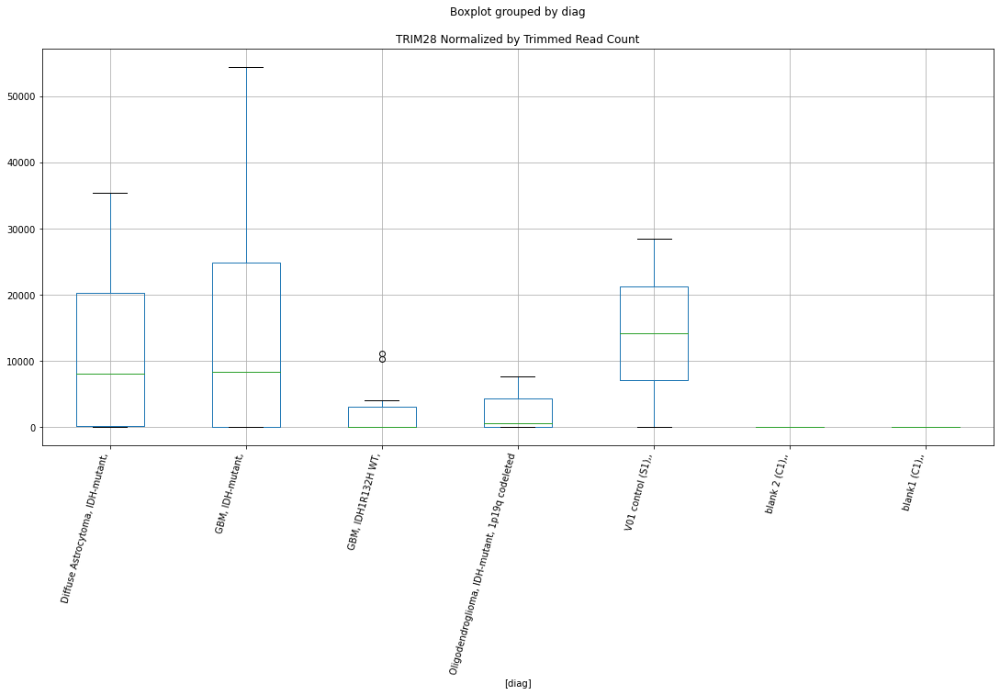

 p : 0.0486147211497465  ( t : 2.1152433251203506 ) :  D-plex  :  cutadapt2  :  TEX30
Control and blanks
76     0.0
340    0.0
Name: TEX30, dtype: float64
208    3527.2
Name: TEX30, dtype: float64
472    2311.82
Name: TEX30, dtype: float64


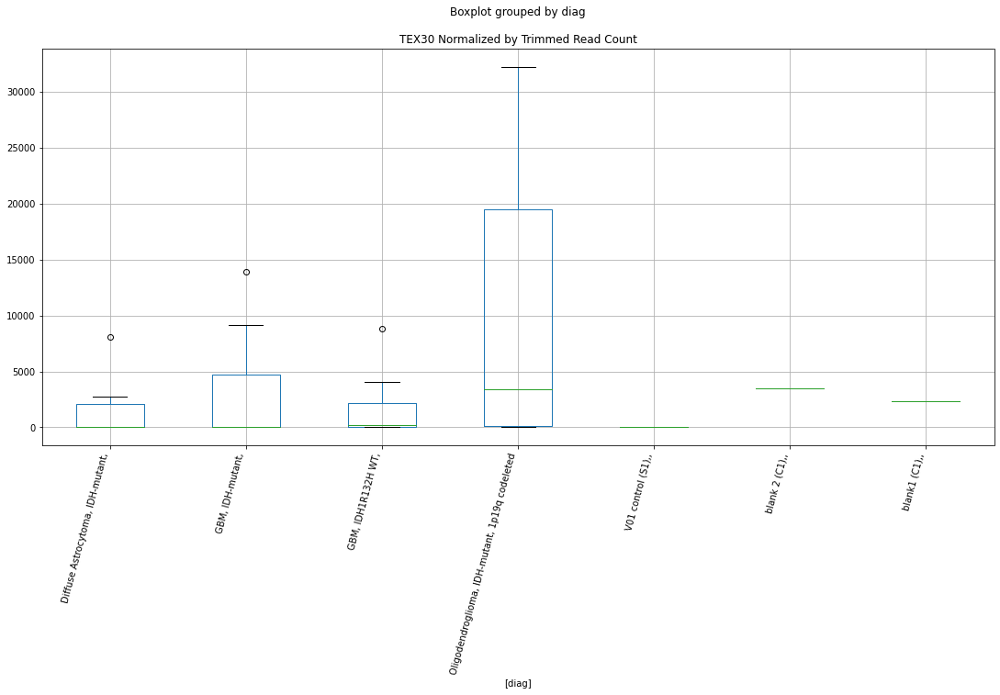

 p : 0.04870848627538952  ( t : 2.1142623216027547 ) :  D-plex  :  bbduk2  :  VTA1
Control and blanks
73     0.0
337    0.0
Name: VTA1, dtype: float64
205    3044.55
Name: VTA1, dtype: float64
469    2366.11
Name: VTA1, dtype: float64


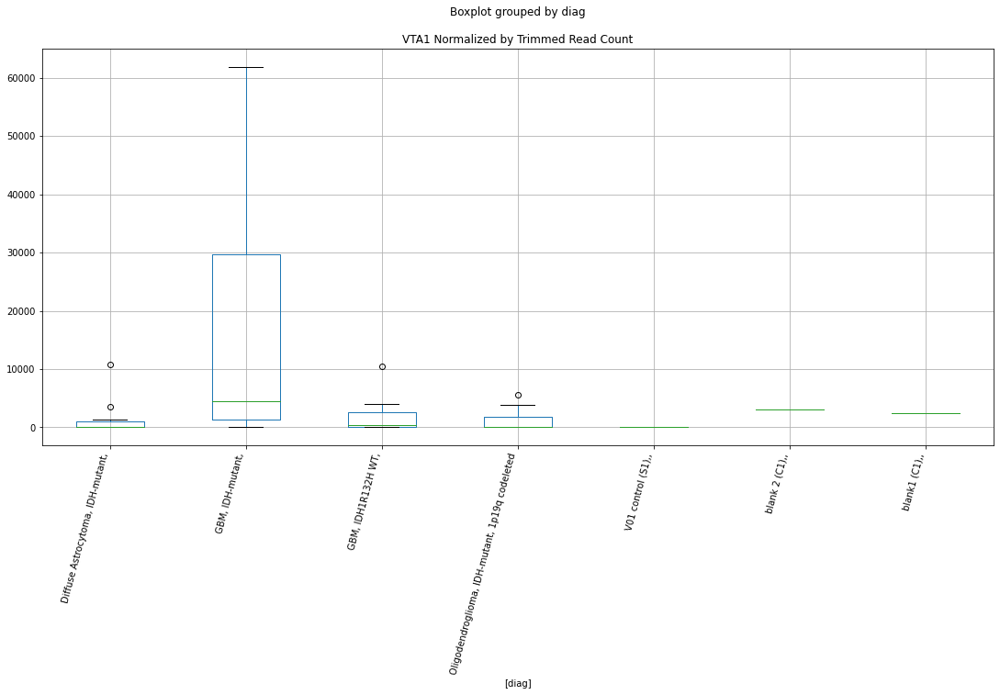

 p : 0.048730671382482625  ( t : 2.114030464751149 ) :  Lexogen  :  bbduk2  :  TTC7B
Control and blanks
79        0.0
343    1486.2
Name: TTC7B, dtype: float64
211    4919.51
Name: TTC7B, dtype: float64
475    0.0
Name: TTC7B, dtype: float64


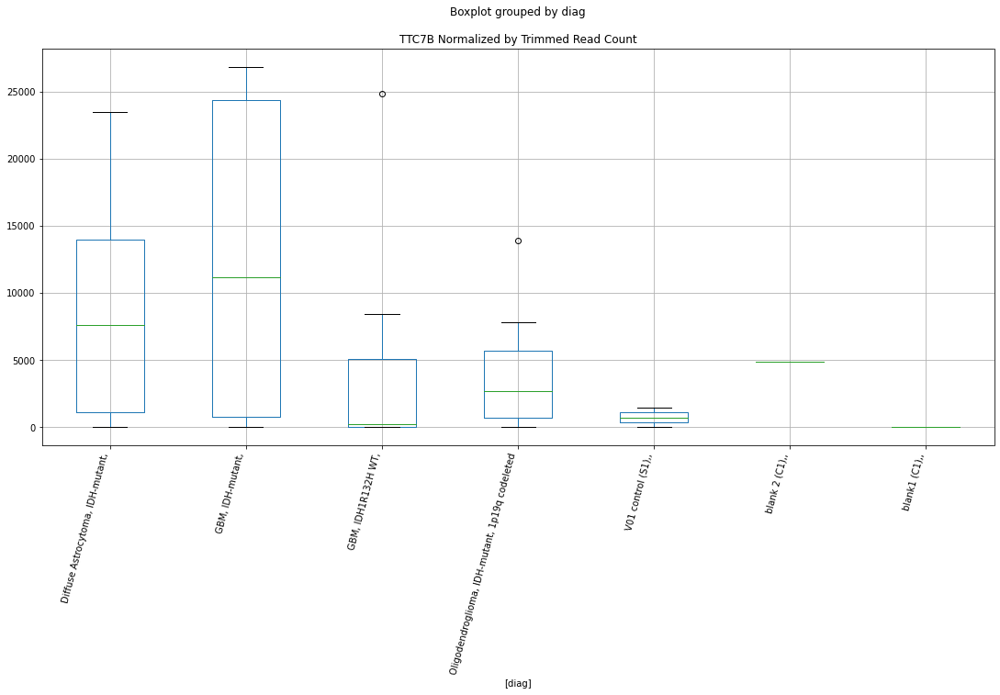

 p : 0.048813377473617046  ( t : 2.1131669481645794 ) :  Lexogen  :  cutadapt2  :  UBE2J2
Control and blanks
82     0.0
346    0.0
Name: UBE2J2, dtype: float64
214    0.0
Name: UBE2J2, dtype: float64
478    0.0
Name: UBE2J2, dtype: float64


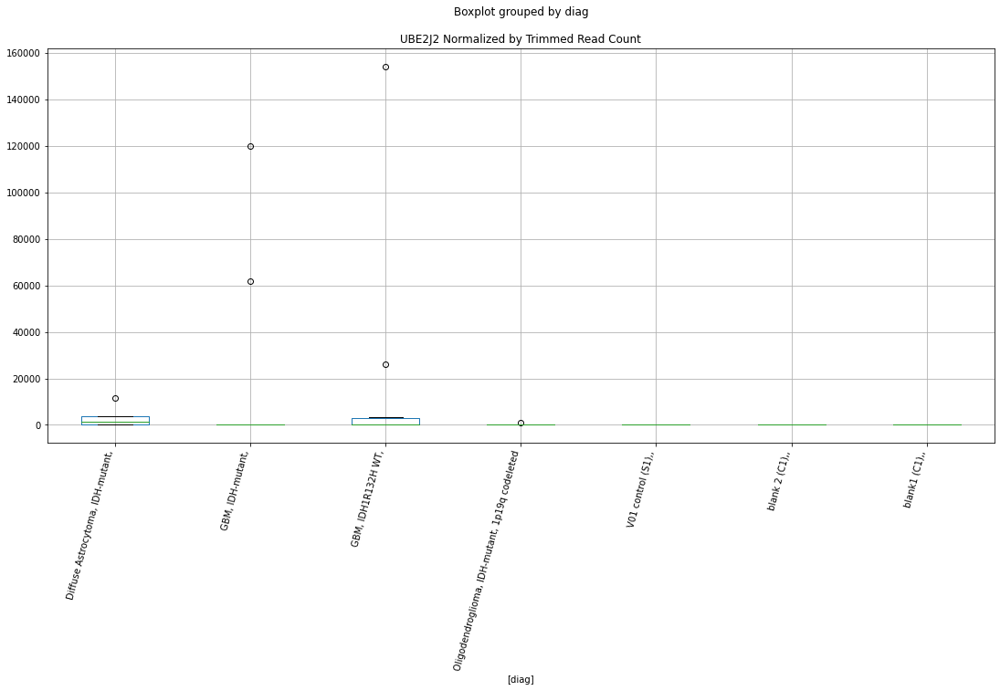

 p : 0.04881554868819946  ( t : 2.1131442969213667 ) :  Lexogen  :  bbduk2  :  ZNF503
Control and blanks
79     0.0
343    0.0
Name: ZNF503, dtype: float64
211    0.0
Name: ZNF503, dtype: float64
475    239.52
Name: ZNF503, dtype: float64


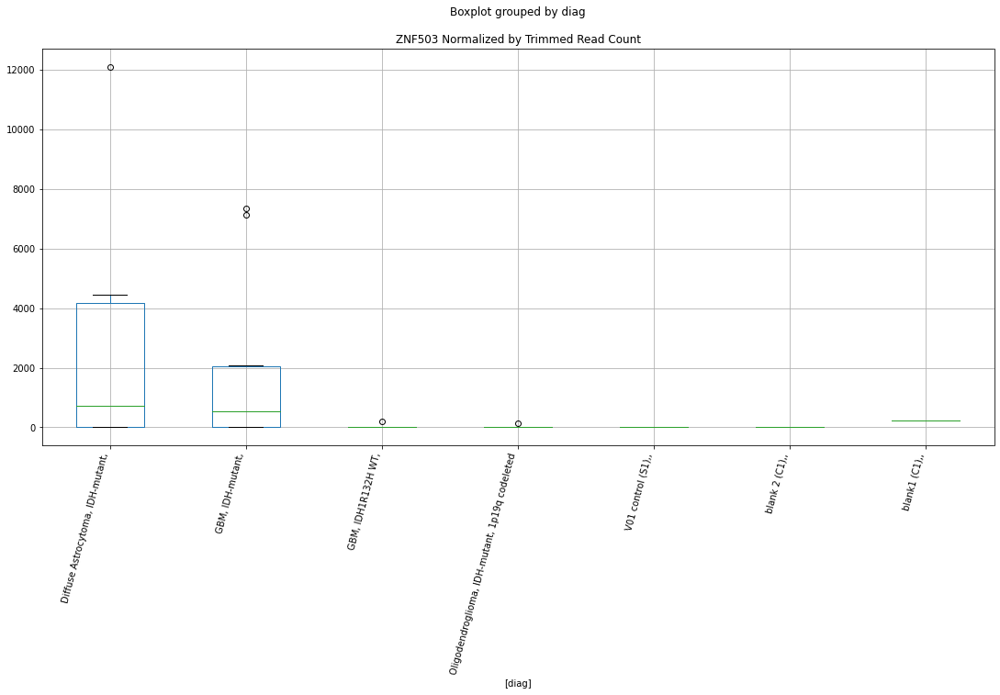

 p : 0.04881879879910259  ( t : 2.113110391782445 ) :  D-plex  :  bbduk2  :  TECTA
Control and blanks
73     0.0
337    0.0
Name: TECTA, dtype: float64
205    895.45
Name: TECTA, dtype: float64
469    1183.05
Name: TECTA, dtype: float64


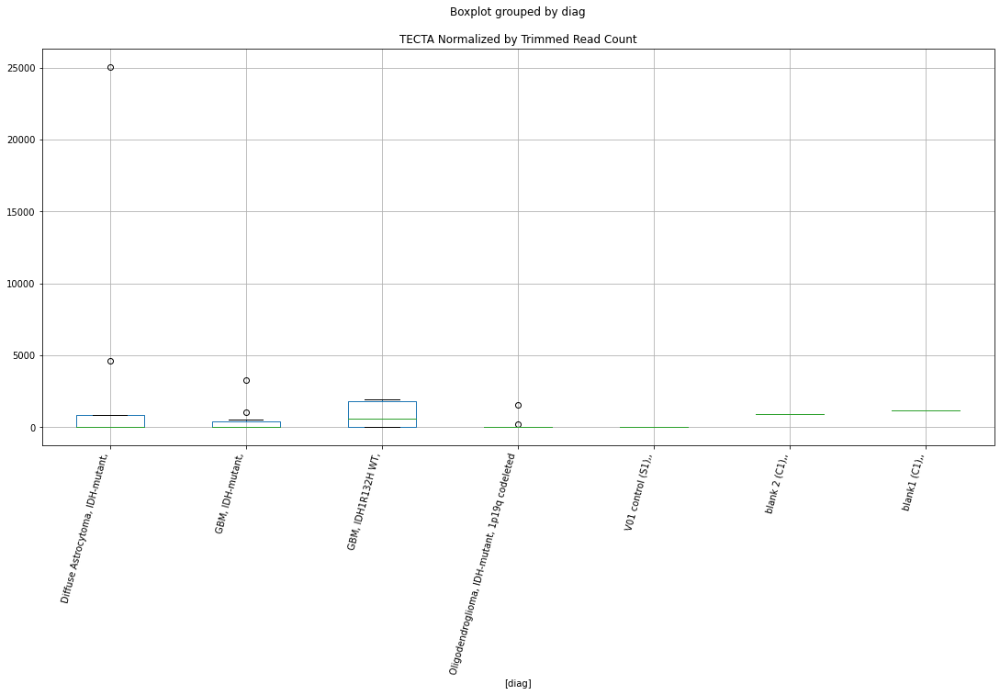

 p : 0.04889533513678628  ( t : 2.1123125583484876 ) :  Lexogen  :  cutadapt2  :  ZNF792
Control and blanks
82       0.00
346    210.43
Name: ZNF792, dtype: float64
214    5424.53
Name: ZNF792, dtype: float64
478    0.0
Name: ZNF792, dtype: float64


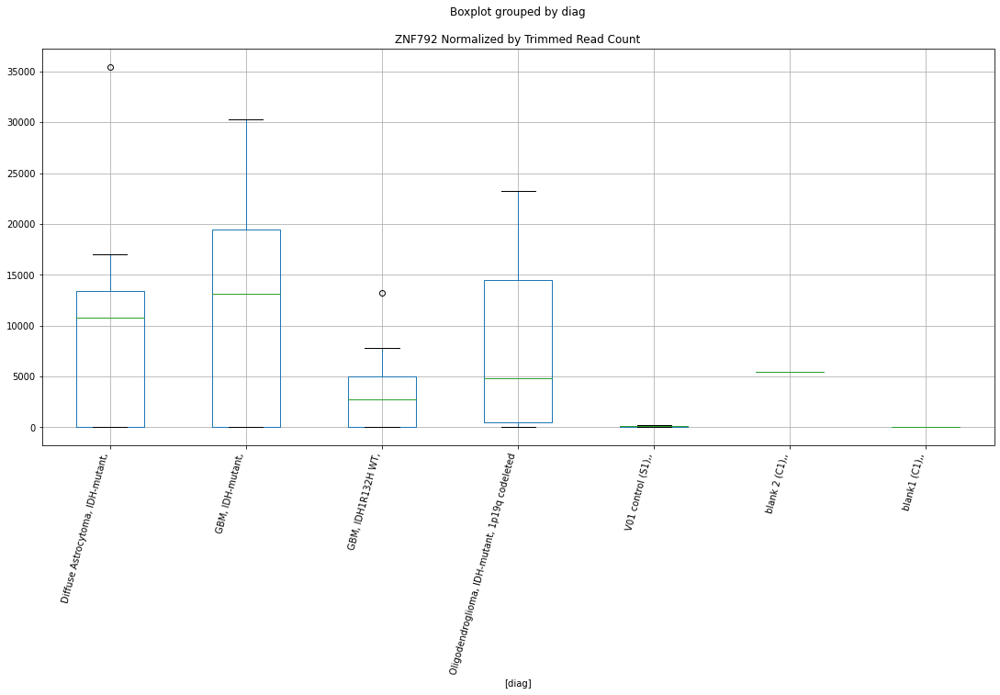

 p : 0.048928227058961694  ( t : 2.111970034060292 ) :  Lexogen  :  bbduk2  :  TMEM119
Control and blanks
79     0.0
343    0.0
Name: TMEM119, dtype: float64
211    0.0
Name: TMEM119, dtype: float64
475    0.0
Name: TMEM119, dtype: float64


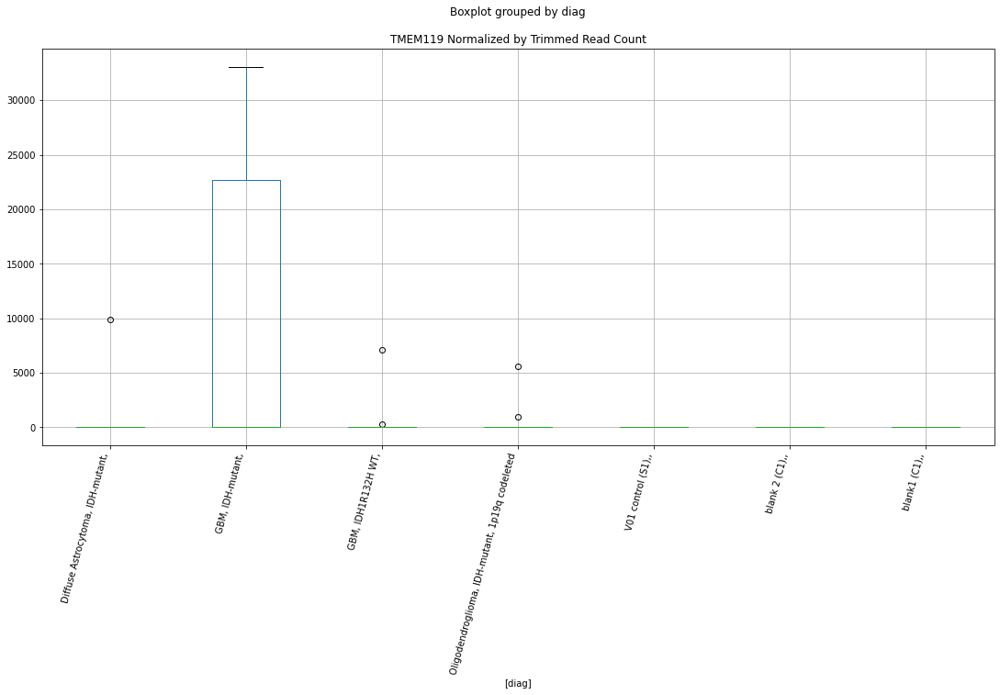

 p : 0.04901281930396204  ( t : 2.1110900832527513 ) :  Lexogen  :  cutadapt2  :  TMEM119
Control and blanks
82     0.0
346    0.0
Name: TMEM119, dtype: float64
214    0.0
Name: TMEM119, dtype: float64
478    0.0
Name: TMEM119, dtype: float64


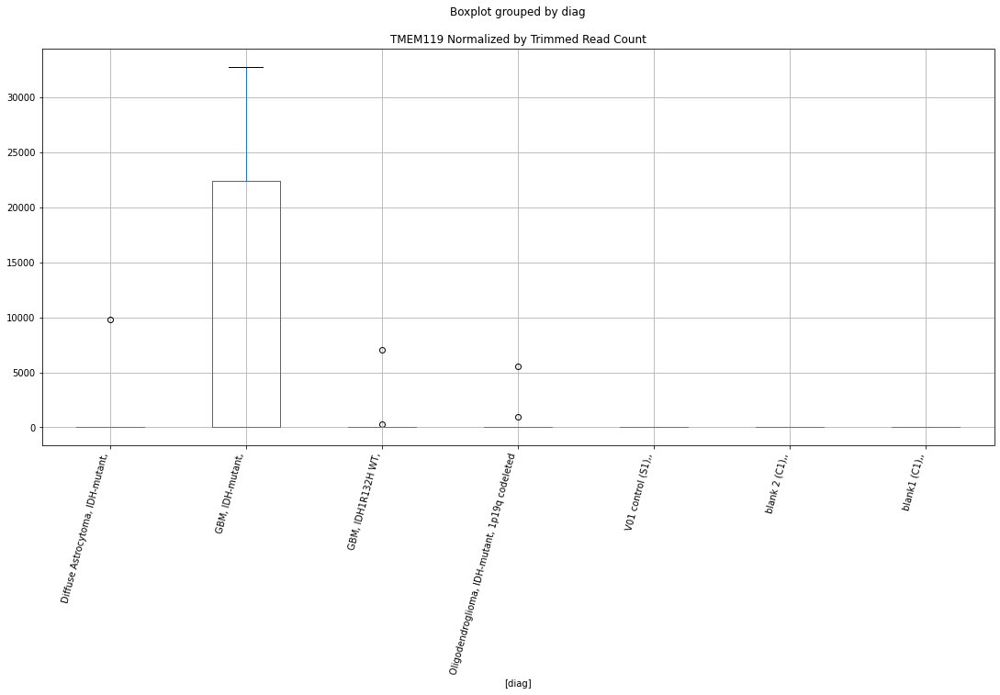

 p : 0.04902740467961389  ( t : 2.110938502034299 ) :  Lexogen  :  bbduk2  :  UHRF1BP1
Control and blanks
79       0.00
343    424.63
Name: UHRF1BP1, dtype: float64
211    1093.23
Name: UHRF1BP1, dtype: float64
475    0.0
Name: UHRF1BP1, dtype: float64


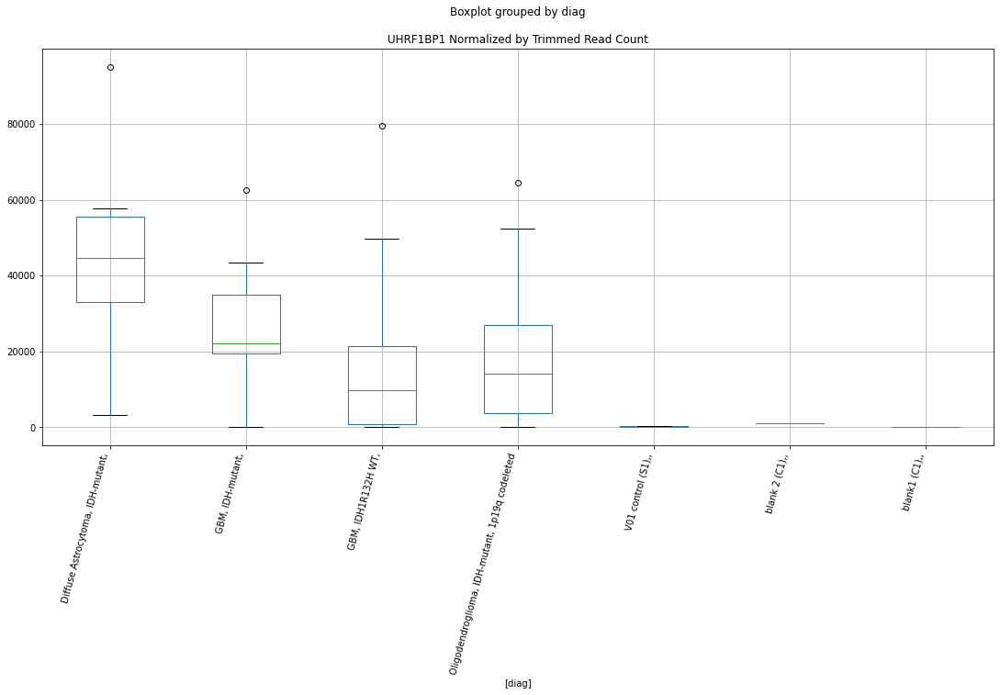

 p : 0.04916513665427913  ( t : 2.109509116612387 ) :  D-plex  :  bbduk2  :  TMEM230
Control and blanks
73       9276.10
337    534094.36
Name: TMEM230, dtype: float64
205    37967.28
Name: TMEM230, dtype: float64
469    33125.53
Name: TMEM230, dtype: float64


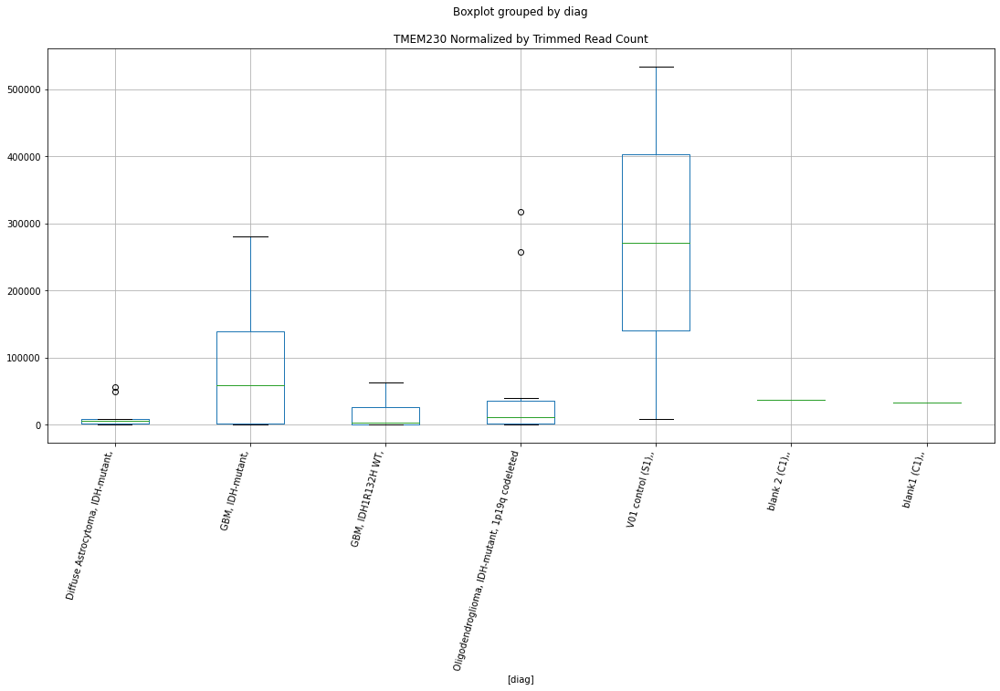

 p : 0.049171823077344044  ( t : 2.1094398175338402 ) :  Lexogen  :  cutadapt2  :  TRPV6
Control and blanks
82     28401.02
346    24410.40
Name: TRPV6, dtype: float64
214    23867.93
Name: TRPV6, dtype: float64
478    26120.65
Name: TRPV6, dtype: float64


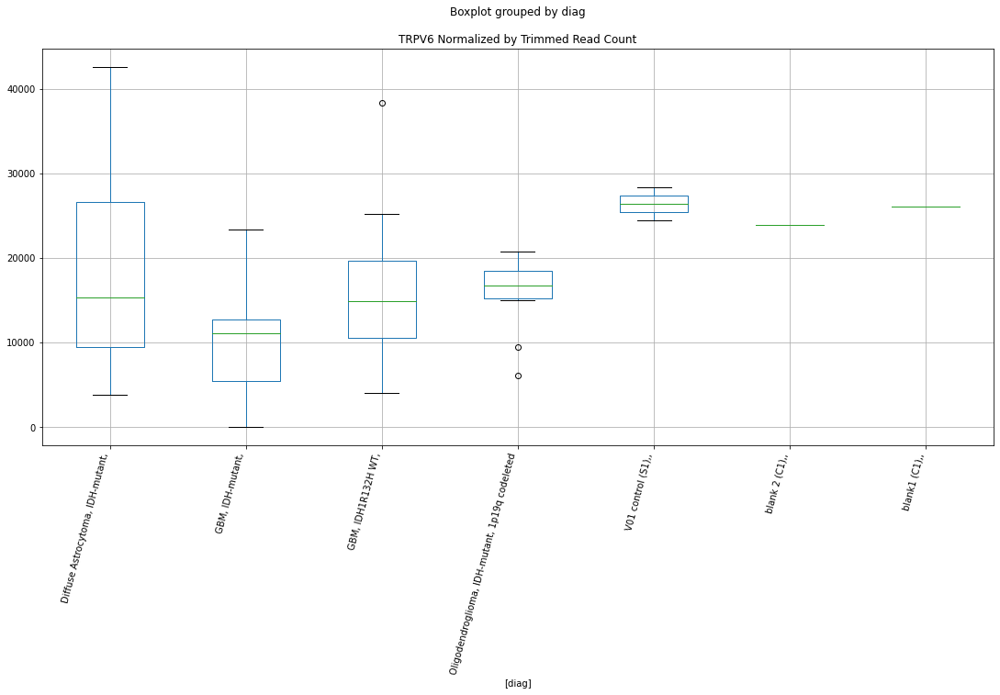

 p : 0.04924271519385598  ( t : 2.1087056079617814 ) :  D-plex  :  cutadapt2  :  ZC3H12C
Control and blanks
76     757.61
340      0.00
Name: ZC3H12C, dtype: float64
208    4938.09
Name: ZC3H12C, dtype: float64
472    10403.21
Name: ZC3H12C, dtype: float64


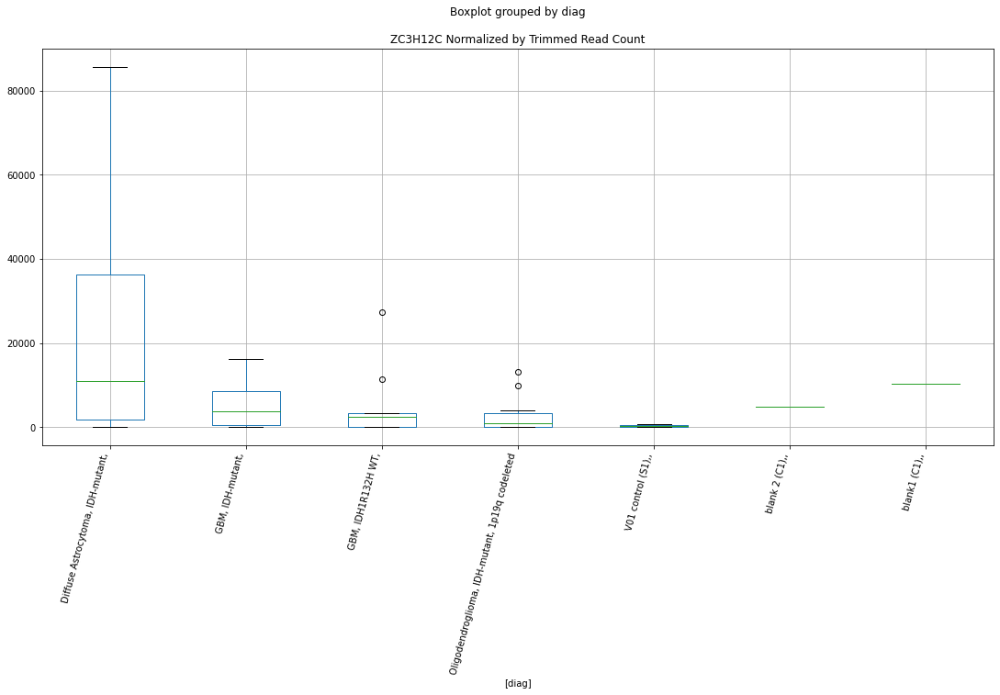

 p : 0.04927492113695871  ( t : 2.1083723777256678 ) :  D-plex  :  bbduk2  :  SSTR1
Control and blanks
73      3865.04
337    21363.77
Name: SSTR1, dtype: float64
205    8417.27
Name: SSTR1, dtype: float64
469    8281.38
Name: SSTR1, dtype: float64


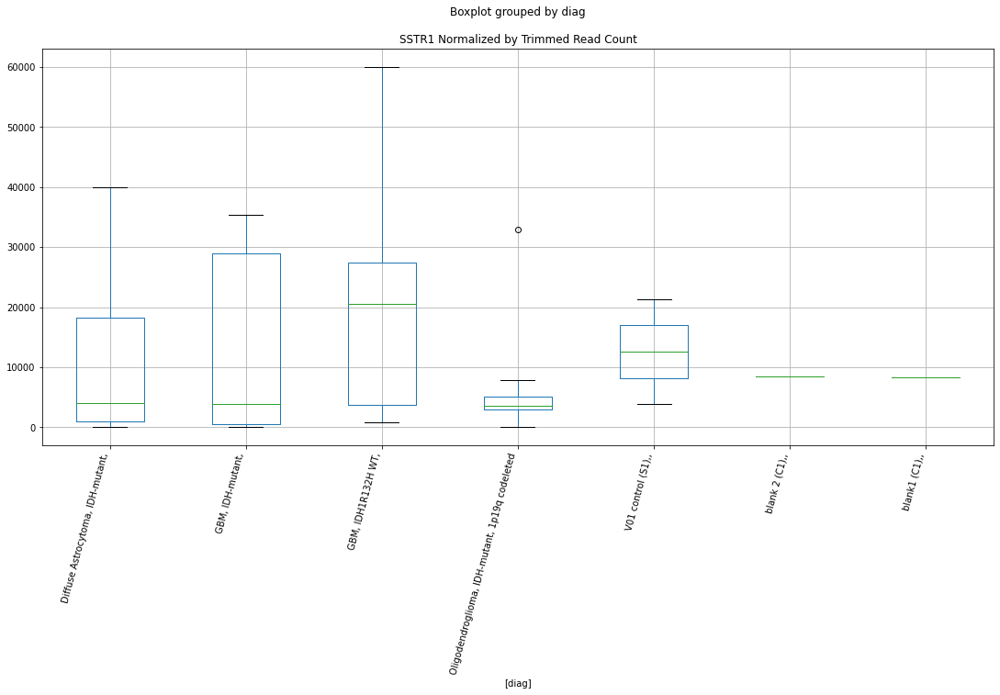

 p : 0.04935586713039472  ( t : 2.107535715176677 ) :  D-plex  :  bbduk2  :  TRDN
Control and blanks
73     0.0
337    0.0
Name: TRDN, dtype: float64
205    2328.18
Name: TRDN, dtype: float64
469    2366.11
Name: TRDN, dtype: float64


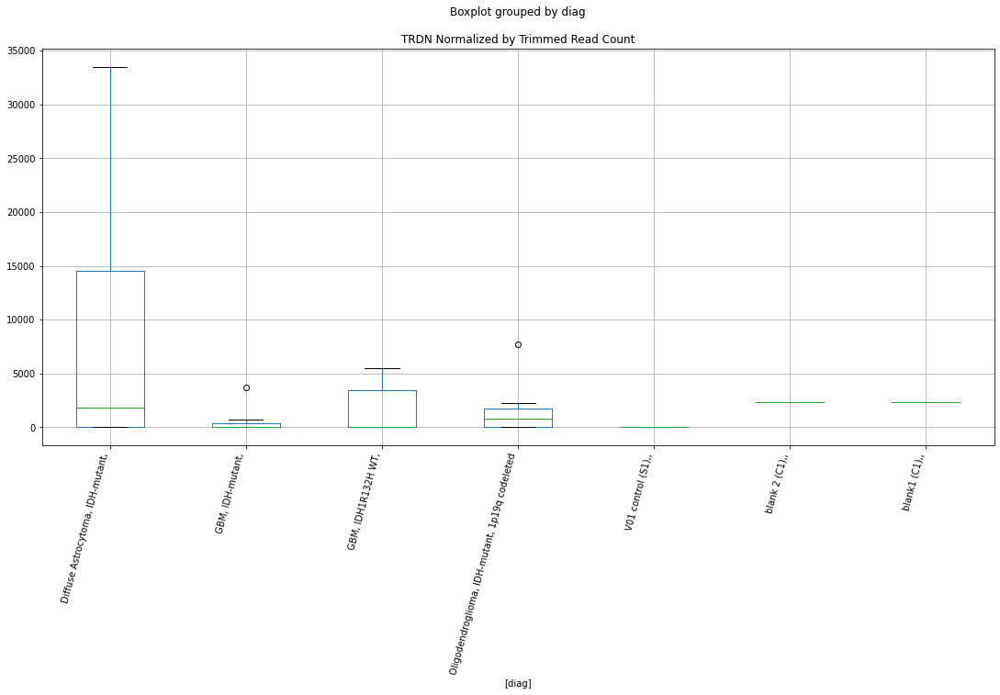

 p : 0.0494614431758226  ( t : 2.106446348482958 ) :  Lexogen  :  cutadapt2  :  WT1-AS
Control and blanks
82     0.0
346    0.0
Name: WT1-AS, dtype: float64
214    11933.96
Name: WT1-AS, dtype: float64
478    237.46
Name: WT1-AS, dtype: float64


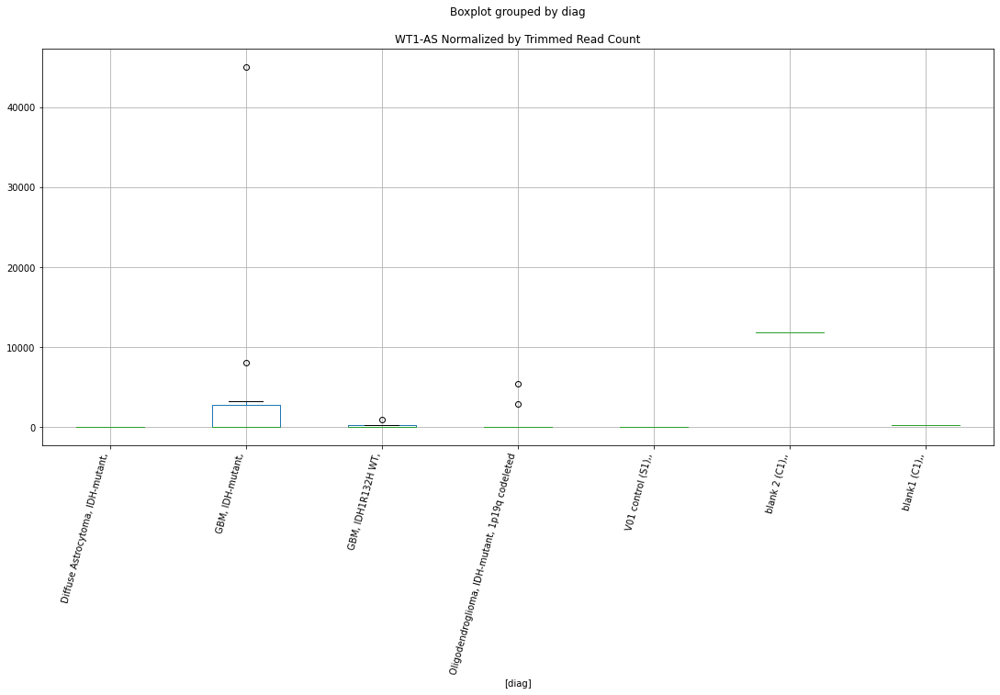

 p : 0.049492640689987114  ( t : 2.1061248475547028 ) :  D-plex  :  bbduk2  :  SUGP2
Control and blanks
73        0.00
337    8901.57
Name: SUGP2, dtype: float64
205    1790.91
Name: SUGP2, dtype: float64
469    5915.27
Name: SUGP2, dtype: float64


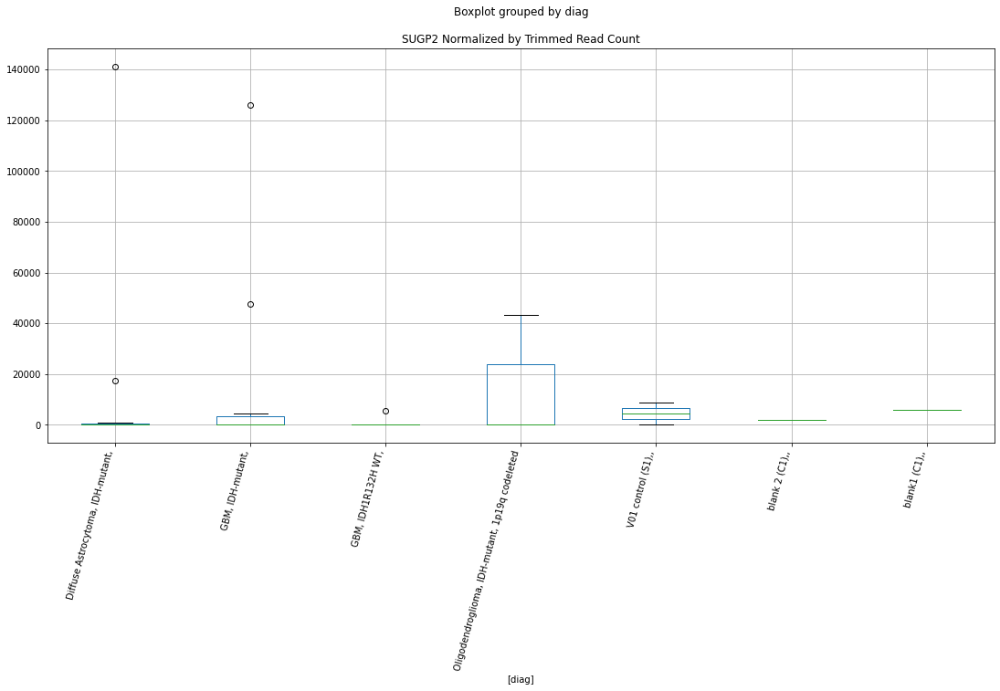

 p : 0.04950116924101681  ( t : 2.106036990032882 ) :  Lexogen  :  cutadapt2  :  UHRF1BP1
Control and blanks
82       0.00
346    420.87
Name: UHRF1BP1, dtype: float64
214    1084.91
Name: UHRF1BP1, dtype: float64
478    0.0
Name: UHRF1BP1, dtype: float64


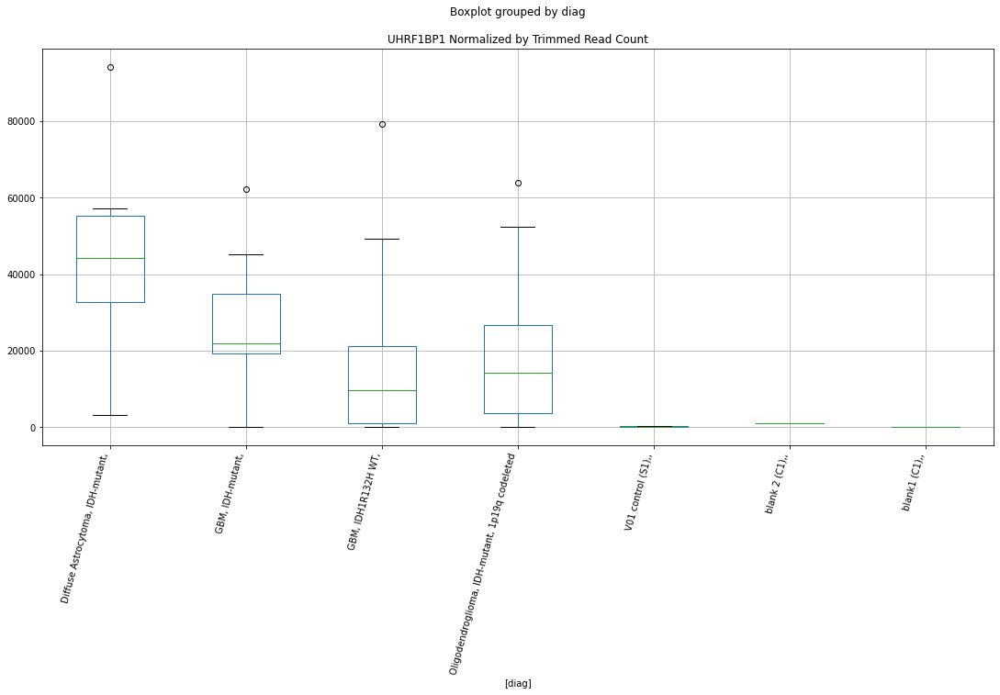

 p : 0.04951538961453323  ( t : 2.1058905283736173 ) :  D-plex  :  bbduk2  :  ZNF516
Control and blanks
73        0.00
337    9791.73
Name: ZNF516, dtype: float64
205    27580.01
Name: ZNF516, dtype: float64
469    26618.73
Name: ZNF516, dtype: float64


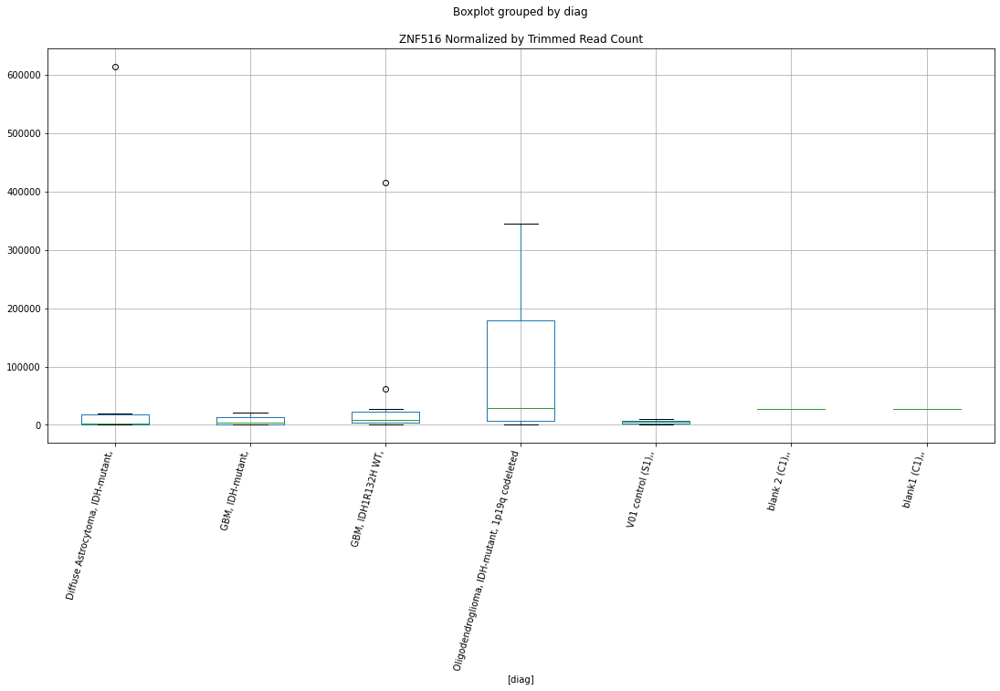

 p : 0.049623793694428174  ( t : 2.104775284313645 ) :  Lexogen  :  bbduk2  :  ZNF740
Control and blanks
79         0.00
343    96815.33
Name: ZNF740, dtype: float64
211    0.0
Name: ZNF740, dtype: float64
475    0.0
Name: ZNF740, dtype: float64


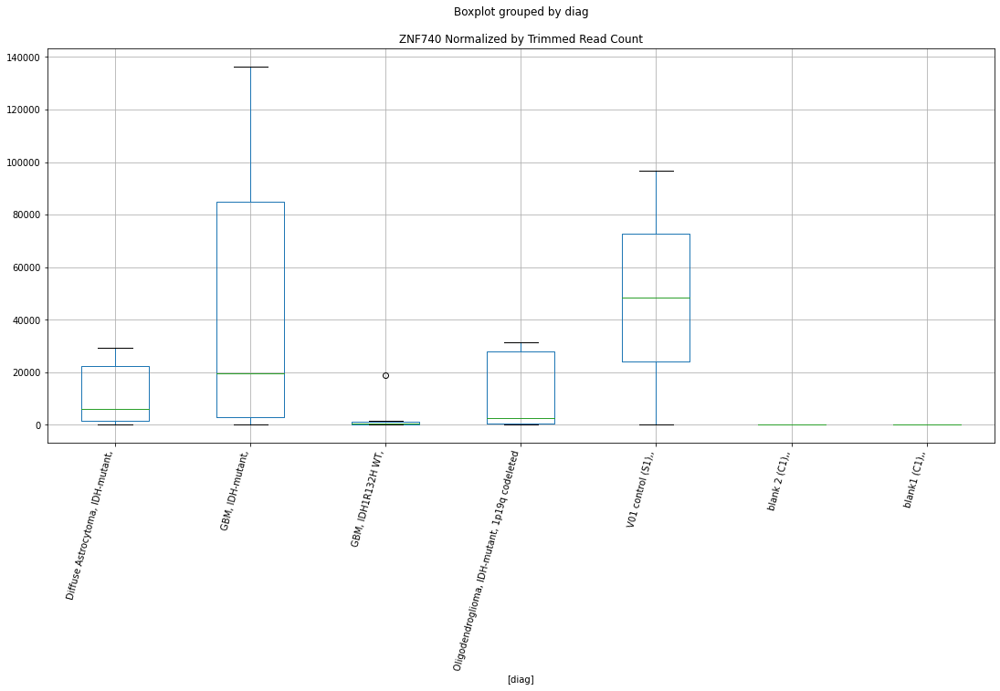

 p : 0.04965964747603093  ( t : 2.1044069137688157 ) :  Lexogen  :  bbduk2  :  TSSK2
Control and blanks
79     0.0
343    0.0
Name: TSSK2, dtype: float64
211    0.0
Name: TSSK2, dtype: float64
475    0.0
Name: TSSK2, dtype: float64


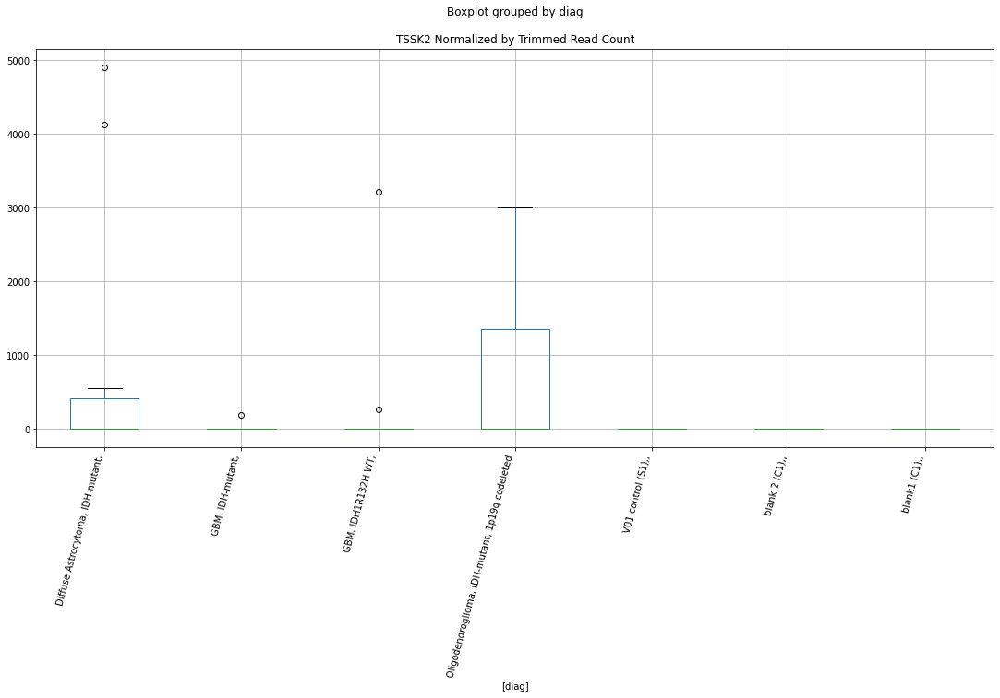

 p : 0.04967975918485441  ( t : 2.1042003869989925 ) :  Lexogen  :  cutadapt2  :  TSSK2
Control and blanks
82     0.0
346    0.0
Name: TSSK2, dtype: float64
214    0.0
Name: TSSK2, dtype: float64
478    0.0
Name: TSSK2, dtype: float64


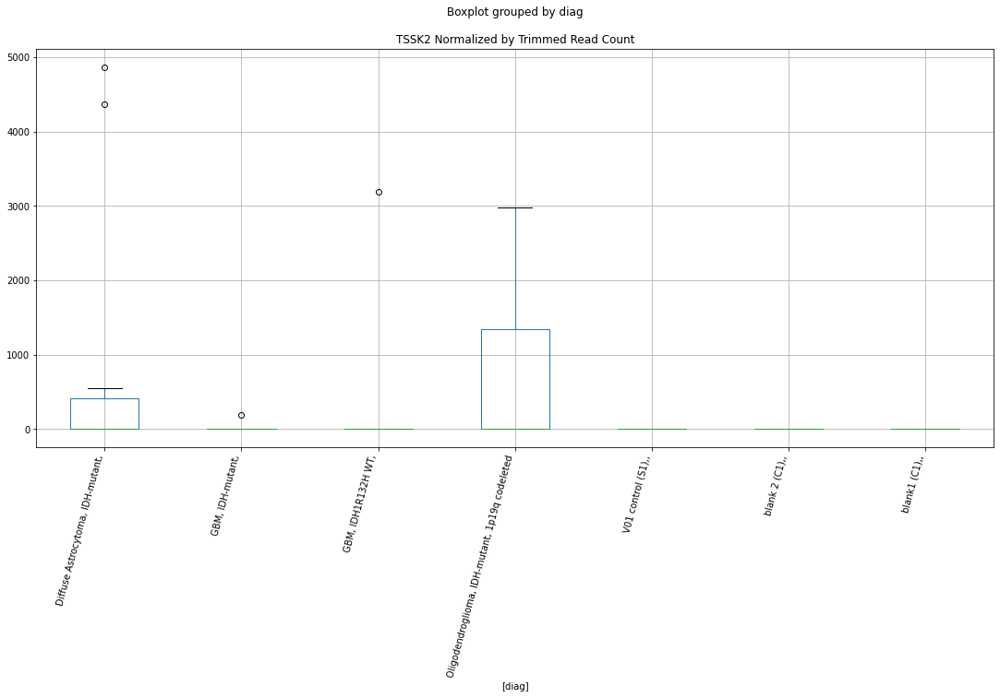

 p : 0.04973615339005799  ( t : 2.1036216811136885 ) :  Lexogen  :  cutadapt2  :  UBE2D1
Control and blanks
82     0.0
346    0.0
Name: UBE2D1, dtype: float64
214    0.0
Name: UBE2D1, dtype: float64
478    0.0
Name: UBE2D1, dtype: float64


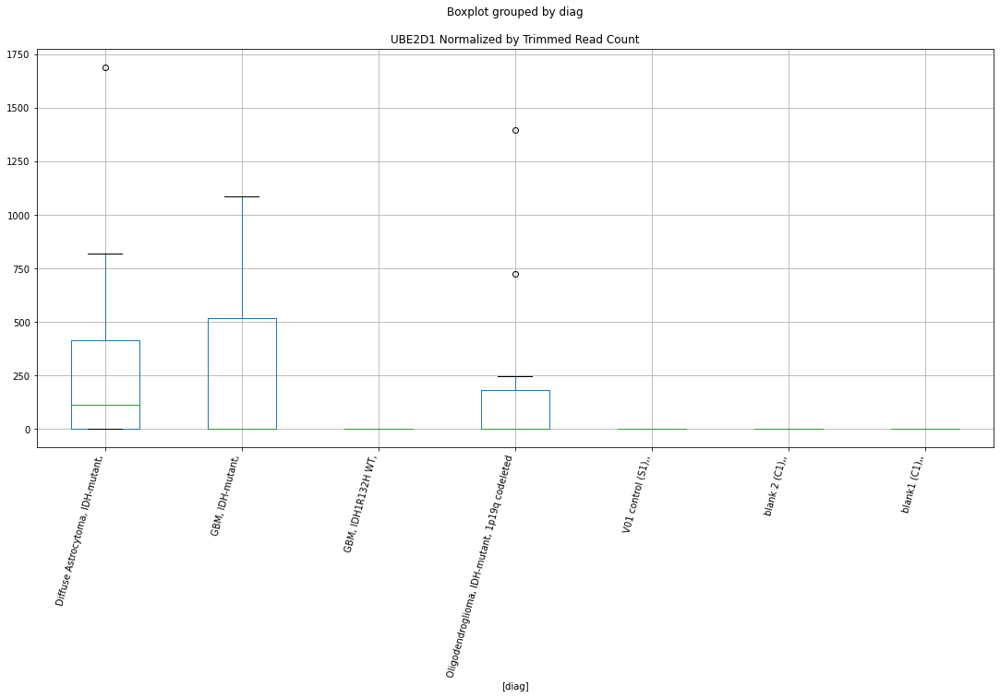

 p : 0.04974186687639884  ( t : 2.103563083764918 ) :  D-plex  :  bbduk2  :  TNC
Control and blanks
73     0.0
337    0.0
Name: TNC, dtype: float64
205    8059.09
Name: TNC, dtype: float64
469    1774.58
Name: TNC, dtype: float64


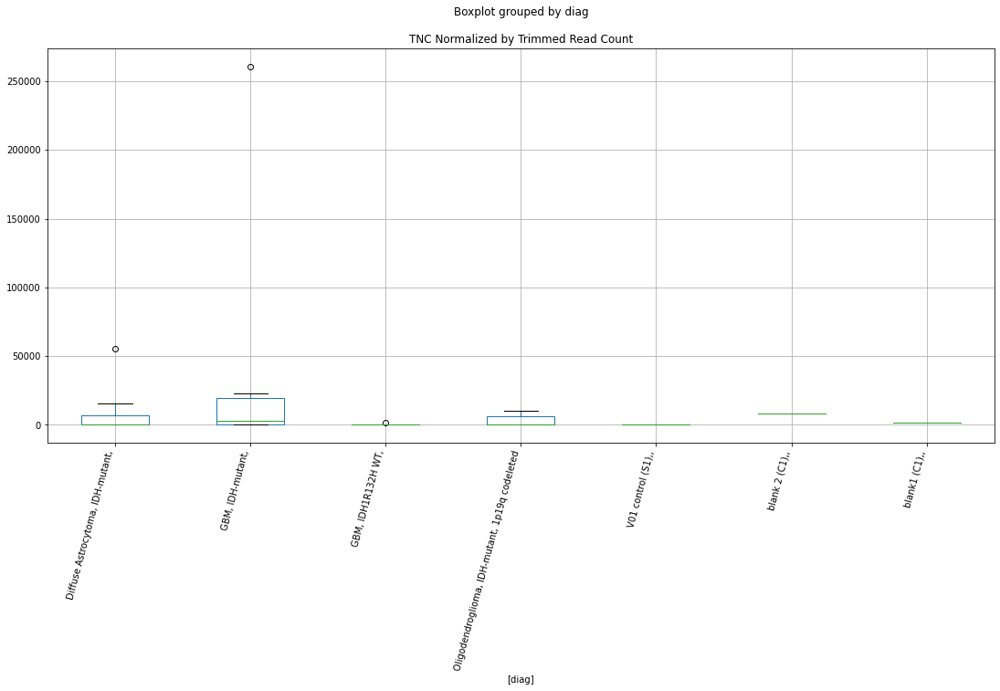

 p : 0.049751624693577925  ( t : 2.103463022025929 ) :  D-plex  :  bbduk2  :  ZNF558
Control and blanks
73         0.00
337    27594.88
Name: ZNF558, dtype: float64
205    3402.73
Name: ZNF558, dtype: float64
469    9464.44
Name: ZNF558, dtype: float64


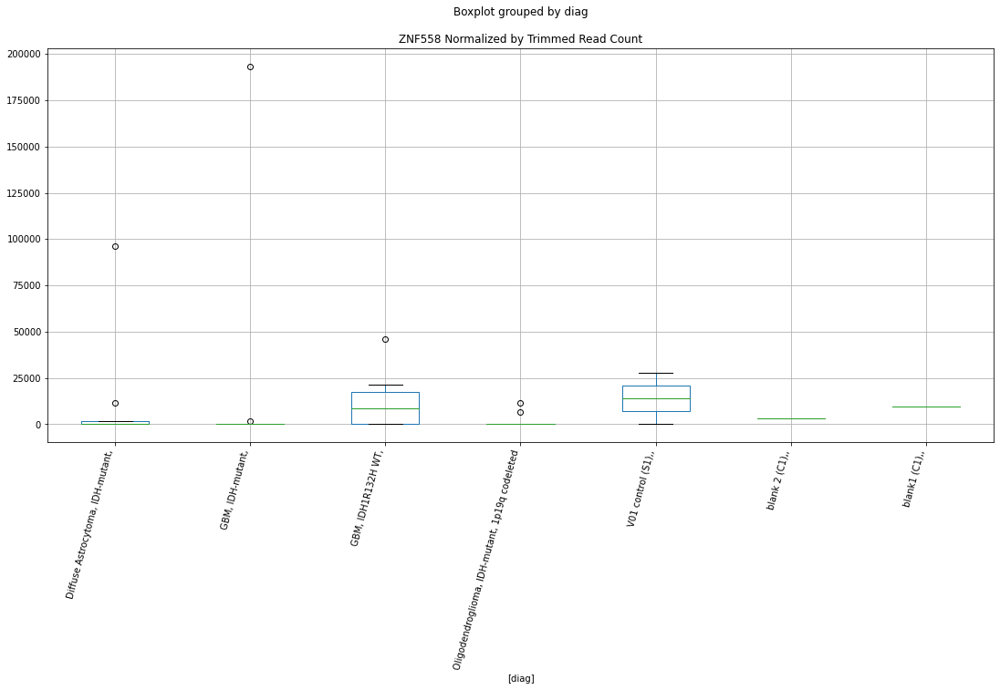

 p : 0.04981210056987471  ( t : 2.1028432685686798 ) :  Lexogen  :  cutadapt2  :  ZNF280A
Control and blanks
82        0.00
346    1683.48
Name: ZNF280A, dtype: float64
214    13561.32
Name: ZNF280A, dtype: float64
478    15197.47
Name: ZNF280A, dtype: float64


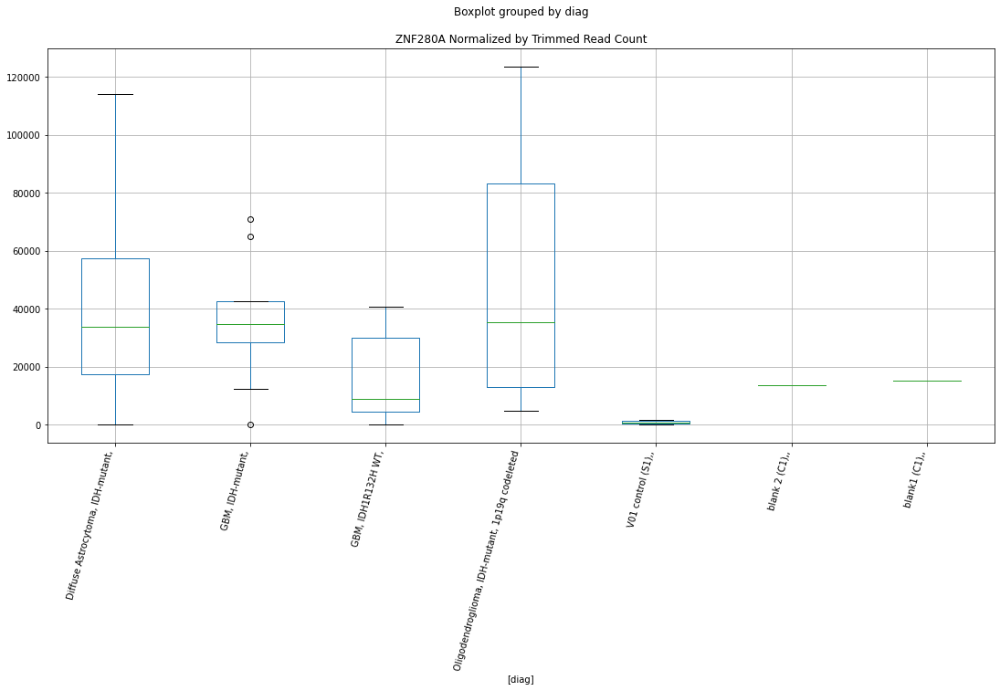

 p : 0.04983746213975736  ( t : 2.102583568159872 ) :  D-plex  :  cutadapt2  :  VTA1
Control and blanks
76     0.0
340    0.0
Name: VTA1, dtype: float64
208    2469.04
Name: VTA1, dtype: float64
472    2311.82
Name: VTA1, dtype: float64


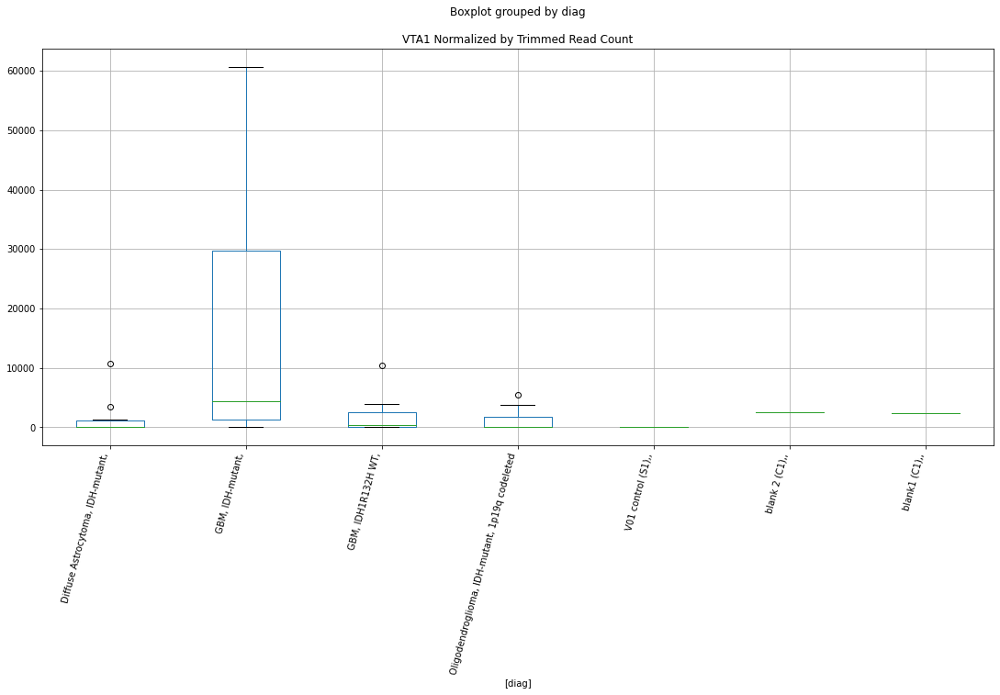

 p : 0.04983779586385755  ( t : 2.102580151653224 ) :  D-plex  :  bbduk2  :  ZSCAN1
Control and blanks
73     0.0
337    0.0
Name: ZSCAN1, dtype: float64
205    8238.18
Name: ZSCAN1, dtype: float64
469    2366.11
Name: ZSCAN1, dtype: float64


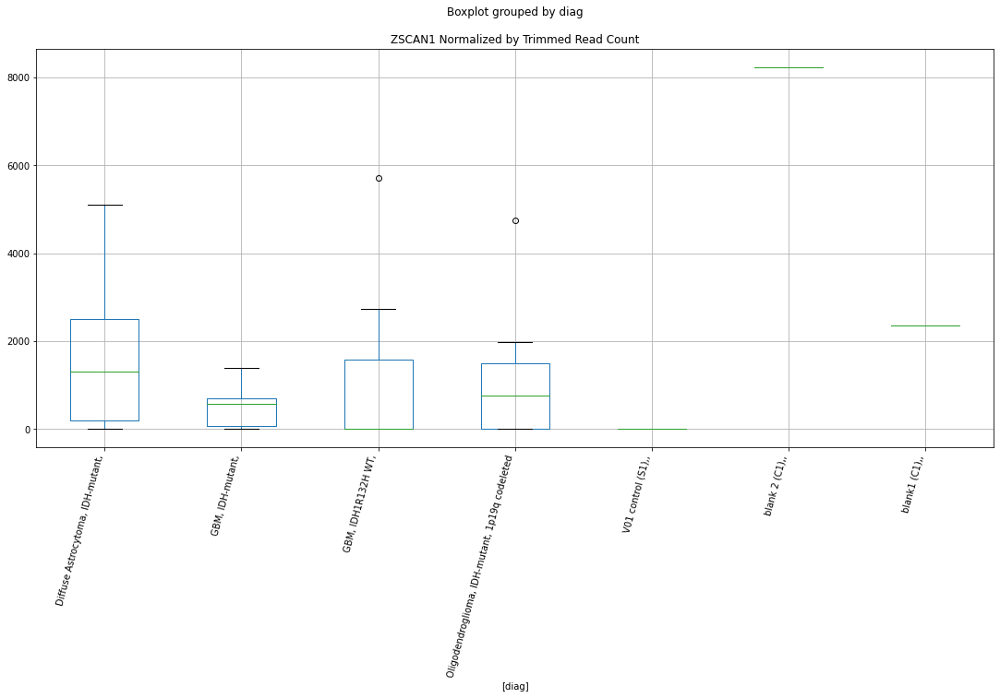

 p : 0.04985087736959674  ( t : 2.1024462458792836 ) :  Lexogen  :  cutadapt2  :  WNK1
Control and blanks
82     0.0
346    0.0
Name: WNK1, dtype: float64
214    0.0
Name: WNK1, dtype: float64
478    0.0
Name: WNK1, dtype: float64


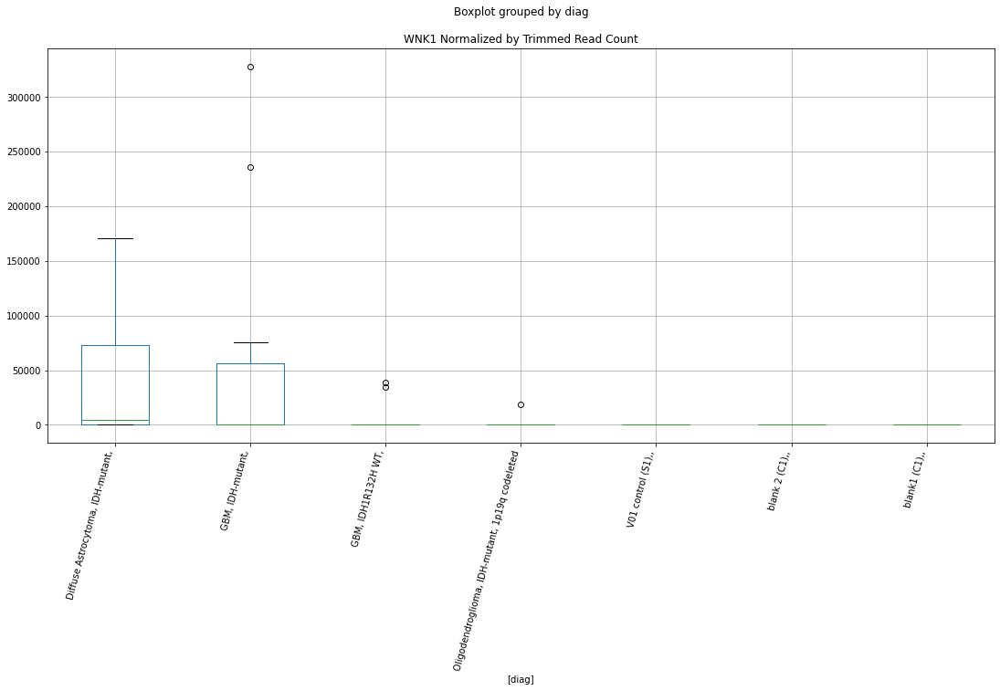

 p : 0.04987595655263941  ( t : 2.102189617987015 ) :  D-plex  :  cutadapt2  :  SSTR1
Control and blanks
76      3030.46
340    20256.84
Name: SSTR1, dtype: float64
208    8112.57
Name: SSTR1, dtype: float64
472    8669.34
Name: SSTR1, dtype: float64


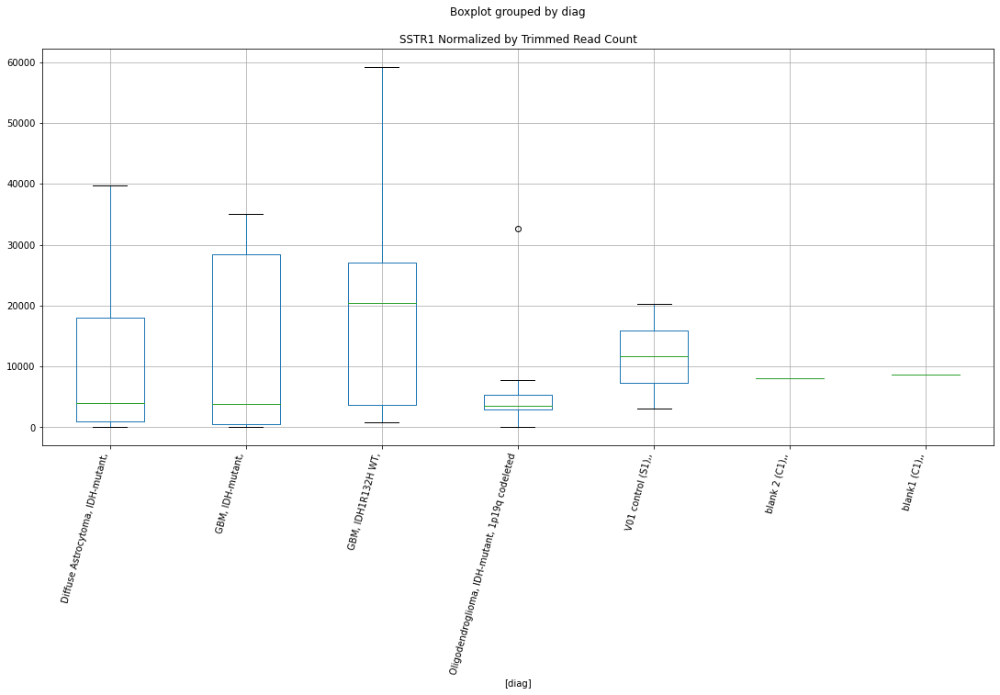

 p : 0.049876695170691106  ( t : 2.1021820617044993 ) :  Lexogen  :  bbduk2  :  SYNDIG1
Control and blanks
79     0.0
343    0.0
Name: SYNDIG1, dtype: float64
211    0.0
Name: SYNDIG1, dtype: float64
475    2155.64
Name: SYNDIG1, dtype: float64


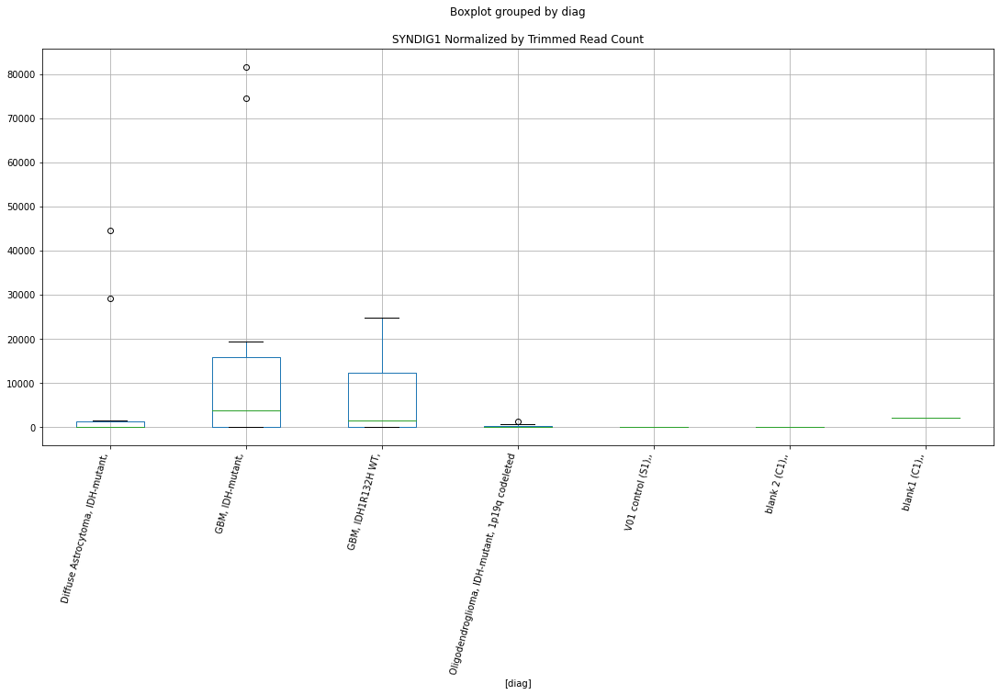

 p : 0.04990192072699014  ( t : 2.1019240577961473 ) :  D-plex  :  cutadapt2  :  TAF4
Control and blanks
76     1515.23
340       0.00
Name: TAF4, dtype: float64
208    2469.04
Name: TAF4, dtype: float64
472    7513.43
Name: TAF4, dtype: float64


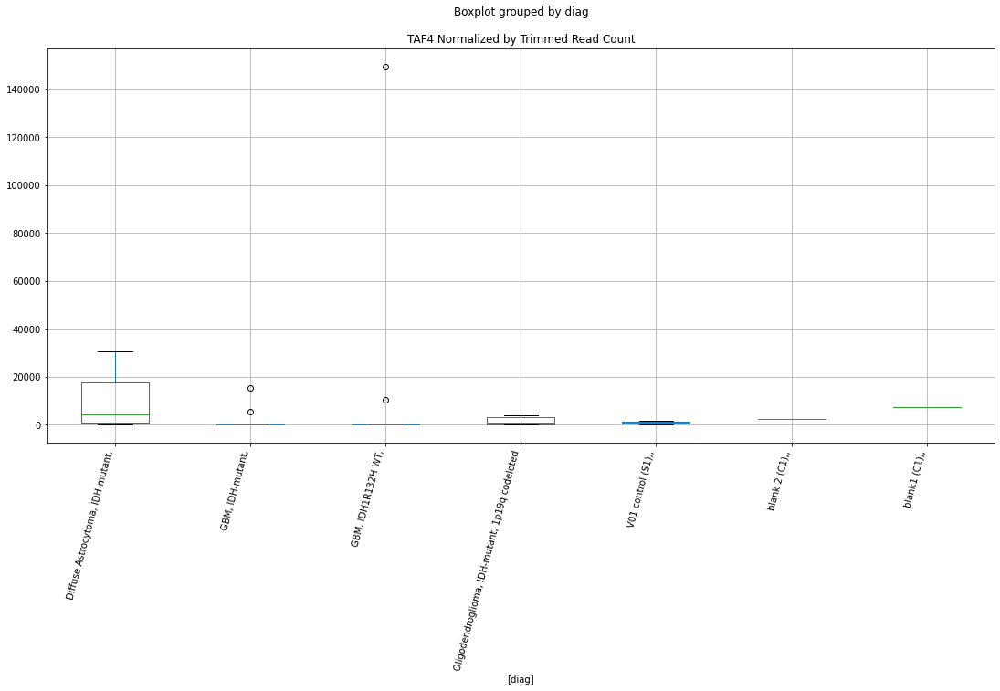

 p : 0.04991695608277423  ( t : 2.101770334399566 ) :  D-plex  :  cutadapt2  :  SUGP2
Control and blanks
76     0.0
340    0.0
Name: SUGP2, dtype: float64
208    1763.6
Name: SUGP2, dtype: float64
472    5779.56
Name: SUGP2, dtype: float64


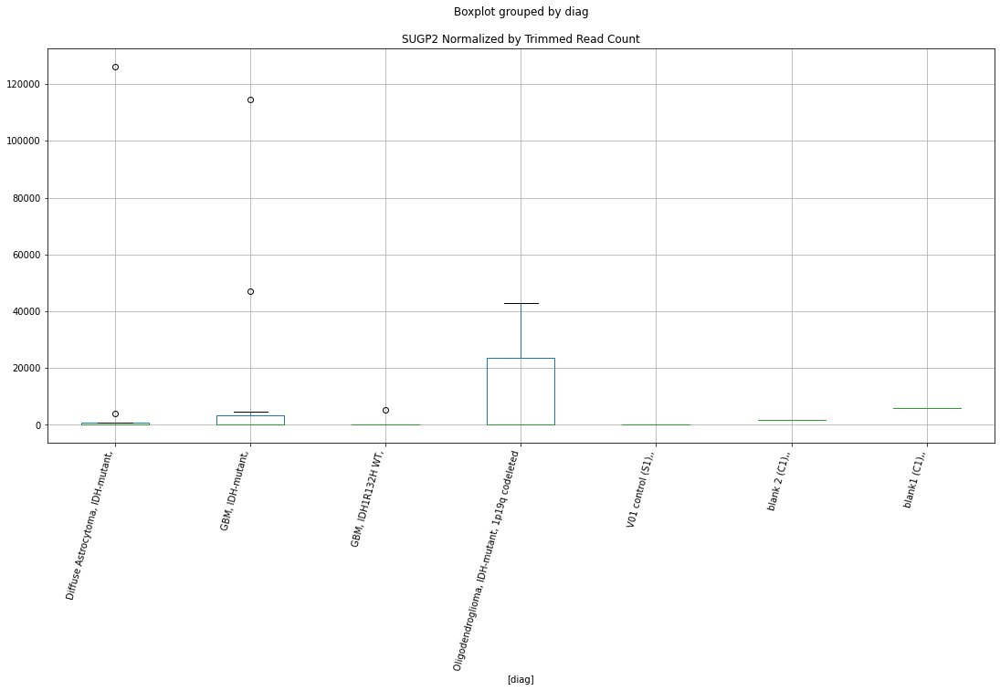

 p : 0.04993484971338529  ( t : 2.1015874424788104 ) :  D-plex  :  cutadapt2  :  TNKS
Control and blanks
76     2272.84
340       0.00
Name: TNKS, dtype: float64
208    12874.3
Name: TNKS, dtype: float64
472    580267.66
Name: TNKS, dtype: float64


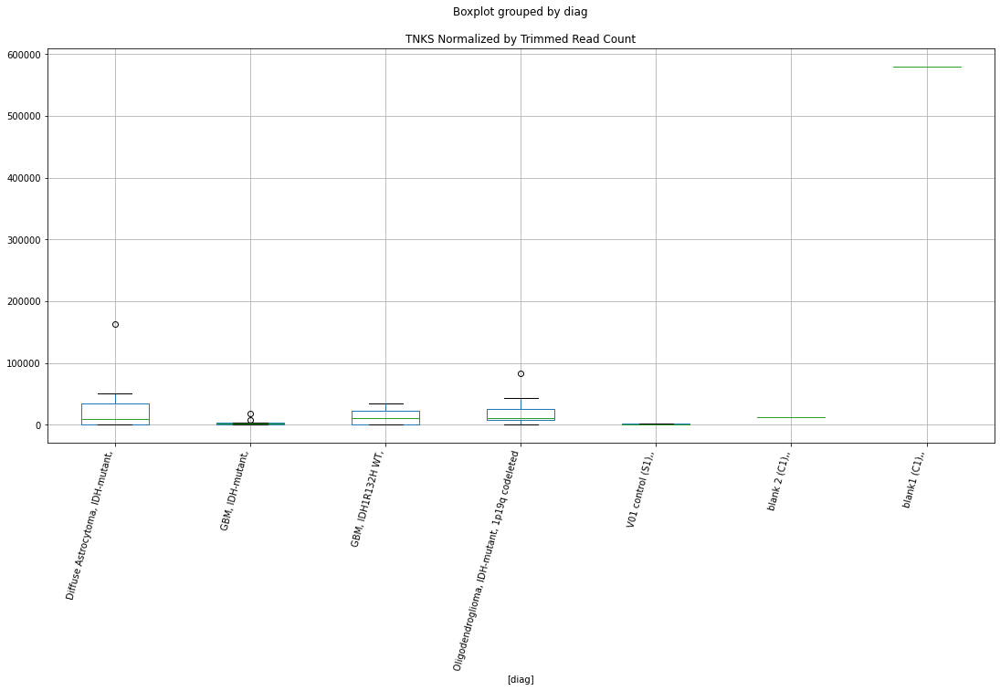

 p : 0.04995933298412293  ( t : 2.1013372939295594 ) :  Lexogen  :  bbduk2  :  YBX3P1
Control and blanks
79     0.0
343    0.0
Name: YBX3P1, dtype: float64
211    0.0
Name: YBX3P1, dtype: float64
475    0.0
Name: YBX3P1, dtype: float64


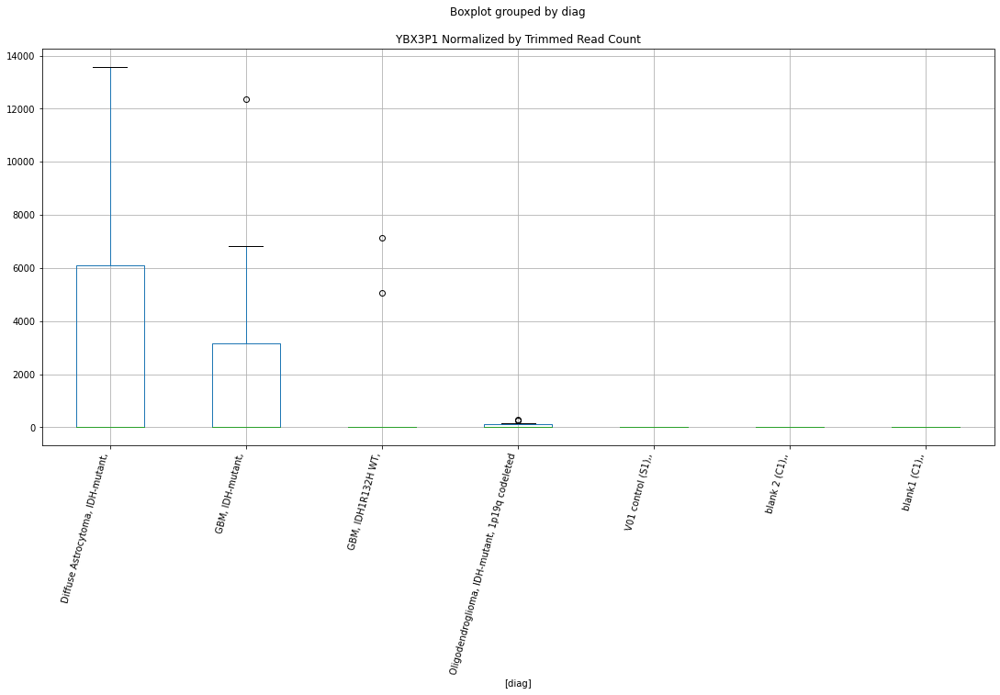

 p : 0.04998404794847541  ( t : 2.101084891128647 ) :  Lexogen  :  cutadapt2  :  YBX3P1
Control and blanks
82     0.0
346    0.0
Name: YBX3P1, dtype: float64
214    0.0
Name: YBX3P1, dtype: float64
478    0.0
Name: YBX3P1, dtype: float64


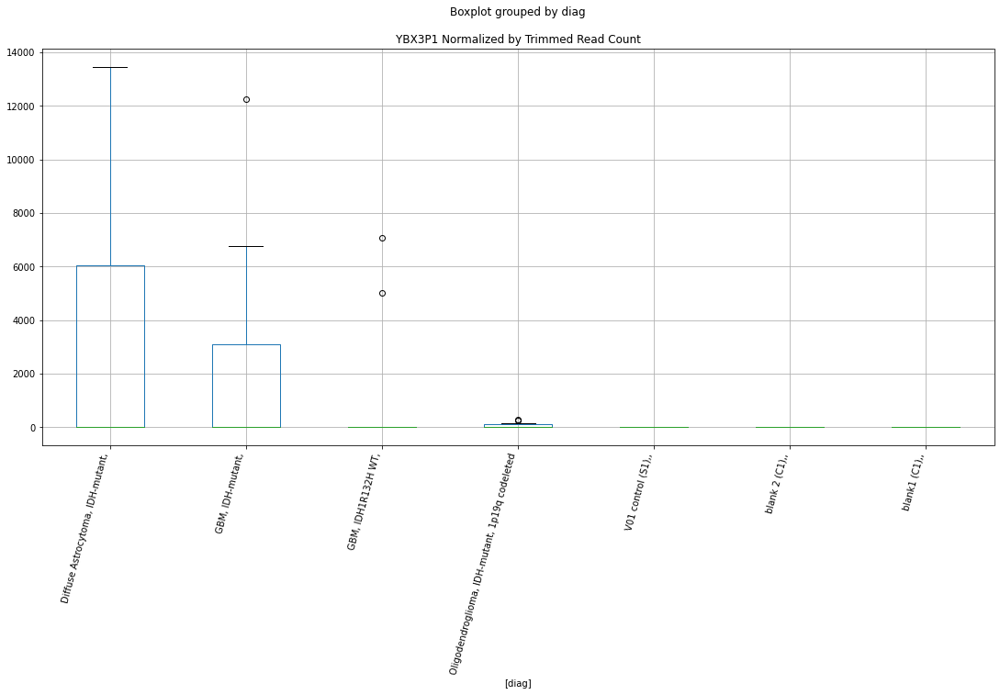

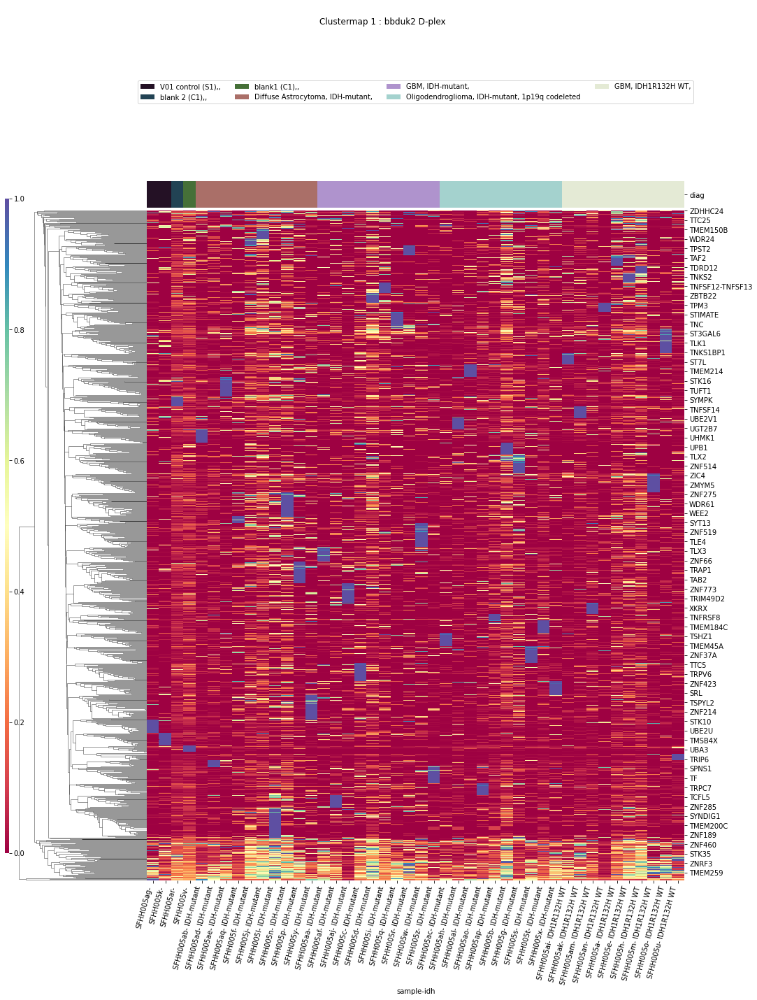

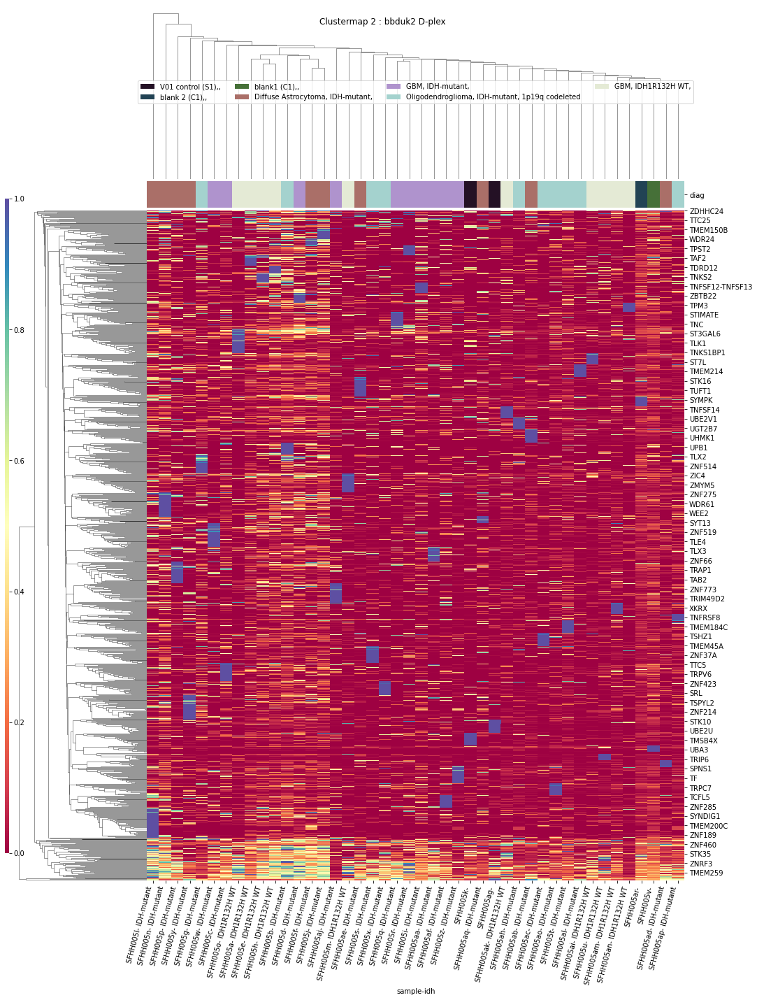

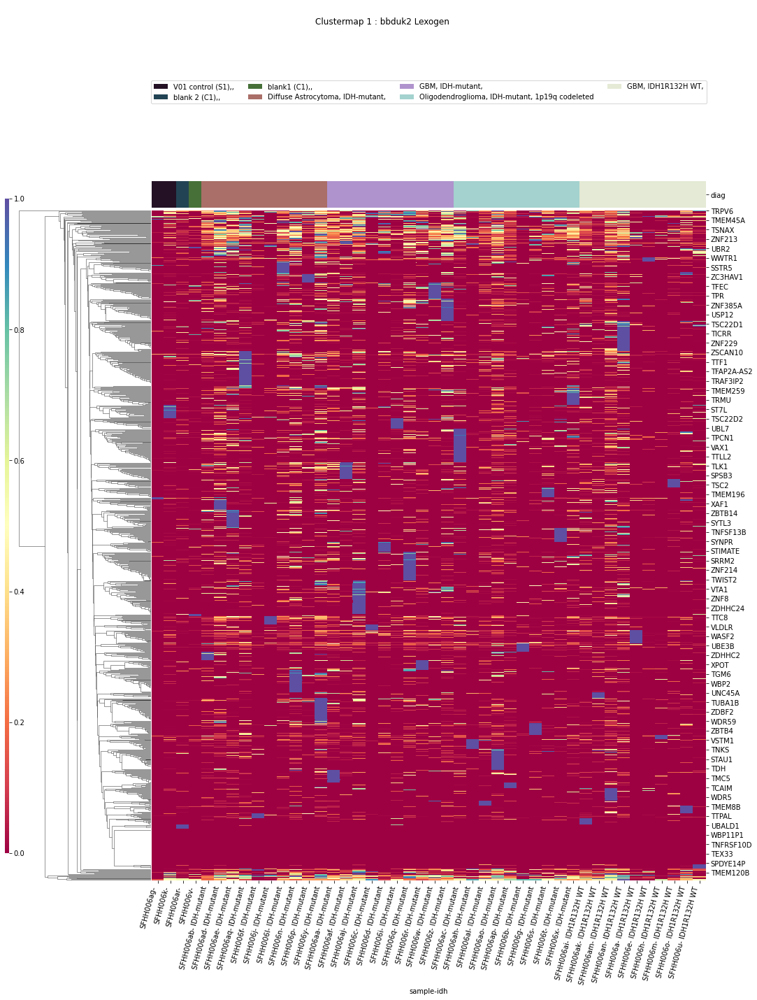

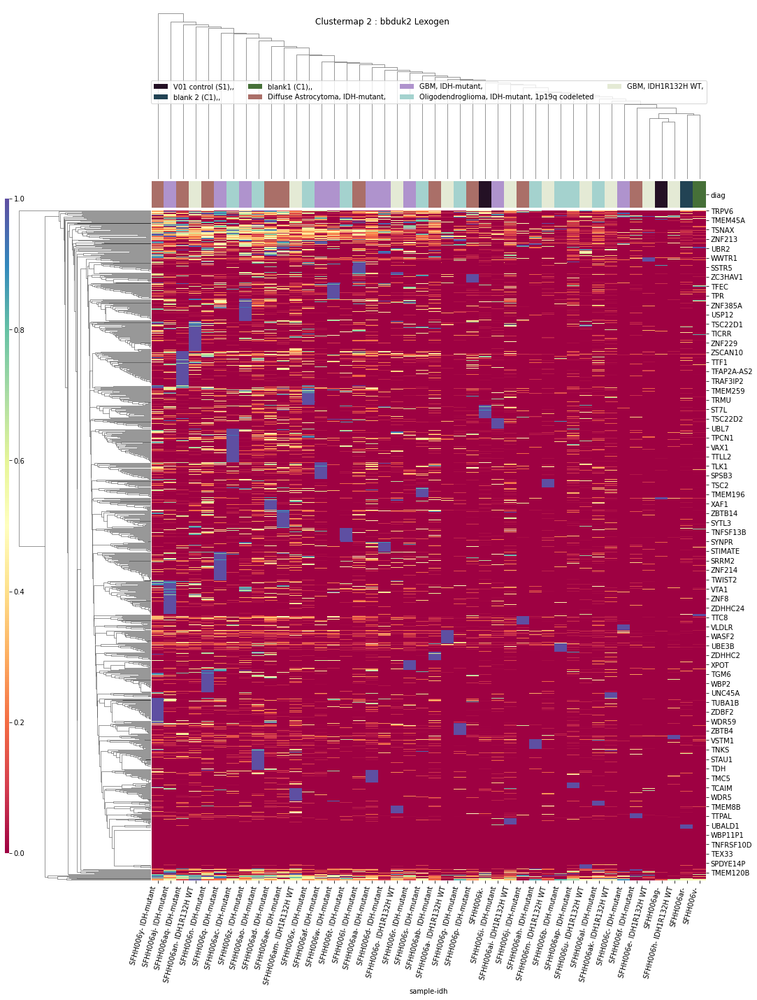

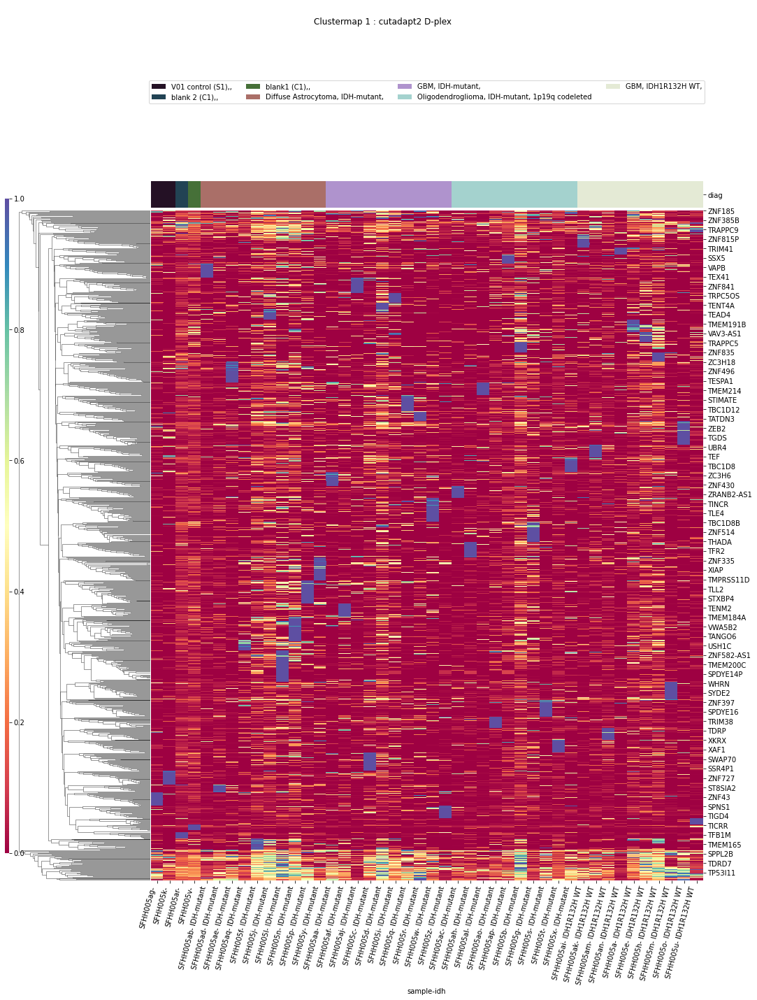

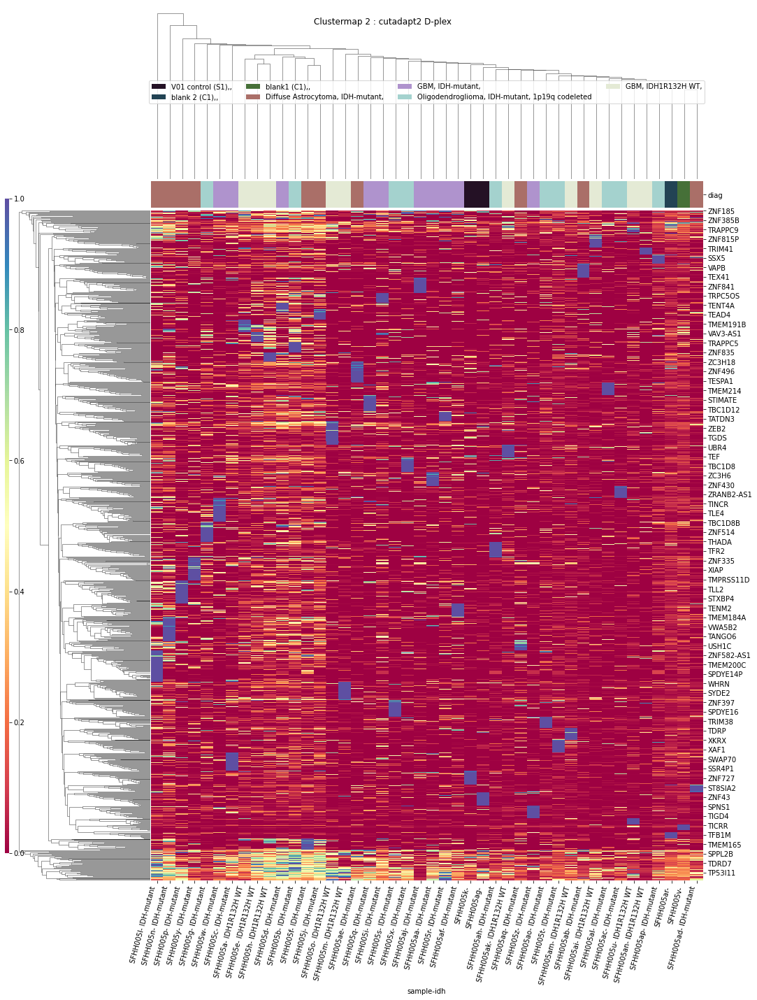

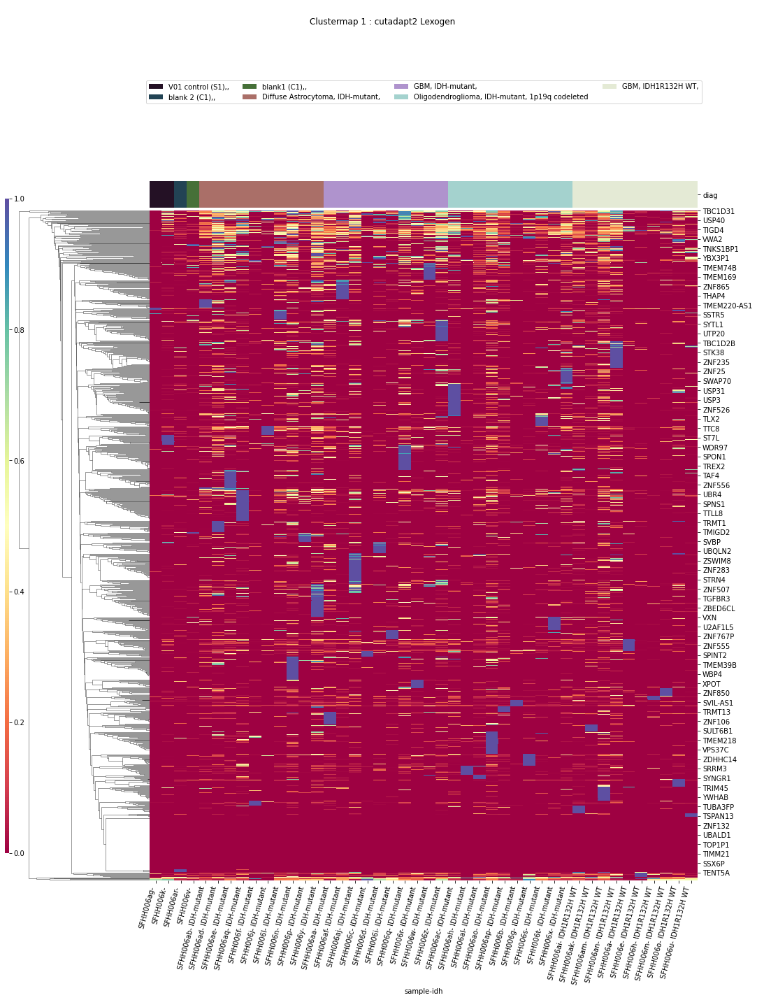

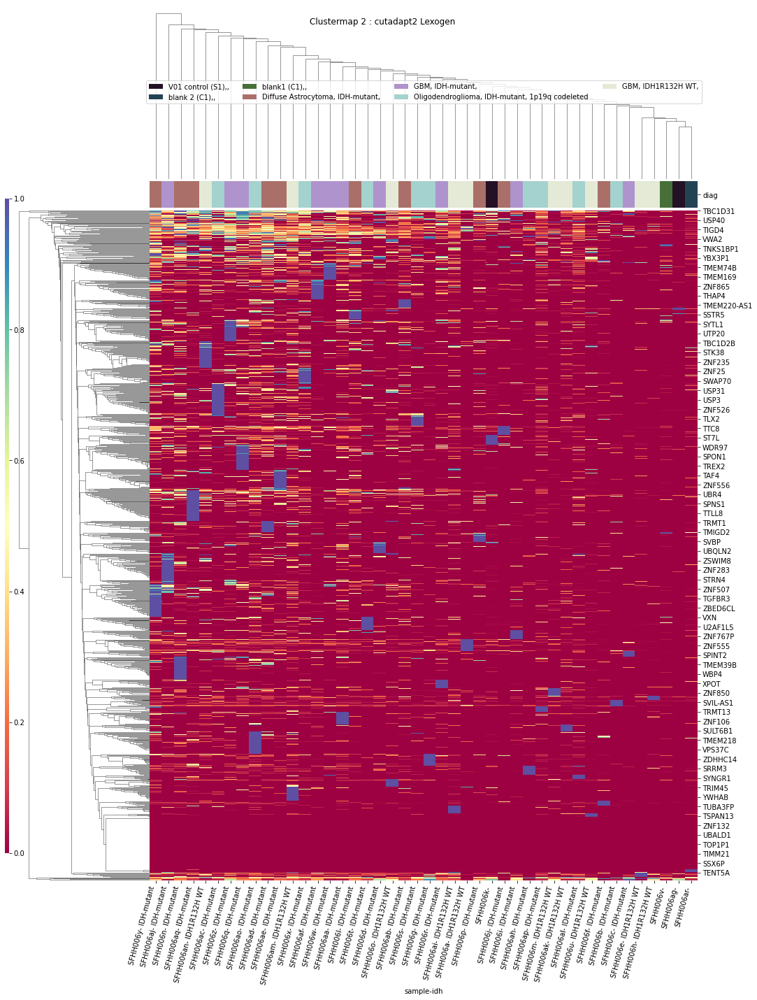

In [67]:
ttests_boxplots_and_heatmaps(dfn,elements,heat_p=0.1)

In [68]:
datetime.now().strftime("%H:%M:%S")

'11:35:24'

In [69]:
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [70]:
pd.set_option('display.max_columns', default_max_columns)

In [71]:
pd.set_option('display.max_rows',default_max_rows)

In [72]:
pd.set_option('display.precision', default_precision)